In [3]:
import torch.optim as optim
from torch import nn
from torchvision import models

from preprocessing_last20 import *
from classifier2 import FaceRecognizer2 as FaceRecognizer
from mindiffusion.ddpm import DDPM
from mindiffusion.unet import NaiveUnet
from d2c_encoder import D2CEncoder
from d2c_decoder import D2CDecoder

In [4]:
device = torch.device('cuda:3')
train_data = train_data.to(device)
test_data = test_data.to(device)
vgg11 = models.vgg11(pretrained=False).to(device)
classifier = FaceRecognizer(vgg11).to(device)
d2c_encoder = D2CEncoder().to(device)
d2c_decoder = D2CDecoder().to(device)
d2c_ddpm = DDPM(eps_model=NaiveUnet(16, 16, n_feat=128), betas=(1e-4, 0.02), n_T=200).to(device)
attack_targets = torch.tensor([[0],[1],[2],[3],[4],[5],[6],[7],[8],[9]]).to(device)

In [5]:
classifier.load_state_dict(torch.load('eval_classifier_overfit.pt'))
d2c_encoder.load_state_dict(torch.load('d2c_encoder.pth'))
d2c_decoder.load_state_dict(torch.load('d2c_decoder.pth'))
d2c_ddpm.load_state_dict(torch.load('d2c_ddpm.pth'))

<All keys matched successfully>

In [6]:
z = d2c_encoder(test_data[32])

In [7]:
z.shape

torch.Size([1, 16, 32, 32])

# generate image using random z

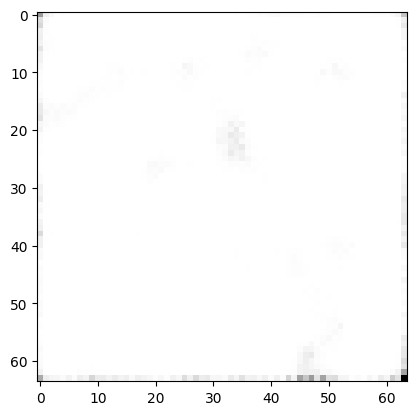

In [6]:
z = torch.randn(1, 16, 32, 32).to(device)
tensor_to_picture(d2c_decoder(z).detach().cpu().numpy()[0][0])

# generate image using avg z

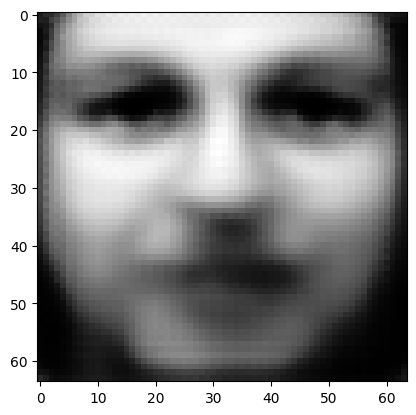

In [8]:
def init_avg_z():
    z = torch.zeros(1, 16, 32, 32).to(device)
    for i in range(200):
        z += d2c_encoder(train_data[i])
    z = z/200
    return z
avg = d2c_decoder(init_avg_z()).detach()
tensor_to_picture(avg.detach().cpu().numpy()[0][0])

In [9]:
def optimize_z(z, decoder, classifier, optimizer_z, criterion, target, reg):
    decoder.eval()
    classifier.eval()
    optimizer_z.zero_grad()
    generated = decoder(z)
    result = classifier(generated)
    print(torch.softmax(result,-1))
    loss = criterion(result,attack_targets[target])
    loss += torch.sum((generated-avg)**2) * reg
    loss.backward()
    optimizer_z.step()
    return loss.item()

In [10]:
def optimize_z_eps(z, eps, lr, reg, lr_decay, target=8):
    for epoch in range(eps): 
        optimizer_z = optim.SGD([z], lr=lr*lr_decay**epoch, momentum=0.9, nesterov=False)
        criterion = nn.CrossEntropyLoss(reduction = 'sum')
        epoch_loss = optimize_z(z, d2c_decoder, classifier, optimizer_z, criterion, target, reg)
        print("loss(generator): ", epoch_loss)
        if epoch%5 == 0:
            tensor_to_picture(d2c_decoder(z).detach().cpu().numpy()[0][0])

In [11]:
for param in classifier.parameters():
    param.requires_grad = False
for param in d2c_decoder.parameters():
    param.requires_grad = False   
z = init_avg_z().detach()
z = z.requires_grad_(True)

tensor([[2.5848e-04, 4.0420e-05, 9.8727e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2034e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.260672569274902


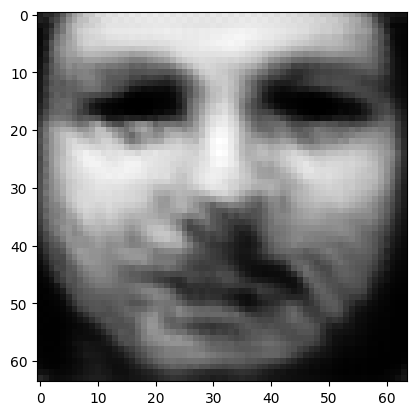

tensor([[1.8999e-04, 3.1871e-04, 9.7913e-04, 5.9523e-03, 1.2069e-02, 4.9186e-05,
         1.4047e-04, 1.6716e-04, 2.1452e-04, 4.4764e-06, 3.6389e-05, 7.5418e-05,
         3.3380e-03, 9.5601e-03, 3.5367e-05, 9.9368e-06, 4.0695e-03, 7.0394e-04,
         4.3393e-04, 1.2066e-05, 3.7391e-03, 8.6168e-05, 3.9811e-01, 8.8246e-05,
         1.4968e-01, 2.2115e-01, 5.4107e-05, 3.9762e-04, 2.8578e-04, 2.3283e-03,
         3.6868e-04, 1.7617e-04, 2.5200e-03, 2.1145e-03, 7.4568e-03, 4.5022e-03,
         1.5159e-01, 1.4620e-02, 1.6319e-03, 7.3257e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.568558692932129
tensor([[1.9468e-04, 3.6180e-04, 8.4613e-04, 7.8030e-04, 1.0678e-01, 5.6462e-05,
         1.1188e-03, 2.3979e-04, 3.7792e-04, 1.5501e-05, 5.9232e-05, 6.8080e-05,
         4.4312e-02, 7.0755e-03, 2.1226e-03, 2.3150e-05, 2.9752e-02, 7.3507e-03,
         3.7296e-04, 5.4028e-04, 1.1720e-02, 2.8188e-04, 1.9191e-01, 3.8868e-04,
         2.8078e-01, 4.1691e-03, 3.6886e-04,

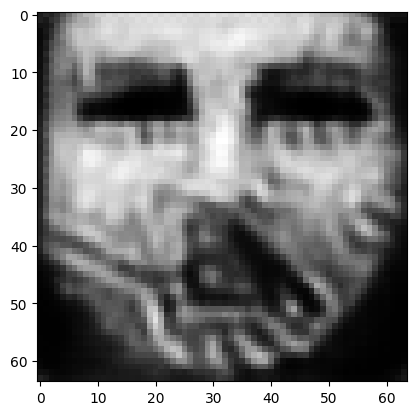

tensor([[5.4029e-01, 1.4192e-05, 1.3653e-02, 4.0894e-05, 1.9958e-03, 1.5280e-02,
         1.4107e-01, 6.5416e-02, 4.5014e-07, 1.1556e-04, 3.3364e-04, 1.1200e-04,
         2.0258e-05, 3.0327e-06, 1.1275e-04, 2.5472e-03, 1.1063e-02, 8.9489e-02,
         2.0570e-04, 2.7872e-03, 6.6689e-05, 1.8491e-04, 1.4525e-07, 9.7364e-02,
         6.2381e-03, 1.3994e-06, 3.8440e-04, 2.1845e-03, 1.5913e-03, 3.8264e-05,
         1.0289e-06, 4.1162e-04, 4.9465e-03, 2.2719e-04, 1.0969e-04, 4.7079e-05,
         6.8788e-04, 4.6580e-04, 4.6938e-04, 2.6453e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6156485080718994
tensor([[6.6472e-01, 8.5903e-06, 1.0185e-02, 2.6439e-05, 1.1944e-03, 1.1481e-02,
         1.0149e-01, 5.4199e-02, 1.4996e-07, 9.4981e-05, 2.4874e-04, 6.4593e-05,
         9.9428e-06, 1.3959e-06, 5.8177e-05, 2.0708e-03, 8.3935e-03, 4.6537e-02,
         1.7262e-04, 1.5189e-03, 3.5786e-05, 1.0990e-04, 6.3701e-08, 8.7261e-02,
         3.0283e-03, 8.2976e-07, 2.3276e-04

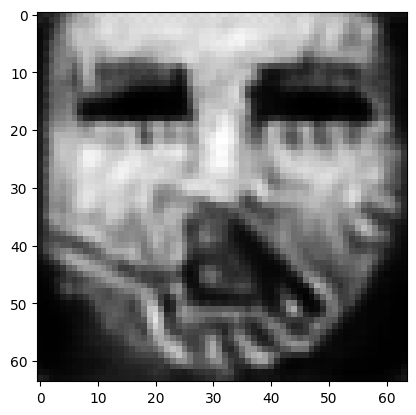

tensor([[8.1331e-01, 4.2599e-06, 5.7358e-03, 1.4719e-05, 5.3529e-04, 7.6376e-03,
         5.6260e-02, 3.0650e-02, 3.3102e-08, 5.2976e-05, 1.1611e-04, 3.3493e-05,
         3.7188e-06, 4.1663e-07, 2.0767e-05, 1.3893e-03, 3.7879e-03, 2.4858e-02,
         8.8550e-05, 6.3320e-04, 1.5190e-05, 4.0015e-05, 1.7558e-08, 5.0911e-02,
         9.7189e-04, 2.5201e-07, 1.2214e-04, 8.6432e-04, 4.8420e-04, 8.7028e-06,
         1.5361e-07, 9.9775e-05, 7.8548e-04, 3.3268e-05, 3.8959e-05, 8.0202e-06,
         2.7697e-04, 1.4606e-04, 6.0889e-05, 4.4720e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2066483497619629
tensor([[8.2891e-01, 3.8489e-06, 5.3085e-03, 1.3600e-05, 4.7503e-04, 7.1913e-03,
         5.2419e-02, 2.7805e-02, 2.7155e-08, 4.8260e-05, 1.0192e-04, 3.0852e-05,
         3.2571e-06, 3.4797e-07, 1.7780e-05, 1.3182e-03, 3.3316e-03, 2.2964e-02,
         8.1012e-05, 5.6451e-04, 1.3504e-05, 3.4535e-05, 1.4514e-08, 4.5956e-02,
         8.0967e-04, 2.0955e-07, 1.1333e-04

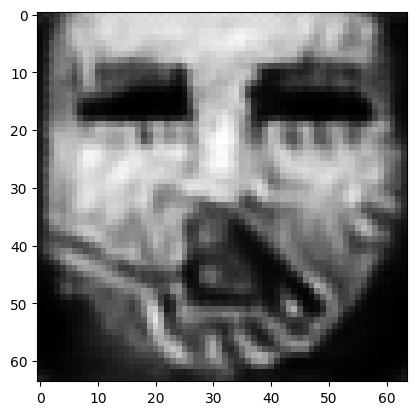

tensor([[8.7219e-01, 2.7829e-06, 3.8884e-03, 1.0398e-05, 3.3021e-04, 5.2358e-03,
         4.0168e-02, 2.0574e-02, 1.4395e-08, 3.6118e-05, 6.7533e-05, 2.1529e-05,
         2.0975e-06, 2.0630e-07, 1.1847e-05, 1.0792e-03, 2.2430e-03, 1.7474e-02,
         6.1130e-05, 3.8831e-04, 8.9971e-06, 2.1147e-05, 7.6410e-09, 3.3954e-02,
         4.7309e-04, 1.1647e-07, 8.3760e-05, 5.7240e-04, 3.1523e-04, 4.8983e-06,
         6.9406e-08, 6.1999e-05, 3.6881e-04, 1.8095e-05, 2.5360e-05, 4.3920e-06,
         1.8388e-04, 8.3678e-05, 3.0016e-05, 2.3957e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.13674458861351013
tensor([[8.8008e-01, 2.6069e-06, 3.6979e-03, 9.9897e-06, 3.0971e-04, 4.9273e-03,
         3.7932e-02, 1.9091e-02, 1.2977e-08, 3.4457e-05, 6.2206e-05, 2.0407e-05,
         1.9529e-06, 1.8707e-07, 1.0865e-05, 1.0334e-03, 2.0488e-03, 1.6617e-02,
         5.7890e-05, 3.6206e-04, 8.3904e-06, 1.9497e-05, 6.8080e-09, 3.1609e-02,
         4.2557e-04, 1.0518e-07, 8.0007e-0

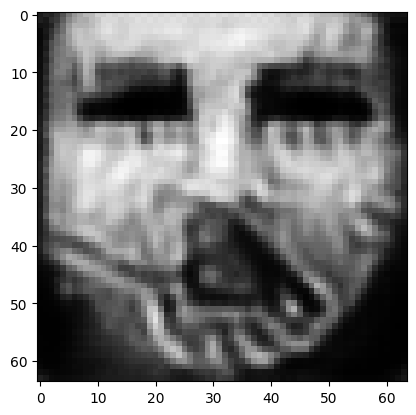

tensor([[9.0414e-01, 2.1021e-06, 2.9294e-03, 8.1787e-06, 2.3964e-04, 3.8719e-03,
         3.0903e-02, 1.5318e-02, 8.4861e-09, 2.8922e-05, 4.7529e-05, 1.6086e-05,
         1.4429e-06, 1.3307e-07, 8.2844e-06, 8.9075e-04, 1.5196e-03, 1.3477e-02,
         4.7039e-05, 2.8169e-04, 6.2170e-06, 1.3980e-05, 4.3176e-09, 2.4704e-02,
         2.9445e-04, 7.1045e-08, 6.5130e-05, 4.2368e-04, 2.4091e-04, 3.4196e-06,
         4.1084e-08, 4.6287e-05, 2.2468e-04, 1.2623e-05, 1.9007e-05, 2.9886e-06,
         1.3305e-04, 5.8533e-05, 1.9115e-05, 1.5718e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.10077227652072906
tensor([[9.0861e-01, 2.0100e-06, 2.7837e-03, 7.8204e-06, 2.2660e-04, 3.6743e-03,
         2.9580e-02, 1.4608e-02, 7.7640e-09, 2.7981e-05, 4.5178e-05, 1.5246e-05,
         1.3540e-06, 1.2448e-07, 7.8620e-06, 8.6501e-04, 1.4327e-03, 1.2879e-02,
         4.5215e-05, 2.6840e-04, 5.8238e-06, 1.2949e-05, 3.9007e-09, 2.3440e-02,
         2.7236e-04, 6.5342e-08, 6.2394e-0

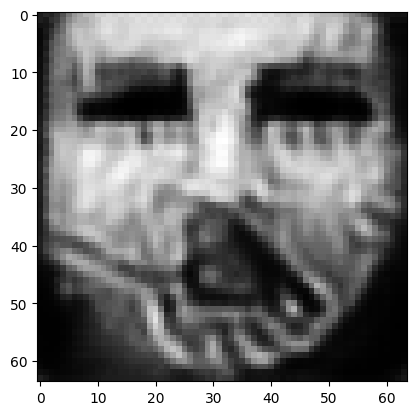

tensor([[9.2298e-01, 1.6742e-06, 2.3806e-03, 6.7022e-06, 1.8529e-04, 3.1181e-03,
         2.5303e-02, 1.2430e-02, 5.6111e-09, 2.5080e-05, 3.8119e-05, 1.2596e-05,
         1.0601e-06, 9.4688e-08, 6.2319e-06, 7.7603e-04, 1.1830e-03, 1.0618e-02,
         3.9394e-05, 2.2164e-04, 4.5649e-06, 1.0002e-05, 2.6860e-09, 1.9483e-02,
         2.0138e-04, 4.9515e-08, 5.2602e-05, 3.4282e-04, 2.0295e-04, 2.6507e-06,
         2.7637e-08, 3.6544e-05, 1.5123e-04, 9.7159e-06, 1.5160e-05, 2.1725e-06,
         1.0146e-04, 4.5405e-05, 1.3489e-05, 1.1312e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08015024662017822
tensor([[9.2567e-01, 1.6149e-06, 2.2994e-03, 6.4741e-06, 1.7758e-04, 3.0105e-03,
         2.4438e-02, 1.2056e-02, 5.2440e-09, 2.4438e-05, 3.6775e-05, 1.2105e-05,
         1.0048e-06, 8.9317e-08, 5.9281e-06, 7.5694e-04, 1.1376e-03, 1.0179e-02,
         3.8197e-05, 2.1223e-04, 4.3336e-06, 9.4595e-06, 2.4847e-09, 1.8797e-02,
         1.8934e-04, 4.6710e-08, 5.0548e-0

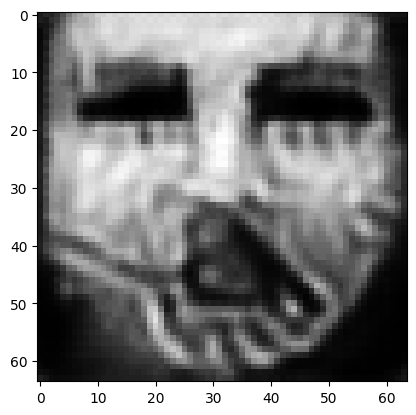

tensor([[9.3432e-01, 1.4517e-06, 2.0861e-03, 5.8636e-06, 1.5644e-04, 2.7239e-03,
         2.1782e-02, 1.0917e-02, 4.3409e-09, 2.2930e-05, 3.2811e-05, 1.0801e-05,
         8.5037e-07, 7.3831e-08, 4.9885e-06, 6.9653e-04, 9.7643e-04, 8.7785e-03,
         3.4796e-05, 1.8620e-04, 3.6683e-06, 7.9995e-06, 1.9433e-09, 1.6268e-02,
         1.5262e-04, 3.9359e-08, 4.6026e-05, 2.9585e-04, 1.7957e-04, 2.2117e-06,
         2.1224e-08, 3.1040e-05, 1.1508e-04, 8.1332e-06, 1.2994e-05, 1.7267e-06,
         8.3258e-05, 3.8374e-05, 1.0748e-05, 9.2198e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06793217360973358
tensor([[9.3615e-01, 1.4138e-06, 2.0467e-03, 5.7447e-06, 1.5262e-04, 2.6703e-03,
         2.1212e-02, 1.0682e-02, 4.1617e-09, 2.2657e-05, 3.1978e-05, 1.0534e-05,
         8.2045e-07, 7.0634e-08, 4.7861e-06, 6.8236e-04, 9.4226e-04, 8.4915e-03,
         3.4075e-05, 1.8068e-04, 3.5279e-06, 7.7322e-06, 1.8393e-09, 1.5722e-02,
         1.4530e-04, 3.7991e-08, 4.5111e-0

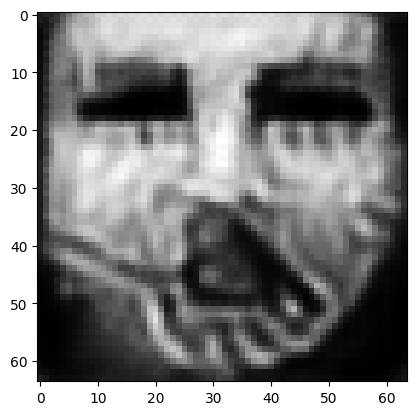

tensor([[9.4247e-01, 1.2826e-06, 1.8926e-03, 5.3582e-06, 1.3968e-04, 2.4484e-03,
         1.9256e-02, 9.7690e-03, 3.5692e-09, 2.1582e-05, 2.8868e-05, 9.5455e-06,
         7.2360e-07, 6.0080e-08, 4.1192e-06, 6.3163e-04, 8.2621e-04, 7.5318e-03,
         3.1612e-05, 1.6097e-04, 3.0637e-06, 6.8322e-06, 1.5238e-09, 1.3913e-02,
         1.2215e-04, 3.3350e-08, 4.1600e-05, 2.6108e-04, 1.6320e-04, 1.9117e-06,
         1.7364e-08, 2.7575e-05, 9.3240e-05, 6.9949e-06, 1.1521e-05, 1.4668e-06,
         7.2064e-05, 3.3896e-05, 9.0925e-06, 7.9091e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05925050005316734
tensor([[9.4392e-01, 1.2560e-06, 1.8456e-03, 5.2590e-06, 1.3660e-04, 2.3866e-03,
         1.8819e-02, 9.5384e-03, 3.4366e-09, 2.1243e-05, 2.8110e-05, 9.2980e-06,
         7.0187e-07, 5.7880e-08, 3.9897e-06, 6.1970e-04, 7.9837e-04, 7.3486e-03,
         3.0961e-05, 1.5676e-04, 2.9595e-06, 6.6014e-06, 1.4553e-09, 1.3498e-02,
         1.1736e-04, 3.2131e-08, 4.0762e-0

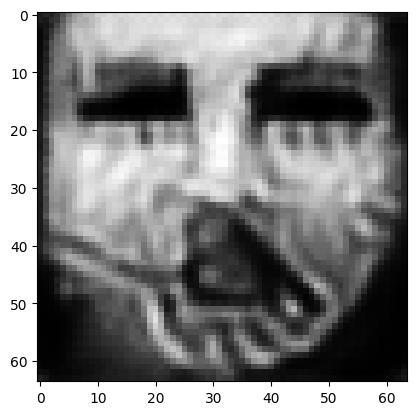

tensor([[9.4960e-01, 1.1389e-06, 1.6725e-03, 4.7716e-06, 1.2135e-04, 2.1680e-03,
         1.7228e-02, 8.7225e-03, 2.8294e-09, 2.0109e-05, 2.5455e-05, 8.2292e-06,
         5.9801e-07, 4.7804e-08, 3.3962e-06, 5.7878e-04, 6.9612e-04, 6.4382e-03,
         2.8396e-05, 1.3917e-04, 2.5011e-06, 5.6306e-06, 1.1418e-09, 1.1818e-02,
         9.5749e-05, 2.7067e-08, 3.7232e-05, 2.2929e-04, 1.4572e-04, 1.6316e-06,
         1.3723e-08, 2.4144e-05, 7.3161e-05, 5.9639e-06, 1.0061e-05, 1.2183e-06,
         5.9575e-05, 2.9072e-05, 7.4084e-06, 6.6032e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.051719166338443756
tensor([[9.5080e-01, 1.1101e-06, 1.6405e-03, 4.6695e-06, 1.1828e-04, 2.1172e-03,
         1.6846e-02, 8.5589e-03, 2.7113e-09, 1.9883e-05, 2.4866e-05, 7.9983e-06,
         5.7708e-07, 4.5742e-08, 3.2692e-06, 5.6828e-04, 6.7611e-04, 6.2291e-03,
         2.7830e-05, 1.3521e-04, 2.4063e-06, 5.4458e-06, 1.0840e-09, 1.1513e-02,
         9.1939e-05, 2.6167e-08, 3.6400e-

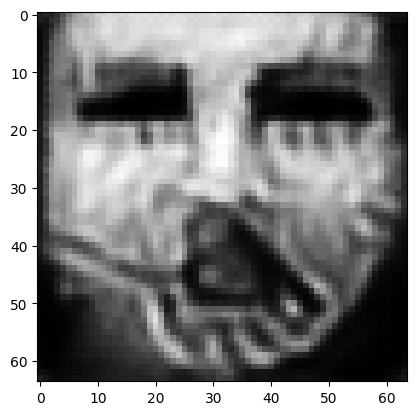

tensor([[9.5475e-01, 1.0127e-06, 1.5255e-03, 4.2977e-06, 1.0755e-04, 1.9571e-03,
         1.5613e-02, 8.0404e-03, 2.2903e-09, 1.9023e-05, 2.2821e-05, 7.1834e-06,
         5.0373e-07, 3.8698e-08, 2.8414e-06, 5.3570e-04, 6.1167e-04, 5.5279e-03,
         2.5864e-05, 1.2151e-04, 2.0876e-06, 4.7975e-06, 8.8930e-10, 1.0490e-02,
         7.8693e-05, 2.2929e-08, 3.3411e-05, 2.0510e-04, 1.3229e-04, 1.4149e-06,
         1.1232e-08, 2.1308e-05, 6.0065e-05, 5.1743e-06, 8.9091e-06, 1.0197e-06,
         5.0603e-05, 2.5729e-05, 6.2506e-06, 5.6496e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.046307485550642014
tensor([[9.5560e-01, 9.9081e-07, 1.5009e-03, 4.2159e-06, 1.0514e-04, 1.9219e-03,
         1.5342e-02, 7.9210e-03, 2.2016e-09, 1.8819e-05, 2.2387e-05, 7.0135e-06,
         4.8827e-07, 3.7240e-08, 2.7511e-06, 5.2836e-04, 5.9790e-04, 5.3808e-03,
         2.5416e-05, 1.1851e-04, 2.0221e-06, 4.6608e-06, 8.4984e-10, 1.0276e-02,
         7.5964e-05, 2.2236e-08, 3.2740e-

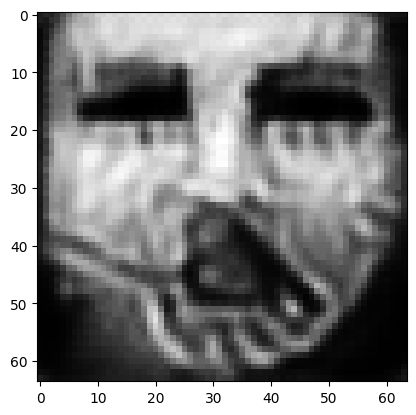

tensor([[9.5886e-01, 9.1329e-07, 1.4078e-03, 3.9019e-06, 9.6068e-05, 1.7999e-03,
         1.4360e-02, 7.4485e-03, 1.9088e-09, 1.8078e-05, 2.0695e-05, 6.3960e-06,
         4.3367e-07, 3.1921e-08, 2.4149e-06, 4.9914e-04, 5.3947e-04, 4.8364e-03,
         2.3649e-05, 1.0844e-04, 1.7774e-06, 4.1473e-06, 7.0811e-10, 9.3994e-03,
         6.5821e-05, 1.9677e-08, 3.0614e-05, 1.8463e-04, 1.2094e-04, 1.2449e-06,
         9.3413e-09, 1.9119e-05, 5.0635e-05, 4.5609e-06, 8.0137e-06, 8.6977e-07,
         4.3449e-05, 2.3061e-05, 5.3848e-06, 4.9620e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.042006175965070724
tensor([[9.5958e-01, 8.9675e-07, 1.3869e-03, 3.8328e-06, 9.4075e-05, 1.7746e-03,
         1.4144e-02, 7.3440e-03, 1.8496e-09, 1.7892e-05, 2.0302e-05, 6.2624e-06,
         4.2202e-07, 3.0782e-08, 2.3413e-06, 4.9214e-04, 5.2594e-04, 4.7182e-03,
         2.3248e-05, 1.0622e-04, 1.7243e-06, 4.0364e-06, 6.7916e-10, 9.2023e-03,
         6.3662e-05, 1.9127e-08, 3.0173e-

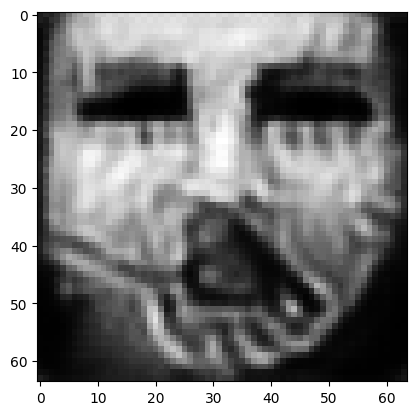

tensor([[9.6210e-01, 8.4145e-07, 1.3015e-03, 3.5660e-06, 8.6831e-05, 1.6695e-03,
         1.3395e-02, 6.9326e-03, 1.6403e-09, 1.7199e-05, 1.8974e-05, 5.7705e-06,
         3.8198e-07, 2.7052e-08, 2.1071e-06, 4.6853e-04, 4.7921e-04, 4.3274e-03,
         2.1819e-05, 9.8933e-05, 1.5439e-06, 3.6482e-06, 5.7993e-10, 8.5618e-03,
         5.6223e-05, 1.7092e-08, 2.8534e-05, 1.6738e-04, 1.1062e-04, 1.1167e-06,
         7.9223e-09, 1.7510e-05, 4.3763e-05, 4.0811e-06, 7.3009e-06, 7.6373e-07,
         3.7660e-05, 2.0908e-05, 4.7381e-06, 4.4287e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03863534703850746
tensor([[9.6268e-01, 8.2724e-07, 1.2826e-03, 3.5032e-06, 8.5208e-05, 1.6430e-03,
         1.3203e-02, 6.8388e-03, 1.5938e-09, 1.7037e-05, 1.8655e-05, 5.6518e-06,
         3.7309e-07, 2.6220e-08, 2.0531e-06, 4.6255e-04, 4.6952e-04, 4.2299e-03,
         2.1487e-05, 9.7174e-05, 1.5035e-06, 3.5634e-06, 5.5897e-10, 8.4402e-03,
         5.4694e-05, 1.6667e-08, 2.8068e-0

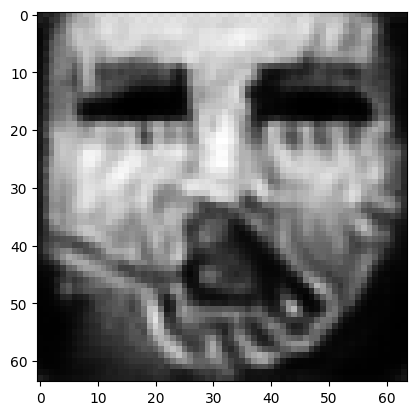

tensor([[9.6474e-01, 7.7760e-07, 1.2173e-03, 3.3004e-06, 7.9690e-05, 1.5495e-03,
         1.2530e-02, 6.5076e-03, 1.4355e-09, 1.6552e-05, 1.7580e-05, 5.2405e-06,
         3.4270e-07, 2.3460e-08, 1.8736e-06, 4.4296e-04, 4.3605e-04, 3.8990e-03,
         2.0402e-05, 9.1054e-05, 1.3643e-06, 3.2730e-06, 4.9010e-10, 7.9775e-03,
         4.9581e-05, 1.5273e-08, 2.6505e-05, 1.5371e-04, 1.0219e-04, 1.0188e-06,
         6.9200e-09, 1.6108e-05, 3.8898e-05, 3.7004e-06, 6.7091e-06, 6.8109e-07,
         3.3480e-05, 1.9359e-05, 4.2635e-06, 3.9839e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0358944833278656
tensor([[9.6521e-01, 7.6543e-07, 1.2035e-03, 3.2584e-06, 7.8552e-05, 1.5268e-03,
         1.2370e-02, 6.4321e-03, 1.3993e-09, 1.6457e-05, 1.7340e-05, 5.1438e-06,
         3.3613e-07, 2.2875e-08, 1.8351e-06, 4.3838e-04, 4.2926e-04, 3.8248e-03,
         2.0167e-05, 8.9636e-05, 1.3335e-06, 3.2113e-06, 4.7575e-10, 7.8800e-03,
         4.8556e-05, 1.4991e-08, 2.6116e-05

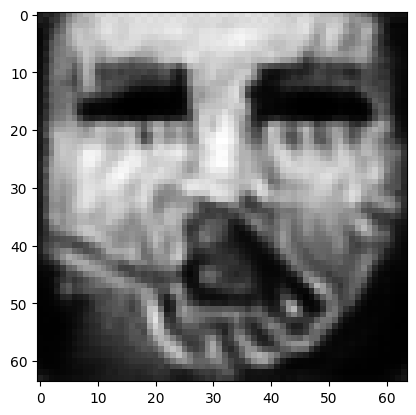

tensor([[9.6682e-01, 7.2639e-07, 1.1499e-03, 3.1032e-06, 7.4461e-05, 1.4520e-03,
         1.1840e-02, 6.1674e-03, 1.2769e-09, 1.6028e-05, 1.6491e-05, 4.8257e-06,
         3.1308e-07, 2.0891e-08, 1.7067e-06, 4.2244e-04, 4.0376e-04, 3.5947e-03,
         1.9269e-05, 8.4848e-05, 1.2277e-06, 2.9869e-06, 4.2652e-10, 7.5040e-03,
         4.4886e-05, 1.3919e-08, 2.4845e-05, 1.4350e-04, 9.5537e-05, 9.4106e-07,
         6.1729e-09, 1.5028e-05, 3.5239e-05, 3.4078e-06, 6.2590e-06, 6.2192e-07,
         3.0511e-05, 1.8181e-05, 3.8915e-06, 3.6271e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0337463915348053
tensor([[9.6718e-01, 7.1737e-07, 1.1383e-03, 3.0687e-06, 7.3568e-05, 1.4351e-03,
         1.1721e-02, 6.1066e-03, 1.2505e-09, 1.5923e-05, 1.6300e-05, 4.7566e-06,
         3.0811e-07, 2.0471e-08, 1.6788e-06, 4.1858e-04, 3.9817e-04, 3.5455e-03,
         1.9060e-05, 8.3791e-05, 1.2048e-06, 2.9370e-06, 4.1603e-10, 7.4208e-03,
         4.4127e-05, 1.3683e-08, 2.4560e-05

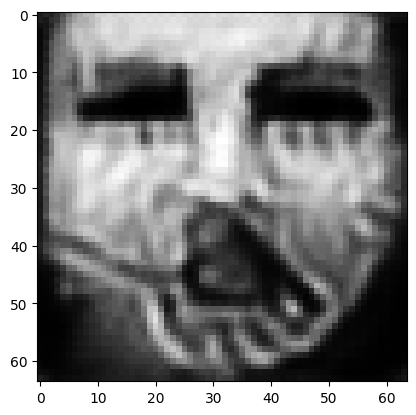

tensor([[9.6848e-01, 6.8433e-07, 1.0955e-03, 2.9449e-06, 7.0231e-05, 1.3740e-03,
         1.1294e-02, 5.8939e-03, 1.1586e-09, 1.5551e-05, 1.5614e-05, 4.5039e-06,
         2.8991e-07, 1.8942e-08, 1.5773e-06, 4.0403e-04, 3.7738e-04, 3.3648e-03,
         1.8302e-05, 7.9960e-05, 1.1194e-06, 2.7557e-06, 3.7844e-10, 7.1025e-03,
         4.1410e-05, 1.2853e-08, 2.3557e-05, 1.3518e-04, 8.9888e-05, 8.7659e-07,
         5.5997e-09, 1.4206e-05, 3.2489e-05, 3.1794e-06, 5.8921e-06, 5.7611e-07,
         2.8161e-05, 1.7266e-05, 3.6012e-06, 3.3452e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032023366540670395
tensor([[9.6878e-01, 6.7666e-07, 1.0855e-03, 2.9162e-06, 6.9446e-05, 1.3599e-03,
         1.1198e-02, 5.8449e-03, 1.1381e-09, 1.5462e-05, 1.5456e-05, 4.4445e-06,
         2.8572e-07, 1.8596e-08, 1.5546e-06, 4.0053e-04, 3.7251e-04, 3.3239e-03,
         1.8126e-05, 7.9089e-05, 1.0996e-06, 2.7138e-06, 3.6981e-10, 7.0267e-03,
         4.0787e-05, 1.2659e-08, 2.3329e-

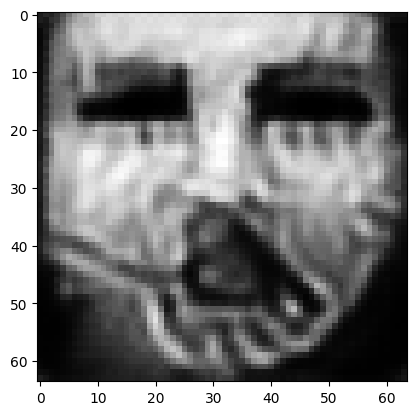

tensor([[9.6989e-01, 6.5188e-07, 1.0479e-03, 2.8184e-06, 6.6565e-05, 1.3041e-03,
         1.0851e-02, 5.6529e-03, 1.0674e-09, 1.5137e-05, 1.4897e-05, 4.2272e-06,
         2.7128e-07, 1.7436e-08, 1.4770e-06, 3.8897e-04, 3.5537e-04, 3.1787e-03,
         1.7541e-05, 7.6007e-05, 1.0328e-06, 2.5591e-06, 3.4049e-10, 6.7532e-03,
         3.8565e-05, 1.1954e-08, 2.2531e-05, 1.2830e-04, 8.5273e-05, 8.2632e-07,
         5.1397e-09, 1.3517e-05, 3.0188e-05, 2.9987e-06, 5.5941e-06, 5.3898e-07,
         2.6158e-05, 1.6464e-05, 3.3588e-06, 3.1170e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0305730439722538
tensor([[9.7014e-01, 6.4583e-07, 1.0392e-03, 2.7928e-06, 6.5871e-05, 1.2931e-03,
         1.0774e-02, 5.6149e-03, 1.0502e-09, 1.5060e-05, 1.4766e-05, 4.1797e-06,
         2.6760e-07, 1.7144e-08, 1.4573e-06, 3.8621e-04, 3.5121e-04, 3.1445e-03,
         1.7387e-05, 7.5264e-05, 1.0163e-06, 2.5238e-06, 3.3333e-10, 6.6863e-03,
         3.8024e-05, 1.1788e-08, 2.2349e-05

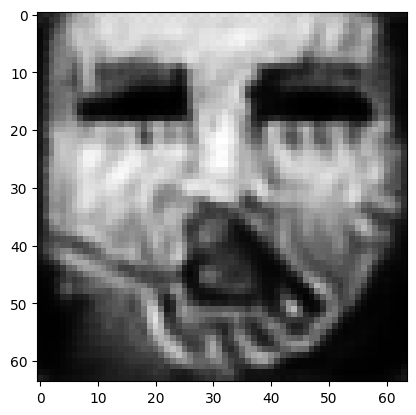

tensor([[9.7110e-01, 6.2660e-07, 1.0132e-03, 2.7216e-06, 6.3605e-05, 1.2538e-03,
         1.0471e-02, 5.4684e-03, 9.9562e-10, 1.4818e-05, 1.4273e-05, 4.0165e-06,
         2.5562e-07, 1.6167e-08, 1.3857e-06, 3.7676e-04, 3.3665e-04, 3.0100e-03,
         1.6915e-05, 7.2464e-05, 9.6221e-07, 2.3938e-06, 3.1024e-10, 6.4159e-03,
         3.6093e-05, 1.1248e-08, 2.1774e-05, 1.2274e-04, 8.1856e-05, 7.8402e-07,
         4.7593e-09, 1.2945e-05, 2.8217e-05, 2.8512e-06, 5.3594e-06, 5.0543e-07,
         2.4523e-05, 1.5790e-05, 3.1547e-06, 2.9565e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029323337599635124
tensor([[9.7133e-01, 6.2244e-07, 1.0071e-03, 2.7055e-06, 6.3087e-05, 1.2447e-03,
         1.0400e-02, 5.4344e-03, 9.8298e-10, 1.4768e-05, 1.4161e-05, 3.9793e-06,
         2.5286e-07, 1.5946e-08, 1.3691e-06, 3.7475e-04, 3.3327e-04, 2.9784e-03,
         1.6808e-05, 7.1812e-05, 9.4994e-07, 2.3639e-06, 3.0498e-10, 6.3518e-03,
         3.5638e-05, 1.1124e-08, 2.1647e-

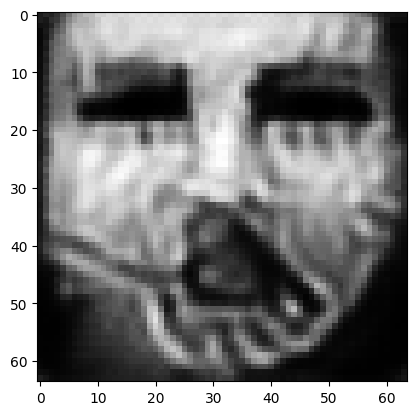

tensor([[9.7219e-01, 6.0476e-07, 9.8147e-04, 2.6339e-06, 6.0954e-05, 1.2111e-03,
         1.0128e-02, 5.3126e-03, 9.3128e-10, 1.4534e-05, 1.3726e-05, 3.8333e-06,
         2.4127e-07, 1.5040e-08, 1.3041e-06, 3.6619e-04, 3.1970e-04, 2.8580e-03,
         1.6343e-05, 6.9213e-05, 8.9983e-07, 2.2507e-06, 2.8376e-10, 6.1085e-03,
         3.3852e-05, 1.0620e-08, 2.1117e-05, 1.1776e-04, 7.8773e-05, 7.4564e-07,
         4.4237e-09, 1.2455e-05, 2.6451e-05, 2.7214e-06, 5.1497e-06, 4.7568e-07,
         2.3044e-05, 1.5169e-05, 2.9694e-06, 2.8116e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028206976130604744
tensor([[9.7239e-01, 6.0111e-07, 9.7521e-04, 2.6189e-06, 6.0460e-05, 1.2022e-03,
         1.0061e-02, 5.2797e-03, 9.2002e-10, 1.4477e-05, 1.3626e-05, 3.7994e-06,
         2.3873e-07, 1.4846e-08, 1.2903e-06, 3.6426e-04, 3.1654e-04, 2.8309e-03,
         1.6244e-05, 6.8616e-05, 8.8916e-07, 2.2249e-06, 2.7918e-10, 6.0534e-03,
         3.3446e-05, 1.0502e-08, 2.0996e-

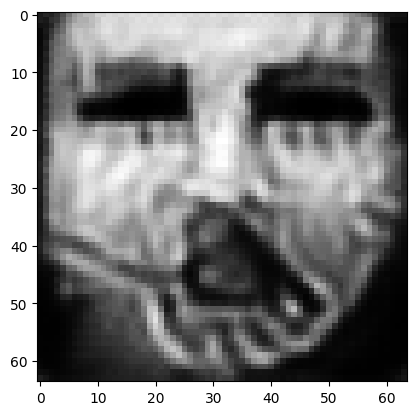

tensor([[9.7317e-01, 5.8657e-07, 9.5218e-04, 2.5685e-06, 5.8736e-05, 1.1716e-03,
         9.8068e-03, 5.1579e-03, 8.8400e-10, 1.4254e-05, 1.3208e-05, 3.6751e-06,
         2.2994e-07, 1.4127e-08, 1.2359e-06, 3.5557e-04, 3.0385e-04, 2.7275e-03,
         1.5849e-05, 6.6401e-05, 8.4905e-07, 2.1342e-06, 2.6346e-10, 5.8439e-03,
         3.2004e-05, 1.0094e-08, 2.0564e-05, 1.1302e-04, 7.5842e-05, 7.1482e-07,
         4.1653e-09, 1.2057e-05, 2.5026e-05, 2.6110e-06, 4.9642e-06, 4.5303e-07,
         2.1797e-05, 1.4649e-05, 2.8291e-06, 2.6948e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027192160487174988
tensor([[9.7336e-01, 5.8262e-07, 9.4631e-04, 2.5530e-06, 5.8285e-05, 1.1653e-03,
         9.7484e-03, 5.1322e-03, 8.7460e-10, 1.4193e-05, 1.3108e-05, 3.6459e-06,
         2.2758e-07, 1.3936e-08, 1.2218e-06, 3.5328e-04, 3.0063e-04, 2.7030e-03,
         1.5734e-05, 6.5866e-05, 8.3840e-07, 2.1123e-06, 2.5931e-10, 5.7927e-03,
         3.1647e-05, 9.9890e-09, 2.0454e-

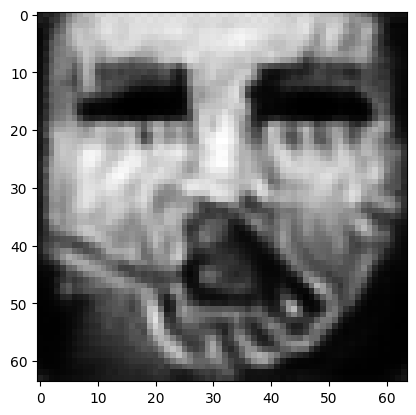

tensor([[9.7404e-01, 5.7047e-07, 9.2466e-04, 2.5054e-06, 5.6723e-05, 1.1392e-03,
         9.5265e-03, 5.0218e-03, 8.4382e-10, 1.3980e-05, 1.2740e-05, 3.5374e-06,
         2.1992e-07, 1.3316e-08, 1.1760e-06, 3.4570e-04, 2.8930e-04, 2.6167e-03,
         1.5367e-05, 6.4020e-05, 8.0342e-07, 2.0318e-06, 2.4554e-10, 5.6063e-03,
         3.0394e-05, 9.6179e-09, 2.0085e-05, 1.0867e-04, 7.3048e-05, 6.8680e-07,
         3.9332e-09, 1.1728e-05, 2.3800e-05, 2.5116e-06, 4.7959e-06, 4.3326e-07,
         2.0661e-05, 1.4178e-05, 2.7063e-06, 2.5910e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02630067989230156
tensor([[9.7420e-01, 5.6764e-07, 9.1952e-04, 2.4942e-06, 5.6368e-05, 1.1331e-03,
         9.4741e-03, 4.9970e-03, 8.3690e-10, 1.3929e-05, 1.2656e-05, 3.5116e-06,
         2.1812e-07, 1.3174e-08, 1.1657e-06, 3.4384e-04, 2.8663e-04, 2.5971e-03,
         1.5279e-05, 6.3591e-05, 7.9524e-07, 2.0133e-06, 2.4236e-10, 5.5624e-03,
         3.0111e-05, 9.5321e-09, 1.9998e-0

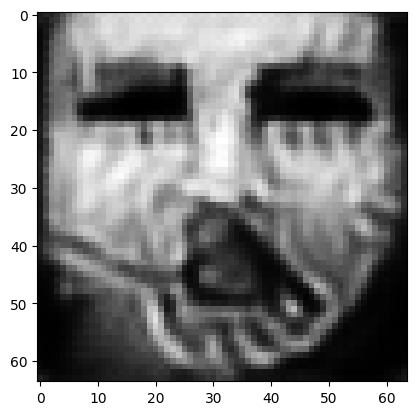

tensor([[9.7481e-01, 5.5460e-07, 8.9976e-04, 2.4483e-06, 5.5033e-05, 1.1082e-03,
         9.2678e-03, 4.9068e-03, 8.0802e-10, 1.3710e-05, 1.2323e-05, 3.4070e-06,
         2.1092e-07, 1.2616e-08, 1.1251e-06, 3.3581e-04, 2.7702e-04, 2.5201e-03,
         1.4918e-05, 6.1842e-05, 7.6303e-07, 1.9448e-06, 2.3031e-10, 5.4084e-03,
         2.9087e-05, 9.2137e-09, 1.9580e-05, 1.0483e-04, 7.0372e-05, 6.6128e-07,
         3.7372e-09, 1.1419e-05, 2.2757e-05, 2.4234e-06, 4.6394e-06, 4.1631e-07,
         1.9686e-05, 1.3767e-05, 2.6014e-06, 2.4882e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025517409667372704
tensor([[9.7495e-01, 5.5212e-07, 8.9432e-04, 2.4379e-06, 5.4710e-05, 1.1021e-03,
         9.2211e-03, 4.8807e-03, 8.0195e-10, 1.3649e-05, 1.2242e-05, 3.3843e-06,
         2.0936e-07, 1.2495e-08, 1.1168e-06, 3.3405e-04, 2.7461e-04, 2.5054e-03,
         1.4834e-05, 6.1484e-05, 7.5631e-07, 1.9282e-06, 2.2770e-10, 5.3707e-03,
         2.8842e-05, 9.1309e-09, 1.9498e-

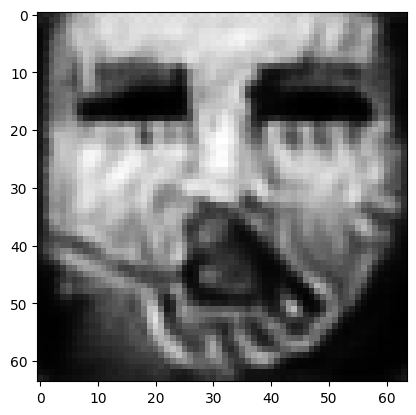

tensor([[9.7550e-01, 5.4232e-07, 8.7343e-04, 2.3948e-06, 5.3420e-05, 1.0798e-03,
         9.0421e-03, 4.7844e-03, 7.7767e-10, 1.3411e-05, 1.1934e-05, 3.2970e-06,
         2.0314e-07, 1.2017e-08, 1.0838e-06, 3.2739e-04, 2.6547e-04, 2.4477e-03,
         1.4502e-05, 6.0091e-05, 7.2986e-07, 1.8624e-06, 2.1730e-10, 5.2250e-03,
         2.7889e-05, 8.8089e-09, 1.9165e-05, 1.0125e-04, 6.7708e-05, 6.3773e-07,
         3.5590e-09, 1.1144e-05, 2.1791e-05, 2.3424e-06, 4.5022e-06, 4.0227e-07,
         1.8802e-05, 1.3352e-05, 2.4982e-06, 2.3945e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02480551227927208
tensor([[9.7563e-01, 5.4003e-07, 8.6864e-04, 2.3849e-06, 5.3117e-05, 1.0745e-03,
         8.9987e-03, 4.7620e-03, 7.7191e-10, 1.3358e-05, 1.1864e-05, 3.2760e-06,
         2.0168e-07, 1.1907e-08, 1.0762e-06, 3.2587e-04, 2.6343e-04, 2.4335e-03,
         1.4426e-05, 5.9762e-05, 7.2373e-07, 1.8470e-06, 2.1488e-10, 5.1918e-03,
         2.7665e-05, 8.7353e-09, 1.9082e-0

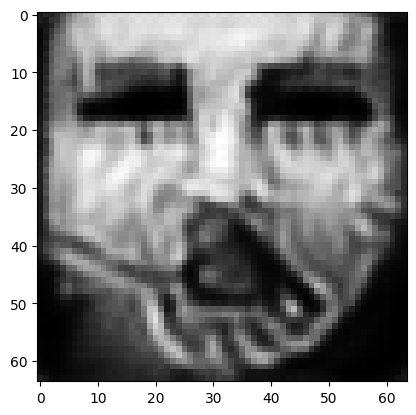

tensor([[9.7612e-01, 5.3112e-07, 8.4873e-04, 2.3426e-06, 5.1932e-05, 1.0548e-03,
         8.8380e-03, 4.6779e-03, 7.4850e-10, 1.3126e-05, 1.1579e-05, 3.1963e-06,
         1.9587e-07, 1.1474e-08, 1.0464e-06, 3.1987e-04, 2.5547e-04, 2.3818e-03,
         1.4116e-05, 5.8476e-05, 6.9984e-07, 1.7878e-06, 2.0551e-10, 5.0655e-03,
         2.6780e-05, 8.4349e-09, 1.8747e-05, 9.8028e-05, 6.5204e-05, 6.1574e-07,
         3.3961e-09, 1.0886e-05, 2.0887e-05, 2.2667e-06, 4.3724e-06, 3.8919e-07,
         1.7998e-05, 1.2957e-05, 2.4018e-06, 2.3040e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024172818288207054
tensor([[9.7623e-01, 5.2900e-07, 8.4364e-04, 2.3319e-06, 5.1637e-05, 1.0498e-03,
         8.7996e-03, 4.6564e-03, 7.4261e-10, 1.3063e-05, 1.1506e-05, 3.1768e-06,
         1.9449e-07, 1.1371e-08, 1.0393e-06, 3.1847e-04, 2.5364e-04, 2.3695e-03,
         1.4043e-05, 5.8162e-05, 6.9428e-07, 1.7732e-06, 2.0331e-10, 5.0370e-03,
         2.6562e-05, 8.3589e-09, 1.8656e-

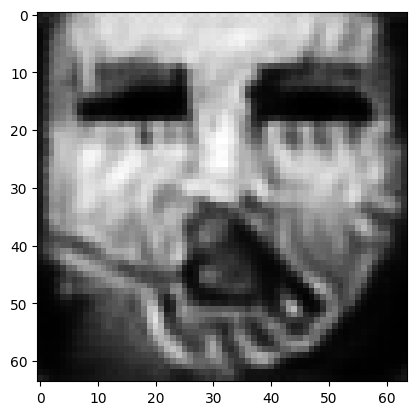

tensor([[9.7668e-01, 5.2101e-07, 8.2453e-04, 2.2915e-06, 5.0517e-05, 1.0307e-03,
         8.6505e-03, 4.5775e-03, 7.2104e-10, 1.2834e-05, 1.1231e-05, 3.1023e-06,
         1.8930e-07, 1.0988e-08, 1.0130e-06, 3.1306e-04, 2.4656e-04, 2.3225e-03,
         1.3762e-05, 5.6963e-05, 6.7340e-07, 1.7195e-06, 1.9519e-10, 4.9295e-03,
         2.5751e-05, 8.0773e-09, 1.8322e-05, 9.5090e-05, 6.2813e-05, 5.9464e-07,
         3.2475e-09, 1.0635e-05, 2.0025e-05, 2.1943e-06, 4.2479e-06, 3.7714e-07,
         1.7274e-05, 1.2560e-05, 2.3098e-06, 2.2147e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023598289117217064
tensor([[9.7678e-01, 5.1908e-07, 8.1997e-04, 2.2817e-06, 5.0251e-05, 1.0261e-03,
         8.6150e-03, 4.5586e-03, 7.1594e-10, 1.2778e-05, 1.1165e-05, 3.0848e-06,
         1.8808e-07, 1.0897e-08, 1.0067e-06, 3.1175e-04, 2.4489e-04, 2.3114e-03,
         1.3694e-05, 5.6678e-05, 6.6850e-07, 1.7068e-06, 1.9329e-10, 4.9044e-03,
         2.5561e-05, 8.0108e-09, 1.8241e-

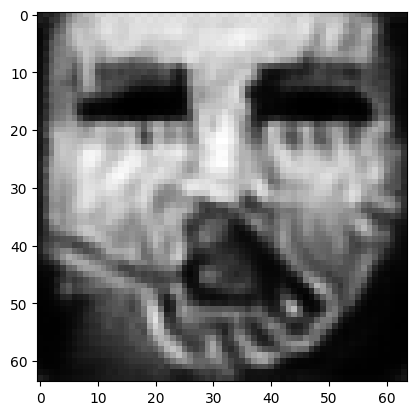

tensor([[9.7719e-01, 5.1113e-07, 8.0244e-04, 2.2430e-06, 4.9212e-05, 1.0080e-03,
         8.4752e-03, 4.4877e-03, 6.9551e-10, 1.2573e-05, 1.0920e-05, 3.0151e-06,
         1.8326e-07, 1.0548e-08, 9.8235e-07, 3.0666e-04, 2.3866e-04, 2.2657e-03,
         1.3430e-05, 5.5555e-05, 6.4913e-07, 1.6592e-06, 1.8593e-10, 4.8127e-03,
         2.4848e-05, 7.7636e-09, 1.7908e-05, 9.2433e-05, 6.0651e-05, 5.7542e-07,
         3.1153e-09, 1.0395e-05, 1.9259e-05, 2.1286e-06, 4.1325e-06, 3.6598e-07,
         1.6622e-05, 1.2208e-05, 2.2280e-06, 2.1313e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023076200857758522
tensor([[9.7728e-01, 5.0923e-07, 7.9832e-04, 2.2341e-06, 4.8972e-05, 1.0034e-03,
         8.4414e-03, 4.4702e-03, 6.9068e-10, 1.2525e-05, 1.0860e-05, 2.9979e-06,
         1.8217e-07, 1.0468e-08, 9.7673e-07, 3.0549e-04, 2.3728e-04, 2.2546e-03,
         1.3372e-05, 5.5288e-05, 6.4468e-07, 1.6478e-06, 1.8426e-10, 4.7921e-03,
         2.4683e-05, 7.7066e-09, 1.7824e-

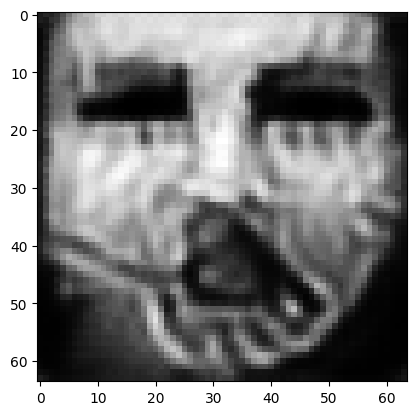

tensor([[9.7765e-01, 5.0224e-07, 7.8213e-04, 2.1981e-06, 4.8036e-05, 9.8610e-04,
         8.3135e-03, 4.4056e-03, 6.7225e-10, 1.2331e-05, 1.0640e-05, 2.9326e-06,
         1.7791e-07, 1.0167e-08, 9.5584e-07, 3.0101e-04, 2.3199e-04, 2.2132e-03,
         1.3139e-05, 5.4284e-05, 6.2767e-07, 1.6044e-06, 1.7787e-10, 4.7154e-03,
         2.4056e-05, 7.4842e-09, 1.7506e-05, 9.0095e-05, 5.8730e-05, 5.5854e-07,
         2.9991e-09, 1.0162e-05, 1.8572e-05, 2.0700e-06, 4.0282e-06, 3.5588e-07,
         1.6041e-05, 1.1882e-05, 2.1554e-06, 2.0547e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022606519982218742
tensor([[9.7773e-01, 5.0057e-07, 7.7828e-04, 2.1893e-06, 4.7818e-05, 9.8201e-04,
         8.2832e-03, 4.3906e-03, 6.6783e-10, 1.2283e-05, 1.0587e-05, 2.9168e-06,
         1.7690e-07, 1.0096e-08, 9.5086e-07, 2.9993e-04, 2.3077e-04, 2.2034e-03,
         1.3083e-05, 5.4044e-05, 6.2363e-07, 1.5942e-06, 1.7637e-10, 4.6980e-03,
         2.3909e-05, 7.4314e-09, 1.7426e-

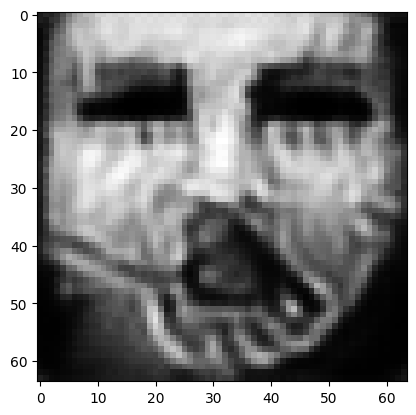

tensor([[9.7804e-01, 4.9431e-07, 7.6370e-04, 2.1559e-06, 4.6960e-05, 9.6778e-04,
         8.1788e-03, 4.3301e-03, 6.5158e-10, 1.2103e-05, 1.0389e-05, 2.8616e-06,
         1.7321e-07, 9.8247e-09, 9.3176e-07, 2.9615e-04, 2.2601e-04, 2.1678e-03,
         1.2870e-05, 5.3198e-05, 6.0891e-07, 1.5562e-06, 1.7079e-10, 4.6315e-03,
         2.3340e-05, 7.2317e-09, 1.7149e-05, 8.8006e-05, 5.7014e-05, 5.4328e-07,
         2.8948e-09, 9.9562e-06, 1.7966e-05, 2.0164e-06, 3.9347e-06, 3.4687e-07,
         1.5524e-05, 1.1584e-05, 2.0908e-06, 1.9877e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022200513631105423
tensor([[9.7812e-01, 4.9313e-07, 7.6031e-04, 2.1492e-06, 4.6771e-05, 9.6409e-04,
         8.1539e-03, 4.3144e-03, 6.4816e-10, 1.2063e-05, 1.0346e-05, 2.8490e-06,
         1.7247e-07, 9.7712e-09, 9.2801e-07, 2.9537e-04, 2.2498e-04, 2.1602e-03,
         1.2827e-05, 5.3016e-05, 6.0595e-07, 1.5474e-06, 1.6965e-10, 4.6167e-03,
         2.3214e-05, 7.1867e-09, 1.7089e-

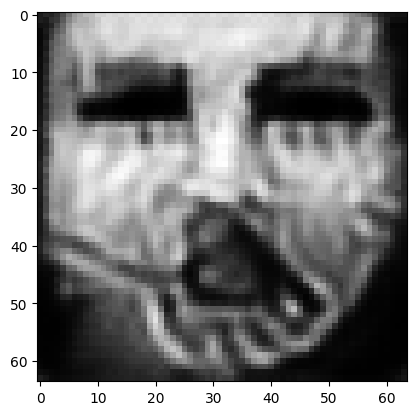

tensor([[9.7840e-01, 4.8773e-07, 7.4711e-04, 2.1203e-06, 4.6025e-05, 9.5081e-04,
         8.0593e-03, 4.2579e-03, 6.3452e-10, 1.1901e-05, 1.0171e-05, 2.8014e-06,
         1.6938e-07, 9.5446e-09, 9.1197e-07, 2.9194e-04, 2.2068e-04, 2.1301e-03,
         1.2639e-05, 5.2297e-05, 5.9359e-07, 1.5143e-06, 1.6500e-10, 4.5578e-03,
         2.2727e-05, 7.0126e-09, 1.6850e-05, 8.6179e-05, 5.5526e-05, 5.3050e-07,
         2.8073e-09, 9.7777e-06, 1.7452e-05, 1.9705e-06, 3.8551e-06, 3.3951e-07,
         1.5088e-05, 1.1325e-05, 2.0348e-06, 1.9315e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021837962791323662
tensor([[9.7847e-01, 4.8621e-07, 7.4379e-04, 2.1124e-06, 4.5832e-05, 9.4767e-04,
         8.0360e-03, 4.2450e-03, 6.3085e-10, 1.1860e-05, 1.0126e-05, 2.7890e-06,
         1.6854e-07, 9.4842e-09, 9.0771e-07, 2.9102e-04, 2.1958e-04, 2.1223e-03,
         1.2588e-05, 5.2110e-05, 5.9020e-07, 1.5060e-06, 1.6376e-10, 4.5427e-03,
         2.2603e-05, 6.9684e-09, 1.6788e-

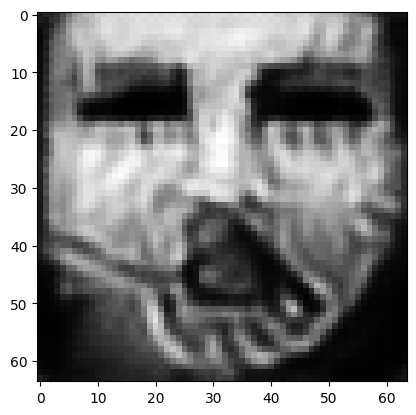

tensor([[9.7874e-01, 4.8036e-07, 7.3128e-04, 2.0838e-06, 4.5116e-05, 9.3407e-04,
         7.9403e-03, 4.1901e-03, 6.1692e-10, 1.1716e-05, 9.9556e-06, 2.7406e-06,
         1.6552e-07, 9.2636e-09, 8.9175e-07, 2.8768e-04, 2.1560e-04, 2.0908e-03,
         1.2410e-05, 5.1384e-05, 5.7789e-07, 1.4749e-06, 1.5923e-10, 4.4890e-03,
         2.2134e-05, 6.8061e-09, 1.6537e-05, 8.4396e-05, 5.4093e-05, 5.1776e-07,
         2.7227e-09, 9.5969e-06, 1.6962e-05, 1.9250e-06, 3.7736e-06, 3.3207e-07,
         1.4672e-05, 1.1077e-05, 1.9819e-06, 1.8745e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02148519828915596
tensor([[9.7881e-01, 4.7913e-07, 7.2835e-04, 2.0777e-06, 4.4954e-05, 9.3081e-04,
         7.9179e-03, 4.1760e-03, 6.1387e-10, 1.1684e-05, 9.9168e-06, 2.7298e-06,
         1.6486e-07, 9.2158e-09, 8.8830e-07, 2.8698e-04, 2.1468e-04, 2.0840e-03,
         1.2372e-05, 5.1226e-05, 5.7527e-07, 1.4678e-06, 1.5824e-10, 4.4762e-03,
         2.2026e-05, 6.7689e-09, 1.6483e-0

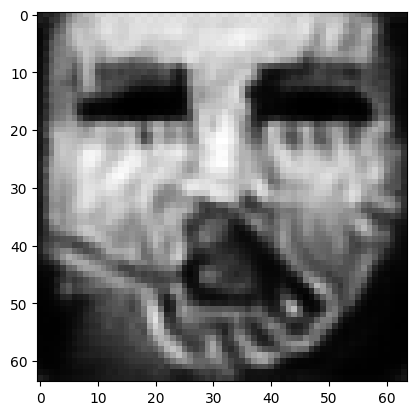

tensor([[9.7906e-01, 4.7417e-07, 7.1692e-04, 2.0520e-06, 4.4309e-05, 9.1875e-04,
         7.8325e-03, 4.1245e-03, 6.0148e-10, 1.1559e-05, 9.7674e-06, 2.6877e-06,
         1.6218e-07, 9.0224e-09, 8.7446e-07, 2.8423e-04, 2.1109e-04, 2.0569e-03,
         1.2214e-05, 5.0608e-05, 5.6458e-07, 1.4401e-06, 1.5424e-10, 4.4264e-03,
         2.1599e-05, 6.6213e-09, 1.6273e-05, 8.2823e-05, 5.2864e-05, 5.0683e-07,
         2.6482e-09, 9.4371e-06, 1.6523e-05, 1.8854e-06, 3.7053e-06, 3.2564e-07,
         1.4310e-05, 1.0854e-05, 1.9335e-06, 1.8252e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021163590252399445
tensor([[9.7912e-01, 4.7303e-07, 7.1417e-04, 2.0460e-06, 4.4155e-05, 9.1571e-04,
         7.8113e-03, 4.1118e-03, 5.9863e-10, 1.1528e-05, 9.7322e-06, 2.6776e-06,
         1.6156e-07, 8.9784e-09, 8.7130e-07, 2.8358e-04, 2.1026e-04, 2.0504e-03,
         1.2177e-05, 5.0462e-05, 5.6214e-07, 1.4335e-06, 1.5333e-10, 4.4151e-03,
         2.1500e-05, 6.5866e-09, 1.6222e-

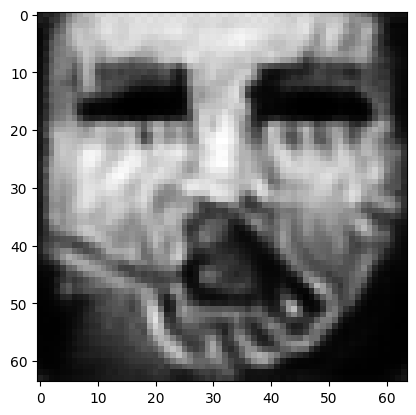

tensor([[9.7936e-01, 4.6809e-07, 7.0247e-04, 2.0197e-06, 4.3529e-05, 9.0380e-04,
         7.7291e-03, 4.0629e-03, 5.8658e-10, 1.1384e-05, 9.5816e-06, 2.6356e-06,
         1.5895e-07, 8.7927e-09, 8.5819e-07, 2.8071e-04, 2.0683e-04, 2.0261e-03,
         1.2013e-05, 4.9850e-05, 5.5179e-07, 1.4067e-06, 1.4953e-10, 4.3700e-03,
         2.1103e-05, 6.4388e-09, 1.6006e-05, 8.1291e-05, 5.1581e-05, 4.9588e-07,
         2.5767e-09, 9.2822e-06, 1.6109e-05, 1.8465e-06, 3.6377e-06, 3.1952e-07,
         1.3961e-05, 1.0632e-05, 1.8866e-06, 1.7755e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020860791206359863
tensor([[9.7941e-01, 4.6704e-07, 6.9969e-04, 2.0138e-06, 4.3379e-05, 9.0070e-04,
         7.7083e-03, 4.0509e-03, 5.8375e-10, 1.1350e-05, 9.5475e-06, 2.6250e-06,
         1.5834e-07, 8.7511e-09, 8.5527e-07, 2.8007e-04, 2.0609e-04, 2.0200e-03,
         1.1976e-05, 4.9699e-05, 5.4943e-07, 1.3999e-06, 1.4864e-10, 4.3595e-03,
         2.1008e-05, 6.4037e-09, 1.5952e-

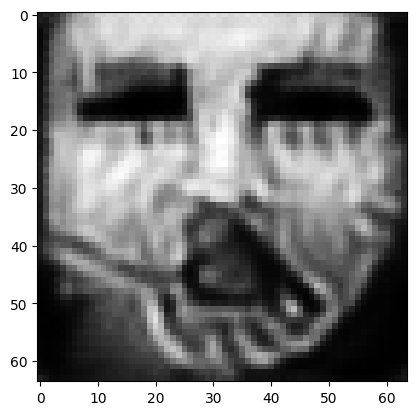

tensor([[9.7964e-01, 4.6251e-07, 6.8985e-04, 1.9917e-06, 4.2846e-05, 8.8917e-04,
         7.6267e-03, 4.0083e-03, 5.7313e-10, 1.1233e-05, 9.4182e-06, 2.5854e-06,
         1.5597e-07, 8.5905e-09, 8.4375e-07, 2.7735e-04, 2.0313e-04, 1.9963e-03,
         1.1830e-05, 4.9108e-05, 5.3997e-07, 1.3757e-06, 1.4526e-10, 4.3172e-03,
         2.0676e-05, 6.2810e-09, 1.5751e-05, 7.9944e-05, 5.0456e-05, 4.8628e-07,
         2.5125e-09, 9.1323e-06, 1.5725e-05, 1.8123e-06, 3.5787e-06, 3.1387e-07,
         1.3640e-05, 1.0438e-05, 1.8443e-06, 1.7301e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020574599504470825
tensor([[9.7969e-01, 4.6138e-07, 6.8728e-04, 1.9859e-06, 4.2709e-05, 8.8627e-04,
         7.6074e-03, 3.9982e-03, 5.7028e-10, 1.1200e-05, 9.3857e-06, 2.5750e-06,
         1.5535e-07, 8.5497e-09, 8.4085e-07, 2.7667e-04, 2.0244e-04, 1.9904e-03,
         1.1793e-05, 4.8955e-05, 5.3757e-07, 1.3695e-06, 1.4440e-10, 4.3071e-03,
         2.0589e-05, 6.2485e-09, 1.5698e-

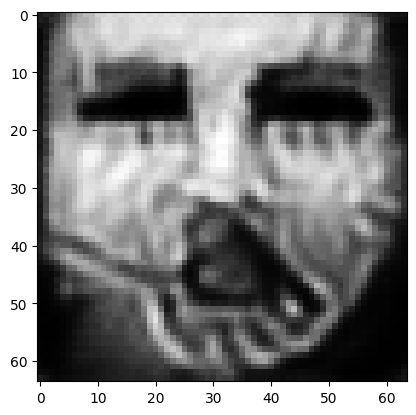

tensor([[9.7989e-01, 4.5642e-07, 6.7883e-04, 1.9661e-06, 4.2253e-05, 8.7555e-04,
         7.5288e-03, 3.9626e-03, 5.5984e-10, 1.1102e-05, 9.2677e-06, 2.5363e-06,
         1.5309e-07, 8.3978e-09, 8.2964e-07, 2.7392e-04, 1.9988e-04, 1.9663e-03,
         1.1655e-05, 4.8354e-05, 5.2824e-07, 1.3482e-06, 1.4127e-10, 4.2691e-03,
         2.0304e-05, 6.1460e-09, 1.5493e-05, 7.8719e-05, 4.9440e-05, 4.7704e-07,
         2.4538e-09, 8.9902e-06, 1.5379e-05, 1.7806e-06, 3.5225e-06, 3.0846e-07,
         1.3354e-05, 1.0268e-05, 1.8067e-06, 1.6864e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020310288295149803
tensor([[9.7994e-01, 4.5528e-07, 6.7692e-04, 1.9621e-06, 4.2157e-05, 8.7279e-04,
         7.5090e-03, 3.9537e-03, 5.5760e-10, 1.1082e-05, 9.2407e-06, 2.5273e-06,
         1.5262e-07, 8.3659e-09, 8.2724e-07, 2.7328e-04, 1.9932e-04, 1.9605e-03,
         1.1625e-05, 4.8216e-05, 5.2624e-07, 1.3437e-06, 1.4063e-10, 4.2614e-03,
         2.0244e-05, 6.1253e-09, 1.5445e-

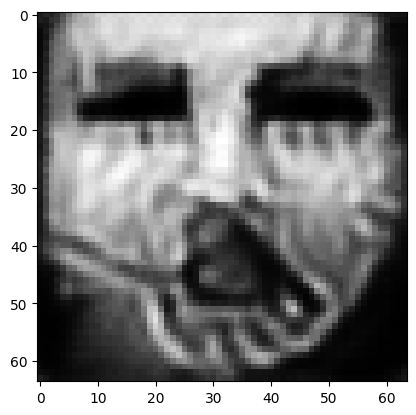

tensor([[9.8013e-01, 4.5068e-07, 6.6910e-04, 1.9444e-06, 4.1751e-05, 8.6317e-04,
         7.4368e-03, 3.9207e-03, 5.4831e-10, 1.0990e-05, 9.1336e-06, 2.4928e-06,
         1.5058e-07, 8.2303e-09, 8.1717e-07, 2.7068e-04, 1.9694e-04, 1.9389e-03,
         1.1494e-05, 4.7673e-05, 5.1784e-07, 1.3246e-06, 1.3782e-10, 4.2263e-03,
         1.9985e-05, 6.0334e-09, 1.5257e-05, 7.7607e-05, 4.8541e-05, 4.6901e-07,
         2.4031e-09, 8.8635e-06, 1.5084e-05, 1.7524e-06, 3.4724e-06, 3.0375e-07,
         1.3108e-05, 1.0124e-05, 1.7746e-06, 1.6481e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02006787247955799
tensor([[9.8018e-01, 4.4970e-07, 6.6711e-04, 1.9404e-06, 4.1655e-05, 8.6055e-04,
         7.4189e-03, 3.9115e-03, 5.4609e-10, 1.0966e-05, 9.1087e-06, 2.4842e-06,
         1.5014e-07, 8.2018e-09, 8.1510e-07, 2.7013e-04, 1.9644e-04, 1.9340e-03,
         1.1467e-05, 4.7543e-05, 5.1604e-07, 1.3200e-06, 1.3722e-10, 4.2191e-03,
         1.9925e-05, 6.0111e-09, 1.5210e-0

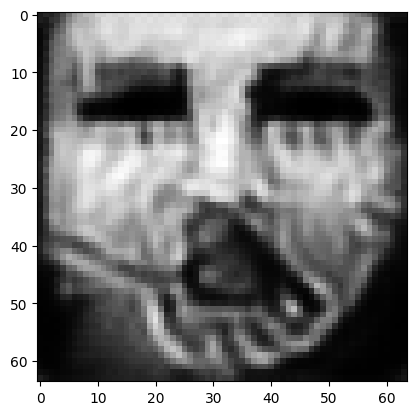

tensor([[9.8036e-01, 4.4558e-07, 6.5973e-04, 1.9250e-06, 4.1290e-05, 8.5133e-04,
         7.3509e-03, 3.8778e-03, 5.3788e-10, 1.0880e-05, 9.0076e-06, 2.4527e-06,
         1.4837e-07, 8.0826e-09, 8.0628e-07, 2.6774e-04, 1.9423e-04, 1.9148e-03,
         1.1348e-05, 4.7057e-05, 5.0869e-07, 1.3028e-06, 1.3475e-10, 4.1869e-03,
         1.9688e-05, 5.9271e-09, 1.5040e-05, 7.6579e-05, 4.7708e-05, 4.6179e-07,
         2.3571e-09, 8.7459e-06, 1.4806e-05, 1.7263e-06, 3.4271e-06, 2.9966e-07,
         1.2883e-05, 9.9843e-06, 1.7446e-06, 1.6127e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01983930543065071
tensor([[9.8040e-01, 4.4460e-07, 6.5789e-04, 1.9213e-06, 4.1201e-05, 8.4899e-04,
         7.3345e-03, 3.8692e-03, 5.3581e-10, 1.0858e-05, 8.9832e-06, 2.4449e-06,
         1.4795e-07, 8.0547e-09, 8.0420e-07, 2.6720e-04, 1.9374e-04, 1.9102e-03,
         1.1320e-05, 4.6934e-05, 5.0698e-07, 1.2986e-06, 1.3418e-10, 4.1798e-03,
         1.9631e-05, 5.9063e-09, 1.4997e-0

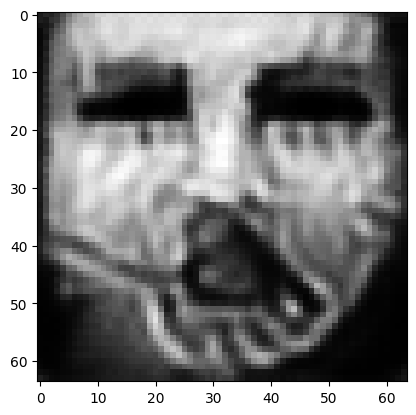

tensor([[9.8057e-01, 4.4077e-07, 6.5066e-04, 1.9063e-06, 4.0848e-05, 8.4020e-04,
         7.2710e-03, 3.8369e-03, 5.2795e-10, 1.0772e-05, 8.8871e-06, 2.4150e-06,
         1.4629e-07, 7.9429e-09, 7.9602e-07, 2.6501e-04, 1.9169e-04, 1.8927e-03,
         1.1208e-05, 4.6474e-05, 5.0014e-07, 1.2822e-06, 1.3190e-10, 4.1506e-03,
         1.9408e-05, 5.8253e-09, 1.4833e-05, 7.5609e-05, 4.6903e-05, 4.5483e-07,
         2.3136e-09, 8.6354e-06, 1.4542e-05, 1.7012e-06, 3.3836e-06, 2.9582e-07,
         1.2672e-05, 9.8503e-06, 1.7159e-06, 1.5788e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019625883549451828
tensor([[9.8061e-01, 4.3994e-07, 6.4909e-04, 1.9033e-06, 4.0771e-05, 8.3815e-04,
         7.2558e-03, 3.8293e-03, 5.2634e-10, 1.0755e-05, 8.8662e-06, 2.4083e-06,
         1.4593e-07, 7.9189e-09, 7.9422e-07, 2.6450e-04, 1.9121e-04, 1.8885e-03,
         1.1184e-05, 4.6374e-05, 4.9862e-07, 1.2786e-06, 1.3140e-10, 4.1433e-03,
         1.9359e-05, 5.8084e-09, 1.4799e-

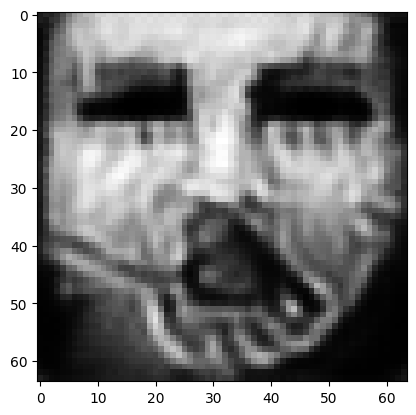

tensor([[9.8076e-01, 4.3637e-07, 6.4223e-04, 1.8888e-06, 4.0448e-05, 8.2992e-04,
         7.1976e-03, 3.8001e-03, 5.1896e-10, 1.0676e-05, 8.7751e-06, 2.3801e-06,
         1.4436e-07, 7.8138e-09, 7.8653e-07, 2.6250e-04, 1.8931e-04, 1.8720e-03,
         1.1078e-05, 4.5950e-05, 4.9219e-07, 1.2634e-06, 1.2928e-10, 4.1170e-03,
         1.9150e-05, 5.7330e-09, 1.4643e-05, 7.4708e-05, 4.6171e-05, 4.4846e-07,
         2.2736e-09, 8.5349e-06, 1.4303e-05, 1.6780e-06, 3.3434e-06, 2.9227e-07,
         1.2475e-05, 9.7285e-06, 1.6896e-06, 1.5483e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019429951906204224
tensor([[9.8079e-01, 4.3538e-07, 6.4065e-04, 1.8850e-06, 4.0375e-05, 8.2817e-04,
         7.1839e-03, 3.7940e-03, 5.1719e-10, 1.0659e-05, 8.7520e-06, 2.3735e-06,
         1.4395e-07, 7.7854e-09, 7.8443e-07, 2.6196e-04, 1.8878e-04, 1.8679e-03,
         1.1050e-05, 4.5849e-05, 4.9046e-07, 1.2600e-06, 1.2872e-10, 4.1096e-03,
         1.9099e-05, 5.7155e-09, 1.4607e-

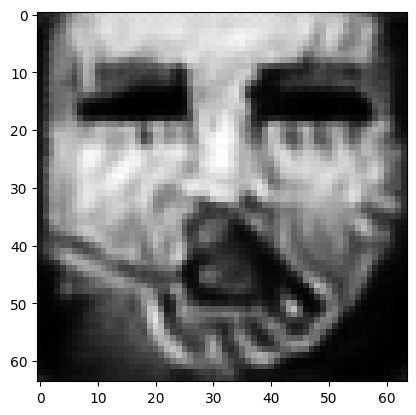

tensor([[9.8094e-01, 4.3209e-07, 6.3423e-04, 1.8713e-06, 4.0088e-05, 8.2041e-04,
         7.1294e-03, 3.7671e-03, 5.1040e-10, 1.0586e-05, 8.6647e-06, 2.3470e-06,
         1.4251e-07, 7.6888e-09, 7.7731e-07, 2.6013e-04, 1.8706e-04, 1.8525e-03,
         1.0953e-05, 4.5452e-05, 4.8453e-07, 1.2461e-06, 1.2679e-10, 4.0863e-03,
         1.8907e-05, 5.6469e-09, 1.4459e-05, 7.3851e-05, 4.5477e-05, 4.4229e-07,
         2.2357e-09, 8.4415e-06, 1.4077e-05, 1.6556e-06, 3.3043e-06, 2.8889e-07,
         1.2288e-05, 9.6118e-06, 1.6653e-06, 1.5194e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019248949363827705
tensor([[9.8097e-01, 4.3135e-07, 6.3279e-04, 1.8684e-06, 4.0025e-05, 8.1861e-04,
         7.1162e-03, 3.7606e-03, 5.0900e-10, 1.0571e-05, 8.6445e-06, 2.3411e-06,
         1.4220e-07, 7.6673e-09, 7.7569e-07, 2.5969e-04, 1.8663e-04, 1.8489e-03,
         1.0930e-05, 4.5365e-05, 4.8319e-07, 1.2430e-06, 1.2636e-10, 4.0803e-03,
         1.8865e-05, 5.6321e-09, 1.4427e-

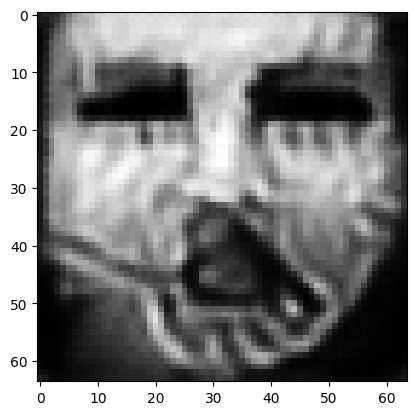

tensor([[9.8110e-01, 4.2811e-07, 6.2678e-04, 1.8548e-06, 3.9745e-05, 8.1170e-04,
         7.0657e-03, 3.7363e-03, 5.0251e-10, 1.0500e-05, 8.5614e-06, 2.3164e-06,
         1.4078e-07, 7.5716e-09, 7.6855e-07, 2.5788e-04, 1.8493e-04, 1.8341e-03,
         1.0834e-05, 4.4989e-05, 4.7735e-07, 1.2298e-06, 1.2446e-10, 4.0567e-03,
         1.8679e-05, 5.5663e-09, 1.4289e-05, 7.3040e-05, 4.4827e-05, 4.3653e-07,
         2.2003e-09, 8.3546e-06, 1.3870e-05, 1.6348e-06, 3.2675e-06, 2.8568e-07,
         1.2112e-05, 9.5028e-06, 1.6426e-06, 1.4928e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019079027697443962
tensor([[9.8113e-01, 4.2742e-07, 6.2522e-04, 1.8515e-06, 3.9673e-05, 8.0979e-04,
         7.0531e-03, 3.7302e-03, 5.0090e-10, 1.0481e-05, 8.5411e-06, 2.3100e-06,
         1.4044e-07, 7.5498e-09, 7.6701e-07, 2.5747e-04, 1.8457e-04, 1.8306e-03,
         1.0812e-05, 4.4895e-05, 4.7602e-07, 1.2264e-06, 1.2402e-10, 4.0521e-03,
         1.8636e-05, 5.5492e-09, 1.4252e-

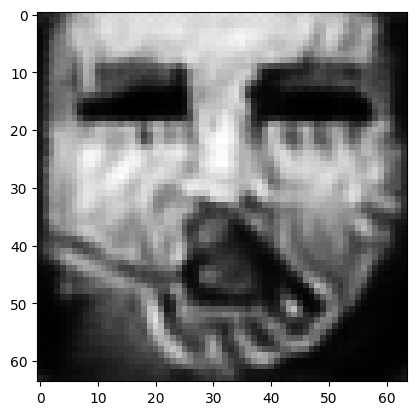

tensor([[9.8126e-01, 4.2455e-07, 6.1973e-04, 1.8398e-06, 3.9422e-05, 8.0304e-04,
         7.0049e-03, 3.7065e-03, 4.9530e-10, 1.0420e-05, 8.4660e-06, 2.2873e-06,
         1.3921e-07, 7.4669e-09, 7.6088e-07, 2.5583e-04, 1.8301e-04, 1.8174e-03,
         1.0727e-05, 4.4561e-05, 4.7086e-07, 1.2144e-06, 1.2236e-10, 4.0306e-03,
         1.8474e-05, 5.4910e-09, 1.4128e-05, 7.2296e-05, 4.4224e-05, 4.3133e-07,
         2.1681e-09, 8.2712e-06, 1.3676e-05, 1.6157e-06, 3.2339e-06, 2.8276e-07,
         1.1949e-05, 9.4012e-06, 1.6213e-06, 1.4678e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018919486552476883
tensor([[9.8129e-01, 4.2387e-07, 6.1830e-04, 1.8369e-06, 3.9358e-05, 8.0134e-04,
         6.9937e-03, 3.7001e-03, 4.9388e-10, 1.0403e-05, 8.4475e-06, 2.2820e-06,
         1.3892e-07, 7.4470e-09, 7.5941e-07, 2.5545e-04, 1.8264e-04, 1.8143e-03,
         1.0706e-05, 4.4480e-05, 4.6967e-07, 1.2114e-06, 1.2196e-10, 4.0255e-03,
         1.8432e-05, 5.4756e-09, 1.4097e-

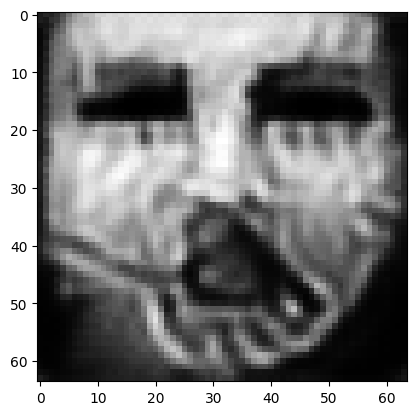

tensor([[9.8141e-01, 4.2120e-07, 6.1300e-04, 1.8257e-06, 3.9111e-05, 7.9522e-04,
         6.9499e-03, 3.6769e-03, 4.8857e-10, 1.0344e-05, 8.3764e-06, 2.2616e-06,
         1.3774e-07, 7.3671e-09, 7.5359e-07, 2.5394e-04, 1.8108e-04, 1.8025e-03,
         1.0623e-05, 4.4176e-05, 4.6480e-07, 1.1999e-06, 1.2037e-10, 4.0029e-03,
         1.8271e-05, 5.4182e-09, 1.3986e-05, 7.1586e-05, 4.3664e-05, 4.2629e-07,
         2.1369e-09, 8.1984e-06, 1.3492e-05, 1.5976e-06, 3.2027e-06, 2.8010e-07,
         1.1796e-05, 9.3061e-06, 1.6003e-06, 1.4450e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01876775734126568
tensor([[9.8144e-01, 4.2060e-07, 6.1166e-04, 1.8231e-06, 3.9051e-05, 7.9358e-04,
         6.9393e-03, 3.6708e-03, 4.8723e-10, 1.0329e-05, 8.3590e-06, 2.2564e-06,
         1.3747e-07, 7.3488e-09, 7.5222e-07, 2.5361e-04, 1.8074e-04, 1.7996e-03,
         1.0605e-05, 4.4099e-05, 4.6368e-07, 1.1971e-06, 1.2000e-10, 3.9979e-03,
         1.8231e-05, 5.4038e-09, 1.3958e-0

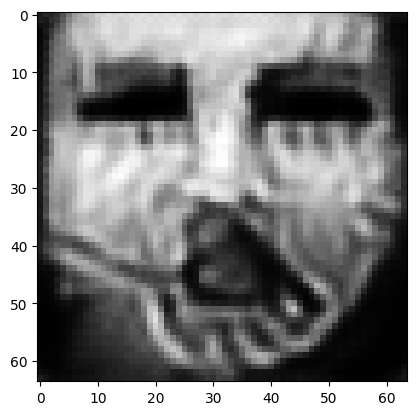

tensor([[9.8155e-01, 4.1825e-07, 6.0680e-04, 1.8130e-06, 3.8813e-05, 7.8788e-04,
         6.8988e-03, 3.6485e-03, 4.8225e-10, 1.0274e-05, 8.2926e-06, 2.2372e-06,
         1.3639e-07, 7.2745e-09, 7.4662e-07, 2.5227e-04, 1.7933e-04, 1.7879e-03,
         1.0533e-05, 4.3807e-05, 4.5923e-07, 1.1861e-06, 1.1853e-10, 3.9765e-03,
         1.8072e-05, 5.3495e-09, 1.3856e-05, 7.0936e-05, 4.3161e-05, 4.2172e-07,
         2.1081e-09, 8.1273e-06, 1.3314e-05, 1.5807e-06, 3.1741e-06, 2.7753e-07,
         1.1653e-05, 9.2131e-06, 1.5806e-06, 1.4244e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018624547868967056
tensor([[9.8157e-01, 4.1775e-07, 6.0571e-04, 1.8108e-06, 3.8757e-05, 7.8655e-04,
         6.8892e-03, 3.6431e-03, 4.8120e-10, 1.0262e-05, 8.2777e-06, 2.2329e-06,
         1.3615e-07, 7.2580e-09, 7.4538e-07, 2.5196e-04, 1.7899e-04, 1.7852e-03,
         1.0516e-05, 4.3742e-05, 4.5824e-07, 1.1834e-06, 1.1820e-10, 3.9711e-03,
         1.8035e-05, 5.3370e-09, 1.3834e-

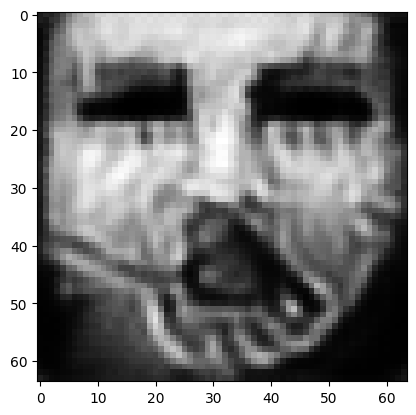

tensor([[9.8168e-01, 4.1543e-07, 6.0122e-04, 1.8010e-06, 3.8533e-05, 7.8146e-04,
         6.8525e-03, 3.6228e-03, 4.7647e-10, 1.0209e-05, 8.2165e-06, 2.2152e-06,
         1.3509e-07, 7.1862e-09, 7.3989e-07, 2.5063e-04, 1.7764e-04, 1.7743e-03,
         1.0444e-05, 4.3461e-05, 4.5399e-07, 1.1730e-06, 1.1678e-10, 3.9500e-03,
         1.7882e-05, 5.2854e-09, 1.3738e-05, 7.0325e-05, 4.2687e-05, 4.1737e-07,
         2.0808e-09, 8.0622e-06, 1.3149e-05, 1.5649e-06, 3.1478e-06, 2.7506e-07,
         1.1516e-05, 9.1279e-06, 1.5620e-06, 1.4058e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018491849303245544
tensor([[9.8170e-01, 4.1498e-07, 6.0007e-04, 1.7988e-06, 3.8476e-05, 7.8008e-04,
         6.8434e-03, 3.6174e-03, 4.7536e-10, 1.0195e-05, 8.2020e-06, 2.2108e-06,
         1.3485e-07, 7.1706e-09, 7.3875e-07, 2.5035e-04, 1.7733e-04, 1.7718e-03,
         1.0428e-05, 4.3394e-05, 4.5307e-07, 1.1704e-06, 1.1647e-10, 3.9453e-03,
         1.7846e-05, 5.2725e-09, 1.3715e-

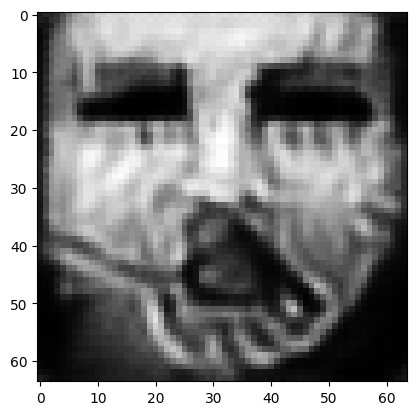

tensor([[9.8180e-01, 4.1292e-07, 5.9575e-04, 1.7898e-06, 3.8259e-05, 7.7511e-04,
         6.8096e-03, 3.5967e-03, 4.7099e-10, 1.0144e-05, 8.1441e-06, 2.1941e-06,
         1.3390e-07, 7.1052e-09, 7.3390e-07, 2.4921e-04, 1.7609e-04, 1.7620e-03,
         1.0365e-05, 4.3137e-05, 4.4931e-07, 1.1603e-06, 1.1520e-10, 3.9258e-03,
         1.7702e-05, 5.2231e-09, 1.3625e-05, 6.9758e-05, 4.2240e-05, 4.1336e-07,
         2.0553e-09, 7.9979e-06, 1.2988e-05, 1.5497e-06, 3.1234e-06, 2.7276e-07,
         1.1390e-05, 9.0439e-06, 1.5437e-06, 1.3881e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018366508185863495
tensor([[9.8182e-01, 4.1229e-07, 5.9479e-04, 1.7874e-06, 3.8209e-05, 7.7410e-04,
         6.8014e-03, 3.5924e-03, 4.6992e-10, 1.0132e-05, 8.1294e-06, 2.1903e-06,
         1.3365e-07, 7.0870e-09, 7.3254e-07, 2.4887e-04, 1.7575e-04, 1.7595e-03,
         1.0346e-05, 4.3074e-05, 4.4827e-07, 1.1580e-06, 1.1486e-10, 3.9204e-03,
         1.7668e-05, 5.2118e-09, 1.3603e-

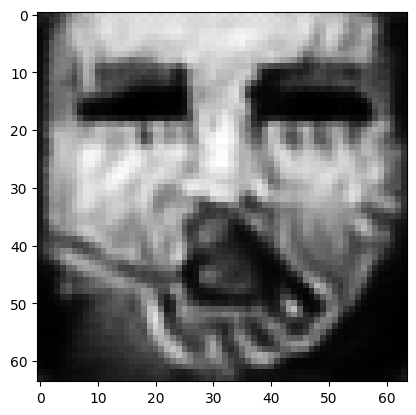

tensor([[9.8192e-01, 4.1032e-07, 5.9071e-04, 1.7791e-06, 3.8003e-05, 7.6925e-04,
         6.7693e-03, 3.5725e-03, 4.6572e-10, 1.0083e-05, 8.0746e-06, 2.1742e-06,
         1.3276e-07, 7.0259e-09, 7.2806e-07, 2.4781e-04, 1.7461e-04, 1.7503e-03,
         1.0289e-05, 4.2827e-05, 4.4479e-07, 1.1485e-06, 1.1369e-10, 3.9024e-03,
         1.7533e-05, 5.1652e-09, 1.3516e-05, 6.9217e-05, 4.1816e-05, 4.0948e-07,
         2.0310e-09, 7.9368e-06, 1.2837e-05, 1.5351e-06, 3.1000e-06, 2.7052e-07,
         1.1273e-05, 8.9655e-06, 1.5265e-06, 1.3714e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01824864186346531
tensor([[9.8194e-01, 4.0974e-07, 5.8967e-04, 1.7765e-06, 3.7948e-05, 7.6821e-04,
         6.7617e-03, 3.5684e-03, 4.6453e-10, 1.0070e-05, 8.0605e-06, 2.1702e-06,
         1.3249e-07, 7.0078e-09, 7.2676e-07, 2.4751e-04, 1.7430e-04, 1.7479e-03,
         1.0271e-05, 4.2761e-05, 4.4378e-07, 1.1461e-06, 1.1335e-10, 3.8977e-03,
         1.7498e-05, 5.1527e-09, 1.3492e-0

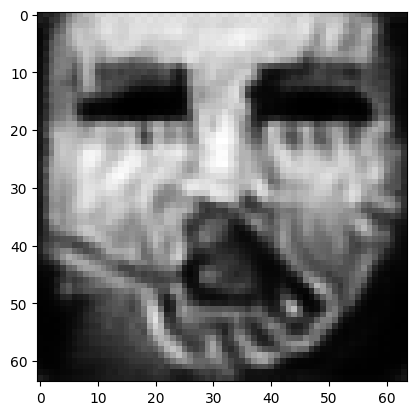

tensor([[9.8202e-01, 4.0788e-07, 5.8601e-04, 1.7689e-06, 3.7769e-05, 7.6370e-04,
         6.7316e-03, 3.5506e-03, 4.6064e-10, 1.0027e-05, 8.0104e-06, 2.1553e-06,
         1.3167e-07, 6.9520e-09, 7.2264e-07, 2.4653e-04, 1.7327e-04, 1.7393e-03,
         1.0218e-05, 4.2529e-05, 4.4057e-07, 1.1375e-06, 1.1227e-10, 3.8812e-03,
         1.7375e-05, 5.1111e-09, 1.3410e-05, 6.8724e-05, 4.1423e-05, 4.0582e-07,
         2.0083e-09, 7.8790e-06, 1.2694e-05, 1.5213e-06, 3.0782e-06, 2.6841e-07,
         1.1164e-05, 8.8913e-06, 1.5105e-06, 1.3553e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018139543011784554
tensor([[9.8204e-01, 4.0735e-07, 5.8517e-04, 1.7668e-06, 3.7723e-05, 7.6280e-04,
         6.7245e-03, 3.5469e-03, 4.5965e-10, 1.0018e-05, 7.9981e-06, 2.1518e-06,
         1.3145e-07, 6.9362e-09, 7.2145e-07, 2.4626e-04, 1.7298e-04, 1.7371e-03,
         1.0203e-05, 4.2471e-05, 4.3966e-07, 1.1355e-06, 1.1197e-10, 3.8765e-03,
         1.7344e-05, 5.1009e-09, 1.3391e-

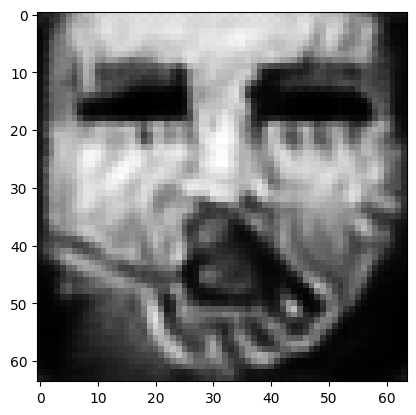

tensor([[9.8212e-01, 4.0559e-07, 5.8169e-04, 1.7591e-06, 3.7546e-05, 7.5871e-04,
         6.6964e-03, 3.5307e-03, 4.5590e-10, 9.9760e-06, 7.9505e-06, 2.1379e-06,
         1.3063e-07, 6.8814e-09, 7.1741e-07, 2.4533e-04, 1.7197e-04, 1.7289e-03,
         1.0150e-05, 4.2247e-05, 4.3654e-07, 1.1272e-06, 1.1091e-10, 3.8604e-03,
         1.7225e-05, 5.0602e-09, 1.3313e-05, 6.8258e-05, 4.1056e-05, 4.0234e-07,
         1.9865e-09, 7.8259e-06, 1.2560e-05, 1.5085e-06, 3.0579e-06, 2.6637e-07,
         1.1060e-05, 8.8224e-06, 1.4954e-06, 1.3405e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018037455156445503
tensor([[9.8214e-01, 4.0518e-07, 5.8094e-04, 1.7576e-06, 3.7506e-05, 7.5774e-04,
         6.6895e-03, 3.5267e-03, 4.5506e-10, 9.9677e-06, 7.9395e-06, 2.1347e-06,
         1.3045e-07, 6.8687e-09, 7.1644e-07, 2.4512e-04, 1.7174e-04, 1.7269e-03,
         1.0139e-05, 4.2193e-05, 4.3582e-07, 1.1253e-06, 1.1067e-10, 3.8561e-03,
         1.7196e-05, 5.0511e-09, 1.3296e-

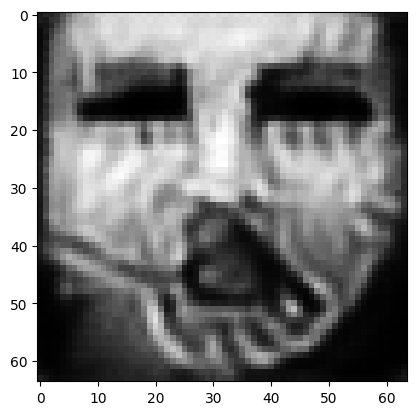

tensor([[9.8222e-01, 4.0355e-07, 5.7761e-04, 1.7505e-06, 3.7324e-05, 7.5357e-04,
         6.6611e-03, 3.5097e-03, 4.5146e-10, 9.9289e-06, 7.8942e-06, 2.1215e-06,
         1.2969e-07, 6.8184e-09, 7.1272e-07, 2.4426e-04, 1.7078e-04, 1.7192e-03,
         1.0091e-05, 4.1985e-05, 4.3302e-07, 1.1173e-06, 1.0966e-10, 3.8417e-03,
         1.7080e-05, 5.0117e-09, 1.3221e-05, 6.7820e-05, 4.0725e-05, 3.9933e-07,
         1.9666e-09, 7.7722e-06, 1.2428e-05, 1.4966e-06, 3.0394e-06, 2.6445e-07,
         1.0963e-05, 8.7554e-06, 1.4807e-06, 1.3267e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017937231808900833
tensor([[9.8224e-01, 4.0305e-07, 5.7671e-04, 1.7481e-06, 3.7272e-05, 7.5265e-04,
         6.6543e-03, 3.5060e-03, 4.5038e-10, 9.9178e-06, 7.8821e-06, 2.1181e-06,
         1.2946e-07, 6.8029e-09, 7.1157e-07, 2.4401e-04, 1.7051e-04, 1.7171e-03,
         1.0076e-05, 4.1929e-05, 4.3217e-07, 1.1152e-06, 1.0936e-10, 3.8377e-03,
         1.7047e-05, 5.0007e-09, 1.3200e-

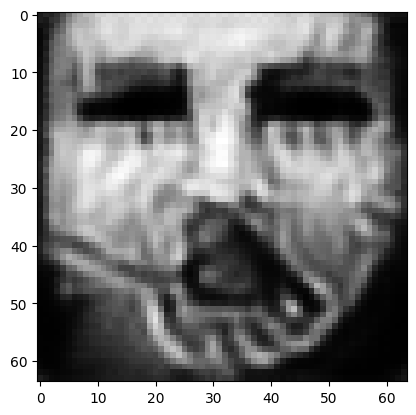

tensor([[9.8232e-01, 4.0154e-07, 5.7363e-04, 1.7417e-06, 3.7096e-05, 7.4876e-04,
         6.6274e-03, 3.4898e-03, 4.4703e-10, 9.8824e-06, 7.8396e-06, 2.1057e-06,
         1.2873e-07, 6.7551e-09, 7.0801e-07, 2.4321e-04, 1.6959e-04, 1.7097e-03,
         1.0030e-05, 4.1732e-05, 4.2953e-07, 1.1075e-06, 1.0840e-10, 3.8232e-03,
         1.6935e-05, 4.9635e-09, 1.3131e-05, 6.7386e-05, 4.0400e-05, 3.9632e-07,
         1.9465e-09, 7.7207e-06, 1.2297e-05, 1.4849e-06, 3.0211e-06, 2.6252e-07,
         1.0865e-05, 8.6890e-06, 1.4662e-06, 1.3133e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017840862274169922
tensor([[9.8234e-01, 4.0117e-07, 5.7286e-04, 1.7400e-06, 3.7053e-05, 7.4781e-04,
         6.6209e-03, 3.4859e-03, 4.4623e-10, 9.8736e-06, 7.8290e-06, 2.1028e-06,
         1.2856e-07, 6.7434e-09, 7.0715e-07, 2.4301e-04, 1.6935e-04, 1.7080e-03,
         1.0019e-05, 4.1687e-05, 4.2888e-07, 1.1057e-06, 1.0816e-10, 3.8197e-03,
         1.6908e-05, 4.9544e-09, 1.3115e-

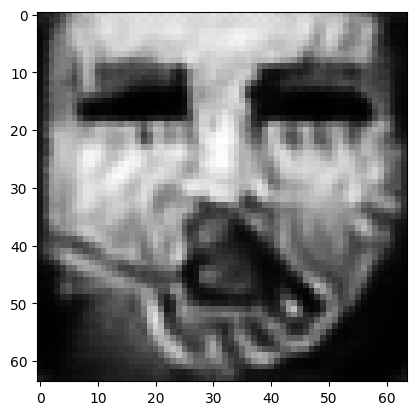

tensor([[9.8241e-01, 3.9968e-07, 5.6981e-04, 1.7333e-06, 3.6879e-05, 7.4423e-04,
         6.5960e-03, 3.4709e-03, 4.4292e-10, 9.8370e-06, 7.7880e-06, 2.0910e-06,
         1.2784e-07, 6.6961e-09, 7.0366e-07, 2.4221e-04, 1.6845e-04, 1.7010e-03,
         9.9735e-06, 4.1499e-05, 4.2627e-07, 1.0983e-06, 1.0722e-10, 3.8059e-03,
         1.6800e-05, 4.9176e-09, 1.3048e-05, 6.6975e-05, 4.0089e-05, 3.9348e-07,
         1.9277e-09, 7.6728e-06, 1.2176e-05, 1.4738e-06, 3.0038e-06, 2.6074e-07,
         1.0774e-05, 8.6261e-06, 1.4525e-06, 1.3007e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0177504550665617
tensor([[9.8242e-01, 3.9934e-07, 5.6912e-04, 1.7318e-06, 3.6839e-05, 7.4339e-04,
         6.5900e-03, 3.4672e-03, 4.4219e-10, 9.8290e-06, 7.7782e-06, 2.0883e-06,
         1.2768e-07, 6.6851e-09, 7.0283e-07, 2.4203e-04, 1.6822e-04, 1.6994e-03,
         9.9630e-06, 4.1456e-05, 4.2567e-07, 1.0966e-06, 1.0700e-10, 3.8023e-03,
         1.6774e-05, 4.9091e-09, 1.3033e-05

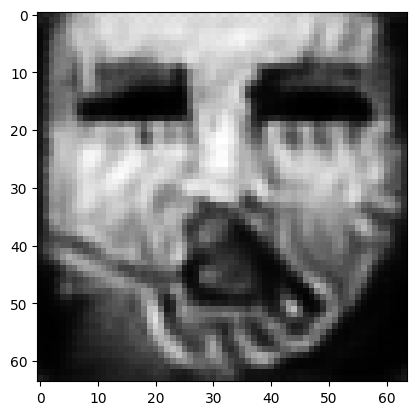

tensor([[9.8249e-01, 3.9799e-07, 5.6626e-04, 1.7255e-06, 3.6674e-05, 7.4009e-04,
         6.5669e-03, 3.4528e-03, 4.3914e-10, 9.7944e-06, 7.7396e-06, 2.0774e-06,
         1.2702e-07, 6.6410e-09, 6.9956e-07, 2.4128e-04, 1.6736e-04, 1.6930e-03,
         9.9203e-06, 4.1282e-05, 4.2324e-07, 1.0895e-06, 1.0612e-10, 3.7887e-03,
         1.6669e-05, 4.8742e-09, 1.2973e-05, 6.6588e-05, 3.9800e-05, 3.9082e-07,
         1.9101e-09, 7.6286e-06, 1.2063e-05, 1.4635e-06, 2.9878e-06, 2.5907e-07,
         1.0687e-05, 8.5657e-06, 1.4396e-06, 1.2891e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0176650770008564
tensor([[9.8251e-01, 3.9768e-07, 5.6558e-04, 1.7241e-06, 3.6635e-05, 7.3926e-04,
         6.5611e-03, 3.4493e-03, 4.3846e-10, 9.7863e-06, 7.7306e-06, 2.0748e-06,
         1.2686e-07, 6.6307e-09, 6.9883e-07, 2.4110e-04, 1.6714e-04, 1.6914e-03,
         9.9104e-06, 4.1241e-05, 4.2267e-07, 1.0879e-06, 1.0591e-10, 3.7852e-03,
         1.6644e-05, 4.8659e-09, 1.2959e-05

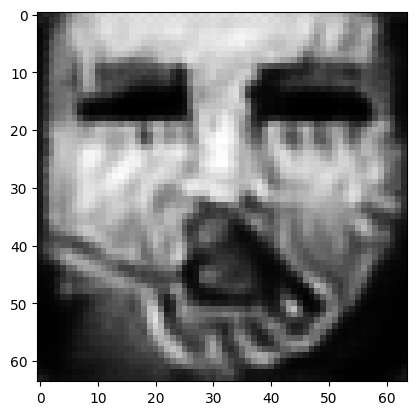

tensor([[9.8257e-01, 3.9625e-07, 5.6259e-04, 1.7168e-06, 3.6457e-05, 7.3591e-04,
         6.5378e-03, 3.4353e-03, 4.3514e-10, 9.7496e-06, 7.6919e-06, 2.0635e-06,
         1.2613e-07, 6.5838e-09, 6.9546e-07, 2.4038e-04, 1.6630e-04, 1.6846e-03,
         9.8680e-06, 4.1060e-05, 4.2014e-07, 1.0807e-06, 1.0499e-10, 3.7726e-03,
         1.6531e-05, 4.8292e-09, 1.2893e-05, 6.6184e-05, 3.9502e-05, 3.8806e-07,
         1.8917e-09, 7.5821e-06, 1.1945e-05, 1.4530e-06, 2.9709e-06, 2.5723e-07,
         1.0597e-05, 8.5027e-06, 1.4265e-06, 1.2772e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01758098043501377
tensor([[9.8259e-01, 3.9592e-07, 5.6192e-04, 1.7152e-06, 3.6416e-05, 7.3513e-04,
         6.5322e-03, 3.4319e-03, 4.3441e-10, 9.7417e-06, 7.6831e-06, 2.0609e-06,
         1.2597e-07, 6.5731e-09, 6.9467e-07, 2.4022e-04, 1.6611e-04, 1.6829e-03,
         9.8583e-06, 4.1019e-05, 4.1957e-07, 1.0790e-06, 1.0477e-10, 3.7695e-03,
         1.6505e-05, 4.8210e-09, 1.2878e-0

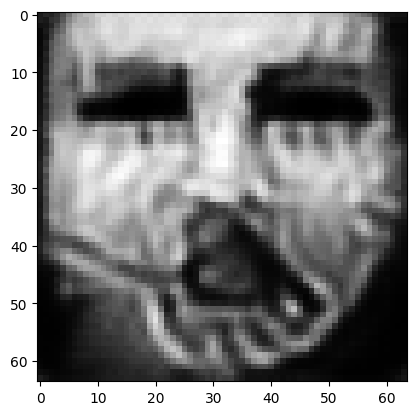

tensor([[9.8265e-01, 3.9456e-07, 5.5920e-04, 1.7085e-06, 3.6251e-05, 7.3203e-04,
         6.5102e-03, 3.4186e-03, 4.3139e-10, 9.7094e-06, 7.6478e-06, 2.0506e-06,
         1.2529e-07, 6.5295e-09, 6.9152e-07, 2.3954e-04, 1.6531e-04, 1.6764e-03,
         9.8187e-06, 4.0852e-05, 4.1721e-07, 1.0724e-06, 1.0391e-10, 3.7573e-03,
         1.6401e-05, 4.7878e-09, 1.2818e-05, 6.5802e-05, 3.9229e-05, 3.8549e-07,
         1.8744e-09, 7.5376e-06, 1.1835e-05, 1.4430e-06, 2.9551e-06, 2.5546e-07,
         1.0513e-05, 8.4446e-06, 1.4142e-06, 1.2663e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0175007414072752
tensor([[9.8267e-01, 3.9426e-07, 5.5855e-04, 1.7070e-06, 3.6212e-05, 7.3126e-04,
         6.5048e-03, 3.4154e-03, 4.3069e-10, 9.7018e-06, 7.6395e-06, 2.0481e-06,
         1.2513e-07, 6.5195e-09, 6.9079e-07, 2.3938e-04, 1.6513e-04, 1.6748e-03,
         9.8097e-06, 4.0813e-05, 4.1666e-07, 1.0708e-06, 1.0371e-10, 3.7545e-03,
         1.6376e-05, 4.7799e-09, 1.2804e-05

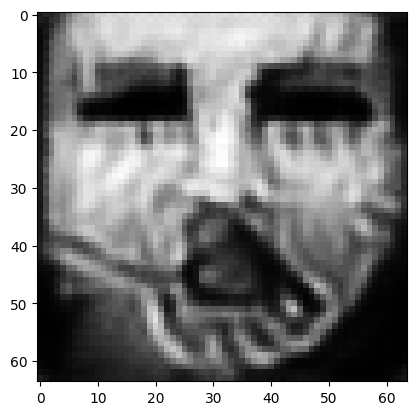

tensor([[9.8273e-01, 3.9298e-07, 5.5598e-04, 1.7007e-06, 3.6057e-05, 7.2832e-04,
         6.4842e-03, 3.4030e-03, 4.2782e-10, 9.6708e-06, 7.6064e-06, 2.0382e-06,
         1.2450e-07, 6.4787e-09, 6.8781e-07, 2.3875e-04, 1.6440e-04, 1.6687e-03,
         9.7726e-06, 4.0653e-05, 4.1445e-07, 1.0645e-06, 1.0290e-10, 3.7431e-03,
         1.6278e-05, 4.7485e-09, 1.2746e-05, 6.5443e-05, 3.8969e-05, 3.8306e-07,
         1.8581e-09, 7.4956e-06, 1.1731e-05, 1.4337e-06, 2.9401e-06, 2.5380e-07,
         1.0433e-05, 8.3893e-06, 1.4026e-06, 1.2558e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0174255333840847
tensor([[9.8274e-01, 3.9271e-07, 5.5535e-04, 1.6993e-06, 3.6020e-05, 7.2759e-04,
         6.4792e-03, 3.3998e-03, 4.2716e-10, 9.6633e-06, 7.5985e-06, 2.0359e-06,
         1.2435e-07, 6.4694e-09, 6.8714e-07, 2.3860e-04, 1.6422e-04, 1.6673e-03,
         9.7641e-06, 4.0616e-05, 4.1395e-07, 1.0630e-06, 1.0272e-10, 3.7405e-03,
         1.6254e-05, 4.7409e-09, 1.2733e-05

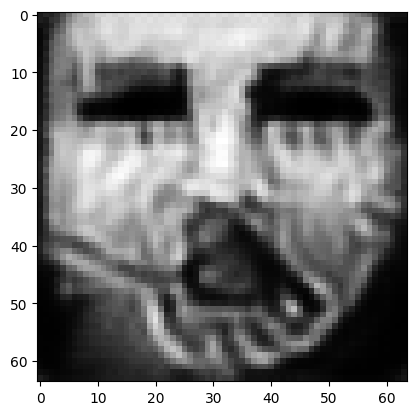

tensor([[9.8280e-01, 3.9155e-07, 5.5290e-04, 1.6935e-06, 3.5873e-05, 7.2477e-04,
         6.4598e-03, 3.3879e-03, 4.2451e-10, 9.6345e-06, 7.5676e-06, 2.0267e-06,
         1.2376e-07, 6.4316e-09, 6.8439e-07, 2.3801e-04, 1.6353e-04, 1.6615e-03,
         9.7299e-06, 4.0467e-05, 4.1188e-07, 1.0570e-06, 1.0197e-10, 3.7295e-03,
         1.6162e-05, 4.7116e-09, 1.2680e-05, 6.5104e-05, 3.8726e-05, 3.8081e-07,
         1.8430e-09, 7.4559e-06, 1.1633e-05, 1.4249e-06, 2.9262e-06, 2.5223e-07,
         1.0358e-05, 8.3377e-06, 1.3915e-06, 1.2462e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01735430397093296
tensor([[9.8281e-01, 3.9129e-07, 5.5227e-04, 1.6920e-06, 3.5837e-05, 7.2407e-04,
         6.4550e-03, 3.3849e-03, 4.2388e-10, 9.6269e-06, 7.5600e-06, 2.0244e-06,
         1.2361e-07, 6.4224e-09, 6.8375e-07, 2.3787e-04, 1.6336e-04, 1.6601e-03,
         9.7214e-06, 4.0432e-05, 4.1139e-07, 1.0555e-06, 1.0179e-10, 3.7269e-03,
         1.6139e-05, 4.7040e-09, 1.2667e-0

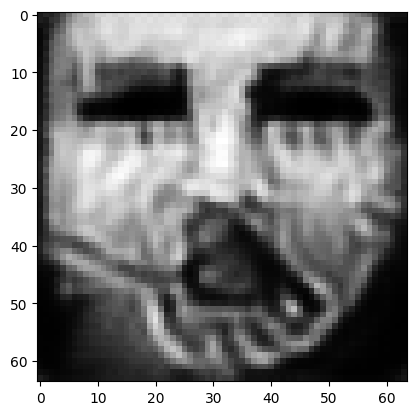

tensor([[9.8286e-01, 3.9017e-07, 5.4988e-04, 1.6862e-06, 3.5694e-05, 7.2142e-04,
         6.4368e-03, 3.3737e-03, 4.2129e-10, 9.5983e-06, 7.5302e-06, 2.0155e-06,
         1.2302e-07, 6.3856e-09, 6.8108e-07, 2.3731e-04, 1.6269e-04, 1.6545e-03,
         9.6880e-06, 4.0288e-05, 4.0938e-07, 1.0496e-06, 1.0105e-10, 3.7163e-03,
         1.6049e-05, 4.6752e-09, 1.2615e-05, 6.4777e-05, 3.8488e-05, 3.7858e-07,
         1.8281e-09, 7.4175e-06, 1.1538e-05, 1.4164e-06, 2.9126e-06, 2.5070e-07,
         1.0284e-05, 8.2868e-06, 1.3806e-06, 1.2367e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017286233603954315
tensor([[9.8288e-01, 3.8992e-07, 5.4933e-04, 1.6850e-06, 3.5662e-05, 7.2077e-04,
         6.4324e-03, 3.3710e-03, 4.2069e-10, 9.5920e-06, 7.5232e-06, 2.0134e-06,
         1.2289e-07, 6.3771e-09, 6.8046e-07, 2.3718e-04, 1.6254e-04, 1.6532e-03,
         9.6806e-06, 4.0253e-05, 4.0891e-07, 1.0483e-06, 1.0088e-10, 3.7137e-03,
         1.6028e-05, 4.6686e-09, 1.2603e-

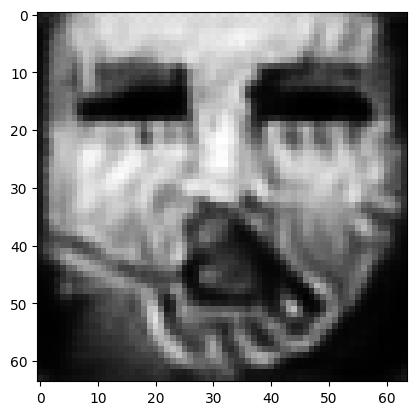

tensor([[9.8292e-01, 3.8889e-07, 5.4711e-04, 1.6796e-06, 3.5530e-05, 7.1833e-04,
         6.4156e-03, 3.3606e-03, 4.1834e-10, 9.5651e-06, 7.4956e-06, 2.0052e-06,
         1.2235e-07, 6.3432e-09, 6.7799e-07, 2.3664e-04, 1.6191e-04, 1.6481e-03,
         9.6491e-06, 4.0122e-05, 4.0705e-07, 1.0428e-06, 1.0021e-10, 3.7036e-03,
         1.5944e-05, 4.6417e-09, 1.2556e-05, 6.4474e-05, 3.8268e-05, 3.7651e-07,
         1.8145e-09, 7.3828e-06, 1.1451e-05, 1.4086e-06, 2.9000e-06, 2.4930e-07,
         1.0217e-05, 8.2403e-06, 1.3707e-06, 1.2281e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01722307875752449
tensor([[9.8294e-01, 3.8860e-07, 5.4657e-04, 1.6782e-06, 3.5497e-05, 7.1779e-04,
         6.4115e-03, 3.3582e-03, 4.1772e-10, 9.5583e-06, 7.4887e-06, 2.0032e-06,
         1.2221e-07, 6.3341e-09, 6.7731e-07, 2.3649e-04, 1.6174e-04, 1.6468e-03,
         9.6404e-06, 4.0088e-05, 4.0655e-07, 1.0415e-06, 1.0003e-10, 3.7010e-03,
         1.5924e-05, 4.6350e-09, 1.2545e-0

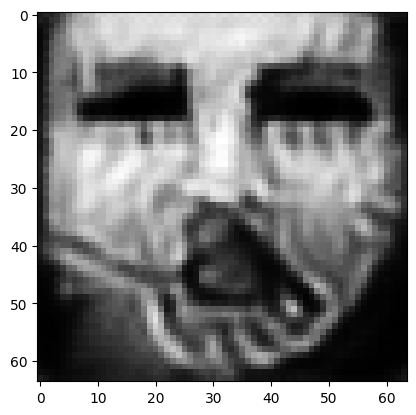

tensor([[9.8298e-01, 3.8768e-07, 5.4449e-04, 1.6734e-06, 3.5375e-05, 7.1539e-04,
         6.3955e-03, 3.3481e-03, 4.1556e-10, 9.5329e-06, 7.4634e-06, 1.9956e-06,
         1.2173e-07, 6.3040e-09, 6.7512e-07, 2.3600e-04, 1.6117e-04, 1.6423e-03,
         9.6119e-06, 3.9966e-05, 4.0488e-07, 1.0364e-06, 9.9422e-11, 3.6918e-03,
         1.5848e-05, 4.6102e-09, 1.2501e-05, 6.4189e-05, 3.8057e-05, 3.7456e-07,
         1.8017e-09, 7.3502e-06, 1.1370e-05, 1.4013e-06, 2.8881e-06, 2.4799e-07,
         1.0154e-05, 8.1972e-06, 1.3613e-06, 1.2198e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017163434997200966
tensor([[9.8299e-01, 3.8745e-07, 5.4400e-04, 1.6723e-06, 3.5347e-05, 7.1480e-04,
         6.3915e-03, 3.3458e-03, 4.1503e-10, 9.5270e-06, 7.4573e-06, 1.9937e-06,
         1.2161e-07, 6.2967e-09, 6.7458e-07, 2.3587e-04, 1.6104e-04, 1.6411e-03,
         9.6050e-06, 3.9935e-05, 4.0446e-07, 1.0352e-06, 9.9275e-11, 3.6896e-03,
         1.5831e-05, 4.6044e-09, 1.2490e-

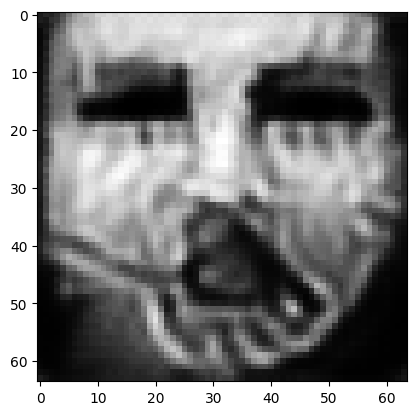

tensor([[9.8304e-01, 3.8645e-07, 5.4202e-04, 1.6674e-06, 3.5228e-05, 7.1257e-04,
         6.3758e-03, 3.3367e-03, 4.1283e-10, 9.5017e-06, 7.4321e-06, 1.9862e-06,
         1.2111e-07, 6.2655e-09, 6.7230e-07, 2.3535e-04, 1.6049e-04, 1.6364e-03,
         9.5754e-06, 3.9810e-05, 4.0272e-07, 1.0303e-06, 9.8662e-11, 3.6807e-03,
         1.5758e-05, 4.5805e-09, 1.2445e-05, 6.3916e-05, 3.7853e-05, 3.7264e-07,
         1.7895e-09, 7.3185e-06, 1.1292e-05, 1.3942e-06, 2.8763e-06, 2.4671e-07,
         1.0093e-05, 8.1563e-06, 1.3524e-06, 1.2117e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01710636541247368
tensor([[9.8305e-01, 3.8622e-07, 5.4152e-04, 1.6662e-06, 3.5200e-05, 7.1201e-04,
         6.3721e-03, 3.3343e-03, 4.1231e-10, 9.4954e-06, 7.4259e-06, 1.9844e-06,
         1.2099e-07, 6.2583e-09, 6.7177e-07, 2.3523e-04, 1.6036e-04, 1.6354e-03,
         9.5685e-06, 3.9781e-05, 4.0232e-07, 1.0291e-06, 9.8517e-11, 3.6787e-03,
         1.5741e-05, 4.5746e-09, 1.2434e-0

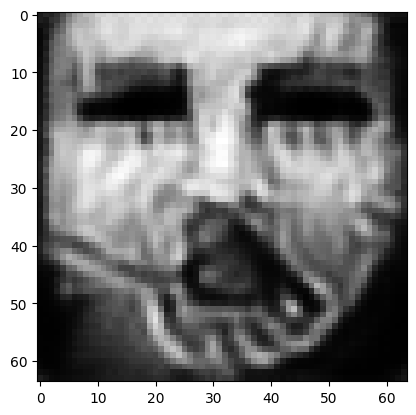

tensor([[9.8309e-01, 3.8534e-07, 5.3965e-04, 1.6618e-06, 3.5089e-05, 7.0985e-04,
         6.3574e-03, 3.3254e-03, 4.1031e-10, 9.4718e-06, 7.4026e-06, 1.9774e-06,
         1.2054e-07, 6.2306e-09, 6.6979e-07, 2.3477e-04, 1.5985e-04, 1.6312e-03,
         9.5421e-06, 3.9669e-05, 4.0079e-07, 1.0245e-06, 9.7964e-11, 3.6706e-03,
         1.5674e-05, 4.5522e-09, 1.2392e-05, 6.3660e-05, 3.7663e-05, 3.7087e-07,
         1.7781e-09, 7.2884e-06, 1.1219e-05, 1.3876e-06, 2.8655e-06, 2.4553e-07,
         1.0037e-05, 8.1173e-06, 1.3440e-06, 1.2041e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017053162679076195
tensor([[9.8310e-01, 3.8514e-07, 5.3919e-04, 1.6607e-06, 3.5061e-05, 7.0931e-04,
         6.3539e-03, 3.3232e-03, 4.0983e-10, 9.4660e-06, 7.3970e-06, 1.9757e-06,
         1.2043e-07, 6.2241e-09, 6.6932e-07, 2.3466e-04, 1.5973e-04, 1.6302e-03,
         9.5358e-06, 3.9643e-05, 4.0042e-07, 1.0234e-06, 9.7832e-11, 3.6687e-03,
         1.5658e-05, 4.5467e-09, 1.2383e-

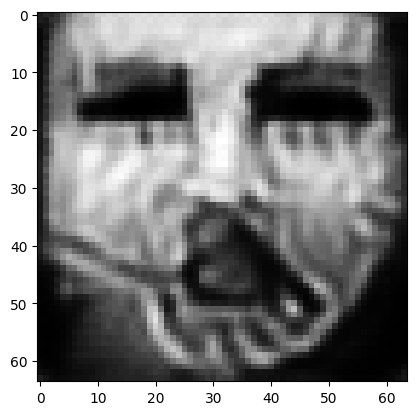

tensor([[9.8314e-01, 3.8427e-07, 5.3743e-04, 1.6564e-06, 3.4955e-05, 7.0734e-04,
         6.3404e-03, 3.3150e-03, 4.0789e-10, 9.4437e-06, 7.3751e-06, 1.9691e-06,
         1.2000e-07, 6.1970e-09, 6.6735e-07, 2.3422e-04, 1.5925e-04, 1.6262e-03,
         9.5101e-06, 3.9536e-05, 3.9892e-07, 1.0191e-06, 9.7294e-11, 3.6608e-03,
         1.5593e-05, 4.5253e-09, 1.2343e-05, 6.3418e-05, 3.7484e-05, 3.6917e-07,
         1.7671e-09, 7.2602e-06, 1.1150e-05, 1.3814e-06, 2.8551e-06, 2.4440e-07,
         9.9834e-06, 8.0807e-06, 1.3360e-06, 1.1969e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017003001645207405
tensor([[9.8315e-01, 3.8406e-07, 5.3702e-04, 1.6554e-06, 3.4929e-05, 7.0686e-04,
         6.3371e-03, 3.3129e-03, 4.0743e-10, 9.4384e-06, 7.3698e-06, 1.9675e-06,
         1.1989e-07, 6.1907e-09, 6.6688e-07, 2.3412e-04, 1.5913e-04, 1.6252e-03,
         9.5042e-06, 3.9511e-05, 3.9858e-07, 1.0180e-06, 9.7168e-11, 3.6589e-03,
         1.5578e-05, 4.5202e-09, 1.2334e-

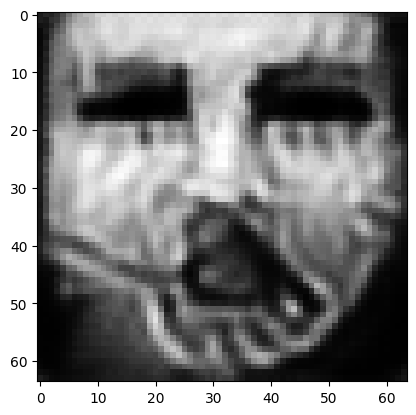

tensor([[9.8319e-01, 3.8326e-07, 5.3536e-04, 1.6514e-06, 3.4831e-05, 7.0496e-04,
         6.3243e-03, 3.3051e-03, 4.0562e-10, 9.4174e-06, 7.3495e-06, 1.9614e-06,
         1.1949e-07, 6.1661e-09, 6.6508e-07, 2.3370e-04, 1.5869e-04, 1.6215e-03,
         9.4803e-06, 3.9411e-05, 3.9720e-07, 1.0140e-06, 9.6671e-11, 3.6518e-03,
         1.5518e-05, 4.5002e-09, 1.2297e-05, 6.3191e-05, 3.7316e-05, 3.6759e-07,
         1.7570e-09, 7.2338e-06, 1.1086e-05, 1.3756e-06, 2.8455e-06, 2.4335e-07,
         9.9337e-06, 8.0467e-06, 1.3285e-06, 1.1901e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01695600338280201
tensor([[9.8320e-01, 3.8307e-07, 5.3497e-04, 1.6504e-06, 3.4807e-05, 7.0451e-04,
         6.3212e-03, 3.3032e-03, 4.0519e-10, 9.4123e-06, 7.3447e-06, 1.9599e-06,
         1.1939e-07, 6.1601e-09, 6.6464e-07, 2.3360e-04, 1.5858e-04, 1.6207e-03,
         9.4745e-06, 3.9388e-05, 3.9687e-07, 1.0130e-06, 9.6552e-11, 3.6500e-03,
         1.5504e-05, 4.4954e-09, 1.2289e-0

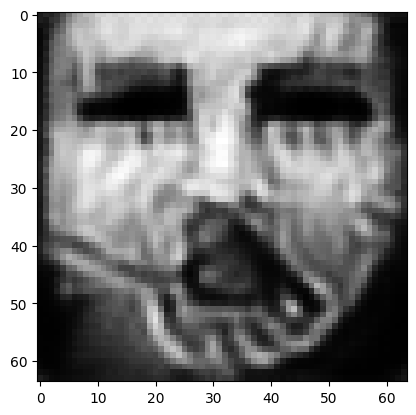

tensor([[9.8323e-01, 3.8232e-07, 5.3342e-04, 1.6467e-06, 3.4714e-05, 7.0276e-04,
         6.3093e-03, 3.2960e-03, 4.0350e-10, 9.3924e-06, 7.3256e-06, 1.9541e-06,
         1.1901e-07, 6.1369e-09, 6.6294e-07, 2.3320e-04, 1.5816e-04, 1.6172e-03,
         9.4518e-06, 3.9295e-05, 3.9557e-07, 1.0092e-06, 9.6084e-11, 3.6431e-03,
         1.5448e-05, 4.4766e-09, 1.2255e-05, 6.2979e-05, 3.7157e-05, 3.6610e-07,
         1.7474e-09, 7.2093e-06, 1.1026e-05, 1.3702e-06, 2.8365e-06, 2.4237e-07,
         9.8865e-06, 8.0146e-06, 1.3215e-06, 1.1838e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016911933198571205
tensor([[9.8324e-01, 3.8214e-07, 5.3305e-04, 1.6458e-06, 3.4692e-05, 7.0234e-04,
         6.3065e-03, 3.2942e-03, 4.0309e-10, 9.3877e-06, 7.3212e-06, 1.9527e-06,
         1.1892e-07, 6.1313e-09, 6.6253e-07, 2.3311e-04, 1.5806e-04, 1.6163e-03,
         9.4464e-06, 3.9273e-05, 3.9526e-07, 1.0083e-06, 9.5972e-11, 3.6415e-03,
         1.5434e-05, 4.4721e-09, 1.2247e-

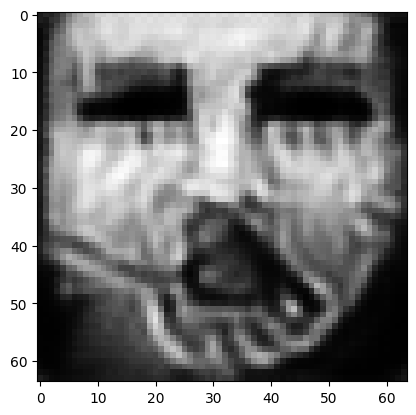

tensor([[9.8327e-01, 3.8142e-07, 5.3151e-04, 1.6420e-06, 3.4600e-05, 7.0063e-04,
         6.2954e-03, 3.2873e-03, 4.0143e-10, 9.3677e-06, 7.3027e-06, 1.9471e-06,
         1.1854e-07, 6.1087e-09, 6.6090e-07, 2.3273e-04, 1.5765e-04, 1.6131e-03,
         9.4243e-06, 3.9184e-05, 3.9399e-07, 1.0046e-06, 9.5518e-11, 3.6349e-03,
         1.5380e-05, 4.4536e-09, 1.2214e-05, 6.2775e-05, 3.7001e-05, 3.6465e-07,
         1.7382e-09, 7.1858e-06, 1.0968e-05, 1.3649e-06, 2.8277e-06, 2.4142e-07,
         9.8408e-06, 7.9834e-06, 1.3147e-06, 1.1776e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016870323568582535
tensor([[9.8328e-01, 3.8125e-07, 5.3116e-04, 1.6411e-06, 3.4578e-05, 7.0023e-04,
         6.2927e-03, 3.2857e-03, 4.0104e-10, 9.3631e-06, 7.2985e-06, 1.9457e-06,
         1.1845e-07, 6.1034e-09, 6.6051e-07, 2.3264e-04, 1.5755e-04, 1.6123e-03,
         9.4191e-06, 3.9162e-05, 3.9370e-07, 1.0038e-06, 9.5411e-11, 3.6334e-03,
         1.5367e-05, 4.4493e-09, 1.2206e-

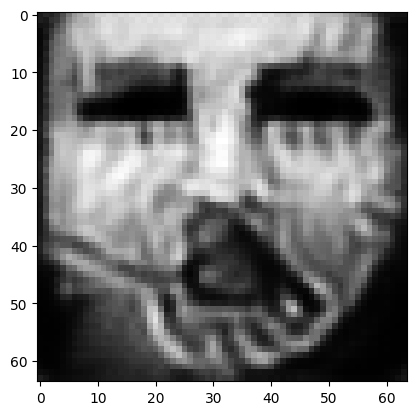

tensor([[9.8331e-01, 3.8056e-07, 5.2972e-04, 1.6375e-06, 3.4492e-05, 6.9863e-04,
         6.2822e-03, 3.2793e-03, 3.9948e-10, 9.3444e-06, 7.2814e-06, 1.9404e-06,
         1.1810e-07, 6.0819e-09, 6.5898e-07, 2.3227e-04, 1.5717e-04, 1.6092e-03,
         9.3979e-06, 3.9077e-05, 3.9250e-07, 1.0003e-06, 9.4978e-11, 3.6273e-03,
         1.5316e-05, 4.4320e-09, 1.2174e-05, 6.2582e-05, 3.6854e-05, 3.6327e-07,
         1.7294e-09, 7.1635e-06, 1.0914e-05, 1.3599e-06, 2.8193e-06, 2.4053e-07,
         9.7973e-06, 7.9539e-06, 1.3083e-06, 1.1718e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01683128997683525
tensor([[9.8332e-01, 3.8039e-07, 5.2938e-04, 1.6366e-06, 3.4471e-05, 6.9824e-04,
         6.2797e-03, 3.2778e-03, 3.9910e-10, 9.3399e-06, 7.2772e-06, 1.9392e-06,
         1.1801e-07, 6.0767e-09, 6.5860e-07, 2.3218e-04, 1.5707e-04, 1.6084e-03,
         9.3928e-06, 3.9056e-05, 3.9221e-07, 9.9951e-07, 9.4874e-11, 3.6258e-03,
         1.5304e-05, 4.4278e-09, 1.2167e-0

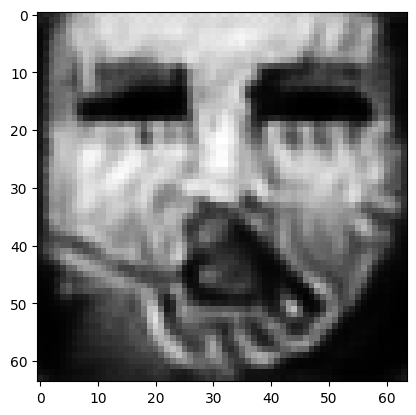

tensor([[9.8335e-01, 3.7973e-07, 5.2802e-04, 1.6332e-06, 3.4390e-05, 6.9672e-04,
         6.2696e-03, 3.2717e-03, 3.9761e-10, 9.3222e-06, 7.2611e-06, 1.9342e-06,
         1.1767e-07, 6.0564e-09, 6.5714e-07, 2.3182e-04, 1.5671e-04, 1.6055e-03,
         9.3726e-06, 3.8976e-05, 3.9107e-07, 9.9627e-07, 9.4464e-11, 3.6200e-03,
         1.5255e-05, 4.4115e-09, 1.2136e-05, 6.2399e-05, 3.6713e-05, 3.6195e-07,
         1.7211e-09, 7.1424e-06, 1.0862e-05, 1.3552e-06, 2.8113e-06, 2.3968e-07,
         9.7560e-06, 7.9258e-06, 1.3022e-06, 1.1662e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016794247552752495
tensor([[9.8335e-01, 3.7957e-07, 5.2769e-04, 1.6324e-06, 3.4370e-05, 6.9635e-04,
         6.2673e-03, 3.2703e-03, 3.9726e-10, 9.3180e-06, 7.2572e-06, 1.9330e-06,
         1.1759e-07, 6.0515e-09, 6.5678e-07, 2.3173e-04, 1.5662e-04, 1.6047e-03,
         9.3677e-06, 3.8956e-05, 3.9080e-07, 9.9548e-07, 9.4364e-11, 3.6186e-03,
         1.5244e-05, 4.4075e-09, 1.2129e-

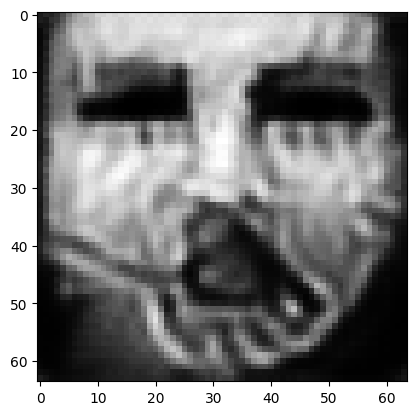

tensor([[9.8338e-01, 3.7895e-07, 5.2640e-04, 1.6291e-06, 3.4292e-05, 6.9489e-04,
         6.2578e-03, 3.2645e-03, 3.9585e-10, 9.3013e-06, 7.2421e-06, 1.9282e-06,
         1.1727e-07, 6.0324e-09, 6.5542e-07, 2.3140e-04, 1.5627e-04, 1.6019e-03,
         9.3488e-06, 3.8880e-05, 3.8972e-07, 9.9240e-07, 9.3974e-11, 3.6131e-03,
         1.5198e-05, 4.3919e-09, 1.2101e-05, 6.2226e-05, 3.6581e-05, 3.6071e-07,
         1.7132e-09, 7.1222e-06, 1.0813e-05, 1.3507e-06, 2.8037e-06, 2.3888e-07,
         9.7167e-06, 7.8991e-06, 1.2964e-06, 1.1609e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016758963465690613
tensor([[9.8339e-01, 3.7881e-07, 5.2609e-04, 1.6284e-06, 3.4273e-05, 6.9454e-04,
         6.2555e-03, 3.2631e-03, 3.9551e-10, 9.2973e-06, 7.2386e-06, 1.9271e-06,
         1.1719e-07, 6.0279e-09, 6.5509e-07, 2.3132e-04, 1.5619e-04, 1.6013e-03,
         9.3442e-06, 3.8862e-05, 3.8946e-07, 9.9165e-07, 9.3881e-11, 3.6118e-03,
         1.5187e-05, 4.3882e-09, 1.2094e-

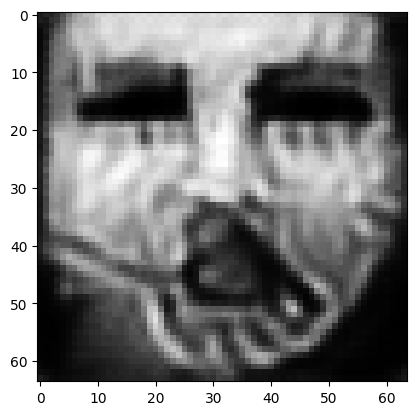

tensor([[9.8341e-01, 3.7823e-07, 5.2486e-04, 1.6253e-06, 3.4200e-05, 6.9315e-04,
         6.2467e-03, 3.2577e-03, 3.9418e-10, 9.2816e-06, 7.2244e-06, 1.9226e-06,
         1.1688e-07, 6.0098e-09, 6.5381e-07, 2.3101e-04, 1.5587e-04, 1.5986e-03,
         9.3264e-06, 3.8790e-05, 3.8845e-07, 9.8873e-07, 9.3512e-11, 3.6065e-03,
         1.5143e-05, 4.3735e-09, 1.2067e-05, 6.2065e-05, 3.6457e-05, 3.5954e-07,
         1.7057e-09, 7.1031e-06, 1.0767e-05, 1.3466e-06, 2.7966e-06, 2.3811e-07,
         9.6795e-06, 7.8738e-06, 1.2909e-06, 1.1559e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01672578603029251
tensor([[9.8342e-01, 3.7808e-07, 5.2457e-04, 1.6245e-06, 3.4182e-05, 6.9282e-04,
         6.2445e-03, 3.2564e-03, 3.9386e-10, 9.2778e-06, 7.2209e-06, 1.9215e-06,
         1.1681e-07, 6.0054e-09, 6.5349e-07, 2.3093e-04, 1.5578e-04, 1.5980e-03,
         9.3219e-06, 3.8772e-05, 3.8820e-07, 9.8803e-07, 9.3422e-11, 3.6053e-03,
         1.5133e-05, 4.3699e-09, 1.2061e-0

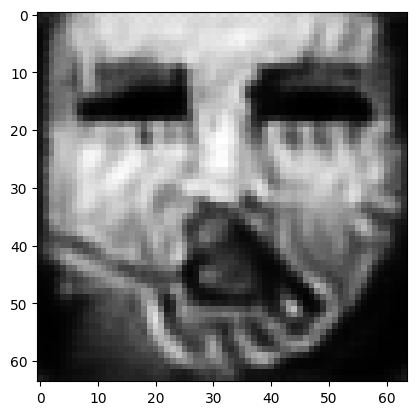

tensor([[9.8344e-01, 3.7753e-07, 5.2339e-04, 1.6216e-06, 3.4111e-05, 6.9151e-04,
         6.2359e-03, 3.2513e-03, 3.9257e-10, 9.2629e-06, 7.2075e-06, 1.9171e-06,
         1.1651e-07, 5.9880e-09, 6.5226e-07, 2.3063e-04, 1.5547e-04, 1.5954e-03,
         9.3048e-06, 3.8703e-05, 3.8721e-07, 9.8522e-07, 9.3064e-11, 3.6002e-03,
         1.5091e-05, 4.3559e-09, 1.2035e-05, 6.1909e-05, 3.6337e-05, 3.5842e-07,
         1.6985e-09, 7.0849e-06, 1.0722e-05, 1.3425e-06, 2.7897e-06, 2.3738e-07,
         9.6435e-06, 7.8497e-06, 1.2856e-06, 1.1511e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016693899407982826
tensor([[9.8345e-01, 3.7739e-07, 5.2309e-04, 1.6208e-06, 3.4094e-05, 6.9116e-04,
         6.2338e-03, 3.2501e-03, 3.9225e-10, 9.2592e-06, 7.2043e-06, 1.9160e-06,
         1.1644e-07, 5.9837e-09, 6.5196e-07, 2.3056e-04, 1.5539e-04, 1.5948e-03,
         9.3004e-06, 3.8686e-05, 3.8696e-07, 9.8452e-07, 9.2973e-11, 3.5990e-03,
         1.5081e-05, 4.3523e-09, 1.2028e-

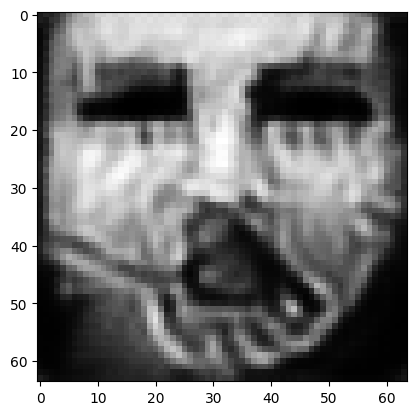

tensor([[9.8347e-01, 3.7687e-07, 5.2194e-04, 1.6179e-06, 3.4026e-05, 6.8987e-04,
         6.2256e-03, 3.2452e-03, 3.9100e-10, 9.2453e-06, 7.1916e-06, 1.9117e-06,
         1.1615e-07, 5.9671e-09, 6.5078e-07, 2.3028e-04, 1.5509e-04, 1.5923e-03,
         9.2838e-06, 3.8621e-05, 3.8600e-07, 9.8180e-07, 9.2624e-11, 3.5941e-03,
         1.5040e-05, 4.3386e-09, 1.2003e-05, 6.1760e-05, 3.6221e-05, 3.5735e-07,
         1.6915e-09, 7.0670e-06, 1.0678e-05, 1.3386e-06, 2.7831e-06, 2.3667e-07,
         9.6076e-06, 7.8258e-06, 1.2804e-06, 1.1464e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016663065180182457
tensor([[9.8348e-01, 3.7674e-07, 5.2164e-04, 1.6172e-06, 3.4009e-05, 6.8955e-04,
         6.2235e-03, 3.2440e-03, 3.9068e-10, 9.2418e-06, 7.1884e-06, 1.9106e-06,
         1.1608e-07, 5.9629e-09, 6.5048e-07, 2.3021e-04, 1.5502e-04, 1.5917e-03,
         9.2796e-06, 3.8604e-05, 3.8576e-07, 9.8114e-07, 9.2536e-11, 3.5929e-03,
         1.5030e-05, 4.3352e-09, 1.1997e-

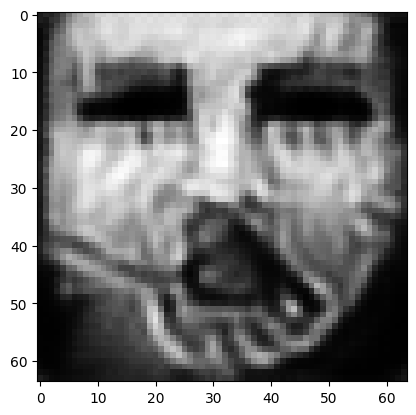

tensor([[9.8350e-01, 3.7623e-07, 5.2052e-04, 1.6143e-06, 3.3943e-05, 6.8830e-04,
         6.2157e-03, 3.2391e-03, 3.8947e-10, 9.2283e-06, 7.1762e-06, 1.9065e-06,
         1.1580e-07, 5.9469e-09, 6.4936e-07, 2.2994e-04, 1.5472e-04, 1.5893e-03,
         9.2636e-06, 3.8541e-05, 3.8484e-07, 9.7854e-07, 9.2202e-11, 3.5883e-03,
         1.4991e-05, 4.3221e-09, 1.1973e-05, 6.1617e-05, 3.6110e-05, 3.5631e-07,
         1.6847e-09, 7.0499e-06, 1.0636e-05, 1.3349e-06, 2.7767e-06, 2.3599e-07,
         9.5735e-06, 7.8029e-06, 1.2754e-06, 1.1419e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016633519902825356
tensor([[9.8351e-01, 3.7611e-07, 5.2026e-04, 1.6137e-06, 3.3927e-05, 6.8801e-04,
         6.2138e-03, 3.2380e-03, 3.8918e-10, 9.2251e-06, 7.1732e-06, 1.9055e-06,
         1.1574e-07, 5.9430e-09, 6.4907e-07, 2.2987e-04, 1.5465e-04, 1.5888e-03,
         9.2597e-06, 3.8526e-05, 3.8462e-07, 9.7791e-07, 9.2122e-11, 3.5871e-03,
         1.4981e-05, 4.3189e-09, 1.1967e-

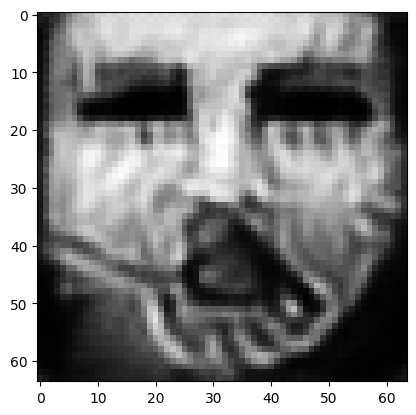

tensor([[9.8353e-01, 3.7558e-07, 5.1919e-04, 1.6109e-06, 3.3864e-05, 6.8681e-04,
         6.2062e-03, 3.2336e-03, 3.8798e-10, 9.2120e-06, 7.1616e-06, 1.9015e-06,
         1.1547e-07, 5.9275e-09, 6.4796e-07, 2.2960e-04, 1.5439e-04, 1.5865e-03,
         9.2442e-06, 3.8464e-05, 3.8372e-07, 9.7547e-07, 9.1804e-11, 3.5829e-03,
         1.4945e-05, 4.3067e-09, 1.1943e-05, 6.1481e-05, 3.6004e-05, 3.5530e-07,
         1.6783e-09, 7.0333e-06, 1.0596e-05, 1.3312e-06, 2.7705e-06, 2.3534e-07,
         9.5418e-06, 7.7815e-06, 1.2706e-06, 1.1375e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016605615615844727
tensor([[9.8354e-01, 3.7545e-07, 5.1893e-04, 1.6103e-06, 3.3849e-05, 6.8651e-04,
         6.2044e-03, 3.2325e-03, 3.8769e-10, 9.2089e-06, 7.1587e-06, 1.9006e-06,
         1.1540e-07, 5.9238e-09, 6.4769e-07, 2.2954e-04, 1.5432e-04, 1.5859e-03,
         9.2405e-06, 3.8449e-05, 3.8350e-07, 9.7488e-07, 9.1726e-11, 3.5819e-03,
         1.4936e-05, 4.3037e-09, 1.1937e-

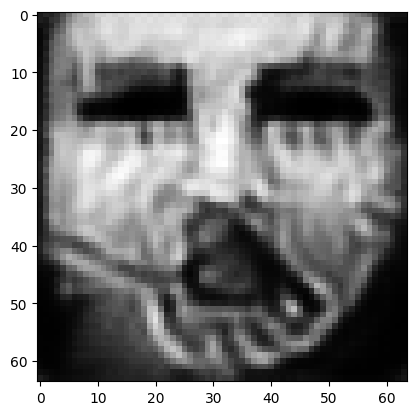

tensor([[9.8356e-01, 3.7495e-07, 5.1794e-04, 1.6077e-06, 3.3791e-05, 6.8538e-04,
         6.1973e-03, 3.2283e-03, 3.8656e-10, 9.1968e-06, 7.1477e-06, 1.8968e-06,
         1.1515e-07, 5.9094e-09, 6.4665e-07, 2.2929e-04, 1.5408e-04, 1.5837e-03,
         9.2260e-06, 3.8391e-05, 3.8266e-07, 9.7260e-07, 9.1429e-11, 3.5780e-03,
         1.4902e-05, 4.2923e-09, 1.1914e-05, 6.1354e-05, 3.5906e-05, 3.5435e-07,
         1.6723e-09, 7.0176e-06, 1.0559e-05, 1.3278e-06, 2.7646e-06, 2.3473e-07,
         9.5123e-06, 7.7615e-06, 1.2661e-06, 1.1333e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01657935231924057
tensor([[9.8356e-01, 3.7483e-07, 5.1770e-04, 1.6071e-06, 3.3776e-05, 6.8510e-04,
         6.1955e-03, 3.2273e-03, 3.8629e-10, 9.1939e-06, 7.1451e-06, 1.8959e-06,
         1.1509e-07, 5.9059e-09, 6.4639e-07, 2.2923e-04, 1.5402e-04, 1.5832e-03,
         9.2227e-06, 3.8376e-05, 3.8245e-07, 9.7204e-07, 9.1357e-11, 3.5771e-03,
         1.4894e-05, 4.2895e-09, 1.1908e-0

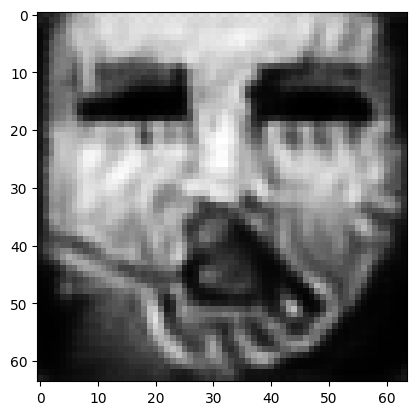

tensor([[9.8358e-01, 3.7436e-07, 5.1676e-04, 1.6047e-06, 3.3722e-05, 6.8402e-04,
         6.1887e-03, 3.2233e-03, 3.8523e-10, 9.1824e-06, 7.1347e-06, 1.8923e-06,
         1.1485e-07, 5.8924e-09, 6.4541e-07, 2.2899e-04, 1.5379e-04, 1.5811e-03,
         9.2090e-06, 3.8322e-05, 3.8166e-07, 9.6989e-07, 9.1077e-11, 3.5734e-03,
         1.4862e-05, 4.2788e-09, 1.1887e-05, 6.1234e-05, 3.5812e-05, 3.5345e-07,
         1.6666e-09, 7.0027e-06, 1.0524e-05, 1.3245e-06, 2.7591e-06, 2.3415e-07,
         9.4846e-06, 7.7428e-06, 1.2619e-06, 1.1294e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016554612666368484
tensor([[9.8359e-01, 3.7424e-07, 5.1653e-04, 1.6041e-06, 3.3708e-05, 6.8376e-04,
         6.1871e-03, 3.2224e-03, 3.8496e-10, 9.1795e-06, 7.1321e-06, 1.8914e-06,
         1.1480e-07, 5.8889e-09, 6.4516e-07, 2.2894e-04, 1.5373e-04, 1.5806e-03,
         9.2056e-06, 3.8308e-05, 3.8146e-07, 9.6936e-07, 9.1008e-11, 3.5726e-03,
         1.4854e-05, 4.2761e-09, 1.1881e-

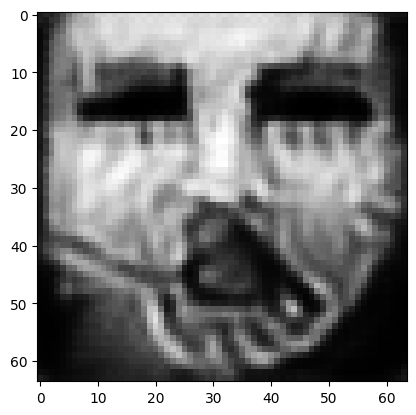

tensor([[9.8360e-01, 3.7380e-07, 5.1565e-04, 1.6018e-06, 3.3656e-05, 6.8274e-04,
         6.1807e-03, 3.2186e-03, 3.8396e-10, 9.1688e-06, 7.1223e-06, 1.8881e-06,
         1.1457e-07, 5.8761e-09, 6.4423e-07, 2.2871e-04, 1.5351e-04, 1.5787e-03,
         9.1928e-06, 3.8256e-05, 3.8071e-07, 9.6732e-07, 9.0745e-11, 3.5691e-03,
         1.4824e-05, 4.2659e-09, 1.1861e-05, 6.1121e-05, 3.5724e-05, 3.5260e-07,
         1.6613e-09, 6.9885e-06, 1.0490e-05, 1.3215e-06, 2.7538e-06, 2.3360e-07,
         9.4584e-06, 7.7249e-06, 1.2579e-06, 1.1256e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016531161963939667
tensor([[9.8361e-01, 3.7368e-07, 5.1543e-04, 1.6013e-06, 3.3644e-05, 6.8250e-04,
         6.1792e-03, 3.2177e-03, 3.8371e-10, 9.1661e-06, 7.1198e-06, 1.8872e-06,
         1.1452e-07, 5.8730e-09, 6.4399e-07, 2.2866e-04, 1.5346e-04, 1.5782e-03,
         9.1896e-06, 3.8243e-05, 3.8053e-07, 9.6683e-07, 9.0680e-11, 3.5683e-03,
         1.4816e-05, 4.2634e-09, 1.1856e-

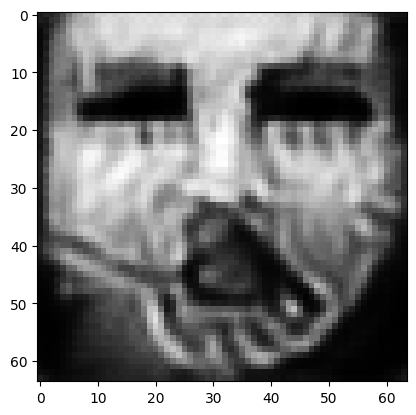

tensor([[9.8363e-01, 3.7327e-07, 5.1461e-04, 1.5992e-06, 3.3596e-05, 6.8154e-04,
         6.1732e-03, 3.2142e-03, 3.8277e-10, 9.1559e-06, 7.1106e-06, 1.8840e-06,
         1.1431e-07, 5.8610e-09, 6.4312e-07, 2.2845e-04, 1.5326e-04, 1.5764e-03,
         9.1776e-06, 3.8194e-05, 3.7982e-07, 9.6491e-07, 9.0433e-11, 3.5650e-03,
         1.4788e-05, 4.2539e-09, 1.1837e-05, 6.1014e-05, 3.5641e-05, 3.5180e-07,
         1.6563e-09, 6.9754e-06, 1.0459e-05, 1.3186e-06, 2.7489e-06, 2.3309e-07,
         9.4339e-06, 7.7083e-06, 1.2542e-06, 1.1221e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01650923490524292
tensor([[9.8363e-01, 3.7316e-07, 5.1440e-04, 1.5986e-06, 3.3584e-05, 6.8129e-04,
         6.1717e-03, 3.2134e-03, 3.8254e-10, 9.1535e-06, 7.1084e-06, 1.8832e-06,
         1.1426e-07, 5.8582e-09, 6.4291e-07, 2.2839e-04, 1.5321e-04, 1.5759e-03,
         9.1746e-06, 3.8181e-05, 3.7965e-07, 9.6445e-07, 9.0374e-11, 3.5642e-03,
         1.4782e-05, 4.2517e-09, 1.1832e-0

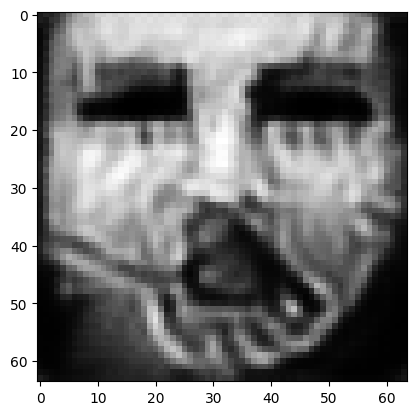

tensor([[9.8365e-01, 3.7277e-07, 5.1361e-04, 1.5966e-06, 3.3539e-05, 6.8038e-04,
         6.1660e-03, 3.2101e-03, 3.8165e-10, 9.1438e-06, 7.0996e-06, 1.8802e-06,
         1.1406e-07, 5.8469e-09, 6.4208e-07, 2.2820e-04, 1.5301e-04, 1.5742e-03,
         9.1631e-06, 3.8134e-05, 3.7898e-07, 9.6263e-07, 9.0141e-11, 3.5611e-03,
         1.4755e-05, 4.2426e-09, 1.1814e-05, 6.0913e-05, 3.5561e-05, 3.5104e-07,
         1.6516e-09, 6.9629e-06, 1.0430e-05, 1.3159e-06, 2.7443e-06, 2.3260e-07,
         9.4108e-06, 7.6927e-06, 1.2507e-06, 1.1188e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016488363966345787
tensor([[9.8365e-01, 3.7267e-07, 5.1342e-04, 1.5962e-06, 3.3527e-05, 6.8016e-04,
         6.1647e-03, 3.2093e-03, 3.8144e-10, 9.1415e-06, 7.0975e-06, 1.8795e-06,
         1.1401e-07, 5.8441e-09, 6.4188e-07, 2.2815e-04, 1.5296e-04, 1.5738e-03,
         9.1604e-06, 3.8123e-05, 3.7882e-07, 9.6218e-07, 9.0085e-11, 3.5602e-03,
         1.4748e-05, 4.2404e-09, 1.1809e-

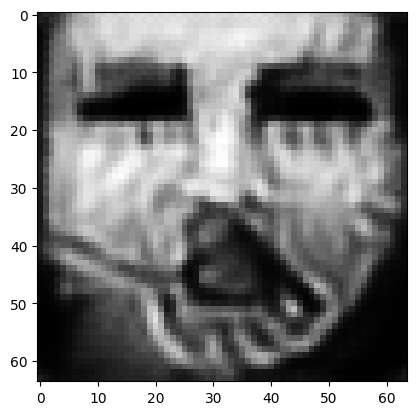

tensor([[9.8367e-01, 3.7229e-07, 5.1266e-04, 1.5942e-06, 3.3484e-05, 6.7929e-04,
         6.1592e-03, 3.2061e-03, 3.8059e-10, 9.1323e-06, 7.0892e-06, 1.8766e-06,
         1.1382e-07, 5.8334e-09, 6.4108e-07, 2.2796e-04, 1.5278e-04, 1.5721e-03,
         9.1495e-06, 3.8078e-05, 3.7818e-07, 9.6045e-07, 8.9863e-11, 3.5573e-03,
         1.4723e-05, 4.2318e-09, 1.1792e-05, 6.0818e-05, 3.5486e-05, 3.5032e-07,
         1.6471e-09, 6.9510e-06, 1.0401e-05, 1.3133e-06, 2.7399e-06, 2.3214e-07,
         9.3889e-06, 7.6777e-06, 1.2473e-06, 1.1156e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01646854728460312
tensor([[9.8367e-01, 3.7220e-07, 5.1249e-04, 1.5938e-06, 3.3474e-05, 6.7909e-04,
         6.1579e-03, 3.2054e-03, 3.8039e-10, 9.1302e-06, 7.0872e-06, 1.8759e-06,
         1.1378e-07, 5.8309e-09, 6.4089e-07, 2.2791e-04, 1.5274e-04, 1.5717e-03,
         9.1468e-06, 3.8067e-05, 3.7803e-07, 9.6004e-07, 8.9810e-11, 3.5565e-03,
         1.4717e-05, 4.2298e-09, 1.1788e-0

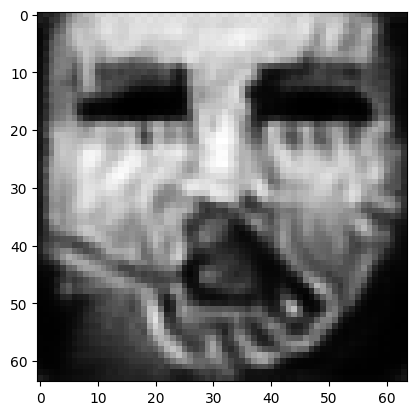

tensor([[9.8369e-01, 3.7185e-07, 5.1177e-04, 1.5920e-06, 3.3433e-05, 6.7824e-04,
         6.1527e-03, 3.2024e-03, 3.7959e-10, 9.1215e-06, 7.0794e-06, 1.8732e-06,
         1.1360e-07, 5.8208e-09, 6.4016e-07, 2.2773e-04, 1.5256e-04, 1.5702e-03,
         9.1365e-06, 3.8025e-05, 3.7742e-07, 9.5840e-07, 8.9603e-11, 3.5538e-03,
         1.4693e-05, 4.2217e-09, 1.1771e-05, 6.0727e-05, 3.5415e-05, 3.4965e-07,
         1.6429e-09, 6.9399e-06, 1.0375e-05, 1.3109e-06, 2.7358e-06, 2.3171e-07,
         9.3681e-06, 7.6637e-06, 1.2442e-06, 1.1127e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01644943282008171
tensor([[9.8369e-01, 3.7176e-07, 5.1159e-04, 1.5915e-06, 3.3422e-05, 6.7804e-04,
         6.1514e-03, 3.2017e-03, 3.7939e-10, 9.1192e-06, 7.0774e-06, 1.8725e-06,
         1.1355e-07, 5.8183e-09, 6.3997e-07, 2.2769e-04, 1.5252e-04, 1.5698e-03,
         9.1340e-06, 3.8014e-05, 3.7728e-07, 9.5800e-07, 8.9551e-11, 3.5531e-03,
         1.4688e-05, 4.2197e-09, 1.1767e-0

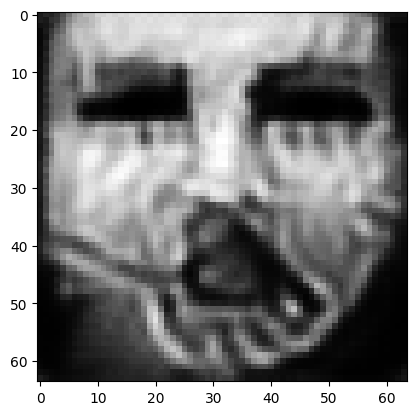

tensor([[9.8370e-01, 3.7142e-07, 5.1093e-04, 1.5898e-06, 3.3384e-05, 6.7727e-04,
         6.1466e-03, 3.1989e-03, 3.7865e-10, 9.1112e-06, 7.0700e-06, 1.8699e-06,
         1.1339e-07, 5.8088e-09, 6.3926e-07, 2.2752e-04, 1.5236e-04, 1.5683e-03,
         9.1243e-06, 3.7974e-05, 3.7671e-07, 9.5647e-07, 8.9355e-11, 3.5505e-03,
         1.4665e-05, 4.2121e-09, 1.1752e-05, 6.0642e-05, 3.5348e-05, 3.4901e-07,
         1.6389e-09, 6.9292e-06, 1.0350e-05, 1.3086e-06, 2.7319e-06, 2.3130e-07,
         9.3485e-06, 7.6504e-06, 1.2412e-06, 1.1099e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016431724652647972
tensor([[9.8371e-01, 3.7134e-07, 5.1077e-04, 1.5894e-06, 3.3375e-05, 6.7707e-04,
         6.1454e-03, 3.1982e-03, 3.7846e-10, 9.1092e-06, 7.0682e-06, 1.8693e-06,
         1.1335e-07, 5.8064e-09, 6.3909e-07, 2.2748e-04, 1.5232e-04, 1.5679e-03,
         9.1219e-06, 3.7964e-05, 3.7656e-07, 9.5610e-07, 8.9307e-11, 3.5499e-03,
         1.4660e-05, 4.2103e-09, 1.1748e-

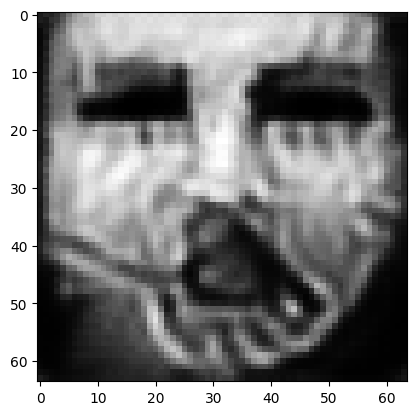

tensor([[9.8372e-01, 3.7101e-07, 5.1015e-04, 1.5878e-06, 3.3339e-05, 6.7634e-04,
         6.1407e-03, 3.1956e-03, 3.7776e-10, 9.1017e-06, 7.0611e-06, 1.8668e-06,
         1.1319e-07, 5.7975e-09, 6.3842e-07, 2.2732e-04, 1.5216e-04, 1.5665e-03,
         9.1128e-06, 3.7926e-05, 3.7603e-07, 9.5466e-07, 8.9123e-11, 3.5474e-03,
         1.4639e-05, 4.2032e-09, 1.1733e-05, 6.0561e-05, 3.5285e-05, 3.4841e-07,
         1.6352e-09, 6.9191e-06, 1.0327e-05, 1.3064e-06, 2.7282e-06, 2.3091e-07,
         9.3302e-06, 7.6380e-06, 1.2384e-06, 1.1072e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016415072605013847
tensor([[9.8372e-01, 3.7093e-07, 5.0999e-04, 1.5874e-06, 3.3330e-05, 6.7616e-04,
         6.1396e-03, 3.1950e-03, 3.7758e-10, 9.0997e-06, 7.0594e-06, 1.8662e-06,
         1.1315e-07, 5.7952e-09, 6.3825e-07, 2.2728e-04, 1.5212e-04, 1.5662e-03,
         9.1105e-06, 3.7917e-05, 3.7590e-07, 9.5430e-07, 8.9077e-11, 3.5468e-03,
         1.4634e-05, 4.2015e-09, 1.1730e-

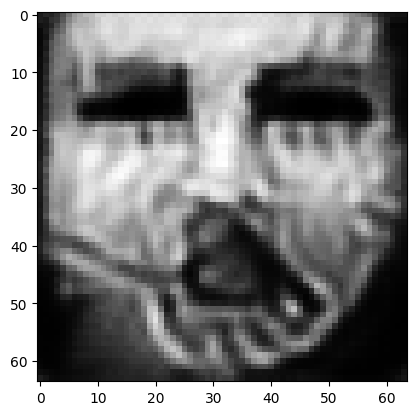

tensor([[9.8373e-01, 3.7063e-07, 5.0940e-04, 1.5859e-06, 3.3296e-05, 6.7546e-04,
         6.1352e-03, 3.1925e-03, 3.7692e-10, 9.0926e-06, 7.0527e-06, 1.8639e-06,
         1.1300e-07, 5.7868e-09, 6.3763e-07, 2.2713e-04, 1.5198e-04, 1.5648e-03,
         9.1019e-06, 3.7881e-05, 3.7539e-07, 9.5294e-07, 8.8903e-11, 3.5444e-03,
         1.4614e-05, 4.1948e-09, 1.1716e-05, 6.0485e-05, 3.5226e-05, 3.4784e-07,
         1.6317e-09, 6.9096e-06, 1.0304e-05, 1.3044e-06, 2.7247e-06, 2.3054e-07,
         9.3127e-06, 7.6261e-06, 1.2358e-06, 1.1047e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016399241983890533
tensor([[9.8374e-01, 3.7055e-07, 5.0926e-04, 1.5856e-06, 3.3288e-05, 6.7528e-04,
         6.1341e-03, 3.1919e-03, 3.7675e-10, 9.0909e-06, 7.0511e-06, 1.8633e-06,
         1.1296e-07, 5.7847e-09, 6.3747e-07, 2.2709e-04, 1.5194e-04, 1.5645e-03,
         9.0997e-06, 3.7872e-05, 3.7526e-07, 9.5261e-07, 8.8860e-11, 3.5439e-03,
         1.4609e-05, 4.1932e-09, 1.1712e-

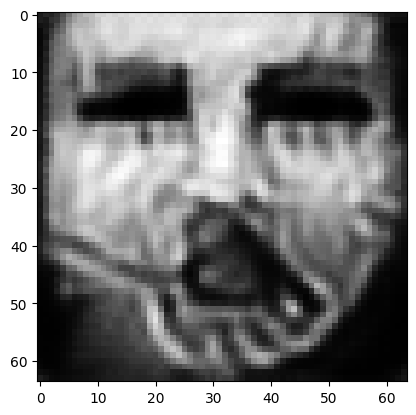

tensor([[9.8375e-01, 3.7026e-07, 5.0870e-04, 1.5841e-06, 3.3256e-05, 6.7462e-04,
         6.1299e-03, 3.1896e-03, 3.7611e-10, 9.0840e-06, 7.0448e-06, 1.8611e-06,
         1.1282e-07, 5.7765e-09, 6.3686e-07, 2.2694e-04, 1.5181e-04, 1.5632e-03,
         9.0914e-06, 3.7837e-05, 3.7477e-07, 9.5132e-07, 8.8693e-11, 3.5417e-03,
         1.4590e-05, 4.1868e-09, 1.1699e-05, 6.0413e-05, 3.5169e-05, 3.4729e-07,
         1.6283e-09, 6.9004e-06, 1.0283e-05, 1.3024e-06, 2.7213e-06, 2.3019e-07,
         9.2963e-06, 7.6150e-06, 1.2333e-06, 1.1023e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016383996233344078
tensor([[9.8375e-01, 3.7019e-07, 5.0857e-04, 1.5838e-06, 3.3248e-05, 6.7446e-04,
         6.1289e-03, 3.1890e-03, 3.7596e-10, 9.0824e-06, 7.0433e-06, 1.8606e-06,
         1.1279e-07, 5.7746e-09, 6.3672e-07, 2.2691e-04, 1.5177e-04, 1.5629e-03,
         9.0895e-06, 3.7829e-05, 3.7466e-07, 9.5100e-07, 8.8654e-11, 3.5411e-03,
         1.4586e-05, 4.1853e-09, 1.1696e-

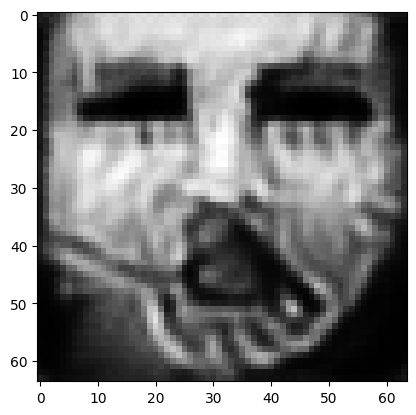

tensor([[9.8376e-01, 3.6992e-07, 5.0805e-04, 1.5825e-06, 3.3218e-05, 6.7384e-04,
         6.1250e-03, 3.1868e-03, 3.7537e-10, 9.0763e-06, 7.0374e-06, 1.8586e-06,
         1.1265e-07, 5.7670e-09, 6.3615e-07, 2.2677e-04, 1.5164e-04, 1.5617e-03,
         9.0819e-06, 3.7797e-05, 3.7421e-07, 9.4980e-07, 8.8499e-11, 3.5390e-03,
         1.4568e-05, 4.1794e-09, 1.1683e-05, 6.0345e-05, 3.5117e-05, 3.4679e-07,
         1.6252e-09, 6.8921e-06, 1.0264e-05, 1.3006e-06, 2.7182e-06, 2.2986e-07,
         9.2809e-06, 7.6046e-06, 1.2309e-06, 1.1001e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016369923949241638
tensor([[9.8377e-01, 3.6985e-07, 5.0792e-04, 1.5821e-06, 3.3210e-05, 6.7369e-04,
         6.1241e-03, 3.1863e-03, 3.7522e-10, 9.0746e-06, 7.0359e-06, 1.8581e-06,
         1.1262e-07, 5.7651e-09, 6.3601e-07, 2.2674e-04, 1.5161e-04, 1.5614e-03,
         9.0800e-06, 3.7788e-05, 3.7410e-07, 9.4950e-07, 8.8460e-11, 3.5385e-03,
         1.4563e-05, 4.1779e-09, 1.1680e-

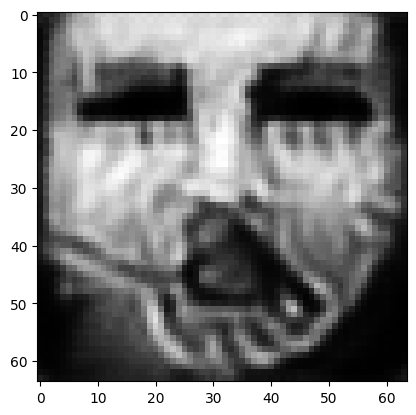

tensor([[9.8378e-01, 3.6960e-07, 5.0744e-04, 1.5809e-06, 3.3183e-05, 6.7310e-04,
         6.1203e-03, 3.1842e-03, 3.7467e-10, 9.0692e-06, 7.0305e-06, 1.8562e-06,
         1.1250e-07, 5.7582e-09, 6.3548e-07, 2.2661e-04, 1.5149e-04, 1.5602e-03,
         9.0729e-06, 3.7758e-05, 3.7368e-07, 9.4839e-07, 8.8316e-11, 3.5365e-03,
         1.4547e-05, 4.1725e-09, 1.1669e-05, 6.0282e-05, 3.5068e-05, 3.4633e-07,
         1.6224e-09, 6.8841e-06, 1.0245e-05, 1.2990e-06, 2.7153e-06, 2.2955e-07,
         9.2665e-06, 7.5951e-06, 1.2288e-06, 1.0981e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016356436535716057
tensor([[9.8378e-01, 3.6954e-07, 5.0733e-04, 1.5806e-06, 3.3176e-05, 6.7295e-04,
         6.1194e-03, 3.1838e-03, 3.7454e-10, 9.0679e-06, 7.0292e-06, 1.8557e-06,
         1.1247e-07, 5.7565e-09, 6.3535e-07, 2.2658e-04, 1.5146e-04, 1.5600e-03,
         9.0712e-06, 3.7751e-05, 3.7357e-07, 9.4812e-07, 8.8281e-11, 3.5361e-03,
         1.4543e-05, 4.1712e-09, 1.1666e-

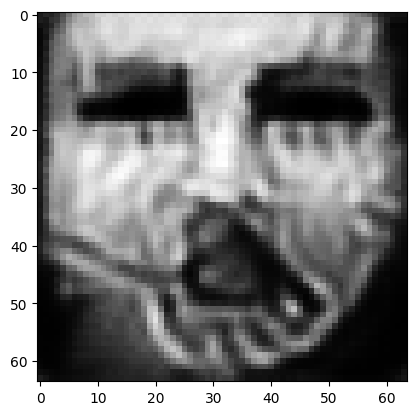

tensor([[9.8379e-01, 3.6930e-07, 5.0687e-04, 1.5794e-06, 3.3150e-05, 6.7239e-04,
         6.1158e-03, 3.1818e-03, 3.7402e-10, 9.0625e-06, 7.0241e-06, 1.8539e-06,
         1.1235e-07, 5.7499e-09, 6.3485e-07, 2.2646e-04, 1.5134e-04, 1.5589e-03,
         9.0645e-06, 3.7722e-05, 3.7317e-07, 9.4706e-07, 8.8145e-11, 3.5342e-03,
         1.4527e-05, 4.1661e-09, 1.1655e-05, 6.0223e-05, 3.5022e-05, 3.4589e-07,
         1.6197e-09, 6.8766e-06, 1.0228e-05, 1.2974e-06, 2.7126e-06, 2.2926e-07,
         9.2529e-06, 7.5860e-06, 1.2267e-06, 1.0961e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016343772411346436
tensor([[9.8379e-01, 3.6924e-07, 5.0675e-04, 1.5792e-06, 3.3143e-05, 6.7225e-04,
         6.1149e-03, 3.1813e-03, 3.7389e-10, 9.0611e-06, 7.0229e-06, 1.8534e-06,
         1.1232e-07, 5.7483e-09, 6.3473e-07, 2.2644e-04, 1.5132e-04, 1.5586e-03,
         9.0628e-06, 3.7715e-05, 3.7308e-07, 9.4680e-07, 8.8111e-11, 3.5338e-03,
         1.4524e-05, 4.1647e-09, 1.1652e-

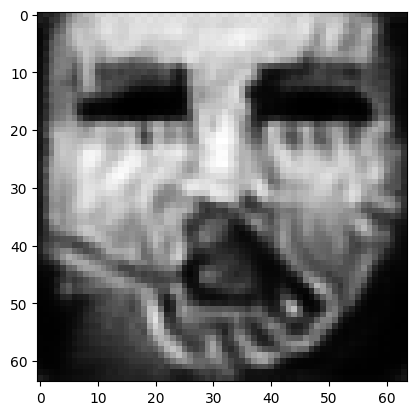

tensor([[9.8380e-01, 3.6901e-07, 5.0632e-04, 1.5781e-06, 3.3119e-05, 6.7172e-04,
         6.1115e-03, 3.1795e-03, 3.7340e-10, 9.0562e-06, 7.0181e-06, 1.8517e-06,
         1.1221e-07, 5.7421e-09, 6.3426e-07, 2.2632e-04, 1.5121e-04, 1.5576e-03,
         9.0565e-06, 3.7688e-05, 3.7270e-07, 9.4580e-07, 8.7983e-11, 3.5320e-03,
         1.4509e-05, 4.1599e-09, 1.1642e-05, 6.0166e-05, 3.4979e-05, 3.4548e-07,
         1.6171e-09, 6.8695e-06, 1.0211e-05, 1.2959e-06, 2.7100e-06, 2.2899e-07,
         9.2400e-06, 7.5774e-06, 1.2248e-06, 1.0943e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016331808641552925
tensor([[9.8380e-01, 3.6896e-07, 5.0621e-04, 1.5778e-06, 3.3112e-05, 6.7159e-04,
         6.1107e-03, 3.1791e-03, 3.7328e-10, 9.0549e-06, 7.0169e-06, 1.8513e-06,
         1.1218e-07, 5.7406e-09, 6.3415e-07, 2.2630e-04, 1.5118e-04, 1.5573e-03,
         9.0550e-06, 3.7681e-05, 3.7261e-07, 9.4555e-07, 8.7951e-11, 3.5316e-03,
         1.4505e-05, 4.1587e-09, 1.1639e-

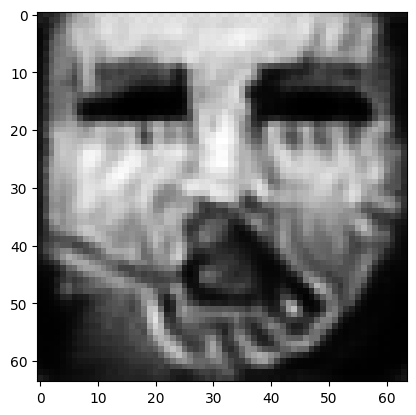

tensor([[9.8381e-01, 3.6875e-07, 5.0580e-04, 1.5768e-06, 3.3089e-05, 6.7108e-04,
         6.1075e-03, 3.1773e-03, 3.7282e-10, 9.0502e-06, 7.0124e-06, 1.8497e-06,
         1.1208e-07, 5.7347e-09, 6.3371e-07, 2.2619e-04, 1.5108e-04, 1.5564e-03,
         9.0489e-06, 3.7656e-05, 3.7226e-07, 9.4460e-07, 8.7830e-11, 3.5299e-03,
         1.4491e-05, 4.1540e-09, 1.1629e-05, 6.0113e-05, 3.4938e-05, 3.4509e-07,
         1.6147e-09, 6.8628e-06, 1.0196e-05, 1.2945e-06, 2.7076e-06, 2.2873e-07,
         9.2278e-06, 7.5692e-06, 1.2229e-06, 1.0925e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01632031612098217
tensor([[9.8381e-01, 3.6870e-07, 5.0570e-04, 1.5765e-06, 3.3083e-05, 6.7096e-04,
         6.1067e-03, 3.1769e-03, 3.7270e-10, 9.0491e-06, 7.0113e-06, 1.8493e-06,
         1.1205e-07, 5.7333e-09, 6.3360e-07, 2.2617e-04, 1.5105e-04, 1.5562e-03,
         9.0475e-06, 3.7649e-05, 3.7217e-07, 9.4437e-07, 8.7800e-11, 3.5295e-03,
         1.4488e-05, 4.1529e-09, 1.1627e-0

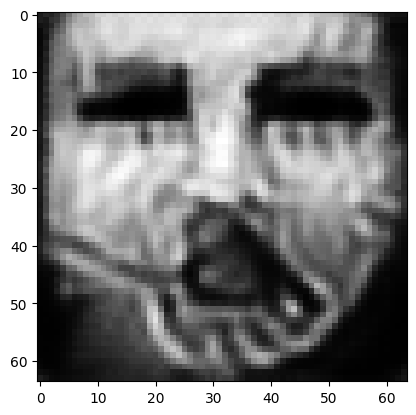

tensor([[9.8382e-01, 3.6850e-07, 5.0530e-04, 1.5755e-06, 3.3060e-05, 6.7048e-04,
         6.1037e-03, 3.1752e-03, 3.7225e-10, 9.0444e-06, 7.0069e-06, 1.8478e-06,
         1.1195e-07, 5.7277e-09, 6.3317e-07, 2.2606e-04, 1.5095e-04, 1.5552e-03,
         9.0417e-06, 3.7625e-05, 3.7183e-07, 9.4346e-07, 8.7682e-11, 3.5279e-03,
         1.4474e-05, 4.1484e-09, 1.1618e-05, 6.0062e-05, 3.4898e-05, 3.4472e-07,
         1.6123e-09, 6.8564e-06, 1.0181e-05, 1.2932e-06, 2.7053e-06, 2.2848e-07,
         9.2161e-06, 7.5614e-06, 1.2211e-06, 1.0908e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016309525817632675
tensor([[9.8382e-01, 3.6845e-07, 5.0521e-04, 1.5753e-06, 3.3055e-05, 6.7036e-04,
         6.1029e-03, 3.1748e-03, 3.7215e-10, 9.0434e-06, 7.0059e-06, 1.8474e-06,
         1.1193e-07, 5.7263e-09, 6.3307e-07, 2.2604e-04, 1.5093e-04, 1.5550e-03,
         9.0403e-06, 3.7619e-05, 3.7175e-07, 9.4324e-07, 8.7654e-11, 3.5275e-03,
         1.4471e-05, 4.1474e-09, 1.1615e-

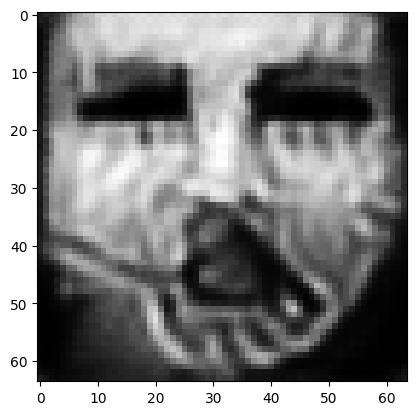

tensor([[9.8383e-01, 3.6826e-07, 5.0484e-04, 1.5743e-06, 3.3034e-05, 6.6991e-04,
         6.1001e-03, 3.1732e-03, 3.7173e-10, 9.0390e-06, 7.0018e-06, 1.8459e-06,
         1.1183e-07, 5.7210e-09, 6.3266e-07, 2.2594e-04, 1.5084e-04, 1.5541e-03,
         9.0348e-06, 3.7595e-05, 3.7142e-07, 9.4237e-07, 8.7543e-11, 3.5259e-03,
         1.4458e-05, 4.1431e-09, 1.1607e-05, 6.0014e-05, 3.4860e-05, 3.4436e-07,
         1.6101e-09, 6.8504e-06, 1.0166e-05, 1.2919e-06, 2.7031e-06, 2.2825e-07,
         9.2050e-06, 7.5539e-06, 1.2194e-06, 1.0893e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016299204900860786
tensor([[9.8383e-01, 3.6821e-07, 5.0474e-04, 1.5741e-06, 3.3028e-05, 6.6979e-04,
         6.0993e-03, 3.1728e-03, 3.7162e-10, 9.0379e-06, 7.0008e-06, 1.8456e-06,
         1.1181e-07, 5.7197e-09, 6.3256e-07, 2.2592e-04, 1.5081e-04, 1.5539e-03,
         9.0335e-06, 3.7590e-05, 3.7135e-07, 9.4216e-07, 8.7516e-11, 3.5256e-03,
         1.4455e-05, 4.1421e-09, 1.1604e-

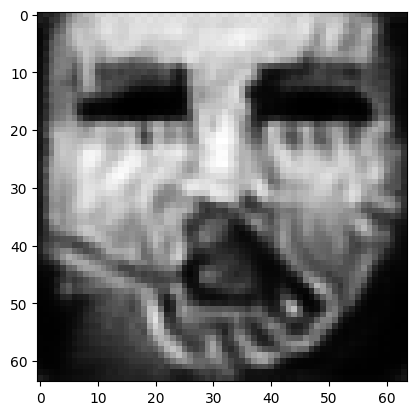

tensor([[9.8384e-01, 3.6802e-07, 5.0439e-04, 1.5732e-06, 3.3008e-05, 6.6937e-04,
         6.0966e-03, 3.1713e-03, 3.7122e-10, 9.0338e-06, 6.9969e-06, 1.8442e-06,
         1.1172e-07, 5.7146e-09, 6.3218e-07, 2.2582e-04, 1.5072e-04, 1.5531e-03,
         9.0282e-06, 3.7568e-05, 3.7104e-07, 9.4134e-07, 8.7410e-11, 3.5241e-03,
         1.4443e-05, 4.1381e-09, 1.1596e-05, 5.9968e-05, 3.4825e-05, 3.4402e-07,
         1.6080e-09, 6.8446e-06, 1.0153e-05, 1.2907e-06, 2.7010e-06, 2.2803e-07,
         9.1944e-06, 7.5469e-06, 1.2178e-06, 1.0878e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016289353370666504
tensor([[9.8384e-01, 3.6798e-07, 5.0430e-04, 1.5730e-06, 3.3003e-05, 6.6926e-04,
         6.0959e-03, 3.1710e-03, 3.7112e-10, 9.0328e-06, 6.9959e-06, 1.8438e-06,
         1.1170e-07, 5.7134e-09, 6.3209e-07, 2.2580e-04, 1.5070e-04, 1.5529e-03,
         9.0270e-06, 3.7562e-05, 3.7096e-07, 9.4114e-07, 8.7384e-11, 3.5238e-03,
         1.4440e-05, 4.1371e-09, 1.1594e-

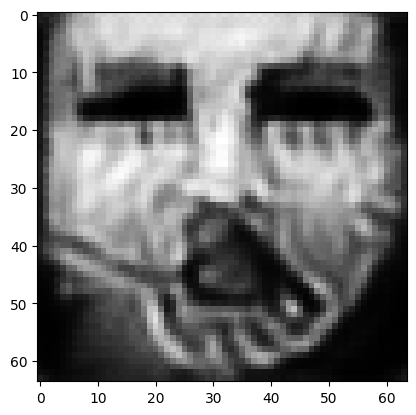

tensor([[9.8385e-01, 3.6781e-07, 5.0397e-04, 1.5721e-06, 3.2984e-05, 6.6885e-04,
         6.0933e-03, 3.1695e-03, 3.7075e-10, 9.0289e-06, 6.9922e-06, 1.8425e-06,
         1.1161e-07, 5.7085e-09, 6.3172e-07, 2.2572e-04, 1.5062e-04, 1.5521e-03,
         9.0221e-06, 3.7541e-05, 3.7067e-07, 9.4036e-07, 8.7284e-11, 3.5224e-03,
         1.4428e-05, 4.1333e-09, 1.1586e-05, 5.9924e-05, 3.4791e-05, 3.4371e-07,
         1.6060e-09, 6.8392e-06, 1.0140e-05, 1.2896e-06, 2.6990e-06, 2.2781e-07,
         9.1844e-06, 7.5402e-06, 1.2163e-06, 1.0863e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016279853880405426
tensor([[9.8385e-01, 3.6777e-07, 5.0389e-04, 1.5719e-06, 3.2979e-05, 6.6875e-04,
         6.0927e-03, 3.1692e-03, 3.7066e-10, 9.0280e-06, 6.9913e-06, 1.8422e-06,
         1.1159e-07, 5.7074e-09, 6.3164e-07, 2.2570e-04, 1.5060e-04, 1.5519e-03,
         9.0209e-06, 3.7536e-05, 3.7060e-07, 9.4017e-07, 8.7260e-11, 3.5220e-03,
         1.4426e-05, 4.1324e-09, 1.1584e-

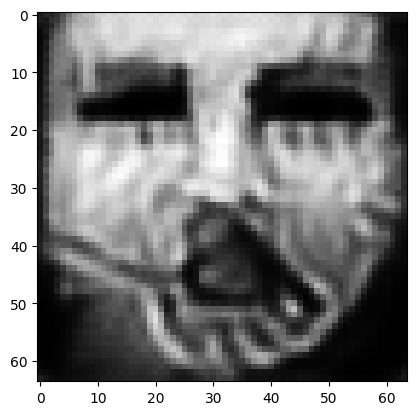

tensor([[9.8386e-01, 3.6760e-07, 5.0356e-04, 1.5711e-06, 3.2961e-05, 6.6836e-04,
         6.0902e-03, 3.1679e-03, 3.7030e-10, 9.0243e-06, 6.9878e-06, 1.8410e-06,
         1.1151e-07, 5.7028e-09, 6.3129e-07, 2.2561e-04, 1.5051e-04, 1.5512e-03,
         9.0162e-06, 3.7516e-05, 3.7032e-07, 9.3943e-07, 8.7165e-11, 3.5207e-03,
         1.4415e-05, 4.1287e-09, 1.1577e-05, 5.9883e-05, 3.4759e-05, 3.4340e-07,
         1.6042e-09, 6.8340e-06, 1.0128e-05, 1.2885e-06, 2.6971e-06, 2.2761e-07,
         9.1749e-06, 7.5338e-06, 1.2149e-06, 1.0850e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01627117395401001
tensor([[9.8386e-01, 3.6756e-07, 5.0348e-04, 1.5709e-06, 3.2956e-05, 6.6827e-04,
         6.0896e-03, 3.1675e-03, 3.7021e-10, 9.0234e-06, 6.9870e-06, 1.8407e-06,
         1.1149e-07, 5.7017e-09, 6.3121e-07, 2.2559e-04, 1.5049e-04, 1.5510e-03,
         9.0151e-06, 3.7512e-05, 3.7026e-07, 9.3925e-07, 8.7142e-11, 3.5204e-03,
         1.4412e-05, 4.1278e-09, 1.1575e-0

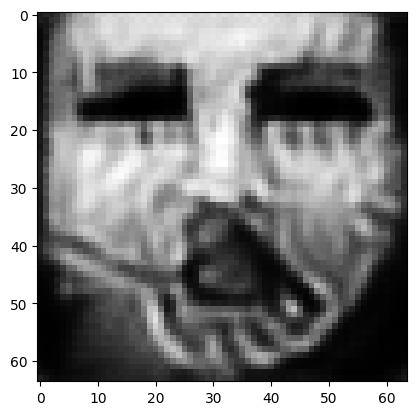

tensor([[9.8387e-01, 3.6741e-07, 5.0317e-04, 1.5701e-06, 3.2939e-05, 6.6790e-04,
         6.0873e-03, 3.1662e-03, 3.6987e-10, 9.0198e-06, 6.9835e-06, 1.8395e-06,
         1.1141e-07, 5.6973e-09, 6.3087e-07, 2.2551e-04, 1.5041e-04, 1.5503e-03,
         9.0105e-06, 3.7493e-05, 3.6999e-07, 9.3854e-07, 8.7050e-11, 3.5191e-03,
         1.4402e-05, 4.1244e-09, 1.1568e-05, 5.9843e-05, 3.4728e-05, 3.4311e-07,
         1.6023e-09, 6.8291e-06, 1.0117e-05, 1.2874e-06, 2.6953e-06, 2.2742e-07,
         9.1657e-06, 7.5277e-06, 1.2135e-06, 1.0837e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016262613236904144
tensor([[9.8387e-01, 3.6737e-07, 5.0310e-04, 1.5699e-06, 3.2934e-05, 6.6781e-04,
         6.0867e-03, 3.1659e-03, 3.6978e-10, 9.0190e-06, 6.9828e-06, 1.8392e-06,
         1.1139e-07, 5.6963e-09, 6.3080e-07, 2.2549e-04, 1.5040e-04, 1.5501e-03,
         9.0095e-06, 3.7488e-05, 3.6993e-07, 9.3838e-07, 8.7028e-11, 3.5188e-03,
         1.4399e-05, 4.1236e-09, 1.1566e-

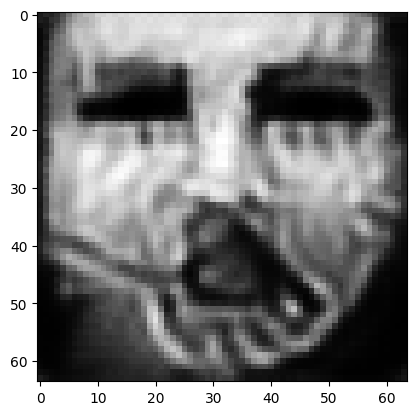

tensor([[9.8388e-01, 3.6722e-07, 5.0281e-04, 1.5692e-06, 3.2918e-05, 6.6746e-04,
         6.0845e-03, 3.1647e-03, 3.6946e-10, 9.0156e-06, 6.9796e-06, 1.8381e-06,
         1.1132e-07, 5.6922e-09, 6.3049e-07, 2.2542e-04, 1.5032e-04, 1.5494e-03,
         9.0052e-06, 3.7470e-05, 3.6968e-07, 9.3771e-07, 8.6943e-11, 3.5176e-03,
         1.4389e-05, 4.1203e-09, 1.1559e-05, 5.9806e-05, 3.4699e-05, 3.4284e-07,
         1.6006e-09, 6.8245e-06, 1.0106e-05, 1.2865e-06, 2.6936e-06, 2.2724e-07,
         9.1571e-06, 7.5219e-06, 1.2122e-06, 1.0825e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01625487208366394
tensor([[9.8388e-01, 3.6719e-07, 5.0274e-04, 1.5690e-06, 3.2914e-05, 6.6738e-04,
         6.0840e-03, 3.1644e-03, 3.6938e-10, 9.0148e-06, 6.9788e-06, 1.8378e-06,
         1.1130e-07, 5.6911e-09, 6.3041e-07, 2.2540e-04, 1.5030e-04, 1.5493e-03,
         9.0042e-06, 3.7466e-05, 3.6961e-07, 9.3754e-07, 8.6921e-11, 3.5172e-03,
         1.4387e-05, 4.1194e-09, 1.1558e-0

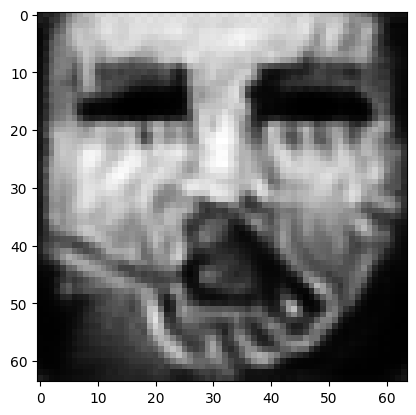

tensor([[9.8388e-01, 3.6705e-07, 5.0246e-04, 1.5683e-06, 3.2898e-05, 6.6706e-04,
         6.0819e-03, 3.1633e-03, 3.6908e-10, 9.0116e-06, 6.9758e-06, 1.8367e-06,
         1.1123e-07, 5.6872e-09, 6.3011e-07, 2.2533e-04, 1.5023e-04, 1.5486e-03,
         9.0001e-06, 3.7449e-05, 3.6938e-07, 9.3690e-07, 8.6839e-11, 3.5161e-03,
         1.4377e-05, 4.1163e-09, 1.1551e-05, 5.9770e-05, 3.4672e-05, 3.4258e-07,
         1.5990e-09, 6.8202e-06, 1.0095e-05, 1.2855e-06, 2.6920e-06, 2.2707e-07,
         9.1488e-06, 7.5164e-06, 1.2110e-06, 1.0814e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016247248277068138
tensor([[9.8389e-01, 3.6701e-07, 5.0240e-04, 1.5681e-06, 3.2894e-05, 6.6697e-04,
         6.0814e-03, 3.1630e-03, 3.6900e-10, 9.0108e-06, 6.9751e-06, 1.8365e-06,
         1.1121e-07, 5.6863e-09, 6.3004e-07, 2.2531e-04, 1.5021e-04, 1.5485e-03,
         8.9991e-06, 3.7445e-05, 3.6932e-07, 9.3675e-07, 8.6819e-11, 3.5158e-03,
         1.4375e-05, 4.1155e-09, 1.1550e-

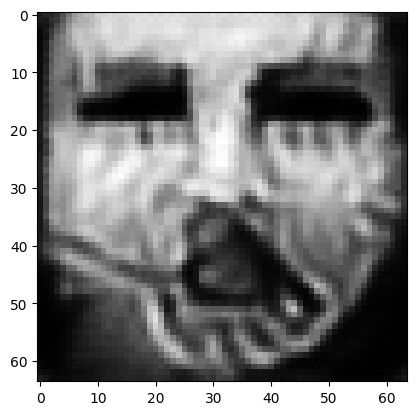

tensor([[9.8389e-01, 3.6688e-07, 5.0213e-04, 1.5675e-06, 3.2879e-05, 6.6666e-04,
         6.0794e-03, 3.1619e-03, 3.6871e-10, 9.0079e-06, 6.9722e-06, 1.8354e-06,
         1.1114e-07, 5.6825e-09, 6.2975e-07, 2.2524e-04, 1.5015e-04, 1.5479e-03,
         8.9953e-06, 3.7429e-05, 3.6909e-07, 9.3614e-07, 8.6741e-11, 3.5147e-03,
         1.4366e-05, 4.1126e-09, 1.1544e-05, 5.9736e-05, 3.4645e-05, 3.4233e-07,
         1.5975e-09, 6.8160e-06, 1.0085e-05, 1.2846e-06, 2.6905e-06, 2.2691e-07,
         9.1410e-06, 7.5112e-06, 1.2098e-06, 1.0803e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01623997651040554
tensor([[9.8389e-01, 3.6685e-07, 5.0206e-04, 1.5673e-06, 3.2875e-05, 6.6657e-04,
         6.0789e-03, 3.1616e-03, 3.6863e-10, 9.0071e-06, 6.9715e-06, 1.8352e-06,
         1.1113e-07, 5.6815e-09, 6.2968e-07, 2.2523e-04, 1.5013e-04, 1.5477e-03,
         8.9944e-06, 3.7425e-05, 3.6903e-07, 9.3599e-07, 8.6721e-11, 3.5144e-03,
         1.4363e-05, 4.1118e-09, 1.1542e-0

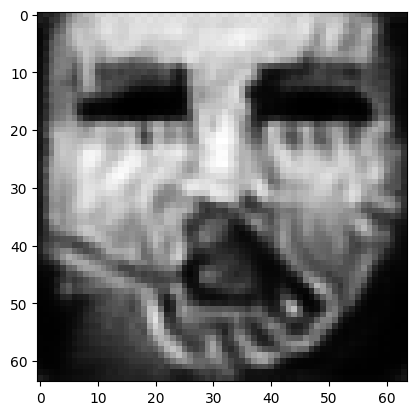

tensor([[9.8390e-01, 3.6672e-07, 5.0181e-04, 1.5667e-06, 3.2861e-05, 6.6627e-04,
         6.0770e-03, 3.1605e-03, 3.6836e-10, 9.0043e-06, 6.9688e-06, 1.8342e-06,
         1.1107e-07, 5.6780e-09, 6.2941e-07, 2.2516e-04, 1.5006e-04, 1.5471e-03,
         8.9908e-06, 3.7410e-05, 3.6882e-07, 9.3541e-07, 8.6647e-11, 3.5133e-03,
         1.4355e-05, 4.1090e-09, 1.1536e-05, 5.9703e-05, 3.4621e-05, 3.4210e-07,
         1.5960e-09, 6.8120e-06, 1.0076e-05, 1.2838e-06, 2.6890e-06, 2.2675e-07,
         9.1335e-06, 7.5062e-06, 1.2087e-06, 1.0792e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016232822090387344
tensor([[9.8390e-01, 3.6669e-07, 5.0175e-04, 1.5665e-06, 3.2857e-05, 6.6620e-04,
         6.0765e-03, 3.1603e-03, 3.6829e-10, 9.0036e-06, 6.9681e-06, 1.8340e-06,
         1.1105e-07, 5.6771e-09, 6.2934e-07, 2.2515e-04, 1.5005e-04, 1.5470e-03,
         8.9899e-06, 3.7406e-05, 3.6877e-07, 9.3527e-07, 8.6628e-11, 3.5131e-03,
         1.4353e-05, 4.1083e-09, 1.1535e-

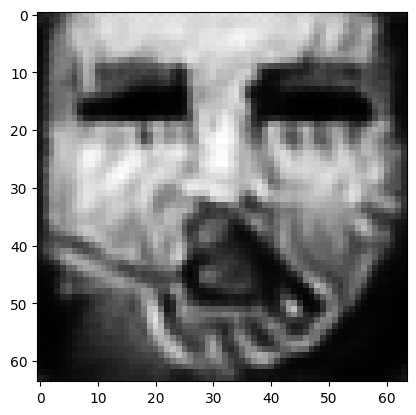

tensor([[9.8390e-01, 3.6657e-07, 5.0151e-04, 1.5659e-06, 3.2843e-05, 6.6591e-04,
         6.0747e-03, 3.1592e-03, 3.6803e-10, 9.0009e-06, 6.9654e-06, 1.8330e-06,
         1.1099e-07, 5.6737e-09, 6.2909e-07, 2.2509e-04, 1.4999e-04, 1.5465e-03,
         8.9864e-06, 3.7392e-05, 3.6856e-07, 9.3471e-07, 8.6558e-11, 3.5120e-03,
         1.4344e-05, 4.1055e-09, 1.1530e-05, 5.9672e-05, 3.4597e-05, 3.4187e-07,
         1.5946e-09, 6.8082e-06, 1.0067e-05, 1.2830e-06, 2.6876e-06, 2.2660e-07,
         9.1263e-06, 7.5014e-06, 1.2076e-06, 1.0783e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01622636988759041
tensor([[9.8391e-01, 3.6654e-07, 5.0145e-04, 1.5658e-06, 3.2840e-05, 6.6584e-04,
         6.0743e-03, 3.1590e-03, 3.6796e-10, 9.0003e-06, 6.9648e-06, 1.8328e-06,
         1.1098e-07, 5.6729e-09, 6.2903e-07, 2.2507e-04, 1.4997e-04, 1.5463e-03,
         8.9856e-06, 3.7388e-05, 3.6851e-07, 9.3458e-07, 8.6541e-11, 3.5118e-03,
         1.4342e-05, 4.1049e-09, 1.1528e-0

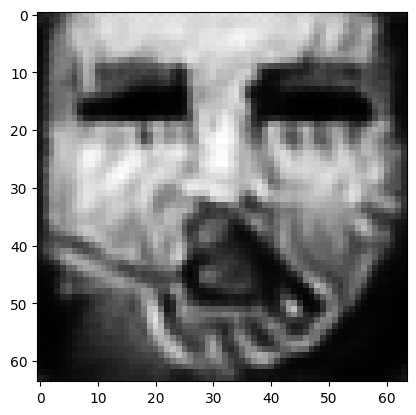

tensor([[9.8391e-01, 3.6643e-07, 5.0122e-04, 1.5652e-06, 3.2827e-05, 6.6557e-04,
         6.0726e-03, 3.1580e-03, 3.6771e-10, 8.9977e-06, 6.9623e-06, 1.8319e-06,
         1.1092e-07, 5.6696e-09, 6.2878e-07, 2.2501e-04, 1.4991e-04, 1.5458e-03,
         8.9823e-06, 3.7375e-05, 3.6832e-07, 9.3406e-07, 8.6473e-11, 3.5108e-03,
         1.4334e-05, 4.1023e-09, 1.1523e-05, 5.9643e-05, 3.4575e-05, 3.4166e-07,
         1.5932e-09, 6.8046e-06, 1.0058e-05, 1.2822e-06, 2.6863e-06, 2.2646e-07,
         9.1195e-06, 7.4968e-06, 1.2066e-06, 1.0773e-07]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016220036894083023
tensor([[9.8391e-01, 3.6641e-07, 5.0116e-04, 1.5651e-06, 3.2823e-05, 6.6550e-04,
         6.0722e-03, 3.1578e-03, 3.6765e-10, 8.9970e-06, 6.9617e-06, 1.8317e-06,
         1.1090e-07, 5.6688e-09, 6.2872e-07, 2.2500e-04, 1.4990e-04, 1.5457e-03,
         8.9815e-06, 3.7371e-05, 3.6827e-07, 9.3393e-07, 8.6457e-11, 3.5105e-03,
         1.4332e-05, 4.1016e-09, 1.1522e-

In [11]:
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=0)

tensor([[2.5849e-04, 4.0420e-05, 9.8728e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2034e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  10.116178512573242


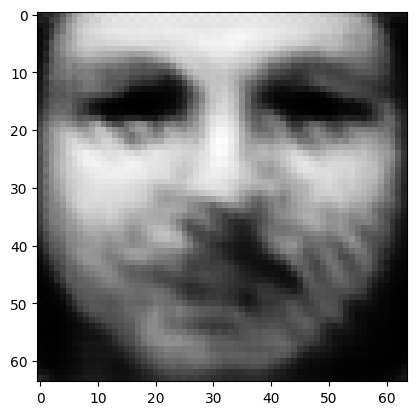

tensor([[1.2451e-04, 1.7275e-04, 3.0788e-04, 1.6819e-03, 1.5729e-02, 1.9213e-05,
         1.2358e-04, 1.0268e-04, 1.1063e-04, 3.0577e-06, 2.2535e-05, 4.7056e-05,
         1.4561e-03, 1.0456e-02, 5.9292e-05, 7.6573e-06, 3.7013e-03, 4.8178e-04,
         2.7850e-04, 1.1135e-05, 2.9418e-03, 1.3263e-04, 3.4520e-01, 8.4899e-05,
         1.4990e-01, 2.0685e-01, 4.3523e-05, 2.5053e-04, 5.4094e-05, 1.8530e-03,
         2.6011e-04, 3.5451e-04, 2.7273e-03, 1.9957e-03, 2.5838e-03, 7.7609e-03,
         2.3190e-01, 8.9453e-03, 9.5722e-04, 3.0511e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.663690567016602
tensor([[2.3927e-04, 2.6091e-04, 1.0720e-02, 1.0948e-03, 4.1477e-02, 3.2470e-04,
         1.0748e-03, 1.3020e-03, 1.6922e-03, 6.9185e-05, 1.1943e-04, 7.9747e-05,
         7.1137e-02, 1.5801e-03, 2.8728e-04, 2.0272e-05, 9.2862e-03, 2.1331e-03,
         3.2868e-04, 3.4781e-03, 2.6743e-03, 1.1670e-04, 4.4485e-03, 1.8111e-04,
         1.9236e-01, 3.4872e-03, 3.7987e-04,

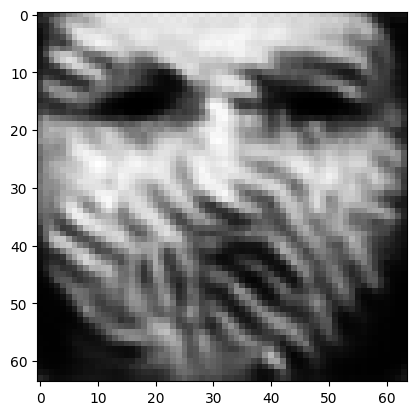

tensor([[2.9724e-04, 6.4203e-02, 3.0902e-03, 8.2534e-03, 8.2904e-03, 2.2605e-03,
         1.9179e-03, 5.2522e-03, 9.5067e-03, 2.6587e-03, 1.2282e-03, 5.9924e-03,
         1.4395e-01, 4.8294e-03, 3.3263e-03, 6.9139e-04, 6.1723e-03, 1.1177e-02,
         1.6476e-03, 2.0047e-02, 1.1159e-02, 4.6273e-04, 2.2900e-02, 4.1759e-04,
         7.3554e-03, 5.1757e-02, 3.3319e-03, 1.5692e-02, 6.6195e-03, 1.0186e-02,
         4.2144e-01, 3.0521e-03, 3.0363e-02, 2.7478e-03, 2.5891e-02, 4.3178e-02,
         1.6150e-02, 9.7916e-04, 1.6888e-02, 4.6397e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.7457077503204346
tensor([[0.0013, 0.1473, 0.0070, 0.0141, 0.0231, 0.0202, 0.0097, 0.0139, 0.0095,
         0.0074, 0.0028, 0.0117, 0.1978, 0.0030, 0.0081, 0.0029, 0.0095, 0.0527,
         0.0043, 0.0683, 0.0138, 0.0006, 0.0101, 0.0008, 0.0085, 0.0106, 0.0121,
         0.0272, 0.0237, 0.0143, 0.0493, 0.0076, 0.0852, 0.0045, 0.0405, 0.0299,
         0.0118, 0.0010, 0.0189, 0.0150]], 

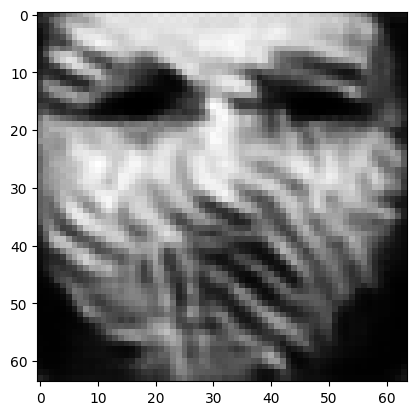

tensor([[5.7155e-04, 6.1603e-01, 9.0934e-04, 1.9036e-02, 2.7373e-03, 6.4483e-03,
         1.8035e-03, 7.2266e-03, 3.7457e-03, 5.2235e-03, 2.5661e-03, 1.1488e-02,
         3.5097e-02, 8.9234e-04, 2.4216e-03, 1.8030e-03, 1.8079e-03, 2.1447e-02,
         3.6095e-03, 1.8236e-02, 4.1111e-03, 1.1853e-04, 4.0006e-03, 4.0458e-04,
         1.8661e-03, 1.1004e-02, 5.2250e-03, 7.7129e-03, 8.7887e-03, 2.2433e-02,
         3.0674e-02, 9.4450e-03, 3.2720e-02, 5.2548e-04, 2.3481e-02, 6.4003e-02,
         2.2206e-03, 1.9501e-03, 2.8680e-03, 3.3497e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.48446357250213623
tensor([[4.4994e-04, 6.6001e-01, 7.2280e-04, 1.8105e-02, 1.9825e-03, 4.8038e-03,
         1.2515e-03, 5.8806e-03, 3.3629e-03, 4.3435e-03, 2.2251e-03, 1.0301e-02,
         2.8825e-02, 8.0151e-04, 1.7326e-03, 1.4014e-03, 1.3325e-03, 1.6727e-02,
         2.8980e-03, 1.2838e-02, 3.3246e-03, 8.5797e-05, 3.7388e-03, 3.1428e-04,
         1.4771e-03, 1.2931e-02, 4.0806e-0

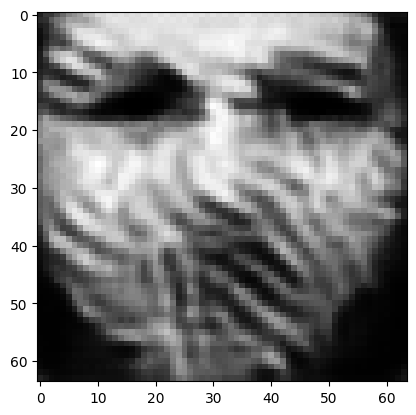

tensor([[4.3445e-04, 7.7587e-01, 4.7264e-04, 1.6944e-02, 1.3442e-03, 3.9808e-03,
         7.4847e-04, 5.1007e-03, 1.6472e-03, 3.0950e-03, 1.4095e-03, 7.2405e-03,
         1.7680e-02, 4.1594e-04, 1.3084e-03, 1.0893e-03, 1.0253e-03, 1.1858e-02,
         2.5402e-03, 8.1551e-03, 1.6336e-03, 4.9635e-05, 2.2160e-03, 2.6417e-04,
         1.0024e-03, 6.9824e-03, 3.2273e-03, 3.7255e-03, 4.7420e-03, 1.4160e-02,
         1.5683e-02, 5.7588e-03, 1.7747e-02, 2.2592e-04, 1.3751e-02, 4.1268e-02,
         9.6800e-04, 1.2980e-03, 1.5344e-03, 1.3985e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2537652850151062
tensor([[4.5947e-04, 7.9474e-01, 4.5989e-04, 1.6404e-02, 1.2884e-03, 4.0974e-03,
         7.1032e-04, 5.2624e-03, 1.4164e-03, 3.0045e-03, 1.2741e-03, 6.7950e-03,
         1.5924e-02, 3.5299e-04, 1.2998e-03, 1.0903e-03, 1.0149e-03, 1.1225e-02,
         2.5998e-03, 8.1982e-03, 1.4686e-03, 4.6015e-05, 1.8880e-03, 2.6574e-04,
         9.1218e-04, 5.5858e-03, 3.1902e-03

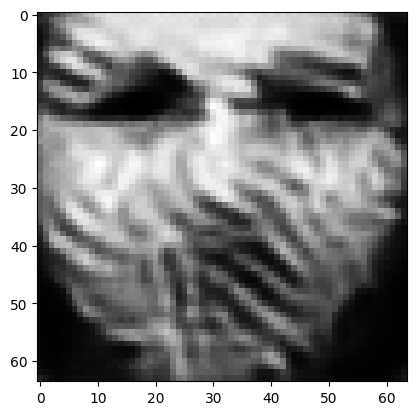

tensor([[3.8185e-04, 8.6043e-01, 3.2795e-04, 1.3742e-02, 7.7840e-04, 3.2260e-03,
         4.3369e-04, 4.0651e-03, 8.4286e-04, 2.2363e-03, 7.6594e-04, 4.8883e-03,
         1.0669e-02, 2.0226e-04, 8.9660e-04, 8.2344e-04, 7.1044e-04, 6.7064e-03,
         2.1791e-03, 5.3354e-03, 9.1734e-04, 2.8746e-05, 1.2524e-03, 1.9434e-04,
         5.7319e-04, 3.1899e-03, 2.5190e-03, 1.8480e-03, 2.9989e-03, 8.9899e-03,
         8.3763e-03, 3.2774e-03, 1.1781e-02, 1.3387e-04, 8.6452e-03, 2.2655e-02,
         4.2859e-04, 7.2290e-04, 1.0433e-03, 7.7855e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.15031740069389343
tensor([[3.6108e-04, 8.6942e-01, 3.0845e-04, 1.3344e-02, 7.0507e-04, 3.0797e-03,
         3.9191e-04, 3.8093e-03, 7.7992e-04, 2.1079e-03, 7.0338e-04, 4.6491e-03,
         9.9503e-03, 1.8601e-04, 8.0936e-04, 7.7665e-04, 6.5026e-04, 6.0806e-03,
         2.0795e-03, 4.8550e-03, 8.4365e-04, 2.6127e-05, 1.1731e-03, 1.7956e-04,
         5.2636e-04, 2.9913e-03, 2.4019e-0

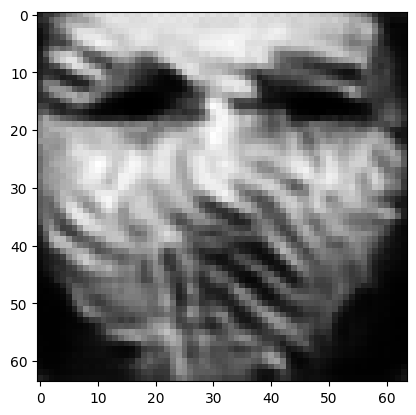

tensor([[2.9051e-04, 8.9268e-01, 2.3729e-04, 1.2017e-02, 5.1901e-04, 2.4323e-03,
         2.8278e-04, 2.9746e-03, 6.0115e-04, 1.6575e-03, 5.6169e-04, 3.8864e-03,
         7.8192e-03, 1.5127e-04, 5.9731e-04, 6.2554e-04, 4.9638e-04, 4.6266e-03,
         1.7325e-03, 3.3427e-03, 6.3274e-04, 1.8730e-05, 1.0093e-03, 1.3962e-04,
         4.0845e-04, 2.7583e-03, 1.9448e-03, 1.2633e-03, 2.1107e-03, 6.9281e-03,
         6.3587e-03, 2.3867e-03, 8.7403e-03, 8.8340e-05, 6.5593e-03, 1.8918e-02,
         3.2135e-04, 5.8522e-04, 7.4526e-04, 5.4727e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.11352227628231049
tensor([[2.7758e-04, 8.9668e-01, 2.2610e-04, 1.1767e-02, 4.8957e-04, 2.3240e-03,
         2.6465e-04, 2.8275e-03, 5.7268e-04, 1.5770e-03, 5.3857e-04, 3.7531e-03,
         7.4608e-03, 1.4582e-04, 5.6509e-04, 5.9897e-04, 4.7385e-04, 4.4121e-03,
         1.6657e-03, 3.1217e-03, 5.9747e-04, 1.7481e-05, 9.7928e-04, 1.3353e-04,
         3.8824e-04, 2.7386e-03, 1.8512e-0

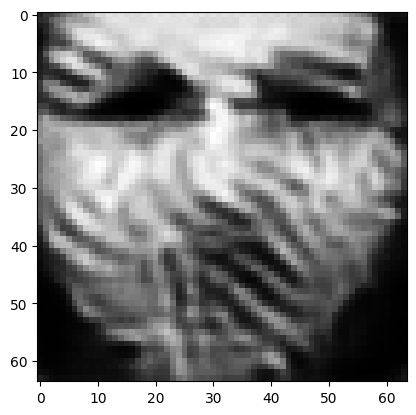

tensor([[2.6775e-04, 9.0972e-01, 2.0087e-04, 1.0730e-02, 4.2501e-04, 2.1619e-03,
         2.3076e-04, 2.6050e-03, 4.6151e-04, 1.3993e-03, 4.6256e-04, 3.3049e-03,
         6.2542e-03, 1.2103e-04, 4.9795e-04, 5.6172e-04, 4.1497e-04, 3.9411e-03,
         1.5660e-03, 2.7725e-03, 4.8829e-04, 1.4709e-05, 8.0103e-04, 1.2259e-04,
         3.3340e-04, 2.2570e-03, 1.6865e-03, 1.0266e-03, 1.7035e-03, 5.8082e-03,
         4.9910e-03, 1.9898e-03, 7.4117e-03, 6.8518e-05, 5.5000e-03, 1.5915e-02,
         2.5556e-04, 4.8608e-04, 6.0468e-04, 4.3563e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09461779147386551
tensor([[2.6335e-04, 9.1238e-01, 1.9570e-04, 1.0542e-02, 4.0866e-04, 2.1048e-03,
         2.2227e-04, 2.5433e-03, 4.4275e-04, 1.3562e-03, 4.4686e-04, 3.2127e-03,
         6.0129e-03, 1.1690e-04, 4.7961e-04, 5.4766e-04, 4.0069e-04, 3.8192e-03,
         1.5325e-03, 2.6764e-03, 4.6568e-04, 1.4125e-05, 7.6969e-04, 1.1933e-04,
         3.2225e-04, 2.1862e-03, 1.6420e-0

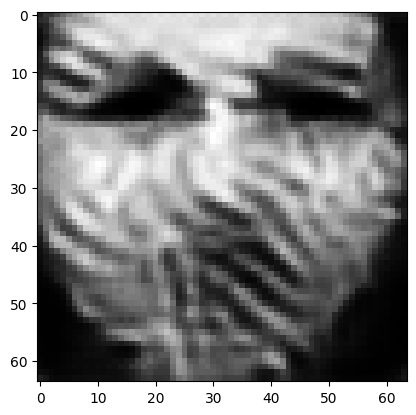

tensor([[2.4610e-04, 9.2165e-01, 1.7744e-04, 9.8078e-03, 3.5169e-04, 1.8933e-03,
         1.9065e-04, 2.3085e-03, 3.8300e-04, 1.1995e-03, 3.9523e-04, 2.8948e-03,
         5.2184e-03, 1.0377e-04, 4.2224e-04, 5.0005e-04, 3.5589e-04, 3.3628e-03,
         1.4160e-03, 2.3371e-03, 3.9882e-04, 1.2142e-05, 6.8342e-04, 1.0689e-04,
         2.8372e-04, 1.9743e-03, 1.4684e-03, 8.6050e-04, 1.4348e-03, 5.0882e-03,
         4.3175e-03, 1.6885e-03, 6.4074e-03, 5.6492e-05, 4.7256e-03, 1.3755e-02,
         2.1282e-04, 4.3149e-04, 5.1813e-04, 3.6016e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0815882608294487
tensor([[2.4103e-04, 9.2369e-01, 1.7208e-04, 9.6167e-03, 3.3896e-04, 1.8331e-03,
         1.8306e-04, 2.2472e-03, 3.7028e-04, 1.1620e-03, 3.8536e-04, 2.8246e-03,
         5.0452e-03, 1.0106e-04, 4.1330e-04, 4.8990e-04, 3.4637e-04, 3.2655e-03,
         1.3898e-03, 2.2627e-03, 3.8635e-04, 1.1731e-05, 6.6748e-04, 1.0403e-04,
         2.7491e-04, 1.9338e-03, 1.4264e-03

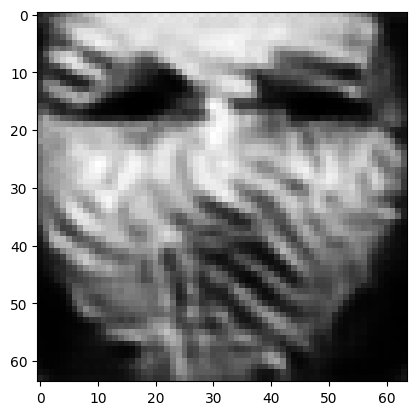

tensor([[2.2736e-04, 9.3069e-01, 1.5743e-04, 9.0026e-03, 3.0206e-04, 1.7017e-03,
         1.6264e-04, 2.0744e-03, 3.2374e-04, 1.0588e-03, 3.4693e-04, 2.5844e-03,
         4.5358e-03, 9.0028e-05, 3.7934e-04, 4.6063e-04, 3.1799e-04, 2.9534e-03,
         1.3032e-03, 2.0571e-03, 3.3748e-04, 1.0397e-05, 5.9845e-04, 9.6421e-05,
         2.4925e-04, 1.7376e-03, 1.2991e-03, 7.3845e-04, 1.2412e-03, 4.5376e-03,
         3.7622e-03, 1.4862e-03, 5.6346e-03, 4.8350e-05, 4.1461e-03, 1.2031e-02,
         1.8349e-04, 3.8069e-04, 4.5031e-04, 3.0587e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.07183410227298737
tensor([[2.1993e-04, 9.3210e-01, 1.5294e-04, 8.8516e-03, 2.9026e-04, 1.6326e-03,
         1.5566e-04, 2.0038e-03, 3.1831e-04, 1.0238e-03, 3.4054e-04, 2.5369e-03,
         4.4196e-03, 8.9126e-05, 3.6768e-04, 4.4711e-04, 3.0790e-04, 2.8718e-03,
         1.2665e-03, 1.9775e-03, 3.2863e-04, 1.0014e-05, 5.9145e-04, 9.2918e-05,
         2.4135e-04, 1.7518e-03, 1.2609e-0

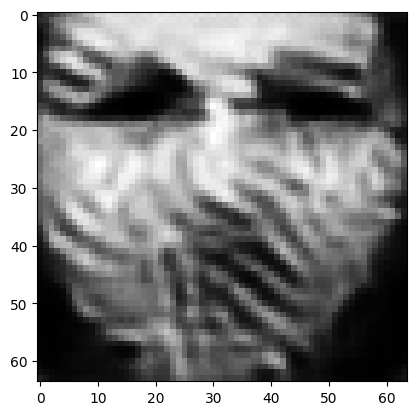

tensor([[2.1220e-04, 9.3704e-01, 1.4477e-04, 8.3226e-03, 2.6511e-04, 1.5409e-03,
         1.4372e-04, 1.9003e-03, 2.8784e-04, 9.5403e-04, 3.1409e-04, 2.3663e-03,
         4.0705e-03, 8.2075e-05, 3.4307e-04, 4.2904e-04, 2.8868e-04, 2.6678e-03,
         1.2104e-03, 1.8728e-03, 2.9712e-04, 9.1565e-06, 5.3763e-04, 8.7567e-05,
         2.2184e-04, 1.6001e-03, 1.1809e-03, 6.7129e-04, 1.1059e-03, 4.1954e-03,
         3.5055e-03, 1.3354e-03, 5.0846e-03, 4.2834e-05, 3.7490e-03, 1.0737e-02,
         1.6337e-04, 3.4638e-04, 4.0566e-04, 2.7136e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06503409892320633
tensor([[2.0883e-04, 9.3812e-01, 1.4240e-04, 8.1948e-03, 2.5847e-04, 1.5064e-03,
         1.4022e-04, 1.8690e-03, 2.8232e-04, 9.3504e-04, 3.0870e-04, 2.3300e-03,
         3.9866e-03, 8.0903e-05, 3.3600e-04, 4.2240e-04, 2.8313e-04, 2.6157e-03,
         1.1930e-03, 1.8362e-03, 2.9023e-04, 8.9415e-06, 5.2762e-04, 8.5794e-05,
         2.1673e-04, 1.5830e-03, 1.1588e-0

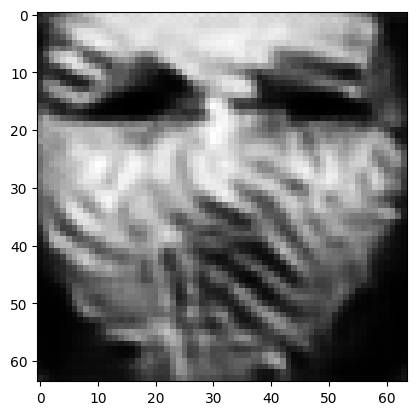

tensor([[1.9479e-04, 9.4267e-01, 1.3123e-04, 7.5812e-03, 2.3368e-04, 1.3516e-03,
         1.2692e-04, 1.7433e-03, 2.5539e-04, 8.6073e-04, 2.8469e-04, 2.1752e-03,
         3.6351e-03, 7.4845e-05, 3.1304e-04, 3.9240e-04, 2.6192e-04, 2.3806e-03,
         1.1210e-03, 1.6876e-03, 2.5960e-04, 8.1563e-06, 4.8460e-04, 7.9912e-05,
         2.0093e-04, 1.4932e-03, 1.0558e-03, 6.1300e-04, 9.7958e-04, 3.8412e-03,
         3.3332e-03, 1.2218e-03, 4.6099e-03, 3.8483e-05, 3.3450e-03, 9.8866e-03,
         1.4679e-04, 3.1595e-04, 3.7053e-04, 2.3741e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.059035658836364746
tensor([[1.9568e-04, 9.4373e-01, 1.2990e-04, 7.4213e-03, 2.3176e-04, 1.3478e-03,
         1.2659e-04, 1.7407e-03, 2.4669e-04, 8.5473e-04, 2.7862e-04, 2.1409e-03,
         3.5632e-03, 7.2635e-05, 3.1121e-04, 3.9255e-04, 2.6007e-04, 2.3476e-03,
         1.1192e-03, 1.6939e-03, 2.5245e-04, 8.0782e-06, 4.6759e-04, 7.9968e-05,
         1.9899e-04, 1.4277e-03, 1.0450e-

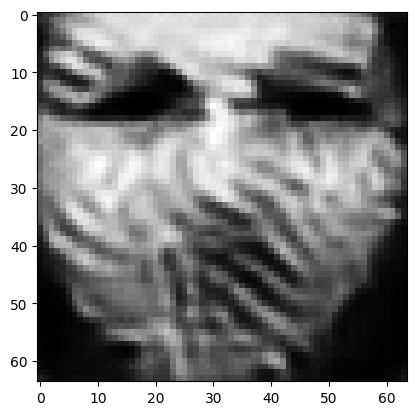

tensor([[1.8163e-04, 9.4768e-01, 1.2127e-04, 6.9806e-03, 2.0919e-04, 1.2292e-03,
         1.1362e-04, 1.6200e-03, 2.2741e-04, 7.8616e-04, 2.5663e-04, 2.0072e-03,
         3.2985e-03, 6.8144e-05, 2.8561e-04, 3.6414e-04, 2.4316e-04, 2.1255e-03,
         1.0466e-03, 1.5475e-03, 2.2816e-04, 7.3070e-06, 4.3814e-04, 7.3812e-05,
         1.8461e-04, 1.3708e-03, 9.5054e-04, 5.5354e-04, 8.7525e-04, 3.5217e-03,
         3.1088e-03, 1.1152e-03, 4.2289e-03, 3.5090e-05, 3.0208e-03, 8.9213e-03,
         1.3136e-04, 2.8486e-04, 3.4293e-04, 2.1268e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.05373651906847954
tensor([[1.7736e-04, 9.4855e-01, 1.1896e-04, 6.8646e-03, 2.0269e-04, 1.1968e-03,
         1.1025e-04, 1.5799e-03, 2.2436e-04, 7.6761e-04, 2.5149e-04, 1.9762e-03,
         3.2433e-03, 6.7290e-05, 2.7825e-04, 3.5618e-04, 2.3749e-04, 2.0776e-03,
         1.0251e-03, 1.5090e-03, 2.2366e-04, 7.0981e-06, 4.3313e-04, 7.1372e-05,
         1.7942e-04, 1.3640e-03, 9.3449e-0

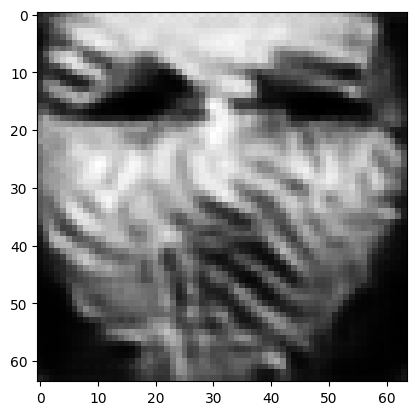

tensor([[1.6950e-04, 9.5180e-01, 1.1327e-04, 6.4695e-03, 1.8833e-04, 1.1445e-03,
         1.0319e-04, 1.4977e-03, 2.0636e-04, 7.2265e-04, 2.3314e-04, 1.8700e-03,
         3.0638e-03, 6.2822e-05, 2.6020e-04, 3.4109e-04, 2.2753e-04, 1.9426e-03,
         9.7756e-04, 1.4329e-03, 2.0441e-04, 6.5570e-06, 4.0261e-04, 6.7288e-05,
         1.6817e-04, 1.2602e-03, 8.7976e-04, 5.0460e-04, 7.8950e-04, 3.2987e-03,
         2.9131e-03, 1.0152e-03, 3.9180e-03, 3.2096e-05, 2.8074e-03, 8.0204e-03,
         1.1945e-04, 2.5796e-04, 3.1656e-04, 1.9614e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04940527677536011
tensor([[1.6862e-04, 9.5258e-01, 1.1219e-04, 6.3509e-03, 1.8524e-04, 1.1370e-03,
         1.0207e-04, 1.4849e-03, 2.0148e-04, 7.1387e-04, 2.2909e-04, 1.8460e-03,
         3.0140e-03, 6.1657e-05, 2.5634e-04, 3.3936e-04, 2.2526e-04, 1.9168e-03,
         9.7041e-04, 1.4224e-03, 2.0005e-04, 6.4553e-06, 3.9338e-04, 6.6438e-05,
         1.6513e-04, 1.2260e-03, 8.7117e-0

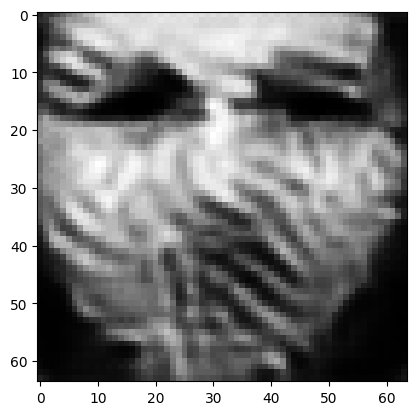

tensor([[1.5895e-04, 9.5542e-01, 1.0633e-04, 6.0009e-03, 1.7092e-04, 1.0737e-03,
         9.4556e-05, 1.3962e-03, 1.8752e-04, 6.6873e-04, 2.1460e-04, 1.7488e-03,
         2.8382e-03, 5.8360e-05, 2.3721e-04, 3.2225e-04, 2.1370e-04, 1.7913e-03,
         9.1655e-04, 1.3238e-03, 1.8252e-04, 5.9337e-06, 3.7009e-04, 6.2003e-05,
         1.5436e-04, 1.1715e-03, 8.1463e-04, 4.6612e-04, 7.1511e-04, 3.0723e-03,
         2.7407e-03, 9.3353e-04, 3.6402e-03, 2.9535e-05, 2.6084e-03, 7.2683e-03,
         1.1041e-04, 2.3546e-04, 2.9146e-04, 1.8134e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04560078680515289
tensor([[1.5636e-04, 9.5604e-01, 1.0478e-04, 5.9363e-03, 1.6762e-04, 1.0572e-03,
         9.2632e-05, 1.3733e-03, 1.8470e-04, 6.5819e-04, 2.1130e-04, 1.7274e-03,
         2.8003e-03, 5.7639e-05, 2.3272e-04, 3.1749e-04, 2.1079e-04, 1.7594e-03,
         9.0288e-04, 1.2968e-03, 1.7852e-04, 5.8115e-06, 3.6558e-04, 6.0909e-05,
         1.5221e-04, 1.1632e-03, 8.0076e-0

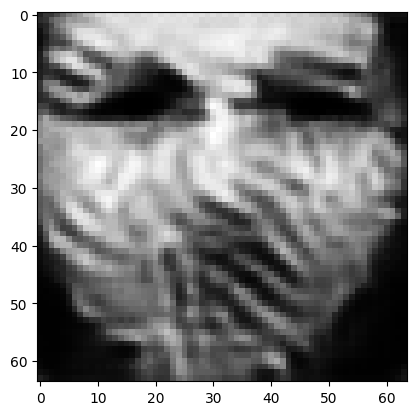

tensor([[1.4883e-04, 9.5817e-01, 9.9616e-05, 5.6628e-03, 1.5679e-04, 1.0066e-03,
         8.6952e-05, 1.3068e-03, 1.7369e-04, 6.2621e-04, 2.0008e-04, 1.6505e-03,
         2.6614e-03, 5.4717e-05, 2.1879e-04, 3.0345e-04, 2.0111e-04, 1.6546e-03,
         8.6288e-04, 1.2275e-03, 1.6526e-04, 5.4241e-06, 3.4513e-04, 5.7343e-05,
         1.4432e-04, 1.1142e-03, 7.6005e-04, 4.3329e-04, 6.5648e-04, 2.9126e-03,
         2.6106e-03, 8.7336e-04, 3.4167e-03, 2.7537e-05, 2.4462e-03, 6.7942e-03,
         1.0308e-04, 2.1914e-04, 2.7181e-04, 1.6905e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04272901266813278
tensor([[1.4724e-04, 9.5866e-01, 9.8544e-05, 5.5994e-03, 1.5444e-04, 9.9676e-04,
         8.5737e-05, 1.2921e-03, 1.7111e-04, 6.1942e-04, 1.9750e-04, 1.6331e-03,
         2.6294e-03, 5.4036e-05, 2.1563e-04, 3.0041e-04, 1.9894e-04, 1.6304e-03,
         8.5392e-04, 1.2134e-03, 1.6230e-04, 5.3401e-06, 3.4003e-04, 5.6568e-05,
         1.4253e-04, 1.1006e-03, 7.5183e-0

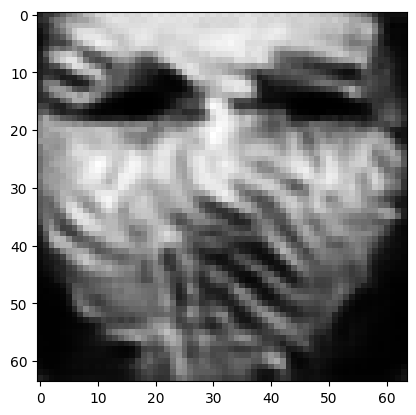

tensor([[1.3995e-04, 9.6050e-01, 9.3959e-05, 5.4038e-03, 1.4498e-04, 9.5402e-04,
         8.0261e-05, 1.2249e-03, 1.6199e-04, 5.8996e-04, 1.8704e-04, 1.5677e-03,
         2.5197e-03, 5.1671e-05, 2.0253e-04, 2.8559e-04, 1.9024e-04, 1.5275e-03,
         8.1361e-04, 1.1407e-03, 1.5043e-04, 4.9890e-06, 3.2472e-04, 5.3669e-05,
         1.3675e-04, 1.0677e-03, 7.1209e-04, 4.0279e-04, 6.0542e-04, 2.7681e-03,
         2.4971e-03, 8.2272e-04, 3.2284e-03, 2.5911e-05, 2.3064e-03, 6.3936e-03,
         9.6943e-05, 2.0499e-04, 2.5559e-04, 1.5890e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04029836505651474
tensor([[1.3906e-04, 9.6093e-01, 9.3146e-05, 5.3490e-03, 1.4312e-04, 9.4788e-04,
         7.9403e-05, 1.2157e-03, 1.5940e-04, 5.8507e-04, 1.8499e-04, 1.5530e-03,
         2.4912e-03, 5.0990e-05, 2.0021e-04, 2.8360e-04, 1.8865e-04, 1.5078e-03,
         8.0856e-04, 1.1322e-03, 1.4789e-04, 4.9269e-06, 3.1953e-04, 5.3176e-05,
         1.3538e-04, 1.0518e-03, 7.0577e-0

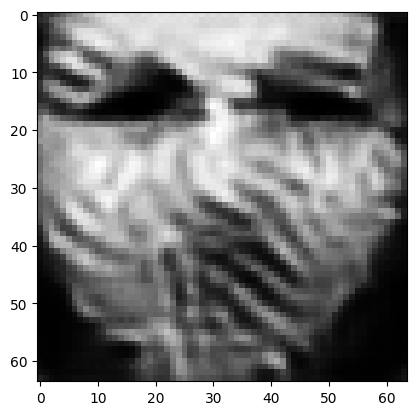

tensor([[1.3381e-04, 9.6245e-01, 8.9220e-05, 5.1752e-03, 1.3599e-04, 9.1497e-04,
         7.5467e-05, 1.1656e-03, 1.5080e-04, 5.6263e-04, 1.7650e-04, 1.4972e-03,
         2.4009e-03, 4.8748e-05, 1.9091e-04, 2.7231e-04, 1.8213e-04, 1.4306e-03,
         7.8033e-04, 1.0816e-03, 1.3826e-04, 4.6541e-06, 3.0524e-04, 5.1089e-05,
         1.3117e-04, 1.0111e-03, 6.7539e-04, 3.7768e-04, 5.6414e-04, 2.6407e-03,
         2.3733e-03, 7.8556e-04, 3.0785e-03, 2.4601e-05, 2.1871e-03, 6.0594e-03,
         9.1263e-05, 1.9251e-04, 2.4149e-04, 1.5009e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03827125206589699
tensor([[1.3300e-04, 9.6280e-01, 8.8430e-05, 5.1298e-03, 1.3457e-04, 9.0830e-04,
         7.4815e-05, 1.1575e-03, 1.4859e-04, 5.5832e-04, 1.7475e-04, 1.4846e-03,
         2.3783e-03, 4.8164e-05, 1.8943e-04, 2.7046e-04, 1.8075e-04, 1.4163e-03,
         7.7595e-04, 1.0748e-03, 1.3624e-04, 4.6055e-06, 3.0108e-04, 5.0721e-05,
         1.3021e-04, 9.9677e-04, 6.7038e-0

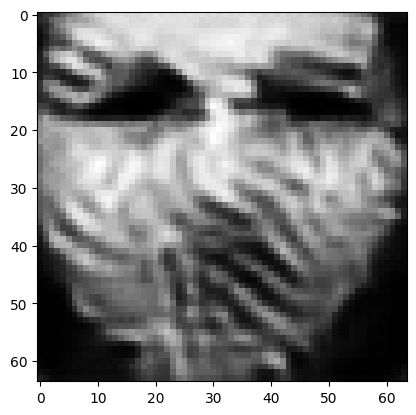

tensor([[1.2784e-04, 9.6412e-01, 8.4626e-05, 5.0060e-03, 1.2857e-04, 8.7535e-04,
         7.1123e-05, 1.1123e-03, 1.4118e-04, 5.3619e-04, 1.6763e-04, 1.4336e-03,
         2.2967e-03, 4.6339e-05, 1.8178e-04, 2.5954e-04, 1.7494e-04, 1.3497e-03,
         7.4955e-04, 1.0202e-03, 1.2769e-04, 4.3635e-06, 2.9007e-04, 4.9114e-05,
         1.2708e-04, 9.6817e-04, 6.3966e-04, 3.5694e-04, 5.2706e-04, 2.5068e-03,
         2.2744e-03, 7.5434e-04, 2.9390e-03, 2.3374e-05, 2.0758e-03, 5.8116e-03,
         8.6743e-05, 1.8226e-04, 2.2894e-04, 1.4086e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03653658926486969
tensor([[1.2733e-04, 9.6443e-01, 8.3913e-05, 4.9620e-03, 1.2749e-04, 8.7073e-04,
         7.0597e-05, 1.1069e-03, 1.3916e-04, 5.3239e-04, 1.6631e-04, 1.4229e-03,
         2.2743e-03, 4.5796e-05, 1.8094e-04, 2.5849e-04, 1.7385e-04, 1.3387e-03,
         7.4737e-04, 1.0148e-03, 1.2614e-04, 4.3285e-06, 2.8631e-04, 4.8873e-05,
         1.2613e-04, 9.5320e-04, 6.3586e-0

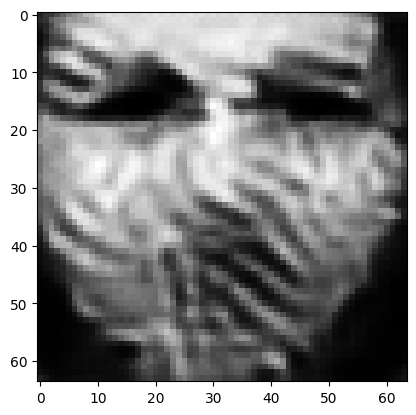

tensor([[1.2360e-04, 9.6568e-01, 8.0591e-05, 4.8103e-03, 1.2192e-04, 8.4201e-04,
         6.7445e-05, 1.0738e-03, 1.3234e-04, 5.1374e-04, 1.6014e-04, 1.3762e-03,
         2.1872e-03, 4.4029e-05, 1.7481e-04, 2.5044e-04, 1.6847e-04, 1.2803e-03,
         7.2929e-04, 9.7538e-04, 1.1935e-04, 4.1304e-06, 2.7488e-04, 4.7304e-05,
         1.2228e-04, 9.1643e-04, 6.1276e-04, 3.3920e-04, 4.9634e-04, 2.4008e-03,
         2.1712e-03, 7.2547e-04, 2.8096e-03, 2.2262e-05, 1.9817e-03, 5.5636e-03,
         8.2007e-05, 1.7340e-04, 2.1656e-04, 1.3257e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03492681309580803
tensor([[1.2222e-04, 9.6598e-01, 7.9698e-05, 4.7771e-03, 1.2027e-04, 8.3281e-04,
         6.6452e-05, 1.0620e-03, 1.3101e-04, 5.0821e-04, 1.5831e-04, 1.3641e-03,
         2.1678e-03, 4.3685e-05, 1.7254e-04, 2.4736e-04, 1.6683e-04, 1.2624e-03,
         7.2196e-04, 9.6103e-04, 1.1753e-04, 4.0684e-06, 2.7294e-04, 4.6730e-05,
         1.2128e-04, 9.1307e-04, 6.0553e-0

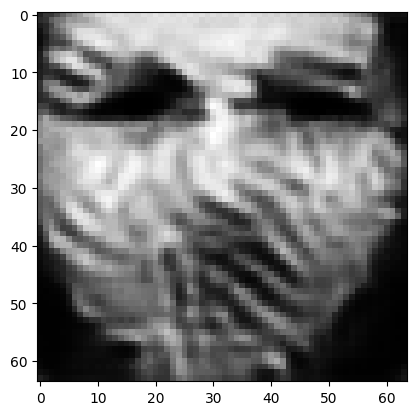

tensor([[1.1848e-04, 9.6715e-01, 7.6644e-05, 4.6283e-03, 1.1488e-04, 8.0402e-04,
         6.3344e-05, 1.0296e-03, 1.2497e-04, 4.8988e-04, 1.5232e-04, 1.3189e-03,
         2.0865e-03, 4.2101e-05, 1.6659e-04, 2.3920e-04, 1.6181e-04, 1.2045e-03,
         7.0350e-04, 9.2250e-04, 1.1127e-04, 3.8779e-06, 2.6310e-04, 4.5120e-05,
         1.1750e-04, 8.8368e-04, 5.8196e-04, 3.2205e-04, 4.6639e-04, 2.3096e-03,
         2.0997e-03, 6.9123e-04, 2.6775e-03, 2.1174e-05, 1.8906e-03, 5.3424e-03,
         7.7920e-05, 1.6543e-04, 2.0549e-04, 1.2498e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03340080380439758
tensor([[1.1787e-04, 9.6743e-01, 7.6035e-05, 4.5863e-03, 1.1384e-04, 7.9890e-04,
         6.2826e-05, 1.0238e-03, 1.2340e-04, 4.8610e-04, 1.5097e-04, 1.3083e-03,
         2.0683e-03, 4.1683e-05, 1.6569e-04, 2.3800e-04, 1.6094e-04, 1.1938e-03,
         7.0061e-04, 9.1737e-04, 1.0998e-04, 3.8420e-06, 2.6049e-04, 4.4824e-05,
         1.1659e-04, 8.7317e-04, 5.7778e-0

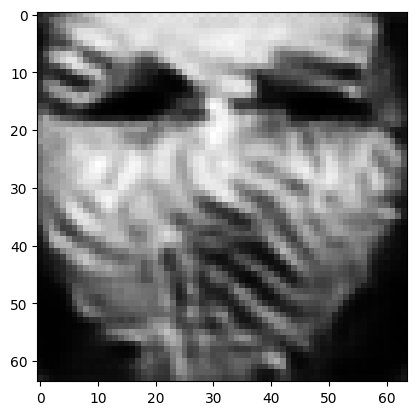

tensor([[1.1431e-04, 9.6846e-01, 7.3406e-05, 4.4466e-03, 1.0936e-04, 7.7333e-04,
         6.0272e-05, 9.9240e-04, 1.1822e-04, 4.6910e-04, 1.4527e-04, 1.2670e-03,
         2.0036e-03, 4.0333e-05, 1.6064e-04, 2.3075e-04, 1.5680e-04, 1.1454e-03,
         6.8263e-04, 8.8496e-04, 1.0476e-04, 3.6758e-06, 2.5290e-04, 4.3359e-05,
         1.1325e-04, 8.4759e-04, 5.5742e-04, 3.0834e-04, 4.4028e-04, 2.2266e-03,
         2.0344e-03, 6.6019e-04, 2.5700e-03, 2.0270e-05, 1.8145e-03, 5.1242e-03,
         7.4334e-05, 1.5730e-04, 1.9625e-04, 1.1883e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032051075249910355
tensor([[1.1356e-04, 9.6869e-01, 7.2812e-05, 4.4149e-03, 1.0840e-04, 7.6815e-04,
         5.9739e-05, 9.8504e-04, 1.1702e-04, 4.6555e-04, 1.4387e-04, 1.2579e-03,
         1.9900e-03, 3.9995e-05, 1.5956e-04, 2.2904e-04, 1.5587e-04, 1.1349e-03,
         6.7848e-04, 8.7846e-04, 1.0358e-04, 3.6394e-06, 2.5103e-04, 4.3040e-05,
         1.1258e-04, 8.4034e-04, 5.5320e-

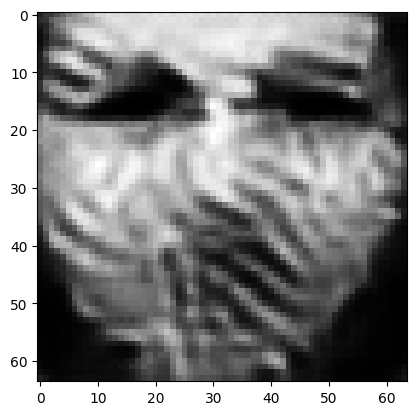

tensor([[1.0998e-04, 9.6962e-01, 7.0358e-05, 4.2876e-03, 1.0431e-04, 7.4425e-04,
         5.7400e-05, 9.5373e-04, 1.1269e-04, 4.5123e-04, 1.3826e-04, 1.2223e-03,
         1.9313e-03, 3.8723e-05, 1.5409e-04, 2.2137e-04, 1.5144e-04, 1.0916e-03,
         6.5982e-04, 8.4710e-04, 9.8957e-05, 3.4853e-06, 2.4377e-04, 4.1407e-05,
         1.0932e-04, 8.1653e-04, 5.3622e-04, 2.9476e-04, 4.1635e-04, 2.1573e-03,
         1.9740e-03, 6.3266e-04, 2.4770e-03, 1.9475e-05, 1.7469e-03, 4.9404e-03,
         7.1112e-05, 1.4993e-04, 1.8830e-04, 1.1391e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.030850376933813095
tensor([[1.0921e-04, 9.6985e-01, 6.9779e-05, 4.2589e-03, 1.0332e-04, 7.3876e-04,
         5.6839e-05, 9.4687e-04, 1.1162e-04, 4.4786e-04, 1.3691e-04, 1.2135e-03,
         1.9159e-03, 3.8397e-05, 1.5261e-04, 2.1956e-04, 1.5027e-04, 1.0812e-03,
         6.5570e-04, 8.3923e-04, 9.7811e-05, 3.4477e-06, 2.4172e-04, 4.0990e-05,
         1.0847e-04, 8.1037e-04, 5.3245e-

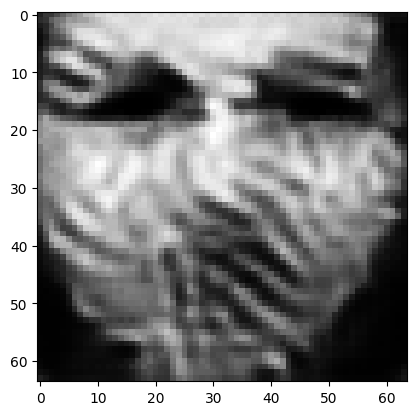

tensor([[1.0649e-04, 9.7067e-01, 6.7760e-05, 4.1480e-03, 1.0007e-04, 7.2076e-04,
         5.4980e-05, 9.2283e-04, 1.0767e-04, 4.3600e-04, 1.3216e-04, 1.1827e-03,
         1.8625e-03, 3.7242e-05, 1.4791e-04, 2.1353e-04, 1.4663e-04, 1.0471e-03,
         6.4150e-04, 8.1366e-04, 9.3886e-05, 3.3204e-06, 2.3461e-04, 3.9684e-05,
         1.0553e-04, 7.8656e-04, 5.1900e-04, 2.8316e-04, 3.9590e-04, 2.0950e-03,
         1.9125e-03, 6.0848e-04, 2.3939e-03, 1.8759e-05, 1.6881e-03, 4.7603e-03,
         6.8265e-05, 1.4352e-04, 1.8080e-04, 1.0968e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0297690462321043
tensor([[1.0580e-04, 9.7085e-01, 6.7259e-05, 4.1257e-03, 9.9257e-05, 7.1573e-04,
         5.4472e-05, 9.1688e-04, 1.0681e-04, 4.3302e-04, 1.3113e-04, 1.1756e-03,
         1.8492e-03, 3.6999e-05, 1.4674e-04, 2.1201e-04, 1.4566e-04, 1.0385e-03,
         6.3801e-04, 8.0642e-04, 9.2985e-05, 3.2896e-06, 2.3309e-04, 3.9361e-05,
         1.0484e-04, 7.8249e-04, 5.1551e-04

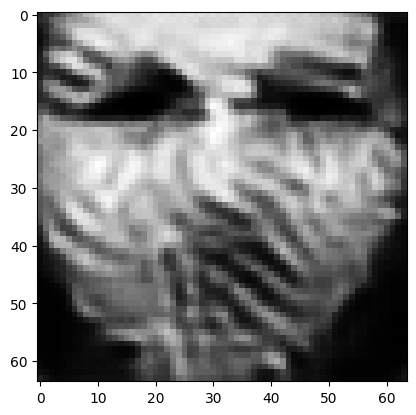

tensor([[1.0358e-04, 9.7149e-01, 6.5505e-05, 4.0348e-03, 9.6601e-05, 6.9835e-04,
         5.2927e-05, 8.9653e-04, 1.0373e-04, 4.2279e-04, 1.2754e-04, 1.1515e-03,
         1.8050e-03, 3.6101e-05, 1.4348e-04, 2.0719e-04, 1.4248e-04, 1.0130e-03,
         6.2738e-04, 7.8493e-04, 9.0178e-05, 3.1913e-06, 2.2778e-04, 3.8236e-05,
         1.0222e-04, 7.6344e-04, 5.0602e-04, 2.7441e-04, 3.8014e-04, 2.0489e-03,
         1.8675e-03, 5.8911e-04, 2.3231e-03, 1.8162e-05, 1.6413e-03, 4.6335e-03,
         6.5997e-05, 1.3886e-04, 1.7426e-04, 1.0588e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028919700533151627
tensor([[1.0312e-04, 9.7164e-01, 6.5113e-05, 4.0137e-03, 9.6014e-05, 6.9473e-04,
         5.2600e-05, 8.9227e-04, 1.0297e-04, 4.2051e-04, 1.2673e-04, 1.1458e-03,
         1.7947e-03, 3.5881e-05, 1.4280e-04, 2.0619e-04, 1.4180e-04, 1.0075e-03,
         6.2528e-04, 7.8067e-04, 8.9525e-05, 3.1693e-06, 2.2641e-04, 3.8001e-05,
         1.0161e-04, 7.5826e-04, 5.0398e-

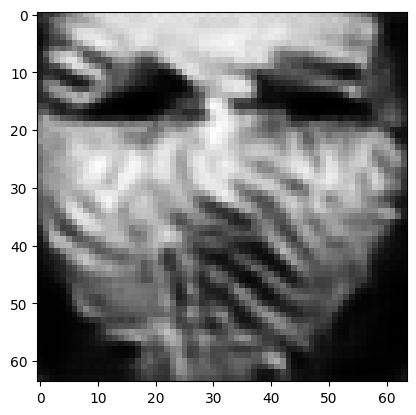

tensor([[1.0108e-04, 9.7223e-01, 6.3544e-05, 3.9385e-03, 9.3555e-05, 6.7925e-04,
         5.1158e-05, 8.7392e-04, 1.0019e-04, 4.1100e-04, 1.2346e-04, 1.1230e-03,
         1.7551e-03, 3.5085e-05, 1.3971e-04, 2.0173e-04, 1.3899e-04, 9.8330e-04,
         6.1567e-04, 7.6077e-04, 8.6905e-05, 3.0764e-06, 2.2161e-04, 3.7004e-05,
         9.9276e-05, 7.4227e-04, 4.9471e-04, 2.6664e-04, 3.6639e-04, 2.0054e-03,
         1.8270e-03, 5.7187e-04, 2.2599e-03, 1.7627e-05, 1.5995e-03, 4.5155e-03,
         6.3958e-05, 1.3462e-04, 1.6845e-04, 1.0252e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.028166182339191437
tensor([[1.0068e-04, 9.7237e-01, 6.3200e-05, 3.9187e-03, 9.3006e-05, 6.7603e-04,
         5.0864e-05, 8.7007e-04, 9.9490e-05, 4.0888e-04, 1.2271e-04, 1.1176e-03,
         1.7453e-03, 3.4881e-05, 1.3908e-04, 2.0084e-04, 1.3837e-04, 9.7809e-04,
         6.1373e-04, 7.5695e-04, 8.6308e-05, 3.0565e-06, 2.2030e-04, 3.6789e-05,
         9.8707e-05, 7.3748e-04, 4.9281e-

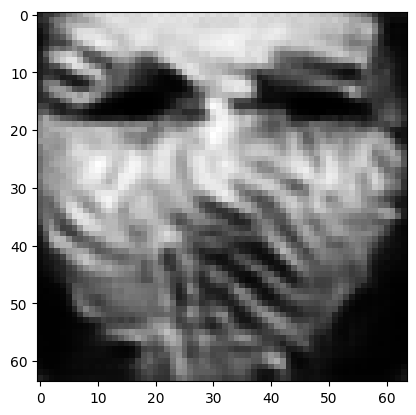

tensor([[9.8806e-05, 9.7291e-01, 6.1787e-05, 3.8504e-03, 9.0764e-05, 6.6242e-04,
         4.9556e-05, 8.5282e-04, 9.6894e-05, 3.9999e-04, 1.1960e-04, 1.0960e-03,
         1.7092e-03, 3.4165e-05, 1.3598e-04, 1.9669e-04, 1.3587e-04, 9.5483e-04,
         6.0444e-04, 7.3813e-04, 8.3808e-05, 2.9702e-06, 2.1591e-04, 3.5896e-05,
         9.6629e-05, 7.2312e-04, 4.8381e-04, 2.5910e-04, 3.5356e-04, 1.9634e-03,
         1.7879e-03, 5.5535e-04, 2.2028e-03, 1.7147e-05, 1.5599e-03, 4.4007e-03,
         6.2069e-05, 1.3061e-04, 1.6331e-04, 9.9528e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.027459530159831047
tensor([[9.8344e-05, 9.7305e-01, 6.1448e-05, 3.8358e-03, 9.0198e-05, 6.5898e-04,
         4.9201e-05, 8.4865e-04, 9.6292e-05, 3.9773e-04, 1.1888e-04, 1.0907e-03,
         1.6999e-03, 3.4004e-05, 1.3516e-04, 1.9565e-04, 1.3525e-04, 9.4882e-04,
         6.0214e-04, 7.3291e-04, 8.3199e-05, 2.9481e-06, 2.1491e-04, 3.5673e-05,
         9.6124e-05, 7.2039e-04, 4.8137e-

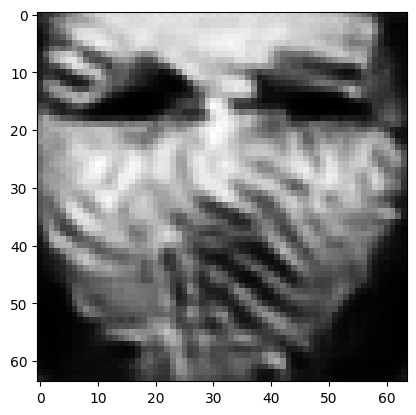

tensor([[9.6895e-05, 9.7355e-01, 6.0316e-05, 3.7756e-03, 8.8348e-05, 6.4882e-04,
         4.8079e-05, 8.3435e-04, 9.3853e-05, 3.9003e-04, 1.1604e-04, 1.0705e-03,
         1.6682e-03, 3.3344e-05, 1.3246e-04, 1.9219e-04, 1.3323e-04, 9.2802e-04,
         5.9442e-04, 7.1742e-04, 8.0885e-05, 2.8738e-06, 2.1054e-04, 3.4960e-05,
         9.4309e-05, 7.0517e-04, 4.7386e-04, 2.5211e-04, 3.4183e-04, 1.9224e-03,
         1.7508e-03, 5.3947e-04, 2.1486e-03, 1.6710e-05, 1.5242e-03, 4.2857e-03,
         6.0326e-05, 1.2699e-04, 1.5870e-04, 9.6845e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026805419474840164
tensor([[9.6495e-05, 9.7367e-01, 6.0043e-05, 3.7637e-03, 8.7928e-05, 6.4679e-04,
         4.7793e-05, 8.3047e-04, 9.3327e-05, 3.8813e-04, 1.1530e-04, 1.0657e-03,
         1.6620e-03, 3.3205e-05, 1.3172e-04, 1.9121e-04, 1.3281e-04, 9.2285e-04,
         5.9207e-04, 7.1318e-04, 8.0311e-05, 2.8545e-06, 2.0975e-04, 3.4794e-05,
         9.3928e-05, 7.0228e-04, 4.7178e-

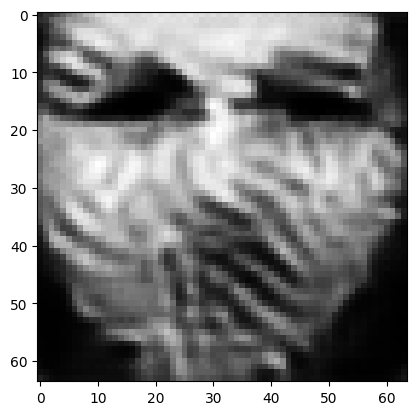

tensor([[9.5454e-05, 9.7410e-01, 5.9052e-05, 3.7103e-03, 8.6472e-05, 6.3926e-04,
         4.6910e-05, 8.1959e-04, 9.1131e-05, 3.8176e-04, 1.1301e-04, 1.0482e-03,
         1.6336e-03, 3.2616e-05, 1.2970e-04, 1.8863e-04, 1.3126e-04, 9.0690e-04,
         5.8644e-04, 7.0101e-04, 7.8396e-05, 2.7952e-06, 2.0598e-04, 3.4283e-05,
         9.2371e-05, 6.8761e-04, 4.6548e-04, 2.4620e-04, 3.3162e-04, 1.8825e-03,
         1.7157e-03, 5.2615e-04, 2.1025e-03, 1.6336e-05, 1.4927e-03, 4.1893e-03,
         5.8834e-05, 1.2373e-04, 1.5474e-04, 9.4489e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02624436281621456
tensor([[9.5054e-05, 9.7420e-01, 5.8761e-05, 3.7002e-03, 8.6036e-05, 6.3664e-04,
         4.6618e-05, 8.1588e-04, 9.0671e-05, 3.7993e-04, 1.1242e-04, 1.0438e-03,
         1.6266e-03, 3.2493e-05, 1.2905e-04, 1.8774e-04, 1.3076e-04, 9.0217e-04,
         5.8436e-04, 6.9655e-04, 7.7899e-05, 2.7773e-06, 2.0530e-04, 3.4116e-05,
         9.1974e-05, 6.8560e-04, 4.6340e-0

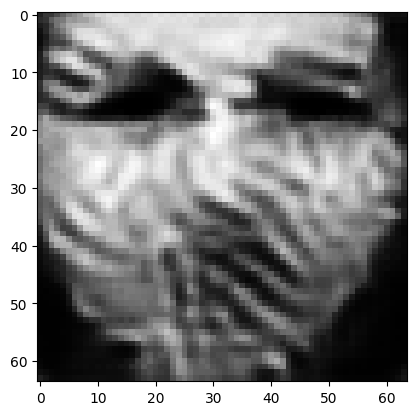

tensor([[9.4204e-05, 9.7462e-01, 5.7932e-05, 3.6442e-03, 8.4576e-05, 6.3150e-04,
         4.5889e-05, 8.0630e-04, 8.8566e-05, 3.7479e-04, 1.1014e-04, 1.0268e-03,
         1.5979e-03, 3.1888e-05, 1.2687e-04, 1.8563e-04, 1.2927e-04, 8.8651e-04,
         5.7996e-04, 6.8743e-04, 7.6149e-05, 2.7216e-06, 2.0108e-04, 3.3546e-05,
         9.0131e-05, 6.6952e-04, 4.5911e-04, 2.4059e-04, 3.2259e-04, 1.8504e-03,
         1.6805e-03, 5.1318e-04, 2.0616e-03, 1.5996e-05, 1.4639e-03, 4.0866e-03,
         5.7374e-05, 1.2085e-04, 1.5112e-04, 9.2641e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025707503780722618
tensor([[9.3763e-05, 9.7472e-01, 5.7652e-05, 3.6356e-03, 8.4122e-05, 6.2892e-04,
         4.5587e-05, 8.0234e-04, 8.8171e-05, 3.7301e-04, 1.0953e-04, 1.0223e-03,
         1.5911e-03, 3.1777e-05, 1.2611e-04, 1.8467e-04, 1.2875e-04, 8.8141e-04,
         5.7765e-04, 6.8263e-04, 7.5657e-05, 2.7029e-06, 2.0050e-04, 3.3360e-05,
         8.9712e-05, 6.6836e-04, 4.5696e-

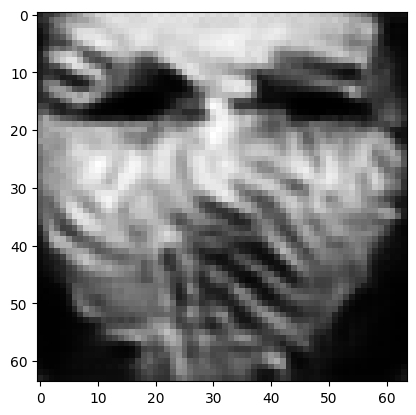

tensor([[9.2951e-05, 9.7510e-01, 5.6888e-05, 3.5854e-03, 8.2782e-05, 6.2445e-04,
         4.4911e-05, 7.9309e-04, 8.6228e-05, 3.6814e-04, 1.0740e-04, 1.0067e-03,
         1.5657e-03, 3.1235e-05, 1.2400e-04, 1.8282e-04, 1.2749e-04, 8.6624e-04,
         5.7353e-04, 6.7392e-04, 7.4043e-05, 2.6522e-06, 1.9688e-04, 3.2861e-05,
         8.8056e-05, 6.5417e-04, 4.5261e-04, 2.3523e-04, 3.1437e-04, 1.8206e-03,
         1.6488e-03, 5.0052e-04, 2.0234e-03, 1.5683e-05, 1.4374e-03, 3.9918e-03,
         5.6087e-05, 1.1825e-04, 1.4774e-04, 9.0977e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.025211043655872345
tensor([[9.2582e-05, 9.7520e-01, 5.6639e-05, 3.5764e-03, 8.2370e-05, 6.2236e-04,
         4.4658e-05, 7.8950e-04, 8.5828e-05, 3.6655e-04, 1.0683e-04, 1.0025e-03,
         1.5595e-03, 3.1122e-05, 1.2332e-04, 1.8205e-04, 1.2705e-04, 8.6154e-04,
         5.7162e-04, 6.7000e-04, 7.3600e-05, 2.6362e-06, 1.9628e-04, 3.2698e-05,
         8.7653e-05, 6.5249e-04, 4.5082e-

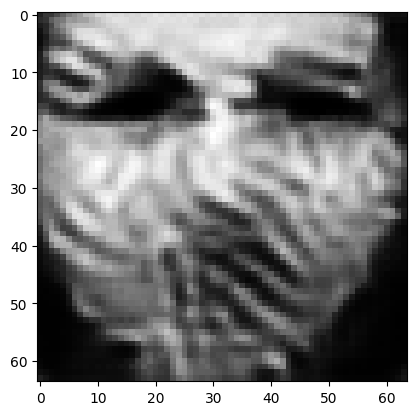

tensor([[9.1694e-05, 9.7556e-01, 5.5877e-05, 3.5307e-03, 8.1044e-05, 6.1799e-04,
         4.3971e-05, 7.7977e-04, 8.3998e-05, 3.6173e-04, 1.0476e-04, 9.8739e-04,
         1.5362e-03, 3.0613e-05, 1.2120e-04, 1.8011e-04, 1.2587e-04, 8.4571e-04,
         5.6735e-04, 6.6087e-04, 7.2029e-05, 2.5854e-06, 1.9307e-04, 3.2216e-05,
         8.6099e-05, 6.4067e-04, 4.4620e-04, 2.2999e-04, 3.0665e-04, 1.7919e-03,
         1.6191e-03, 4.8836e-04, 1.9868e-03, 1.5388e-05, 1.4121e-03, 3.9057e-03,
         5.4901e-05, 1.1576e-04, 1.4452e-04, 8.9408e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024743760004639626
tensor([[9.1344e-05, 9.7564e-01, 5.5651e-05, 3.5233e-03, 8.0672e-05, 6.1618e-04,
         4.3729e-05, 7.7650e-04, 8.3630e-05, 3.6028e-04, 1.0424e-04, 9.8359e-04,
         1.5308e-03, 3.0512e-05, 1.2056e-04, 1.7936e-04, 1.2549e-04, 8.4109e-04,
         5.6563e-04, 6.5714e-04, 7.1610e-05, 2.5702e-06, 1.9255e-04, 3.2074e-05,
         8.5756e-05, 6.3953e-04, 4.4445e-

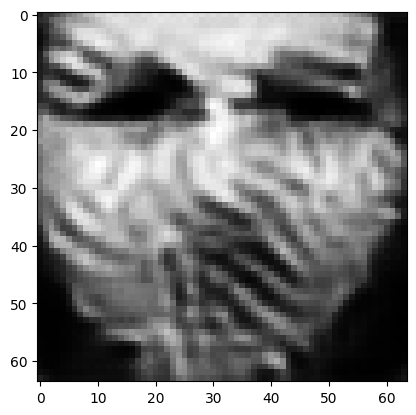

tensor([[9.0567e-05, 9.7597e-01, 5.4997e-05, 3.4833e-03, 7.9496e-05, 6.1252e-04,
         4.3102e-05, 7.6830e-04, 8.1959e-05, 3.5597e-04, 1.0242e-04, 9.6972e-04,
         1.5093e-03, 3.0048e-05, 1.1863e-04, 1.7767e-04, 1.2447e-04, 8.2663e-04,
         5.6205e-04, 6.4895e-04, 7.0189e-05, 2.5244e-06, 1.8957e-04, 3.1672e-05,
         8.4369e-05, 6.2909e-04, 4.4009e-04, 2.2530e-04, 2.9977e-04, 1.7646e-03,
         1.5929e-03, 4.7737e-04, 1.9523e-03, 1.5116e-05, 1.3890e-03, 3.8280e-03,
         5.3860e-05, 1.1359e-04, 1.4157e-04, 8.7955e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024322332814335823
tensor([[9.0307e-05, 9.7605e-01, 5.4825e-05, 3.4745e-03, 7.9213e-05, 6.1138e-04,
         4.2927e-05, 7.6579e-04, 8.1593e-05, 3.5482e-04, 1.0195e-04, 9.6635e-04,
         1.5046e-03, 2.9950e-05, 1.1811e-04, 1.7713e-04, 1.2420e-04, 8.2304e-04,
         5.6075e-04, 6.4644e-04, 6.9839e-05, 2.5121e-06, 1.8902e-04, 3.1565e-05,
         8.4057e-05, 6.2732e-04, 4.3877e-

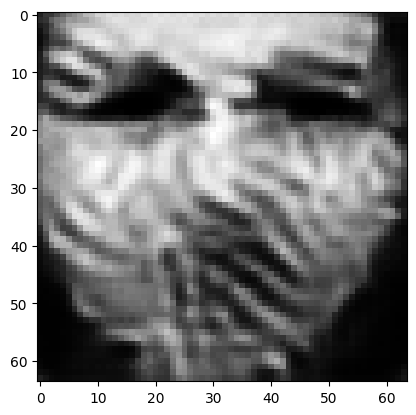

tensor([[8.9472e-05, 9.7635e-01, 5.4220e-05, 3.4364e-03, 7.8129e-05, 6.0723e-04,
         4.2332e-05, 7.5793e-04, 8.0156e-05, 3.5097e-04, 1.0035e-04, 9.5418e-04,
         1.4848e-03, 2.9549e-05, 1.1636e-04, 1.7557e-04, 1.2322e-04, 8.1018e-04,
         5.5703e-04, 6.3862e-04, 6.8609e-05, 2.4710e-06, 1.8649e-04, 3.1190e-05,
         8.2779e-05, 6.1854e-04, 4.3445e-04, 2.2120e-04, 2.9357e-04, 1.7400e-03,
         1.5702e-03, 4.6761e-04, 1.9214e-03, 1.4875e-05, 1.3681e-03, 3.7561e-03,
         5.2953e-05, 1.1159e-04, 1.3896e-04, 8.6666e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023939019069075584
tensor([[8.9202e-05, 9.7642e-01, 5.4037e-05, 3.4297e-03, 7.7822e-05, 6.0565e-04,
         4.2138e-05, 7.5547e-04, 7.9844e-05, 3.4986e-04, 9.9960e-05, 9.5115e-04,
         1.4798e-03, 2.9463e-05, 1.1586e-04, 1.7506e-04, 1.2291e-04, 8.0660e-04,
         5.5579e-04, 6.3571e-04, 6.8286e-05, 2.4594e-06, 1.8599e-04, 3.1082e-05,
         8.2477e-05, 6.1728e-04, 4.3306e-

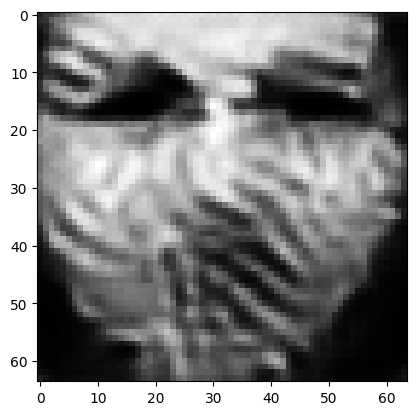

tensor([[8.8465e-05, 9.7669e-01, 5.3491e-05, 3.3944e-03, 7.6816e-05, 6.0236e-04,
         4.1602e-05, 7.4815e-04, 7.8521e-05, 3.4671e-04, 9.8419e-05, 9.4037e-04,
         1.4619e-03, 2.9086e-05, 1.1419e-04, 1.7370e-04, 1.2204e-04, 7.9440e-04,
         5.5239e-04, 6.2884e-04, 6.7162e-05, 2.4228e-06, 1.8363e-04, 3.0742e-05,
         8.1313e-05, 6.0813e-04, 4.2920e-04, 2.1714e-04, 2.8811e-04, 1.7186e-03,
         1.5474e-03, 4.5880e-04, 1.8924e-03, 1.4663e-05, 1.3489e-03, 3.6891e-03,
         5.2066e-05, 1.0975e-04, 1.3657e-04, 8.5484e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02358350344002247
tensor([[8.8230e-05, 9.7676e-01, 5.3336e-05, 3.3879e-03, 7.6531e-05, 6.0104e-04,
         4.1430e-05, 7.4611e-04, 7.8236e-05, 3.4580e-04, 9.8066e-05, 9.3769e-04,
         1.4570e-03, 2.9005e-05, 1.1371e-04, 1.7326e-04, 1.2175e-04, 7.9100e-04,
         5.5137e-04, 6.2635e-04, 6.6876e-05, 2.4129e-06, 1.8311e-04, 3.0645e-05,
         8.1027e-05, 6.0673e-04, 4.2796e-0

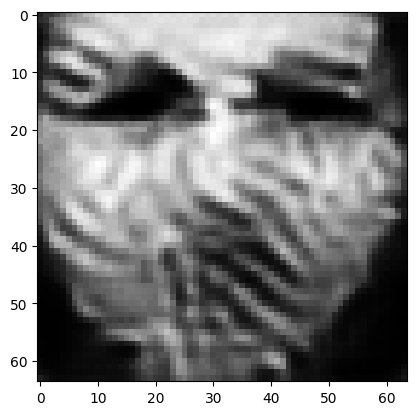

tensor([[8.7526e-05, 9.7701e-01, 5.2821e-05, 3.3559e-03, 7.5634e-05, 5.9786e-04,
         4.0930e-05, 7.3926e-04, 7.7030e-05, 3.4279e-04, 9.6660e-05, 9.2769e-04,
         1.4409e-03, 2.8665e-05, 1.1217e-04, 1.7197e-04, 1.2094e-04, 7.7996e-04,
         5.4807e-04, 6.1979e-04, 6.5850e-05, 2.3790e-06, 1.8100e-04, 3.0341e-05,
         8.0001e-05, 5.9871e-04, 4.2430e-04, 2.1340e-04, 2.8310e-04, 1.6988e-03,
         1.5263e-03, 4.5085e-04, 1.8658e-03, 1.4469e-05, 1.3312e-03, 3.6287e-03,
         5.1265e-05, 1.0809e-04, 1.3442e-04, 8.4394e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023258375003933907
tensor([[8.7302e-05, 9.7707e-01, 5.2669e-05, 3.3503e-03, 7.5382e-05, 5.9654e-04,
         4.0770e-05, 7.3729e-04, 7.6774e-05, 3.4192e-04, 9.6348e-05, 9.2524e-04,
         1.4365e-03, 2.8596e-05, 1.1175e-04, 1.7156e-04, 1.2068e-04, 7.7706e-04,
         5.4706e-04, 6.1744e-04, 6.5592e-05, 2.3697e-06, 1.8057e-04, 3.0254e-05,
         7.9753e-05, 5.9759e-04, 4.2312e-

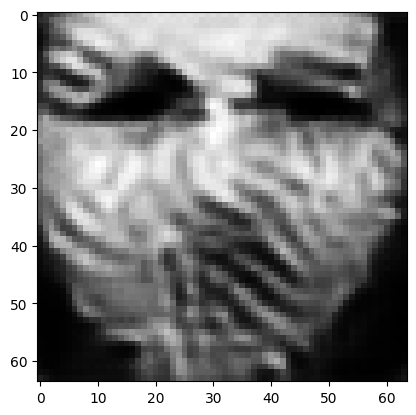

tensor([[8.6679e-05, 9.7729e-01, 5.2187e-05, 3.3218e-03, 7.4578e-05, 5.9315e-04,
         4.0303e-05, 7.3121e-04, 7.5697e-05, 3.3901e-04, 9.5166e-05, 9.1628e-04,
         1.4216e-03, 2.8299e-05, 1.1049e-04, 1.7043e-04, 1.1996e-04, 7.6779e-04,
         5.4419e-04, 6.1164e-04, 6.4716e-05, 2.3388e-06, 1.7872e-04, 2.9983e-05,
         7.8837e-05, 5.9065e-04, 4.1975e-04, 2.1013e-04, 2.7862e-04, 1.6814e-03,
         1.5073e-03, 4.4405e-04, 1.8407e-03, 1.4286e-05, 1.3154e-03, 3.5769e-03,
         5.0565e-05, 1.0670e-04, 1.3236e-04, 8.3300e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022969024255871773
tensor([[8.6503e-05, 9.7735e-01, 5.2068e-05, 3.3154e-03, 7.4377e-05, 5.9226e-04,
         4.0180e-05, 7.2960e-04, 7.5453e-05, 3.3827e-04, 9.4878e-05, 9.1408e-04,
         1.4180e-03, 2.8232e-05, 1.1015e-04, 1.7013e-04, 1.1977e-04, 7.6550e-04,
         5.4334e-04, 6.1001e-04, 6.4500e-05, 2.3307e-06, 1.7831e-04, 2.9911e-05,
         7.8609e-05, 5.8934e-04, 4.1882e-

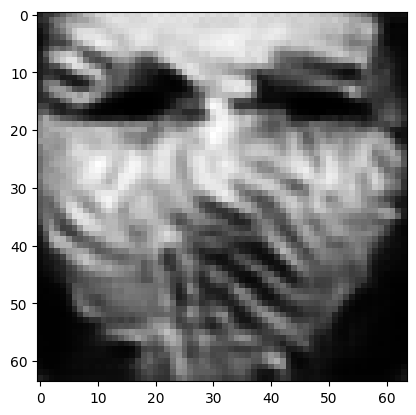

tensor([[8.5817e-05, 9.7755e-01, 5.1604e-05, 3.2921e-03, 7.3599e-05, 5.8875e-04,
         3.9697e-05, 7.2322e-04, 7.4549e-05, 3.3538e-04, 9.3781e-05, 9.0568e-04,
         1.4046e-03, 2.7980e-05, 1.0887e-04, 1.6891e-04, 1.1903e-04, 7.5680e-04,
         5.3997e-04, 6.0357e-04, 6.3679e-05, 2.2995e-06, 1.7682e-04, 2.9628e-05,
         7.7742e-05, 5.8457e-04, 4.1528e-04, 2.0720e-04, 2.7454e-04, 1.6657e-03,
         1.4910e-03, 4.3752e-04, 1.8174e-03, 1.4112e-05, 1.3012e-03, 3.5290e-03,
         4.9975e-05, 1.0544e-04, 1.3048e-04, 8.2316e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02270546182990074
tensor([[8.5641e-05, 9.7760e-01, 5.1488e-05, 3.2863e-03, 7.3412e-05, 5.8781e-04,
         3.9581e-05, 7.2162e-04, 7.4337e-05, 3.3468e-04, 9.3518e-05, 9.0371e-04,
         1.4013e-03, 2.7920e-05, 1.0856e-04, 1.6859e-04, 1.1884e-04, 7.5473e-04,
         5.3911e-04, 6.0195e-04, 6.3484e-05, 2.2921e-06, 1.7648e-04, 2.9559e-05,
         7.7537e-05, 5.8352e-04, 4.1441e-0

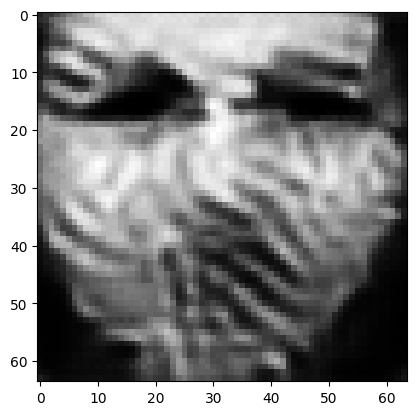

tensor([[8.4988e-05, 9.7778e-01, 5.1048e-05, 3.2647e-03, 7.2697e-05, 5.8440e-04,
         3.9130e-05, 7.1548e-04, 7.3513e-05, 3.3197e-04, 9.2498e-05, 8.9607e-04,
         1.3890e-03, 2.7686e-05, 1.0739e-04, 1.6741e-04, 1.1812e-04, 7.4679e-04,
         5.3592e-04, 5.9573e-04, 6.2734e-05, 2.2637e-06, 1.7515e-04, 2.9294e-05,
         7.6746e-05, 5.7930e-04, 4.1113e-04, 2.0450e-04, 2.7081e-04, 1.6514e-03,
         1.4761e-03, 4.3162e-04, 1.7959e-03, 1.3952e-05, 1.2882e-03, 3.4878e-03,
         4.9438e-05, 1.0430e-04, 1.2876e-04, 8.1392e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022465841844677925
tensor([[8.4835e-05, 9.7783e-01, 5.0941e-05, 3.2592e-03, 7.2526e-05, 5.8358e-04,
         3.9025e-05, 7.1399e-04, 7.3312e-05, 3.3132e-04, 9.2248e-05, 8.9420e-04,
         1.3860e-03, 2.7628e-05, 1.0711e-04, 1.6713e-04, 1.1795e-04, 7.4490e-04,
         5.3518e-04, 5.9430e-04, 6.2556e-05, 2.2568e-06, 1.7483e-04, 2.9228e-05,
         7.6551e-05, 5.7821e-04, 4.1039e-

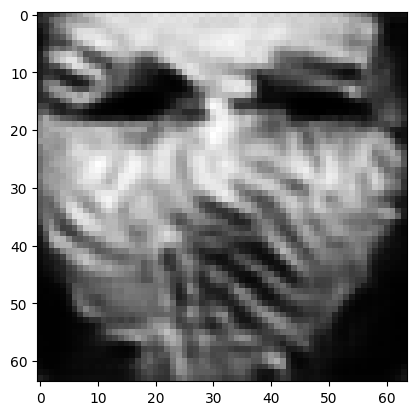

tensor([[8.4310e-05, 9.7800e-01, 5.0555e-05, 3.2373e-03, 7.1899e-05, 5.8098e-04,
         3.8646e-05, 7.0873e-04, 7.2513e-05, 3.2896e-04, 9.1319e-05, 8.8718e-04,
         1.3745e-03, 2.7399e-05, 1.0610e-04, 1.6620e-04, 1.1737e-04, 7.3796e-04,
         5.3259e-04, 5.8933e-04, 6.1891e-05, 2.2317e-06, 1.7349e-04, 2.8998e-05,
         7.5818e-05, 5.7347e-04, 4.0762e-04, 2.0202e-04, 2.6743e-04, 1.6386e-03,
         1.4607e-03, 4.2621e-04, 1.7766e-03, 1.3808e-05, 1.2766e-03, 3.4474e-03,
         4.8916e-05, 1.0319e-04, 1.2716e-04, 8.0589e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022242018952965736
tensor([[8.4204e-05, 9.7805e-01, 5.0466e-05, 3.2316e-03, 7.1759e-05, 5.8050e-04,
         3.8568e-05, 7.0753e-04, 7.2307e-05, 3.2845e-04, 9.1092e-05, 8.8549e-04,
         1.3717e-03, 2.7340e-05, 1.0586e-04, 1.6601e-04, 1.1724e-04, 7.3641e-04,
         5.3200e-04, 5.8829e-04, 6.1730e-05, 2.2260e-06, 1.7313e-04, 2.8946e-05,
         7.5645e-05, 5.7214e-04, 4.0700e-

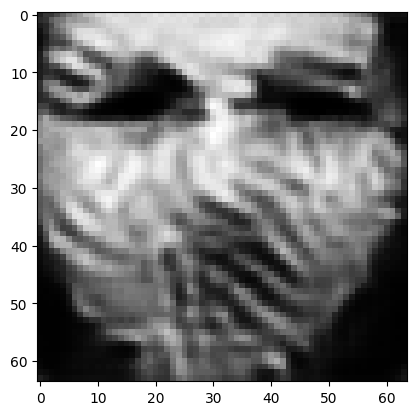

tensor([[8.3731e-05, 9.7821e-01, 5.0104e-05, 3.2113e-03, 7.1191e-05, 5.7809e-04,
         3.8222e-05, 7.0275e-04, 7.1536e-05, 3.2624e-04, 9.0241e-05, 8.7883e-04,
         1.3607e-03, 2.7123e-05, 1.0491e-04, 1.6516e-04, 1.1669e-04, 7.2994e-04,
         5.2958e-04, 5.8353e-04, 6.1084e-05, 2.2026e-06, 1.7184e-04, 2.8742e-05,
         7.4993e-05, 5.6781e-04, 4.0427e-04, 1.9975e-04, 2.6437e-04, 1.6260e-03,
         1.4456e-03, 4.2139e-04, 1.7590e-03, 1.3675e-05, 1.2654e-03, 3.4101e-03,
         4.8435e-05, 1.0215e-04, 1.2567e-04, 7.9837e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022033073008060455
tensor([[8.3630e-05, 9.7825e-01, 5.0018e-05, 3.2062e-03, 7.1059e-05, 5.7755e-04,
         3.8144e-05, 7.0167e-04, 7.1346e-05, 3.2573e-04, 9.0040e-05, 8.7723e-04,
         1.3580e-03, 2.7069e-05, 1.0469e-04, 1.6497e-04, 1.1656e-04, 7.2844e-04,
         5.2904e-04, 5.8246e-04, 6.0929e-05, 2.1972e-06, 1.7151e-04, 2.8697e-05,
         7.4842e-05, 5.6670e-04, 4.0362e-

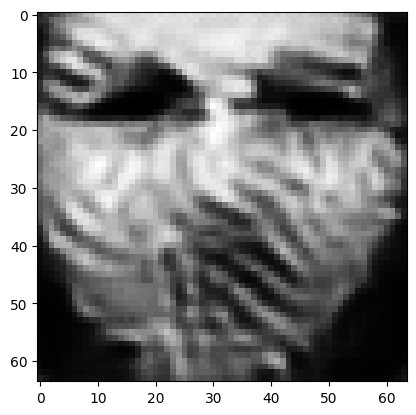

tensor([[8.3195e-05, 9.7840e-01, 4.9682e-05, 3.1871e-03, 7.0527e-05, 5.7520e-04,
         3.7825e-05, 6.9719e-04, 7.0626e-05, 3.2371e-04, 8.9255e-05, 8.7102e-04,
         1.3477e-03, 2.6868e-05, 1.0383e-04, 1.6420e-04, 1.1605e-04, 7.2244e-04,
         5.2676e-04, 5.7802e-04, 6.0327e-05, 2.1760e-06, 1.7030e-04, 2.8511e-05,
         7.4234e-05, 5.6275e-04, 4.0104e-04, 1.9768e-04, 2.6152e-04, 1.6143e-03,
         1.4320e-03, 4.1701e-04, 1.7424e-03, 1.3551e-05, 1.2550e-03, 3.3763e-03,
         4.7991e-05, 1.0120e-04, 1.2428e-04, 7.9107e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021839478984475136
tensor([[8.3112e-05, 9.7843e-01, 4.9611e-05, 3.1826e-03, 7.0412e-05, 5.7485e-04,
         3.7759e-05, 6.9627e-04, 7.0446e-05, 3.2329e-04, 8.9065e-05, 8.6959e-04,
         1.3453e-03, 2.6816e-05, 1.0363e-04, 1.6403e-04, 1.1593e-04, 7.2102e-04,
         5.2630e-04, 5.7713e-04, 6.0180e-05, 2.1714e-06, 1.6996e-04, 2.8474e-05,
         7.4099e-05, 5.6158e-04, 4.0051e-

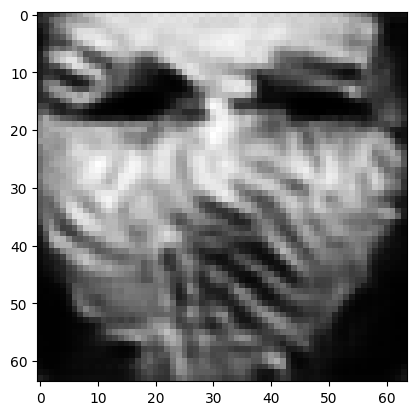

tensor([[8.2771e-05, 9.7857e-01, 4.9338e-05, 3.1653e-03, 6.9968e-05, 5.7347e-04,
         3.7498e-05, 6.9248e-04, 6.9775e-05, 3.2162e-04, 8.8332e-05, 8.6411e-04,
         1.3363e-03, 2.6623e-05, 1.0283e-04, 1.6338e-04, 1.1550e-04, 7.1568e-04,
         5.2429e-04, 5.7357e-04, 5.9621e-05, 2.1533e-06, 1.6874e-04, 2.8324e-05,
         7.3572e-05, 5.5743e-04, 3.9835e-04, 1.9575e-04, 2.5892e-04, 1.6029e-03,
         1.4186e-03, 4.1317e-04, 1.7283e-03, 1.3442e-05, 1.2454e-03, 3.3432e-03,
         4.7574e-05, 1.0027e-04, 1.2309e-04, 7.8512e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021663229912519455
tensor([[8.2657e-05, 9.7860e-01, 4.9262e-05, 3.1614e-03, 6.9848e-05, 5.7297e-04,
         3.7423e-05, 6.9138e-04, 6.9624e-05, 3.2118e-04, 8.8141e-05, 8.6276e-04,
         1.3342e-03, 2.6579e-05, 1.0261e-04, 1.6316e-04, 1.1537e-04, 7.1420e-04,
         5.2365e-04, 5.7247e-04, 5.9477e-05, 2.1484e-06, 1.6849e-04, 2.8280e-05,
         7.3446e-05, 5.5671e-04, 3.9771e-

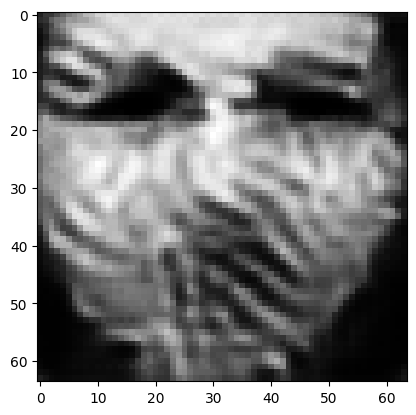

tensor([[8.2335e-05, 9.7873e-01, 4.9000e-05, 3.1449e-03, 6.9434e-05, 5.7163e-04,
         3.7182e-05, 6.8778e-04, 6.9005e-05, 3.1962e-04, 8.7456e-05, 8.5772e-04,
         1.3257e-03, 2.6400e-05, 1.0187e-04, 1.6255e-04, 1.1496e-04, 7.0930e-04,
         5.2173e-04, 5.6917e-04, 5.8964e-05, 2.1316e-06, 1.6735e-04, 2.8136e-05,
         7.2952e-05, 5.5281e-04, 3.9570e-04, 1.9393e-04, 2.5646e-04, 1.5923e-03,
         1.4066e-03, 4.0957e-04, 1.7153e-03, 1.3341e-05, 1.2365e-03, 3.3138e-03,
         4.7197e-05, 9.9404e-05, 1.2198e-04, 7.7960e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021499432623386383
tensor([[8.2257e-05, 9.7876e-01, 4.8936e-05, 3.1406e-03, 6.9330e-05, 5.7125e-04,
         3.7125e-05, 6.8694e-04, 6.8855e-05, 3.1925e-04, 8.7292e-05, 8.5650e-04,
         1.3237e-03, 2.6355e-05, 1.0170e-04, 1.6240e-04, 1.1486e-04, 7.0810e-04,
         5.2130e-04, 5.6844e-04, 5.8844e-05, 2.1277e-06, 1.6707e-04, 2.8100e-05,
         7.2830e-05, 5.5181e-04, 3.9524e-

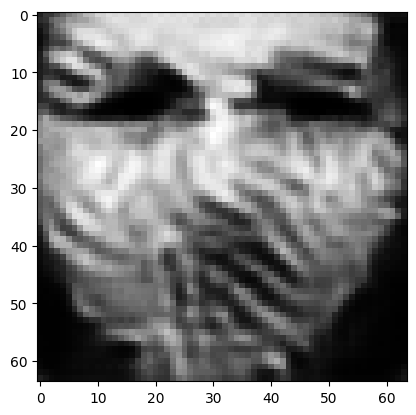

tensor([[8.1952e-05, 9.7888e-01, 4.8685e-05, 3.1241e-03, 6.8944e-05, 5.6987e-04,
         3.6913e-05, 6.8358e-04, 6.8270e-05, 3.1784e-04, 8.6657e-05, 8.5187e-04,
         1.3158e-03, 2.6187e-05, 1.0101e-04, 1.6183e-04, 1.1446e-04, 7.0358e-04,
         5.1954e-04, 5.6550e-04, 5.8373e-05, 2.1126e-06, 1.6601e-04, 2.7968e-05,
         7.2378e-05, 5.4813e-04, 3.9335e-04, 1.9227e-04, 2.5421e-04, 1.5825e-03,
         1.3951e-03, 4.0640e-04, 1.7037e-03, 1.3249e-05, 1.2281e-03, 3.2872e-03,
         4.6835e-05, 9.8588e-05, 1.2098e-04, 7.7450e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021347861737012863
tensor([[8.1886e-05, 9.7891e-01, 4.8627e-05, 3.1201e-03, 6.8854e-05, 5.6958e-04,
         3.6862e-05, 6.8287e-04, 6.8124e-05, 3.1751e-04, 8.6510e-05, 8.5077e-04,
         1.3138e-03, 2.6145e-05, 1.0085e-04, 1.6170e-04, 1.1438e-04, 7.0249e-04,
         5.1919e-04, 5.6485e-04, 5.8261e-05, 2.1090e-06, 1.6574e-04, 2.7940e-05,
         7.2271e-05, 5.4717e-04, 3.9290e-

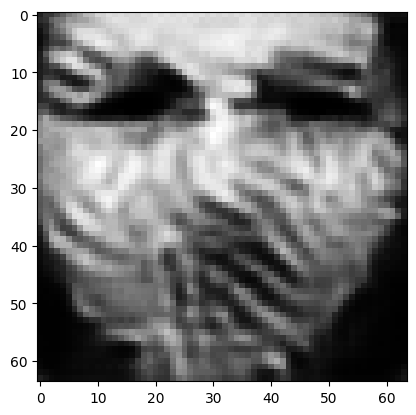

tensor([[8.1603e-05, 9.7902e-01, 4.8385e-05, 3.1047e-03, 6.8492e-05, 5.6820e-04,
         3.6662e-05, 6.7983e-04, 6.7569e-05, 3.1618e-04, 8.5930e-05, 8.4642e-04,
         1.3061e-03, 2.5986e-05, 1.0021e-04, 1.6117e-04, 1.1400e-04, 6.9819e-04,
         5.1763e-04, 5.6205e-04, 5.7819e-05, 2.0951e-06, 1.6471e-04, 2.7820e-05,
         7.1855e-05, 5.4365e-04, 3.9109e-04, 1.9071e-04, 2.5212e-04, 1.5730e-03,
         1.3840e-03, 4.0357e-04, 1.6926e-03, 1.3163e-05, 1.2201e-03, 3.2632e-03,
         4.6498e-05, 9.7847e-05, 1.2003e-04, 7.6949e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.021205255761742592
tensor([[8.1526e-05, 9.7904e-01, 4.8323e-05, 3.1013e-03, 6.8401e-05, 5.6782e-04,
         3.6610e-05, 6.7903e-04, 6.7439e-05, 3.1584e-04, 8.5788e-05, 8.4536e-04,
         1.3043e-03, 2.5948e-05, 1.0004e-04, 1.6103e-04, 1.1390e-04, 6.9713e-04,
         5.1721e-04, 5.6127e-04, 5.7708e-05, 2.0915e-06, 1.6447e-04, 2.7789e-05,
         7.1755e-05, 5.4289e-04, 3.9062e-

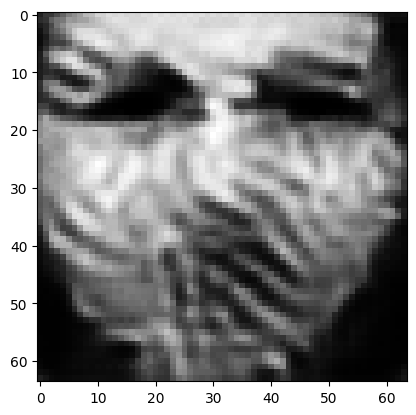

tensor([[8.1244e-05, 9.7915e-01, 4.8090e-05, 3.0883e-03, 6.8062e-05, 5.6644e-04,
         3.6411e-05, 6.7598e-04, 6.6945e-05, 3.1452e-04, 8.5244e-05, 8.4129e-04,
         1.2975e-03, 2.5807e-05, 9.9424e-05, 1.6048e-04, 1.1354e-04, 6.9306e-04,
         5.1559e-04, 5.5836e-04, 5.7290e-05, 2.0780e-06, 1.6358e-04, 2.7675e-05,
         7.1388e-05, 5.3995e-04, 3.8885e-04, 1.8923e-04, 2.5012e-04, 1.5640e-03,
         1.3741e-03, 4.0089e-04, 1.6819e-03, 1.3080e-05, 1.2126e-03, 3.2425e-03,
         4.6202e-05, 9.7177e-05, 1.1913e-04, 7.6468e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02107488363981247
tensor([[8.1177e-05, 9.7917e-01, 4.8033e-05, 3.0851e-03, 6.7978e-05, 5.6607e-04,
         3.6363e-05, 6.7526e-04, 6.6827e-05, 3.1420e-04, 8.5115e-05, 8.4031e-04,
         1.2958e-03, 2.5772e-05, 9.9282e-05, 1.6034e-04, 1.1345e-04, 6.9207e-04,
         5.1521e-04, 5.5769e-04, 5.7190e-05, 2.0747e-06, 1.6335e-04, 2.7646e-05,
         7.1299e-05, 5.3923e-04, 3.8843e-0

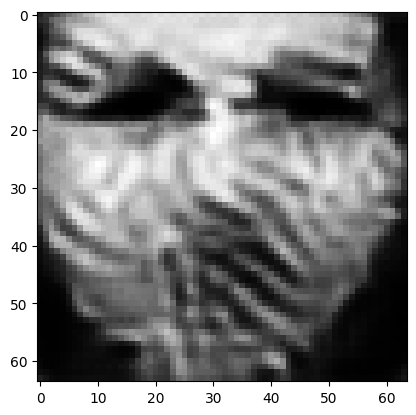

tensor([[8.0913e-05, 9.7926e-01, 4.7816e-05, 3.0730e-03, 6.7666e-05, 5.6479e-04,
         3.6176e-05, 6.7237e-04, 6.6368e-05, 3.1295e-04, 8.4604e-05, 8.3654e-04,
         1.2895e-03, 2.5641e-05, 9.8709e-05, 1.5982e-04, 1.1311e-04, 6.8829e-04,
         5.1365e-04, 5.5492e-04, 5.6798e-05, 2.0621e-06, 1.6253e-04, 2.7542e-05,
         7.0963e-05, 5.3651e-04, 3.8675e-04, 1.8785e-04, 2.4825e-04, 1.5555e-03,
         1.3649e-03, 3.9840e-04, 1.6719e-03, 1.3003e-05, 1.2056e-03, 3.2235e-03,
         4.5928e-05, 9.6544e-05, 1.1830e-04, 7.6013e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020953834056854248
tensor([[8.0849e-05, 9.7929e-01, 4.7761e-05, 3.0699e-03, 6.7586e-05, 5.6444e-04,
         3.6133e-05, 6.7168e-04, 6.6255e-05, 3.1266e-04, 8.4481e-05, 8.3562e-04,
         1.2879e-03, 2.5608e-05, 9.8571e-05, 1.5970e-04, 1.1303e-04, 6.8736e-04,
         5.1329e-04, 5.5429e-04, 5.6704e-05, 2.0591e-06, 1.6231e-04, 2.7514e-05,
         7.0876e-05, 5.3582e-04, 3.8636e-

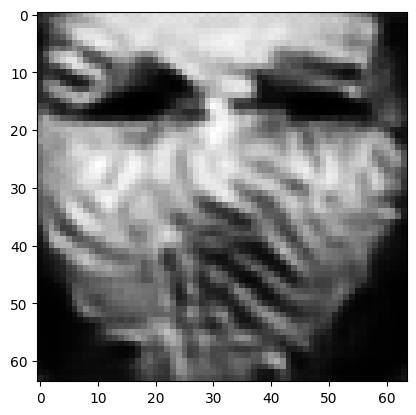

tensor([[8.0598e-05, 9.7938e-01, 4.7557e-05, 3.0583e-03, 6.7289e-05, 5.6323e-04,
         3.5957e-05, 6.6894e-04, 6.5815e-05, 3.1146e-04, 8.3993e-05, 8.3201e-04,
         1.2820e-03, 2.5483e-05, 9.8029e-05, 1.5921e-04, 1.1272e-04, 6.8375e-04,
         5.1181e-04, 5.5169e-04, 5.6331e-05, 2.0471e-06, 1.6153e-04, 2.7416e-05,
         7.0563e-05, 5.3320e-04, 3.8476e-04, 1.8656e-04, 2.4647e-04, 1.5474e-03,
         1.3563e-03, 3.9603e-04, 1.6625e-03, 1.2931e-05, 1.1989e-03, 3.2052e-03,
         4.5670e-05, 9.5924e-05, 1.1752e-04, 7.5581e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020838141441345215
tensor([[8.0537e-05, 9.7940e-01, 4.7508e-05, 3.0554e-03, 6.7221e-05, 5.6296e-04,
         3.5916e-05, 6.6830e-04, 6.5707e-05, 3.1118e-04, 8.3878e-05, 8.3116e-04,
         1.2805e-03, 2.5453e-05, 9.7899e-05, 1.5909e-04, 1.1265e-04, 6.8289e-04,
         5.1145e-04, 5.5106e-04, 5.6242e-05, 2.0443e-06, 1.6134e-04, 2.7394e-05,
         7.0491e-05, 5.3257e-04, 3.8436e-

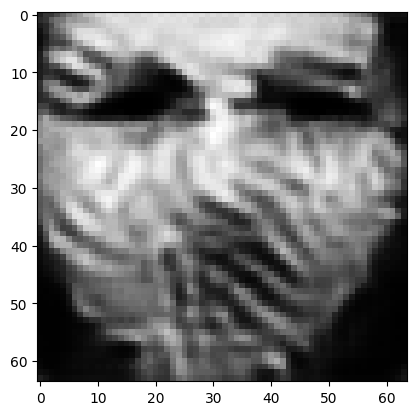

tensor([[8.0320e-05, 9.7948e-01, 4.7321e-05, 3.0438e-03, 6.6950e-05, 5.6192e-04,
         3.5761e-05, 6.6585e-04, 6.5284e-05, 3.1012e-04, 8.3428e-05, 8.2783e-04,
         1.2749e-03, 2.5331e-05, 9.7417e-05, 1.5867e-04, 1.1237e-04, 6.7955e-04,
         5.1017e-04, 5.4884e-04, 5.5899e-05, 2.0337e-06, 1.6056e-04, 2.7308e-05,
         7.0200e-05, 5.2982e-04, 3.8294e-04, 1.8534e-04, 2.4482e-04, 1.5394e-03,
         1.3479e-03, 3.9389e-04, 1.6539e-03, 1.2865e-05, 1.1926e-03, 3.1879e-03,
         4.5424e-05, 9.5325e-05, 1.1678e-04, 7.5179e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020729323849081993
tensor([[8.0268e-05, 9.7950e-01, 4.7275e-05, 3.0411e-03, 6.6883e-05, 5.6165e-04,
         3.5722e-05, 6.6524e-04, 6.5184e-05, 3.0985e-04, 8.3319e-05, 8.2701e-04,
         1.2736e-03, 2.5302e-05, 9.7306e-05, 1.5856e-04, 1.1230e-04, 6.7875e-04,
         5.0985e-04, 5.4831e-04, 5.5816e-05, 2.0310e-06, 1.6037e-04, 2.7286e-05,
         7.0130e-05, 5.2917e-04, 3.8260e-

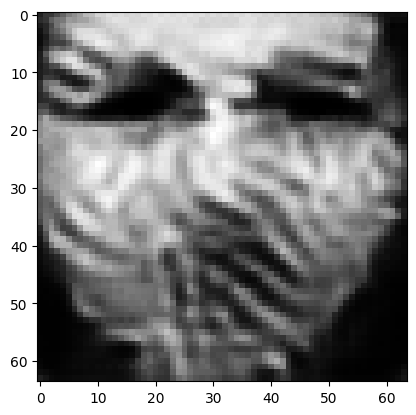

tensor([[8.0061e-05, 9.7958e-01, 4.7098e-05, 3.0307e-03, 6.6629e-05, 5.6069e-04,
         3.5573e-05, 6.6289e-04, 6.4791e-05, 3.0882e-04, 8.2893e-05, 8.2390e-04,
         1.2685e-03, 2.5189e-05, 9.6847e-05, 1.5814e-04, 1.1203e-04, 6.7564e-04,
         5.0860e-04, 5.4614e-04, 5.5494e-05, 2.0208e-06, 1.5966e-04, 2.7205e-05,
         6.9860e-05, 5.2668e-04, 3.8125e-04, 1.8420e-04, 2.4325e-04, 1.5319e-03,
         1.3401e-03, 3.9185e-04, 1.6457e-03, 1.2802e-05, 1.1868e-03, 3.1715e-03,
         4.5194e-05, 9.4764e-05, 1.1609e-04, 7.4798e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020627617835998535
tensor([[8.0009e-05, 9.7960e-01, 4.7055e-05, 3.0281e-03, 6.6565e-05, 5.6041e-04,
         3.5535e-05, 6.6234e-04, 6.4698e-05, 3.0856e-04, 8.2792e-05, 8.2315e-04,
         1.2672e-03, 2.5162e-05, 9.6742e-05, 1.5804e-04, 1.1197e-04, 6.7486e-04,
         5.0830e-04, 5.4561e-04, 5.5418e-05, 2.0184e-06, 1.5949e-04, 2.7184e-05,
         6.9793e-05, 5.2609e-04, 3.8092e-

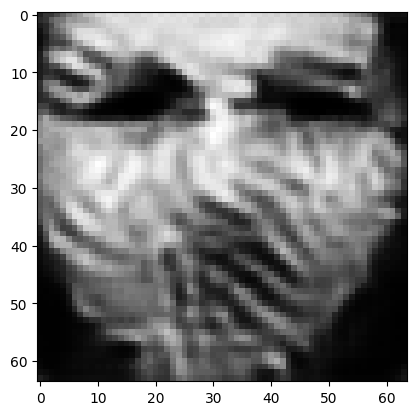

tensor([[7.9827e-05, 9.7968e-01, 4.6891e-05, 3.0179e-03, 6.6330e-05, 5.5953e-04,
         3.5401e-05, 6.6024e-04, 6.4319e-05, 3.0761e-04, 8.2394e-05, 8.2025e-04,
         1.2623e-03, 2.5053e-05, 9.6330e-05, 1.5766e-04, 1.1173e-04, 6.7199e-04,
         5.0726e-04, 5.4370e-04, 5.5121e-05, 2.0091e-06, 1.5879e-04, 2.7110e-05,
         6.9533e-05, 5.2354e-04, 3.7973e-04, 1.8312e-04, 2.4178e-04, 1.5249e-03,
         1.3325e-03, 3.8996e-04, 1.6380e-03, 1.2743e-05, 1.1812e-03, 3.1561e-03,
         4.4969e-05, 9.4232e-05, 1.1544e-04, 7.4439e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020531155169010162
tensor([[7.9789e-05, 9.7970e-01, 4.6852e-05, 3.0154e-03, 6.6276e-05, 5.5937e-04,
         3.5371e-05, 6.5975e-04, 6.4225e-05, 3.0738e-04, 8.2293e-05, 8.1953e-04,
         1.2612e-03, 2.5025e-05, 9.6233e-05, 1.5758e-04, 1.1168e-04, 6.7133e-04,
         5.0701e-04, 5.4328e-04, 5.5048e-05, 2.0068e-06, 1.5862e-04, 2.7093e-05,
         6.9472e-05, 5.2288e-04, 3.7947e-

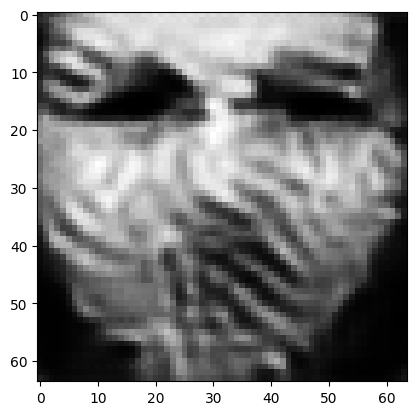

tensor([[7.9617e-05, 9.7977e-01, 4.6697e-05, 3.0059e-03, 6.6049e-05, 5.5848e-04,
         3.5243e-05, 6.5778e-04, 6.3875e-05, 3.0648e-04, 8.1915e-05, 8.1676e-04,
         1.2565e-03, 2.4924e-05, 9.5834e-05, 1.5721e-04, 1.1144e-04, 6.6862e-04,
         5.0599e-04, 5.4141e-04, 5.4766e-05, 1.9979e-06, 1.5796e-04, 2.7019e-05,
         6.9224e-05, 5.2051e-04, 3.7837e-04, 1.8211e-04, 2.4040e-04, 1.5182e-03,
         1.3253e-03, 3.8815e-04, 1.6308e-03, 1.2688e-05, 1.1760e-03, 3.1411e-03,
         4.4754e-05, 9.3730e-05, 1.1483e-04, 7.4109e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02044040895998478
tensor([[7.9576e-05, 9.7978e-01, 4.6659e-05, 3.0036e-03, 6.5996e-05, 5.5829e-04,
         3.5212e-05, 6.5730e-04, 6.3788e-05, 3.0626e-04, 8.1820e-05, 8.1607e-04,
         1.2554e-03, 2.4898e-05, 9.5740e-05, 1.5712e-04, 1.1139e-04, 6.6795e-04,
         5.0573e-04, 5.4097e-04, 5.4696e-05, 1.9957e-06, 1.5780e-04, 2.7002e-05,
         6.9167e-05, 5.1992e-04, 3.7810e-0

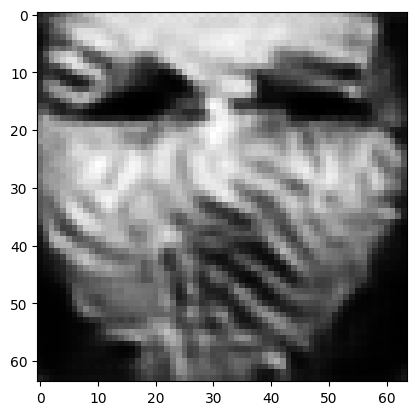

tensor([[7.9418e-05, 9.7985e-01, 4.6518e-05, 2.9949e-03, 6.5780e-05, 5.5754e-04,
         3.5091e-05, 6.5544e-04, 6.3461e-05, 3.0543e-04, 8.1465e-05, 8.1350e-04,
         1.2509e-03, 2.4803e-05, 9.5355e-05, 1.5679e-04, 1.1116e-04, 6.6539e-04,
         5.0478e-04, 5.3919e-04, 5.4431e-05, 1.9874e-06, 1.5717e-04, 2.6932e-05,
         6.8924e-05, 5.1768e-04, 3.7710e-04, 1.8115e-04, 2.3911e-04, 1.5121e-03,
         1.3185e-03, 3.8644e-04, 1.6240e-03, 1.2636e-05, 1.1711e-03, 3.1266e-03,
         4.4550e-05, 9.3266e-05, 1.1425e-04, 7.3806e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02035420760512352
tensor([[7.9392e-05, 9.7987e-01, 4.6490e-05, 2.9924e-03, 6.5732e-05, 5.5743e-04,
         3.5069e-05, 6.5507e-04, 6.3377e-05, 3.0526e-04, 8.1383e-05, 8.1290e-04,
         1.2498e-03, 2.4778e-05, 9.5278e-05, 1.5674e-04, 1.1111e-04, 6.6484e-04,
         5.0463e-04, 5.3890e-04, 5.4371e-05, 1.9856e-06, 1.5699e-04, 2.6917e-05,
         6.8861e-05, 5.1700e-04, 3.7693e-0

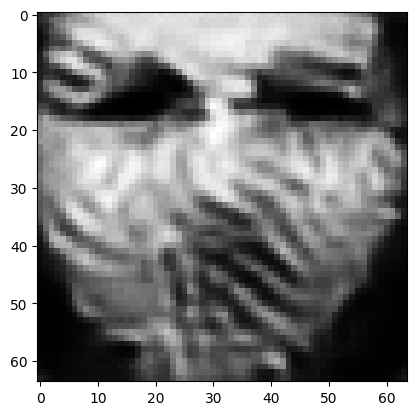

tensor([[7.9244e-05, 9.7993e-01, 4.6360e-05, 2.9835e-03, 6.5532e-05, 5.5670e-04,
         3.4964e-05, 6.5336e-04, 6.3064e-05, 3.0447e-04, 8.1063e-05, 8.1046e-04,
         1.2454e-03, 2.4688e-05, 9.4944e-05, 1.5648e-04, 1.1090e-04, 6.6260e-04,
         5.0383e-04, 5.3734e-04, 5.4133e-05, 1.9779e-06, 1.5638e-04, 2.6848e-05,
         6.8617e-05, 5.1482e-04, 3.7609e-04, 1.8033e-04, 2.3794e-04, 1.5065e-03,
         1.3120e-03, 3.8489e-04, 1.6176e-03, 1.2586e-05, 1.1666e-03, 3.1123e-03,
         4.4353e-05, 9.2835e-05, 1.1369e-04, 7.3529e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02027314156293869
tensor([[7.9209e-05, 9.7995e-01, 4.6329e-05, 2.9814e-03, 6.5484e-05, 5.5652e-04,
         3.4938e-05, 6.5295e-04, 6.2990e-05, 3.0428e-04, 8.0988e-05, 8.0989e-04,
         1.2443e-03, 2.4666e-05, 9.4864e-05, 1.5642e-04, 1.1084e-04, 6.6208e-04,
         5.0365e-04, 5.3696e-04, 5.4078e-05, 1.9761e-06, 1.5623e-04, 2.6831e-05,
         6.8556e-05, 5.1430e-04, 3.7590e-0

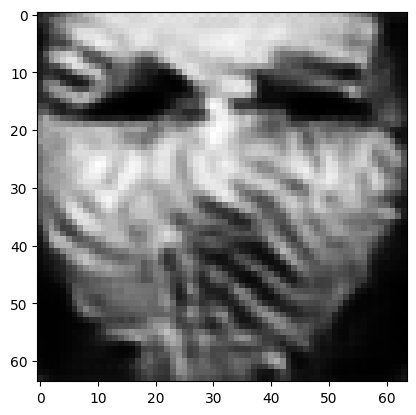

tensor([[7.9056e-05, 9.8001e-01, 4.6188e-05, 2.9729e-03, 6.5270e-05, 5.5564e-04,
         3.4823e-05, 6.5118e-04, 6.2681e-05, 3.0344e-04, 8.0671e-05, 8.0742e-04,
         1.2398e-03, 2.4577e-05, 9.4529e-05, 1.5613e-04, 1.1063e-04, 6.5979e-04,
         5.0281e-04, 5.3533e-04, 5.3837e-05, 1.9679e-06, 1.5564e-04, 2.6759e-05,
         6.8318e-05, 5.1218e-04, 3.7496e-04, 1.7950e-04, 2.3676e-04, 1.5009e-03,
         1.3058e-03, 3.8340e-04, 1.6110e-03, 1.2534e-05, 1.1622e-03, 3.0991e-03,
         4.4165e-05, 9.2432e-05, 1.1311e-04, 7.3216e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020192883908748627
tensor([[7.9017e-05, 9.8002e-01, 4.6152e-05, 2.9708e-03, 6.5219e-05, 5.5542e-04,
         3.4794e-05, 6.5073e-04, 6.2605e-05, 3.0323e-04, 8.0592e-05, 8.0681e-04,
         1.2387e-03, 2.4555e-05, 9.4450e-05, 1.5605e-04, 1.1058e-04, 6.5922e-04,
         5.0260e-04, 5.3493e-04, 5.3778e-05, 1.9659e-06, 1.5549e-04, 2.6742e-05,
         6.8260e-05, 5.1166e-04, 3.7473e-

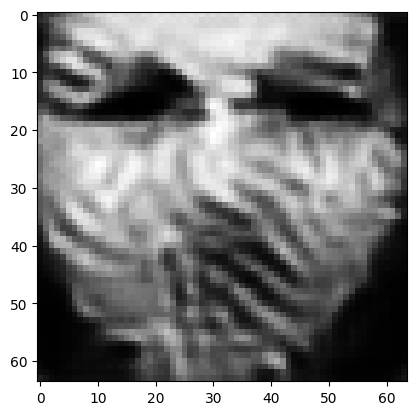

tensor([[7.8857e-05, 9.8009e-01, 4.6010e-05, 2.9629e-03, 6.5007e-05, 5.5445e-04,
         3.4676e-05, 6.4893e-04, 6.2321e-05, 3.0241e-04, 8.0294e-05, 8.0450e-04,
         1.2343e-03, 2.4472e-05, 9.4124e-05, 1.5575e-04, 1.1035e-04, 6.5700e-04,
         5.0174e-04, 5.3325e-04, 5.3551e-05, 1.9580e-06, 1.5495e-04, 2.6669e-05,
         6.8031e-05, 5.0977e-04, 3.7379e-04, 1.7868e-04, 2.3559e-04, 1.4954e-03,
         1.2999e-03, 3.8197e-04, 1.6044e-03, 1.2482e-05, 1.1578e-03, 3.0872e-03,
         4.3985e-05, 9.2057e-05, 1.1254e-04, 7.2897e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020115893334150314
tensor([[7.8820e-05, 9.8010e-01, 4.5976e-05, 2.9610e-03, 6.4957e-05, 5.5423e-04,
         3.4649e-05, 6.4849e-04, 6.2252e-05, 3.0222e-04, 8.0222e-05, 8.0396e-04,
         1.2333e-03, 2.4452e-05, 9.4046e-05, 1.5568e-04, 1.1030e-04, 6.5647e-04,
         5.0153e-04, 5.3285e-04, 5.3496e-05, 1.9562e-06, 1.5481e-04, 2.6652e-05,
         6.7976e-05, 5.0929e-04, 3.7357e-

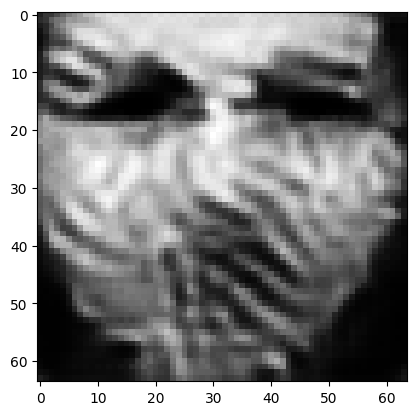

tensor([[7.8665e-05, 9.8016e-01, 4.5844e-05, 2.9538e-03, 6.4759e-05, 5.5333e-04,
         3.4538e-05, 6.4676e-04, 6.1989e-05, 3.0147e-04, 7.9944e-05, 8.0185e-04,
         1.2293e-03, 2.4376e-05, 9.3733e-05, 1.5540e-04, 1.1009e-04, 6.5436e-04,
         5.0070e-04, 5.3125e-04, 5.3284e-05, 1.9489e-06, 1.5430e-04, 2.6585e-05,
         6.7762e-05, 5.0756e-04, 3.7269e-04, 1.7790e-04, 2.3453e-04, 1.4905e-03,
         1.2944e-03, 3.8067e-04, 1.5983e-03, 1.2435e-05, 1.1538e-03, 3.0761e-03,
         4.3819e-05, 9.1713e-05, 1.1201e-04, 7.2606e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020044386386871338
tensor([[7.8620e-05, 9.8017e-01, 4.5810e-05, 2.9522e-03, 6.4711e-05, 5.5310e-04,
         3.4508e-05, 6.4630e-04, 6.1929e-05, 3.0128e-04, 7.9874e-05, 8.0135e-04,
         1.2284e-03, 2.4358e-05, 9.3650e-05, 1.5531e-04, 1.1004e-04, 6.5381e-04,
         5.0045e-04, 5.3080e-04, 5.3231e-05, 1.9470e-06, 1.5420e-04, 2.6569e-05,
         6.7717e-05, 5.0724e-04, 3.7241e-

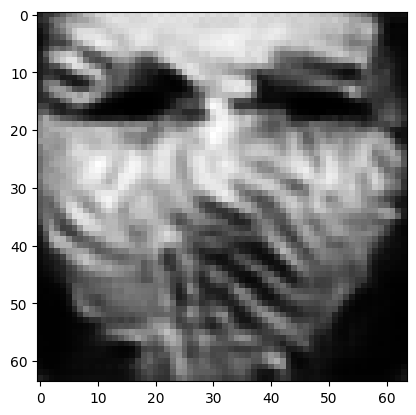

tensor([[7.8468e-05, 9.8022e-01, 4.5685e-05, 2.9458e-03, 6.4533e-05, 5.5232e-04,
         3.4403e-05, 6.4462e-04, 6.1693e-05, 3.0057e-04, 7.9610e-05, 7.9945e-04,
         1.2249e-03, 2.4289e-05, 9.3353e-05, 1.5502e-04, 1.0985e-04, 6.5179e-04,
         4.9960e-04, 5.2923e-04, 5.3031e-05, 1.9401e-06, 1.5377e-04, 2.6508e-05,
         6.7532e-05, 5.0579e-04, 3.7152e-04, 1.7715e-04, 2.3353e-04, 1.4856e-03,
         1.2894e-03, 3.7945e-04, 1.5925e-03, 1.2390e-05, 1.1500e-03, 3.0669e-03,
         4.3679e-05, 9.1386e-05, 1.1153e-04, 7.2332e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019979536533355713
tensor([[7.8438e-05, 9.8023e-01, 4.5656e-05, 2.9440e-03, 6.4491e-05, 5.5216e-04,
         3.4380e-05, 6.4424e-04, 6.1633e-05, 3.0041e-04, 7.9546e-05, 7.9899e-04,
         1.2241e-03, 2.4271e-05, 9.3286e-05, 1.5496e-04, 1.0980e-04, 6.5133e-04,
         4.9942e-04, 5.2890e-04, 5.2983e-05, 1.9385e-06, 1.5366e-04, 2.6494e-05,
         6.7487e-05, 5.0537e-04, 3.7134e-

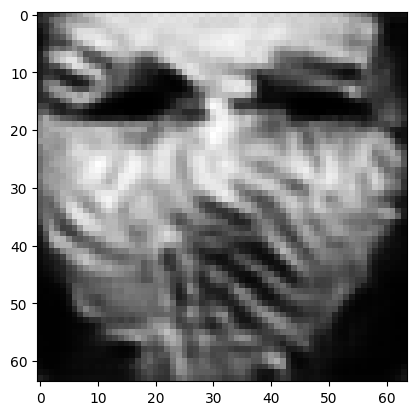

tensor([[7.8313e-05, 9.8028e-01, 4.5541e-05, 2.9374e-03, 6.4324e-05, 5.5149e-04,
         3.4288e-05, 6.4277e-04, 6.1401e-05, 2.9979e-04, 7.9298e-05, 7.9720e-04,
         1.2207e-03, 2.4202e-05, 9.3020e-05, 1.5473e-04, 1.0962e-04, 6.4947e-04,
         4.9873e-04, 5.2759e-04, 5.2797e-05, 1.9322e-06, 1.5321e-04, 2.6438e-05,
         6.7305e-05, 5.0376e-04, 3.7060e-04, 1.7646e-04, 2.3260e-04, 1.4811e-03,
         1.2843e-03, 3.7836e-04, 1.5873e-03, 1.2349e-05, 1.1465e-03, 3.0578e-03,
         4.3534e-05, 9.1068e-05, 1.1106e-04, 7.2088e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019917486235499382
tensor([[7.8281e-05, 9.8029e-01, 4.5512e-05, 2.9358e-03, 6.4283e-05, 5.5131e-04,
         3.4265e-05, 6.4239e-04, 6.1344e-05, 2.9963e-04, 7.9236e-05, 7.9676e-04,
         1.2198e-03, 2.4185e-05, 9.2955e-05, 1.5467e-04, 1.0958e-04, 6.4901e-04,
         4.9854e-04, 5.2725e-04, 5.2751e-05, 1.9307e-06, 1.5310e-04, 2.6425e-05,
         6.7263e-05, 5.0339e-04, 3.7041e-

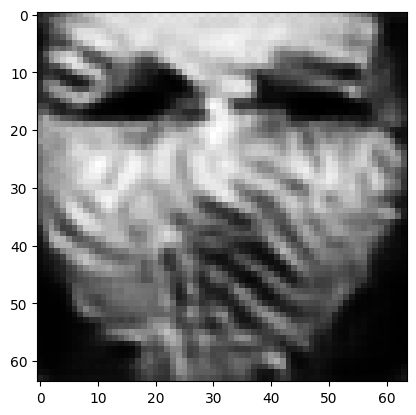

tensor([[7.8174e-05, 9.8034e-01, 4.5406e-05, 2.9293e-03, 6.4133e-05, 5.5071e-04,
         3.4185e-05, 6.4105e-04, 6.1125e-05, 2.9906e-04, 7.9008e-05, 7.9514e-04,
         1.2168e-03, 2.4120e-05, 9.2723e-05, 1.5447e-04, 1.0942e-04, 6.4736e-04,
         4.9794e-04, 5.2615e-04, 5.2585e-05, 1.9252e-06, 1.5268e-04, 2.6375e-05,
         6.7095e-05, 5.0182e-04, 3.6977e-04, 1.7583e-04, 2.3174e-04, 1.4770e-03,
         1.2796e-03, 3.7735e-04, 1.5824e-03, 1.2310e-05, 1.1432e-03, 3.0494e-03,
         4.3400e-05, 9.0767e-05, 1.1063e-04, 7.1860e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01985987462103367
tensor([[7.8154e-05, 9.8035e-01, 4.5382e-05, 2.9277e-03, 6.4100e-05, 5.5059e-04,
         3.4169e-05, 6.4078e-04, 6.1071e-05, 2.9894e-04, 7.8957e-05, 7.9478e-04,
         1.2160e-03, 2.4105e-05, 9.2672e-05, 1.5444e-04, 1.0938e-04, 6.4698e-04,
         4.9783e-04, 5.2592e-04, 5.2549e-05, 1.9240e-06, 1.5258e-04, 2.6365e-05,
         6.7056e-05, 5.0141e-04, 3.6963e-0

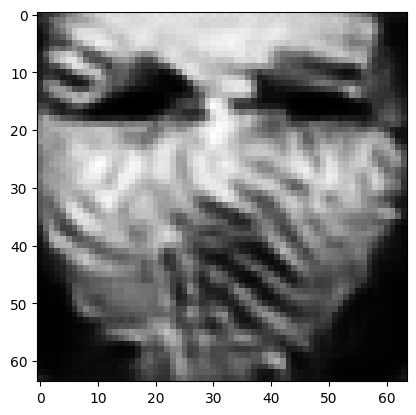

tensor([[7.8075e-05, 9.8039e-01, 4.5289e-05, 2.9214e-03, 6.3971e-05, 5.5013e-04,
         3.4106e-05, 6.3969e-04, 6.0859e-05, 2.9846e-04, 7.8756e-05, 7.9336e-04,
         1.2131e-03, 2.4044e-05, 9.2474e-05, 1.5430e-04, 1.0924e-04, 6.4558e-04,
         4.9738e-04, 5.2505e-04, 5.2404e-05, 1.9194e-06, 1.5216e-04, 2.6326e-05,
         6.6903e-05, 4.9979e-04, 3.6912e-04, 1.7528e-04, 2.3101e-04, 1.4732e-03,
         1.2751e-03, 3.7652e-04, 1.5781e-03, 1.2275e-05, 1.1403e-03, 3.0416e-03,
         4.3276e-05, 9.0491e-05, 1.1022e-04, 7.1658e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01980775035917759
tensor([[7.8047e-05, 9.8040e-01, 4.5264e-05, 2.9200e-03, 6.3937e-05, 5.4997e-04,
         3.4087e-05, 6.3937e-04, 6.0810e-05, 2.9833e-04, 7.8704e-05, 7.9299e-04,
         1.2124e-03, 2.4030e-05, 9.2418e-05, 1.5426e-04, 1.0921e-04, 6.4518e-04,
         4.9723e-04, 5.2478e-04, 5.2366e-05, 1.9182e-06, 1.5207e-04, 2.6315e-05,
         6.6866e-05, 4.9947e-04, 3.6896e-0

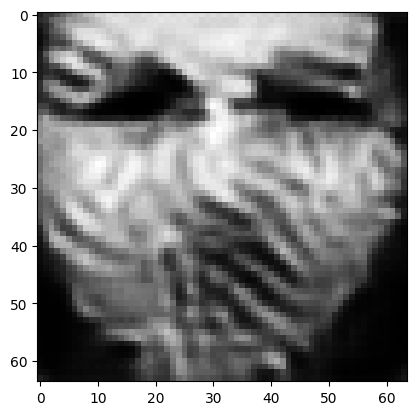

tensor([[7.7952e-05, 9.8044e-01, 4.5170e-05, 2.9144e-03, 6.3808e-05, 5.4941e-04,
         3.4018e-05, 6.3824e-04, 6.0619e-05, 2.9784e-04, 7.8510e-05, 7.9163e-04,
         1.2097e-03, 2.3975e-05, 9.2212e-05, 1.5408e-04, 1.0906e-04, 6.4374e-04,
         4.9671e-04, 5.2380e-04, 5.2225e-05, 1.9136e-06, 1.5172e-04, 2.6273e-05,
         6.6725e-05, 4.9815e-04, 3.6840e-04, 1.7474e-04, 2.3030e-04, 1.4697e-03,
         1.2712e-03, 3.7569e-04, 1.5738e-03, 1.2241e-05, 1.1374e-03, 3.0348e-03,
         4.3165e-05, 9.0241e-05, 1.0985e-04, 7.1460e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019758781418204308
tensor([[7.7928e-05, 9.8044e-01, 4.5146e-05, 2.9131e-03, 6.3777e-05, 5.4927e-04,
         3.4000e-05, 6.3795e-04, 6.0574e-05, 2.9772e-04, 7.8461e-05, 7.9129e-04,
         1.2091e-03, 2.3962e-05, 9.2160e-05, 1.5404e-04, 1.0903e-04, 6.4338e-04,
         4.9657e-04, 5.2354e-04, 5.2190e-05, 1.9124e-06, 1.5163e-04, 2.6263e-05,
         6.6691e-05, 4.9784e-04, 3.6825e-

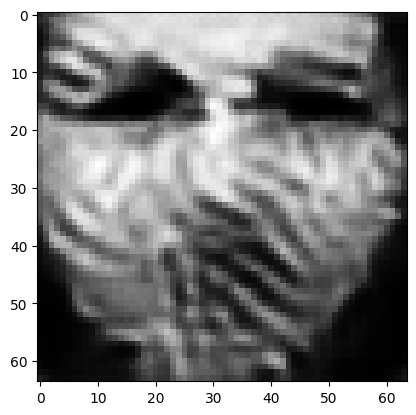

tensor([[7.7840e-05, 9.8048e-01, 4.5058e-05, 2.9078e-03, 6.3655e-05, 5.4877e-04,
         3.3935e-05, 6.3686e-04, 6.0392e-05, 2.9725e-04, 7.8276e-05, 7.9000e-04,
         1.2065e-03, 2.3909e-05, 9.1965e-05, 1.5388e-04, 1.0889e-04, 6.4203e-04,
         4.9608e-04, 5.2263e-04, 5.2056e-05, 1.9080e-06, 1.5129e-04, 2.6225e-05,
         6.6556e-05, 4.9657e-04, 3.6773e-04, 1.7423e-04, 2.2963e-04, 1.4663e-03,
         1.2674e-03, 3.7490e-04, 1.5698e-03, 1.2209e-05, 1.1348e-03, 3.0283e-03,
         4.3060e-05, 9.0002e-05, 1.0949e-04, 7.1274e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019712496548891068
tensor([[7.7816e-05, 9.8049e-01, 4.5036e-05, 2.9065e-03, 6.3626e-05, 5.4864e-04,
         3.3918e-05, 6.3657e-04, 6.0349e-05, 2.9713e-04, 7.8228e-05, 7.8968e-04,
         1.2059e-03, 2.3897e-05, 9.1915e-05, 1.5384e-04, 1.0886e-04, 6.4169e-04,
         4.9593e-04, 5.2238e-04, 5.2022e-05, 1.9069e-06, 1.5121e-04, 2.6215e-05,
         6.6523e-05, 4.9628e-04, 3.6759e-

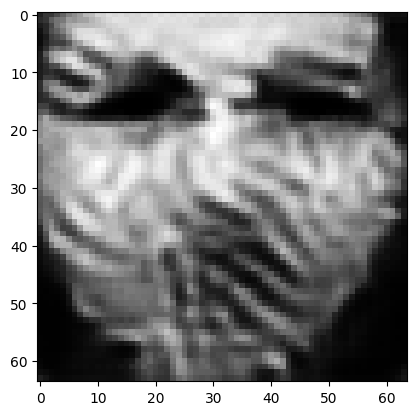

tensor([[7.7733e-05, 9.8053e-01, 4.4951e-05, 2.9012e-03, 6.3508e-05, 5.4820e-04,
         3.3854e-05, 6.3547e-04, 6.0169e-05, 2.9668e-04, 7.8044e-05, 7.8841e-04,
         1.2035e-03, 2.3844e-05, 9.1725e-05, 1.5368e-04, 1.0873e-04, 6.4036e-04,
         4.9544e-04, 5.2147e-04, 5.1888e-05, 1.9027e-06, 1.5086e-04, 2.6178e-05,
         6.6395e-05, 4.9499e-04, 3.6708e-04, 1.7372e-04, 2.2895e-04, 1.4630e-03,
         1.2636e-03, 3.7411e-04, 1.5659e-03, 1.2177e-05, 1.1322e-03, 3.0218e-03,
         4.2959e-05, 8.9762e-05, 1.0914e-04, 7.1094e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019666794687509537
tensor([[7.7711e-05, 9.8053e-01, 4.4929e-05, 2.8999e-03, 6.3478e-05, 5.4807e-04,
         3.3837e-05, 6.3519e-04, 6.0125e-05, 2.9656e-04, 7.7998e-05, 7.8809e-04,
         1.2029e-03, 2.3831e-05, 9.1677e-05, 1.5364e-04, 1.0869e-04, 6.4002e-04,
         4.9530e-04, 5.2124e-04, 5.1854e-05, 1.9016e-06, 1.5078e-04, 2.6169e-05,
         6.6364e-05, 4.9469e-04, 3.6694e-

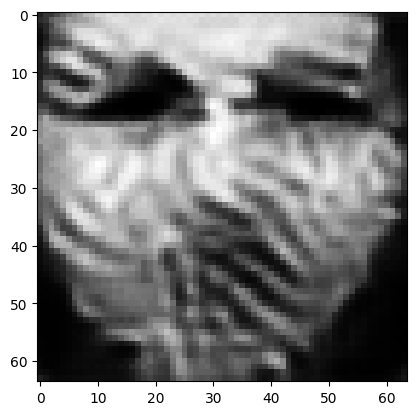

tensor([[7.7625e-05, 9.8057e-01, 4.4846e-05, 2.8950e-03, 6.3362e-05, 5.4759e-04,
         3.3771e-05, 6.3408e-04, 5.9958e-05, 2.9611e-04, 7.7821e-05, 7.8686e-04,
         1.2004e-03, 2.3782e-05, 9.1483e-05, 1.5347e-04, 1.0855e-04, 6.3873e-04,
         4.9477e-04, 5.2026e-04, 5.1725e-05, 1.8974e-06, 1.5045e-04, 2.6130e-05,
         6.6239e-05, 4.9357e-04, 3.6641e-04, 1.7321e-04, 2.2831e-04, 1.4599e-03,
         1.2600e-03, 3.7332e-04, 1.5620e-03, 1.2146e-05, 1.1297e-03, 3.0157e-03,
         4.2862e-05, 8.9541e-05, 1.0881e-04, 7.0919e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01962272636592388
tensor([[7.7614e-05, 9.8058e-01, 4.4828e-05, 2.8936e-03, 6.3337e-05, 5.4753e-04,
         3.3760e-05, 6.3387e-04, 5.9914e-05, 2.9602e-04, 7.7781e-05, 7.8658e-04,
         1.1998e-03, 2.3769e-05, 9.1449e-05, 1.5345e-04, 1.0853e-04, 6.3847e-04,
         4.9470e-04, 5.2012e-04, 5.1696e-05, 1.8965e-06, 1.5036e-04, 2.6123e-05,
         6.6207e-05, 4.9321e-04, 3.6632e-0

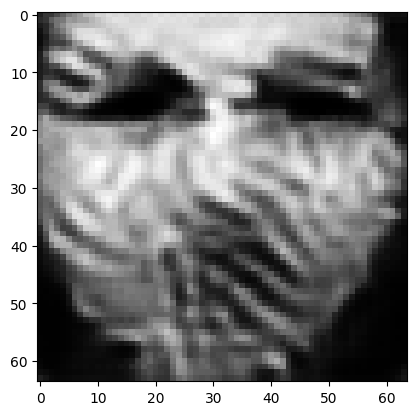

tensor([[7.7522e-05, 9.8061e-01, 4.4742e-05, 2.8887e-03, 6.3223e-05, 5.4699e-04,
         3.3695e-05, 6.3271e-04, 5.9758e-05, 2.9557e-04, 7.7609e-05, 7.8540e-04,
         1.1975e-03, 2.3722e-05, 9.1262e-05, 1.5328e-04, 1.0838e-04, 6.3724e-04,
         4.9413e-04, 5.1914e-04, 5.1573e-05, 1.8924e-06, 1.5006e-04, 2.6082e-05,
         6.6085e-05, 4.9220e-04, 3.6581e-04, 1.7275e-04, 2.2769e-04, 1.4571e-03,
         1.2565e-03, 3.7259e-04, 1.5583e-03, 1.2116e-05, 1.1273e-03, 3.0101e-03,
         4.2769e-05, 8.9325e-05, 1.0849e-04, 7.0754e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019580643624067307
tensor([[7.7502e-05, 9.8062e-01, 4.4722e-05, 2.8875e-03, 6.3196e-05, 5.4687e-04,
         3.3680e-05, 6.3243e-04, 5.9719e-05, 2.9546e-04, 7.7566e-05, 7.8511e-04,
         1.1970e-03, 2.3711e-05, 9.1220e-05, 1.5324e-04, 1.0835e-04, 6.3694e-04,
         4.9400e-04, 5.1892e-04, 5.1543e-05, 1.8914e-06, 1.4998e-04, 2.6073e-05,
         6.6057e-05, 4.9193e-04, 3.6569e-

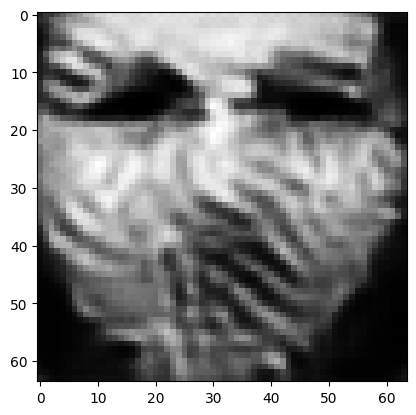

tensor([[7.7422e-05, 9.8065e-01, 4.4644e-05, 2.8830e-03, 6.3086e-05, 5.4637e-04,
         3.3621e-05, 6.3136e-04, 5.9574e-05, 2.9505e-04, 7.7408e-05, 7.8402e-04,
         1.1948e-03, 2.3666e-05, 9.1050e-05, 1.5309e-04, 1.0821e-04, 6.3580e-04,
         4.9349e-04, 5.1806e-04, 5.1432e-05, 1.8875e-06, 1.4969e-04, 2.6035e-05,
         6.5937e-05, 4.9096e-04, 3.6523e-04, 1.7230e-04, 2.2710e-04, 1.4545e-03,
         1.2533e-03, 3.7187e-04, 1.5548e-03, 1.2088e-05, 1.1251e-03, 3.0049e-03,
         4.2682e-05, 8.9125e-05, 1.0819e-04, 7.0599e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01954113133251667
tensor([[7.7400e-05, 9.8066e-01, 4.4624e-05, 2.8819e-03, 6.3058e-05, 5.4624e-04,
         3.3605e-05, 6.3107e-04, 5.9538e-05, 2.9494e-04, 7.7367e-05, 7.8374e-04,
         1.1943e-03, 2.3656e-05, 9.1006e-05, 1.5305e-04, 1.0818e-04, 6.3550e-04,
         4.9336e-04, 5.1783e-04, 5.1403e-05, 1.8865e-06, 1.4962e-04, 2.6025e-05,
         6.5910e-05, 4.9074e-04, 3.6510e-0

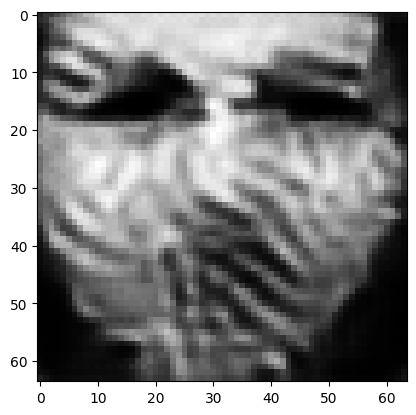

tensor([[7.7329e-05, 9.8069e-01, 4.4551e-05, 2.8775e-03, 6.2959e-05, 5.4582e-04,
         3.3552e-05, 6.3009e-04, 5.9396e-05, 2.9456e-04, 7.7217e-05, 7.8270e-04,
         1.1923e-03, 2.3613e-05, 9.0851e-05, 1.5292e-04, 1.0806e-04, 6.3443e-04,
         4.9291e-04, 5.1707e-04, 5.1296e-05, 1.8829e-06, 1.4935e-04, 2.5992e-05,
         6.5803e-05, 4.8976e-04, 3.6467e-04, 1.7187e-04, 2.2655e-04, 1.4520e-03,
         1.2502e-03, 3.7120e-04, 1.5515e-03, 1.2061e-05, 1.1230e-03, 2.9999e-03,
         4.2601e-05, 8.8932e-05, 1.0791e-04, 7.0451e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019503839313983917
tensor([[7.7296e-05, 9.8069e-01, 4.4528e-05, 2.8767e-03, 6.2926e-05, 5.4560e-04,
         3.3531e-05, 6.2975e-04, 5.9369e-05, 2.9444e-04, 7.7178e-05, 7.8244e-04,
         1.1918e-03, 2.3605e-05, 9.0796e-05, 1.5285e-04, 1.0801e-04, 6.3410e-04,
         4.9272e-04, 5.1674e-04, 5.1268e-05, 1.8818e-06, 1.4930e-04, 2.5979e-05,
         6.5773e-05, 4.8968e-04, 3.6451e-

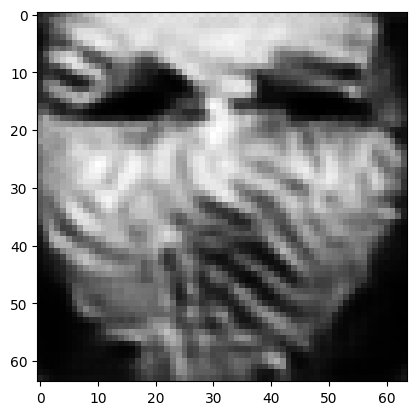

tensor([[7.7238e-05, 9.8072e-01, 4.4463e-05, 2.8725e-03, 6.2836e-05, 5.4526e-04,
         3.3484e-05, 6.2887e-04, 5.9232e-05, 2.9409e-04, 7.7037e-05, 7.8147e-04,
         1.1899e-03, 2.3563e-05, 9.0658e-05, 1.5274e-04, 1.0791e-04, 6.3312e-04,
         4.9233e-04, 5.1609e-04, 5.1168e-05, 1.8786e-06, 1.4902e-04, 2.5950e-05,
         6.5672e-05, 4.8867e-04, 3.6413e-04, 1.7146e-04, 2.2603e-04, 1.4497e-03,
         1.2474e-03, 3.7056e-04, 1.5483e-03, 1.2036e-05, 1.1211e-03, 2.9952e-03,
         4.2524e-05, 8.8756e-05, 1.0764e-04, 7.0311e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019468650221824646
tensor([[7.7217e-05, 9.8073e-01, 4.4445e-05, 2.8716e-03, 6.2811e-05, 5.4514e-04,
         3.3470e-05, 6.2861e-04, 5.9200e-05, 2.9400e-04, 7.7001e-05, 7.8123e-04,
         1.1895e-03, 2.3554e-05, 9.0618e-05, 1.5270e-04, 1.0788e-04, 6.3285e-04,
         4.9220e-04, 5.1588e-04, 5.1143e-05, 1.8777e-06, 1.4897e-04, 2.5942e-05,
         6.5648e-05, 4.8847e-04, 3.6402e-

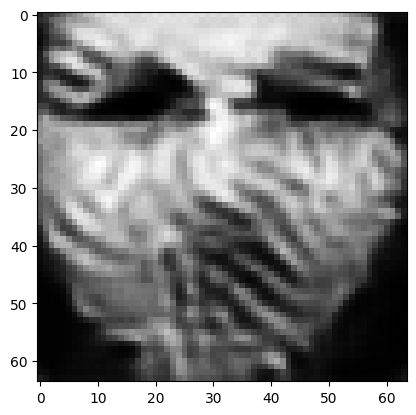

tensor([[7.7146e-05, 9.8075e-01, 4.4378e-05, 2.8678e-03, 6.2718e-05, 5.4471e-04,
         3.3418e-05, 6.2768e-04, 5.9079e-05, 2.9365e-04, 7.6866e-05, 7.8030e-04,
         1.1877e-03, 2.3517e-05, 9.0470e-05, 1.5257e-04, 1.0776e-04, 6.3186e-04,
         4.9176e-04, 5.1513e-04, 5.1047e-05, 1.8744e-06, 1.4873e-04, 2.5909e-05,
         6.5550e-05, 4.8767e-04, 3.6361e-04, 1.7107e-04, 2.2554e-04, 1.4475e-03,
         1.2447e-03, 3.6995e-04, 1.5454e-03, 1.2012e-05, 1.1192e-03, 2.9910e-03,
         4.2453e-05, 8.8589e-05, 1.0739e-04, 7.0180e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019435564056038857
tensor([[7.7134e-05, 9.8076e-01, 4.4363e-05, 2.8668e-03, 6.2698e-05, 5.4465e-04,
         3.3408e-05, 6.2748e-04, 5.9047e-05, 2.9357e-04, 7.6834e-05, 7.8009e-04,
         1.1873e-03, 2.3507e-05, 9.0440e-05, 1.5255e-04, 1.0774e-04, 6.3164e-04,
         4.9168e-04, 5.1500e-04, 5.1025e-05, 1.8737e-06, 1.4866e-04, 2.5903e-05,
         6.5528e-05, 4.8743e-04, 3.6353e-

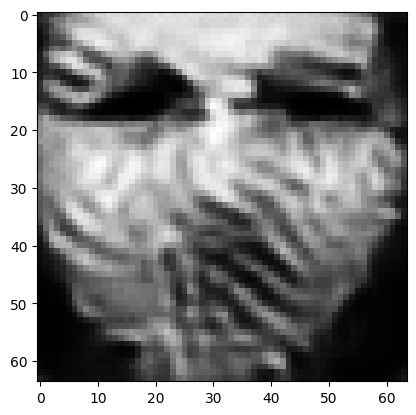

tensor([[7.7066e-05, 9.8078e-01, 4.4300e-05, 2.8633e-03, 6.2609e-05, 5.4424e-04,
         3.3359e-05, 6.2660e-04, 5.8933e-05, 2.9324e-04, 7.6705e-05, 7.7922e-04,
         1.1856e-03, 2.3473e-05, 9.0299e-05, 1.5242e-04, 1.0763e-04, 6.3069e-04,
         4.9126e-04, 5.1428e-04, 5.0934e-05, 1.8706e-06, 1.4844e-04, 2.5872e-05,
         6.5435e-05, 4.8668e-04, 3.6314e-04, 1.7071e-04, 2.2508e-04, 1.4455e-03,
         1.2421e-03, 3.6939e-04, 1.5426e-03, 1.1990e-05, 1.1174e-03, 2.9868e-03,
         4.2384e-05, 8.8429e-05, 1.0716e-04, 7.0058e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019404346123337746
tensor([[7.7054e-05, 9.8079e-01, 4.4286e-05, 2.8624e-03, 6.2590e-05, 5.4417e-04,
         3.3349e-05, 6.2641e-04, 5.8903e-05, 2.9317e-04, 7.6675e-05, 7.7901e-04,
         1.1852e-03, 2.3463e-05, 9.0270e-05, 1.5239e-04, 1.0761e-04, 6.3049e-04,
         4.9118e-04, 5.1416e-04, 5.0913e-05, 1.8699e-06, 1.4838e-04, 2.5866e-05,
         6.5412e-05, 4.8645e-04, 3.6306e-

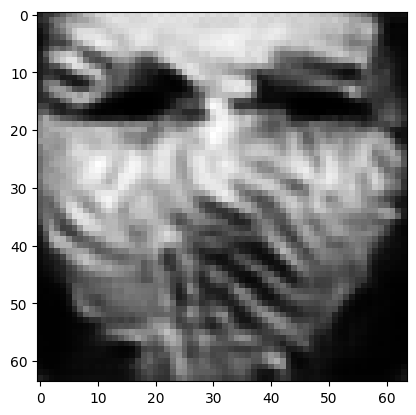

tensor([[7.6990e-05, 9.8081e-01, 4.4226e-05, 2.8589e-03, 6.2506e-05, 5.4380e-04,
         3.3303e-05, 6.2556e-04, 5.8794e-05, 2.9286e-04, 7.6552e-05, 7.7819e-04,
         1.1836e-03, 2.3430e-05, 9.0138e-05, 1.5227e-04, 1.0751e-04, 6.2959e-04,
         4.9079e-04, 5.1349e-04, 5.0828e-05, 1.8670e-06, 1.4817e-04, 2.5836e-05,
         6.5323e-05, 4.8572e-04, 3.6271e-04, 1.7036e-04, 2.2464e-04, 1.4435e-03,
         1.2397e-03, 3.6885e-04, 1.5400e-03, 1.1968e-05, 1.1158e-03, 2.9828e-03,
         4.2319e-05, 8.8275e-05, 1.0693e-04, 6.9944e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01937476545572281
tensor([[7.6976e-05, 9.8082e-01, 4.4212e-05, 2.8581e-03, 6.2487e-05, 5.4372e-04,
         3.3293e-05, 6.2537e-04, 5.8766e-05, 2.9278e-04, 7.6522e-05, 7.7800e-04,
         1.1832e-03, 2.3422e-05, 9.0108e-05, 1.5225e-04, 1.0749e-04, 6.2939e-04,
         4.9070e-04, 5.1335e-04, 5.0808e-05, 1.8663e-06, 1.4811e-04, 2.5830e-05,
         6.5303e-05, 4.8552e-04, 3.6263e-0

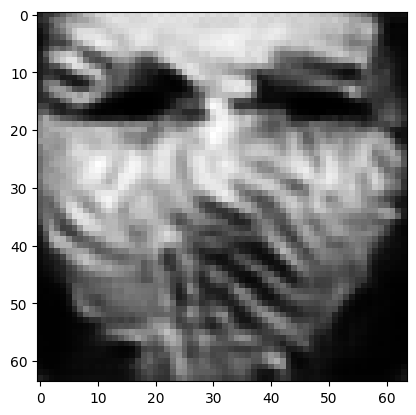

tensor([[7.6907e-05, 9.8084e-01, 4.4152e-05, 2.8550e-03, 6.2405e-05, 5.4332e-04,
         3.3245e-05, 6.2451e-04, 5.8667e-05, 2.9247e-04, 7.6404e-05, 7.7721e-04,
         1.1817e-03, 2.3392e-05, 8.9974e-05, 1.5212e-04, 1.0738e-04, 6.2852e-04,
         4.9027e-04, 5.1264e-04, 5.0725e-05, 1.8633e-06, 1.4792e-04, 2.5800e-05,
         6.5218e-05, 4.8491e-04, 3.6226e-04, 1.7003e-04, 2.2421e-04, 1.4417e-03,
         1.2374e-03, 3.6832e-04, 1.5374e-03, 1.1948e-05, 1.1142e-03, 2.9792e-03,
         4.2260e-05, 8.8134e-05, 1.0672e-04, 6.9834e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019346237182617188
tensor([[7.6895e-05, 9.8085e-01, 4.4139e-05, 2.8542e-03, 6.2386e-05, 5.4324e-04,
         3.3235e-05, 6.2432e-04, 5.8640e-05, 2.9240e-04, 7.6375e-05, 7.7701e-04,
         1.1814e-03, 2.3383e-05, 8.9946e-05, 1.5209e-04, 1.0736e-04, 6.2831e-04,
         4.9019e-04, 5.1251e-04, 5.0705e-05, 1.8627e-06, 1.4787e-04, 2.5793e-05,
         6.5196e-05, 4.8469e-04, 3.6219e-

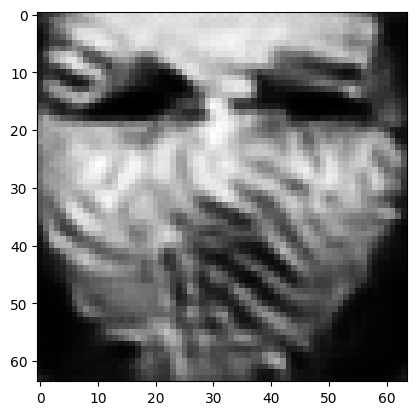

tensor([[7.6840e-05, 9.8087e-01, 4.4083e-05, 2.8509e-03, 6.2307e-05, 5.4289e-04,
         3.3191e-05, 6.2355e-04, 5.8535e-05, 2.9211e-04, 7.6261e-05, 7.7626e-04,
         1.1799e-03, 2.3352e-05, 8.9832e-05, 1.5199e-04, 1.0726e-04, 6.2749e-04,
         4.8986e-04, 5.1193e-04, 5.0627e-05, 1.8601e-06, 1.4766e-04, 2.5767e-05,
         6.5113e-05, 4.8391e-04, 3.6190e-04, 1.6971e-04, 2.2379e-04, 1.4398e-03,
         1.2351e-03, 3.6781e-04, 1.5350e-03, 1.1928e-05, 1.1126e-03, 2.9754e-03,
         4.2196e-05, 8.7987e-05, 1.0650e-04, 6.9724e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019318174570798874
tensor([[7.6825e-05, 9.8087e-01, 4.4069e-05, 2.8500e-03, 6.2288e-05, 5.4279e-04,
         3.3180e-05, 6.2335e-04, 5.8510e-05, 2.9203e-04, 7.6233e-05, 7.7607e-04,
         1.1795e-03, 2.3344e-05, 8.9803e-05, 1.5196e-04, 1.0724e-04, 6.2729e-04,
         4.8977e-04, 5.1178e-04, 5.0608e-05, 1.8595e-06, 1.4762e-04, 2.5760e-05,
         6.5092e-05, 4.8374e-04, 3.6182e-

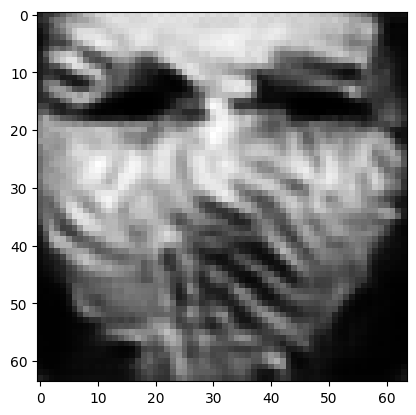

tensor([[7.6771e-05, 9.8089e-01, 4.4015e-05, 2.8469e-03, 6.2213e-05, 5.4244e-04,
         3.3138e-05, 6.2260e-04, 5.8413e-05, 2.9175e-04, 7.6125e-05, 7.7536e-04,
         1.1781e-03, 2.3315e-05, 8.9696e-05, 1.5186e-04, 1.0715e-04, 6.2651e-04,
         4.8945e-04, 5.1122e-04, 5.0535e-05, 1.8570e-06, 1.4742e-04, 2.5734e-05,
         6.5013e-05, 4.8302e-04, 3.6154e-04, 1.6940e-04, 2.2338e-04, 1.4380e-03,
         1.2330e-03, 3.6731e-04, 1.5326e-03, 1.1909e-05, 1.1111e-03, 2.9719e-03,
         4.2136e-05, 8.7850e-05, 1.0630e-04, 6.9618e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019291631877422333
tensor([[7.6747e-05, 9.8090e-01, 4.3998e-05, 2.8463e-03, 6.2188e-05, 5.4227e-04,
         3.3123e-05, 6.2235e-04, 5.8393e-05, 2.9166e-04, 7.6097e-05, 7.7516e-04,
         1.1778e-03, 2.3309e-05, 8.9658e-05, 1.5181e-04, 1.0711e-04, 6.2627e-04,
         4.8931e-04, 5.1098e-04, 5.0515e-05, 1.8562e-06, 1.4739e-04, 2.5724e-05,
         6.4990e-05, 4.8295e-04, 3.6143e-

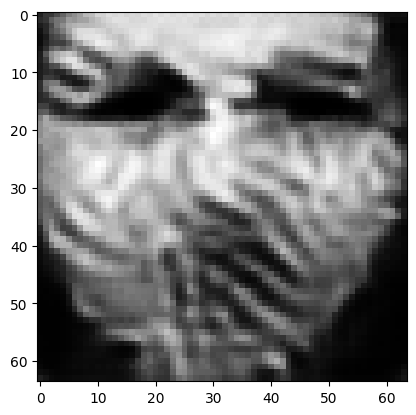

tensor([[7.6696e-05, 9.8092e-01, 4.3946e-05, 2.8433e-03, 6.2117e-05, 5.4195e-04,
         3.3084e-05, 6.2164e-04, 5.8299e-05, 2.9140e-04, 7.5994e-05, 7.7448e-04,
         1.1764e-03, 2.3280e-05, 8.9555e-05, 1.5171e-04, 1.0702e-04, 6.2553e-04,
         4.8901e-04, 5.1046e-04, 5.0444e-05, 1.8539e-06, 1.4720e-04, 2.5700e-05,
         6.4915e-05, 4.8224e-04, 3.6117e-04, 1.6909e-04, 2.2299e-04, 1.4364e-03,
         1.2310e-03, 3.6682e-04, 1.5302e-03, 1.1891e-05, 1.1097e-03, 2.9687e-03,
         4.2079e-05, 8.7725e-05, 1.0610e-04, 6.9515e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019266022369265556
tensor([[7.6682e-05, 9.8092e-01, 4.3933e-05, 2.8426e-03, 6.2099e-05, 5.4186e-04,
         3.3073e-05, 6.2145e-04, 5.8277e-05, 2.9133e-04, 7.5968e-05, 7.7431e-04,
         1.1761e-03, 2.3273e-05, 8.9529e-05, 1.5168e-04, 1.0700e-04, 6.2534e-04,
         4.8892e-04, 5.1032e-04, 5.0426e-05, 1.8533e-06, 1.4716e-04, 2.5694e-05,
         6.4898e-05, 4.8209e-04, 3.6109e-

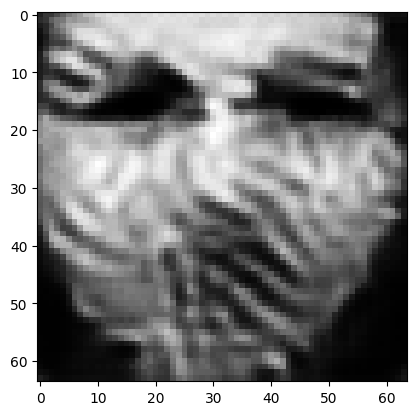

tensor([[7.6640e-05, 9.8094e-01, 4.3886e-05, 2.8397e-03, 6.2033e-05, 5.4157e-04,
         3.3038e-05, 6.2081e-04, 5.8185e-05, 2.9109e-04, 7.5873e-05, 7.7369e-04,
         1.1749e-03, 2.3245e-05, 8.9438e-05, 1.5160e-04, 1.0692e-04, 6.2466e-04,
         4.8866e-04, 5.0989e-04, 5.0361e-05, 1.8512e-06, 1.4697e-04, 2.5672e-05,
         6.4825e-05, 4.8136e-04, 3.6087e-04, 1.6882e-04, 2.2263e-04, 1.4348e-03,
         1.2291e-03, 3.6640e-04, 1.5281e-03, 1.1873e-05, 1.1084e-03, 2.9655e-03,
         4.2022e-05, 8.7600e-05, 1.0592e-04, 6.9421e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019242167472839355
tensor([[7.6628e-05, 9.8095e-01, 4.3874e-05, 2.8390e-03, 6.2016e-05, 5.4149e-04,
         3.3030e-05, 6.2065e-04, 5.8163e-05, 2.9104e-04, 7.5849e-05, 7.7354e-04,
         1.1746e-03, 2.3238e-05, 8.9415e-05, 1.5158e-04, 1.0690e-04, 6.2448e-04,
         4.8859e-04, 5.0978e-04, 5.0346e-05, 1.8507e-06, 1.4693e-04, 2.5666e-05,
         6.4807e-05, 4.8119e-04, 3.6082e-

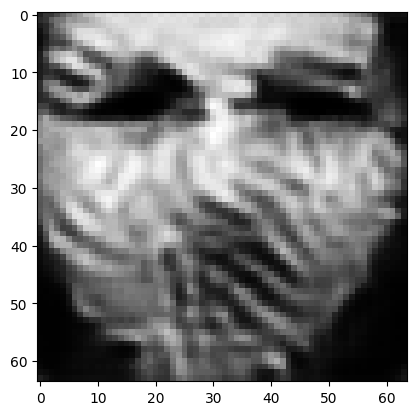

tensor([[7.6578e-05, 9.8096e-01, 4.3825e-05, 2.8363e-03, 6.1947e-05, 5.4114e-04,
         3.2992e-05, 6.1998e-04, 5.8082e-05, 2.9080e-04, 7.5756e-05, 7.7294e-04,
         1.1734e-03, 2.3213e-05, 8.9319e-05, 1.5148e-04, 1.0681e-04, 6.2379e-04,
         4.8830e-04, 5.0929e-04, 5.0283e-05, 1.8486e-06, 1.4676e-04, 2.5641e-05,
         6.4737e-05, 4.8059e-04, 3.6058e-04, 1.6855e-04, 2.2229e-04, 1.4335e-03,
         1.2273e-03, 3.6598e-04, 1.5261e-03, 1.1857e-05, 1.1071e-03, 2.9626e-03,
         4.1968e-05, 8.7487e-05, 1.0574e-04, 6.9333e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019219597801566124
tensor([[7.6569e-05, 9.8097e-01, 4.3814e-05, 2.8357e-03, 6.1930e-05, 5.4106e-04,
         3.2984e-05, 6.1984e-04, 5.8061e-05, 2.9075e-04, 7.5734e-05, 7.7280e-04,
         1.1731e-03, 2.3206e-05, 8.9299e-05, 1.5146e-04, 1.0679e-04, 6.2362e-04,
         4.8825e-04, 5.0920e-04, 5.0268e-05, 1.8481e-06, 1.4671e-04, 2.5636e-05,
         6.4720e-05, 4.8041e-04, 3.6053e-

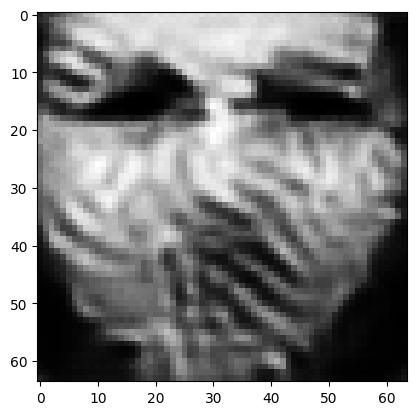

tensor([[7.6530e-05, 9.8098e-01, 4.3772e-05, 2.8331e-03, 6.1869e-05, 5.4079e-04,
         3.2953e-05, 6.1926e-04, 5.7980e-05, 2.9055e-04, 7.5648e-05, 7.7224e-04,
         1.1720e-03, 2.3181e-05, 8.9217e-05, 1.5139e-04, 1.0671e-04, 6.2299e-04,
         4.8802e-04, 5.0882e-04, 5.0210e-05, 1.8463e-06, 1.4655e-04, 2.5615e-05,
         6.4654e-05, 4.7976e-04, 3.6034e-04, 1.6830e-04, 2.2197e-04, 1.4321e-03,
         1.2256e-03, 3.6560e-04, 1.5243e-03, 1.1842e-05, 1.1059e-03, 2.9596e-03,
         4.1914e-05, 8.7375e-05, 1.0558e-04, 6.9250e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01919831521809101
tensor([[7.6520e-05, 9.8099e-01, 4.3761e-05, 2.8324e-03, 6.1854e-05, 5.4072e-04,
         3.2945e-05, 6.1912e-04, 5.7961e-05, 2.9049e-04, 7.5627e-05, 7.7210e-04,
         1.1717e-03, 2.3175e-05, 8.9196e-05, 1.5137e-04, 1.0670e-04, 6.2284e-04,
         4.8796e-04, 5.0872e-04, 5.0195e-05, 1.8458e-06, 1.4650e-04, 2.5610e-05,
         6.4638e-05, 4.7961e-04, 3.6029e-0

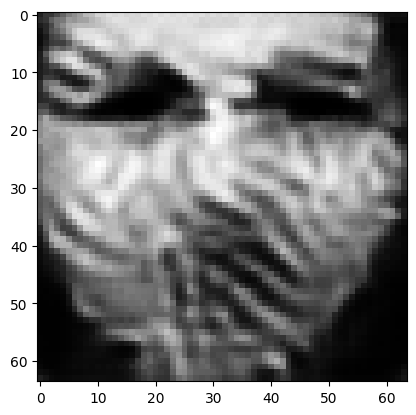

tensor([[7.6483e-05, 9.8100e-01, 4.3720e-05, 2.8299e-03, 6.1794e-05, 5.4044e-04,
         3.2915e-05, 6.1857e-04, 5.7884e-05, 2.9030e-04, 7.5545e-05, 7.7157e-04,
         1.1707e-03, 2.3151e-05, 8.9118e-05, 1.5130e-04, 1.0662e-04, 6.2223e-04,
         4.8774e-04, 5.0837e-04, 5.0140e-05, 1.8441e-06, 1.4634e-04, 2.5590e-05,
         6.4575e-05, 4.7899e-04, 3.6010e-04, 1.6806e-04, 2.2167e-04, 1.4309e-03,
         1.2239e-03, 3.6523e-04, 1.5225e-03, 1.1828e-05, 1.1047e-03, 2.9569e-03,
         4.1862e-05, 8.7269e-05, 1.0543e-04, 6.9172e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019178200513124466
tensor([[7.6473e-05, 9.8101e-01, 4.3710e-05, 2.8293e-03, 6.1780e-05, 5.4038e-04,
         3.2907e-05, 6.1843e-04, 5.7865e-05, 2.9025e-04, 7.5525e-05, 7.7144e-04,
         1.1704e-03, 2.3145e-05, 8.9099e-05, 1.5128e-04, 1.0661e-04, 6.2209e-04,
         4.8769e-04, 5.0827e-04, 5.0126e-05, 1.8436e-06, 1.4631e-04, 2.5585e-05,
         6.4561e-05, 4.7885e-04, 3.6006e-

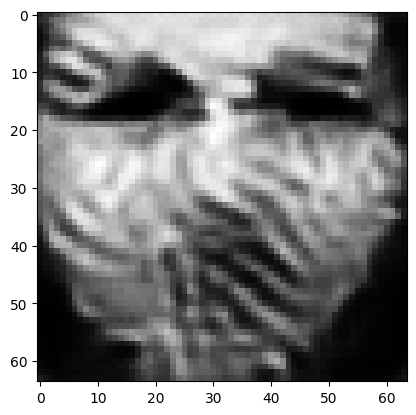

tensor([[7.6440e-05, 9.8102e-01, 4.3672e-05, 2.8270e-03, 6.1725e-05, 5.4013e-04,
         3.2879e-05, 6.1793e-04, 5.7791e-05, 2.9007e-04, 7.5447e-05, 7.7094e-04,
         1.1694e-03, 2.3123e-05, 8.9023e-05, 1.5121e-04, 1.0654e-04, 6.2151e-04,
         4.8748e-04, 5.0793e-04, 5.0072e-05, 1.8420e-06, 1.4615e-04, 2.5567e-05,
         6.4502e-05, 4.7826e-04, 3.5988e-04, 1.6784e-04, 2.2138e-04, 1.4297e-03,
         1.2224e-03, 3.6489e-04, 1.5209e-03, 1.1815e-05, 1.1036e-03, 2.9542e-03,
         4.1814e-05, 8.7168e-05, 1.0528e-04, 6.9098e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019158905372023582
tensor([[7.6431e-05, 9.8103e-01, 4.3662e-05, 2.8264e-03, 6.1711e-05, 5.4007e-04,
         3.2872e-05, 6.1780e-04, 5.7774e-05, 2.9002e-04, 7.5428e-05, 7.7082e-04,
         1.1691e-03, 2.3117e-05, 8.9005e-05, 1.5119e-04, 1.0652e-04, 6.2137e-04,
         4.8743e-04, 5.0784e-04, 5.0059e-05, 1.8416e-06, 1.4611e-04, 2.5563e-05,
         6.4489e-05, 4.7812e-04, 3.5984e-

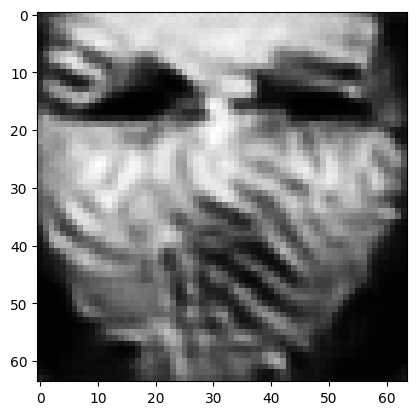

tensor([[7.6397e-05, 9.8104e-01, 4.3625e-05, 2.8242e-03, 6.1658e-05, 5.3982e-04,
         3.2844e-05, 6.1730e-04, 5.7705e-05, 2.8984e-04, 7.5354e-05, 7.7034e-04,
         1.1682e-03, 2.3096e-05, 8.8933e-05, 1.5112e-04, 1.0646e-04, 6.2082e-04,
         4.8722e-04, 5.0750e-04, 5.0008e-05, 1.8400e-06, 1.4597e-04, 2.5545e-05,
         6.4433e-05, 4.7758e-04, 3.5966e-04, 1.6762e-04, 2.2111e-04, 1.4286e-03,
         1.2209e-03, 3.6456e-04, 1.5193e-03, 1.1802e-05, 1.1026e-03, 2.9517e-03,
         4.1768e-05, 8.7072e-05, 1.0515e-04, 6.9026e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019140660762786865
tensor([[7.6390e-05, 9.8104e-01, 4.3617e-05, 2.8237e-03, 6.1645e-05, 5.3977e-04,
         3.2838e-05, 6.1719e-04, 5.7688e-05, 2.8980e-04, 7.5337e-05, 7.7022e-04,
         1.1679e-03, 2.3091e-05, 8.8916e-05, 1.5111e-04, 1.0644e-04, 6.2069e-04,
         4.8718e-04, 5.0743e-04, 4.9996e-05, 1.8396e-06, 1.4593e-04, 2.5541e-05,
         6.4419e-05, 4.7744e-04, 3.5962e-

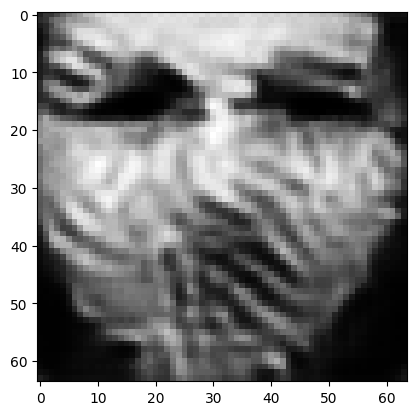

tensor([[7.6353e-05, 9.8106e-01, 4.3580e-05, 2.8216e-03, 6.1591e-05, 5.3950e-04,
         3.2809e-05, 6.1669e-04, 5.7624e-05, 2.8962e-04, 7.5266e-05, 7.6976e-04,
         1.1670e-03, 2.3071e-05, 8.8841e-05, 1.5104e-04, 1.0637e-04, 6.2015e-04,
         4.8696e-04, 5.0705e-04, 4.9946e-05, 1.8380e-06, 1.4580e-04, 2.5522e-05,
         6.4364e-05, 4.7697e-04, 3.5944e-04, 1.6742e-04, 2.2085e-04, 1.4275e-03,
         1.2195e-03, 3.6424e-04, 1.5177e-03, 1.1790e-05, 1.1016e-03, 2.9494e-03,
         4.1726e-05, 8.6987e-05, 1.0501e-04, 6.8958e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01912335306406021
tensor([[7.6345e-05, 9.8106e-01, 4.3571e-05, 2.8211e-03, 6.1579e-05, 5.3944e-04,
         3.2803e-05, 6.1658e-04, 5.7608e-05, 2.8958e-04, 7.5249e-05, 7.6964e-04,
         1.1668e-03, 2.3066e-05, 8.8824e-05, 1.5102e-04, 1.0636e-04, 6.2002e-04,
         4.8692e-04, 5.0697e-04, 4.9935e-05, 1.8376e-06, 1.4577e-04, 2.5518e-05,
         6.4352e-05, 4.7685e-04, 3.5940e-0

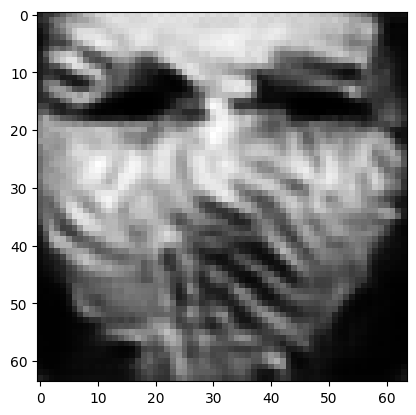

tensor([[7.6314e-05, 9.8107e-01, 4.3538e-05, 2.8192e-03, 6.1531e-05, 5.3922e-04,
         3.2778e-05, 6.1614e-04, 5.7546e-05, 2.8942e-04, 7.5183e-05, 7.6921e-04,
         1.1659e-03, 2.3047e-05, 8.8758e-05, 1.5096e-04, 1.0630e-04, 6.1952e-04,
         4.8674e-04, 5.0666e-04, 4.9888e-05, 1.8362e-06, 1.4563e-04, 2.5502e-05,
         6.4301e-05, 4.7636e-04, 3.5924e-04, 1.6722e-04, 2.2061e-04, 1.4265e-03,
         1.2182e-03, 3.6394e-04, 1.5162e-03, 1.1778e-05, 1.1006e-03, 2.9472e-03,
         4.1685e-05, 8.6902e-05, 1.0489e-04, 6.8892e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019106745719909668
tensor([[7.6307e-05, 9.8108e-01, 4.3530e-05, 2.8187e-03, 6.1519e-05, 5.3916e-04,
         3.2772e-05, 6.1603e-04, 5.7530e-05, 2.8938e-04, 7.5167e-05, 7.6910e-04,
         1.1657e-03, 2.3042e-05, 8.8743e-05, 1.5094e-04, 1.0628e-04, 6.1940e-04,
         4.8669e-04, 5.0658e-04, 4.9877e-05, 1.8358e-06, 1.4560e-04, 2.5498e-05,
         6.4289e-05, 4.7624e-04, 3.5920e-

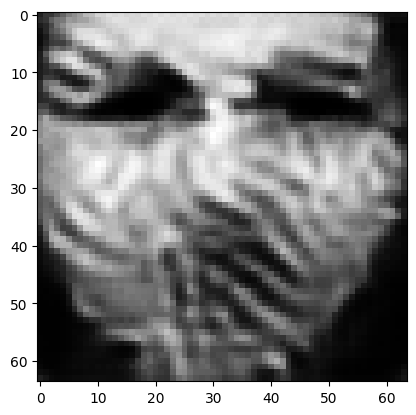

tensor([[7.6278e-05, 9.8109e-01, 4.3499e-05, 2.8168e-03, 6.1474e-05, 5.3896e-04,
         3.2748e-05, 6.1562e-04, 5.7471e-05, 2.8923e-04, 7.5105e-05, 7.6869e-04,
         1.1649e-03, 2.3024e-05, 8.8681e-05, 1.5089e-04, 1.0623e-04, 6.1893e-04,
         4.8653e-04, 5.0629e-04, 4.9833e-05, 1.8345e-06, 1.4548e-04, 2.5483e-05,
         6.4242e-05, 4.7578e-04, 3.5905e-04, 1.6704e-04, 2.2038e-04, 1.4255e-03,
         1.2169e-03, 3.6366e-04, 1.5148e-03, 1.1768e-05, 1.0997e-03, 2.9451e-03,
         4.1647e-05, 8.6822e-05, 1.0477e-04, 6.8831e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01909119077026844
tensor([[7.6271e-05, 9.8109e-01, 4.3491e-05, 2.8163e-03, 6.1462e-05, 5.3890e-04,
         3.2742e-05, 6.1551e-04, 5.7456e-05, 2.8919e-04, 7.5089e-05, 7.6859e-04,
         1.1647e-03, 2.3019e-05, 8.8665e-05, 1.5087e-04, 1.0621e-04, 6.1882e-04,
         4.8648e-04, 5.0622e-04, 4.9822e-05, 1.8341e-06, 1.4545e-04, 2.5480e-05,
         6.4230e-05, 4.7566e-04, 3.5902e-0

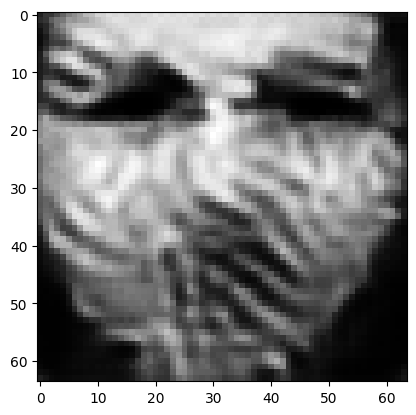

tensor([[7.6243e-05, 9.8110e-01, 4.3461e-05, 2.8146e-03, 6.1419e-05, 5.3869e-04,
         3.2719e-05, 6.1512e-04, 5.7401e-05, 2.8904e-04, 7.5030e-05, 7.6820e-04,
         1.1639e-03, 2.3002e-05, 8.8607e-05, 1.5082e-04, 1.0616e-04, 6.1837e-04,
         4.8632e-04, 5.0593e-04, 4.9781e-05, 1.8328e-06, 1.4533e-04, 2.5465e-05,
         6.4186e-05, 4.7524e-04, 3.5887e-04, 1.6687e-04, 2.2016e-04, 1.4246e-03,
         1.2157e-03, 3.6340e-04, 1.5135e-03, 1.1757e-05, 1.0989e-03, 2.9431e-03,
         4.1610e-05, 8.6746e-05, 1.0465e-04, 6.8771e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01907622069120407
tensor([[7.6236e-05, 9.8111e-01, 4.3453e-05, 2.8141e-03, 6.1408e-05, 5.3864e-04,
         3.2714e-05, 6.1502e-04, 5.7386e-05, 2.8900e-04, 7.5015e-05, 7.6810e-04,
         1.1637e-03, 2.2998e-05, 8.8592e-05, 1.5080e-04, 1.0615e-04, 6.1826e-04,
         4.8628e-04, 5.0586e-04, 4.9770e-05, 1.8325e-06, 1.4530e-04, 2.5462e-05,
         6.4174e-05, 4.7513e-04, 3.5883e-0

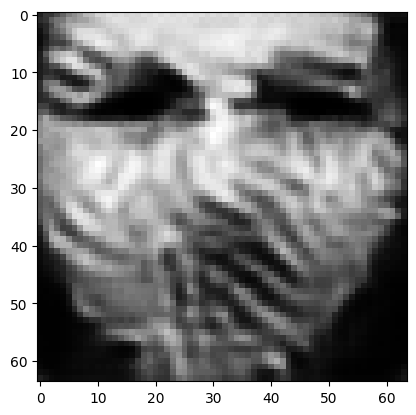

tensor([[7.6208e-05, 9.8112e-01, 4.3424e-05, 2.8125e-03, 6.1367e-05, 5.3844e-04,
         3.2692e-05, 6.1464e-04, 5.7333e-05, 2.8886e-04, 7.4958e-05, 7.6772e-04,
         1.1630e-03, 2.2982e-05, 8.8535e-05, 1.5075e-04, 1.0610e-04, 6.1783e-04,
         4.8612e-04, 5.0558e-04, 4.9730e-05, 1.8312e-06, 1.4519e-04, 2.5448e-05,
         6.4133e-05, 4.7474e-04, 3.5868e-04, 1.6670e-04, 2.1995e-04, 1.4236e-03,
         1.2146e-03, 3.6315e-04, 1.5122e-03, 1.1747e-05, 1.0980e-03, 2.9412e-03,
         4.1576e-05, 8.6674e-05, 1.0454e-04, 6.8713e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01906183362007141
tensor([[7.6201e-05, 9.8112e-01, 4.3417e-05, 2.8121e-03, 6.1357e-05, 5.3839e-04,
         3.2686e-05, 6.1454e-04, 5.7321e-05, 2.8883e-04, 7.4945e-05, 7.6763e-04,
         1.1628e-03, 2.2978e-05, 8.8521e-05, 1.5073e-04, 1.0608e-04, 6.1773e-04,
         4.8608e-04, 5.0551e-04, 4.9721e-05, 1.8309e-06, 1.4517e-04, 2.5445e-05,
         6.4122e-05, 4.7464e-04, 3.5865e-0

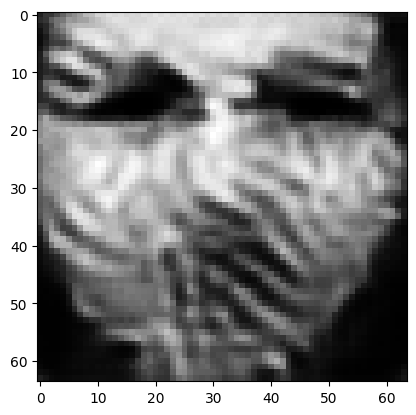

tensor([[7.6175e-05, 9.8113e-01, 4.3390e-05, 2.8105e-03, 6.1318e-05, 5.3820e-04,
         3.2666e-05, 6.1418e-04, 5.7270e-05, 2.8869e-04, 7.4890e-05, 7.6728e-04,
         1.1621e-03, 2.2962e-05, 8.8467e-05, 1.5068e-04, 1.0603e-04, 6.1732e-04,
         4.8593e-04, 5.0524e-04, 4.9683e-05, 1.8297e-06, 1.4506e-04, 2.5432e-05,
         6.4082e-05, 4.7425e-04, 3.5851e-04, 1.6654e-04, 2.1975e-04, 1.4228e-03,
         1.2135e-03, 3.6291e-04, 1.5110e-03, 1.1738e-05, 1.0973e-03, 2.9394e-03,
         4.1543e-05, 8.6605e-05, 1.0444e-04, 6.8660e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019048500806093216
tensor([[7.6169e-05, 9.8113e-01, 4.3383e-05, 2.8101e-03, 6.1309e-05, 5.3816e-04,
         3.2661e-05, 6.1409e-04, 5.7258e-05, 2.8866e-04, 7.4878e-05, 7.6720e-04,
         1.1619e-03, 2.2958e-05, 8.8454e-05, 1.5067e-04, 1.0602e-04, 6.1722e-04,
         4.8589e-04, 5.0518e-04, 4.9674e-05, 1.8295e-06, 1.4504e-04, 2.5429e-05,
         6.4072e-05, 4.7416e-04, 3.5848e-

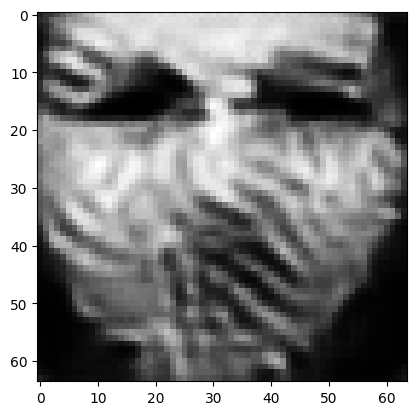

tensor([[7.6145e-05, 9.8114e-01, 4.3357e-05, 2.8086e-03, 6.1271e-05, 5.3797e-04,
         3.2641e-05, 6.1375e-04, 5.7210e-05, 2.8853e-04, 7.4827e-05, 7.6686e-04,
         1.1612e-03, 2.2944e-05, 8.8403e-05, 1.5062e-04, 1.0598e-04, 6.1684e-04,
         4.8575e-04, 5.0493e-04, 4.9638e-05, 1.8283e-06, 1.4494e-04, 2.5417e-05,
         6.4034e-05, 4.7379e-04, 3.5835e-04, 1.6640e-04, 2.1956e-04, 1.4220e-03,
         1.2125e-03, 3.6268e-04, 1.5099e-03, 1.1729e-05, 1.0965e-03, 2.9377e-03,
         4.1512e-05, 8.6541e-05, 1.0434e-04, 6.8608e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01903586834669113
tensor([[7.6139e-05, 9.8115e-01, 4.3351e-05, 2.8082e-03, 6.1262e-05, 5.3793e-04,
         3.2637e-05, 6.1367e-04, 5.7198e-05, 2.8850e-04, 7.4814e-05, 7.6678e-04,
         1.1611e-03, 2.2940e-05, 8.8391e-05, 1.5061e-04, 1.0596e-04, 6.1675e-04,
         4.8572e-04, 5.0487e-04, 4.9630e-05, 1.8281e-06, 1.4491e-04, 2.5414e-05,
         6.4024e-05, 4.7370e-04, 3.5832e-0

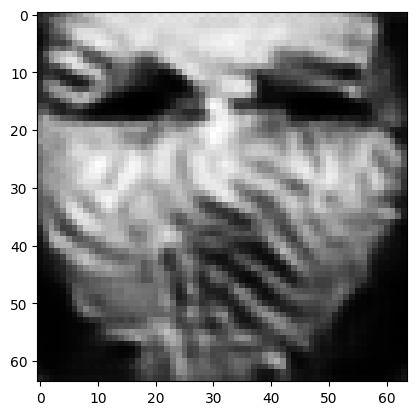

tensor([[7.6120e-05, 9.8116e-01, 4.3328e-05, 2.8067e-03, 6.1228e-05, 5.3778e-04,
         3.2620e-05, 6.1337e-04, 5.7151e-05, 2.8839e-04, 7.4766e-05, 7.6647e-04,
         1.1604e-03, 2.2926e-05, 8.8348e-05, 1.5057e-04, 1.0592e-04, 6.1640e-04,
         4.8561e-04, 5.0468e-04, 4.9597e-05, 1.8271e-06, 1.4481e-04, 2.5404e-05,
         6.3988e-05, 4.7331e-04, 3.5822e-04, 1.6626e-04, 2.1939e-04, 1.4212e-03,
         1.2115e-03, 3.6247e-04, 1.5089e-03, 1.1721e-05, 1.0958e-03, 2.9360e-03,
         4.1481e-05, 8.6476e-05, 1.0425e-04, 6.8561e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019023822620511055
tensor([[7.6112e-05, 9.8116e-01, 4.3321e-05, 2.8064e-03, 6.1218e-05, 5.3772e-04,
         3.2614e-05, 6.1328e-04, 5.7141e-05, 2.8836e-04, 7.4754e-05, 7.6639e-04,
         1.1603e-03, 2.2922e-05, 8.8333e-05, 1.5055e-04, 1.0591e-04, 6.1630e-04,
         4.8556e-04, 5.0460e-04, 4.9589e-05, 1.8268e-06, 1.4479e-04, 2.5400e-05,
         6.3978e-05, 4.7325e-04, 3.5818e-

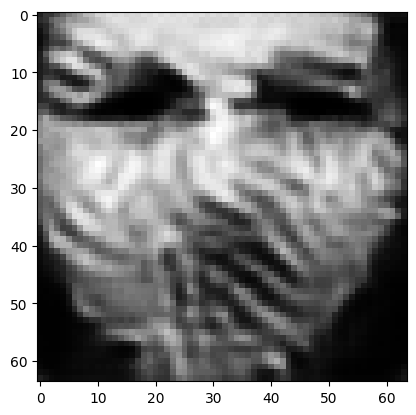

tensor([[7.6096e-05, 9.8117e-01, 4.3300e-05, 2.8050e-03, 6.1186e-05, 5.3760e-04,
         3.2599e-05, 6.1301e-04, 5.7096e-05, 2.8825e-04, 7.4709e-05, 7.6610e-04,
         1.1597e-03, 2.2909e-05, 8.8292e-05, 1.5052e-04, 1.0587e-04, 6.1597e-04,
         4.8546e-04, 5.0443e-04, 4.9558e-05, 1.8259e-06, 1.4470e-04, 2.5390e-05,
         6.3943e-05, 4.7287e-04, 3.5809e-04, 1.6612e-04, 2.1922e-04, 1.4205e-03,
         1.2106e-03, 3.6227e-04, 1.5079e-03, 1.1713e-05, 1.0952e-03, 2.9344e-03,
         4.1452e-05, 8.6417e-05, 1.0417e-04, 6.8517e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019012242555618286
tensor([[7.6091e-05, 9.8117e-01, 4.3295e-05, 2.8046e-03, 6.1179e-05, 5.3756e-04,
         3.2595e-05, 6.1294e-04, 5.7086e-05, 2.8823e-04, 7.4698e-05, 7.6602e-04,
         1.1595e-03, 2.2905e-05, 8.8282e-05, 1.5051e-04, 1.0586e-04, 6.1589e-04,
         4.8544e-04, 5.0438e-04, 4.9550e-05, 1.8257e-06, 1.4468e-04, 2.5388e-05,
         6.3935e-05, 4.7278e-04, 3.5807e-

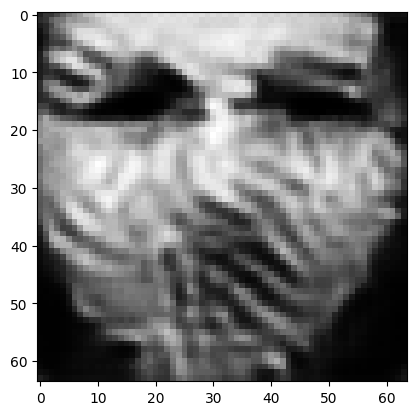

tensor([[7.6072e-05, 9.8118e-01, 4.3273e-05, 2.8033e-03, 6.1146e-05, 5.3741e-04,
         3.2579e-05, 6.1265e-04, 5.7045e-05, 2.8812e-04, 7.4654e-05, 7.6574e-04,
         1.1589e-03, 2.2892e-05, 8.8238e-05, 1.5047e-04, 1.0582e-04, 6.1556e-04,
         4.8532e-04, 5.0418e-04, 4.9520e-05, 1.8247e-06, 1.4459e-04, 2.5377e-05,
         6.3901e-05, 4.7245e-04, 3.5796e-04, 1.6600e-04, 2.1906e-04, 1.4198e-03,
         1.2097e-03, 3.6208e-04, 1.5069e-03, 1.1706e-05, 1.0945e-03, 2.9329e-03,
         4.1424e-05, 8.6361e-05, 1.0409e-04, 6.8475e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01900159940123558
tensor([[7.6068e-05, 9.8118e-01, 4.3268e-05, 2.8030e-03, 6.1139e-05, 5.3738e-04,
         3.2576e-05, 6.1259e-04, 5.7034e-05, 2.8810e-04, 7.4643e-05, 7.6567e-04,
         1.1588e-03, 2.2889e-05, 8.8229e-05, 1.5046e-04, 1.0582e-04, 6.1548e-04,
         4.8530e-04, 5.0414e-04, 4.9513e-05, 1.8245e-06, 1.4457e-04, 2.5375e-05,
         6.3893e-05, 4.7236e-04, 3.5794e-0

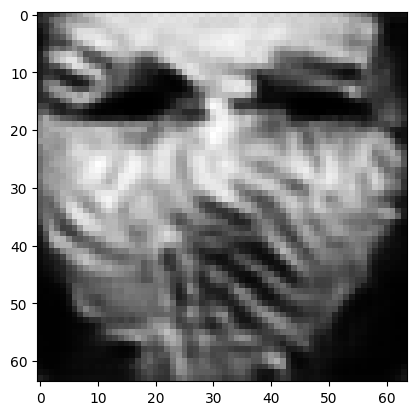

tensor([[7.6049e-05, 9.8119e-01, 4.3248e-05, 2.8018e-03, 6.1108e-05, 5.3724e-04,
         3.2560e-05, 6.1232e-04, 5.6996e-05, 2.8800e-04, 7.4602e-05, 7.6540e-04,
         1.1583e-03, 2.2877e-05, 8.8187e-05, 1.5042e-04, 1.0578e-04, 6.1517e-04,
         4.8519e-04, 5.0394e-04, 4.9484e-05, 1.8236e-06, 1.4448e-04, 2.5365e-05,
         6.3861e-05, 4.7206e-04, 3.5784e-04, 1.6588e-04, 2.1891e-04, 1.4192e-03,
         1.2089e-03, 3.6189e-04, 1.5060e-03, 1.1699e-05, 1.0940e-03, 2.9314e-03,
         4.1398e-05, 8.6308e-05, 1.0401e-04, 6.8435e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018991071730852127
tensor([[7.6045e-05, 9.8119e-01, 4.3243e-05, 2.8014e-03, 6.1101e-05, 5.3721e-04,
         3.2556e-05, 6.1225e-04, 5.6986e-05, 2.8798e-04, 7.4591e-05, 7.6534e-04,
         1.1581e-03, 2.2874e-05, 8.8177e-05, 1.5042e-04, 1.0577e-04, 6.1510e-04,
         4.8517e-04, 5.0390e-04, 4.9477e-05, 1.8234e-06, 1.4446e-04, 2.5363e-05,
         6.3853e-05, 4.7197e-04, 3.5782e-

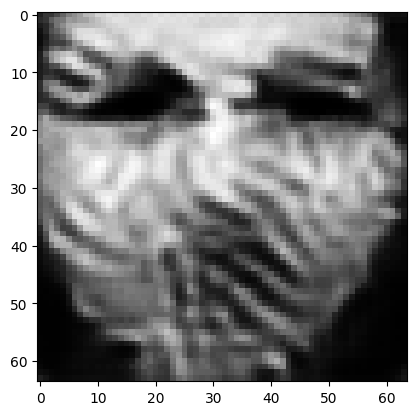

tensor([[7.6026e-05, 9.8120e-01, 4.3223e-05, 2.8003e-03, 6.1072e-05, 5.3708e-04,
         3.2541e-05, 6.1199e-04, 5.6950e-05, 2.8788e-04, 7.4552e-05, 7.6509e-04,
         1.1576e-03, 2.2863e-05, 8.8137e-05, 1.5038e-04, 1.0573e-04, 6.1480e-04,
         4.8506e-04, 5.0371e-04, 4.9450e-05, 1.8225e-06, 1.4438e-04, 2.5353e-05,
         6.3822e-05, 4.7169e-04, 3.5773e-04, 1.6576e-04, 2.1877e-04, 1.4186e-03,
         1.2081e-03, 3.6172e-04, 1.5052e-03, 1.1692e-05, 1.0934e-03, 2.9300e-03,
         4.1373e-05, 8.6258e-05, 1.0393e-04, 6.8398e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018981363624334335
tensor([[7.6022e-05, 9.8120e-01, 4.3219e-05, 2.8000e-03, 6.1065e-05, 5.3705e-04,
         3.2538e-05, 6.1193e-04, 5.6940e-05, 2.8786e-04, 7.4542e-05, 7.6502e-04,
         1.1575e-03, 2.2860e-05, 8.8128e-05, 1.5037e-04, 1.0572e-04, 6.1473e-04,
         4.8504e-04, 5.0368e-04, 4.9443e-05, 1.8223e-06, 1.4436e-04, 2.5350e-05,
         6.3815e-05, 4.7160e-04, 3.5771e-

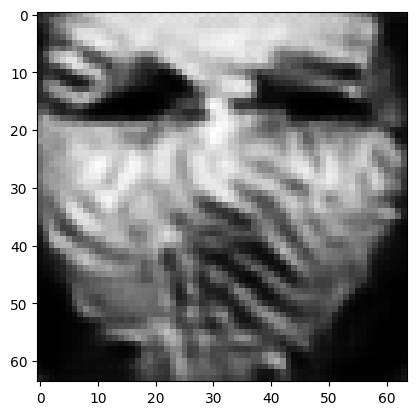

tensor([[7.6007e-05, 9.8121e-01, 4.3201e-05, 2.7988e-03, 6.1039e-05, 5.3694e-04,
         3.2526e-05, 6.1170e-04, 5.6904e-05, 2.8778e-04, 7.4505e-05, 7.6478e-04,
         1.1570e-03, 2.2849e-05, 8.8094e-05, 1.5034e-04, 1.0569e-04, 6.1447e-04,
         4.8495e-04, 5.0353e-04, 4.9418e-05, 1.8216e-06, 1.4429e-04, 2.5342e-05,
         6.3787e-05, 4.7130e-04, 3.5763e-04, 1.6565e-04, 2.1863e-04, 1.4180e-03,
         1.2073e-03, 3.6156e-04, 1.5044e-03, 1.1686e-05, 1.0929e-03, 2.9287e-03,
         4.1349e-05, 8.6207e-05, 1.0386e-04, 6.8362e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018972123041749
tensor([[7.6001e-05, 9.8121e-01, 4.3196e-05, 2.7986e-03, 6.1031e-05, 5.3689e-04,
         3.2521e-05, 6.1162e-04, 5.6897e-05, 2.8775e-04, 7.4496e-05, 7.6472e-04,
         1.1569e-03, 2.2846e-05, 8.8082e-05, 1.5033e-04, 1.0568e-04, 6.1439e-04,
         4.8491e-04, 5.0346e-04, 4.9411e-05, 1.8213e-06, 1.4427e-04, 2.5339e-05,
         6.3779e-05, 4.7126e-04, 3.5760e-04,

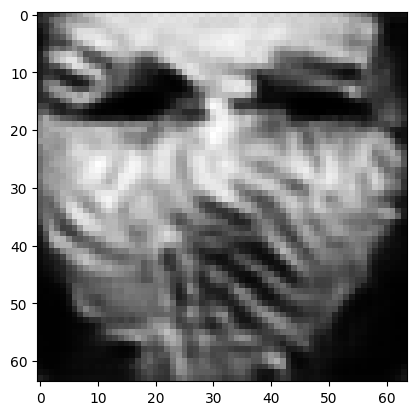

tensor([[7.5987e-05, 9.8122e-01, 4.3179e-05, 2.7975e-03, 6.1007e-05, 5.3678e-04,
         3.2509e-05, 6.1141e-04, 5.6863e-05, 2.8767e-04, 7.4462e-05, 7.6449e-04,
         1.1564e-03, 2.2836e-05, 8.8052e-05, 1.5030e-04, 1.0565e-04, 6.1414e-04,
         4.8484e-04, 5.0332e-04, 4.9387e-05, 1.8206e-06, 1.4419e-04, 2.5331e-05,
         6.3752e-05, 4.7098e-04, 3.5753e-04, 1.6555e-04, 2.1851e-04, 1.4174e-03,
         1.2066e-03, 3.6141e-04, 1.5036e-03, 1.1680e-05, 1.0923e-03, 2.9275e-03,
         4.1327e-05, 8.6163e-05, 1.0380e-04, 6.8327e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01896311715245247
tensor([[7.5983e-05, 9.8122e-01, 4.3174e-05, 2.7972e-03, 6.1001e-05, 5.3675e-04,
         3.2506e-05, 6.1135e-04, 5.6854e-05, 2.8765e-04, 7.4453e-05, 7.6444e-04,
         1.1563e-03, 2.2833e-05, 8.8044e-05, 1.5029e-04, 1.0564e-04, 6.1407e-04,
         4.8482e-04, 5.0328e-04, 4.9382e-05, 1.8204e-06, 1.4418e-04, 2.5329e-05,
         6.3745e-05, 4.7091e-04, 3.5751e-0

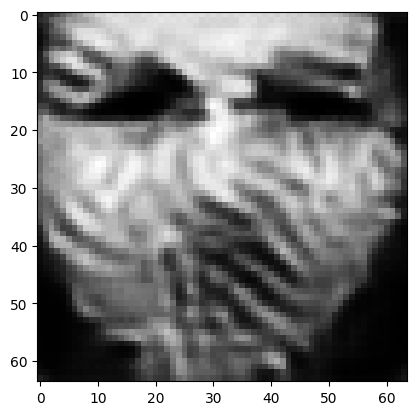

tensor([[7.5968e-05, 9.8122e-01, 4.3157e-05, 2.7962e-03, 6.0976e-05, 5.3662e-04,
         3.2494e-05, 6.1114e-04, 5.6824e-05, 2.8756e-04, 7.4421e-05, 7.6422e-04,
         1.1558e-03, 2.2824e-05, 8.8013e-05, 1.5026e-04, 1.0561e-04, 6.1383e-04,
         4.8474e-04, 5.0312e-04, 4.9359e-05, 1.8197e-06, 1.4411e-04, 2.5321e-05,
         6.3718e-05, 4.7067e-04, 3.5743e-04, 1.6546e-04, 2.1839e-04, 1.4169e-03,
         1.2059e-03, 3.6126e-04, 1.5028e-03, 1.1674e-05, 1.0919e-03, 2.9264e-03,
         4.1306e-05, 8.6122e-05, 1.0373e-04, 6.8293e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01895492896437645
tensor([[7.5965e-05, 9.8123e-01, 4.3154e-05, 2.7960e-03, 6.0971e-05, 5.3660e-04,
         3.2491e-05, 6.1108e-04, 5.6816e-05, 2.8754e-04, 7.4414e-05, 7.6417e-04,
         1.1557e-03, 2.2822e-05, 8.8006e-05, 1.5026e-04, 1.0560e-04, 6.1378e-04,
         4.8472e-04, 5.0309e-04, 4.9354e-05, 1.8196e-06, 1.4409e-04, 2.5319e-05,
         6.3712e-05, 4.7061e-04, 3.5742e-0

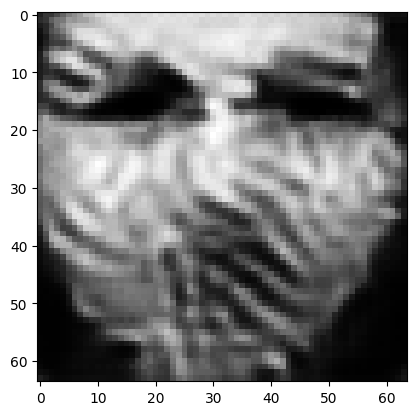

tensor([[7.5954e-05, 9.8123e-01, 4.3138e-05, 2.7950e-03, 6.0949e-05, 5.3651e-04,
         3.2481e-05, 6.1089e-04, 5.6785e-05, 2.8747e-04, 7.4383e-05, 7.6396e-04,
         1.1553e-03, 2.2812e-05, 8.7979e-05, 1.5023e-04, 1.0558e-04, 6.1355e-04,
         4.8466e-04, 5.0297e-04, 4.9332e-05, 1.8189e-06, 1.4403e-04, 2.5312e-05,
         6.3688e-05, 4.7035e-04, 3.5736e-04, 1.6538e-04, 2.1828e-04, 1.4164e-03,
         1.2053e-03, 3.6113e-04, 1.5022e-03, 1.1669e-05, 1.0914e-03, 2.9252e-03,
         4.1285e-05, 8.6081e-05, 1.0367e-04, 6.8262e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018947090953588486
tensor([[7.5947e-05, 9.8123e-01, 4.3133e-05, 2.7948e-03, 6.0942e-05, 5.3645e-04,
         3.2477e-05, 6.1083e-04, 5.6779e-05, 2.8745e-04, 7.4376e-05, 7.6391e-04,
         1.1551e-03, 2.2810e-05, 8.7969e-05, 1.5022e-04, 1.0557e-04, 6.1349e-04,
         4.8462e-04, 5.0291e-04, 4.9327e-05, 1.8187e-06, 1.4401e-04, 2.5309e-05,
         6.3680e-05, 4.7032e-04, 3.5733e-

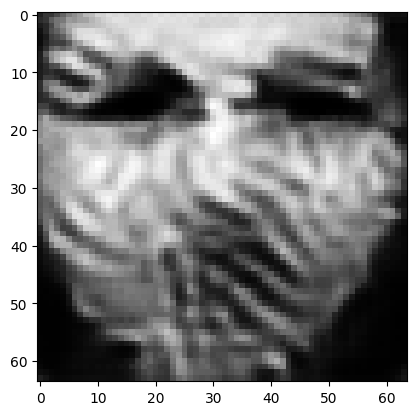

tensor([[7.5936e-05, 9.8124e-01, 4.3119e-05, 2.7938e-03, 6.0921e-05, 5.3636e-04,
         3.2467e-05, 6.1064e-04, 5.6750e-05, 2.8738e-04, 7.4346e-05, 7.6371e-04,
         1.1547e-03, 2.2801e-05, 8.7943e-05, 1.5020e-04, 1.0554e-04, 6.1327e-04,
         4.8456e-04, 5.0279e-04, 4.9307e-05, 1.8181e-06, 1.4395e-04, 2.5303e-05,
         6.3657e-05, 4.7008e-04, 3.5727e-04, 1.6529e-04, 2.1817e-04, 1.4160e-03,
         1.2047e-03, 3.6100e-04, 1.5015e-03, 1.1663e-05, 1.0910e-03, 2.9242e-03,
         4.1266e-05, 8.6044e-05, 1.0361e-04, 6.8231e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018939604982733727
tensor([[7.5933e-05, 9.8124e-01, 4.3115e-05, 2.7936e-03, 6.0915e-05, 5.3634e-04,
         3.2464e-05, 6.1060e-04, 5.6743e-05, 2.8736e-04, 7.4339e-05, 7.6366e-04,
         1.1546e-03, 2.2799e-05, 8.7936e-05, 1.5019e-04, 1.0554e-04, 6.1322e-04,
         4.8455e-04, 5.0276e-04, 4.9301e-05, 1.8180e-06, 1.4394e-04, 2.5301e-05,
         6.3651e-05, 4.7002e-04, 3.5725e-

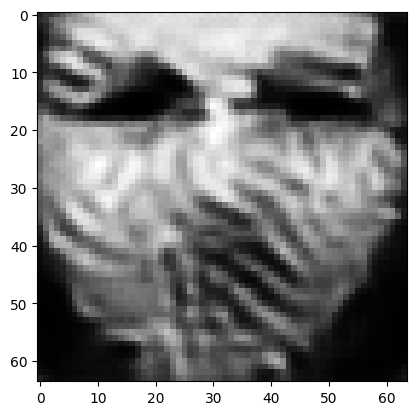

tensor([[7.5920e-05, 9.8125e-01, 4.3101e-05, 2.7927e-03, 6.0894e-05, 5.3623e-04,
         3.2454e-05, 6.1041e-04, 5.6716e-05, 2.8729e-04, 7.4312e-05, 7.6347e-04,
         1.1542e-03, 2.2791e-05, 8.7909e-05, 1.5017e-04, 1.0551e-04, 6.1300e-04,
         4.8448e-04, 5.0262e-04, 4.9282e-05, 1.8174e-06, 1.4388e-04, 2.5294e-05,
         6.3628e-05, 4.6982e-04, 3.5718e-04, 1.6521e-04, 2.1807e-04, 1.4155e-03,
         1.2042e-03, 3.6087e-04, 1.5009e-03, 1.1659e-05, 1.0906e-03, 2.9232e-03,
         4.1248e-05, 8.6009e-05, 1.0355e-04, 6.8202e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018932469189167023
tensor([[7.5917e-05, 9.8125e-01, 4.3097e-05, 2.7925e-03, 6.0890e-05, 5.3621e-04,
         3.2451e-05, 6.1037e-04, 5.6709e-05, 2.8727e-04, 7.4305e-05, 7.6343e-04,
         1.1541e-03, 2.2789e-05, 8.7903e-05, 1.5016e-04, 1.0550e-04, 6.1296e-04,
         4.8446e-04, 5.0259e-04, 4.9277e-05, 1.8172e-06, 1.4386e-04, 2.5292e-05,
         6.3623e-05, 4.6976e-04, 3.5717e-

In [12]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=1)

tensor([[2.5848e-04, 4.0420e-05, 9.8727e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2034e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.920563220977783


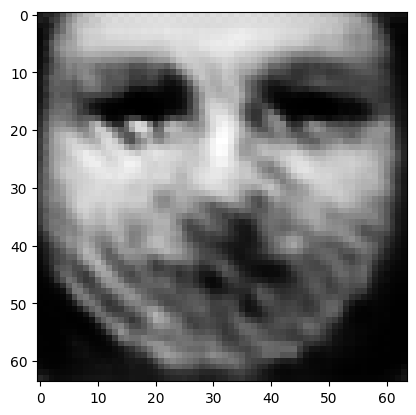

tensor([[7.9333e-05, 1.3177e-04, 5.9446e-03, 2.6828e-03, 6.5353e-02, 8.8539e-05,
         4.9457e-04, 9.8573e-05, 3.7344e-04, 7.9669e-06, 3.2134e-05, 7.5479e-05,
         2.8572e-02, 4.7568e-03, 6.7787e-05, 8.3201e-06, 1.3220e-02, 1.4245e-03,
         3.0605e-04, 7.6971e-05, 1.7414e-02, 8.9550e-05, 2.2080e-01, 6.6943e-05,
         3.4832e-01, 1.0820e-02, 1.1154e-04, 4.8515e-04, 1.6172e-03, 1.0511e-03,
         7.6547e-04, 3.3527e-04, 7.6613e-03, 4.5152e-03, 2.4419e-02, 3.5726e-03,
         1.9912e-01, 3.7025e-03, 2.7576e-02, 3.7580e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  5.125267028808594
tensor([[4.6250e-04, 1.2819e-04, 3.6271e-02, 3.8623e-04, 9.2858e-02, 5.4777e-03,
         1.5886e-02, 1.5144e-03, 9.8902e-04, 2.4082e-04, 2.9449e-04, 2.7232e-04,
         6.5501e-02, 3.7433e-04, 1.0777e-04, 1.2660e-04, 1.3433e-02, 1.4387e-02,
         2.1589e-04, 2.7546e-02, 3.3511e-03, 1.8397e-04, 2.2701e-04, 1.0822e-04,
         3.0244e-02, 9.4215e-05, 4.9358e-03,

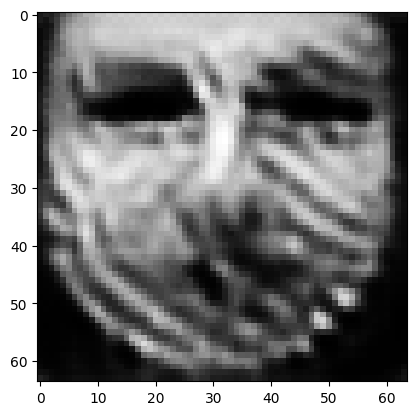

tensor([[1.3707e-04, 4.8905e-06, 8.5096e-01, 2.9480e-04, 2.4945e-03, 3.8001e-02,
         8.0291e-04, 2.8078e-03, 5.3603e-05, 1.2112e-04, 9.6936e-05, 1.9316e-04,
         1.0030e-03, 3.4882e-06, 7.6038e-08, 5.6714e-05, 3.5537e-03, 1.2617e-04,
         2.5002e-05, 2.6647e-03, 1.5456e-04, 2.8479e-05, 7.2843e-07, 1.3878e-05,
         6.7235e-04, 1.2598e-04, 1.5287e-04, 8.4923e-04, 4.3837e-02, 1.3339e-05,
         5.6182e-05, 2.9647e-06, 7.2073e-03, 9.7402e-04, 6.8183e-04, 7.4264e-07,
         5.9907e-04, 4.7944e-04, 2.1347e-02, 1.9403e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.16139157116413116
tensor([[9.5912e-05, 3.5194e-06, 8.8633e-01, 2.7277e-04, 1.7885e-03, 2.9277e-02,
         4.4522e-04, 2.1376e-03, 4.6519e-05, 8.4878e-05, 6.5663e-05, 1.4536e-04,
         8.1969e-04, 2.5960e-06, 4.7270e-08, 3.6474e-05, 2.4723e-03, 7.4853e-05,
         1.7309e-05, 1.8257e-03, 1.1143e-04, 2.1147e-05, 5.2590e-07, 9.3227e-06,
         4.8631e-04, 1.1243e-04, 9.7635e-0

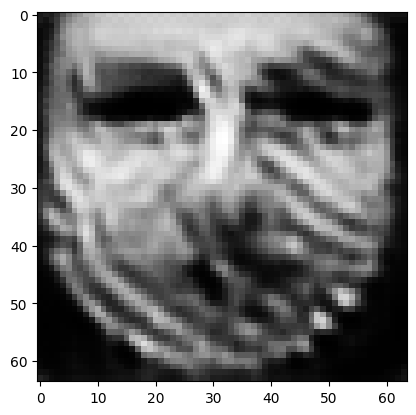

tensor([[4.5807e-05, 1.8892e-06, 9.3437e-01, 2.4281e-04, 9.1475e-04, 1.6816e-02,
         1.2914e-04, 1.1123e-03, 3.5953e-05, 4.0000e-05, 3.0434e-05, 8.5538e-05,
         5.6860e-04, 1.6351e-06, 1.8744e-08, 1.5489e-05, 1.2802e-03, 2.8393e-05,
         8.0713e-06, 8.3021e-04, 6.1969e-05, 1.1124e-05, 2.8822e-07, 4.1057e-06,
         2.5614e-04, 9.3257e-05, 4.0745e-05, 3.6602e-04, 1.8379e-02, 5.2826e-06,
         4.7432e-05, 6.9086e-07, 2.4433e-03, 3.5689e-04, 3.7058e-04, 1.9853e-07,
         2.0424e-04, 2.4801e-04, 1.1191e-02, 9.3588e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0678785964846611
tensor([[4.2021e-05, 1.7085e-06, 9.3984e-01, 2.3860e-04, 8.4119e-04, 1.5433e-02,
         1.0994e-04, 1.0271e-03, 3.4222e-05, 3.5768e-05, 2.7641e-05, 7.8440e-05,
         5.3272e-04, 1.5600e-06, 1.6602e-08, 1.3571e-05, 1.1838e-03, 2.5713e-05,
         7.2490e-06, 7.5168e-04, 5.6398e-05, 1.0088e-05, 2.6411e-07, 3.7402e-06,
         2.3839e-04, 9.0614e-05, 3.5888e-05

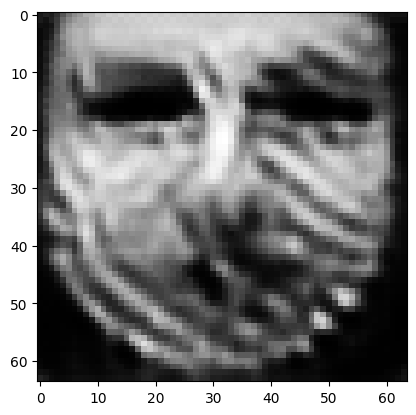

tensor([[3.0773e-05, 1.2634e-06, 9.5394e-01, 2.1910e-04, 6.3889e-04, 1.1534e-02,
         6.4866e-05, 7.6681e-04, 2.9564e-05, 2.4813e-05, 2.0287e-05, 6.0977e-05,
         4.5046e-04, 1.3504e-06, 1.1432e-08, 9.1054e-06, 9.2190e-04, 1.8451e-05,
         5.1806e-06, 5.4947e-04, 4.3533e-05, 7.3432e-06, 2.0951e-07, 2.7131e-06,
         1.8619e-04, 8.2045e-05, 2.3883e-05, 2.6259e-04, 1.2651e-02, 3.6836e-06,
         4.3376e-05, 4.2678e-07, 1.6452e-03, 2.5451e-04, 2.9846e-04, 1.2521e-07,
         1.4777e-04, 2.0023e-04, 8.6090e-03, 6.2533e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.047157321125268936
tensor([[2.8554e-05, 1.1806e-06, 9.5649e-01, 2.1171e-04, 5.9107e-04, 1.0906e-02,
         5.7480e-05, 7.1571e-04, 2.8544e-05, 2.3048e-05, 1.8943e-05, 5.8168e-05,
         4.3044e-04, 1.2872e-06, 1.0454e-08, 8.3787e-06, 8.6309e-04, 1.6931e-05,
         4.7856e-06, 5.1531e-04, 4.1055e-05, 6.8619e-06, 1.9632e-07, 2.5013e-06,
         1.7239e-04, 7.9412e-05, 2.1847e-

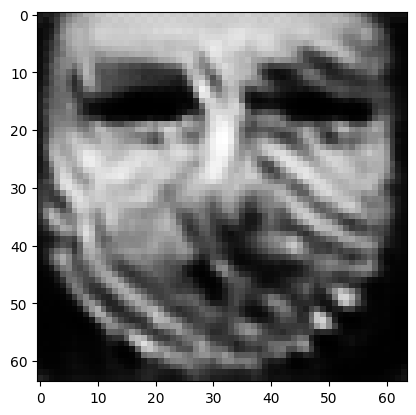

tensor([[2.2331e-05, 9.4580e-07, 9.6471e-01, 1.9392e-04, 4.5844e-04, 8.5205e-03,
         3.7497e-05, 5.6280e-04, 2.5538e-05, 1.7192e-05, 1.4922e-05, 4.8923e-05,
         3.8058e-04, 1.1408e-06, 7.8945e-09, 6.3262e-06, 7.0968e-04, 1.2778e-05,
         3.6758e-06, 4.0803e-04, 3.4463e-05, 5.3983e-06, 1.6485e-07, 1.9361e-06,
         1.3962e-04, 7.3033e-05, 1.5839e-05, 1.9378e-04, 9.7103e-03, 2.9710e-06,
         4.0222e-05, 2.8999e-07, 1.2003e-03, 1.9559e-04, 2.5673e-04, 8.4962e-08,
         1.1214e-04, 1.6523e-04, 6.9628e-03, 4.7534e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035927146673202515
tensor([[2.1298e-05, 9.0007e-07, 9.6624e-01, 1.8915e-04, 4.3270e-04, 8.1388e-03,
         3.4467e-05, 5.3765e-04, 2.4833e-05, 1.6251e-05, 1.4231e-05, 4.7319e-05,
         3.6701e-04, 1.1040e-06, 7.4260e-09, 5.9714e-06, 6.7910e-04, 1.2055e-05,
         3.4720e-06, 3.8979e-04, 3.3072e-05, 5.1533e-06, 1.5714e-07, 1.8368e-06,
         1.3274e-04, 7.1254e-05, 1.4862e-

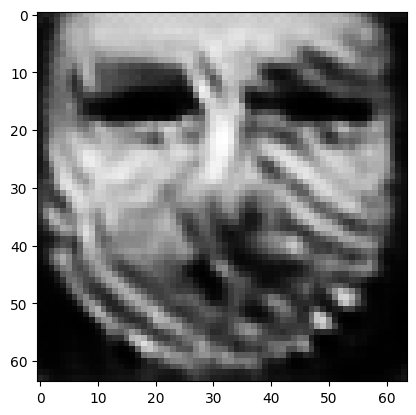

tensor([[1.8474e-05, 7.8698e-07, 9.7081e-01, 1.7930e-04, 3.6644e-04, 6.9184e-03,
         2.6355e-05, 4.6935e-04, 2.2912e-05, 1.3490e-05, 1.2342e-05, 4.2037e-05,
         3.3366e-04, 1.0399e-06, 6.2687e-09, 5.0377e-06, 6.0594e-04, 1.0204e-05,
         2.9303e-06, 3.3711e-04, 2.9232e-05, 4.4237e-06, 1.3917e-07, 1.5943e-06,
         1.1519e-04, 6.7511e-05, 1.2002e-05, 1.6051e-04, 8.0248e-03, 2.5922e-06,
         3.8667e-05, 2.2327e-07, 9.7105e-04, 1.6301e-04, 2.2876e-04, 6.5640e-08,
         9.2950e-05, 1.4814e-04, 5.8838e-03, 3.8783e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029623353853821754
tensor([[1.7966e-05, 7.6662e-07, 9.7171e-01, 1.7749e-04, 3.5528e-04, 6.6854e-03,
         2.4969e-05, 4.5715e-04, 2.2539e-05, 1.2976e-05, 1.1983e-05, 4.0980e-05,
         3.2722e-04, 1.0310e-06, 6.0686e-09, 4.8617e-06, 5.9203e-04, 9.9119e-06,
         2.8278e-06, 3.2705e-04, 2.8485e-05, 4.2812e-06, 1.3585e-07, 1.5508e-06,
         1.1221e-04, 6.6787e-05, 1.1484e-

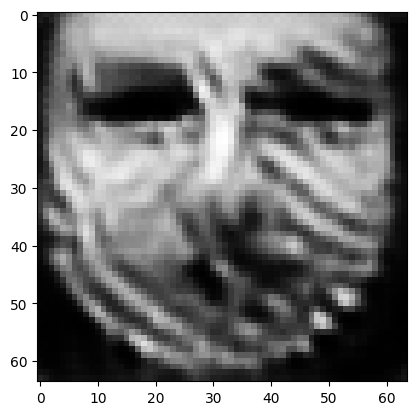

tensor([[1.6282e-05, 6.9537e-07, 9.7472e-01, 1.7029e-04, 3.1953e-04, 5.9211e-03,
         2.0652e-05, 4.1823e-04, 2.1272e-05, 1.1305e-05, 1.0779e-05, 3.7386e-05,
         3.0585e-04, 9.9692e-07, 5.3950e-09, 4.2681e-06, 5.4369e-04, 8.9437e-06,
         2.4796e-06, 2.9419e-04, 2.5859e-05, 3.8128e-06, 1.2438e-07, 1.4036e-06,
         1.0248e-04, 6.4288e-05, 9.8144e-06, 1.4195e-04, 6.8530e-03, 2.3265e-06,
         3.8033e-05, 1.8623e-07, 8.3690e-04, 1.4261e-04, 2.1059e-04, 5.5126e-08,
         8.2329e-05, 1.3886e-04, 5.1967e-03, 3.3214e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02560560591518879
tensor([[1.5923e-05, 6.7809e-07, 9.7535e-01, 1.6819e-04, 3.1098e-04, 5.7770e-03,
         1.9807e-05, 4.0960e-04, 2.0947e-05, 1.0975e-05, 1.0516e-05, 3.6633e-05,
         2.9996e-04, 9.8309e-07, 5.2319e-09, 4.1440e-06, 5.3214e-04, 8.7229e-06,
         2.4030e-06, 2.8744e-04, 2.5229e-05, 3.7123e-06, 1.2126e-07, 1.3684e-06,
         9.9893e-05, 6.3500e-05, 9.4830e-0

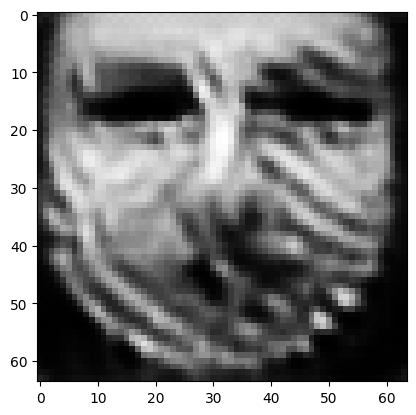

tensor([[1.4548e-05, 6.2922e-07, 9.7750e-01, 1.6452e-04, 2.8508e-04, 5.1684e-03,
         1.6762e-05, 3.7534e-04, 2.0084e-05, 9.6554e-06, 9.5479e-06, 3.3840e-05,
         2.8807e-04, 9.5834e-07, 4.7353e-09, 3.7387e-06, 5.0008e-04, 7.9326e-06,
         2.1661e-06, 2.6121e-04, 2.3600e-05, 3.3696e-06, 1.1554e-07, 1.2562e-06,
         9.3286e-05, 6.2358e-05, 8.2547e-06, 1.2737e-04, 6.0262e-03, 2.1469e-06,
         3.7956e-05, 1.5941e-07, 7.4131e-04, 1.2768e-04, 1.9761e-04, 4.7509e-08,
         7.4906e-05, 1.3034e-04, 4.7375e-03, 2.9446e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02275976538658142
tensor([[1.4229e-05, 6.1885e-07, 9.7796e-01, 1.6375e-04, 2.7948e-04, 5.0294e-03,
         1.6101e-05, 3.6711e-04, 1.9905e-05, 9.3602e-06, 9.3291e-06, 3.3207e-05,
         2.8585e-04, 9.5268e-07, 4.6274e-09, 3.6509e-06, 4.9303e-04, 7.7490e-06,
         2.1140e-06, 2.5521e-04, 2.3269e-05, 3.2939e-06, 1.1439e-07, 1.2300e-06,
         9.1844e-05, 6.2153e-05, 7.9854e-0

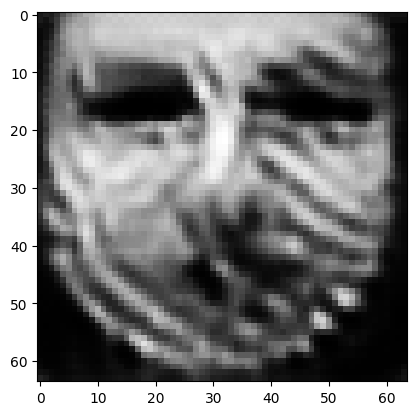

tensor([[1.3197e-05, 5.8344e-07, 9.7958e-01, 1.6160e-04, 2.6065e-04, 4.5516e-03,
         1.3992e-05, 3.3918e-04, 1.9160e-05, 8.3693e-06, 8.6214e-06, 3.1036e-05,
         2.7756e-04, 9.3695e-07, 4.2766e-09, 3.3776e-06, 4.7241e-04, 7.1759e-06,
         1.9474e-06, 2.3475e-04, 2.2197e-05, 3.0406e-06, 1.1082e-07, 1.1513e-06,
         8.6898e-05, 6.1361e-05, 7.0842e-06, 1.1586e-04, 5.4435e-03, 2.0334e-06,
         3.8111e-05, 1.4085e-07, 6.6540e-04, 1.1675e-04, 1.8976e-04, 4.2123e-08,
         7.0249e-05, 1.2311e-04, 4.4076e-03, 2.6588e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020630769431591034
tensor([[1.2976e-05, 5.7524e-07, 9.7994e-01, 1.6117e-04, 2.5641e-04, 4.4523e-03,
         1.3546e-05, 3.3318e-04, 1.8967e-05, 8.1573e-06, 8.4644e-06, 3.0551e-05,
         2.7546e-04, 9.3213e-07, 4.1959e-09, 3.3166e-06, 4.6785e-04, 7.0526e-06,
         1.9108e-06, 2.3016e-04, 2.1925e-05, 2.9841e-06, 1.0990e-07, 1.1342e-06,
         8.5754e-05, 6.1136e-05, 6.8916e-

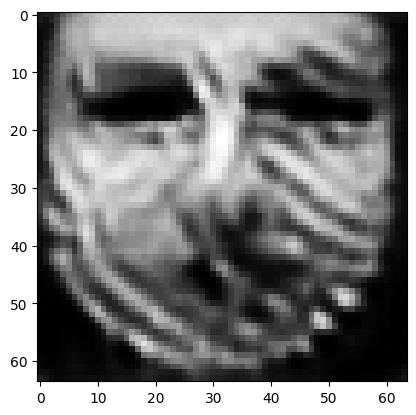

tensor([[1.2243e-05, 5.4329e-07, 9.8119e-01, 1.5856e-04, 2.4157e-04, 4.1223e-03,
         1.2098e-05, 3.1362e-04, 1.8167e-05, 7.4395e-06, 7.9211e-06, 2.8849e-05,
         2.6618e-04, 9.0966e-07, 3.9112e-09, 3.1015e-06, 4.5189e-04, 6.6314e-06,
         1.7804e-06, 2.1482e-04, 2.0889e-05, 2.7898e-06, 1.0594e-07, 1.0780e-06,
         8.1685e-05, 6.0110e-05, 6.2233e-06, 1.0675e-04, 4.9926e-03, 1.9250e-06,
         3.7810e-05, 1.2748e-07, 6.0782e-04, 1.0760e-04, 1.8208e-04, 3.7869e-08,
         6.6547e-05, 1.1780e-04, 4.1194e-03, 2.4265e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018987679854035378
tensor([[1.2097e-05, 5.3646e-07, 9.8147e-01, 1.5828e-04, 2.3832e-04, 4.0481e-03,
         1.1801e-05, 3.0970e-04, 1.8001e-05, 7.2837e-06, 7.8076e-06, 2.8443e-05,
         2.6426e-04, 9.0546e-07, 3.8521e-09, 3.0543e-06, 4.4871e-04, 6.5419e-06,
         1.7536e-06, 2.1139e-04, 2.0652e-05, 2.7464e-06, 1.0516e-07, 1.0665e-06,
         8.0916e-05, 5.9965e-05, 6.0763e-

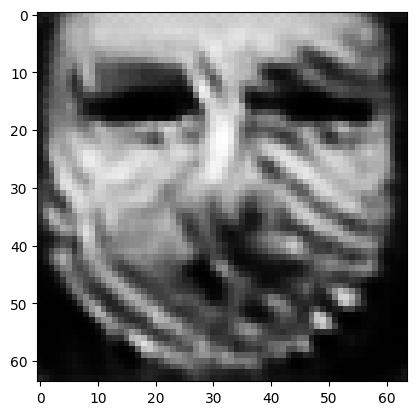

tensor([[1.1579e-05, 5.0662e-07, 9.8248e-01, 1.5490e-04, 2.2561e-04, 3.8157e-03,
         1.0799e-05, 2.9612e-04, 1.7229e-05, 6.7689e-06, 7.4002e-06, 2.7071e-05,
         2.5399e-04, 8.7573e-07, 3.6102e-09, 2.8810e-06, 4.3500e-04, 6.1999e-06,
         1.6471e-06, 2.0006e-04, 1.9653e-05, 2.5958e-06, 1.0048e-07, 1.0196e-06,
         7.7113e-05, 5.8739e-05, 5.5667e-06, 9.9828e-05, 4.6265e-03, 1.8190e-06,
         3.7244e-05, 1.1721e-07, 5.6561e-04, 1.0010e-04, 1.7383e-04, 3.4402e-08,
         6.3216e-05, 1.1407e-04, 3.8629e-03, 2.2397e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01767924800515175
tensor([[1.1470e-05, 4.9950e-07, 9.8270e-01, 1.5386e-04, 2.2264e-04, 3.7694e-03,
         1.0589e-05, 2.9320e-04, 1.7039e-05, 6.6637e-06, 7.3116e-06, 2.6782e-05,
         2.5116e-04, 8.6749e-07, 3.5549e-09, 2.8417e-06, 4.3150e-04, 6.1266e-06,
         1.6226e-06, 1.9775e-04, 1.9409e-05, 2.5627e-06, 9.9175e-08, 1.0088e-06,
         7.6154e-05, 5.8357e-05, 5.4604e-0

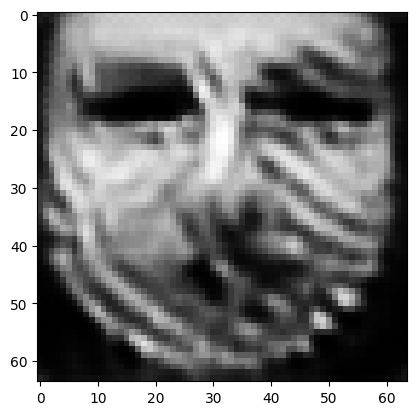

tensor([[1.1067e-05, 4.7239e-07, 9.8351e-01, 1.4967e-04, 2.1122e-04, 3.6086e-03,
         9.8341e-06, 2.8294e-04, 1.6282e-05, 6.2871e-06, 6.9896e-06, 2.5688e-05,
         2.3968e-04, 8.3340e-07, 3.3404e-09, 2.6975e-06, 4.1828e-04, 5.8400e-06,
         1.5321e-06, 1.8905e-04, 1.8425e-05, 2.4410e-06, 9.3884e-08, 9.6929e-07,
         7.2452e-05, 5.6857e-05, 5.0686e-06, 9.4017e-05, 4.3325e-03, 1.7135e-06,
         3.6167e-05, 1.0857e-07, 5.3259e-04, 9.3426e-05, 1.6515e-04, 3.1366e-08,
         5.9779e-05, 1.1079e-04, 3.6271e-03, 2.0920e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016626017168164253
tensor([[1.0972e-05, 4.6614e-07, 9.8370e-01, 1.4866e-04, 2.0861e-04, 3.5702e-03,
         9.6625e-06, 2.8058e-04, 1.6105e-05, 6.2007e-06, 6.9152e-06, 2.5426e-05,
         2.3696e-04, 8.2556e-07, 3.2920e-09, 2.6624e-06, 4.1506e-04, 5.7756e-06,
         1.5115e-06, 1.8696e-04, 1.8189e-05, 2.4126e-06, 9.2612e-08, 9.5987e-07,
         7.1594e-05, 5.6489e-05, 4.9789e-

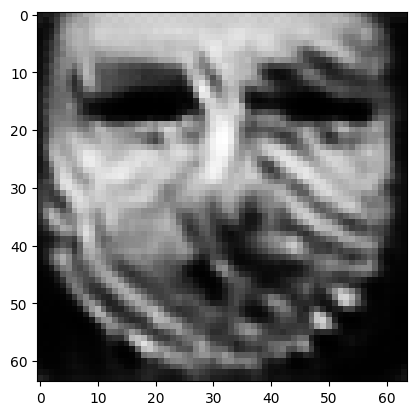

tensor([[1.0627e-05, 4.4246e-07, 9.8441e-01, 1.4460e-04, 1.9879e-04, 3.4242e-03,
         9.0309e-06, 2.7131e-04, 1.5434e-05, 5.8762e-06, 6.6366e-06, 2.4490e-05,
         2.2694e-04, 7.9589e-07, 3.1128e-09, 2.5369e-06, 4.0370e-04, 5.5272e-06,
         1.4350e-06, 1.7949e-04, 1.7362e-05, 2.3088e-06, 8.8047e-08, 9.2633e-07,
         6.8376e-05, 5.5131e-05, 4.6490e-06, 8.8858e-05, 4.0838e-03, 1.6227e-06,
         3.5125e-05, 1.0127e-07, 5.0485e-04, 8.7733e-05, 1.5736e-04, 2.8807e-08,
         5.6802e-05, 1.0770e-04, 3.4286e-03, 1.9613e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015717552974820137
tensor([[1.0545e-05, 4.3725e-07, 9.8457e-01, 1.4370e-04, 1.9653e-04, 3.3904e-03,
         8.8872e-06, 2.6911e-04, 1.5283e-05, 5.8013e-06, 6.5759e-06, 2.4273e-05,
         2.2478e-04, 7.8947e-07, 3.0726e-09, 2.5088e-06, 4.0114e-04, 5.4703e-06,
         1.4175e-06, 1.7776e-04, 1.7175e-05, 2.2856e-06, 8.7060e-08, 9.1872e-07,
         6.7666e-05, 5.4843e-05, 4.5761e-

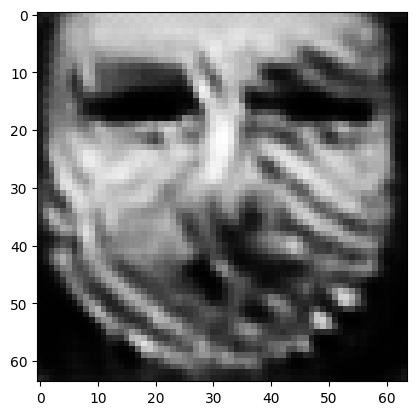

tensor([[1.0218e-05, 4.1709e-07, 9.8519e-01, 1.4020e-04, 1.8765e-04, 3.2554e-03,
         8.3296e-06, 2.6000e-04, 1.4699e-05, 5.5039e-06, 6.3453e-06, 2.3442e-05,
         2.1644e-04, 7.6568e-07, 2.9191e-09, 2.4054e-06, 3.9254e-04, 5.2467e-06,
         1.3517e-06, 1.7096e-04, 1.6507e-05, 2.1960e-06, 8.3468e-08, 8.9063e-07,
         6.5028e-05, 5.3815e-05, 4.2886e-06, 8.4386e-05, 3.8696e-03, 1.5507e-06,
         3.4373e-05, 9.4966e-08, 4.8025e-04, 8.2789e-05, 1.5090e-04, 2.6670e-08,
         5.4421e-05, 1.0489e-04, 3.2575e-03, 1.8422e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014918547123670578
tensor([[1.0137e-05, 4.1249e-07, 9.8534e-01, 1.3942e-04, 1.8560e-04, 3.2224e-03,
         8.2005e-06, 2.5787e-04, 1.4574e-05, 5.4363e-06, 6.2916e-06, 2.3247e-05,
         2.1454e-04, 7.6028e-07, 2.8843e-09, 2.3810e-06, 3.9044e-04, 5.1937e-06,
         1.3368e-06, 1.6934e-04, 1.6354e-05, 2.1753e-06, 8.2665e-08, 8.8397e-07,
         6.4439e-05, 5.3592e-05, 4.2221e-

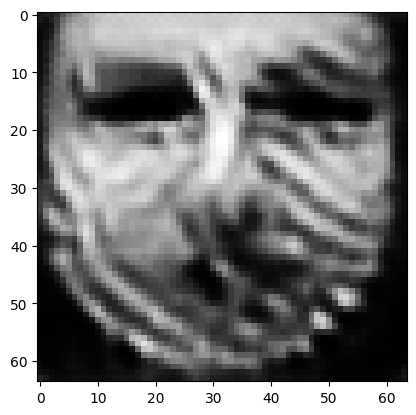

tensor([[9.8505e-06, 3.9570e-07, 9.8587e-01, 1.3644e-04, 1.7829e-04, 3.1010e-03,
         7.7375e-06, 2.5028e-04, 1.4103e-05, 5.1898e-06, 6.0961e-06, 2.2521e-05,
         2.0765e-04, 7.4069e-07, 2.7609e-09, 2.2906e-06, 3.8280e-04, 5.0056e-06,
         1.2812e-06, 1.6349e-04, 1.5783e-05, 2.0997e-06, 7.9666e-08, 8.6001e-07,
         6.2322e-05, 5.2736e-05, 3.9810e-06, 8.0599e-05, 3.6876e-03, 1.4917e-06,
         3.3786e-05, 8.9693e-08, 4.5910e-04, 7.8651e-05, 1.4538e-04, 2.4875e-08,
         5.2412e-05, 1.0241e-04, 3.1159e-03, 1.7397e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014231028035283089
tensor([[9.7854e-06, 3.9192e-07, 9.8599e-01, 1.3577e-04, 1.7671e-04, 3.0718e-03,
         7.6327e-06, 2.4857e-04, 1.3997e-05, 5.1323e-06, 6.0524e-06, 2.2350e-05,
         2.0616e-04, 7.3669e-07, 2.7339e-09, 2.2697e-06, 3.8116e-04, 4.9640e-06,
         1.2686e-06, 1.6214e-04, 1.5656e-05, 2.0826e-06, 7.9023e-08, 8.5482e-07,
         6.1874e-05, 5.2555e-05, 3.9255e-

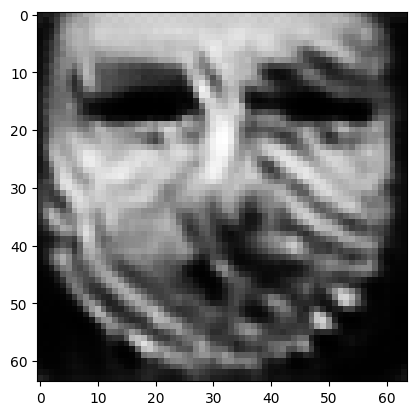

tensor([[9.5621e-06, 3.7662e-07, 9.8645e-01, 1.3244e-04, 1.7040e-04, 2.9825e-03,
         7.2704e-06, 2.4267e-04, 1.3536e-05, 4.9394e-06, 5.8945e-06, 2.1756e-05,
         1.9908e-04, 7.1635e-07, 2.6230e-09, 2.1916e-06, 3.7403e-04, 4.8110e-06,
         1.2189e-06, 1.5747e-04, 1.5119e-05, 2.0189e-06, 7.5929e-08, 8.3412e-07,
         5.9832e-05, 5.1527e-05, 3.7332e-06, 7.7479e-05, 3.5274e-03, 1.4361e-06,
         3.3101e-05, 8.5193e-08, 4.4155e-04, 7.5042e-05, 1.4025e-04, 2.3331e-08,
         5.0535e-05, 1.0025e-04, 2.9878e-03, 1.6528e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013644407503306866
tensor([[9.5086e-06, 3.7289e-07, 9.8655e-01, 1.3150e-04, 1.6885e-04, 2.9645e-03,
         7.1866e-06, 2.4125e-04, 1.3427e-05, 4.8989e-06, 5.8567e-06, 2.1630e-05,
         1.9727e-04, 7.1053e-07, 2.5953e-09, 2.1728e-06, 3.7188e-04, 4.7730e-06,
         1.2066e-06, 1.5643e-04, 1.4984e-05, 2.0046e-06, 7.5095e-08, 8.2844e-07,
         5.9279e-05, 5.1232e-05, 3.6915e-

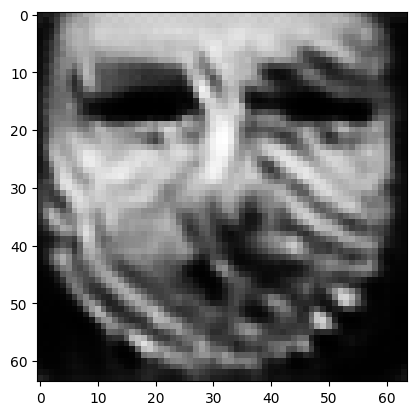

tensor([[9.3108e-06, 3.5841e-07, 9.8693e-01, 1.2768e-04, 1.6320e-04, 2.8995e-03,
         6.8906e-06, 2.3596e-04, 1.2990e-05, 4.7488e-06, 5.7161e-06, 2.1178e-05,
         1.9035e-04, 6.8767e-07, 2.4906e-09, 2.1056e-06, 3.6420e-04, 4.6315e-06,
         1.1606e-06, 1.5271e-04, 1.4492e-05, 1.9527e-06, 7.1961e-08, 8.0796e-07,
         5.7194e-05, 5.0064e-05, 3.5392e-06, 7.4682e-05, 3.3886e-03, 1.3813e-06,
         3.2228e-05, 8.1062e-08, 4.2686e-04, 7.1763e-05, 1.3530e-04, 2.1901e-08,
         4.8529e-05, 9.8045e-05, 2.8709e-03, 1.5861e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013152038678526878
tensor([[9.2706e-06, 3.5523e-07, 9.8702e-01, 1.2683e-04, 1.6196e-04, 2.8845e-03,
         6.8261e-06, 2.3480e-04, 1.2892e-05, 4.7153e-06, 5.6845e-06, 2.1075e-05,
         1.8883e-04, 6.8282e-07, 2.4688e-09, 2.0907e-06, 3.6251e-04, 4.6029e-06,
         1.1506e-06, 1.5193e-04, 1.4382e-05, 1.9408e-06, 7.1272e-08, 8.0359e-07,
         5.6739e-05, 4.9786e-05, 3.5064e-

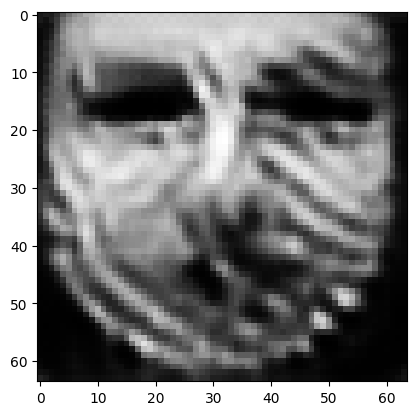

tensor([[9.1016e-06, 3.4304e-07, 9.8736e-01, 1.2351e-04, 1.5714e-04, 2.8260e-03,
         6.5689e-06, 2.3011e-04, 1.2516e-05, 4.5843e-06, 5.5596e-06, 2.0669e-05,
         1.8306e-04, 6.6378e-07, 2.3819e-09, 2.0326e-06, 3.5593e-04, 4.4847e-06,
         1.1114e-06, 1.4879e-04, 1.3960e-05, 1.8948e-06, 6.8605e-08, 7.8577e-07,
         5.4950e-05, 4.8729e-05, 3.3784e-06, 7.2304e-05, 3.2678e-03, 1.3348e-06,
         3.1444e-05, 7.7587e-08, 4.1439e-04, 6.8982e-05, 1.3121e-04, 2.0707e-08,
         4.6842e-05, 9.6115e-05, 2.7706e-03, 1.5276e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012725106440484524
tensor([[9.0605e-06, 3.4020e-07, 9.8743e-01, 1.2273e-04, 1.5604e-04, 2.8114e-03,
         6.5078e-06, 2.2898e-04, 1.2433e-05, 4.5534e-06, 5.5286e-06, 2.0573e-05,
         1.8179e-04, 6.5934e-07, 2.3621e-09, 2.0186e-06, 3.5431e-04, 4.4562e-06,
         1.1021e-06, 1.4806e-04, 1.3863e-05, 1.8841e-06, 6.8003e-08, 7.8146e-07,
         5.4542e-05, 4.8490e-05, 3.3486e-

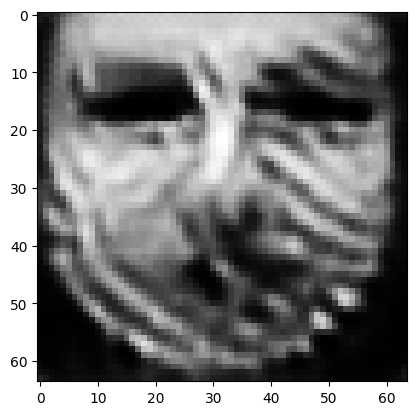

tensor([[8.8958e-06, 3.2974e-07, 9.8772e-01, 1.1974e-04, 1.5173e-04, 2.7585e-03,
         6.2768e-06, 2.2447e-04, 1.2137e-05, 4.4421e-06, 5.4159e-06, 2.0245e-05,
         1.7699e-04, 6.4229e-07, 2.2859e-09, 1.9662e-06, 3.4769e-04, 4.3454e-06,
         1.0671e-06, 1.4531e-04, 1.3504e-05, 1.8440e-06, 6.5687e-08, 7.6390e-07,
         5.2920e-05, 4.7559e-05, 3.2401e-06, 7.0176e-05, 3.1609e-03, 1.2956e-06,
         3.0785e-05, 7.4443e-08, 4.0313e-04, 6.6598e-05, 1.2775e-04, 1.9662e-08,
         4.5266e-05, 9.4269e-05, 2.6863e-03, 1.4800e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012352745980024338
tensor([[8.8572e-06, 3.2721e-07, 9.8779e-01, 1.1902e-04, 1.5065e-04, 2.7467e-03,
         6.2222e-06, 2.2340e-04, 1.2062e-05, 4.4164e-06, 5.3889e-06, 2.0169e-05,
         1.7575e-04, 6.3797e-07, 2.2671e-09, 1.9539e-06, 3.4612e-04, 4.3182e-06,
         1.0588e-06, 1.4466e-04, 1.3415e-05, 1.8344e-06, 6.5108e-08, 7.5971e-07,
         5.2518e-05, 4.7332e-05, 3.2144e-

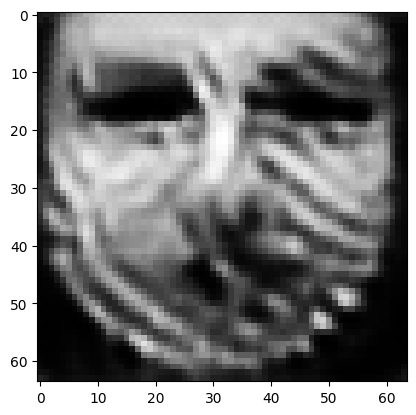

tensor([[8.7093e-06, 3.1748e-07, 9.8806e-01, 1.1620e-04, 1.4675e-04, 2.6986e-03,
         6.0143e-06, 2.1910e-04, 1.1771e-05, 4.3144e-06, 5.2779e-06, 1.9862e-05,
         1.7123e-04, 6.2165e-07, 2.1973e-09, 1.9040e-06, 3.3997e-04, 4.2206e-06,
         1.0262e-06, 1.4215e-04, 1.3070e-05, 1.7975e-06, 6.2948e-08, 7.4307e-07,
         5.1018e-05, 4.6409e-05, 3.1171e-06, 6.8196e-05, 3.0598e-03, 1.2578e-06,
         3.0144e-05, 7.1639e-08, 3.9315e-04, 6.4373e-05, 1.2451e-04, 1.8725e-08,
         4.3794e-05, 9.2579e-05, 2.6092e-03, 1.4360e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01200910471379757
tensor([[8.6676e-06, 3.1496e-07, 9.8813e-01, 1.1542e-04, 1.4570e-04, 2.6875e-03,
         5.9602e-06, 2.1790e-04, 1.1698e-05, 4.2897e-06, 5.2484e-06, 1.9793e-05,
         1.7006e-04, 6.1702e-07, 2.1785e-09, 1.8918e-06, 3.3823e-04, 4.1926e-06,
         1.0177e-06, 1.4151e-04, 1.2983e-05, 1.7884e-06, 6.2373e-08, 7.3829e-07,
         5.0586e-05, 4.6159e-05, 3.0932e-0

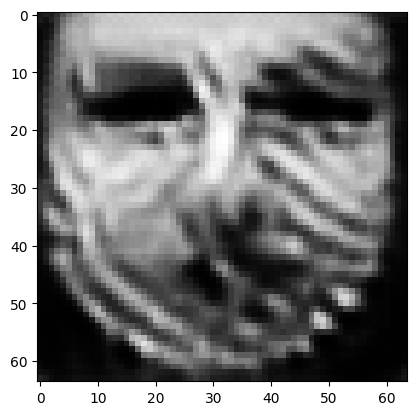

tensor([[8.5137e-06, 3.0553e-07, 9.8838e-01, 1.1258e-04, 1.4190e-04, 2.6427e-03,
         5.7617e-06, 2.1352e-04, 1.1434e-05, 4.1965e-06, 5.1369e-06, 1.9514e-05,
         1.6581e-04, 6.0018e-07, 2.1106e-09, 1.8440e-06, 3.3160e-04, 4.0908e-06,
         9.8628e-07, 1.3908e-04, 1.2654e-05, 1.7540e-06, 6.0273e-08, 7.2061e-07,
         4.9052e-05, 4.5243e-05, 3.0035e-06, 6.6217e-05, 2.9635e-03, 1.2215e-06,
         2.9496e-05, 6.8885e-08, 3.8332e-04, 6.2239e-05, 1.2138e-04, 1.7810e-08,
         4.2289e-05, 9.0700e-05, 2.5384e-03, 1.3982e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011687143705785275
tensor([[8.4759e-06, 3.0330e-07, 9.8844e-01, 1.1189e-04, 1.4099e-04, 2.6321e-03,
         5.7151e-06, 2.1245e-04, 1.1373e-05, 4.1749e-06, 5.1106e-06, 1.9450e-05,
         1.6480e-04, 5.9613e-07, 2.0945e-09, 1.8328e-06, 3.2997e-04, 4.0659e-06,
         9.7887e-07, 1.3851e-04, 1.2577e-05, 1.7461e-06, 5.9778e-08, 7.1632e-07,
         4.8683e-05, 4.5026e-05, 2.9826e-

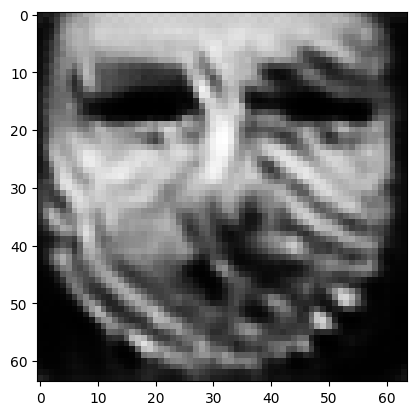

tensor([[8.3331e-06, 2.9464e-07, 9.8866e-01, 1.0918e-04, 1.3739e-04, 2.5940e-03,
         5.5377e-06, 2.0834e-04, 1.1130e-05, 4.0931e-06, 5.0095e-06, 1.9213e-05,
         1.6082e-04, 5.7984e-07, 2.0305e-09, 1.7901e-06, 3.2360e-04, 3.9697e-06,
         9.5038e-07, 1.3638e-04, 1.2272e-05, 1.7153e-06, 5.7828e-08, 6.9943e-07,
         4.7226e-05, 4.4166e-05, 2.9042e-06, 6.4359e-05, 2.8784e-03, 1.1886e-06,
         2.8880e-05, 6.6397e-08, 3.7477e-04, 6.0300e-05, 1.1849e-04, 1.6991e-08,
         4.0890e-05, 8.8926e-05, 2.4744e-03, 1.3653e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0114004360511899
tensor([[8.2985e-06, 2.9270e-07, 9.8872e-01, 1.0858e-04, 1.3657e-04, 2.5846e-03,
         5.4949e-06, 2.0733e-04, 1.1078e-05, 4.0737e-06, 4.9855e-06, 1.9159e-05,
         1.5995e-04, 5.7612e-07, 2.0160e-09, 1.7799e-06, 3.2204e-04, 3.9479e-06,
         9.4385e-07, 1.3589e-04, 1.2201e-05, 1.7081e-06, 5.7390e-08, 6.9531e-07,
         4.6897e-05, 4.3971e-05, 2.8860e-06

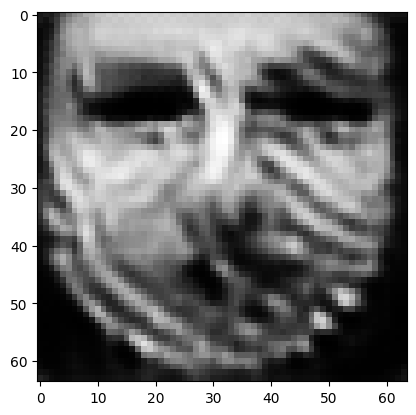

tensor([[8.1776e-06, 2.8605e-07, 9.8891e-01, 1.0661e-04, 1.3361e-04, 2.5483e-03,
         5.3408e-06, 2.0386e-04, 1.0884e-05, 3.9991e-06, 4.9019e-06, 1.8940e-05,
         1.5681e-04, 5.6388e-07, 1.9635e-09, 1.7443e-06, 3.1722e-04, 3.8745e-06,
         9.2121e-07, 1.3395e-04, 1.1951e-05, 1.6803e-06, 5.5887e-08, 6.8130e-07,
         4.5778e-05, 4.3320e-05, 2.8177e-06, 6.2733e-05, 2.8077e-03, 1.1611e-06,
         2.8383e-05, 6.4330e-08, 3.6731e-04, 5.8617e-05, 1.1618e-04, 1.6319e-08,
         3.9813e-05, 8.7576e-05, 2.4176e-03, 1.3353e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011150546371936798
tensor([[8.1492e-06, 2.8452e-07, 9.8896e-01, 1.0615e-04, 1.3295e-04, 2.5395e-03,
         5.3053e-06, 2.0305e-04, 1.0840e-05, 3.9814e-06, 4.8825e-06, 1.8888e-05,
         1.5611e-04, 5.6117e-07, 1.9517e-09, 1.7361e-06, 3.1614e-04, 3.8580e-06,
         9.1602e-07, 1.3349e-04, 1.1894e-05, 1.6739e-06, 5.5556e-08, 6.7811e-07,
         4.5525e-05, 4.3172e-05, 2.8019e-

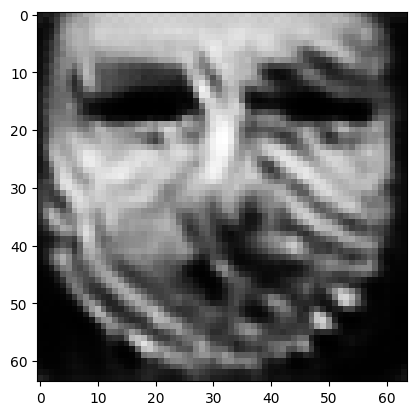

tensor([[8.0395e-06, 2.7863e-07, 9.8913e-01, 1.0442e-04, 1.3034e-04, 2.5062e-03,
         5.1668e-06, 1.9996e-04, 1.0666e-05, 3.9134e-06, 4.8072e-06, 1.8687e-05,
         1.5343e-04, 5.5064e-07, 1.9051e-09, 1.7039e-06, 3.1184e-04, 3.7928e-06,
         8.9600e-07, 1.3171e-04, 1.1667e-05, 1.6485e-06, 5.4259e-08, 6.6547e-07,
         4.4530e-05, 4.2589e-05, 2.7412e-06, 6.1318e-05, 2.7443e-03, 1.1370e-06,
         2.7965e-05, 6.2534e-08, 3.6060e-04, 5.7135e-05, 1.1412e-04, 1.5744e-08,
         3.8907e-05, 8.6435e-05, 2.3662e-03, 1.3077e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010925590991973877
tensor([[8.0137e-06, 2.7742e-07, 9.8918e-01, 1.0411e-04, 1.2970e-04, 2.4979e-03,
         5.1322e-06, 1.9922e-04, 1.0629e-05, 3.8966e-06, 4.7900e-06, 1.8637e-05,
         1.5284e-04, 5.4860e-07, 1.8948e-09, 1.6964e-06, 3.1090e-04, 3.7783e-06,
         8.9164e-07, 1.3125e-04, 1.1614e-05, 1.6420e-06, 5.3987e-08, 6.6259e-07,
         4.4304e-05, 4.2470e-05, 2.7264e-

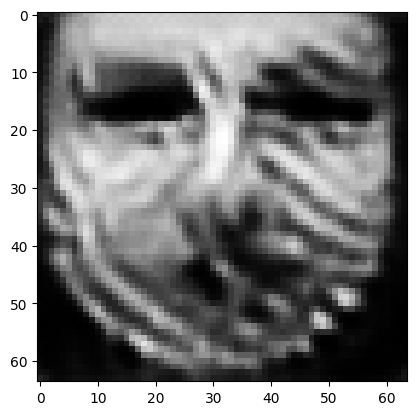

tensor([[7.8990e-06, 2.7221e-07, 9.8934e-01, 1.0262e-04, 1.2712e-04, 2.4661e-03,
         4.9962e-06, 1.9604e-04, 1.0486e-05, 3.8308e-06, 4.7137e-06, 1.8459e-05,
         1.5049e-04, 5.3884e-07, 1.8533e-09, 1.6661e-06, 3.0661e-04, 3.7139e-06,
         8.7329e-07, 1.2951e-04, 1.1414e-05, 1.6174e-06, 5.2857e-08, 6.5035e-07,
         4.3340e-05, 4.1969e-05, 2.6681e-06, 5.9930e-05, 2.6847e-03, 1.1159e-06,
         2.7599e-05, 6.0861e-08, 3.5392e-04, 5.5759e-05, 1.1239e-04, 1.5225e-08,
         3.8057e-05, 8.5367e-05, 2.3173e-03, 1.2827e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010713795199990273
tensor([[7.8739e-06, 2.7117e-07, 9.8938e-01, 1.0236e-04, 1.2656e-04, 2.4577e-03,
         4.9643e-06, 1.9530e-04, 1.0458e-05, 3.8146e-06, 4.6967e-06, 1.8416e-05,
         1.5004e-04, 5.3713e-07, 1.8449e-09, 1.6594e-06, 3.0577e-04, 3.7006e-06,
         8.6939e-07, 1.2909e-04, 1.1372e-05, 1.6116e-06, 5.2649e-08, 6.4781e-07,
         4.3146e-05, 4.1874e-05, 2.6543e-

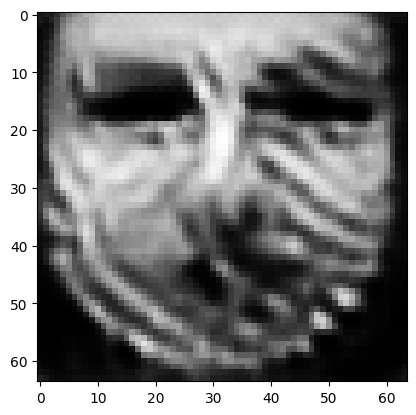

tensor([[7.7700e-06, 2.6649e-07, 9.8953e-01, 1.0102e-04, 1.2421e-04, 2.4288e-03,
         4.8411e-06, 1.9236e-04, 1.0331e-05, 3.7544e-06, 4.6269e-06, 1.8253e-05,
         1.4789e-04, 5.2826e-07, 1.8079e-09, 1.6322e-06, 3.0186e-04, 3.6426e-06,
         8.5274e-07, 1.2748e-04, 1.1193e-05, 1.5888e-06, 5.1629e-08, 6.3674e-07,
         4.2275e-05, 4.1421e-05, 2.6013e-06, 5.8648e-05, 2.6307e-03, 1.0972e-06,
         2.7272e-05, 5.9340e-08, 3.4763e-04, 5.4512e-05, 1.1092e-04, 1.4760e-08,
         3.7285e-05, 8.4351e-05, 2.2732e-03, 1.2601e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010520710609853268
tensor([[7.7462e-06, 2.6549e-07, 9.8957e-01, 1.0076e-04, 1.2363e-04, 2.4218e-03,
         4.8114e-06, 1.9167e-04, 1.0302e-05, 3.7403e-06, 4.6111e-06, 1.8215e-05,
         1.4740e-04, 5.2637e-07, 1.7995e-09, 1.6259e-06, 3.0099e-04, 3.6292e-06,
         8.4903e-07, 1.2709e-04, 1.1151e-05, 1.5833e-06, 5.1404e-08, 6.3425e-07,
         4.2077e-05, 4.1325e-05, 2.5887e-

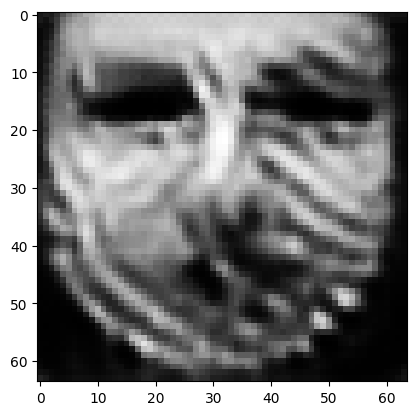

tensor([[7.6528e-06, 2.6114e-07, 9.8971e-01, 9.9542e-05, 1.2142e-04, 2.3952e-03,
         4.6993e-06, 1.8898e-04, 1.0180e-05, 3.6851e-06, 4.5469e-06, 1.8059e-05,
         1.4532e-04, 5.1810e-07, 1.7651e-09, 1.6004e-06, 2.9736e-04, 3.5761e-06,
         8.3380e-07, 1.2558e-04, 1.0979e-05, 1.5618e-06, 5.0442e-08, 6.2407e-07,
         4.1271e-05, 4.0897e-05, 2.5406e-06, 5.7466e-05, 2.5817e-03, 1.0794e-06,
         2.6953e-05, 5.7935e-08, 3.4175e-04, 5.3337e-05, 1.0951e-04, 1.4334e-08,
         3.6555e-05, 8.3445e-05, 2.2302e-03, 1.2390e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010341275483369827
tensor([[7.6309e-06, 2.6024e-07, 9.8975e-01, 9.9310e-05, 1.2091e-04, 2.3881e-03,
         4.6718e-06, 1.8832e-04, 1.0154e-05, 3.6713e-06, 4.5323e-06, 1.8023e-05,
         1.4489e-04, 5.1657e-07, 1.7578e-09, 1.5945e-06, 2.9658e-04, 3.5650e-06,
         8.3039e-07, 1.2521e-04, 1.0941e-05, 1.5566e-06, 5.0250e-08, 6.2176e-07,
         4.1094e-05, 4.0806e-05, 2.5290e-

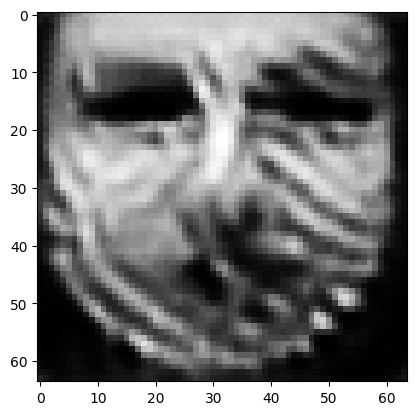

tensor([[7.5462e-06, 2.5633e-07, 9.8988e-01, 9.8194e-05, 1.1890e-04, 2.3631e-03,
         4.5698e-06, 1.8583e-04, 1.0042e-05, 3.6208e-06, 4.4749e-06, 1.7883e-05,
         1.4300e-04, 5.0937e-07, 1.7272e-09, 1.5714e-06, 2.9336e-04, 3.5184e-06,
         8.1658e-07, 1.2383e-04, 1.0787e-05, 1.5366e-06, 4.9387e-08, 6.1251e-07,
         4.0361e-05, 4.0406e-05, 2.4854e-06, 5.6392e-05, 2.5361e-03, 1.0635e-06,
         2.6667e-05, 5.6682e-08, 3.3643e-04, 5.2264e-05, 1.0824e-04, 1.3952e-08,
         3.5912e-05, 8.2656e-05, 2.1898e-03, 1.2193e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010173724964261055
tensor([[7.5244e-06, 2.5535e-07, 9.8991e-01, 9.7903e-05, 1.1840e-04, 2.3569e-03,
         4.5444e-06, 1.8520e-04, 1.0015e-05, 3.6086e-06, 4.4603e-06, 1.7849e-05,
         1.4254e-04, 5.0755e-07, 1.7196e-09, 1.5657e-06, 2.9252e-04, 3.5061e-06,
         8.1315e-07, 1.2348e-04, 1.0750e-05, 1.5317e-06, 4.9168e-08, 6.1017e-07,
         4.0176e-05, 4.0308e-05, 2.4748e-

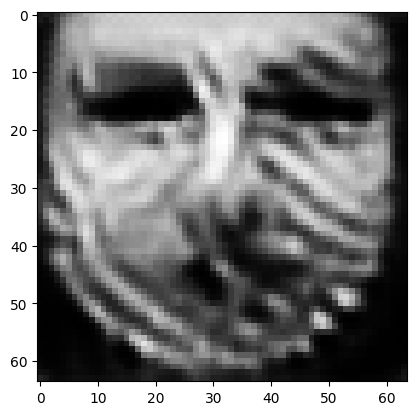

tensor([[7.4438e-06, 2.5185e-07, 9.9003e-01, 9.6881e-05, 1.1659e-04, 2.3326e-03,
         4.4501e-06, 1.8286e-04, 9.9152e-06, 3.5629e-06, 4.4058e-06, 1.7725e-05,
         1.4088e-04, 5.0119e-07, 1.6920e-09, 1.5448e-06, 2.8949e-04, 3.4622e-06,
         8.0062e-07, 1.2215e-04, 1.0615e-05, 1.5135e-06, 4.8394e-08, 6.0156e-07,
         3.9505e-05, 3.9949e-05, 2.4354e-06, 5.5414e-05, 2.4947e-03, 1.0491e-06,
         2.6399e-05, 5.5529e-08, 3.3155e-04, 5.1285e-05, 1.0707e-04, 1.3594e-08,
         3.5318e-05, 8.1854e-05, 2.1530e-03, 1.2020e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010019956156611443
tensor([[7.4241e-06, 2.5100e-07, 9.9006e-01, 9.6637e-05, 1.1615e-04, 2.3267e-03,
         4.4274e-06, 1.8229e-04, 9.8924e-06, 3.5519e-06, 4.3924e-06, 1.7694e-05,
         1.4048e-04, 4.9964e-07, 1.6854e-09, 1.5397e-06, 2.8871e-04, 3.4517e-06,
         7.9757e-07, 1.2183e-04, 1.0582e-05, 1.5092e-06, 4.8207e-08, 5.9944e-07,
         3.9347e-05, 3.9861e-05, 2.4260e-

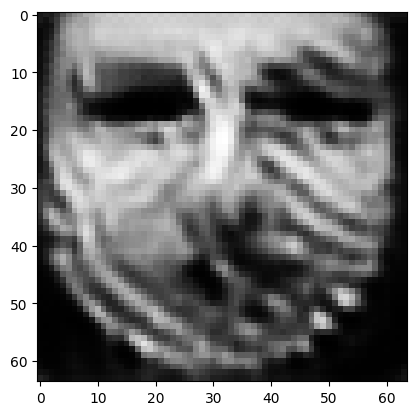

tensor([[7.3506e-06, 2.4784e-07, 9.9017e-01, 9.5725e-05, 1.1452e-04, 2.3042e-03,
         4.3424e-06, 1.8014e-04, 9.8005e-06, 3.5094e-06, 4.3427e-06, 1.7578e-05,
         1.3898e-04, 4.9398e-07, 1.6604e-09, 1.5208e-06, 2.8600e-04, 3.4129e-06,
         7.8628e-07, 1.2059e-04, 1.0462e-05, 1.4925e-06, 4.7527e-08, 5.9164e-07,
         3.8749e-05, 3.9532e-05, 2.3900e-06, 5.4523e-05, 2.4563e-03, 1.0358e-06,
         2.6158e-05, 5.4494e-08, 3.2710e-04, 5.0398e-05, 1.0602e-04, 1.3277e-08,
         3.4798e-05, 8.1134e-05, 2.1194e-03, 1.1859e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009878203272819519
tensor([[7.3320e-06, 2.4702e-07, 9.9020e-01, 9.5475e-05, 1.1411e-04, 2.2989e-03,
         4.3217e-06, 1.7960e-04, 9.7771e-06, 3.4992e-06, 4.3302e-06, 1.7551e-05,
         1.3859e-04, 4.9240e-07, 1.6539e-09, 1.5161e-06, 2.8529e-04, 3.4025e-06,
         7.8341e-07, 1.2029e-04, 1.0432e-05, 1.4884e-06, 4.7345e-08, 5.8965e-07,
         3.8594e-05, 3.9446e-05, 2.3813e-

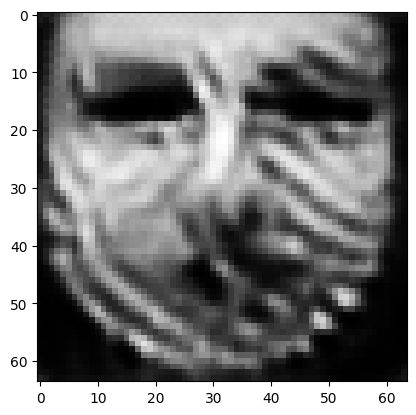

tensor([[7.2605e-06, 2.4420e-07, 9.9030e-01, 9.4651e-05, 1.1259e-04, 2.2777e-03,
         4.2418e-06, 1.7755e-04, 9.6977e-06, 3.4597e-06, 4.2841e-06, 1.7448e-05,
         1.3726e-04, 4.8730e-07, 1.6312e-09, 1.4991e-06, 2.8273e-04, 3.3654e-06,
         7.7304e-07, 1.1911e-04, 1.0325e-05, 1.4731e-06, 4.6742e-08, 5.8236e-07,
         3.8039e-05, 3.9154e-05, 2.3477e-06, 5.3692e-05, 2.4212e-03, 1.0236e-06,
         2.5940e-05, 5.3533e-08, 3.2288e-04, 4.9587e-05, 1.0506e-04, 1.2984e-08,
         3.4319e-05, 8.0434e-05, 2.0882e-03, 1.1715e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009747526608407497
tensor([[7.2435e-06, 2.4352e-07, 9.9032e-01, 9.4443e-05, 1.1224e-04, 2.2728e-03,
         4.2233e-06, 1.7707e-04, 9.6788e-06, 3.4505e-06, 4.2731e-06, 1.7424e-05,
         1.3695e-04, 4.8604e-07, 1.6258e-09, 1.4951e-06, 2.8210e-04, 3.3566e-06,
         7.7053e-07, 1.1884e-04, 1.0299e-05, 1.4696e-06, 4.6596e-08, 5.8062e-07,
         3.7906e-05, 3.9082e-05, 2.3399e-

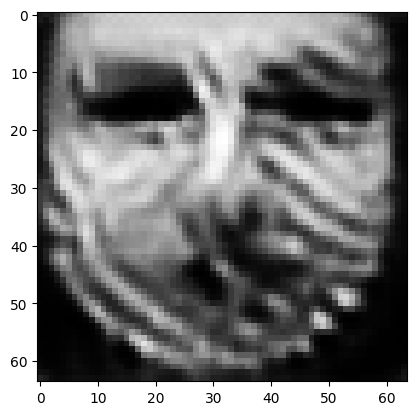

tensor([[7.1783e-06, 2.4074e-07, 9.9042e-01, 9.3599e-05, 1.1085e-04, 2.2544e-03,
         4.1524e-06, 1.7523e-04, 9.6028e-06, 3.4155e-06, 4.2304e-06, 1.7331e-05,
         1.3565e-04, 4.8085e-07, 1.6042e-09, 1.4792e-06, 2.7964e-04, 3.3212e-06,
         7.6079e-07, 1.1780e-04, 1.0197e-05, 1.4557e-06, 4.5998e-08, 5.7383e-07,
         3.7384e-05, 3.8797e-05, 2.3096e-06, 5.2933e-05, 2.3887e-03, 1.0122e-06,
         2.5731e-05, 5.2650e-08, 3.1911e-04, 4.8845e-05, 1.0414e-04, 1.2715e-08,
         3.3868e-05, 7.9760e-05, 2.0602e-03, 1.1586e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009629230946302414
tensor([[7.1637e-06, 2.4010e-07, 9.9044e-01, 9.3406e-05, 1.1054e-04, 2.2498e-03,
         4.1363e-06, 1.7481e-04, 9.5860e-06, 3.4073e-06, 4.2202e-06, 1.7308e-05,
         1.3538e-04, 4.7971e-07, 1.5995e-09, 1.4755e-06, 2.7907e-04, 3.3134e-06,
         7.5853e-07, 1.1757e-04, 1.0173e-05, 1.4525e-06, 4.5867e-08, 5.7231e-07,
         3.7269e-05, 3.8732e-05, 2.3026e-

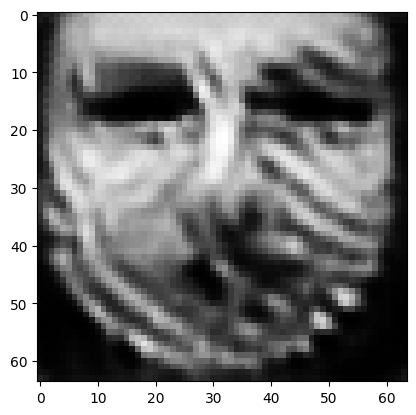

tensor([[7.1064e-06, 2.3767e-07, 9.9052e-01, 9.2676e-05, 1.0931e-04, 2.2329e-03,
         4.0728e-06, 1.7317e-04, 9.5197e-06, 3.3763e-06, 4.1813e-06, 1.7221e-05,
         1.3426e-04, 4.7520e-07, 1.5807e-09, 1.4612e-06, 2.7684e-04, 3.2818e-06,
         7.4985e-07, 1.1666e-04, 1.0080e-05, 1.4401e-06, 4.5342e-08, 5.6629e-07,
         3.6808e-05, 3.8484e-05, 2.2756e-06, 5.2254e-05, 2.3586e-03, 1.0019e-06,
         2.5556e-05, 5.1862e-08, 3.1578e-04, 4.8169e-05, 1.0330e-04, 1.2480e-08,
         3.3468e-05, 7.9173e-05, 2.0356e-03, 1.1466e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009521784260869026
tensor([[7.0918e-06, 2.3706e-07, 9.9054e-01, 9.2482e-05, 1.0901e-04, 2.2288e-03,
         4.0577e-06, 1.7276e-04, 9.5036e-06, 3.3687e-06, 4.1717e-06, 1.7200e-05,
         1.3400e-04, 4.7406e-07, 1.5761e-09, 1.4577e-06, 2.7628e-04, 3.2741e-06,
         7.4771e-07, 1.1644e-04, 1.0058e-05, 1.4372e-06, 4.5215e-08, 5.6477e-07,
         3.6693e-05, 3.8420e-05, 2.2693e-

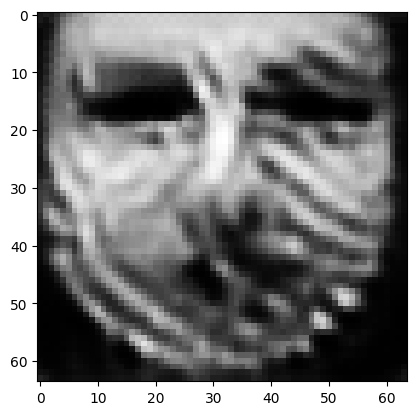

tensor([[7.0380e-06, 2.3481e-07, 9.9062e-01, 9.1812e-05, 1.0786e-04, 2.2132e-03,
         3.9999e-06, 1.7124e-04, 9.4408e-06, 3.3399e-06, 4.1363e-06, 1.7121e-05,
         1.3294e-04, 4.6987e-07, 1.5584e-09, 1.4449e-06, 2.7426e-04, 3.2442e-06,
         7.3984e-07, 1.1560e-04, 9.9726e-06, 1.4257e-06, 4.4733e-08, 5.5927e-07,
         3.6267e-05, 3.8194e-05, 2.2443e-06, 5.1623e-05, 2.3316e-03, 9.9238e-07,
         2.5389e-05, 5.1126e-08, 3.1266e-04, 4.7549e-05, 1.0252e-04, 1.2261e-08,
         3.3095e-05, 7.8616e-05, 2.0124e-03, 1.1358e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009423301555216312
tensor([[7.0251e-06, 2.3423e-07, 9.9064e-01, 9.1637e-05, 1.0758e-04, 2.2098e-03,
         3.9863e-06, 1.7089e-04, 9.4247e-06, 3.3333e-06, 4.1279e-06, 1.7101e-05,
         1.3266e-04, 4.6875e-07, 1.5540e-09, 1.4417e-06, 2.7375e-04, 3.2368e-06,
         7.3790e-07, 1.1540e-04, 9.9508e-06, 1.4229e-06, 4.4605e-08, 5.5793e-07,
         3.6161e-05, 3.8136e-05, 2.2383e-

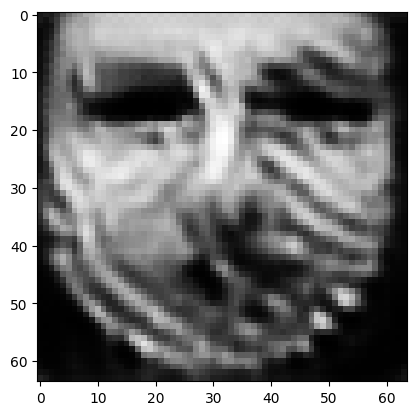

tensor([[6.9768e-06, 2.3211e-07, 9.9071e-01, 9.1007e-05, 1.0653e-04, 2.1961e-03,
         3.9346e-06, 1.6954e-04, 9.3646e-06, 3.3067e-06, 4.0959e-06, 1.7028e-05,
         1.3167e-04, 4.6482e-07, 1.5375e-09, 1.4301e-06, 2.7193e-04, 3.2098e-06,
         7.3069e-07, 1.1462e-04, 9.8723e-06, 1.4124e-06, 4.4158e-08, 5.5294e-07,
         3.5772e-05, 3.7921e-05, 2.2155e-06, 5.1045e-05, 2.3072e-03, 9.8332e-07,
         2.5225e-05, 5.0449e-08, 3.0979e-04, 4.6975e-05, 1.0177e-04, 1.2061e-08,
         3.2752e-05, 7.8107e-05, 1.9903e-03, 1.1257e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009333311580121517
tensor([[6.9657e-06, 2.3168e-07, 9.9073e-01, 9.0901e-05, 1.0627e-04, 2.1927e-03,
         3.9217e-06, 1.6923e-04, 9.3517e-06, 3.3005e-06, 4.0888e-06, 1.7011e-05,
         1.3144e-04, 4.6408e-07, 1.5338e-09, 1.4276e-06, 2.7153e-04, 3.2037e-06,
         7.2914e-07, 1.1443e-04, 9.8543e-06, 1.4098e-06, 4.4063e-08, 5.5183e-07,
         3.5685e-05, 3.7880e-05, 2.2099e-

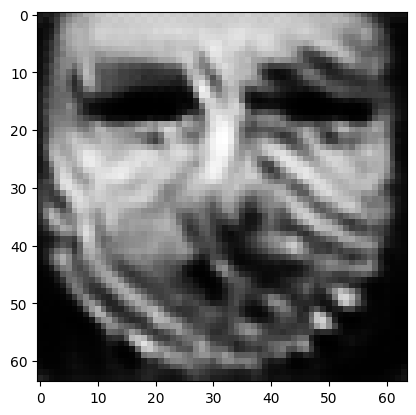

tensor([[6.9198e-06, 2.2954e-07, 9.9079e-01, 9.0239e-05, 1.0526e-04, 2.1803e-03,
         3.8741e-06, 1.6798e-04, 9.2898e-06, 3.2758e-06, 4.0584e-06, 1.6943e-05,
         1.3042e-04, 4.6000e-07, 1.5177e-09, 1.4165e-06, 2.6977e-04, 3.1774e-06,
         7.2220e-07, 1.1373e-04, 9.7782e-06, 1.4000e-06, 4.3610e-08, 5.4713e-07,
         3.5301e-05, 3.7658e-05, 2.1884e-06, 5.0498e-05, 2.2845e-03, 9.7470e-07,
         2.5063e-05, 4.9816e-08, 3.0713e-04, 4.6430e-05, 1.0104e-04, 1.1873e-08,
         3.2426e-05, 7.7634e-05, 1.9695e-03, 1.1160e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009248747490346432
tensor([[6.9096e-06, 2.2912e-07, 9.9081e-01, 9.0128e-05, 1.0503e-04, 2.1770e-03,
         3.8626e-06, 1.6769e-04, 9.2772e-06, 3.2697e-06, 4.0517e-06, 1.6927e-05,
         1.3022e-04, 4.5931e-07, 1.5144e-09, 1.4141e-06, 2.6942e-04, 3.1720e-06,
         7.2073e-07, 1.1356e-04, 9.7623e-06, 1.3976e-06, 4.3526e-08, 5.4615e-07,
         3.5222e-05, 3.7618e-05, 2.1831e-

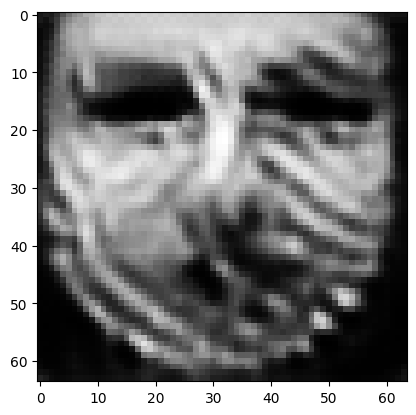

tensor([[6.8668e-06, 2.2706e-07, 9.9087e-01, 8.9483e-05, 1.0408e-04, 2.1656e-03,
         3.8188e-06, 1.6653e-04, 9.2156e-06, 3.2466e-06, 4.0234e-06, 1.6862e-05,
         1.2921e-04, 4.5540e-07, 1.4990e-09, 1.4037e-06, 2.6781e-04, 3.1472e-06,
         7.1420e-07, 1.1290e-04, 9.6899e-06, 1.3883e-06, 4.3088e-08, 5.4182e-07,
         3.4860e-05, 3.7404e-05, 2.1628e-06, 4.9985e-05, 2.2632e-03, 9.6644e-07,
         2.4904e-05, 4.9221e-08, 3.0466e-04, 4.5918e-05, 1.0033e-04, 1.1696e-08,
         3.2120e-05, 7.7180e-05, 1.9499e-03, 1.1067e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009169254451990128
tensor([[6.8572e-06, 2.2668e-07, 9.9089e-01, 8.9387e-05, 1.0387e-04, 2.1623e-03,
         3.8080e-06, 1.6626e-04, 9.2042e-06, 3.2407e-06, 4.0171e-06, 1.6846e-05,
         1.2903e-04, 4.5479e-07, 1.4960e-09, 1.4014e-06, 2.6749e-04, 3.1423e-06,
         7.1286e-07, 1.1273e-04, 9.6752e-06, 1.3861e-06, 4.3013e-08, 5.4091e-07,
         3.4791e-05, 3.7367e-05, 2.1579e-

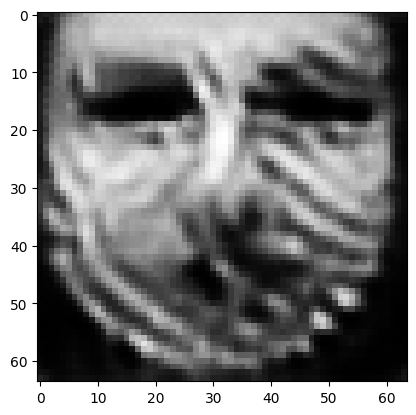

tensor([[6.8175e-06, 2.2480e-07, 9.9095e-01, 8.8809e-05, 1.0301e-04, 2.1514e-03,
         3.7674e-06, 1.6520e-04, 9.1483e-06, 3.2192e-06, 3.9907e-06, 1.6783e-05,
         1.2811e-04, 4.5123e-07, 1.4821e-09, 1.3918e-06, 2.6601e-04, 3.1196e-06,
         7.0686e-07, 1.1210e-04, 9.6087e-06, 1.3776e-06, 4.2617e-08, 5.3697e-07,
         3.4466e-05, 3.7176e-05, 2.1388e-06, 4.9512e-05, 2.2434e-03, 9.5886e-07,
         2.4761e-05, 4.8679e-08, 3.0236e-04, 4.5447e-05, 9.9685e-05, 1.1534e-08,
         3.1843e-05, 7.6759e-05, 1.9321e-03, 1.0979e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009095662273466587
tensor([[6.8088e-06, 2.2446e-07, 9.9096e-01, 8.8724e-05, 1.0283e-04, 2.1483e-03,
         3.7576e-06, 1.6495e-04, 9.1380e-06, 3.2137e-06, 3.9849e-06, 1.6768e-05,
         1.2795e-04, 4.5070e-07, 1.4795e-09, 1.3896e-06, 2.6573e-04, 3.1151e-06,
         7.0564e-07, 1.1195e-04, 9.5957e-06, 1.3755e-06, 4.2552e-08, 5.3619e-07,
         3.4405e-05, 3.7144e-05, 2.1342e-

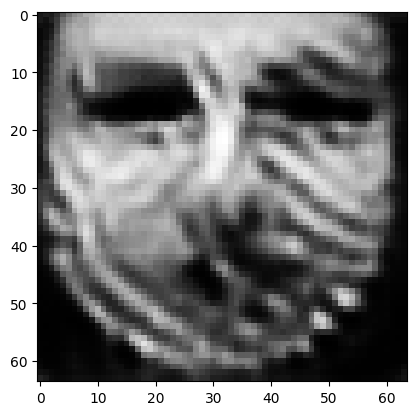

tensor([[6.7724e-06, 2.2280e-07, 9.9101e-01, 8.8236e-05, 1.0203e-04, 2.1376e-03,
         3.7191e-06, 1.6396e-04, 9.0884e-06, 3.1932e-06, 3.9605e-06, 1.6709e-05,
         1.2715e-04, 4.4767e-07, 1.4671e-09, 1.3808e-06, 2.6442e-04, 3.0944e-06,
         7.0021e-07, 1.1137e-04, 9.5358e-06, 1.3675e-06, 4.2208e-08, 5.3265e-07,
         3.4115e-05, 3.6981e-05, 2.1162e-06, 4.9078e-05, 2.2250e-03, 9.5220e-07,
         2.4643e-05, 4.8192e-08, 3.0022e-04, 4.5015e-05, 9.9116e-05, 1.1389e-08,
         3.1597e-05, 7.6391e-05, 1.9158e-03, 1.0895e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009026790037751198
tensor([[6.7627e-06, 2.2232e-07, 9.9103e-01, 8.8080e-05, 1.0182e-04, 2.1352e-03,
         3.7098e-06, 1.6370e-04, 9.0741e-06, 3.1882e-06, 3.9541e-06, 1.6695e-05,
         1.2692e-04, 4.4673e-07, 1.4636e-09, 1.3784e-06, 2.6405e-04, 3.0888e-06,
         6.9874e-07, 1.1122e-04, 9.5191e-06, 1.3655e-06, 4.2107e-08, 5.3165e-07,
         3.4033e-05, 3.6931e-05, 2.1119e-

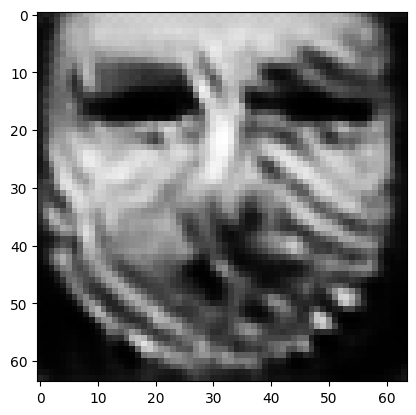

tensor([[6.7278e-06, 2.2083e-07, 9.9108e-01, 8.7652e-05, 1.0106e-04, 2.1247e-03,
         3.6728e-06, 1.6274e-04, 9.0270e-06, 3.1680e-06, 3.9310e-06, 1.6639e-05,
         1.2618e-04, 4.4403e-07, 1.4520e-09, 1.3701e-06, 2.6287e-04, 3.0695e-06,
         6.9375e-07, 1.1065e-04, 9.4639e-06, 1.3576e-06, 4.1797e-08, 5.2830e-07,
         3.3759e-05, 3.6781e-05, 2.0948e-06, 4.8652e-05, 2.2074e-03, 9.4572e-07,
         2.4522e-05, 4.7704e-08, 2.9810e-04, 4.4592e-05, 9.8556e-05, 1.1246e-08,
         3.1349e-05, 7.6018e-05, 1.8998e-03, 1.0816e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008960512466728687
tensor([[6.7189e-06, 2.2041e-07, 9.9109e-01, 8.7518e-05, 1.0086e-04, 2.1224e-03,
         3.6640e-06, 1.6250e-04, 9.0137e-06, 3.1634e-06, 3.9253e-06, 1.6625e-05,
         1.2597e-04, 4.4322e-07, 1.4488e-09, 1.3680e-06, 2.6254e-04, 3.0644e-06,
         6.9243e-07, 1.1051e-04, 9.4489e-06, 1.3557e-06, 4.1705e-08, 5.2741e-07,
         3.3682e-05, 3.6736e-05, 2.0907e-

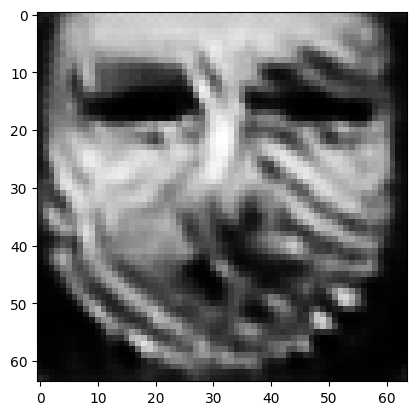

tensor([[6.6850e-06, 2.1894e-07, 9.9114e-01, 8.7061e-05, 1.0013e-04, 2.1128e-03,
         3.6296e-06, 1.6158e-04, 8.9660e-06, 3.1448e-06, 3.9039e-06, 1.6572e-05,
         1.2523e-04, 4.4047e-07, 1.4373e-09, 1.3600e-06, 2.6137e-04, 3.0458e-06,
         6.8756e-07, 1.0999e-04, 9.3948e-06, 1.3482e-06, 4.1388e-08, 5.2409e-07,
         3.3406e-05, 3.6578e-05, 2.0749e-06, 4.8248e-05, 2.1908e-03, 9.3951e-07,
         2.4397e-05, 4.7230e-08, 2.9611e-04, 4.4185e-05, 9.7995e-05, 1.1107e-08,
         3.1105e-05, 7.5658e-05, 1.8844e-03, 1.0742e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00889777485281229
tensor([[6.6762e-06, 2.1854e-07, 9.9115e-01, 8.6927e-05, 9.9945e-05, 2.1104e-03,
         3.6211e-06, 1.6134e-04, 8.9540e-06, 3.1402e-06, 3.8982e-06, 1.6559e-05,
         1.2504e-04, 4.3969e-07, 1.4343e-09, 1.3579e-06, 2.6103e-04, 3.0409e-06,
         6.8626e-07, 1.0987e-04, 9.3810e-06, 1.3464e-06, 4.1301e-08, 5.2316e-07,
         3.3332e-05, 3.6531e-05, 2.0712e-0

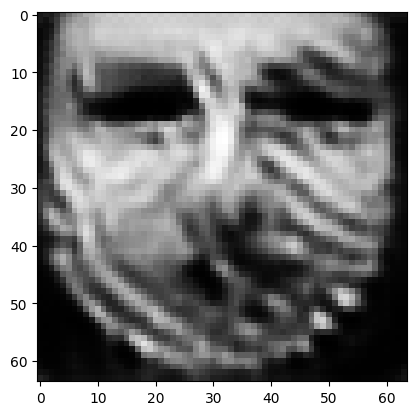

tensor([[6.6431e-06, 2.1707e-07, 9.9120e-01, 8.6446e-05, 9.9224e-05, 2.1015e-03,
         3.5880e-06, 1.6043e-04, 8.9075e-06, 3.1228e-06, 3.8767e-06, 1.6510e-05,
         1.2430e-04, 4.3682e-07, 1.4229e-09, 1.3499e-06, 2.5977e-04, 3.0226e-06,
         6.8141e-07, 1.0938e-04, 9.3269e-06, 1.3392e-06, 4.0971e-08, 5.1967e-07,
         3.3051e-05, 3.6358e-05, 2.0568e-06, 4.7849e-05, 2.1743e-03, 9.3340e-07,
         2.4266e-05, 4.6754e-08, 2.9419e-04, 4.3789e-05, 9.7443e-05, 1.0970e-08,
         3.0845e-05, 7.5288e-05, 1.8698e-03, 1.0676e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008837278932332993
tensor([[6.6360e-06, 2.1680e-07, 9.9121e-01, 8.6370e-05, 9.9065e-05, 2.0991e-03,
         3.5800e-06, 1.6023e-04, 8.8981e-06, 3.1184e-06, 3.8721e-06, 1.6497e-05,
         1.2415e-04, 4.3636e-07, 1.4206e-09, 1.3482e-06, 2.5953e-04, 3.0189e-06,
         6.8043e-07, 1.0926e-04, 9.3160e-06, 1.3375e-06, 4.0913e-08, 5.1896e-07,
         3.2995e-05, 3.6328e-05, 2.0533e-

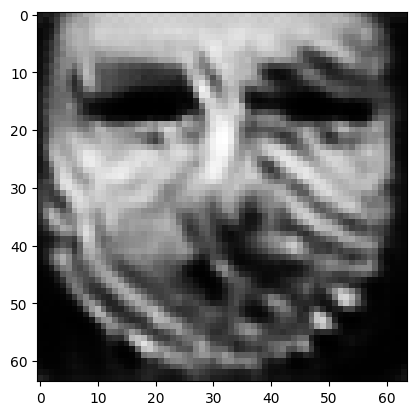

tensor([[6.6060e-06, 2.1543e-07, 9.9126e-01, 8.5934e-05, 9.8396e-05, 2.0908e-03,
         3.5495e-06, 1.5940e-04, 8.8538e-06, 3.1021e-06, 3.8521e-06, 1.6448e-05,
         1.2346e-04, 4.3371e-07, 1.4099e-09, 1.3408e-06, 2.5838e-04, 3.0020e-06,
         6.7597e-07, 1.0881e-04, 9.2647e-06, 1.3308e-06, 4.0606e-08, 5.1576e-07,
         3.2738e-05, 3.6168e-05, 2.0397e-06, 4.7488e-05, 2.1591e-03, 9.2788e-07,
         2.4154e-05, 4.6328e-08, 2.9240e-04, 4.3427e-05, 9.6949e-05, 1.0849e-08,
         3.0618e-05, 7.4972e-05, 1.8560e-03, 1.0611e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008781032636761665
tensor([[6.5986e-06, 2.1508e-07, 9.9127e-01, 8.5818e-05, 9.8229e-05, 2.0889e-03,
         3.5422e-06, 1.5920e-04, 8.8423e-06, 3.0983e-06, 3.8471e-06, 1.6436e-05,
         1.2327e-04, 4.3299e-07, 1.4072e-09, 1.3389e-06, 2.5809e-04, 2.9976e-06,
         6.7484e-07, 1.0869e-04, 9.2514e-06, 1.3292e-06, 4.0524e-08, 5.1497e-07,
         3.2672e-05, 3.6128e-05, 2.0364e-

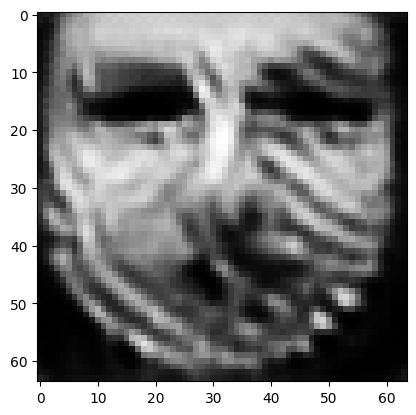

tensor([[6.5711e-06, 2.1384e-07, 9.9131e-01, 8.5428e-05, 9.7621e-05, 2.0808e-03,
         3.5139e-06, 1.5844e-04, 8.8025e-06, 3.0832e-06, 3.8286e-06, 1.6389e-05,
         1.2265e-04, 4.3064e-07, 1.3976e-09, 1.3320e-06, 2.5703e-04, 2.9822e-06,
         6.7075e-07, 1.0828e-04, 9.2045e-06, 1.3230e-06, 4.0247e-08, 5.1206e-07,
         3.2440e-05, 3.5984e-05, 2.0238e-06, 4.7150e-05, 2.1449e-03, 9.2257e-07,
         2.4044e-05, 4.5922e-08, 2.9073e-04, 4.3084e-05, 9.6468e-05, 1.0733e-08,
         3.0400e-05, 7.4662e-05, 1.8432e-03, 1.0551e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008728329092264175
tensor([[6.5643e-06, 2.1351e-07, 9.9132e-01, 8.5320e-05, 9.7465e-05, 2.0790e-03,
         3.5071e-06, 1.5826e-04, 8.7919e-06, 3.0797e-06, 3.8240e-06, 1.6378e-05,
         1.2247e-04, 4.2999e-07, 1.3950e-09, 1.3303e-06, 2.5676e-04, 2.9782e-06,
         6.6970e-07, 1.0818e-04, 9.1921e-06, 1.3214e-06, 4.0171e-08, 5.1132e-07,
         3.2378e-05, 3.5945e-05, 2.0208e-

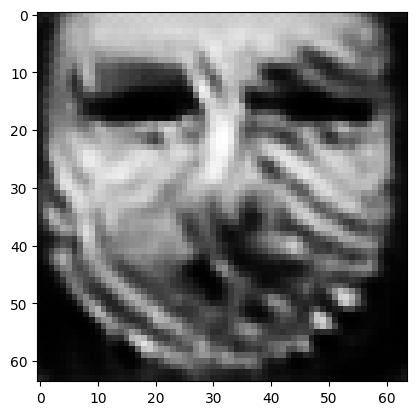

tensor([[6.5398e-06, 2.1242e-07, 9.9136e-01, 8.4986e-05, 9.6901e-05, 2.0712e-03,
         3.4805e-06, 1.5756e-04, 8.7557e-06, 3.0655e-06, 3.8072e-06, 1.6333e-05,
         1.2191e-04, 4.2799e-07, 1.3862e-09, 1.3240e-06, 2.5584e-04, 2.9643e-06,
         6.6597e-07, 1.0779e-04, 9.1494e-06, 1.3156e-06, 3.9926e-08, 5.0870e-07,
         3.2171e-05, 3.5818e-05, 2.0089e-06, 4.6841e-05, 2.1314e-03, 9.1776e-07,
         2.3951e-05, 4.5552e-08, 2.8921e-04, 4.2768e-05, 9.6036e-05, 1.0627e-08,
         3.0204e-05, 7.4397e-05, 1.8311e-03, 1.0492e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008678576909005642
tensor([[6.5334e-06, 2.1212e-07, 9.9137e-01, 8.4887e-05, 9.6757e-05, 2.0694e-03,
         3.4741e-06, 1.5738e-04, 8.7457e-06, 3.0621e-06, 3.8030e-06, 1.6322e-05,
         1.2176e-04, 4.2739e-07, 1.3839e-09, 1.3224e-06, 2.5559e-04, 2.9606e-06,
         6.6499e-07, 1.0770e-04, 9.1382e-06, 1.3141e-06, 3.9857e-08, 5.0802e-07,
         3.2115e-05, 3.5782e-05, 2.0060e-

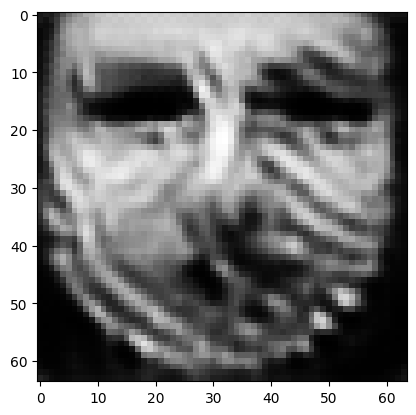

tensor([[6.5091e-06, 2.1103e-07, 9.9141e-01, 8.4534e-05, 9.6209e-05, 2.0619e-03,
         3.4486e-06, 1.5669e-04, 8.7096e-06, 3.0486e-06, 3.7863e-06, 1.6279e-05,
         1.2120e-04, 4.2530e-07, 1.3753e-09, 1.3161e-06, 2.5464e-04, 2.9468e-06,
         6.6126e-07, 1.0733e-04, 9.0962e-06, 1.3084e-06, 3.9605e-08, 5.0540e-07,
         3.1908e-05, 3.5651e-05, 1.9946e-06, 4.6539e-05, 2.1184e-03, 9.1297e-07,
         2.3853e-05, 4.5190e-08, 2.8773e-04, 4.2463e-05, 9.5611e-05, 1.0522e-08,
         3.0009e-05, 7.4121e-05, 1.8197e-03, 1.0437e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008630713447928429
tensor([[6.5030e-06, 2.1073e-07, 9.9142e-01, 8.4433e-05, 9.6067e-05, 2.0603e-03,
         3.4425e-06, 1.5653e-04, 8.6996e-06, 3.0455e-06, 3.7821e-06, 1.6269e-05,
         1.2104e-04, 4.2468e-07, 1.3729e-09, 1.3145e-06, 2.5439e-04, 2.9432e-06,
         6.6028e-07, 1.0724e-04, 9.0849e-06, 1.3070e-06, 3.9534e-08, 5.0473e-07,
         3.1853e-05, 3.5613e-05, 1.9919e-

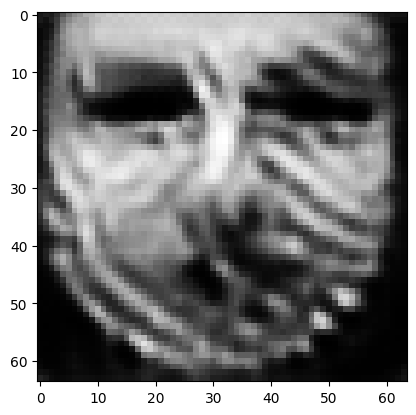

tensor([[6.4814e-06, 2.0970e-07, 9.9145e-01, 8.4108e-05, 9.5558e-05, 2.0534e-03,
         3.4192e-06, 1.5592e-04, 8.6652e-06, 3.0334e-06, 3.7666e-06, 1.6228e-05,
         1.2051e-04, 4.2270e-07, 1.3649e-09, 1.3086e-06, 2.5352e-04, 2.9304e-06,
         6.5677e-07, 1.0691e-04, 9.0436e-06, 1.3017e-06, 3.9291e-08, 5.0238e-07,
         3.1663e-05, 3.5491e-05, 1.9815e-06, 4.6261e-05, 2.1063e-03, 9.0841e-07,
         2.3761e-05, 4.4852e-08, 2.8634e-04, 4.2175e-05, 9.5198e-05, 1.0425e-08,
         2.9826e-05, 7.3865e-05, 1.8089e-03, 1.0384e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008585802279412746
tensor([[6.4762e-06, 2.0946e-07, 9.9146e-01, 8.4034e-05, 9.5441e-05, 2.0517e-03,
         3.4136e-06, 1.5577e-04, 8.6575e-06, 3.0304e-06, 3.7629e-06, 1.6218e-05,
         1.2039e-04, 4.2227e-07, 1.3631e-09, 1.3071e-06, 2.5331e-04, 2.9275e-06,
         6.5595e-07, 1.0683e-04, 9.0341e-06, 1.3004e-06, 3.9237e-08, 5.0182e-07,
         3.1619e-05, 3.5464e-05, 1.9790e-

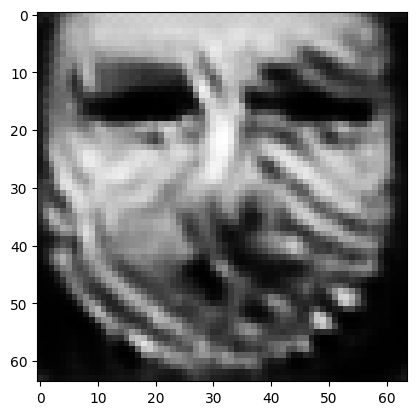

tensor([[6.4558e-06, 2.0854e-07, 9.9149e-01, 8.3747e-05, 9.4970e-05, 2.0450e-03,
         3.3915e-06, 1.5518e-04, 8.6270e-06, 3.0188e-06, 3.7484e-06, 1.6179e-05,
         1.1992e-04, 4.2051e-07, 1.3558e-09, 1.3016e-06, 2.5251e-04, 2.9158e-06,
         6.5273e-07, 1.0651e-04, 8.9968e-06, 1.2954e-06, 3.9023e-08, 4.9962e-07,
         3.1447e-05, 3.5354e-05, 1.9692e-06, 4.6007e-05, 2.0949e-03, 9.0438e-07,
         2.3686e-05, 4.4549e-08, 2.8506e-04, 4.1914e-05, 9.4844e-05, 1.0338e-08,
         2.9664e-05, 7.3642e-05, 1.7991e-03, 1.0334e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008543843403458595
tensor([[6.4508e-06, 2.0831e-07, 9.9150e-01, 8.3675e-05, 9.4854e-05, 2.0435e-03,
         3.3862e-06, 1.5504e-04, 8.6190e-06, 3.0161e-06, 3.7449e-06, 1.6170e-05,
         1.1980e-04, 4.2007e-07, 1.3539e-09, 1.3003e-06, 2.5232e-04, 2.9129e-06,
         6.5195e-07, 1.0643e-04, 8.9875e-06, 1.2942e-06, 3.8968e-08, 4.9909e-07,
         3.1403e-05, 3.5327e-05, 1.9668e-

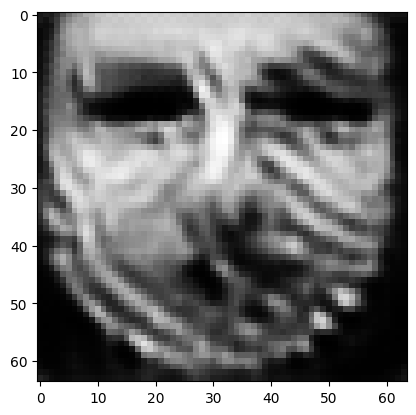

tensor([[6.4314e-06, 2.0746e-07, 9.9153e-01, 8.3414e-05, 9.4416e-05, 2.0371e-03,
         3.3655e-06, 1.5448e-04, 8.5911e-06, 3.0051e-06, 3.7314e-06, 1.6133e-05,
         1.1938e-04, 4.1848e-07, 1.3472e-09, 1.2951e-06, 2.5159e-04, 2.9019e-06,
         6.4899e-07, 1.0612e-04, 8.9533e-06, 1.2895e-06, 3.8774e-08, 4.9704e-07,
         3.1243e-05, 3.5227e-05, 1.9576e-06, 4.5768e-05, 2.0845e-03, 9.0064e-07,
         2.3615e-05, 4.4265e-08, 2.8382e-04, 4.1671e-05, 9.4516e-05, 1.0256e-08,
         2.9514e-05, 7.3432e-05, 1.7898e-03, 1.0286e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008504602126777172
tensor([[6.4264e-06, 2.0725e-07, 9.9154e-01, 8.3346e-05, 9.4304e-05, 2.0356e-03,
         3.3604e-06, 1.5434e-04, 8.5838e-06, 3.0024e-06, 3.7281e-06, 1.6125e-05,
         1.1927e-04, 4.1807e-07, 1.3454e-09, 1.2939e-06, 2.5140e-04, 2.8991e-06,
         6.4826e-07, 1.0605e-04, 8.9449e-06, 1.2883e-06, 3.8724e-08, 4.9652e-07,
         3.1201e-05, 3.5201e-05, 1.9554e-

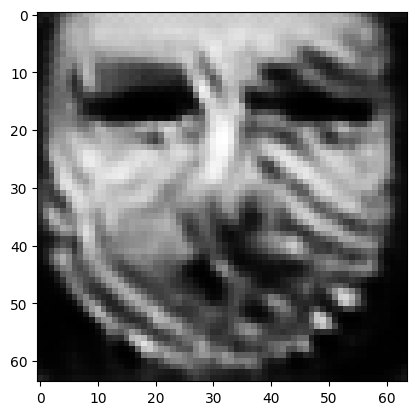

tensor([[6.4073e-06, 2.0644e-07, 9.9157e-01, 8.3086e-05, 9.3875e-05, 2.0297e-03,
         3.3406e-06, 1.5380e-04, 8.5561e-06, 2.9921e-06, 3.7153e-06, 1.6091e-05,
         1.1885e-04, 4.1651e-07, 1.3387e-09, 1.2892e-06, 2.5070e-04, 2.8882e-06,
         6.4543e-07, 1.0575e-04, 8.9124e-06, 1.2838e-06, 3.8534e-08, 4.9449e-07,
         3.1041e-05, 3.5101e-05, 1.9467e-06, 4.5537e-05, 2.0749e-03, 8.9709e-07,
         2.3546e-05, 4.3988e-08, 2.8263e-04, 4.1440e-05, 9.4201e-05, 1.0178e-08,
         2.9369e-05, 7.3223e-05, 1.7807e-03, 1.0243e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008467604406177998
tensor([[6.4027e-06, 2.0625e-07, 9.9158e-01, 8.3027e-05, 9.3775e-05, 2.0282e-03,
         3.3357e-06, 1.5366e-04, 8.5499e-06, 2.9894e-06, 3.7122e-06, 1.6083e-05,
         1.1876e-04, 4.1616e-07, 1.3372e-09, 1.2880e-06, 2.5053e-04, 2.8858e-06,
         6.4475e-07, 1.0568e-04, 8.9049e-06, 1.2827e-06, 3.8491e-08, 4.9400e-07,
         3.1005e-05, 3.5077e-05, 1.9446e-

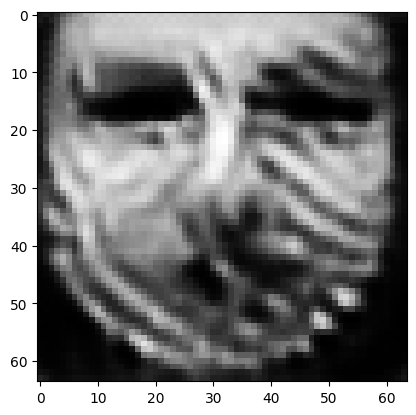

tensor([[6.3853e-06, 2.0550e-07, 9.9160e-01, 8.2789e-05, 9.3385e-05, 2.0226e-03,
         3.3174e-06, 1.5315e-04, 8.5234e-06, 2.9794e-06, 3.7004e-06, 1.6051e-05,
         1.1837e-04, 4.1477e-07, 1.3311e-09, 1.2836e-06, 2.4992e-04, 2.8760e-06,
         6.4216e-07, 1.0540e-04, 8.8753e-06, 1.2785e-06, 3.8319e-08, 4.9217e-07,
         3.0860e-05, 3.4984e-05, 1.9366e-06, 4.5322e-05, 2.0658e-03, 8.9384e-07,
         2.3484e-05, 4.3734e-08, 2.8152e-04, 4.1227e-05, 9.3917e-05, 1.0107e-08,
         2.9240e-05, 7.3034e-05, 1.7722e-03, 1.0202e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008432970382273197
tensor([[6.3811e-06, 2.0531e-07, 9.9161e-01, 8.2729e-05, 9.3289e-05, 2.0212e-03,
         3.3130e-06, 1.5303e-04, 8.5167e-06, 2.9770e-06, 3.6975e-06, 1.6043e-05,
         1.1828e-04, 4.1442e-07, 1.3296e-09, 1.2826e-06, 2.4977e-04, 2.8736e-06,
         6.4152e-07, 1.0533e-04, 8.8680e-06, 1.2775e-06, 3.8277e-08, 4.9173e-07,
         3.0825e-05, 3.4961e-05, 1.9346e-

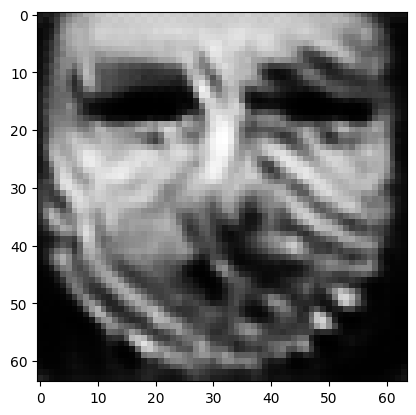

tensor([[6.3646e-06, 2.0460e-07, 9.9164e-01, 8.2505e-05, 9.2920e-05, 2.0158e-03,
         3.2957e-06, 1.5254e-04, 8.4918e-06, 2.9675e-06, 3.6862e-06, 1.6012e-05,
         1.1792e-04, 4.1310e-07, 1.3238e-09, 1.2784e-06, 2.4918e-04, 2.8642e-06,
         6.3907e-07, 1.0507e-04, 8.8400e-06, 1.2736e-06, 3.8115e-08, 4.9001e-07,
         3.0689e-05, 3.4875e-05, 1.9269e-06, 4.5120e-05, 2.0573e-03, 8.9075e-07,
         2.3426e-05, 4.3494e-08, 2.8048e-04, 4.1026e-05, 9.3641e-05, 1.0040e-08,
         2.9119e-05, 7.2854e-05, 1.7643e-03, 1.0162e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008399752900004387
tensor([[6.3607e-06, 2.0443e-07, 9.9164e-01, 8.2453e-05, 9.2834e-05, 2.0145e-03,
         3.2915e-06, 1.5243e-04, 8.4862e-06, 2.9652e-06, 3.6835e-06, 1.6004e-05,
         1.1784e-04, 4.1281e-07, 1.3225e-09, 1.2774e-06, 2.4904e-04, 2.8620e-06,
         6.3849e-07, 1.0501e-04, 8.8335e-06, 1.2726e-06, 3.8078e-08, 4.8960e-07,
         3.0658e-05, 3.4854e-05, 1.9251e-

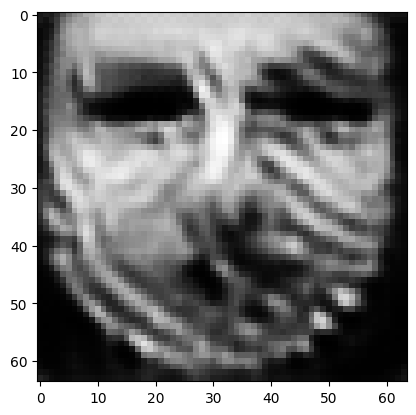

tensor([[6.3451e-06, 2.0376e-07, 9.9167e-01, 8.2241e-05, 9.2489e-05, 2.0094e-03,
         3.2753e-06, 1.5197e-04, 8.4628e-06, 2.9563e-06, 3.6730e-06, 1.5975e-05,
         1.1750e-04, 4.1157e-07, 1.3170e-09, 1.2735e-06, 2.4849e-04, 2.8533e-06,
         6.3619e-07, 1.0476e-04, 8.8072e-06, 1.2689e-06, 3.7927e-08, 4.8798e-07,
         3.0530e-05, 3.4772e-05, 1.9179e-06, 4.4929e-05, 2.0493e-03, 8.8788e-07,
         2.3371e-05, 4.3270e-08, 2.7951e-04, 4.0838e-05, 9.3387e-05, 9.9768e-09,
         2.9006e-05, 7.2685e-05, 1.7569e-03, 1.0125e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00836889911442995
tensor([[6.3413e-06, 2.0360e-07, 9.9167e-01, 8.2190e-05, 9.2405e-05, 2.0081e-03,
         3.2714e-06, 1.5186e-04, 8.4570e-06, 2.9541e-06, 3.6704e-06, 1.5968e-05,
         1.1742e-04, 4.1127e-07, 1.3157e-09, 1.2725e-06, 2.4836e-04, 2.8511e-06,
         6.3563e-07, 1.0470e-04, 8.8008e-06, 1.2680e-06, 3.7891e-08, 4.8759e-07,
         3.0499e-05, 3.4752e-05, 1.9161e-0

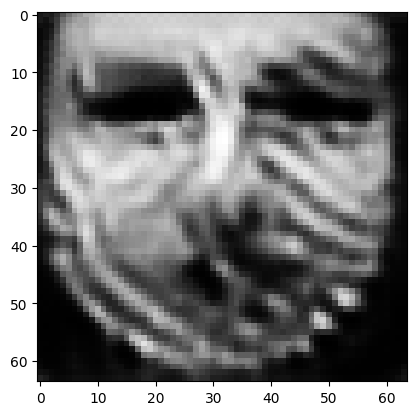

tensor([[6.3264e-06, 2.0299e-07, 9.9169e-01, 8.2000e-05, 9.2080e-05, 2.0032e-03,
         3.2560e-06, 1.5143e-04, 8.4356e-06, 2.9457e-06, 3.6605e-06, 1.5941e-05,
         1.1711e-04, 4.1015e-07, 1.3107e-09, 1.2689e-06, 2.4785e-04, 2.8428e-06,
         6.3350e-07, 1.0446e-04, 8.7766e-06, 1.2645e-06, 3.7754e-08, 4.8607e-07,
         3.0382e-05, 3.4679e-05, 1.9093e-06, 4.4752e-05, 2.0419e-03, 8.8523e-07,
         2.3322e-05, 4.3060e-08, 2.7858e-04, 4.0662e-05, 9.3153e-05, 9.9181e-09,
         2.8900e-05, 7.2526e-05, 1.7499e-03, 1.0090e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008339935913681984
tensor([[6.3228e-06, 2.0285e-07, 9.9170e-01, 8.1958e-05, 9.2006e-05, 2.0019e-03,
         3.2523e-06, 1.5132e-04, 8.4309e-06, 2.9436e-06, 3.6580e-06, 1.5934e-05,
         1.1704e-04, 4.0991e-07, 1.3095e-09, 1.2680e-06, 2.4773e-04, 2.8409e-06,
         6.3300e-07, 1.0440e-04, 8.7711e-06, 1.2637e-06, 3.7724e-08, 4.8571e-07,
         3.0355e-05, 3.4662e-05, 1.9077e-

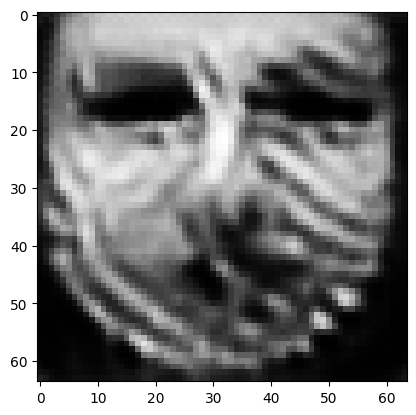

tensor([[6.3089e-06, 2.0227e-07, 9.9172e-01, 8.1788e-05, 9.1713e-05, 1.9971e-03,
         3.2378e-06, 1.5092e-04, 8.4099e-06, 2.9351e-06, 3.6485e-06, 1.5906e-05,
         1.1675e-04, 4.0891e-07, 1.3049e-09, 1.2646e-06, 2.4730e-04, 2.8331e-06,
         6.3107e-07, 1.0418e-04, 8.7484e-06, 1.2604e-06, 3.7600e-08, 4.8437e-07,
         3.0250e-05, 3.4593e-05, 1.9010e-06, 4.4588e-05, 2.0348e-03, 8.8275e-07,
         2.3278e-05, 4.2870e-08, 2.7772e-04, 4.0500e-05, 9.2941e-05, 9.8646e-09,
         2.8808e-05, 7.2378e-05, 1.7435e-03, 1.0056e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008312154561281204
tensor([[6.3056e-06, 2.0213e-07, 9.9173e-01, 8.1748e-05, 9.1643e-05, 1.9959e-03,
         3.2344e-06, 1.5083e-04, 8.4047e-06, 2.9331e-06, 3.6462e-06, 1.5899e-05,
         1.1668e-04, 4.0868e-07, 1.3038e-09, 1.2638e-06, 2.4720e-04, 2.8313e-06,
         6.3061e-07, 1.0413e-04, 8.7430e-06, 1.2597e-06, 3.7571e-08, 4.8406e-07,
         3.0225e-05, 3.4578e-05, 1.8995e-

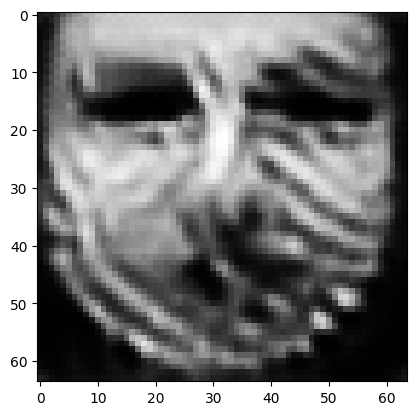

tensor([[6.2925e-06, 2.0159e-07, 9.9175e-01, 8.1590e-05, 9.1370e-05, 1.9914e-03,
         3.2209e-06, 1.5045e-04, 8.3857e-06, 2.9251e-06, 3.6372e-06, 1.5872e-05,
         1.1641e-04, 4.0775e-07, 1.2995e-09, 1.2606e-06, 2.4678e-04, 2.8240e-06,
         6.2880e-07, 1.0392e-04, 8.7219e-06, 1.2566e-06, 3.7457e-08, 4.8279e-07,
         3.0127e-05, 3.4515e-05, 1.8933e-06, 4.4435e-05, 2.0283e-03, 8.8041e-07,
         2.3237e-05, 4.2694e-08, 2.7691e-04, 4.0349e-05, 9.2740e-05, 9.8148e-09,
         2.8723e-05, 7.2240e-05, 1.7375e-03, 1.0023e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008286499418318272
tensor([[6.2892e-06, 2.0145e-07, 9.9175e-01, 8.1548e-05, 9.1302e-05, 1.9904e-03,
         3.2176e-06, 1.5036e-04, 8.3810e-06, 2.9232e-06, 3.6351e-06, 1.5866e-05,
         1.1634e-04, 4.0751e-07, 1.2984e-09, 1.2598e-06, 2.4668e-04, 2.8221e-06,
         6.2835e-07, 1.0387e-04, 8.7168e-06, 1.2559e-06, 3.7429e-08, 4.8247e-07,
         3.0102e-05, 3.4499e-05, 1.8918e-

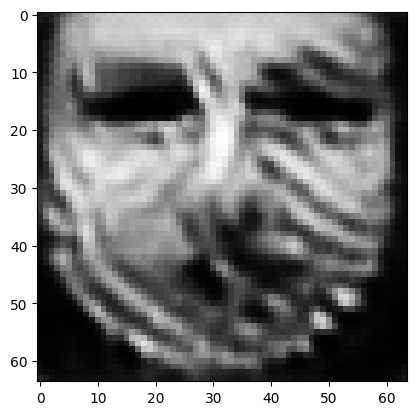

tensor([[6.2763e-06, 2.0093e-07, 9.9177e-01, 8.1393e-05, 9.1044e-05, 1.9861e-03,
         3.2048e-06, 1.5000e-04, 8.3641e-06, 2.9157e-06, 3.6265e-06, 1.5842e-05,
         1.1610e-04, 4.0660e-07, 1.2944e-09, 1.2567e-06, 2.4625e-04, 2.8149e-06,
         6.2662e-07, 1.0368e-04, 8.6975e-06, 1.2531e-06, 3.7322e-08, 4.8123e-07,
         3.0008e-05, 3.4440e-05, 1.8860e-06, 4.4288e-05, 2.0222e-03, 8.7821e-07,
         2.3196e-05, 4.2529e-08, 2.7616e-04, 4.0208e-05, 9.2548e-05, 9.7675e-09,
         2.8638e-05, 7.2101e-05, 1.7322e-03, 9.9937e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00826285406947136
tensor([[6.2732e-06, 2.0080e-07, 9.9178e-01, 8.1358e-05, 9.0982e-05, 1.9850e-03,
         3.2017e-06, 1.4991e-04, 8.3602e-06, 2.9139e-06, 3.6245e-06, 1.5836e-05,
         1.1604e-04, 4.0638e-07, 1.2934e-09, 1.2560e-06, 2.4615e-04, 2.8131e-06,
         6.2621e-07, 1.0363e-04, 8.6928e-06, 1.2525e-06, 3.7297e-08, 4.8094e-07,
         2.9986e-05, 3.4427e-05, 1.8846e-0

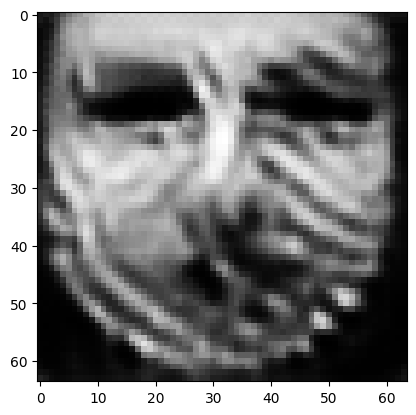

tensor([[6.2611e-06, 2.0032e-07, 9.9179e-01, 8.1220e-05, 9.0747e-05, 1.9810e-03,
         3.1898e-06, 1.4957e-04, 8.3451e-06, 2.9069e-06, 3.6165e-06, 1.5814e-05,
         1.1583e-04, 4.0557e-07, 1.2897e-09, 1.2531e-06, 2.4576e-04, 2.8064e-06,
         6.2462e-07, 1.0346e-04, 8.6752e-06, 1.2499e-06, 3.7203e-08, 4.7982e-07,
         2.9902e-05, 3.4375e-05, 1.8791e-06, 4.4152e-05, 2.0165e-03, 8.7622e-07,
         2.3162e-05, 4.2379e-08, 2.7547e-04, 4.0081e-05, 9.2373e-05, 9.7245e-09,
         2.8563e-05, 7.1973e-05, 1.7275e-03, 9.9664e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008240627124905586
tensor([[6.2582e-06, 2.0020e-07, 9.9180e-01, 8.1186e-05, 9.0687e-05, 1.9800e-03,
         3.1869e-06, 1.4949e-04, 8.3412e-06, 2.9052e-06, 3.6145e-06, 1.5808e-05,
         1.1577e-04, 4.0536e-07, 1.2888e-09, 1.2524e-06, 2.4566e-04, 2.8047e-06,
         6.2422e-07, 1.0341e-04, 8.6707e-06, 1.2493e-06, 3.7178e-08, 4.7954e-07,
         2.9881e-05, 3.4362e-05, 1.8777e-

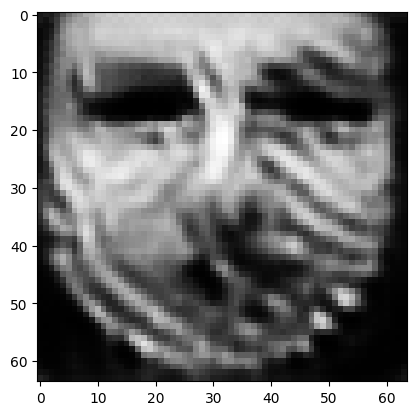

tensor([[6.2467e-06, 1.9973e-07, 9.9181e-01, 8.1052e-05, 9.0461e-05, 1.9761e-03,
         3.1755e-06, 1.4916e-04, 8.3266e-06, 2.8984e-06, 3.6068e-06, 1.5786e-05,
         1.1557e-04, 4.0456e-07, 1.2853e-09, 1.2497e-06, 2.4529e-04, 2.7981e-06,
         6.2269e-07, 1.0325e-04, 8.6539e-06, 1.2468e-06, 3.7088e-08, 4.7845e-07,
         2.9799e-05, 3.4312e-05, 1.8725e-06, 4.4021e-05, 2.0110e-03, 8.7430e-07,
         2.3129e-05, 4.2236e-08, 2.7481e-04, 3.9958e-05, 9.2202e-05, 9.6831e-09,
         2.8490e-05, 7.1849e-05, 1.7231e-03, 9.9404e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008219700306653976
tensor([[6.2438e-06, 1.9961e-07, 9.9182e-01, 8.1019e-05, 9.0403e-05, 1.9752e-03,
         3.1726e-06, 1.4908e-04, 8.3230e-06, 2.8967e-06, 3.6049e-06, 1.5781e-05,
         1.1551e-04, 4.0436e-07, 1.2844e-09, 1.2490e-06, 2.4519e-04, 2.7965e-06,
         6.2231e-07, 1.0320e-04, 8.6496e-06, 1.2462e-06, 3.7064e-08, 4.7818e-07,
         2.9779e-05, 3.4300e-05, 1.8712e-

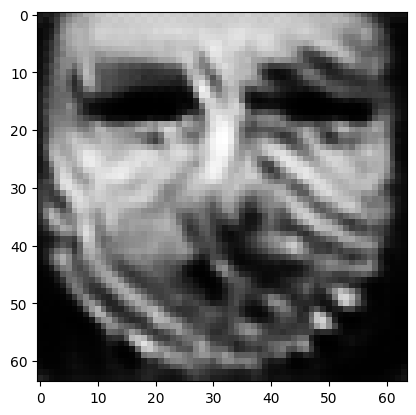

tensor([[6.2330e-06, 1.9918e-07, 9.9183e-01, 8.0897e-05, 9.0186e-05, 1.9714e-03,
         3.1618e-06, 1.4877e-04, 8.3091e-06, 2.8903e-06, 3.5976e-06, 1.5760e-05,
         1.1532e-04, 4.0362e-07, 1.2811e-09, 1.2464e-06, 2.4484e-04, 2.7904e-06,
         6.2086e-07, 1.0304e-04, 8.6334e-06, 1.2439e-06, 3.6978e-08, 4.7715e-07,
         2.9702e-05, 3.4252e-05, 1.8663e-06, 4.3896e-05, 2.0058e-03, 8.7251e-07,
         2.3098e-05, 4.2099e-08, 2.7418e-04, 3.9841e-05, 9.2042e-05, 9.6441e-09,
         2.8420e-05, 7.1734e-05, 1.7187e-03, 9.9155e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00819959957152605
tensor([[6.2303e-06, 1.9907e-07, 9.9184e-01, 8.0868e-05, 9.0132e-05, 1.9705e-03,
         3.1591e-06, 1.4869e-04, 8.3057e-06, 2.8888e-06, 3.5959e-06, 1.5755e-05,
         1.1527e-04, 4.0344e-07, 1.2802e-09, 1.2458e-06, 2.4475e-04, 2.7889e-06,
         6.2051e-07, 1.0300e-04, 8.6294e-06, 1.2433e-06, 3.6956e-08, 4.7689e-07,
         2.9683e-05, 3.4241e-05, 1.8651e-0

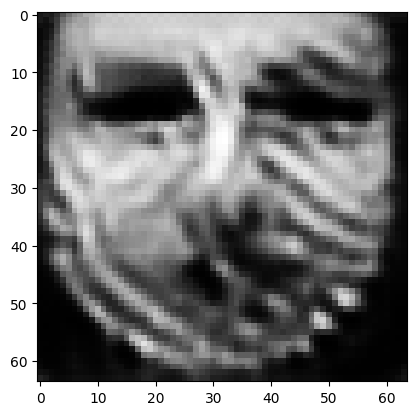

tensor([[6.2202e-06, 1.9867e-07, 9.9185e-01, 8.0755e-05, 8.9928e-05, 1.9670e-03,
         3.1489e-06, 1.4840e-04, 8.2927e-06, 2.8827e-06, 3.5891e-06, 1.5735e-05,
         1.1508e-04, 4.0277e-07, 1.2771e-09, 1.2433e-06, 2.4442e-04, 2.7832e-06,
         6.1916e-07, 1.0285e-04, 8.6141e-06, 1.2410e-06, 3.6875e-08, 4.7592e-07,
         2.9611e-05, 3.4197e-05, 1.8604e-06, 4.3780e-05, 2.0009e-03, 8.7083e-07,
         2.3070e-05, 4.1972e-08, 2.7359e-04, 3.9732e-05, 9.1893e-05, 9.6076e-09,
         2.8354e-05, 7.1629e-05, 1.7146e-03, 9.8918e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008180445991456509
tensor([[6.2178e-06, 1.9857e-07, 9.9186e-01, 8.0726e-05, 8.9878e-05, 1.9662e-03,
         3.1465e-06, 1.4833e-04, 8.2893e-06, 2.8813e-06, 3.5875e-06, 1.5730e-05,
         1.1504e-04, 4.0260e-07, 1.2763e-09, 1.2428e-06, 2.4434e-04, 2.7818e-06,
         6.1883e-07, 1.0282e-04, 8.6104e-06, 1.2405e-06, 3.6855e-08, 4.7569e-07,
         2.9593e-05, 3.4186e-05, 1.8593e-

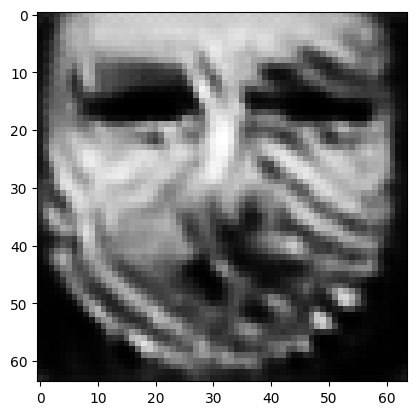

tensor([[6.2081e-06, 1.9819e-07, 9.9187e-01, 8.0621e-05, 8.9685e-05, 1.9628e-03,
         3.1367e-06, 1.4806e-04, 8.2771e-06, 2.8755e-06, 3.5810e-06, 1.5711e-05,
         1.1486e-04, 4.0197e-07, 1.2734e-09, 1.2405e-06, 2.4403e-04, 2.7764e-06,
         6.1755e-07, 1.0267e-04, 8.5960e-06, 1.2384e-06, 3.6780e-08, 4.7477e-07,
         2.9525e-05, 3.4145e-05, 1.8549e-06, 4.3670e-05, 1.9962e-03, 8.6926e-07,
         2.3044e-05, 4.1852e-08, 2.7303e-04, 3.9628e-05, 9.1754e-05, 9.5733e-09,
         2.8293e-05, 7.1530e-05, 1.7107e-03, 9.8693e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008162591606378555
tensor([[6.2057e-06, 1.9810e-07, 9.9187e-01, 8.0595e-05, 8.9637e-05, 1.9620e-03,
         3.1344e-06, 1.4799e-04, 8.2740e-06, 2.8741e-06, 3.5795e-06, 1.5707e-05,
         1.1482e-04, 4.0181e-07, 1.2726e-09, 1.2399e-06, 2.4396e-04, 2.7751e-06,
         6.1724e-07, 1.0263e-04, 8.5924e-06, 1.2379e-06, 3.6761e-08, 4.7455e-07,
         2.9509e-05, 3.4135e-05, 1.8538e-

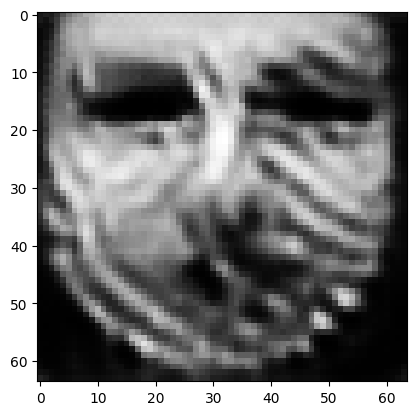

tensor([[6.1966e-06, 1.9774e-07, 9.9189e-01, 8.0495e-05, 8.9455e-05, 1.9588e-03,
         3.1252e-06, 1.4773e-04, 8.2625e-06, 2.8687e-06, 3.5735e-06, 1.5689e-05,
         1.1465e-04, 4.0122e-07, 1.2699e-09, 1.2377e-06, 2.4366e-04, 2.7701e-06,
         6.1603e-07, 1.0250e-04, 8.5789e-06, 1.2359e-06, 3.6689e-08, 4.7369e-07,
         2.9445e-05, 3.4096e-05, 1.8496e-06, 4.3567e-05, 1.9918e-03, 8.6779e-07,
         2.3019e-05, 4.1739e-08, 2.7250e-04, 3.9531e-05, 9.1622e-05, 9.5409e-09,
         2.8235e-05, 7.1437e-05, 1.7071e-03, 9.8480e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008145565167069435
tensor([[6.1944e-06, 1.9765e-07, 9.9189e-01, 8.0469e-05, 8.9411e-05, 1.9580e-03,
         3.1231e-06, 1.4767e-04, 8.2595e-06, 2.8674e-06, 3.5720e-06, 1.5685e-05,
         1.1461e-04, 4.0106e-07, 1.2692e-09, 1.2372e-06, 2.4359e-04, 2.7688e-06,
         6.1573e-07, 1.0246e-04, 8.5755e-06, 1.2354e-06, 3.6671e-08, 4.7348e-07,
         2.9429e-05, 3.4086e-05, 1.8486e-

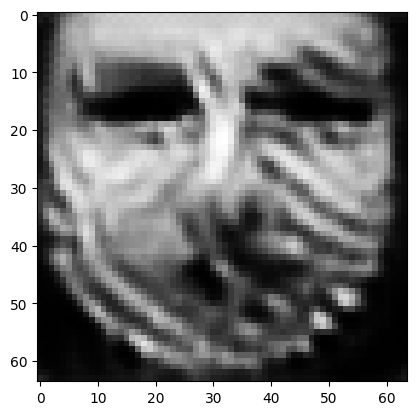

tensor([[6.1859e-06, 1.9732e-07, 9.9190e-01, 8.0375e-05, 8.9241e-05, 1.9550e-03,
         3.1145e-06, 1.4742e-04, 8.2484e-06, 2.8622e-06, 3.5664e-06, 1.5668e-05,
         1.1446e-04, 4.0051e-07, 1.2666e-09, 1.2351e-06, 2.4332e-04, 2.7642e-06,
         6.1460e-07, 1.0233e-04, 8.5628e-06, 1.2335e-06, 3.6604e-08, 4.7268e-07,
         2.9369e-05, 3.4050e-05, 1.8447e-06, 4.3470e-05, 1.9877e-03, 8.6638e-07,
         2.2996e-05, 4.1632e-08, 2.7200e-04, 3.9439e-05, 9.1497e-05, 9.5104e-09,
         2.8182e-05, 7.1349e-05, 1.7036e-03, 9.8277e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008129365742206573
tensor([[6.1838e-06, 1.9723e-07, 9.9191e-01, 8.0352e-05, 8.9198e-05, 1.9543e-03,
         3.1124e-06, 1.4736e-04, 8.2458e-06, 2.8610e-06, 3.5650e-06, 1.5664e-05,
         1.1442e-04, 4.0037e-07, 1.2659e-09, 1.2346e-06, 2.4325e-04, 2.7630e-06,
         6.1432e-07, 1.0230e-04, 8.5596e-06, 1.2331e-06, 3.6587e-08, 4.7248e-07,
         2.9354e-05, 3.4040e-05, 1.8437e-

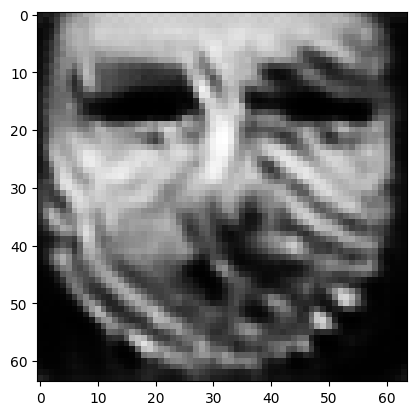

tensor([[6.1757e-06, 1.9691e-07, 9.9192e-01, 8.0259e-05, 8.9033e-05, 1.9514e-03,
         3.1042e-06, 1.4713e-04, 8.2346e-06, 2.8560e-06, 3.5596e-06, 1.5648e-05,
         1.1426e-04, 3.9983e-07, 1.2634e-09, 1.2327e-06, 2.4300e-04, 2.7585e-06,
         6.1323e-07, 1.0218e-04, 8.5472e-06, 1.2313e-06, 3.6521e-08, 4.7171e-07,
         2.9296e-05, 3.4004e-05, 1.8399e-06, 4.3377e-05, 1.9837e-03, 8.6503e-07,
         2.2972e-05, 4.1530e-08, 2.7152e-04, 3.9350e-05, 9.1377e-05, 9.4812e-09,
         2.8130e-05, 7.1264e-05, 1.7002e-03, 9.8082e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00811399333178997
tensor([[6.1737e-06, 1.9683e-07, 9.9192e-01, 8.0238e-05, 8.8993e-05, 1.9507e-03,
         3.1022e-06, 1.4707e-04, 8.2321e-06, 2.8548e-06, 3.5583e-06, 1.5644e-05,
         1.1423e-04, 3.9970e-07, 1.2628e-09, 1.2322e-06, 2.4294e-04, 2.7574e-06,
         6.1297e-07, 1.0215e-04, 8.5442e-06, 1.2308e-06, 3.6506e-08, 4.7153e-07,
         2.9282e-05, 3.3996e-05, 1.8390e-0

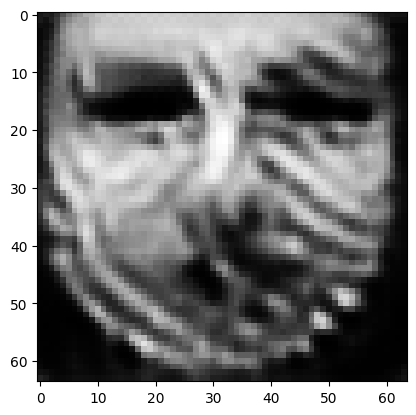

tensor([[6.1661e-06, 1.9653e-07, 9.9193e-01, 8.0154e-05, 8.8841e-05, 1.9480e-03,
         3.0946e-06, 1.4686e-04, 8.2217e-06, 2.8501e-06, 3.5533e-06, 1.5628e-05,
         1.1408e-04, 3.9921e-07, 1.2605e-09, 1.2304e-06, 2.4271e-04, 2.7533e-06,
         6.1196e-07, 1.0203e-04, 8.5329e-06, 1.2291e-06, 3.6446e-08, 4.7082e-07,
         2.9228e-05, 3.3963e-05, 1.8354e-06, 4.3289e-05, 1.9800e-03, 8.6378e-07,
         2.2951e-05, 4.1435e-08, 2.7106e-04, 3.9267e-05, 9.1265e-05, 9.4539e-09,
         2.8082e-05, 7.1186e-05, 1.6970e-03, 9.7897e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0080994488671422
tensor([[6.1642e-06, 1.9645e-07, 9.9194e-01, 8.0132e-05, 8.8804e-05, 1.9473e-03,
         3.0928e-06, 1.4680e-04, 8.2189e-06, 2.8490e-06, 3.5521e-06, 1.5625e-05,
         1.1405e-04, 3.9909e-07, 1.2599e-09, 1.2299e-06, 2.4265e-04, 2.7523e-06,
         6.1171e-07, 1.0200e-04, 8.5301e-06, 1.2287e-06, 3.6431e-08, 4.7064e-07,
         2.9215e-05, 3.3954e-05, 1.8345e-06

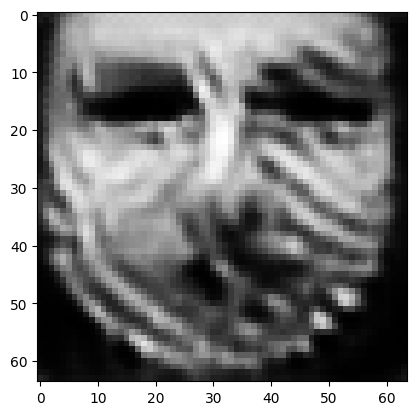

tensor([[6.1569e-06, 1.9616e-07, 9.9195e-01, 8.0050e-05, 8.8658e-05, 1.9448e-03,
         3.0856e-06, 1.4659e-04, 8.2085e-06, 2.8445e-06, 3.5473e-06, 1.5610e-05,
         1.1390e-04, 3.9861e-07, 1.2577e-09, 1.2282e-06, 2.4243e-04, 2.7484e-06,
         6.1075e-07, 1.0189e-04, 8.5193e-06, 1.2270e-06, 3.6372e-08, 4.6997e-07,
         2.9163e-05, 3.3921e-05, 1.8311e-06, 4.3205e-05, 1.9765e-03, 8.6257e-07,
         2.2928e-05, 4.1344e-08, 2.7063e-04, 3.9187e-05, 9.1158e-05, 9.4276e-09,
         2.8036e-05, 7.1110e-05, 1.6939e-03, 9.7720e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008085377514362335
tensor([[6.1552e-06, 1.9610e-07, 9.9195e-01, 8.0032e-05, 8.8625e-05, 1.9441e-03,
         3.0839e-06, 1.4654e-04, 8.2061e-06, 2.8434e-06, 3.5462e-06, 1.5606e-05,
         1.1387e-04, 3.9851e-07, 1.2572e-09, 1.2278e-06, 2.4238e-04, 2.7476e-06,
         6.1052e-07, 1.0186e-04, 8.5169e-06, 1.2267e-06, 3.6359e-08, 4.6981e-07,
         2.9151e-05, 3.3913e-05, 1.8303e-

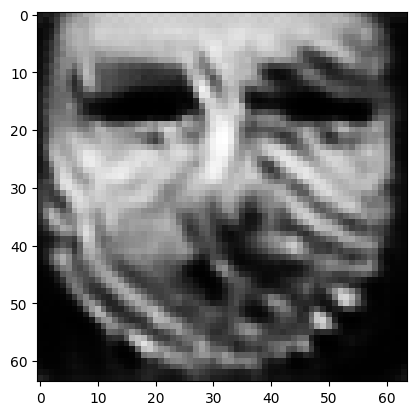

tensor([[6.1484e-06, 1.9582e-07, 9.9196e-01, 7.9955e-05, 8.8489e-05, 1.9417e-03,
         3.0771e-06, 1.4634e-04, 8.1963e-06, 2.8392e-06, 3.5417e-06, 1.5592e-05,
         1.1374e-04, 3.9806e-07, 1.2551e-09, 1.2262e-06, 2.4218e-04, 2.7440e-06,
         6.0962e-07, 1.0175e-04, 8.5069e-06, 1.2251e-06, 3.6305e-08, 4.6918e-07,
         2.9103e-05, 3.3882e-05, 1.8271e-06, 4.3126e-05, 1.9733e-03, 8.6145e-07,
         2.2908e-05, 4.1260e-08, 2.7022e-04, 3.9112e-05, 9.1061e-05, 9.4033e-09,
         2.7995e-05, 7.1041e-05, 1.6911e-03, 9.7553e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008072488009929657
tensor([[6.1467e-06, 1.9576e-07, 9.9196e-01, 7.9938e-05, 8.8456e-05, 1.9411e-03,
         3.0755e-06, 1.4630e-04, 8.1940e-06, 2.8382e-06, 3.5407e-06, 1.5589e-05,
         1.1371e-04, 3.9796e-07, 1.2546e-09, 1.2258e-06, 2.4214e-04, 2.7431e-06,
         6.0941e-07, 1.0173e-04, 8.5045e-06, 1.2247e-06, 3.6292e-08, 4.6903e-07,
         2.9092e-05, 3.3875e-05, 1.8263e-

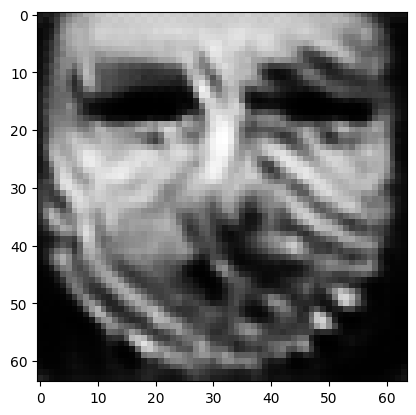

tensor([[6.1403e-06, 1.9551e-07, 9.9197e-01, 7.9870e-05, 8.8331e-05, 1.9387e-03,
         3.0692e-06, 1.4611e-04, 8.1850e-06, 2.8341e-06, 3.5365e-06, 1.5575e-05,
         1.1359e-04, 3.9757e-07, 1.2526e-09, 1.2242e-06, 2.4195e-04, 2.7398e-06,
         6.0857e-07, 1.0163e-04, 8.4952e-06, 1.2233e-06, 3.6244e-08, 4.6845e-07,
         2.9048e-05, 3.3846e-05, 1.8233e-06, 4.3052e-05, 1.9702e-03, 8.6039e-07,
         2.2889e-05, 4.1182e-08, 2.6984e-04, 3.9042e-05, 9.0971e-05, 9.3807e-09,
         2.7957e-05, 7.0977e-05, 1.6884e-03, 9.7394e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008059953339397907
tensor([[6.1388e-06, 1.9545e-07, 9.9197e-01, 7.9852e-05, 8.8300e-05, 1.9382e-03,
         3.0676e-06, 1.4607e-04, 8.1827e-06, 2.8331e-06, 3.5354e-06, 1.5572e-05,
         1.1356e-04, 3.9746e-07, 1.2522e-09, 1.2239e-06, 2.4191e-04, 2.7390e-06,
         6.0836e-07, 1.0160e-04, 8.4929e-06, 1.2229e-06, 3.6231e-08, 4.6830e-07,
         2.9037e-05, 3.3839e-05, 1.8225e-

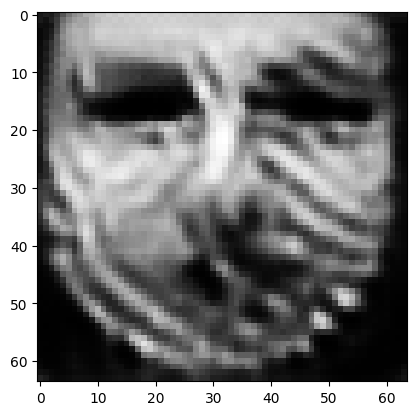

tensor([[6.1327e-06, 1.9520e-07, 9.9198e-01, 7.9786e-05, 8.8180e-05, 1.9360e-03,
         3.0617e-06, 1.4589e-04, 8.1740e-06, 2.8294e-06, 3.5315e-06, 1.5560e-05,
         1.1344e-04, 3.9707e-07, 1.2503e-09, 1.2224e-06, 2.4173e-04, 2.7358e-06,
         6.0755e-07, 1.0151e-04, 8.4839e-06, 1.2216e-06, 3.6183e-08, 4.6774e-07,
         2.8995e-05, 3.3811e-05, 1.8197e-06, 4.2982e-05, 1.9673e-03, 8.5937e-07,
         2.2870e-05, 4.1107e-08, 2.6948e-04, 3.8975e-05, 9.0882e-05, 9.3590e-09,
         2.7919e-05, 7.0914e-05, 1.6858e-03, 9.7244e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008048483170568943
tensor([[6.1313e-06, 1.9515e-07, 9.9199e-01, 7.9771e-05, 8.8151e-05, 1.9354e-03,
         3.0602e-06, 1.4585e-04, 8.1720e-06, 2.8284e-06, 3.5305e-06, 1.5557e-05,
         1.1342e-04, 3.9698e-07, 1.2499e-09, 1.2221e-06, 2.4168e-04, 2.7351e-06,
         6.0736e-07, 1.0148e-04, 8.4819e-06, 1.2212e-06, 3.6172e-08, 4.6761e-07,
         2.8985e-05, 3.3805e-05, 1.8190e-

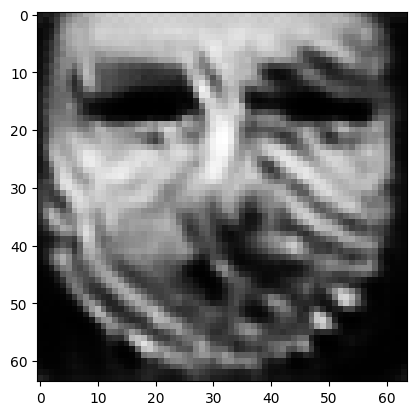

tensor([[6.1255e-06, 1.9492e-07, 9.9199e-01, 7.9708e-05, 8.8038e-05, 1.9334e-03,
         3.0546e-06, 1.4569e-04, 8.1638e-06, 2.8249e-06, 3.5267e-06, 1.5545e-05,
         1.1330e-04, 3.9661e-07, 1.2481e-09, 1.2207e-06, 2.4152e-04, 2.7321e-06,
         6.0661e-07, 1.0139e-04, 8.4734e-06, 1.2199e-06, 3.6127e-08, 4.6708e-07,
         2.8945e-05, 3.3779e-05, 1.8162e-06, 4.2916e-05, 1.9646e-03, 8.5842e-07,
         2.2853e-05, 4.1036e-08, 2.6913e-04, 3.8912e-05, 9.0801e-05, 9.3387e-09,
         2.7885e-05, 7.0856e-05, 1.6834e-03, 9.7102e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008037485182285309
tensor([[6.1241e-06, 1.9487e-07, 9.9200e-01, 7.9693e-05, 8.8010e-05, 1.9329e-03,
         3.0532e-06, 1.4564e-04, 8.1617e-06, 2.8240e-06, 3.5258e-06, 1.5542e-05,
         1.1328e-04, 3.9652e-07, 1.2477e-09, 1.2204e-06, 2.4148e-04, 2.7313e-06,
         6.0642e-07, 1.0137e-04, 8.4713e-06, 1.2196e-06, 3.6116e-08, 4.6696e-07,
         2.8935e-05, 3.3773e-05, 1.8156e-

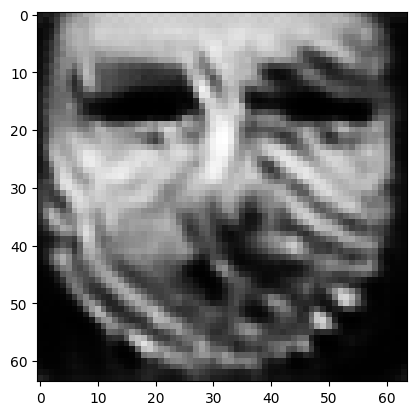

tensor([[6.1187e-06, 1.9465e-07, 9.9200e-01, 7.9634e-05, 8.7903e-05, 1.9309e-03,
         3.0479e-06, 1.4549e-04, 8.1540e-06, 2.8207e-06, 3.5222e-06, 1.5531e-05,
         1.1317e-04, 3.9617e-07, 1.2460e-09, 1.2191e-06, 2.4132e-04, 2.7285e-06,
         6.0570e-07, 1.0128e-04, 8.4634e-06, 1.2184e-06, 3.6073e-08, 4.6646e-07,
         2.8898e-05, 3.3749e-05, 1.8130e-06, 4.2852e-05, 1.9619e-03, 8.5751e-07,
         2.2837e-05, 4.0969e-08, 2.6881e-04, 3.8852e-05, 9.0723e-05, 9.3194e-09,
         2.7852e-05, 7.0799e-05, 1.6811e-03, 9.6968e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008027196861803532
tensor([[6.1174e-06, 1.9460e-07, 9.9201e-01, 7.9620e-05, 8.7877e-05, 1.9304e-03,
         3.0466e-06, 1.4545e-04, 8.1522e-06, 2.8198e-06, 3.5213e-06, 1.5528e-05,
         1.1315e-04, 3.9608e-07, 1.2456e-09, 1.2188e-06, 2.4128e-04, 2.7278e-06,
         6.0553e-07, 1.0126e-04, 8.4614e-06, 1.2181e-06, 3.6063e-08, 4.6634e-07,
         2.8889e-05, 3.3743e-05, 1.8124e-

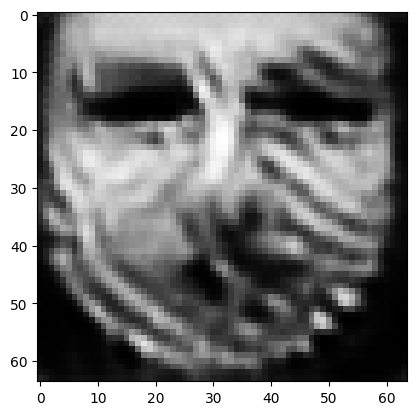

tensor([[6.1122e-06, 1.9440e-07, 9.9201e-01, 7.9564e-05, 8.7776e-05, 1.9286e-03,
         3.0416e-06, 1.4530e-04, 8.1449e-06, 2.8166e-06, 3.5179e-06, 1.5517e-05,
         1.1305e-04, 3.9575e-07, 1.2441e-09, 1.2176e-06, 2.4113e-04, 2.7251e-06,
         6.0485e-07, 1.0118e-04, 8.4540e-06, 1.2169e-06, 3.6023e-08, 4.6587e-07,
         2.8854e-05, 3.3720e-05, 1.8100e-06, 4.2793e-05, 1.9595e-03, 8.5665e-07,
         2.2821e-05, 4.0906e-08, 2.6850e-04, 3.8796e-05, 9.0650e-05, 9.3012e-09,
         2.7821e-05, 7.0746e-05, 1.6789e-03, 9.6841e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008017381653189659
tensor([[6.1110e-06, 1.9435e-07, 9.9202e-01, 7.9551e-05, 8.7751e-05, 1.9281e-03,
         3.0403e-06, 1.4526e-04, 8.1431e-06, 2.8159e-06, 3.5171e-06, 1.5514e-05,
         1.1303e-04, 3.9568e-07, 1.2437e-09, 1.2173e-06, 2.4109e-04, 2.7245e-06,
         6.0469e-07, 1.0116e-04, 8.4521e-06, 1.2167e-06, 3.6013e-08, 4.6575e-07,
         2.8845e-05, 3.3714e-05, 1.8094e-

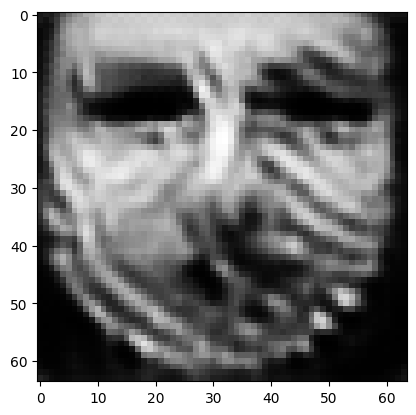

tensor([[6.1061e-06, 1.9415e-07, 9.9202e-01, 7.9497e-05, 8.7653e-05, 1.9263e-03,
         3.0355e-06, 1.4512e-04, 8.1361e-06, 2.8128e-06, 3.5139e-06, 1.5504e-05,
         1.1293e-04, 3.9536e-07, 1.2422e-09, 1.2161e-06, 2.4095e-04, 2.7219e-06,
         6.0404e-07, 1.0108e-04, 8.4449e-06, 1.2155e-06, 3.5974e-08, 4.6530e-07,
         2.8811e-05, 3.3692e-05, 1.8070e-06, 4.2736e-05, 1.9572e-03, 8.5584e-07,
         2.2807e-05, 4.0846e-08, 2.6821e-04, 3.8742e-05, 9.0579e-05, 9.2838e-09,
         2.7791e-05, 7.0696e-05, 1.6769e-03, 9.6720e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008008039556443691
tensor([[6.1049e-06, 1.9410e-07, 9.9203e-01, 7.9483e-05, 8.7630e-05, 1.9259e-03,
         3.0344e-06, 1.4509e-04, 8.1342e-06, 2.8121e-06, 3.5131e-06, 1.5502e-05,
         1.1290e-04, 3.9527e-07, 1.2418e-09, 1.2158e-06, 2.4091e-04, 2.7213e-06,
         6.0388e-07, 1.0107e-04, 8.4431e-06, 1.2153e-06, 3.5964e-08, 4.6519e-07,
         2.8803e-05, 3.3687e-05, 1.8065e-

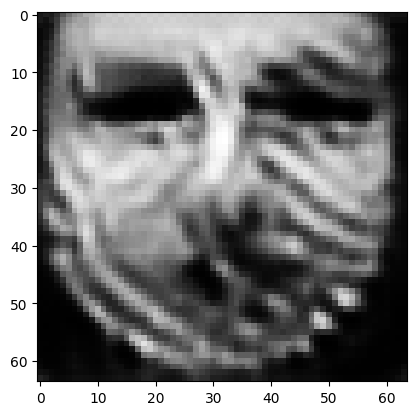

tensor([[6.1002e-06, 1.9392e-07, 9.9203e-01, 7.9433e-05, 8.7540e-05, 1.9242e-03,
         3.0299e-06, 1.4495e-04, 8.1277e-06, 2.8092e-06, 3.5100e-06, 1.5492e-05,
         1.1282e-04, 3.9498e-07, 1.2404e-09, 1.2147e-06, 2.4078e-04, 2.7189e-06,
         6.0327e-07, 1.0099e-04, 8.4364e-06, 1.2142e-06, 3.5929e-08, 4.6477e-07,
         2.8771e-05, 3.3666e-05, 1.8043e-06, 4.2683e-05, 1.9549e-03, 8.5506e-07,
         2.2792e-05, 4.0789e-08, 2.6793e-04, 3.8692e-05, 9.0513e-05, 9.2674e-09,
         2.7763e-05, 7.0648e-05, 1.6749e-03, 9.6605e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007998934015631676
tensor([[6.0991e-06, 1.9387e-07, 9.9203e-01, 7.9420e-05, 8.7517e-05, 1.9238e-03,
         3.0287e-06, 1.4492e-04, 8.1260e-06, 2.8085e-06, 3.5093e-06, 1.5490e-05,
         1.1279e-04, 3.9490e-07, 1.2401e-09, 1.2144e-06, 2.4074e-04, 2.7183e-06,
         6.0312e-07, 1.0097e-04, 8.4346e-06, 1.2140e-06, 3.5919e-08, 4.6466e-07,
         2.8763e-05, 3.3661e-05, 1.8037e-

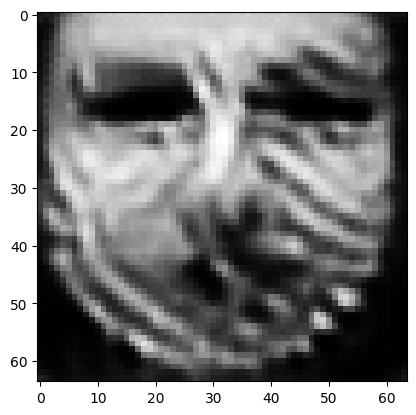

tensor([[6.0947e-06, 1.9370e-07, 9.9204e-01, 7.9373e-05, 8.7431e-05, 1.9222e-03,
         3.0245e-06, 1.4480e-04, 8.1198e-06, 2.8057e-06, 3.5064e-06, 1.5481e-05,
         1.1271e-04, 3.9462e-07, 1.2388e-09, 1.2134e-06, 2.4061e-04, 2.7160e-06,
         6.0254e-07, 1.0091e-04, 8.4283e-06, 1.2130e-06, 3.5886e-08, 4.6427e-07,
         2.8733e-05, 3.3641e-05, 1.8017e-06, 4.2632e-05, 1.9528e-03, 8.5432e-07,
         2.2779e-05, 4.0735e-08, 2.6767e-04, 3.8643e-05, 9.0450e-05, 9.2519e-09,
         2.7736e-05, 7.0602e-05, 1.6731e-03, 9.6496e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007990655489265919
tensor([[6.0936e-06, 1.9366e-07, 9.9204e-01, 7.9361e-05, 8.7409e-05, 1.9218e-03,
         3.0234e-06, 1.4476e-04, 8.1182e-06, 2.8051e-06, 3.5057e-06, 1.5478e-05,
         1.1269e-04, 3.9455e-07, 1.2384e-09, 1.2131e-06, 2.4058e-04, 2.7154e-06,
         6.0239e-07, 1.0089e-04, 8.4267e-06, 1.2127e-06, 3.5877e-08, 4.6416e-07,
         2.8726e-05, 3.3636e-05, 1.8011e-

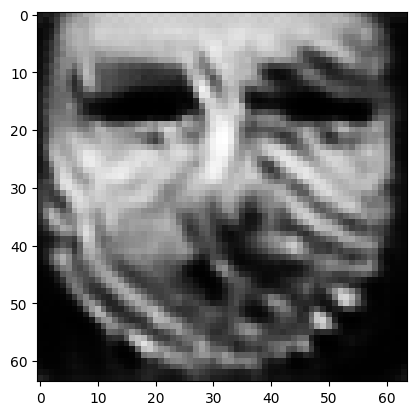

tensor([[6.0894e-06, 1.9349e-07, 9.9205e-01, 7.9316e-05, 8.7328e-05, 1.9203e-03,
         3.0194e-06, 1.4464e-04, 8.1123e-06, 2.8025e-06, 3.5029e-06, 1.5470e-05,
         1.1261e-04, 3.9428e-07, 1.2372e-09, 1.2122e-06, 2.4046e-04, 2.7132e-06,
         6.0185e-07, 1.0082e-04, 8.4207e-06, 1.2118e-06, 3.5845e-08, 4.6378e-07,
         2.8697e-05, 3.3617e-05, 1.7992e-06, 4.2583e-05, 1.9508e-03, 8.5362e-07,
         2.2766e-05, 4.0684e-08, 2.6742e-04, 3.8598e-05, 9.0390e-05, 9.2371e-09,
         2.7711e-05, 7.0559e-05, 1.6714e-03, 9.6394e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007982613518834114
tensor([[6.0884e-06, 1.9345e-07, 9.9205e-01, 7.9305e-05, 8.7309e-05, 1.9200e-03,
         3.0184e-06, 1.4461e-04, 8.1108e-06, 2.8018e-06, 3.5023e-06, 1.5467e-05,
         1.1259e-04, 3.9422e-07, 1.2368e-09, 1.2119e-06, 2.4043e-04, 2.7127e-06,
         6.0171e-07, 1.0081e-04, 8.4192e-06, 1.2116e-06, 3.5837e-08, 4.6369e-07,
         2.8691e-05, 3.3613e-05, 1.7987e-

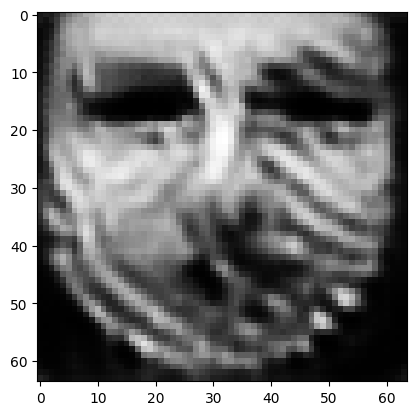

tensor([[6.0844e-06, 1.9330e-07, 9.9206e-01, 7.9261e-05, 8.7231e-05, 1.9185e-03,
         3.0145e-06, 1.4450e-04, 8.1052e-06, 2.7994e-06, 3.4996e-06, 1.5459e-05,
         1.1252e-04, 3.9396e-07, 1.2356e-09, 1.2110e-06, 2.4031e-04, 2.7107e-06,
         6.0119e-07, 1.0074e-04, 8.4134e-06, 1.2107e-06, 3.5806e-08, 4.6333e-07,
         2.8663e-05, 3.3595e-05, 1.7968e-06, 4.2537e-05, 1.9489e-03, 8.5295e-07,
         2.2754e-05, 4.0635e-08, 2.6718e-04, 3.8554e-05, 9.0333e-05, 9.2231e-09,
         2.7687e-05, 7.0517e-05, 1.6697e-03, 9.6296e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00797516293823719
tensor([[6.0835e-06, 1.9326e-07, 9.9206e-01, 7.9251e-05, 8.7212e-05, 1.9182e-03,
         3.0136e-06, 1.4447e-04, 8.1038e-06, 2.7988e-06, 3.4990e-06, 1.5457e-05,
         1.1250e-04, 3.9390e-07, 1.2353e-09, 1.2107e-06, 2.4028e-04, 2.7101e-06,
         6.0106e-07, 1.0073e-04, 8.4120e-06, 1.2105e-06, 3.5798e-08, 4.6323e-07,
         2.8657e-05, 3.3591e-05, 1.7964e-0

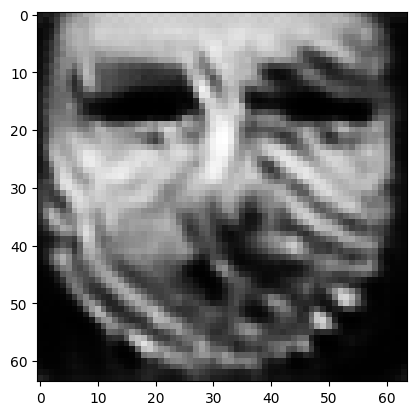

tensor([[6.0797e-06, 1.9311e-07, 9.9206e-01, 7.9210e-05, 8.7139e-05, 1.9168e-03,
         3.0099e-06, 1.4436e-04, 8.0984e-06, 2.7964e-06, 3.4965e-06, 1.5449e-05,
         1.1243e-04, 3.9365e-07, 1.2342e-09, 1.2098e-06, 2.4017e-04, 2.7082e-06,
         6.0056e-07, 1.0067e-04, 8.4065e-06, 1.2096e-06, 3.5769e-08, 4.6289e-07,
         2.8631e-05, 3.3574e-05, 1.7946e-06, 4.2494e-05, 1.9471e-03, 8.5231e-07,
         2.2742e-05, 4.0589e-08, 2.6696e-04, 3.8513e-05, 9.0278e-05, 9.2098e-09,
         2.7664e-05, 7.0478e-05, 1.6682e-03, 9.6203e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007967948913574219
tensor([[6.0788e-06, 1.9307e-07, 9.9207e-01, 7.9199e-05, 8.7120e-05, 1.9165e-03,
         3.0090e-06, 1.4434e-04, 8.0971e-06, 2.7958e-06, 3.4959e-06, 1.5447e-05,
         1.1241e-04, 3.9359e-07, 1.2339e-09, 1.2096e-06, 2.4014e-04, 2.7077e-06,
         6.0044e-07, 1.0065e-04, 8.4052e-06, 1.2094e-06, 3.5762e-08, 4.6281e-07,
         2.8624e-05, 3.3569e-05, 1.7942e-

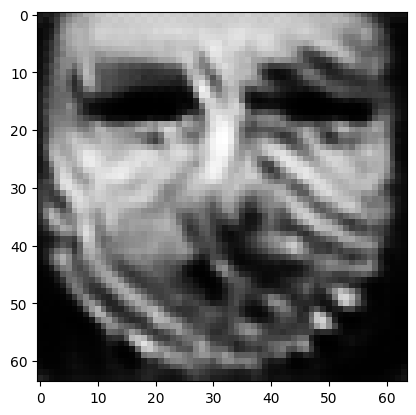

tensor([[6.0752e-06, 1.9293e-07, 9.9207e-01, 7.9161e-05, 8.7050e-05, 1.9152e-03,
         3.0056e-06, 1.4423e-04, 8.0920e-06, 2.7936e-06, 3.4935e-06, 1.5440e-05,
         1.1234e-04, 3.9336e-07, 1.2328e-09, 1.2088e-06, 2.4004e-04, 2.7059e-06,
         5.9997e-07, 1.0060e-04, 8.3999e-06, 1.2086e-06, 3.5734e-08, 4.6248e-07,
         2.8600e-05, 3.3553e-05, 1.7925e-06, 4.2452e-05, 1.9454e-03, 8.5170e-07,
         2.2731e-05, 4.0545e-08, 2.6675e-04, 3.8473e-05, 9.0227e-05, 9.1971e-09,
         2.7642e-05, 7.0441e-05, 1.6667e-03, 9.6114e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007961089722812176
tensor([[6.0743e-06, 1.9289e-07, 9.9207e-01, 7.9150e-05, 8.7033e-05, 1.9148e-03,
         3.0047e-06, 1.4421e-04, 8.0907e-06, 2.7931e-06, 3.4929e-06, 1.5438e-05,
         1.1232e-04, 3.9330e-07, 1.2326e-09, 1.2085e-06, 2.4001e-04, 2.7054e-06,
         5.9985e-07, 1.0058e-04, 8.3985e-06, 1.2084e-06, 3.5726e-08, 4.6240e-07,
         2.8594e-05, 3.3549e-05, 1.7921e-

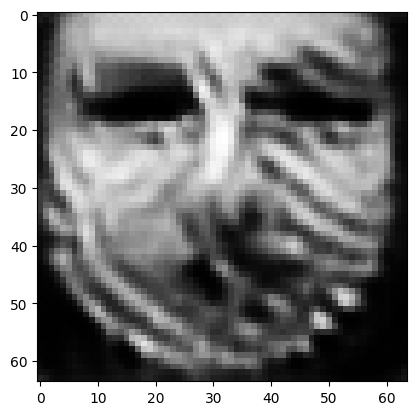

tensor([[6.0710e-06, 1.9275e-07, 9.9208e-01, 7.9112e-05, 8.6966e-05, 1.9136e-03,
         3.0014e-06, 1.4411e-04, 8.0857e-06, 2.7909e-06, 3.4906e-06, 1.5431e-05,
         1.1225e-04, 3.9307e-07, 1.2315e-09, 1.2077e-06, 2.3991e-04, 2.7036e-06,
         5.9940e-07, 1.0053e-04, 8.3935e-06, 1.2076e-06, 3.5699e-08, 4.6209e-07,
         2.8571e-05, 3.3533e-05, 1.7904e-06, 4.2412e-05, 1.9438e-03, 8.5111e-07,
         2.2720e-05, 4.0503e-08, 2.6654e-04, 3.8435e-05, 9.0177e-05, 9.1849e-09,
         2.7621e-05, 7.0405e-05, 1.6652e-03, 9.6029e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007954467087984085
tensor([[6.0702e-06, 1.9272e-07, 9.9208e-01, 7.9104e-05, 8.6949e-05, 1.9133e-03,
         3.0006e-06, 1.4409e-04, 8.0844e-06, 2.7904e-06, 3.4901e-06, 1.5429e-05,
         1.1224e-04, 3.9301e-07, 1.2313e-09, 1.2075e-06, 2.3988e-04, 2.7032e-06,
         5.9929e-07, 1.0051e-04, 8.3923e-06, 1.2074e-06, 3.5692e-08, 4.6201e-07,
         2.8565e-05, 3.3530e-05, 1.7900e-

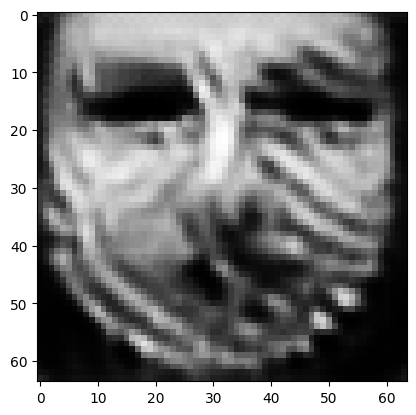

tensor([[6.0670e-06, 1.9259e-07, 9.9208e-01, 7.9068e-05, 8.6887e-05, 1.9122e-03,
         2.9975e-06, 1.4399e-04, 8.0797e-06, 2.7884e-06, 3.4879e-06, 1.5422e-05,
         1.1217e-04, 3.9281e-07, 1.2303e-09, 1.2067e-06, 2.3979e-04, 2.7016e-06,
         5.9886e-07, 1.0046e-04, 8.3876e-06, 1.2067e-06, 3.5667e-08, 4.6173e-07,
         2.8543e-05, 3.3515e-05, 1.7885e-06, 4.2375e-05, 1.9422e-03, 8.5055e-07,
         2.2709e-05, 4.0463e-08, 2.6635e-04, 3.8399e-05, 9.0131e-05, 9.1736e-09,
         2.7602e-05, 7.0371e-05, 1.6639e-03, 9.5947e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007948435842990875
tensor([[6.0662e-06, 1.9256e-07, 9.9208e-01, 7.9061e-05, 8.6872e-05, 1.9119e-03,
         2.9968e-06, 1.4397e-04, 8.0787e-06, 2.7879e-06, 3.4874e-06, 1.5420e-05,
         1.1216e-04, 3.9276e-07, 1.2301e-09, 1.2066e-06, 2.3977e-04, 2.7012e-06,
         5.9876e-07, 1.0045e-04, 8.3865e-06, 1.2065e-06, 3.5661e-08, 4.6166e-07,
         2.8538e-05, 3.3512e-05, 1.7881e-

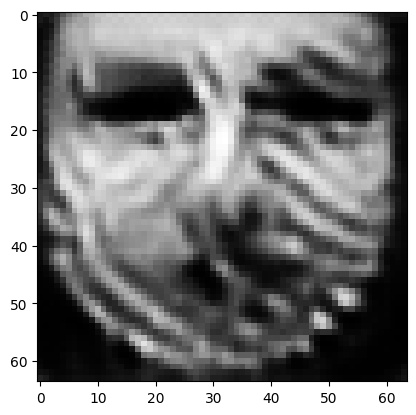

tensor([[6.0632e-06, 1.9243e-07, 9.9209e-01, 7.9027e-05, 8.6812e-05, 1.9107e-03,
         2.9938e-06, 1.4388e-04, 8.0742e-06, 2.7859e-06, 3.4854e-06, 1.5414e-05,
         1.1210e-04, 3.9256e-07, 1.2292e-09, 1.2058e-06, 2.3968e-04, 2.6996e-06,
         5.9835e-07, 1.0040e-04, 8.3820e-06, 1.2058e-06, 3.5637e-08, 4.6138e-07,
         2.8517e-05, 3.3497e-05, 1.7867e-06, 4.2339e-05, 1.9407e-03, 8.5002e-07,
         2.2700e-05, 4.0426e-08, 2.6616e-04, 3.8365e-05, 9.0087e-05, 9.1628e-09,
         2.7583e-05, 7.0339e-05, 1.6626e-03, 9.5869e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007942521944642067
tensor([[6.0625e-06, 1.9240e-07, 9.9209e-01, 7.9019e-05, 8.6797e-05, 1.9105e-03,
         2.9931e-06, 1.4386e-04, 8.0732e-06, 2.7855e-06, 3.4848e-06, 1.5412e-05,
         1.1208e-04, 3.9251e-07, 1.2289e-09, 1.2056e-06, 2.3966e-04, 2.6992e-06,
         5.9825e-07, 1.0039e-04, 8.3809e-06, 1.2056e-06, 3.5631e-08, 4.6131e-07,
         2.8512e-05, 3.3494e-05, 1.7863e-

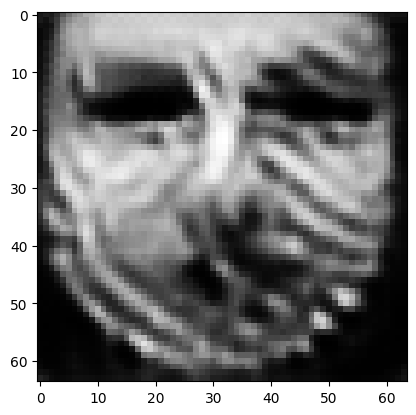

tensor([[6.0596e-06, 1.9229e-07, 9.9209e-01, 7.8987e-05, 8.6740e-05, 1.9094e-03,
         2.9903e-06, 1.4378e-04, 8.0689e-06, 2.7836e-06, 3.4829e-06, 1.5406e-05,
         1.1203e-04, 3.9232e-07, 1.2281e-09, 1.2049e-06, 2.3957e-04, 2.6977e-06,
         5.9787e-07, 1.0034e-04, 8.3766e-06, 1.2050e-06, 3.5608e-08, 4.6105e-07,
         2.8493e-05, 3.3481e-05, 1.7849e-06, 4.2306e-05, 1.9394e-03, 8.4953e-07,
         2.2691e-05, 4.0390e-08, 2.6599e-04, 3.8333e-05, 9.0046e-05, 9.1526e-09,
         2.7565e-05, 7.0309e-05, 1.6614e-03, 9.5796e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007936845533549786
tensor([[6.0590e-06, 1.9226e-07, 9.9210e-01, 7.8980e-05, 8.6728e-05, 1.9091e-03,
         2.9896e-06, 1.4376e-04, 8.0680e-06, 2.7832e-06, 3.4825e-06, 1.5404e-05,
         1.1201e-04, 3.9228e-07, 1.2279e-09, 1.2048e-06, 2.3955e-04, 2.6974e-06,
         5.9778e-07, 1.0033e-04, 8.3757e-06, 1.2048e-06, 3.5603e-08, 4.6099e-07,
         2.8489e-05, 3.3478e-05, 1.7846e-

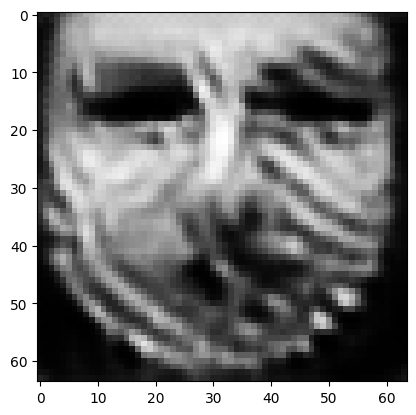

tensor([[6.0562e-06, 1.9215e-07, 9.9210e-01, 7.8950e-05, 8.6673e-05, 1.9081e-03,
         2.9869e-06, 1.4368e-04, 8.0639e-06, 2.7814e-06, 3.4806e-06, 1.5398e-05,
         1.1196e-04, 3.9211e-07, 1.2271e-09, 1.2041e-06, 2.3947e-04, 2.6959e-06,
         5.9741e-07, 1.0029e-04, 8.3716e-06, 1.2042e-06, 3.5582e-08, 4.6074e-07,
         2.8470e-05, 3.3466e-05, 1.7832e-06, 4.2274e-05, 1.9380e-03, 8.4906e-07,
         2.2682e-05, 4.0356e-08, 2.6582e-04, 3.8303e-05, 9.0006e-05, 9.1429e-09,
         2.7549e-05, 7.0280e-05, 1.6603e-03, 9.5725e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007931641303002834
tensor([[6.0556e-06, 1.9212e-07, 9.9210e-01, 7.8943e-05, 8.6660e-05, 1.9079e-03,
         2.9863e-06, 1.4366e-04, 8.0630e-06, 2.7810e-06, 3.4802e-06, 1.5397e-05,
         1.1195e-04, 3.9206e-07, 1.2269e-09, 1.2039e-06, 2.3945e-04, 2.6956e-06,
         5.9732e-07, 1.0028e-04, 8.3706e-06, 1.2040e-06, 3.5576e-08, 4.6068e-07,
         2.8465e-05, 3.3463e-05, 1.7829e-

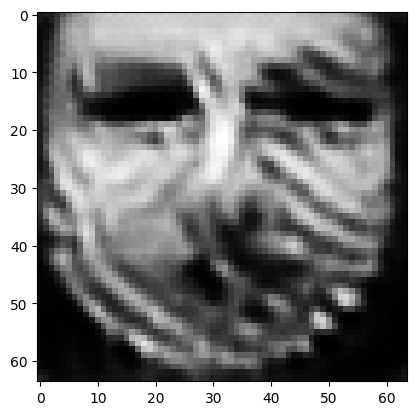

tensor([[6.0530e-06, 1.9202e-07, 9.9210e-01, 7.8915e-05, 8.6609e-05, 1.9069e-03,
         2.9837e-06, 1.4359e-04, 8.0593e-06, 2.7793e-06, 3.4785e-06, 1.5391e-05,
         1.1190e-04, 3.9190e-07, 1.2261e-09, 1.2033e-06, 2.3938e-04, 2.6943e-06,
         5.9698e-07, 1.0024e-04, 8.3668e-06, 1.2034e-06, 3.5556e-08, 4.6045e-07,
         2.8448e-05, 3.3451e-05, 1.7817e-06, 4.2244e-05, 1.9367e-03, 8.4862e-07,
         2.2674e-05, 4.0324e-08, 2.6567e-04, 3.8274e-05, 8.9969e-05, 9.1337e-09,
         2.7533e-05, 7.0253e-05, 1.6592e-03, 9.5659e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007926438003778458
tensor([[6.0524e-06, 1.9199e-07, 9.9211e-01, 7.8909e-05, 8.6597e-05, 1.9067e-03,
         2.9832e-06, 1.4357e-04, 8.0584e-06, 2.7789e-06, 3.4781e-06, 1.5389e-05,
         1.1189e-04, 3.9186e-07, 1.2259e-09, 1.2031e-06, 2.3936e-04, 2.6940e-06,
         5.9690e-07, 1.0023e-04, 8.3660e-06, 1.2033e-06, 3.5551e-08, 4.6040e-07,
         2.8444e-05, 3.3448e-05, 1.7814e-

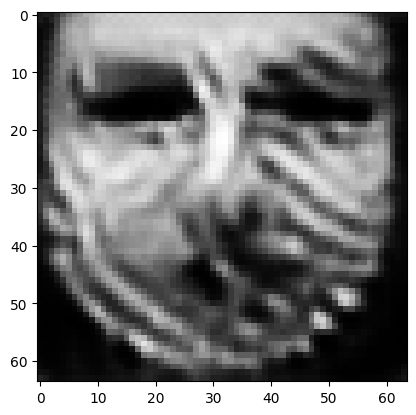

tensor([[6.0500e-06, 1.9189e-07, 9.9211e-01, 7.8881e-05, 8.6549e-05, 1.9057e-03,
         2.9807e-06, 1.4350e-04, 8.0549e-06, 2.7773e-06, 3.4764e-06, 1.5384e-05,
         1.1184e-04, 3.9170e-07, 1.2252e-09, 1.2025e-06, 2.3929e-04, 2.6926e-06,
         5.9657e-07, 1.0019e-04, 8.3624e-06, 1.2027e-06, 3.5532e-08, 4.6017e-07,
         2.8428e-05, 3.3437e-05, 1.7802e-06, 4.2216e-05, 1.9355e-03, 8.4821e-07,
         2.2667e-05, 4.0293e-08, 2.6552e-04, 3.8247e-05, 8.9934e-05, 9.1251e-09,
         2.7518e-05, 7.0227e-05, 1.6582e-03, 9.5596e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007921588607132435
tensor([[6.0494e-06, 1.9187e-07, 9.9211e-01, 7.8875e-05, 8.6537e-05, 1.9055e-03,
         2.9801e-06, 1.4348e-04, 8.0540e-06, 2.7770e-06, 3.4760e-06, 1.5383e-05,
         1.1183e-04, 3.9167e-07, 1.2250e-09, 1.2024e-06, 2.3927e-04, 2.6923e-06,
         5.9649e-07, 1.0018e-04, 8.3615e-06, 1.2026e-06, 3.5527e-08, 4.6012e-07,
         2.8424e-05, 3.3435e-05, 1.7799e-

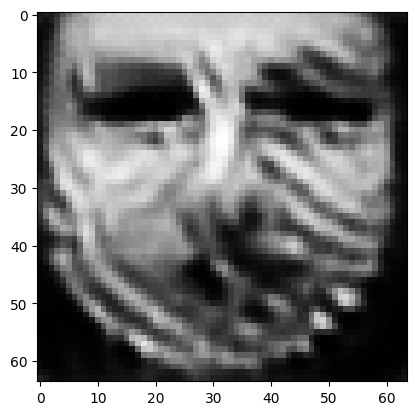

tensor([[6.0471e-06, 1.9178e-07, 9.9211e-01, 7.8851e-05, 8.6492e-05, 1.9046e-03,
         2.9779e-06, 1.4341e-04, 8.0506e-06, 2.7755e-06, 3.4745e-06, 1.5377e-05,
         1.1178e-04, 3.9152e-07, 1.2243e-09, 1.2018e-06, 2.3920e-04, 2.6912e-06,
         5.9618e-07, 1.0014e-04, 8.3581e-06, 1.2021e-06, 3.5510e-08, 4.5992e-07,
         2.8408e-05, 3.3425e-05, 1.7787e-06, 4.2189e-05, 1.9344e-03, 8.4782e-07,
         2.2660e-05, 4.0265e-08, 2.6538e-04, 3.8221e-05, 8.9901e-05, 9.1169e-09,
         2.7504e-05, 7.0203e-05, 1.6572e-03, 9.5535e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007917094975709915
tensor([[6.0465e-06, 1.9176e-07, 9.9211e-01, 7.8844e-05, 8.6481e-05, 1.9044e-03,
         2.9773e-06, 1.4340e-04, 8.0498e-06, 2.7751e-06, 3.4741e-06, 1.5376e-05,
         1.1177e-04, 3.9149e-07, 1.2241e-09, 1.2017e-06, 2.3919e-04, 2.6909e-06,
         5.9610e-07, 1.0013e-04, 8.3573e-06, 1.2019e-06, 3.5505e-08, 4.5986e-07,
         2.8404e-05, 3.3422e-05, 1.7785e-

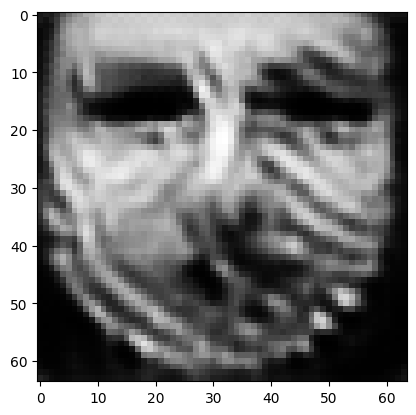

tensor([[6.0443e-06, 1.9167e-07, 9.9212e-01, 7.8821e-05, 8.6437e-05, 1.9035e-03,
         2.9751e-06, 1.4333e-04, 8.0467e-06, 2.7736e-06, 3.4726e-06, 1.5371e-05,
         1.1173e-04, 3.9135e-07, 1.2235e-09, 1.2011e-06, 2.3912e-04, 2.6897e-06,
         5.9581e-07, 1.0009e-04, 8.3541e-06, 1.2014e-06, 3.5488e-08, 4.5966e-07,
         2.8390e-05, 3.3412e-05, 1.7774e-06, 4.2163e-05, 1.9333e-03, 8.4744e-07,
         2.2653e-05, 4.0237e-08, 2.6525e-04, 3.8196e-05, 8.9869e-05, 9.1091e-09,
         2.7491e-05, 7.0180e-05, 1.6563e-03, 9.5478e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007912836968898773
tensor([[6.0437e-06, 1.9164e-07, 9.9212e-01, 7.8814e-05, 8.6426e-05, 1.9034e-03,
         2.9746e-06, 1.4332e-04, 8.0459e-06, 2.7733e-06, 3.4722e-06, 1.5370e-05,
         1.1172e-04, 3.9131e-07, 1.2233e-09, 1.2010e-06, 2.3910e-04, 2.6894e-06,
         5.9573e-07, 1.0009e-04, 8.3532e-06, 1.2013e-06, 3.5484e-08, 4.5961e-07,
         2.8386e-05, 3.3410e-05, 1.7771e-

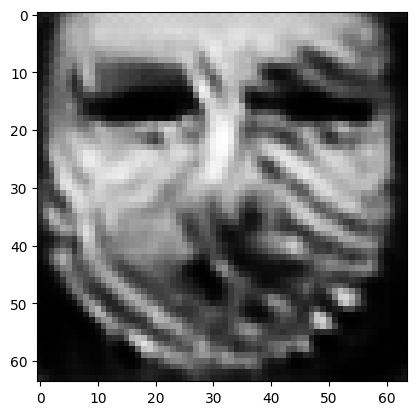

tensor([[6.0416e-06, 1.9156e-07, 9.9212e-01, 7.8791e-05, 8.6385e-05, 1.9025e-03,
         2.9725e-06, 1.4325e-04, 8.0429e-06, 2.7720e-06, 3.4708e-06, 1.5366e-05,
         1.1168e-04, 3.9118e-07, 1.2227e-09, 1.2005e-06, 2.3904e-04, 2.6883e-06,
         5.9545e-07, 1.0005e-04, 8.3502e-06, 1.2008e-06, 3.5468e-08, 4.5942e-07,
         2.8372e-05, 3.3400e-05, 1.7761e-06, 4.2138e-05, 1.9323e-03, 8.4708e-07,
         2.2647e-05, 4.0211e-08, 2.6512e-04, 3.8173e-05, 8.9839e-05, 9.1016e-09,
         2.7478e-05, 7.0157e-05, 1.6555e-03, 9.5425e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007908697240054607
tensor([[6.0411e-06, 1.9154e-07, 9.9212e-01, 7.8786e-05, 8.6375e-05, 1.9024e-03,
         2.9720e-06, 1.4324e-04, 8.0422e-06, 2.7716e-06, 3.4705e-06, 1.5364e-05,
         1.1167e-04, 3.9115e-07, 1.2225e-09, 1.2004e-06, 2.3903e-04, 2.6881e-06,
         5.9539e-07, 1.0004e-04, 8.3495e-06, 1.2007e-06, 3.5464e-08, 4.5938e-07,
         2.8369e-05, 3.3398e-05, 1.7758e-

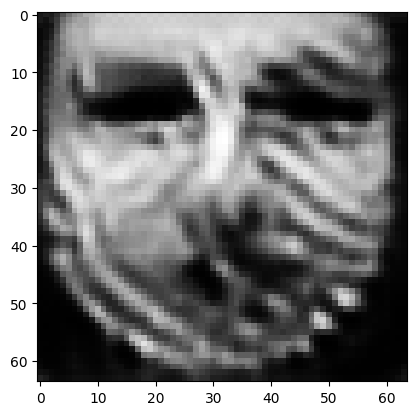

tensor([[6.0391e-06, 1.9146e-07, 9.9213e-01, 7.8764e-05, 8.6336e-05, 1.9016e-03,
         2.9701e-06, 1.4318e-04, 8.0393e-06, 2.7703e-06, 3.4692e-06, 1.5360e-05,
         1.1163e-04, 3.9102e-07, 1.2219e-09, 1.1999e-06, 2.3897e-04, 2.6870e-06,
         5.9512e-07, 1.0001e-04, 8.3466e-06, 1.2002e-06, 3.5449e-08, 4.5920e-07,
         2.8355e-05, 3.3389e-05, 1.7749e-06, 4.2115e-05, 1.9313e-03, 8.4675e-07,
         2.2640e-05, 4.0187e-08, 2.6500e-04, 3.8151e-05, 8.9811e-05, 9.0946e-09,
         2.7466e-05, 7.0136e-05, 1.6546e-03, 9.5373e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007904676720499992
tensor([[6.0386e-06, 1.9144e-07, 9.9213e-01, 7.8759e-05, 8.6326e-05, 1.9014e-03,
         2.9696e-06, 1.4317e-04, 8.0386e-06, 2.7700e-06, 3.4688e-06, 1.5359e-05,
         1.1162e-04, 3.9099e-07, 1.2218e-09, 1.1997e-06, 2.3896e-04, 2.6868e-06,
         5.9505e-07, 1.0000e-04, 8.3459e-06, 1.2001e-06, 3.5444e-08, 4.5915e-07,
         2.8352e-05, 3.3387e-05, 1.7746e-

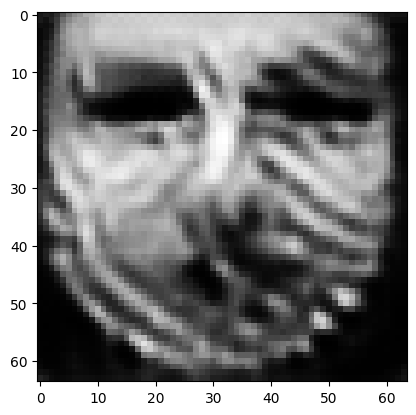

tensor([[6.0367e-06, 1.9136e-07, 9.9213e-01, 7.8737e-05, 8.6289e-05, 1.9007e-03,
         2.9677e-06, 1.4311e-04, 8.0358e-06, 2.7688e-06, 3.4676e-06, 1.5355e-05,
         1.1159e-04, 3.9086e-07, 1.2212e-09, 1.1993e-06, 2.3890e-04, 2.6858e-06,
         5.9480e-07, 9.9973e-05, 8.3431e-06, 1.1997e-06, 3.5430e-08, 4.5898e-07,
         2.8339e-05, 3.3378e-05, 1.7737e-06, 4.2093e-05, 1.9304e-03, 8.4642e-07,
         2.2634e-05, 4.0164e-08, 2.6489e-04, 3.8130e-05, 8.9784e-05, 9.0878e-09,
         2.7454e-05, 7.0116e-05, 1.6539e-03, 9.5325e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007901246659457684
tensor([[6.0362e-06, 1.9134e-07, 9.9213e-01, 7.8732e-05, 8.6280e-05, 1.9005e-03,
         2.9673e-06, 1.4310e-04, 8.0352e-06, 2.7685e-06, 3.4672e-06, 1.5354e-05,
         1.1158e-04, 3.9083e-07, 1.2211e-09, 1.1991e-06, 2.3888e-04, 2.6855e-06,
         5.9473e-07, 9.9966e-05, 8.3424e-06, 1.1996e-06, 3.5426e-08, 4.5893e-07,
         2.8336e-05, 3.3376e-05, 1.7735e-

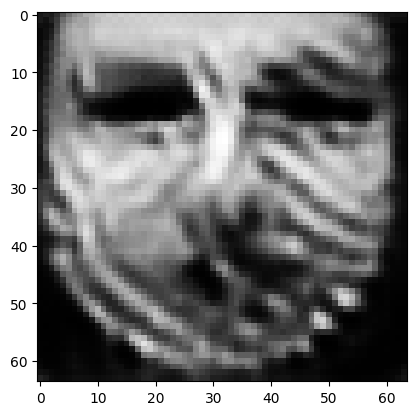

tensor([[6.0344e-06, 1.9127e-07, 9.9213e-01, 7.8712e-05, 8.6245e-05, 1.8999e-03,
         2.9655e-06, 1.4304e-04, 8.0326e-06, 2.7673e-06, 3.4660e-06, 1.5350e-05,
         1.1154e-04, 3.9072e-07, 1.2205e-09, 1.1987e-06, 2.3883e-04, 2.6846e-06,
         5.9449e-07, 9.9937e-05, 8.3398e-06, 1.1992e-06, 3.5412e-08, 4.5877e-07,
         2.8324e-05, 3.3368e-05, 1.7726e-06, 4.2071e-05, 1.9295e-03, 8.4611e-07,
         2.2628e-05, 4.0141e-08, 2.6478e-04, 3.8110e-05, 8.9758e-05, 9.0815e-09,
         2.7443e-05, 7.0096e-05, 1.6531e-03, 9.5279e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007897698320448399
tensor([[6.0340e-06, 1.9125e-07, 9.9213e-01, 7.8707e-05, 8.6237e-05, 1.8997e-03,
         2.9651e-06, 1.4303e-04, 8.0319e-06, 2.7671e-06, 3.4657e-06, 1.5349e-05,
         1.1153e-04, 3.9068e-07, 1.2204e-09, 1.1986e-06, 2.3882e-04, 2.6844e-06,
         5.9443e-07, 9.9929e-05, 8.3392e-06, 1.1991e-06, 3.5408e-08, 4.5873e-07,
         2.8321e-05, 3.3366e-05, 1.7724e-

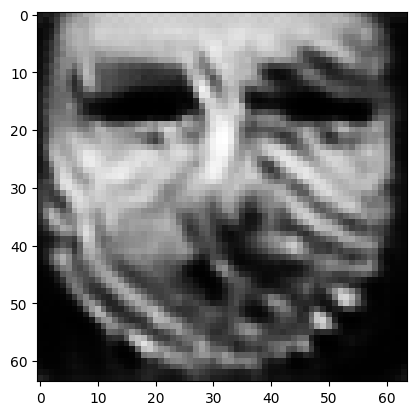

tensor([[6.0323e-06, 1.9118e-07, 9.9214e-01, 7.8688e-05, 8.6204e-05, 1.8991e-03,
         2.9634e-06, 1.4298e-04, 8.0295e-06, 2.7659e-06, 3.4646e-06, 1.5345e-05,
         1.1150e-04, 3.9058e-07, 1.2199e-09, 1.1982e-06, 2.3877e-04, 2.6835e-06,
         5.9420e-07, 9.9901e-05, 8.3367e-06, 1.1987e-06, 3.5395e-08, 4.5857e-07,
         2.8310e-05, 3.3358e-05, 1.7716e-06, 4.2051e-05, 1.9287e-03, 8.4582e-07,
         2.2623e-05, 4.0120e-08, 2.6468e-04, 3.8091e-05, 8.9734e-05, 9.0754e-09,
         2.7432e-05, 7.0078e-05, 1.6525e-03, 9.5236e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007894386537373066
tensor([[6.0318e-06, 1.9116e-07, 9.9214e-01, 7.8683e-05, 8.6196e-05, 1.8989e-03,
         2.9630e-06, 1.4297e-04, 8.0289e-06, 2.7657e-06, 3.4643e-06, 1.5344e-05,
         1.1149e-04, 3.9055e-07, 1.2198e-09, 1.1981e-06, 2.3875e-04, 2.6833e-06,
         5.9415e-07, 9.9895e-05, 8.3361e-06, 1.1986e-06, 3.5392e-08, 4.5853e-07,
         2.8307e-05, 3.3356e-05, 1.7714e-

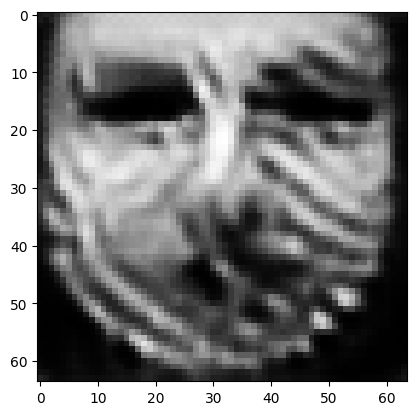

tensor([[6.0302e-06, 1.9110e-07, 9.9214e-01, 7.8665e-05, 8.6164e-05, 1.8983e-03,
         2.9614e-06, 1.4292e-04, 8.0265e-06, 2.7646e-06, 3.4632e-06, 1.5341e-05,
         1.1146e-04, 3.9044e-07, 1.2193e-09, 1.1977e-06, 2.3870e-04, 2.6824e-06,
         5.9393e-07, 9.9869e-05, 8.3337e-06, 1.1982e-06, 3.5379e-08, 4.5839e-07,
         2.8296e-05, 3.3349e-05, 1.7706e-06, 4.2032e-05, 1.9279e-03, 8.4553e-07,
         2.2617e-05, 4.0100e-08, 2.6458e-04, 3.8072e-05, 8.9710e-05, 9.0696e-09,
         2.7422e-05, 7.0060e-05, 1.6518e-03, 9.5195e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007891311310231686
tensor([[6.0298e-06, 1.9108e-07, 9.9214e-01, 7.8661e-05, 8.6156e-05, 1.8982e-03,
         2.9611e-06, 1.4291e-04, 8.0260e-06, 2.7644e-06, 3.4629e-06, 1.5340e-05,
         1.1145e-04, 3.9041e-07, 1.2192e-09, 1.1976e-06, 2.3869e-04, 2.6822e-06,
         5.9387e-07, 9.9862e-05, 8.3331e-06, 1.1981e-06, 3.5376e-08, 4.5835e-07,
         2.8293e-05, 3.3347e-05, 1.7704e-

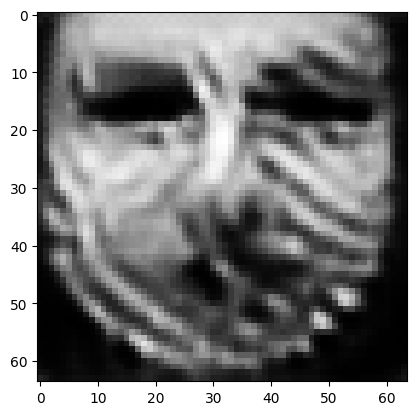

tensor([[6.0282e-06, 1.9101e-07, 9.9214e-01, 7.8643e-05, 8.6126e-05, 1.8976e-03,
         2.9596e-06, 1.4287e-04, 8.0237e-06, 2.7634e-06, 3.4619e-06, 1.5336e-05,
         1.1142e-04, 3.9031e-07, 1.2187e-09, 1.1972e-06, 2.3864e-04, 2.6814e-06,
         5.9366e-07, 9.9837e-05, 8.3308e-06, 1.1977e-06, 3.5364e-08, 4.5821e-07,
         2.8283e-05, 3.3340e-05, 1.7696e-06, 4.2014e-05, 1.9271e-03, 8.4526e-07,
         2.2612e-05, 4.0081e-08, 2.6448e-04, 3.8055e-05, 8.9688e-05, 9.0641e-09,
         2.7412e-05, 7.0043e-05, 1.6512e-03, 9.5156e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00788823701441288
tensor([[6.0279e-06, 1.9100e-07, 9.9214e-01, 7.8639e-05, 8.6119e-05, 1.8975e-03,
         2.9592e-06, 1.4285e-04, 8.0232e-06, 2.7631e-06, 3.4616e-06, 1.5335e-05,
         1.1142e-04, 3.9029e-07, 1.2186e-09, 1.1971e-06, 2.3863e-04, 2.6812e-06,
         5.9361e-07, 9.9831e-05, 8.3303e-06, 1.1977e-06, 3.5361e-08, 4.5817e-07,
         2.8281e-05, 3.3338e-05, 1.7695e-0

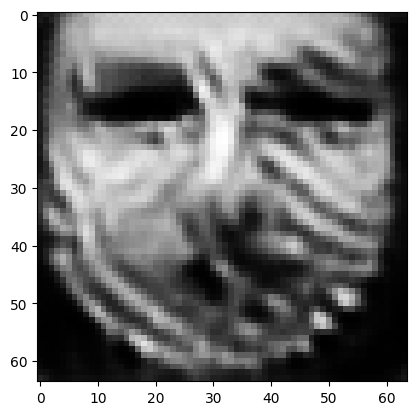

tensor([[6.0264e-06, 1.9094e-07, 9.9215e-01, 7.8623e-05, 8.6091e-05, 1.8969e-03,
         2.9578e-06, 1.4281e-04, 8.0211e-06, 2.7622e-06, 3.4606e-06, 1.5332e-05,
         1.1139e-04, 3.9019e-07, 1.2181e-09, 1.1967e-06, 2.3859e-04, 2.6805e-06,
         5.9342e-07, 9.9807e-05, 8.3282e-06, 1.1973e-06, 3.5350e-08, 4.5804e-07,
         2.8271e-05, 3.3331e-05, 1.7687e-06, 4.1996e-05, 1.9264e-03, 8.4501e-07,
         2.2607e-05, 4.0063e-08, 2.6440e-04, 3.8039e-05, 8.9668e-05, 9.0590e-09,
         2.7403e-05, 7.0028e-05, 1.6506e-03, 9.5118e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007885398343205452
tensor([[6.0260e-06, 1.9092e-07, 9.9215e-01, 7.8618e-05, 8.6083e-05, 1.8968e-03,
         2.9574e-06, 1.4280e-04, 8.0205e-06, 2.7619e-06, 3.4604e-06, 1.5331e-05,
         1.1138e-04, 3.9016e-07, 1.2180e-09, 1.1966e-06, 2.3858e-04, 2.6803e-06,
         5.9337e-07, 9.9801e-05, 8.3276e-06, 1.1972e-06, 3.5346e-08, 4.5800e-07,
         2.8268e-05, 3.3329e-05, 1.7686e-

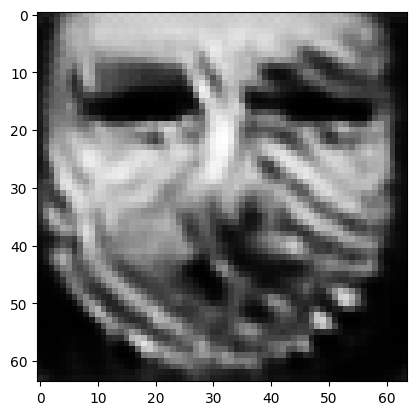

tensor([[6.0246e-06, 1.9087e-07, 9.9215e-01, 7.8603e-05, 8.6056e-05, 1.8962e-03,
         2.9560e-06, 1.4276e-04, 8.0185e-06, 2.7610e-06, 3.4594e-06, 1.5328e-05,
         1.1135e-04, 3.9007e-07, 1.2176e-09, 1.1963e-06, 2.3854e-04, 2.6795e-06,
         5.9318e-07, 9.9778e-05, 8.3255e-06, 1.1969e-06, 3.5336e-08, 4.5787e-07,
         2.8259e-05, 3.3323e-05, 1.7679e-06, 4.1980e-05, 1.9257e-03, 8.4476e-07,
         2.2603e-05, 4.0045e-08, 2.6431e-04, 3.8023e-05, 8.9647e-05, 9.0539e-09,
         2.7394e-05, 7.0012e-05, 1.6500e-03, 9.5083e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007882559671998024
tensor([[6.0243e-06, 1.9085e-07, 9.9215e-01, 7.8599e-05, 8.6049e-05, 1.8961e-03,
         2.9557e-06, 1.4275e-04, 8.0180e-06, 2.7608e-06, 3.4592e-06, 1.5327e-05,
         1.1135e-04, 3.9005e-07, 1.2175e-09, 1.1962e-06, 2.3853e-04, 2.6794e-06,
         5.9313e-07, 9.9772e-05, 8.3250e-06, 1.1968e-06, 3.5333e-08, 4.5785e-07,
         2.8257e-05, 3.3322e-05, 1.7677e-

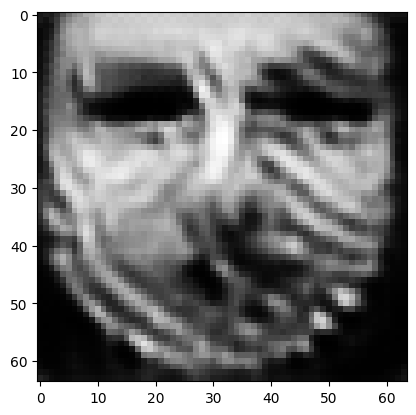

tensor([[6.0229e-06, 1.9080e-07, 9.9215e-01, 7.8584e-05, 8.6024e-05, 1.8956e-03,
         2.9544e-06, 1.4271e-04, 8.0161e-06, 2.7599e-06, 3.4583e-06, 1.5324e-05,
         1.1132e-04, 3.8997e-07, 1.2171e-09, 1.1958e-06, 2.3849e-04, 2.6787e-06,
         5.9295e-07, 9.9751e-05, 8.3231e-06, 1.1965e-06, 3.5323e-08, 4.5772e-07,
         2.8248e-05, 3.3316e-05, 1.7671e-06, 4.1964e-05, 1.9251e-03, 8.4453e-07,
         2.2598e-05, 4.0029e-08, 2.6423e-04, 3.8008e-05, 8.9628e-05, 9.0492e-09,
         2.7386e-05, 6.9998e-05, 1.6495e-03, 9.5048e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0078801941126585
tensor([[6.0226e-06, 1.9078e-07, 9.9215e-01, 7.8581e-05, 8.6018e-05, 1.8955e-03,
         2.9541e-06, 1.4270e-04, 8.0156e-06, 2.7597e-06, 3.4580e-06, 1.5324e-05,
         1.1131e-04, 3.8994e-07, 1.2170e-09, 1.1958e-06, 2.3848e-04, 2.6785e-06,
         5.9291e-07, 9.9746e-05, 8.3226e-06, 1.1964e-06, 3.5320e-08, 4.5769e-07,
         2.8246e-05, 3.3314e-05, 1.7669e-06

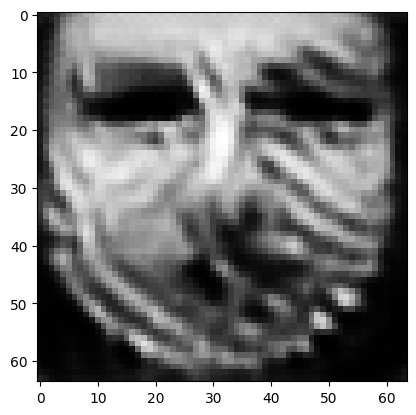

tensor([[6.0213e-06, 1.9073e-07, 9.9215e-01, 7.8566e-05, 8.5993e-05, 1.8950e-03,
         2.9529e-06, 1.4266e-04, 8.0138e-06, 2.7589e-06, 3.4572e-06, 1.5321e-05,
         1.1129e-04, 3.8986e-07, 1.2166e-09, 1.1954e-06, 2.3844e-04, 2.6779e-06,
         5.9274e-07, 9.9725e-05, 8.3208e-06, 1.1962e-06, 3.5310e-08, 4.5758e-07,
         2.8237e-05, 3.3308e-05, 1.7663e-06, 4.1949e-05, 1.9245e-03, 8.4431e-07,
         2.2594e-05, 4.0013e-08, 2.6415e-04, 3.7994e-05, 8.9610e-05, 9.0448e-09,
         2.7379e-05, 6.9984e-05, 1.6490e-03, 9.5016e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007877710275352001
tensor([[6.0210e-06, 1.9072e-07, 9.9215e-01, 7.8563e-05, 8.5987e-05, 1.8949e-03,
         2.9526e-06, 1.4266e-04, 8.0134e-06, 2.7587e-06, 3.4570e-06, 1.5320e-05,
         1.1128e-04, 3.8984e-07, 1.2165e-09, 1.1954e-06, 2.3843e-04, 2.6777e-06,
         5.9270e-07, 9.9720e-05, 8.3203e-06, 1.1961e-06, 3.5308e-08, 4.5755e-07,
         2.8235e-05, 3.3307e-05, 1.7662e-

In [13]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=2)

tensor([[2.5848e-04, 4.0420e-05, 9.8727e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8280e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2035e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.563106060028076


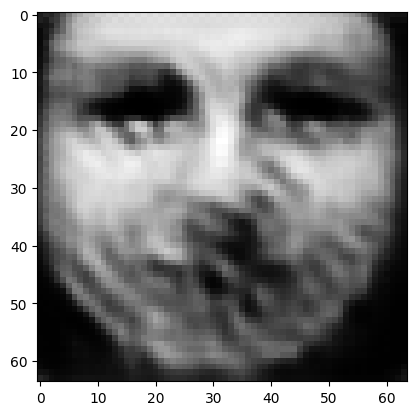

tensor([[6.0164e-05, 1.4357e-04, 2.2521e-03, 2.2707e-03, 5.8037e-02, 5.1814e-05,
         3.6497e-04, 9.7788e-05, 3.9037e-04, 5.5482e-06, 2.6539e-05, 5.6083e-05,
         1.6799e-02, 7.4275e-03, 1.2609e-04, 6.8695e-06, 9.3037e-03, 1.5024e-03,
         3.0884e-04, 5.9387e-05, 1.1870e-02, 8.4353e-05, 3.3573e-01, 7.6910e-05,
         3.2178e-01, 1.8216e-02, 1.0511e-04, 4.1380e-04, 5.8203e-04, 1.5565e-03,
         6.1831e-04, 3.3231e-04, 7.2675e-03, 3.9134e-03, 1.3687e-02, 4.6106e-03,
         1.5775e-01, 3.3853e-03, 1.6394e-02, 2.3334e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  6.087676048278809
tensor([[3.9846e-04, 3.0290e-04, 1.1001e-01, 7.2946e-03, 2.0190e-02, 1.4670e-02,
         5.1086e-03, 6.6652e-03, 8.2429e-04, 2.8800e-04, 2.6678e-04, 1.0582e-04,
         5.4814e-02, 1.2755e-04, 1.8693e-05, 1.2700e-04, 2.6850e-02, 1.3516e-03,
         9.3680e-04, 1.3352e-02, 1.2389e-03, 6.4053e-05, 2.0687e-04, 2.9530e-04,
         3.7571e-02, 1.9565e-03, 8.2049e-04,

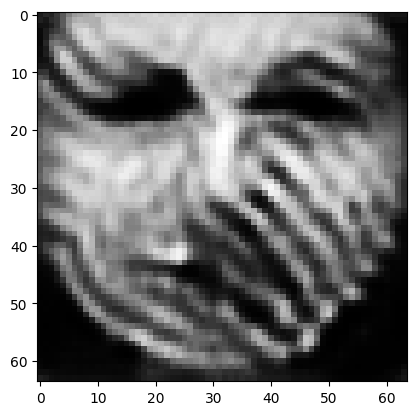

tensor([[3.2080e-05, 2.0127e-03, 1.0503e-03, 9.6577e-01, 1.1907e-05, 1.3139e-04,
         1.4178e-06, 1.9848e-04, 1.3144e-03, 4.6480e-06, 2.9385e-05, 4.1214e-05,
         6.9790e-03, 4.4559e-04, 1.2759e-05, 5.9113e-06, 1.9066e-04, 4.0228e-05,
         4.4735e-05, 9.0679e-05, 2.2169e-05, 1.5296e-06, 2.6553e-04, 1.1386e-05,
         3.9014e-04, 1.1547e-03, 1.5784e-05, 7.0345e-05, 4.6918e-05, 1.2075e-04,
         1.7400e-02, 2.6598e-05, 2.2123e-04, 1.7386e-05, 4.6103e-04, 1.7297e-04,
         8.2742e-05, 9.9789e-04, 9.7899e-05, 1.8371e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03483229875564575
tensor([[3.2236e-05, 1.7627e-03, 9.5152e-04, 9.7258e-01, 1.0293e-05, 1.2753e-04,
         1.2583e-06, 1.9111e-04, 1.1063e-03, 3.9717e-06, 2.5364e-05, 3.4995e-05,
         5.8672e-03, 3.7101e-04, 1.1569e-05, 5.4660e-06, 1.7029e-04, 3.5264e-05,
         4.2262e-05, 8.1278e-05, 1.7976e-05, 1.3112e-06, 2.0082e-04, 1.0401e-05,
         3.5114e-04, 9.4917e-04, 1.3888e-0

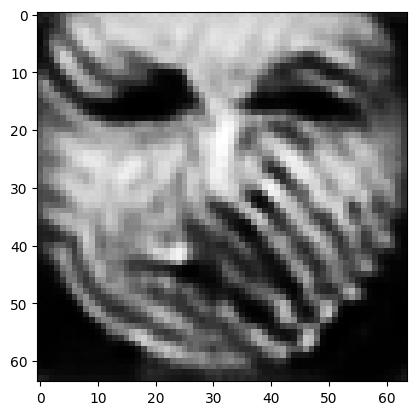

tensor([[3.1788e-05, 1.3260e-03, 7.5895e-04, 9.8251e-01, 7.5058e-06, 1.1834e-04,
         9.7131e-07, 1.7270e-04, 7.9080e-04, 2.8891e-06, 1.8515e-05, 2.4589e-05,
         4.1221e-03, 2.5185e-04, 9.5565e-06, 4.6636e-06, 1.3328e-04, 2.6583e-05,
         3.7418e-05, 6.5428e-05, 1.1940e-05, 9.4722e-07, 1.1274e-04, 8.5677e-06,
         2.8055e-04, 6.1755e-04, 1.0807e-05, 4.2143e-05, 3.3131e-05, 6.9659e-05,
         6.9424e-03, 2.0134e-05, 1.2479e-04, 8.5569e-06, 3.5637e-04, 1.0302e-04,
         4.2229e-05, 7.3106e-04, 5.5859e-05, 9.2164e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017640363425016403
tensor([[3.1972e-05, 1.2693e-03, 7.3465e-04, 9.8370e-01, 7.1294e-06, 1.1771e-04,
         9.3743e-07, 1.7073e-04, 7.5148e-04, 2.7631e-06, 1.7658e-05, 2.3274e-05,
         3.8851e-03, 2.3628e-04, 9.2377e-06, 4.5752e-06, 1.2810e-04, 2.5405e-05,
         3.6901e-05, 6.3494e-05, 1.1164e-05, 9.0182e-07, 1.0180e-04, 8.3142e-06,
         2.6876e-04, 5.7450e-04, 1.0443e-

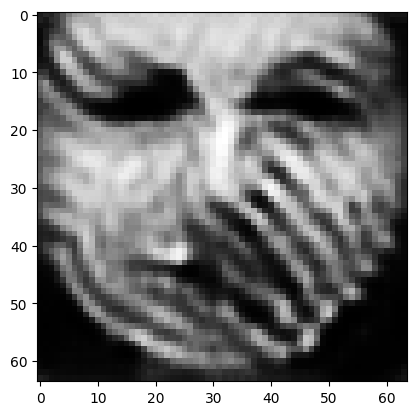

tensor([[3.2492e-05, 1.1110e-03, 6.5924e-04, 9.8690e-01, 5.9918e-06, 1.1467e-04,
         8.3151e-07, 1.6399e-04, 6.3962e-04, 2.3873e-06, 1.5108e-05, 1.9528e-05,
         3.2135e-03, 1.9186e-04, 8.2642e-06, 4.2642e-06, 1.1264e-04, 2.1868e-05,
         3.5266e-05, 5.7688e-05, 9.0322e-06, 7.6987e-07, 7.3471e-05, 7.5050e-06,
         2.3396e-04, 4.5647e-04, 9.2986e-06, 3.4043e-05, 2.8705e-05, 5.5565e-05,
         4.5416e-03, 1.7614e-05, 9.6381e-05, 6.1612e-06, 3.2041e-04, 7.8772e-05,
         3.0791e-05, 6.4117e-04, 4.3187e-05, 6.8566e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013188627548515797
tensor([[3.2438e-05, 1.0806e-03, 6.4358e-04, 9.8747e-01, 5.7806e-06, 1.1356e-04,
         8.0933e-07, 1.6224e-04, 6.1763e-04, 2.3129e-06, 1.4578e-05, 1.8826e-05,
         3.0843e-03, 1.8386e-04, 8.0626e-06, 4.1874e-06, 1.0961e-04, 2.1185e-05,
         3.4856e-05, 5.6492e-05, 8.6496e-06, 7.4386e-07, 6.8717e-05, 7.3224e-06,
         2.2712e-04, 4.3593e-04, 9.0504e-

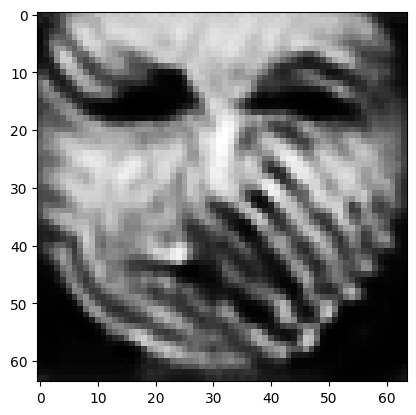

tensor([[3.2069e-05, 9.8191e-04, 5.9041e-04, 9.8923e-01, 5.0817e-06, 1.0861e-04,
         7.3427e-07, 1.5590e-04, 5.4381e-04, 2.0618e-06, 1.2834e-05, 1.6547e-05,
         2.6669e-03, 1.5853e-04, 7.3869e-06, 3.9128e-06, 9.9481e-05, 1.9008e-05,
         3.3394e-05, 5.2136e-05, 7.4001e-06, 6.5714e-07, 5.4700e-05, 6.7442e-06,
         2.0494e-04, 3.7216e-04, 8.2236e-06, 2.8986e-05, 2.5561e-05, 4.6909e-05,
         3.4155e-03, 1.5918e-05, 7.9662e-05, 4.8956e-06, 2.9421e-04, 6.5878e-05,
         2.4974e-05, 5.8318e-04, 3.6003e-05, 5.5077e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010831255465745926
tensor([[3.1996e-05, 9.6077e-04, 5.7966e-04, 9.8957e-01, 4.9407e-06, 1.0748e-04,
         7.1846e-07, 1.5445e-04, 5.2907e-04, 2.0108e-06, 1.2468e-05, 1.6093e-05,
         2.5808e-03, 1.5336e-04, 7.2365e-06, 3.8535e-06, 9.7320e-05, 1.8554e-05,
         3.3060e-05, 5.1190e-05, 7.1487e-06, 6.3968e-07, 5.2058e-05, 6.6257e-06,
         2.0022e-04, 3.5942e-04, 8.0545e-

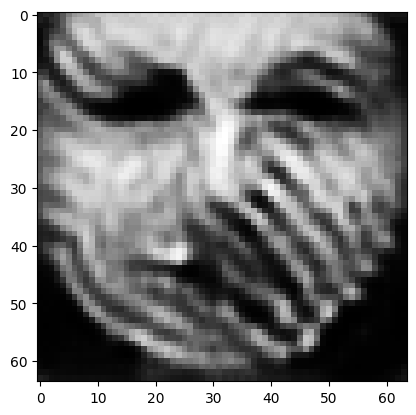

tensor([[3.1788e-05, 8.8716e-04, 5.4451e-04, 9.9070e-01, 4.5013e-06, 1.0350e-04,
         6.6749e-07, 1.4988e-04, 4.7917e-04, 1.8425e-06, 1.1283e-05, 1.4571e-05,
         2.2997e-03, 1.3642e-04, 6.7211e-06, 3.6531e-06, 9.0635e-05, 1.7102e-05,
         3.1863e-05, 4.8090e-05, 6.3297e-06, 5.8425e-07, 4.3843e-05, 6.2563e-06,
         1.8559e-04, 3.1893e-04, 7.4599e-06, 2.5483e-05, 2.3385e-05, 4.0925e-05,
         2.7553e-03, 1.4636e-05, 6.8849e-05, 4.1166e-06, 2.7400e-04, 5.7440e-05,
         2.1344e-05, 5.4458e-04, 3.1213e-05, 4.6530e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009341342374682426
tensor([[3.1714e-05, 8.7156e-04, 5.3710e-04, 9.9092e-01, 4.4135e-06, 1.0252e-04,
         6.5676e-07, 1.4888e-04, 4.6889e-04, 1.8067e-06, 1.1038e-05, 1.4252e-05,
         2.2449e-03, 1.3308e-04, 6.6172e-06, 3.6079e-06, 8.9281e-05, 1.6800e-05,
         3.1578e-05, 4.7444e-05, 6.1651e-06, 5.7288e-07, 4.2290e-05, 6.1817e-06,
         1.8273e-04, 3.1098e-04, 7.3274e-

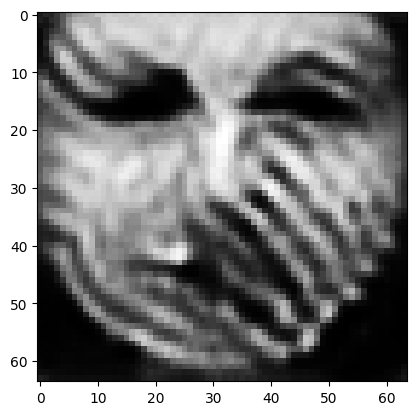

tensor([[3.1391e-05, 8.1497e-04, 5.1039e-04, 9.9169e-01, 4.1043e-06, 9.8855e-05,
         6.1696e-07, 1.4549e-04, 4.3388e-04, 1.6771e-06, 1.0200e-05, 1.3154e-05,
         2.0505e-03, 1.2154e-04, 6.2399e-06, 3.4436e-06, 8.4607e-05, 1.5793e-05,
         3.0504e-05, 4.5216e-05, 5.6080e-06, 5.3335e-07, 3.7254e-05, 5.8993e-06,
         1.7273e-04, 2.8340e-04, 6.8497e-06, 2.2949e-05, 2.1654e-05, 3.6668e-05,
         2.3424e-03, 1.3727e-05, 6.1595e-05, 3.6102e-06, 2.5929e-04, 5.1816e-05,
         1.8943e-05, 5.1464e-04, 2.7962e-05, 4.0543e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008348802104592323
tensor([[3.1310e-05, 8.0307e-04, 5.0428e-04, 9.9185e-01, 4.0321e-06, 9.7975e-05,
         6.0739e-07, 1.4471e-04, 4.2609e-04, 1.6490e-06, 1.0016e-05, 1.2914e-05,
         2.0076e-03, 1.1902e-04, 6.1546e-06, 3.4043e-06, 8.3552e-05, 1.5568e-05,
         3.0246e-05, 4.4719e-05, 5.4865e-06, 5.2423e-07, 3.6180e-05, 5.8314e-06,
         1.7038e-04, 2.7727e-04, 6.7429e-

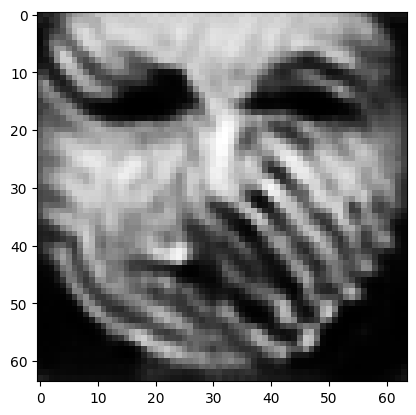

tensor([[3.1035e-05, 7.6229e-04, 4.8199e-04, 9.9242e-01, 3.7645e-06, 9.4838e-05,
         5.7285e-07, 1.4174e-04, 3.9878e-04, 1.5521e-06, 9.3708e-06, 1.2078e-05,
         1.8560e-03, 1.0994e-04, 5.8459e-06, 3.2635e-06, 7.9631e-05, 1.4736e-05,
         2.9305e-05, 4.2950e-05, 5.0598e-06, 4.9159e-07, 3.2413e-05, 5.5845e-06,
         1.6177e-04, 2.5601e-04, 6.3692e-06, 2.0933e-05, 2.0320e-05, 3.3665e-05,
         2.0518e-03, 1.2980e-05, 5.6093e-05, 3.2324e-06, 2.4761e-04, 4.7442e-05,
         1.7097e-05, 4.8860e-04, 2.5524e-05, 3.6079e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007605051621794701
tensor([[3.0970e-05, 7.5358e-04, 4.7687e-04, 9.9255e-01, 3.7072e-06, 9.4157e-05,
         5.6570e-07, 1.4109e-04, 3.9279e-04, 1.5316e-06, 9.2325e-06, 1.1902e-05,
         1.8242e-03, 1.0798e-04, 5.7803e-06, 3.2337e-06, 7.8803e-05, 1.4563e-05,
         2.9101e-05, 4.2579e-05, 4.9696e-06, 4.8461e-07, 3.1639e-05, 5.5345e-06,
         1.5993e-04, 2.5143e-04, 6.2886e-

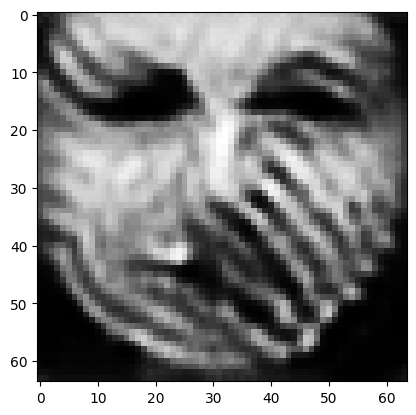

tensor([[3.0656e-05, 7.2308e-04, 4.5873e-04, 9.9296e-01, 3.5026e-06, 9.1597e-05,
         5.3919e-07, 1.3836e-04, 3.7190e-04, 1.4574e-06, 8.7380e-06, 1.1282e-05,
         1.7150e-03, 1.0129e-04, 5.5464e-06, 3.1243e-06, 7.5871e-05, 1.3936e-05,
         2.8365e-05, 4.1194e-05, 4.6623e-06, 4.5937e-07, 2.9038e-05, 5.3513e-06,
         1.5350e-04, 2.3596e-04, 5.9978e-06, 1.9386e-05, 1.9281e-05, 3.1412e-05,
         1.8467e-03, 1.2408e-05, 5.1932e-05, 2.9530e-06, 2.3858e-04, 4.4274e-05,
         1.5762e-05, 4.6782e-04, 2.3730e-05, 3.2797e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007061523851007223
tensor([[3.0559e-05, 7.1567e-04, 4.5457e-04, 9.9306e-01, 3.4570e-06, 9.0946e-05,
         5.3292e-07, 1.3770e-04, 3.6699e-04, 1.4396e-06, 8.6225e-06, 1.1132e-05,
         1.6902e-03, 9.9800e-05, 5.4892e-06, 3.0977e-06, 7.5231e-05, 1.3785e-05,
         2.8182e-05, 4.0855e-05, 4.5910e-06, 4.5356e-07, 2.8474e-05, 5.3113e-06,
         1.5211e-04, 2.3256e-04, 5.9251e-

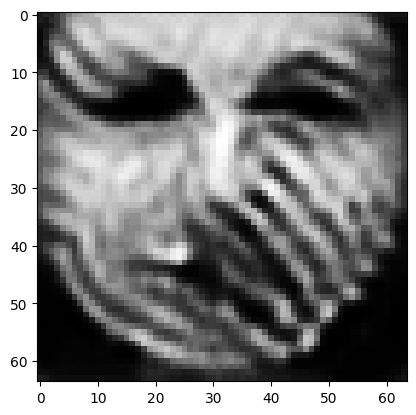

tensor([[3.0228e-05, 6.8834e-04, 4.3986e-04, 9.9340e-01, 3.2962e-06, 8.8669e-05,
         5.1096e-07, 1.3540e-04, 3.4929e-04, 1.3763e-06, 8.2099e-06, 1.0595e-05,
         1.6008e-03, 9.4425e-05, 5.2851e-06, 3.0028e-06, 7.2999e-05, 1.3252e-05,
         2.7530e-05, 3.9663e-05, 4.3386e-06, 4.3285e-07, 2.6454e-05, 5.1710e-06,
         1.4715e-04, 2.2032e-04, 5.6645e-06, 1.8134e-05, 1.8389e-05, 2.9490e-05,
         1.6895e-03, 1.1920e-05, 4.8545e-05, 2.7295e-06, 2.3053e-04, 4.1644e-05,
         1.4731e-05, 4.4978e-04, 2.2281e-05, 3.0115e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006624878384172916
tensor([[3.0158e-05, 6.8219e-04, 4.3666e-04, 9.9347e-01, 3.2611e-06, 8.8189e-05,
         5.0611e-07, 1.3491e-04, 3.4530e-04, 1.3624e-06, 8.1185e-06, 1.0476e-05,
         1.5806e-03, 9.3215e-05, 5.2386e-06, 2.9818e-06, 7.2523e-05, 1.3134e-05,
         2.7387e-05, 3.9395e-05, 4.2829e-06, 4.2821e-07, 2.6007e-05, 5.1397e-06,
         1.4604e-04, 2.1761e-04, 5.6068e-

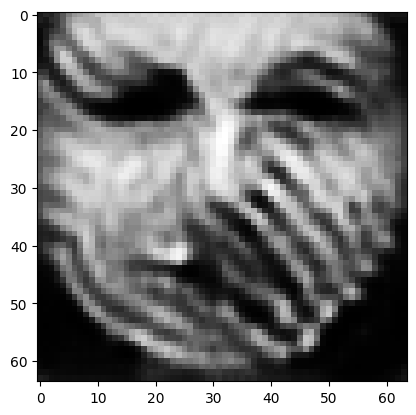

tensor([[2.9909e-05, 6.5850e-04, 4.2425e-04, 9.9376e-01, 3.1309e-06, 8.6378e-05,
         4.8792e-07, 1.3319e-04, 3.3017e-04, 1.3102e-06, 7.7831e-06, 1.0023e-05,
         1.5056e-03, 8.8733e-05, 5.0646e-06, 2.9025e-06, 7.0774e-05, 1.2697e-05,
         2.6826e-05, 3.8370e-05, 4.0701e-06, 4.1071e-07, 2.4385e-05, 5.0246e-06,
         1.4199e-04, 2.0762e-04, 5.3885e-06, 1.7105e-05, 1.7651e-05, 2.7893e-05,
         1.5596e-03, 1.1515e-05, 4.5796e-05, 2.5496e-06, 2.2365e-04, 3.9467e-05,
         1.3900e-05, 4.3472e-04, 2.1097e-05, 2.7959e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006262204144150019
tensor([[2.9847e-05, 6.5286e-04, 4.2129e-04, 9.9382e-01, 3.1012e-06, 8.5936e-05,
         4.8362e-07, 1.3278e-04, 3.2665e-04, 1.2979e-06, 7.7044e-06, 9.9169e-06,
         1.4883e-03, 8.7708e-05, 5.0241e-06, 2.8835e-06, 7.0370e-05, 1.2595e-05,
         2.6687e-05, 3.8127e-05, 4.0210e-06, 4.0667e-07, 2.4022e-05, 4.9980e-06,
         1.4108e-04, 2.0534e-04, 5.3360e-

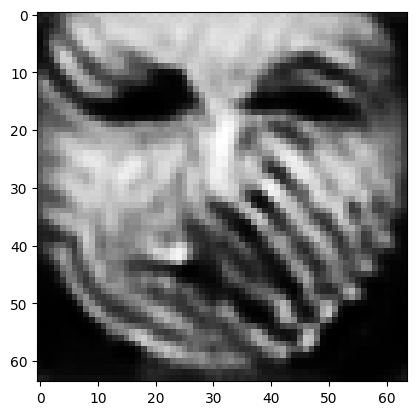

tensor([[2.9635e-05, 6.3240e-04, 4.1034e-04, 9.9406e-01, 2.9873e-06, 8.4374e-05,
         4.6764e-07, 1.3115e-04, 3.1416e-04, 1.2539e-06, 7.4163e-06, 9.5416e-06,
         1.4251e-03, 8.3845e-05, 4.8747e-06, 2.8139e-06, 6.8774e-05, 1.2211e-05,
         2.6168e-05, 3.7247e-05, 3.8450e-06, 3.9184e-07, 2.2667e-05, 4.8905e-06,
         1.3751e-04, 1.9681e-04, 5.1515e-06, 1.6196e-05, 1.6997e-05, 2.6553e-05,
         1.4510e-03, 1.1168e-05, 4.3478e-05, 2.4016e-06, 2.1756e-04, 3.7616e-05,
         1.3178e-05, 4.2139e-04, 2.0113e-05, 2.6168e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00595379201695323
tensor([[2.9581e-05, 6.2770e-04, 4.0789e-04, 9.9412e-01, 2.9625e-06, 8.3993e-05,
         4.6391e-07, 1.3080e-04, 3.1129e-04, 1.2437e-06, 7.3503e-06, 9.4544e-06,
         1.4109e-03, 8.2999e-05, 4.8393e-06, 2.7976e-06, 6.8423e-05, 1.2122e-05,
         2.6046e-05, 3.7033e-05, 3.8049e-06, 3.8856e-07, 2.2373e-05, 4.8675e-06,
         1.3675e-04, 1.9496e-04, 5.1072e-0

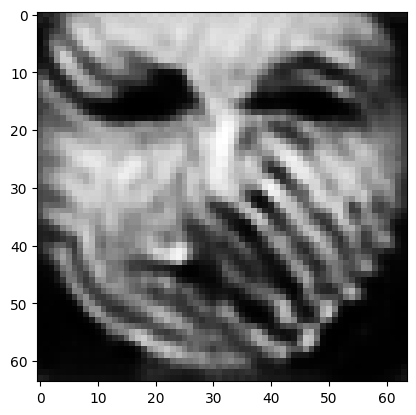

tensor([[2.9404e-05, 6.1085e-04, 3.9874e-04, 9.9431e-01, 2.8681e-06, 8.2634e-05,
         4.5042e-07, 1.2944e-04, 3.0119e-04, 1.2074e-06, 7.1130e-06, 9.1412e-06,
         1.3584e-03, 7.9850e-05, 4.7120e-06, 2.7390e-06, 6.7068e-05, 1.1800e-05,
         2.5611e-05, 3.6281e-05, 3.6601e-06, 3.7640e-07, 2.1286e-05, 4.7776e-06,
         1.3377e-04, 1.8812e-04, 4.9553e-06, 1.5466e-05, 1.6462e-05, 2.5467e-05,
         1.3639e-03, 1.0868e-05, 4.1548e-05, 2.2804e-06, 2.1253e-04, 3.6073e-05,
         1.2581e-05, 4.1038e-04, 1.9297e-05, 2.4730e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005702062509953976
tensor([[2.9355e-05, 6.0692e-04, 3.9664e-04, 9.9436e-01, 2.8479e-06, 8.2283e-05,
         4.4732e-07, 1.2916e-04, 2.9883e-04, 1.1988e-06, 7.0584e-06, 9.0665e-06,
         1.3465e-03, 7.9168e-05, 4.6820e-06, 2.7249e-06, 6.6776e-05, 1.1726e-05,
         2.5510e-05, 3.6093e-05, 3.6268e-06, 3.7367e-07, 2.1056e-05, 4.7592e-06,
         1.3314e-04, 1.8666e-04, 4.9179e-

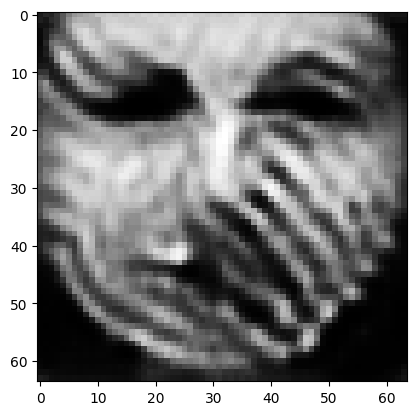

tensor([[2.9173e-05, 5.9268e-04, 3.8862e-04, 9.9452e-01, 2.7688e-06, 8.1018e-05,
         4.3538e-07, 1.2795e-04, 2.9005e-04, 1.1667e-06, 6.8523e-06, 8.7960e-06,
         1.3027e-03, 7.6558e-05, 4.5683e-06, 2.6731e-06, 6.5598e-05, 1.1446e-05,
         2.5133e-05, 3.5391e-05, 3.5038e-06, 3.6329e-07, 2.0186e-05, 4.6839e-06,
         1.3062e-04, 1.8105e-04, 4.7867e-06, 1.4865e-05, 1.6003e-05, 2.4560e-05,
         1.2922e-03, 1.0605e-05, 3.9909e-05, 2.1781e-06, 2.0799e-04, 3.4776e-05,
         1.2090e-05, 4.0097e-04, 1.8585e-05, 2.3533e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005491054616868496
tensor([[2.9128e-05, 5.8929e-04, 3.8673e-04, 9.9456e-01, 2.7503e-06, 8.0715e-05,
         4.3252e-07, 1.2766e-04, 2.8796e-04, 1.1590e-06, 6.8029e-06, 8.7322e-06,
         1.2926e-03, 7.5946e-05, 4.5408e-06, 2.6607e-06, 6.5324e-05, 1.1380e-05,
         2.5042e-05, 3.5224e-05, 3.4748e-06, 3.6086e-07, 1.9985e-05, 4.6663e-06,
         1.3004e-04, 1.7974e-04, 4.7554e-

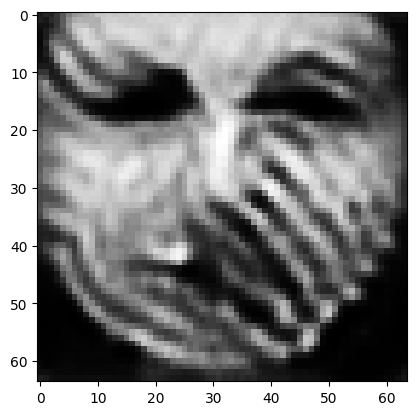

tensor([[2.8944e-05, 5.7651e-04, 3.7962e-04, 9.9471e-01, 2.6806e-06, 7.9549e-05,
         4.2166e-07, 1.2645e-04, 2.8030e-04, 1.1300e-06, 6.6163e-06, 8.4939e-06,
         1.2550e-03, 7.3672e-05, 4.4380e-06, 2.6136e-06, 6.4254e-05, 1.1128e-05,
         2.4693e-05, 3.4596e-05, 3.3687e-06, 3.5166e-07, 1.9245e-05, 4.5968e-06,
         1.2780e-04, 1.7481e-04, 4.6391e-06, 1.4330e-05, 1.5591e-05, 2.3765e-05,
         1.2303e-03, 1.0365e-05, 3.8456e-05, 2.0881e-06, 2.0396e-04, 3.3636e-05,
         1.1656e-05, 3.9261e-04, 1.7955e-05, 2.2512e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005307156592607498
tensor([[2.8901e-05, 5.7348e-04, 3.7794e-04, 9.9474e-01, 2.6644e-06, 7.9286e-05,
         4.1914e-07, 1.2618e-04, 2.7848e-04, 1.1233e-06, 6.5734e-06, 8.4370e-06,
         1.2463e-03, 7.3138e-05, 4.4135e-06, 2.6026e-06, 6.4012e-05, 1.1069e-05,
         2.4609e-05, 3.4445e-05, 3.3437e-06, 3.4951e-07, 1.9074e-05, 4.5808e-06,
         1.2729e-04, 1.7367e-04, 4.6117e-

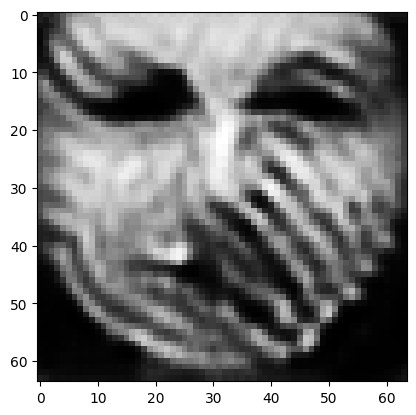

tensor([[2.8732e-05, 5.6211e-04, 3.7150e-04, 9.9487e-01, 2.6035e-06, 7.8258e-05,
         4.0960e-07, 1.2517e-04, 2.7176e-04, 1.0982e-06, 6.4132e-06, 8.2224e-06,
         1.2137e-03, 7.1140e-05, 4.3218e-06, 2.5600e-06, 6.3085e-05, 1.0847e-05,
         2.4288e-05, 3.3874e-05, 3.2491e-06, 3.4142e-07, 1.8433e-05, 4.5190e-06,
         1.2536e-04, 1.6935e-04, 4.5102e-06, 1.3863e-05, 1.5222e-05, 2.3076e-05,
         1.1769e-03, 1.0146e-05, 3.7169e-05, 2.0086e-06, 2.0040e-04, 3.2624e-05,
         1.1277e-05, 3.8505e-04, 1.7388e-05, 2.1636e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0051463511772453785
tensor([[2.8692e-05, 5.5943e-04, 3.6999e-04, 9.9490e-01, 2.5891e-06, 7.8011e-05,
         4.0735e-07, 1.2493e-04, 2.7017e-04, 1.0923e-06, 6.3759e-06, 8.1717e-06,
         1.2060e-03, 7.0669e-05, 4.3002e-06, 2.5499e-06, 6.2866e-05, 1.0795e-05,
         2.4211e-05, 3.3741e-05, 3.2268e-06, 3.3953e-07, 1.8282e-05, 4.5045e-06,
         1.2491e-04, 1.6832e-04, 4.4863e

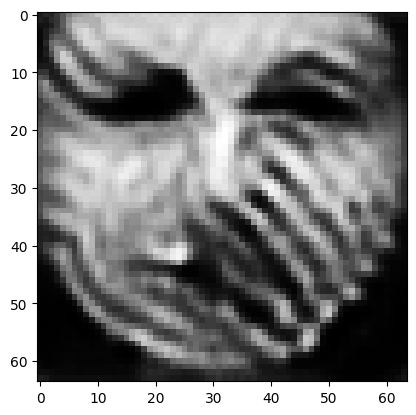

tensor([[2.8539e-05, 5.4920e-04, 3.6432e-04, 9.9501e-01, 2.5355e-06, 7.7078e-05,
         3.9886e-07, 1.2403e-04, 2.6423e-04, 1.0699e-06, 6.2359e-06, 7.9819e-06,
         1.1773e-03, 6.8907e-05, 4.2202e-06, 2.5114e-06, 6.2049e-05, 1.0602e-05,
         2.3917e-05, 3.3243e-05, 3.1443e-06, 3.3246e-07, 1.7721e-05, 4.4501e-06,
         1.2320e-04, 1.6446e-04, 4.3957e-06, 1.3448e-05, 1.4887e-05, 2.2467e-05,
         1.1305e-03, 9.9506e-06, 3.6031e-05, 1.9387e-06, 1.9718e-04, 3.1722e-05,
         1.0941e-05, 3.7815e-04, 1.6889e-05, 2.0864e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005004736129194498
tensor([[2.8503e-05, 5.4680e-04, 3.6299e-04, 9.9503e-01, 2.5230e-06, 7.6861e-05,
         3.9689e-07, 1.2382e-04, 2.6284e-04, 1.0647e-06, 6.2032e-06, 7.9373e-06,
         1.1706e-03, 6.8498e-05, 4.2013e-06, 2.5024e-06, 6.1858e-05, 1.0556e-05,
         2.3849e-05, 3.3125e-05, 3.1250e-06, 3.3082e-07, 1.7589e-05, 4.4374e-06,
         1.2280e-04, 1.6357e-04, 4.3746e-

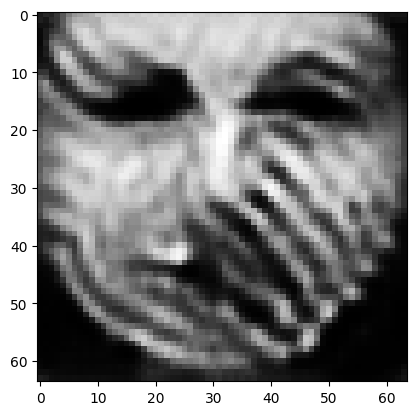

tensor([[2.8371e-05, 5.3785e-04, 3.5791e-04, 9.9513e-01, 2.4743e-06, 7.6049e-05,
         3.8950e-07, 1.2300e-04, 2.5755e-04, 1.0452e-06, 6.0797e-06, 7.7696e-06,
         1.1451e-03, 6.6952e-05, 4.1290e-06, 2.4691e-06, 6.1132e-05, 1.0382e-05,
         2.3592e-05, 3.2684e-05, 3.0517e-06, 3.2462e-07, 1.7092e-05, 4.3889e-06,
         1.2123e-04, 1.6018e-04, 4.2958e-06, 1.3087e-05, 1.4594e-05, 2.1930e-05,
         1.0901e-03, 9.7788e-06, 3.5026e-05, 1.8776e-06, 1.9432e-04, 3.0926e-05,
         1.0646e-05, 3.7200e-04, 1.6443e-05, 2.0190e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004880302120000124
tensor([[2.8341e-05, 5.3574e-04, 3.5667e-04, 9.9516e-01, 2.4625e-06, 7.5858e-05,
         3.8778e-07, 1.2280e-04, 2.5627e-04, 1.0406e-06, 6.0501e-06, 7.7293e-06,
         1.1389e-03, 6.6581e-05, 4.1116e-06, 2.4613e-06, 6.0955e-05, 1.0340e-05,
         2.3532e-05, 3.2578e-05, 3.0338e-06, 3.2312e-07, 1.6972e-05, 4.3771e-06,
         1.2084e-04, 1.5936e-04, 4.2773e-

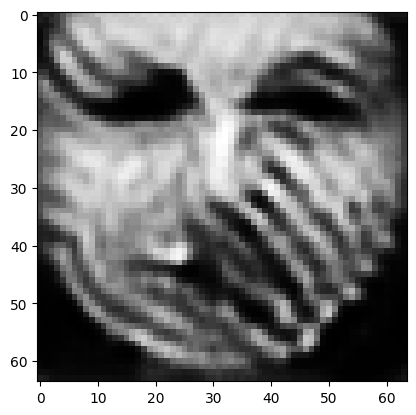

tensor([[2.8231e-05, 5.2808e-04, 3.5206e-04, 9.9524e-01, 2.4190e-06, 7.5146e-05,
         3.8151e-07, 1.2206e-04, 2.5146e-04, 1.0239e-06, 5.9415e-06, 7.5823e-06,
         1.1159e-03, 6.5236e-05, 4.0462e-06, 2.4323e-06, 6.0287e-05, 1.0183e-05,
         2.3319e-05, 3.2181e-05, 2.9666e-06, 3.1755e-07, 1.6528e-05, 4.3339e-06,
         1.1938e-04, 1.5644e-04, 4.2086e-06, 1.2775e-05, 1.4336e-05, 2.1457e-05,
         1.0549e-03, 9.6297e-06, 3.4140e-05, 1.8239e-06, 1.9165e-04, 3.0216e-05,
         1.0392e-05, 3.6671e-04, 1.6036e-05, 1.9592e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0047694966197013855
tensor([[2.8204e-05, 5.2628e-04, 3.5099e-04, 9.9526e-01, 2.4088e-06, 7.4977e-05,
         3.8003e-07, 1.2189e-04, 2.5032e-04, 1.0200e-06, 5.9159e-06, 7.5476e-06,
         1.1104e-03, 6.4921e-05, 4.0309e-06, 2.4254e-06, 6.0131e-05, 1.0146e-05,
         2.3268e-05, 3.2086e-05, 2.9509e-06, 3.1624e-07, 1.6424e-05, 4.3239e-06,
         1.1903e-04, 1.5575e-04, 4.1922e

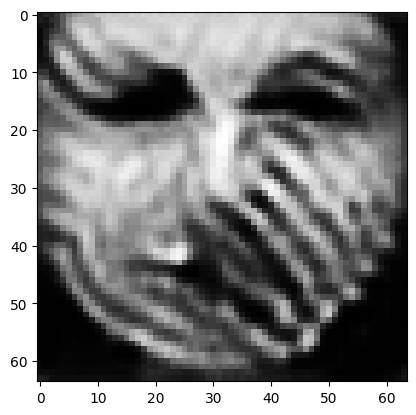

tensor([[2.8094e-05, 5.1944e-04, 3.4688e-04, 9.9534e-01, 2.3707e-06, 7.4322e-05,
         3.7442e-07, 1.2122e-04, 2.4601e-04, 1.0049e-06, 5.8191e-06, 7.4152e-06,
         1.0901e-03, 6.3742e-05, 3.9731e-06, 2.3992e-06, 5.9550e-05, 1.0006e-05,
         2.3074e-05, 3.1725e-05, 2.8915e-06, 3.1131e-07, 1.6039e-05, 4.2867e-06,
         1.1776e-04, 1.5320e-04, 4.1290e-06, 1.2503e-05, 1.4107e-05, 2.1036e-05,
         1.0240e-03, 9.4978e-06, 3.3359e-05, 1.7767e-06, 1.8925e-04, 2.9590e-05,
         1.0170e-05, 3.6193e-04, 1.5678e-05, 1.9063e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004671849310398102
tensor([[2.8068e-05, 5.1785e-04, 3.4589e-04, 9.9536e-01, 2.3614e-06, 7.4168e-05,
         3.7306e-07, 1.2105e-04, 2.4499e-04, 1.0013e-06, 5.7960e-06, 7.3839e-06,
         1.0853e-03, 6.3458e-05, 3.9595e-06, 2.3928e-06, 5.9408e-05, 9.9732e-06,
         2.3029e-05, 3.1639e-05, 2.8775e-06, 3.1010e-07, 1.5947e-05, 4.2772e-06,
         1.1745e-04, 1.5259e-04, 4.1145e-

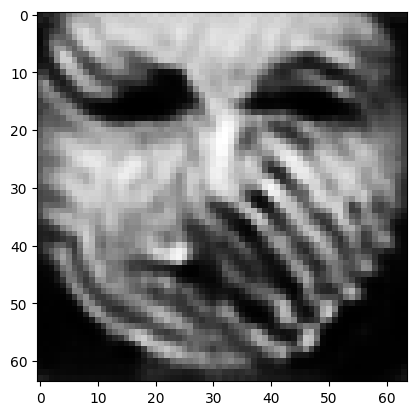

tensor([[2.7961e-05, 5.1175e-04, 3.4209e-04, 9.9543e-01, 2.3263e-06, 7.3558e-05,
         3.6782e-07, 1.2037e-04, 2.4111e-04, 9.8742e-07, 5.7078e-06, 7.2650e-06,
         1.0671e-03, 6.2389e-05, 3.9074e-06, 2.3684e-06, 5.8869e-05, 9.8466e-06,
         2.2852e-05, 3.1307e-05, 2.8247e-06, 3.0553e-07, 1.5604e-05, 4.2416e-06,
         1.1627e-04, 1.5028e-04, 4.0578e-06, 1.2255e-05, 1.3898e-05, 2.0660e-05,
         9.9631e-04, 9.3770e-06, 3.2649e-05, 1.7339e-06, 1.8714e-04, 2.9028e-05,
         9.9680e-06, 3.5759e-04, 1.5353e-05, 1.8590e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004584041424095631
tensor([[2.7934e-05, 5.1032e-04, 3.4116e-04, 9.9544e-01, 2.3178e-06, 7.3407e-05,
         3.6654e-07, 1.2020e-04, 2.4019e-04, 9.8413e-07, 5.6864e-06, 7.2365e-06,
         1.0627e-03, 6.2134e-05, 3.8947e-06, 2.3625e-06, 5.8736e-05, 9.8156e-06,
         2.2809e-05, 3.1224e-05, 2.8121e-06, 3.0441e-07, 1.5522e-05, 4.2327e-06,
         1.1599e-04, 1.4973e-04, 4.0441e-

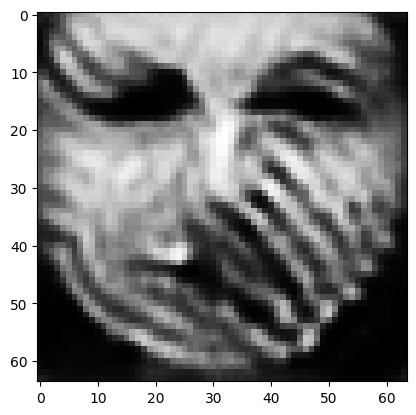

tensor([[2.7830e-05, 5.0479e-04, 3.3760e-04, 9.9551e-01, 2.2847e-06, 7.2821e-05,
         3.6162e-07, 1.1953e-04, 2.3670e-04, 9.7151e-07, 5.6043e-06, 7.1280e-06,
         1.0460e-03, 6.1155e-05, 3.8464e-06, 2.3396e-06, 5.8213e-05, 9.6966e-06,
         2.2642e-05, 3.0909e-05, 2.7639e-06, 3.0014e-07, 1.5209e-05, 4.1979e-06,
         1.1487e-04, 1.4762e-04, 3.9916e-06, 1.2025e-05, 1.3706e-05, 2.0320e-05,
         9.7131e-04, 9.2646e-06, 3.1991e-05, 1.6946e-06, 1.8517e-04, 2.8516e-05,
         9.7815e-06, 3.5358e-04, 1.5056e-05, 1.8158e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004503584001213312
tensor([[2.7807e-05, 5.0345e-04, 3.3675e-04, 9.9552e-01, 2.2767e-06, 7.2682e-05,
         3.6046e-07, 1.1936e-04, 2.3586e-04, 9.6851e-07, 5.5847e-06, 7.1019e-06,
         1.0419e-03, 6.0918e-05, 3.8347e-06, 2.3342e-06, 5.8085e-05, 9.6678e-06,
         2.2602e-05, 3.0834e-05, 2.7523e-06, 2.9911e-07, 1.5133e-05, 4.1895e-06,
         1.1460e-04, 1.4710e-04, 3.9791e-

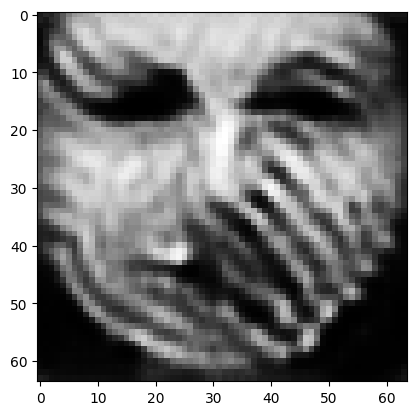

tensor([[2.7717e-05, 4.9826e-04, 3.3350e-04, 9.9558e-01, 2.2460e-06, 7.2146e-05,
         3.5597e-07, 1.1874e-04, 2.3265e-04, 9.5699e-07, 5.5093e-06, 7.0019e-06,
         1.0264e-03, 6.0009e-05, 3.7895e-06, 2.3131e-06, 5.7597e-05, 9.5556e-06,
         2.2446e-05, 3.0545e-05, 2.7078e-06, 2.9519e-07, 1.4842e-05, 4.1569e-06,
         1.1355e-04, 1.4515e-04, 3.9307e-06, 1.1812e-05, 1.3528e-05, 2.0008e-05,
         9.4855e-04, 9.1585e-06, 3.1388e-05, 1.6585e-06, 1.8332e-04, 2.8033e-05,
         9.6079e-06, 3.4990e-04, 1.4784e-05, 1.7765e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004429647698998451
tensor([[2.7695e-05, 4.9703e-04, 3.3272e-04, 9.9559e-01, 2.2386e-06, 7.2017e-05,
         3.5490e-07, 1.1858e-04, 2.3190e-04, 9.5424e-07, 5.4914e-06, 6.9781e-06,
         1.0227e-03, 5.9793e-05, 3.7788e-06, 2.3081e-06, 5.7478e-05, 9.5287e-06,
         2.2408e-05, 3.0475e-05, 2.6973e-06, 2.9425e-07, 1.4773e-05, 4.1490e-06,
         1.1330e-04, 1.4469e-04, 3.9191e-

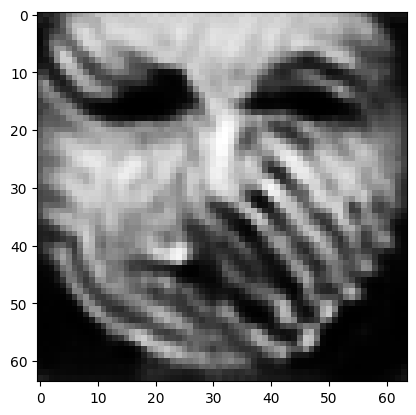

tensor([[2.7605e-05, 4.9223e-04, 3.2967e-04, 9.9565e-01, 2.2099e-06, 7.1505e-05,
         3.5072e-07, 1.1797e-04, 2.2899e-04, 9.4351e-07, 5.4216e-06, 6.8862e-06,
         1.0086e-03, 5.8954e-05, 3.7371e-06, 2.2883e-06, 5.7015e-05, 9.4240e-06,
         2.2262e-05, 3.0205e-05, 2.6568e-06, 2.9059e-07, 1.4509e-05, 4.1178e-06,
         1.1232e-04, 1.4290e-04, 3.8744e-06, 1.1615e-05, 1.3364e-05, 1.9724e-05,
         9.2805e-04, 9.0585e-06, 3.0832e-05, 1.6256e-06, 1.8162e-04, 2.7592e-05,
         9.4477e-06, 3.4648e-04, 1.4535e-05, 1.7405e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004361996427178383
tensor([[2.7582e-05, 4.9110e-04, 3.2894e-04, 9.9566e-01, 2.2031e-06, 7.1380e-05,
         3.4972e-07, 1.1782e-04, 2.2829e-04, 9.4092e-07, 5.4049e-06, 6.8643e-06,
         1.0052e-03, 5.8755e-05, 3.7273e-06, 2.2836e-06, 5.6905e-05, 9.3992e-06,
         2.2227e-05, 3.0140e-05, 2.6473e-06, 2.8972e-07, 1.4447e-05, 4.1104e-06,
         1.1209e-04, 1.4248e-04, 3.8636e-

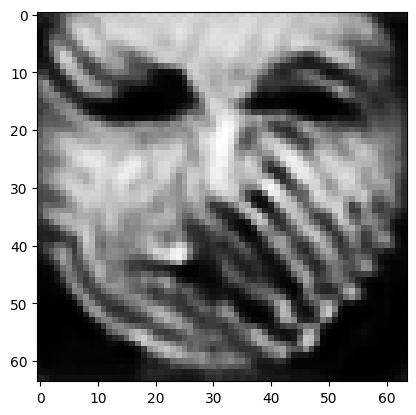

tensor([[2.7495e-05, 4.8677e-04, 3.2609e-04, 9.9571e-01, 2.1769e-06, 7.0896e-05,
         3.4582e-07, 1.1723e-04, 2.2563e-04, 9.3100e-07, 5.3406e-06, 6.7798e-06,
         9.9248e-04, 5.8000e-05, 3.6902e-06, 2.2650e-06, 5.6481e-05, 9.3043e-06,
         2.2091e-05, 2.9887e-05, 2.6111e-06, 2.8636e-07, 1.4211e-05, 4.0820e-06,
         1.1121e-04, 1.4086e-04, 3.8225e-06, 1.1434e-05, 1.3210e-05, 1.9464e-05,
         9.0941e-04, 8.9661e-06, 3.0322e-05, 1.5954e-06, 1.8006e-04, 2.7197e-05,
         9.3019e-06, 3.4327e-04, 1.4308e-05, 1.7074e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004300394095480442
tensor([[2.7474e-05, 4.8573e-04, 3.2541e-04, 9.9572e-01, 2.1706e-06, 7.0780e-05,
         3.4490e-07, 1.1709e-04, 2.2499e-04, 9.2864e-07, 5.3253e-06, 6.7595e-06,
         9.8942e-04, 5.7821e-05, 3.6814e-06, 2.2605e-06, 5.6381e-05, 9.2816e-06,
         2.2058e-05, 2.9827e-05, 2.6025e-06, 2.8556e-07, 1.4155e-05, 4.0754e-06,
         1.1101e-04, 1.4048e-04, 3.8126e-

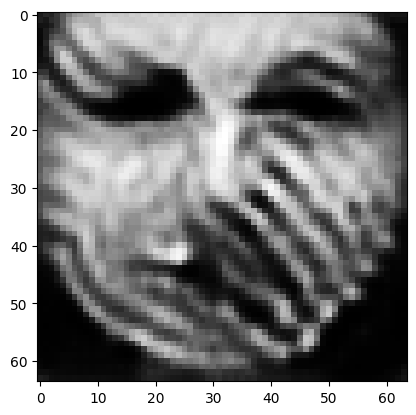

tensor([[2.7393e-05, 4.8173e-04, 3.2273e-04, 9.9577e-01, 2.1463e-06, 7.0325e-05,
         3.4129e-07, 1.1655e-04, 2.2251e-04, 9.1947e-07, 5.2658e-06, 6.6809e-06,
         9.7762e-04, 5.7123e-05, 3.6470e-06, 2.2432e-06, 5.5988e-05, 9.1930e-06,
         2.1932e-05, 2.9591e-05, 2.5688e-06, 2.8246e-07, 1.3938e-05, 4.0494e-06,
         1.1020e-04, 1.3899e-04, 3.7745e-06, 1.1268e-05, 1.3068e-05, 1.9223e-05,
         8.9237e-04, 8.8804e-06, 2.9850e-05, 1.5676e-06, 1.7863e-04, 2.6834e-05,
         9.1687e-06, 3.4029e-04, 1.4098e-05, 1.6766e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00424353638663888
tensor([[2.7374e-05, 4.8078e-04, 3.2208e-04, 9.9578e-01, 2.1404e-06, 7.0217e-05,
         3.4043e-07, 1.1642e-04, 2.2191e-04, 9.1729e-07, 5.2515e-06, 6.6620e-06,
         9.7477e-04, 5.6953e-05, 3.6389e-06, 2.2390e-06, 5.5893e-05, 9.1718e-06,
         2.1903e-05, 2.9535e-05, 2.5607e-06, 2.8171e-07, 1.3886e-05, 4.0431e-06,
         1.1001e-04, 1.3863e-04, 3.7655e-0

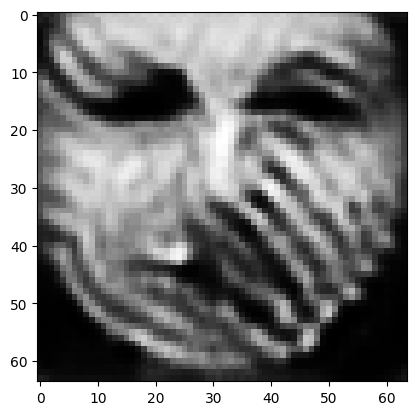

tensor([[2.7297e-05, 4.7711e-04, 3.1960e-04, 9.9582e-01, 2.1180e-06, 6.9796e-05,
         3.3711e-07, 1.1591e-04, 2.1962e-04, 9.0882e-07, 5.1967e-06, 6.5895e-06,
         9.6395e-04, 5.6310e-05, 3.6077e-06, 2.2230e-06, 5.5531e-05, 9.0911e-06,
         2.1784e-05, 2.9318e-05, 2.5299e-06, 2.7883e-07, 1.3686e-05, 4.0192e-06,
         1.0926e-04, 1.3723e-04, 3.7302e-06, 1.1113e-05, 1.2934e-05, 1.9002e-05,
         8.7656e-04, 8.8014e-06, 2.9416e-05, 1.5419e-06, 1.7729e-04, 2.6499e-05,
         9.0447e-06, 3.3747e-04, 1.3904e-05, 1.6481e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004191067535430193
tensor([[2.7279e-05, 4.7623e-04, 3.1900e-04, 9.9583e-01, 2.1126e-06, 6.9695e-05,
         3.3631e-07, 1.1579e-04, 2.1907e-04, 9.0680e-07, 5.1835e-06, 6.5721e-06,
         9.6135e-04, 5.6155e-05, 3.6002e-06, 2.2191e-06, 5.5443e-05, 9.0715e-06,
         2.1756e-05, 2.9266e-05, 2.5224e-06, 2.7813e-07, 1.3638e-05, 4.0133e-06,
         1.0908e-04, 1.3690e-04, 3.7219e-

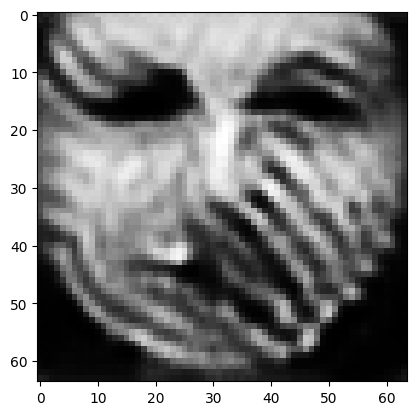

tensor([[2.7209e-05, 4.7278e-04, 3.1670e-04, 9.9587e-01, 2.0918e-06, 6.9302e-05,
         3.3322e-07, 1.1532e-04, 2.1697e-04, 8.9900e-07, 5.1328e-06, 6.5053e-06,
         9.5141e-04, 5.5561e-05, 3.5713e-06, 2.2042e-06, 5.5109e-05, 8.9962e-06,
         2.1645e-05, 2.9065e-05, 2.4941e-06, 2.7546e-07, 1.3455e-05, 3.9910e-06,
         1.0839e-04, 1.3561e-04, 3.6890e-06, 1.0969e-05, 1.2811e-05, 1.8797e-05,
         8.6212e-04, 8.7271e-06, 2.9014e-05, 1.5183e-06, 1.7605e-04, 2.6189e-05,
         8.9301e-06, 3.3485e-04, 1.3725e-05, 1.6217e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0041427514515817165
tensor([[2.7192e-05, 4.7196e-04, 3.1613e-04, 9.9588e-01, 2.0868e-06, 6.9206e-05,
         3.3247e-07, 1.1520e-04, 2.1647e-04, 8.9712e-07, 5.1205e-06, 6.4893e-06,
         9.4904e-04, 5.5417e-05, 3.5645e-06, 2.2006e-06, 5.5028e-05, 8.9782e-06,
         2.1619e-05, 2.9017e-05, 2.4873e-06, 2.7481e-07, 1.3411e-05, 3.9855e-06,
         1.0822e-04, 1.3530e-04, 3.6813e

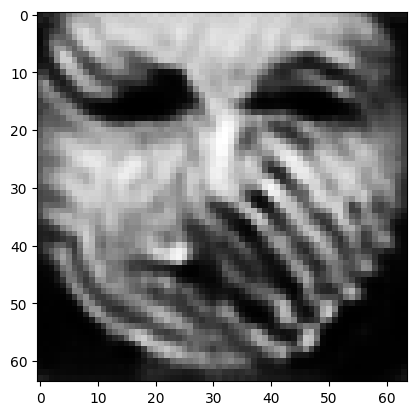

tensor([[2.7123e-05, 4.6875e-04, 3.1396e-04, 9.9591e-01, 2.0677e-06, 6.8831e-05,
         3.2958e-07, 1.1475e-04, 2.1452e-04, 8.8978e-07, 5.0733e-06, 6.4268e-06,
         9.3983e-04, 5.4874e-05, 3.5381e-06, 2.1866e-06, 5.4717e-05, 8.9095e-06,
         2.1515e-05, 2.8827e-05, 2.4612e-06, 2.7232e-07, 1.3244e-05, 3.9645e-06,
         1.0758e-04, 1.3410e-04, 3.6506e-06, 1.0835e-05, 1.2695e-05, 1.8609e-05,
         8.4872e-04, 8.6583e-06, 2.8640e-05, 1.4963e-06, 1.7491e-04, 2.5908e-05,
         8.8245e-06, 3.3240e-04, 1.3558e-05, 1.5973e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004097638186067343
tensor([[2.7106e-05, 4.6797e-04, 3.1343e-04, 9.9592e-01, 2.0630e-06, 6.8740e-05,
         3.2888e-07, 1.1464e-04, 2.1404e-04, 8.8799e-07, 5.0618e-06, 6.4116e-06,
         9.3760e-04, 5.4742e-05, 3.5317e-06, 2.1833e-06, 5.4643e-05, 8.8929e-06,
         2.1490e-05, 2.8781e-05, 2.4548e-06, 2.7172e-07, 1.3204e-05, 3.9595e-06,
         1.0743e-04, 1.3381e-04, 3.6432e-

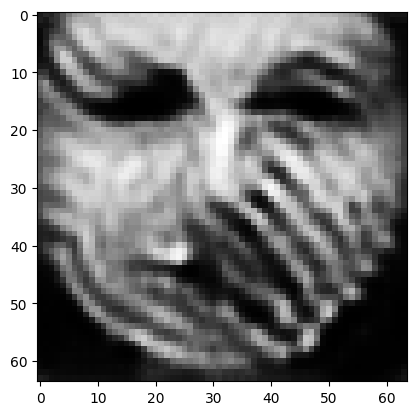

tensor([[2.7042e-05, 4.6502e-04, 3.1145e-04, 9.9595e-01, 2.0453e-06, 6.8395e-05,
         3.2620e-07, 1.1423e-04, 2.1226e-04, 8.8128e-07, 5.0186e-06, 6.3547e-06,
         9.2919e-04, 5.4243e-05, 3.5078e-06, 2.1703e-06, 5.4361e-05, 8.8303e-06,
         2.1393e-05, 2.8608e-05, 2.4311e-06, 2.6945e-07, 1.3052e-05, 3.9402e-06,
         1.0684e-04, 1.3271e-04, 3.6149e-06, 1.0709e-05, 1.2587e-05, 1.8436e-05,
         8.3642e-04, 8.5957e-06, 2.8298e-05, 1.4763e-06, 1.7384e-04, 2.5647e-05,
         8.7272e-06, 3.3014e-04, 1.3405e-05, 1.5750e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004056321922689676
tensor([[2.7027e-05, 4.6432e-04, 3.1098e-04, 9.9596e-01, 2.0411e-06, 6.8313e-05,
         3.2556e-07, 1.1413e-04, 2.1185e-04, 8.7969e-07, 5.0084e-06, 6.3413e-06,
         9.2720e-04, 5.4124e-05, 3.5022e-06, 2.1672e-06, 5.4294e-05, 8.8155e-06,
         2.1370e-05, 2.8568e-05, 2.4256e-06, 2.6891e-07, 1.3015e-05, 3.9355e-06,
         1.0670e-04, 1.3244e-04, 3.6084e-

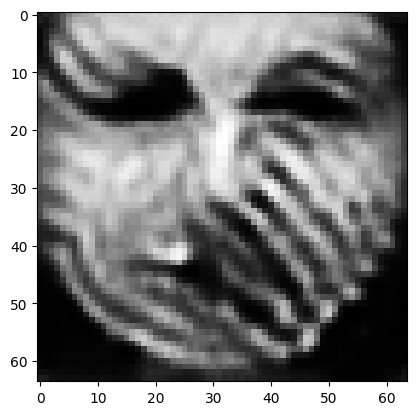

tensor([[2.6969e-05, 4.6160e-04, 3.0922e-04, 9.9599e-01, 2.0247e-06, 6.8000e-05,
         3.2308e-07, 1.1374e-04, 2.1028e-04, 8.7358e-07, 4.9692e-06, 6.2902e-06,
         9.1950e-04, 5.3665e-05, 3.4802e-06, 2.1553e-06, 5.4037e-05, 8.7581e-06,
         2.1278e-05, 2.8414e-05, 2.4041e-06, 2.6685e-07, 1.2875e-05, 3.9176e-06,
         1.0617e-04, 1.3143e-04, 3.5827e-06, 1.0593e-05, 1.2489e-05, 1.8280e-05,
         8.2528e-04, 8.5391e-06, 2.7991e-05, 1.4583e-06, 1.7288e-04, 2.5402e-05,
         8.6373e-06, 3.2811e-04, 1.3269e-05, 1.5550e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004018803592771292
tensor([[2.6955e-05, 4.6094e-04, 3.0879e-04, 9.9600e-01, 2.0208e-06, 6.7924e-05,
         3.2248e-07, 1.1365e-04, 2.0990e-04, 8.7210e-07, 4.9597e-06, 6.2779e-06,
         9.1765e-04, 5.3555e-05, 3.4749e-06, 2.1524e-06, 5.3976e-05, 8.7443e-06,
         2.1256e-05, 2.8377e-05, 2.3989e-06, 2.6636e-07, 1.2842e-05, 3.9133e-06,
         1.0604e-04, 1.3119e-04, 3.5764e-

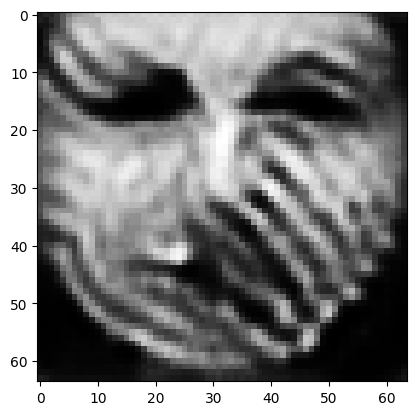

tensor([[2.6899e-05, 4.5840e-04, 3.0713e-04, 9.9602e-01, 2.0054e-06, 6.7627e-05,
         3.2017e-07, 1.1329e-04, 2.0844e-04, 8.6638e-07, 4.9230e-06, 6.2304e-06,
         9.1050e-04, 5.3128e-05, 3.4543e-06, 2.1411e-06, 5.3733e-05, 8.6904e-06,
         2.1169e-05, 2.8233e-05, 2.3789e-06, 2.6444e-07, 1.2712e-05, 3.8964e-06,
         1.0554e-04, 1.3025e-04, 3.5524e-06, 1.0484e-05, 1.2398e-05, 1.8135e-05,
         8.1502e-04, 8.4862e-06, 2.7705e-05, 1.4416e-06, 1.7197e-04, 2.5173e-05,
         8.5537e-06, 3.2622e-04, 1.3143e-05, 1.5363e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003984014969319105
tensor([[2.6885e-05, 4.5779e-04, 3.0673e-04, 9.9603e-01, 2.0017e-06, 6.7554e-05,
         3.1960e-07, 1.1319e-04, 2.0808e-04, 8.6499e-07, 4.9140e-06, 6.2189e-06,
         9.0877e-04, 5.3024e-05, 3.4493e-06, 2.1384e-06, 5.3673e-05, 8.6772e-06,
         2.1148e-05, 2.8198e-05, 2.3741e-06, 2.6397e-07, 1.2681e-05, 3.8923e-06,
         1.0542e-04, 1.3002e-04, 3.5465e-

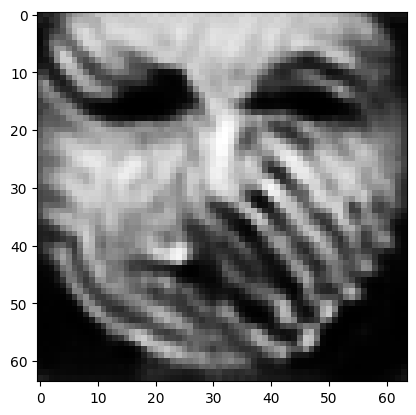

tensor([[2.6831e-05, 4.5543e-04, 3.0516e-04, 9.9606e-01, 1.9872e-06, 6.7274e-05,
         3.1742e-07, 1.1284e-04, 2.0672e-04, 8.5964e-07, 4.8795e-06, 6.1747e-06,
         9.0211e-04, 5.2625e-05, 3.4299e-06, 2.1277e-06, 5.3442e-05, 8.6264e-06,
         2.1067e-05, 2.8061e-05, 2.3555e-06, 2.6216e-07, 1.2560e-05, 3.8761e-06,
         1.0494e-04, 1.2915e-04, 3.5242e-06, 1.0383e-05, 1.2313e-05, 1.8000e-05,
         8.0551e-04, 8.4366e-06, 2.7438e-05, 1.4260e-06, 1.7112e-04, 2.4960e-05,
         8.4754e-06, 3.2444e-04, 1.3025e-05, 1.5190e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003951361868530512
tensor([[2.6818e-05, 4.5487e-04, 3.0478e-04, 9.9606e-01, 1.9837e-06, 6.7206e-05,
         3.1689e-07, 1.1276e-04, 2.0639e-04, 8.5835e-07, 4.8712e-06, 6.1640e-06,
         9.0050e-04, 5.2528e-05, 3.4252e-06, 2.1251e-06, 5.3384e-05, 8.6140e-06,
         2.1048e-05, 2.8028e-05, 2.3510e-06, 2.6172e-07, 1.2531e-05, 3.8721e-06,
         1.0483e-04, 1.2894e-04, 3.5189e-

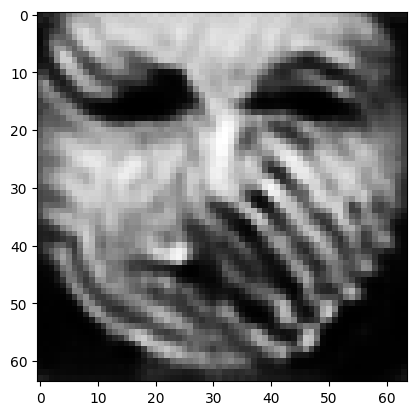

tensor([[2.6767e-05, 4.5266e-04, 3.0330e-04, 9.9609e-01, 1.9701e-06, 6.6939e-05,
         3.1482e-07, 1.1242e-04, 2.0511e-04, 8.5331e-07, 4.8387e-06, 6.1226e-06,
         8.9423e-04, 5.2155e-05, 3.4069e-06, 2.1150e-06, 5.3165e-05, 8.5660e-06,
         2.0971e-05, 2.7898e-05, 2.3335e-06, 2.6002e-07, 1.2419e-05, 3.8567e-06,
         1.0438e-04, 1.2812e-04, 3.4979e-06, 1.0288e-05, 1.2233e-05, 1.7874e-05,
         7.9664e-04, 8.3898e-06, 2.7187e-05, 1.4115e-06, 1.7033e-04, 2.4762e-05,
         8.4021e-06, 3.2279e-04, 1.2914e-05, 1.5028e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003920964431017637
tensor([[2.6755e-05, 4.5213e-04, 3.0294e-04, 9.9609e-01, 1.9668e-06, 6.6875e-05,
         3.1433e-07, 1.1234e-04, 2.0480e-04, 8.5210e-07, 4.8309e-06, 6.1126e-06,
         8.9272e-04, 5.2065e-05, 3.4025e-06, 2.1126e-06, 5.3112e-05, 8.5545e-06,
         2.0953e-05, 2.7867e-05, 2.3293e-06, 2.5962e-07, 1.2392e-05, 3.8530e-06,
         1.0427e-04, 1.2792e-04, 3.4928e-

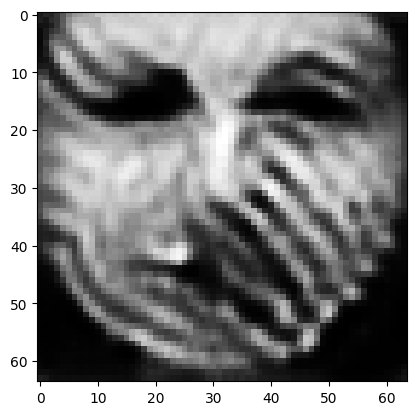

tensor([[2.6703e-05, 4.5006e-04, 3.0157e-04, 9.9611e-01, 1.9548e-06, 6.6619e-05,
         3.1241e-07, 1.1201e-04, 2.0360e-04, 8.4732e-07, 4.8004e-06, 6.0740e-06,
         8.8704e-04, 5.1728e-05, 3.3859e-06, 2.1027e-06, 5.2918e-05, 8.5112e-06,
         2.0882e-05, 2.7744e-05, 2.3136e-06, 2.5806e-07, 1.2294e-05, 3.8389e-06,
         1.0389e-04, 1.2717e-04, 3.4731e-06, 1.0200e-05, 1.2157e-05, 1.7755e-05,
         7.8837e-04, 8.3482e-06, 2.6954e-05, 1.3981e-06, 1.6963e-04, 2.4586e-05,
         8.3360e-06, 3.2123e-04, 1.2813e-05, 1.4878e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003892940701916814
tensor([[2.6690e-05, 4.4955e-04, 3.0125e-04, 9.9612e-01, 1.9520e-06, 6.6555e-05,
         3.1194e-07, 1.1193e-04, 2.0331e-04, 8.4615e-07, 4.7929e-06, 6.0646e-06,
         8.8569e-04, 5.1648e-05, 3.3819e-06, 2.1002e-06, 5.2871e-05, 8.5007e-06,
         2.0864e-05, 2.7714e-05, 2.3099e-06, 2.5768e-07, 1.2271e-05, 3.8354e-06,
         1.0380e-04, 1.2699e-04, 3.4682e-

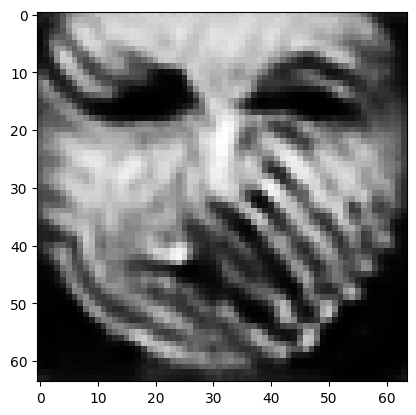

tensor([[2.6638e-05, 4.4761e-04, 2.9998e-04, 9.9614e-01, 1.9409e-06, 6.6308e-05,
         3.1013e-07, 1.1162e-04, 2.0220e-04, 8.4166e-07, 4.7643e-06, 6.0287e-06,
         8.8051e-04, 5.1339e-05, 3.3665e-06, 2.0908e-06, 5.2692e-05, 8.4603e-06,
         2.0796e-05, 2.7599e-05, 2.2955e-06, 2.5623e-07, 1.2182e-05, 3.8222e-06,
         1.0346e-04, 1.2631e-04, 3.4496e-06, 1.0118e-05, 1.2085e-05, 1.7643e-05,
         7.8077e-04, 8.3102e-06, 2.6737e-05, 1.3857e-06, 1.6900e-04, 2.4426e-05,
         8.2757e-06, 3.1976e-04, 1.2719e-05, 1.4739e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0038669349160045385
tensor([[2.6626e-05, 4.4714e-04, 2.9968e-04, 9.9615e-01, 1.9383e-06, 6.6250e-05,
         3.0970e-07, 1.1155e-04, 2.0193e-04, 8.4058e-07, 4.7574e-06, 6.0201e-06,
         8.7926e-04, 5.1265e-05, 3.3627e-06, 2.0885e-06, 5.2649e-05, 8.4505e-06,
         2.0780e-05, 2.7571e-05, 2.2920e-06, 2.5588e-07, 1.2160e-05, 3.8191e-06,
         1.0337e-04, 1.2614e-04, 3.4451e

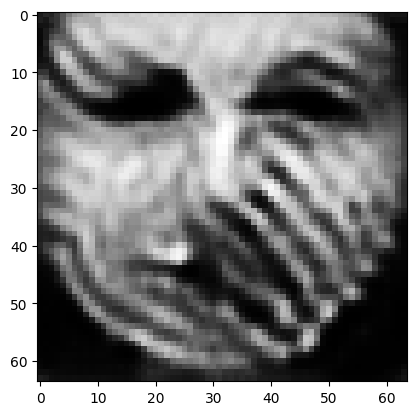

tensor([[2.6577e-05, 4.4532e-04, 2.9850e-04, 9.9616e-01, 1.9279e-06, 6.6019e-05,
         3.0801e-07, 1.1126e-04, 2.0090e-04, 8.3641e-07, 4.7307e-06, 5.9866e-06,
         8.7443e-04, 5.0976e-05, 3.3483e-06, 2.0797e-06, 5.2481e-05, 8.4125e-06,
         2.0717e-05, 2.7463e-05, 2.2786e-06, 2.5452e-07, 1.2077e-05, 3.8067e-06,
         1.0305e-04, 1.2550e-04, 3.4277e-06, 1.0042e-05, 1.2018e-05, 1.7538e-05,
         7.7371e-04, 8.2744e-06, 2.6535e-05, 1.3743e-06, 1.6840e-04, 2.4276e-05,
         8.2196e-06, 3.1839e-04, 1.2632e-05, 1.4611e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003842709818854928
tensor([[2.6565e-05, 4.4487e-04, 2.9821e-04, 9.9617e-01, 1.9254e-06, 6.5962e-05,
         3.0760e-07, 1.1119e-04, 2.0064e-04, 8.3538e-07, 4.7242e-06, 5.9784e-06,
         8.7326e-04, 5.0907e-05, 3.3448e-06, 2.0775e-06, 5.2440e-05, 8.4033e-06,
         2.0701e-05, 2.7436e-05, 2.2753e-06, 2.5419e-07, 1.2057e-05, 3.8036e-06,
         1.0297e-04, 1.2534e-04, 3.4234e-

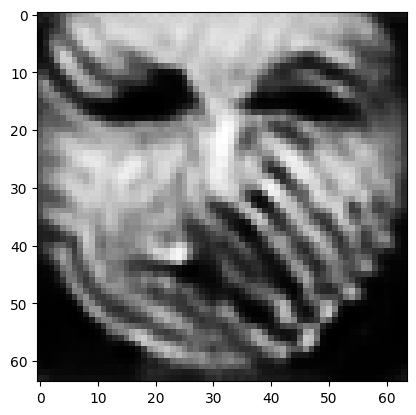

tensor([[2.6520e-05, 4.4315e-04, 2.9709e-04, 9.9619e-01, 1.9156e-06, 6.5746e-05,
         3.0601e-07, 1.1092e-04, 1.9966e-04, 8.3145e-07, 4.6990e-06, 5.9468e-06,
         8.6869e-04, 5.0632e-05, 3.3311e-06, 2.0692e-06, 5.2281e-05, 8.3673e-06,
         2.0642e-05, 2.7334e-05, 2.2626e-06, 2.5291e-07, 1.1979e-05, 3.7919e-06,
         1.0266e-04, 1.2473e-04, 3.4071e-06, 9.9698e-06, 1.1955e-05, 1.7439e-05,
         7.6706e-04, 8.2405e-06, 2.6343e-05, 1.3635e-06, 1.6783e-04, 2.4133e-05,
         8.1664e-06, 3.1708e-04, 1.2550e-05, 1.4489e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0038200279232114553
tensor([[2.6509e-05, 4.4273e-04, 2.9682e-04, 9.9619e-01, 1.9133e-06, 6.5694e-05,
         3.0562e-07, 1.1085e-04, 1.9943e-04, 8.3051e-07, 4.6929e-06, 5.9392e-06,
         8.6759e-04, 5.0566e-05, 3.3278e-06, 2.0672e-06, 5.2243e-05, 8.3587e-06,
         2.0627e-05, 2.7310e-05, 2.2595e-06, 2.5260e-07, 1.1960e-05, 3.7891e-06,
         1.0259e-04, 1.2458e-04, 3.4031e

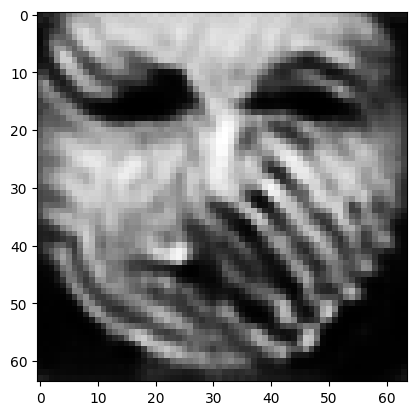

tensor([[2.6468e-05, 4.4111e-04, 2.9576e-04, 9.9621e-01, 1.9041e-06, 6.5490e-05,
         3.0414e-07, 1.1060e-04, 1.9851e-04, 8.2684e-07, 4.6694e-06, 5.9096e-06,
         8.6330e-04, 5.0308e-05, 3.3151e-06, 2.0593e-06, 5.2092e-05, 8.3252e-06,
         2.0572e-05, 2.7215e-05, 2.2477e-06, 2.5140e-07, 1.1886e-05, 3.7780e-06,
         1.0230e-04, 1.2401e-04, 3.3878e-06, 9.9029e-06, 1.1896e-05, 1.7346e-05,
         7.6083e-04, 8.2087e-06, 2.6163e-05, 1.3534e-06, 1.6730e-04, 2.4000e-05,
         8.1163e-06, 3.1585e-04, 1.2474e-05, 1.4376e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037986517418175936
tensor([[2.6457e-05, 4.4071e-04, 2.9551e-04, 9.9621e-01, 1.9019e-06, 6.5439e-05,
         3.0379e-07, 1.1054e-04, 1.9829e-04, 8.2594e-07, 4.6638e-06, 5.9024e-06,
         8.6227e-04, 5.0246e-05, 3.3121e-06, 2.0574e-06, 5.2056e-05, 8.3172e-06,
         2.0558e-05, 2.7192e-05, 2.2448e-06, 2.5111e-07, 1.1868e-05, 3.7754e-06,
         1.0223e-04, 1.2387e-04, 3.3841e

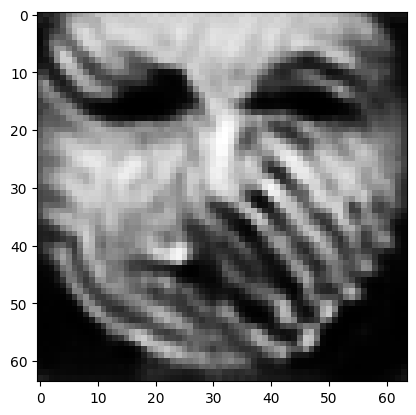

tensor([[2.6418e-05, 4.3920e-04, 2.9453e-04, 9.9623e-01, 1.8935e-06, 6.5249e-05,
         3.0242e-07, 1.1030e-04, 1.9744e-04, 8.2253e-07, 4.6420e-06, 5.8749e-06,
         8.5829e-04, 5.0008e-05, 3.3004e-06, 2.0502e-06, 5.1918e-05, 8.2866e-06,
         2.0506e-05, 2.7105e-05, 2.2339e-06, 2.5000e-07, 1.1799e-05, 3.7653e-06,
         1.0196e-04, 1.2333e-04, 3.3698e-06, 9.8407e-06, 1.1841e-05, 1.7260e-05,
         7.5503e-04, 8.1791e-06, 2.5996e-05, 1.3440e-06, 1.6681e-04, 2.3877e-05,
         8.0696e-06, 3.1471e-04, 1.2403e-05, 1.4270e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037788189947605133
tensor([[2.6409e-05, 4.3883e-04, 2.9429e-04, 9.9623e-01, 1.8915e-06, 6.5202e-05,
         3.0209e-07, 1.1024e-04, 1.9723e-04, 8.2169e-07, 4.6368e-06, 5.8682e-06,
         8.5733e-04, 4.9951e-05, 3.2976e-06, 2.0484e-06, 5.1885e-05, 8.2794e-06,
         2.0494e-05, 2.7084e-05, 2.2312e-06, 2.4974e-07, 1.1783e-05, 3.7629e-06,
         1.0189e-04, 1.2320e-04, 3.3663e

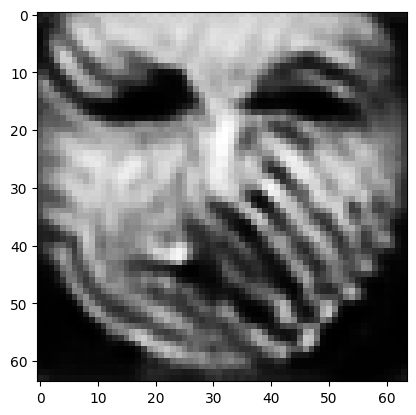

tensor([[2.6370e-05, 4.3745e-04, 2.9333e-04, 9.9625e-01, 1.8835e-06, 6.5017e-05,
         3.0081e-07, 1.1001e-04, 1.9644e-04, 8.1843e-07, 4.6161e-06, 5.8424e-06,
         8.5366e-04, 4.9729e-05, 3.2868e-06, 2.0415e-06, 5.1751e-05, 8.2508e-06,
         2.0443e-05, 2.7001e-05, 2.2210e-06, 2.4868e-07, 1.1720e-05, 3.7532e-06,
         1.0164e-04, 1.2270e-04, 3.3529e-06, 9.7822e-06, 1.1788e-05, 1.7179e-05,
         7.4967e-04, 8.1518e-06, 2.5841e-05, 1.3352e-06, 1.6635e-04, 2.3764e-05,
         8.0261e-06, 3.1362e-04, 1.2336e-05, 1.4171e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037602924276143312
tensor([[2.6360e-05, 4.3712e-04, 2.9310e-04, 9.9625e-01, 1.8815e-06, 6.4972e-05,
         3.0051e-07, 1.0995e-04, 1.9625e-04, 8.1764e-07, 4.6111e-06, 5.8362e-06,
         8.5278e-04, 4.9675e-05, 3.2842e-06, 2.0399e-06, 5.1719e-05, 8.2439e-06,
         2.0432e-05, 2.6981e-05, 2.2185e-06, 2.4843e-07, 1.1705e-05, 3.7508e-06,
         1.0158e-04, 1.2258e-04, 3.3498e

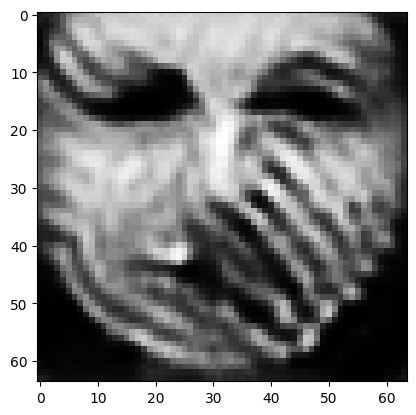

tensor([[2.6323e-05, 4.3584e-04, 2.9219e-04, 9.9626e-01, 1.8740e-06, 6.4798e-05,
         2.9932e-07, 1.0973e-04, 1.9550e-04, 8.1458e-07, 4.5918e-06, 5.8120e-06,
         8.4936e-04, 4.9468e-05, 3.2741e-06, 2.0334e-06, 5.1593e-05, 8.2173e-06,
         2.0385e-05, 2.6904e-05, 2.2090e-06, 2.4745e-07, 1.1646e-05, 3.7416e-06,
         1.0134e-04, 1.2211e-04, 3.3375e-06, 9.7272e-06, 1.1737e-05, 1.7106e-05,
         7.4468e-04, 8.1265e-06, 2.5698e-05, 1.3270e-06, 1.6591e-04, 2.3660e-05,
         7.9854e-06, 3.1259e-04, 1.2273e-05, 1.4079e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003742834320291877
tensor([[2.6314e-05, 4.3552e-04, 2.9197e-04, 9.9627e-01, 1.8722e-06, 6.4755e-05,
         2.9903e-07, 1.0967e-04, 1.9532e-04, 8.1384e-07, 4.5871e-06, 5.8062e-06,
         8.4853e-04, 4.9419e-05, 3.2716e-06, 2.0319e-06, 5.1562e-05, 8.2110e-06,
         2.0373e-05, 2.6885e-05, 2.2067e-06, 2.4721e-07, 1.1632e-05, 3.7394e-06,
         1.0128e-04, 1.2199e-04, 3.3345e-

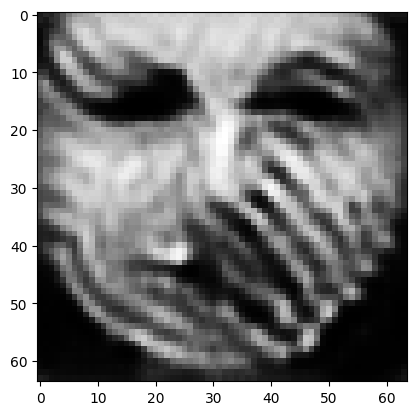

tensor([[2.6280e-05, 4.3432e-04, 2.9113e-04, 9.9628e-01, 1.8652e-06, 6.4594e-05,
         2.9792e-07, 1.0947e-04, 1.9463e-04, 8.1098e-07, 4.5691e-06, 5.7836e-06,
         8.4533e-04, 4.9225e-05, 3.2622e-06, 2.0259e-06, 5.1444e-05, 8.1862e-06,
         2.0329e-05, 2.6812e-05, 2.1977e-06, 2.4629e-07, 1.1577e-05, 3.7308e-06,
         1.0106e-04, 1.2155e-04, 3.3230e-06, 9.6760e-06, 1.1690e-05, 1.7037e-05,
         7.4001e-04, 8.1030e-06, 2.5564e-05, 1.3194e-06, 1.6550e-04, 2.3562e-05,
         7.9475e-06, 3.1163e-04, 1.2215e-05, 1.3993e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037265634164214134
tensor([[2.6271e-05, 4.3403e-04, 2.9092e-04, 9.9628e-01, 1.8635e-06, 6.4554e-05,
         2.9765e-07, 1.0942e-04, 1.9446e-04, 8.1029e-07, 4.5648e-06, 5.7781e-06,
         8.4455e-04, 4.9178e-05, 3.2599e-06, 2.0244e-06, 5.1416e-05, 8.1802e-06,
         2.0318e-05, 2.6795e-05, 2.1955e-06, 2.4607e-07, 1.1564e-05, 3.7288e-06,
         1.0101e-04, 1.2145e-04, 3.3202e

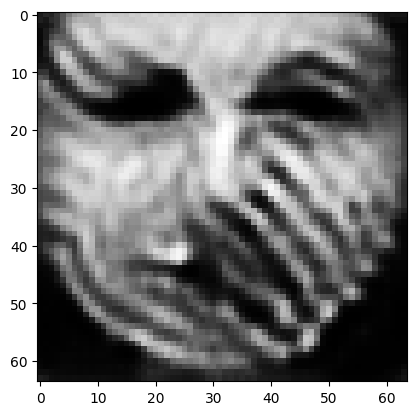

tensor([[2.6239e-05, 4.3291e-04, 2.9012e-04, 9.9630e-01, 1.8569e-06, 6.4401e-05,
         2.9661e-07, 1.0923e-04, 1.9380e-04, 8.0759e-07, 4.5479e-06, 5.7568e-06,
         8.4152e-04, 4.8996e-05, 3.2511e-06, 2.0187e-06, 5.1304e-05, 8.1570e-06,
         2.0277e-05, 2.6726e-05, 2.1870e-06, 2.4521e-07, 1.1513e-05, 3.7207e-06,
         1.0079e-04, 1.2103e-04, 3.3094e-06, 9.6280e-06, 1.1645e-05, 1.6972e-05,
         7.3562e-04, 8.0810e-06, 2.5439e-05, 1.3122e-06, 1.6510e-04, 2.3470e-05,
         7.9118e-06, 3.1073e-04, 1.2160e-05, 1.3911e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037114801816642284
tensor([[2.6231e-05, 4.3263e-04, 2.8993e-04, 9.9630e-01, 1.8553e-06, 6.4363e-05,
         2.9635e-07, 1.0918e-04, 1.9364e-04, 8.0693e-07, 4.5438e-06, 5.7516e-06,
         8.4078e-04, 4.8952e-05, 3.2490e-06, 2.0173e-06, 5.1277e-05, 8.1513e-06,
         2.0267e-05, 2.6710e-05, 2.1849e-06, 2.4500e-07, 1.1500e-05, 3.7187e-06,
         1.0074e-04, 1.2093e-04, 3.3067e

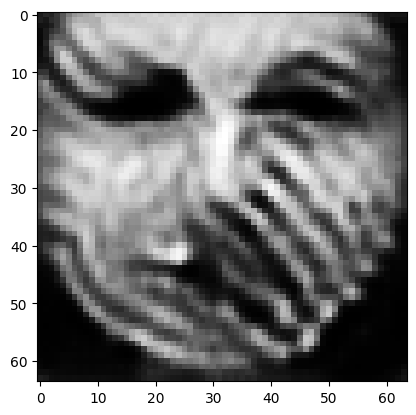

tensor([[2.6200e-05, 4.3155e-04, 2.8917e-04, 9.9631e-01, 1.8490e-06, 6.4215e-05,
         2.9536e-07, 1.0899e-04, 1.9301e-04, 8.0436e-07, 4.5277e-06, 5.7313e-06,
         8.3792e-04, 4.8780e-05, 3.2406e-06, 2.0119e-06, 5.1171e-05, 8.1292e-06,
         2.0227e-05, 2.6645e-05, 2.1769e-06, 2.4418e-07, 1.1451e-05, 3.7111e-06,
         1.0054e-04, 1.2054e-04, 3.2963e-06, 9.5824e-06, 1.1603e-05, 1.6910e-05,
         7.3150e-04, 8.0601e-06, 2.5320e-05, 1.3054e-06, 1.6473e-04, 2.3383e-05,
         7.8781e-06, 3.0987e-04, 1.2108e-05, 1.3834e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036967527121305466
tensor([[2.6192e-05, 4.3129e-04, 2.8898e-04, 9.9631e-01, 1.8474e-06, 6.4179e-05,
         2.9512e-07, 1.0895e-04, 1.9286e-04, 8.0374e-07, 4.5238e-06, 5.7264e-06,
         8.3722e-04, 4.8737e-05, 3.2386e-06, 2.0106e-06, 5.1145e-05, 8.1238e-06,
         2.0218e-05, 2.6629e-05, 2.1749e-06, 2.4398e-07, 1.1440e-05, 3.7092e-06,
         1.0049e-04, 1.2044e-04, 3.2938e

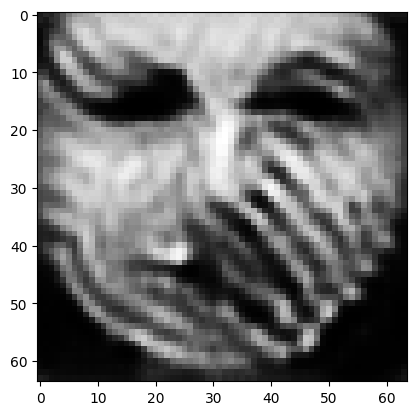

tensor([[2.6162e-05, 4.3026e-04, 2.8825e-04, 9.9632e-01, 1.8414e-06, 6.4038e-05,
         2.9418e-07, 1.0877e-04, 1.9227e-04, 8.0130e-07, 4.5086e-06, 5.7072e-06,
         8.3449e-04, 4.8574e-05, 3.2307e-06, 2.0055e-06, 5.1045e-05, 8.1027e-06,
         2.0180e-05, 2.6567e-05, 2.1672e-06, 2.4321e-07, 1.1393e-05, 3.7019e-06,
         1.0030e-04, 1.2007e-04, 3.2840e-06, 9.5390e-06, 1.1562e-05, 1.6851e-05,
         7.2759e-04, 8.0404e-06, 2.5207e-05, 1.2989e-06, 1.6438e-04, 2.3301e-05,
         7.8461e-06, 3.0906e-04, 1.2058e-05, 1.3760e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036830941680818796
tensor([[2.6155e-05, 4.3002e-04, 2.8807e-04, 9.9633e-01, 1.8400e-06, 6.4004e-05,
         2.9395e-07, 1.0873e-04, 1.9213e-04, 8.0071e-07, 4.5049e-06, 5.7025e-06,
         8.3383e-04, 4.8535e-05, 3.2288e-06, 2.0042e-06, 5.1021e-05, 8.0976e-06,
         2.0171e-05, 2.6552e-05, 2.1654e-06, 2.4302e-07, 1.1382e-05, 3.7001e-06,
         1.0026e-04, 1.1998e-04, 3.2817e

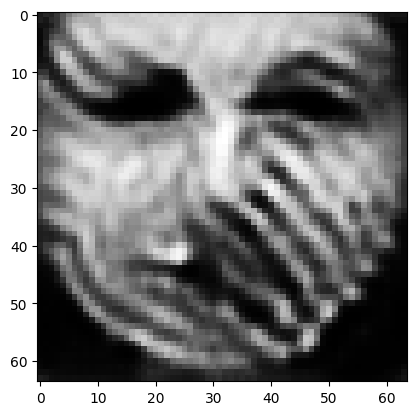

tensor([[2.6127e-05, 4.2905e-04, 2.8739e-04, 9.9634e-01, 1.8343e-06, 6.3870e-05,
         2.9307e-07, 1.0856e-04, 1.9157e-04, 7.9840e-07, 4.4905e-06, 5.6843e-06,
         8.3126e-04, 4.8380e-05, 3.2213e-06, 1.9994e-06, 5.0925e-05, 8.0776e-06,
         2.0135e-05, 2.6494e-05, 2.1582e-06, 2.4229e-07, 1.1339e-05, 3.6931e-06,
         1.0007e-04, 1.1962e-04, 3.2725e-06, 9.4980e-06, 1.1524e-05, 1.6796e-05,
         7.2392e-04, 8.0216e-06, 2.5101e-05, 1.2929e-06, 1.6404e-04, 2.3224e-05,
         7.8158e-06, 3.0829e-04, 1.2011e-05, 1.3691e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003670266829431057
tensor([[2.6119e-05, 4.2882e-04, 2.8722e-04, 9.9634e-01, 1.8329e-06, 6.3837e-05,
         2.9285e-07, 1.0852e-04, 1.9143e-04, 7.9783e-07, 4.4870e-06, 5.6799e-06,
         8.3063e-04, 4.8343e-05, 3.2194e-06, 1.9982e-06, 5.0902e-05, 8.0727e-06,
         2.0126e-05, 2.6479e-05, 2.1564e-06, 2.4211e-07, 1.1328e-05, 3.6915e-06,
         1.0003e-04, 1.1954e-04, 3.2702e-

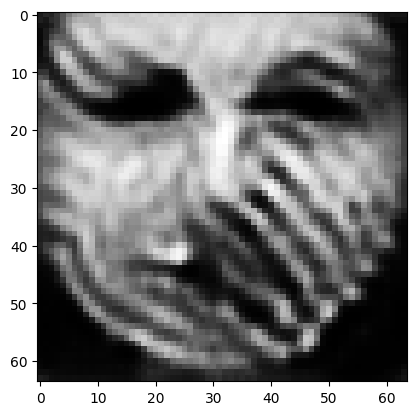

tensor([[2.6092e-05, 4.2790e-04, 2.8656e-04, 9.9635e-01, 1.8275e-06, 6.3709e-05,
         2.9200e-07, 1.0835e-04, 1.9090e-04, 7.9563e-07, 4.4732e-06, 5.6625e-06,
         8.2820e-04, 4.8196e-05, 3.2122e-06, 1.9935e-06, 5.0811e-05, 8.0535e-06,
         2.0092e-05, 2.6424e-05, 2.1495e-06, 2.4141e-07, 1.1287e-05, 3.6848e-06,
         9.9860e-05, 1.1920e-04, 3.2613e-06, 9.4590e-06, 1.1487e-05, 1.6744e-05,
         7.2044e-04, 8.0038e-06, 2.5000e-05, 1.2871e-06, 1.6372e-04, 2.3151e-05,
         7.7872e-06, 3.0755e-04, 1.1967e-05, 1.3625e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036577957216650248
tensor([[2.6085e-05, 4.2767e-04, 2.8640e-04, 9.9635e-01, 1.8262e-06, 6.3677e-05,
         2.9180e-07, 1.0832e-04, 1.9077e-04, 7.9509e-07, 4.4698e-06, 5.6583e-06,
         8.2761e-04, 4.8161e-05, 3.2104e-06, 1.9923e-06, 5.0789e-05, 8.0488e-06,
         2.0084e-05, 2.6410e-05, 2.1478e-06, 2.4124e-07, 1.1277e-05, 3.6832e-06,
         9.9819e-05, 1.1912e-04, 3.2592e

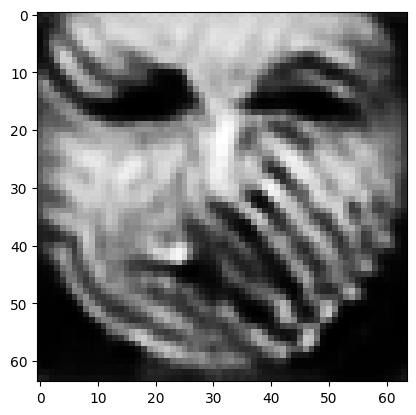

tensor([[2.6059e-05, 4.2681e-04, 2.8577e-04, 9.9636e-01, 1.8211e-06, 6.3558e-05,
         2.9101e-07, 1.0817e-04, 1.9027e-04, 7.9304e-07, 4.4568e-06, 5.6420e-06,
         8.2531e-04, 4.8022e-05, 3.2037e-06, 1.9880e-06, 5.0703e-05, 8.0306e-06,
         2.0052e-05, 2.6358e-05, 2.1413e-06, 2.4058e-07, 1.1238e-05, 3.6770e-06,
         9.9656e-05, 1.1881e-04, 3.2510e-06, 9.4222e-06, 1.1453e-05, 1.6694e-05,
         7.1714e-04, 7.9870e-06, 2.4905e-05, 1.2817e-06, 1.6342e-04, 2.3081e-05,
         7.7600e-06, 3.0685e-04, 1.1925e-05, 1.3563e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003646155819296837
tensor([[2.6053e-05, 4.2660e-04, 2.8562e-04, 9.9636e-01, 1.8199e-06, 6.3529e-05,
         2.9082e-07, 1.0813e-04, 1.9014e-04, 7.9253e-07, 4.4537e-06, 5.6381e-06,
         8.2476e-04, 4.7989e-05, 3.2020e-06, 1.9869e-06, 5.0682e-05, 8.0263e-06,
         2.0044e-05, 2.6345e-05, 2.1398e-06, 2.4043e-07, 1.1229e-05, 3.6755e-06,
         9.9617e-05, 1.1873e-04, 3.2489e-

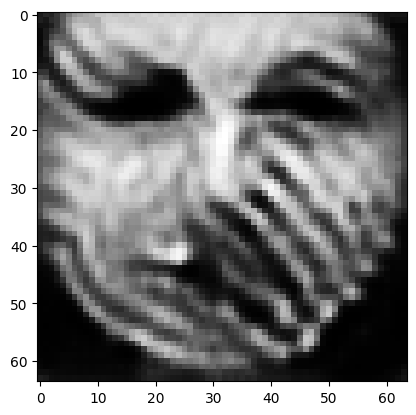

tensor([[2.6029e-05, 4.2579e-04, 2.8504e-04, 9.9637e-01, 1.8150e-06, 6.3417e-05,
         2.9007e-07, 1.0798e-04, 1.8967e-04, 7.9060e-07, 4.4416e-06, 5.6228e-06,
         8.2261e-04, 4.7858e-05, 3.1956e-06, 1.9828e-06, 5.0600e-05, 8.0091e-06,
         2.0013e-05, 2.6295e-05, 2.1337e-06, 2.3981e-07, 1.1192e-05, 3.6696e-06,
         9.9462e-05, 1.1843e-04, 3.2413e-06, 9.3876e-06, 1.1421e-05, 1.6648e-05,
         7.1405e-04, 7.9711e-06, 2.4815e-05, 1.2766e-06, 1.6313e-04, 2.3016e-05,
         7.7344e-06, 3.0619e-04, 1.1886e-05, 1.3505e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00363522837869823
tensor([[2.6024e-05, 4.2559e-04, 2.8490e-04, 9.9637e-01, 1.8139e-06, 6.3390e-05,
         2.8989e-07, 1.0795e-04, 1.8956e-04, 7.9013e-07, 4.4386e-06, 5.6191e-06,
         8.2208e-04, 4.7826e-05, 3.1940e-06, 1.9818e-06, 5.0580e-05, 8.0049e-06,
         2.0006e-05, 2.6283e-05, 2.1322e-06, 2.3966e-07, 1.1183e-05, 3.6682e-06,
         9.9424e-05, 1.1836e-04, 3.2394e-0

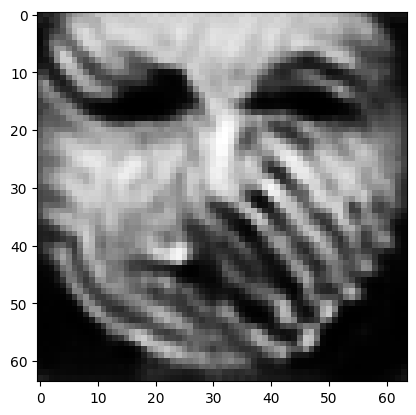

tensor([[2.6000e-05, 4.2481e-04, 2.8434e-04, 9.9638e-01, 1.8094e-06, 6.3283e-05,
         2.8919e-07, 1.0782e-04, 1.8911e-04, 7.8828e-07, 4.4271e-06, 5.6046e-06,
         8.2006e-04, 4.7704e-05, 3.1879e-06, 1.9779e-06, 5.0504e-05, 7.9886e-06,
         1.9977e-05, 2.6236e-05, 2.1264e-06, 2.3908e-07, 1.1149e-05, 3.6627e-06,
         9.9283e-05, 1.1808e-04, 3.2319e-06, 9.3552e-06, 1.1390e-05, 1.6604e-05,
         7.1115e-04, 7.9560e-06, 2.4731e-05, 1.2718e-06, 1.6286e-04, 2.2954e-05,
         7.7104e-06, 3.0557e-04, 1.1849e-05, 1.3450e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036250133998692036
tensor([[2.5994e-05, 4.2462e-04, 2.8421e-04, 9.9638e-01, 1.8083e-06, 6.3256e-05,
         2.8901e-07, 1.0778e-04, 1.8900e-04, 7.8783e-07, 4.4243e-06, 5.6010e-06,
         8.1956e-04, 4.7675e-05, 3.1864e-06, 1.9769e-06, 5.0485e-05, 7.9846e-06,
         1.9969e-05, 2.6224e-05, 2.1250e-06, 2.3894e-07, 1.1141e-05, 3.6614e-06,
         9.9247e-05, 1.1802e-04, 3.2301e

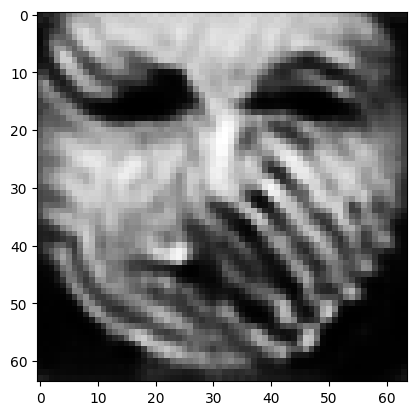

tensor([[2.5972e-05, 4.2388e-04, 2.8368e-04, 9.9639e-01, 1.8041e-06, 6.3154e-05,
         2.8835e-07, 1.0765e-04, 1.8858e-04, 7.8607e-07, 4.4133e-06, 5.5872e-06,
         8.1765e-04, 4.7559e-05, 3.1805e-06, 1.9732e-06, 5.0413e-05, 7.9690e-06,
         1.9941e-05, 2.6179e-05, 2.1195e-06, 2.3839e-07, 1.1109e-05, 3.6562e-06,
         9.9113e-05, 1.1776e-04, 3.2229e-06, 9.3244e-06, 1.1361e-05, 1.6563e-05,
         7.0843e-04, 7.9418e-06, 2.4651e-05, 1.2673e-06, 1.6260e-04, 2.2896e-05,
         7.6879e-06, 3.0497e-04, 1.1814e-05, 1.3398e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036153923720121384
tensor([[2.5967e-05, 4.2370e-04, 2.8355e-04, 9.9639e-01, 1.8030e-06, 6.3129e-05,
         2.8818e-07, 1.0762e-04, 1.8847e-04, 7.8565e-07, 4.4107e-06, 5.5839e-06,
         8.1718e-04, 4.7531e-05, 3.1791e-06, 1.9723e-06, 5.0395e-05, 7.9653e-06,
         1.9935e-05, 2.6168e-05, 2.1182e-06, 2.3825e-07, 1.1101e-05, 3.6549e-06,
         9.9080e-05, 1.1769e-04, 3.2212e

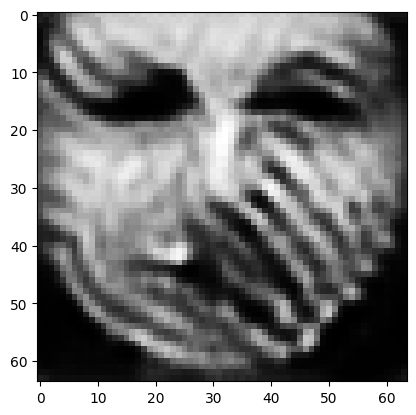

tensor([[2.5945e-05, 4.2299e-04, 2.8306e-04, 9.9640e-01, 1.7991e-06, 6.3031e-05,
         2.8755e-07, 1.0750e-04, 1.8807e-04, 7.8398e-07, 4.4003e-06, 5.5708e-06,
         8.1537e-04, 4.7423e-05, 3.1735e-06, 1.9687e-06, 5.0328e-05, 7.9505e-06,
         1.9908e-05, 2.6125e-05, 2.1129e-06, 2.3774e-07, 1.1071e-05, 3.6501e-06,
         9.8958e-05, 1.1745e-04, 3.2143e-06, 9.2954e-06, 1.1333e-05, 1.6523e-05,
         7.0587e-04, 7.9283e-06, 2.4576e-05, 1.2630e-06, 1.6235e-04, 2.2841e-05,
         7.6668e-06, 3.0441e-04, 1.1781e-05, 1.3348e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036060088314116
tensor([[2.5940e-05, 4.2282e-04, 2.8293e-04, 9.9640e-01, 1.7981e-06, 6.3007e-05,
         2.8740e-07, 1.0747e-04, 1.8797e-04, 7.8357e-07, 4.3977e-06, 5.5676e-06,
         8.1493e-04, 4.7396e-05, 3.1721e-06, 1.9679e-06, 5.0311e-05, 7.9468e-06,
         1.9901e-05, 2.6114e-05, 2.1117e-06, 2.3761e-07, 1.1064e-05, 3.6488e-06,
         9.8926e-05, 1.1739e-04, 3.2127e-06

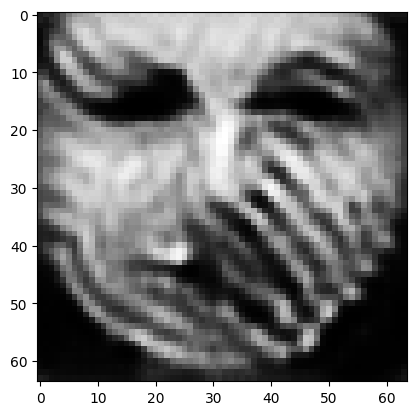

tensor([[2.5920e-05, 4.2213e-04, 2.8247e-04, 9.9641e-01, 1.7942e-06, 6.2918e-05,
         2.8679e-07, 1.0736e-04, 1.8758e-04, 7.8199e-07, 4.3877e-06, 5.5550e-06,
         8.1319e-04, 4.7289e-05, 3.1667e-06, 1.9644e-06, 5.0244e-05, 7.9324e-06,
         1.9875e-05, 2.6074e-05, 2.1067e-06, 2.3712e-07, 1.1034e-05, 3.6441e-06,
         9.8798e-05, 1.1715e-04, 3.2062e-06, 9.2672e-06, 1.1307e-05, 1.6484e-05,
         7.0338e-04, 7.9151e-06, 2.4502e-05, 1.2589e-06, 1.6212e-04, 2.2786e-05,
         7.6460e-06, 3.0386e-04, 1.1749e-05, 1.3301e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035973377525806427
tensor([[2.5916e-05, 4.2196e-04, 2.8235e-04, 9.9641e-01, 1.7933e-06, 6.2897e-05,
         2.8664e-07, 1.0733e-04, 1.8748e-04, 7.8162e-07, 4.3853e-06, 5.5520e-06,
         8.1276e-04, 4.7263e-05, 3.1654e-06, 1.9636e-06, 5.0228e-05, 7.9289e-06,
         1.9869e-05, 2.6064e-05, 2.1055e-06, 2.3700e-07, 1.1026e-05, 3.6429e-06,
         9.8766e-05, 1.1709e-04, 3.2047e

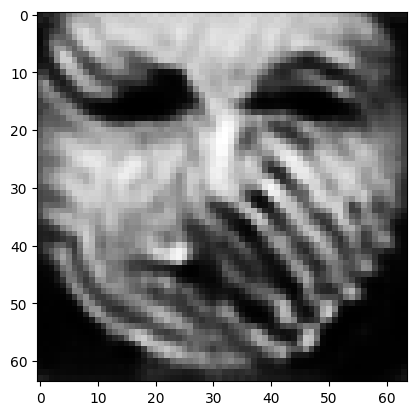

tensor([[2.5897e-05, 4.2128e-04, 2.8191e-04, 9.9642e-01, 1.7897e-06, 6.2811e-05,
         2.8607e-07, 1.0723e-04, 1.8710e-04, 7.8010e-07, 4.3757e-06, 5.5399e-06,
         8.1109e-04, 4.7161e-05, 3.1602e-06, 1.9604e-06, 5.0166e-05, 7.9151e-06,
         1.9844e-05, 2.6025e-05, 2.1007e-06, 2.3653e-07, 1.0998e-05, 3.6384e-06,
         9.8646e-05, 1.1686e-04, 3.1984e-06, 9.2403e-06, 1.1282e-05, 1.6447e-05,
         7.0100e-04, 7.9024e-06, 2.4432e-05, 1.2549e-06, 1.6189e-04, 2.2734e-05,
         7.6262e-06, 3.0334e-04, 1.1719e-05, 1.3257e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003588547930121422
tensor([[2.5893e-05, 4.2112e-04, 2.8180e-04, 9.9642e-01, 1.7888e-06, 6.2791e-05,
         2.8593e-07, 1.0720e-04, 1.8701e-04, 7.7973e-07, 4.3734e-06, 5.5369e-06,
         8.1068e-04, 4.7136e-05, 3.1589e-06, 1.9596e-06, 5.0151e-05, 7.9117e-06,
         1.9838e-05, 2.6016e-05, 2.0995e-06, 2.3642e-07, 1.0991e-05, 3.6373e-06,
         9.8616e-05, 1.1680e-04, 3.1969e-

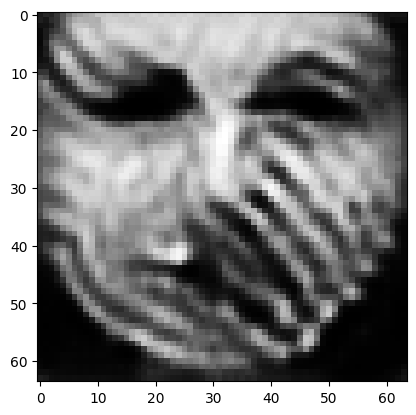

tensor([[2.5875e-05, 4.2047e-04, 2.8137e-04, 9.9643e-01, 1.7853e-06, 6.2710e-05,
         2.8539e-07, 1.0710e-04, 1.8665e-04, 7.7829e-07, 4.3643e-06, 5.5254e-06,
         8.0910e-04, 4.7040e-05, 3.1540e-06, 1.9565e-06, 5.0092e-05, 7.8988e-06,
         1.9814e-05, 2.5979e-05, 2.0950e-06, 2.3597e-07, 1.0964e-05, 3.6330e-06,
         9.8501e-05, 1.1658e-04, 3.1910e-06, 9.2146e-06, 1.1258e-05, 1.6411e-05,
         6.9872e-04, 7.8903e-06, 2.4366e-05, 1.2512e-06, 1.6167e-04, 2.2685e-05,
         7.6075e-06, 3.0284e-04, 1.1690e-05, 1.3214e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035804708022624254
tensor([[2.5871e-05, 4.2031e-04, 2.8127e-04, 9.9643e-01, 1.7845e-06, 6.2690e-05,
         2.8526e-07, 1.0707e-04, 1.8657e-04, 7.7794e-07, 4.3621e-06, 5.5226e-06,
         8.0871e-04, 4.7016e-05, 3.1528e-06, 1.9557e-06, 5.0078e-05, 7.8956e-06,
         1.9808e-05, 2.5971e-05, 2.0939e-06, 2.3586e-07, 1.0957e-05, 3.6319e-06,
         9.8473e-05, 1.1653e-04, 3.1896e

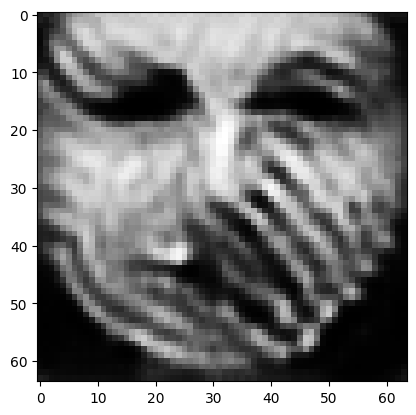

tensor([[2.5855e-05, 4.1970e-04, 2.8087e-04, 9.9643e-01, 1.7812e-06, 6.2614e-05,
         2.8475e-07, 1.0697e-04, 1.8623e-04, 7.7659e-07, 4.3536e-06, 5.5117e-06,
         8.0721e-04, 4.6925e-05, 3.1481e-06, 1.9529e-06, 5.0024e-05, 7.8834e-06,
         1.9786e-05, 2.5936e-05, 2.0897e-06, 2.3545e-07, 1.0932e-05, 3.6279e-06,
         9.8364e-05, 1.1632e-04, 3.1840e-06, 9.1904e-06, 1.1235e-05, 1.6377e-05,
         6.9657e-04, 7.8790e-06, 2.4303e-05, 1.2477e-06, 1.6147e-04, 2.2638e-05,
         7.5897e-06, 3.0237e-04, 1.1662e-05, 1.3174e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003572868648916483
tensor([[2.5851e-05, 4.1955e-04, 2.8077e-04, 9.9643e-01, 1.7804e-06, 6.2596e-05,
         2.8462e-07, 1.0695e-04, 1.8615e-04, 7.7626e-07, 4.3515e-06, 5.5091e-06,
         8.0684e-04, 4.6903e-05, 3.1470e-06, 1.9521e-06, 5.0010e-05, 7.8804e-06,
         1.9780e-05, 2.5928e-05, 2.0886e-06, 2.3535e-07, 1.0926e-05, 3.6269e-06,
         9.8337e-05, 1.1627e-04, 3.1826e-

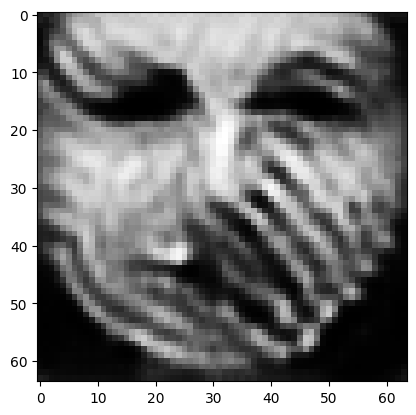

tensor([[2.5835e-05, 4.1897e-04, 2.8039e-04, 9.9644e-01, 1.7773e-06, 6.2524e-05,
         2.8414e-07, 1.0686e-04, 1.8582e-04, 7.7498e-07, 4.3434e-06, 5.4987e-06,
         8.0542e-04, 4.6816e-05, 3.1426e-06, 1.9494e-06, 4.9958e-05, 7.8687e-06,
         1.9759e-05, 2.5896e-05, 2.0846e-06, 2.3495e-07, 1.0902e-05, 3.6231e-06,
         9.8233e-05, 1.1607e-04, 3.1773e-06, 9.1676e-06, 1.1214e-05, 1.6344e-05,
         6.9455e-04, 7.8683e-06, 2.4244e-05, 1.2443e-06, 1.6128e-04, 2.2594e-05,
         7.5728e-06, 3.0192e-04, 1.1636e-05, 1.3136e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003565385239198804
tensor([[2.5831e-05, 4.1883e-04, 2.8029e-04, 9.9644e-01, 1.7766e-06, 6.2507e-05,
         2.8402e-07, 1.0684e-04, 1.8575e-04, 7.7466e-07, 4.3414e-06, 5.4962e-06,
         8.0507e-04, 4.6795e-05, 3.1415e-06, 1.9487e-06, 4.9945e-05, 7.8659e-06,
         1.9754e-05, 2.5888e-05, 2.0836e-06, 2.3486e-07, 1.0896e-05, 3.6222e-06,
         9.8208e-05, 1.1602e-04, 3.1760e-

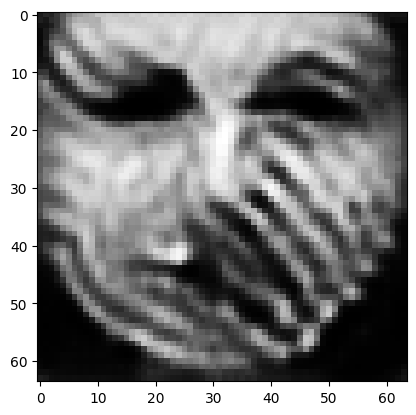

tensor([[2.5816e-05, 4.1828e-04, 2.7993e-04, 9.9645e-01, 1.7736e-06, 6.2439e-05,
         2.8356e-07, 1.0675e-04, 1.8544e-04, 7.7344e-07, 4.3337e-06, 5.4864e-06,
         8.0371e-04, 4.6714e-05, 3.1374e-06, 1.9461e-06, 4.9895e-05, 7.8548e-06,
         1.9734e-05, 2.5857e-05, 2.0797e-06, 2.3448e-07, 1.0873e-05, 3.6186e-06,
         9.8109e-05, 1.1584e-04, 3.1710e-06, 9.1459e-06, 1.1193e-05, 1.6313e-05,
         6.9262e-04, 7.8582e-06, 2.4187e-05, 1.2411e-06, 1.6110e-04, 2.2552e-05,
         7.5568e-06, 3.0149e-04, 1.1611e-05, 1.3099e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035586145240813494
tensor([[2.5813e-05, 4.1815e-04, 2.7984e-04, 9.9645e-01, 1.7729e-06, 6.2422e-05,
         2.8345e-07, 1.0673e-04, 1.8537e-04, 7.7315e-07, 4.3318e-06, 5.4840e-06,
         8.0339e-04, 4.6694e-05, 3.1363e-06, 1.9455e-06, 4.9884e-05, 7.8521e-06,
         1.9729e-05, 2.5850e-05, 2.0788e-06, 2.3439e-07, 1.0867e-05, 3.6177e-06,
         9.8085e-05, 1.1579e-04, 3.1698e

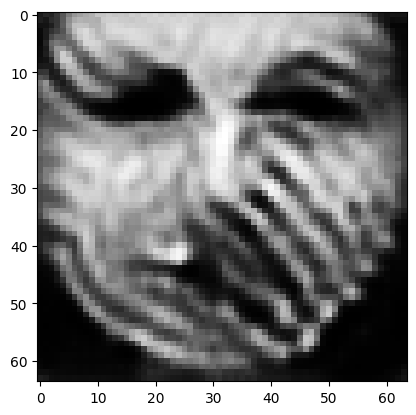

tensor([[2.5799e-05, 4.1763e-04, 2.7949e-04, 9.9645e-01, 1.7701e-06, 6.2358e-05,
         2.8302e-07, 1.0665e-04, 1.8507e-04, 7.7199e-07, 4.3245e-06, 5.4747e-06,
         8.0211e-04, 4.6616e-05, 3.1324e-06, 1.9431e-06, 4.9836e-05, 7.8416e-06,
         1.9710e-05, 2.5821e-05, 2.0752e-06, 2.3403e-07, 1.0846e-05, 3.6143e-06,
         9.7991e-05, 1.1561e-04, 3.1650e-06, 9.1254e-06, 1.1174e-05, 1.6284e-05,
         6.9080e-04, 7.8488e-06, 2.4134e-05, 1.2381e-06, 1.6092e-04, 2.2512e-05,
         7.5416e-06, 3.0108e-04, 1.1587e-05, 1.3064e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003552081063389778
tensor([[2.5795e-05, 4.1750e-04, 2.7941e-04, 9.9646e-01, 1.7694e-06, 6.2342e-05,
         2.8291e-07, 1.0663e-04, 1.8500e-04, 7.7170e-07, 4.3228e-06, 5.4724e-06,
         8.0180e-04, 4.6597e-05, 3.1315e-06, 1.9425e-06, 4.9825e-05, 7.8391e-06,
         1.9706e-05, 2.5814e-05, 2.0743e-06, 2.3395e-07, 1.0840e-05, 3.6134e-06,
         9.7968e-05, 1.1557e-04, 3.1638e-

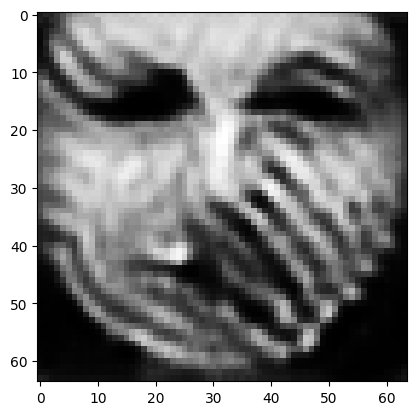

tensor([[2.5782e-05, 4.1701e-04, 2.7908e-04, 9.9646e-01, 1.7668e-06, 6.2281e-05,
         2.8250e-07, 1.0655e-04, 1.8473e-04, 7.7061e-07, 4.3159e-06, 5.4636e-06,
         8.0059e-04, 4.6524e-05, 3.1278e-06, 1.9402e-06, 4.9781e-05, 7.8291e-06,
         1.9688e-05, 2.5787e-05, 2.0709e-06, 2.3361e-07, 1.0820e-05, 3.6102e-06,
         9.7879e-05, 1.1540e-04, 3.1593e-06, 9.1060e-06, 1.1155e-05, 1.6256e-05,
         6.8907e-04, 7.8398e-06, 2.4083e-05, 1.2352e-06, 1.6076e-04, 2.2475e-05,
         7.5272e-06, 3.0070e-04, 1.1565e-05, 1.3032e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035459042992442846
tensor([[2.5778e-05, 4.1689e-04, 2.7900e-04, 9.9646e-01, 1.7661e-06, 6.2265e-05,
         2.8240e-07, 1.0653e-04, 1.8466e-04, 7.7035e-07, 4.3142e-06, 5.4615e-06,
         8.0029e-04, 4.6506e-05, 3.1269e-06, 1.9396e-06, 4.9770e-05, 7.8267e-06,
         1.9683e-05, 2.5780e-05, 2.0700e-06, 2.3353e-07, 1.0815e-05, 3.6095e-06,
         9.7858e-05, 1.1536e-04, 3.1582e

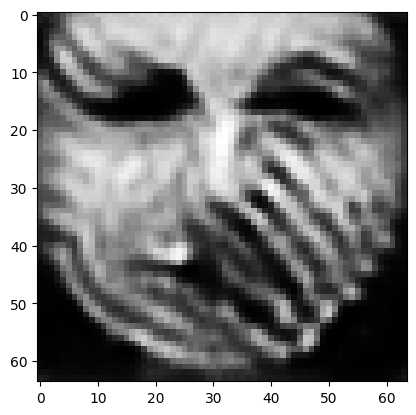

tensor([[2.5766e-05, 4.1642e-04, 2.7870e-04, 9.9647e-01, 1.7636e-06, 6.2207e-05,
         2.8201e-07, 1.0646e-04, 1.8440e-04, 7.6931e-07, 4.3077e-06, 5.4531e-06,
         7.9915e-04, 4.6437e-05, 3.1233e-06, 1.9374e-06, 4.9728e-05, 7.8173e-06,
         1.9666e-05, 2.5754e-05, 2.0668e-06, 2.3321e-07, 1.0795e-05, 3.6064e-06,
         9.7773e-05, 1.1520e-04, 3.1539e-06, 9.0876e-06, 1.1137e-05, 1.6230e-05,
         6.8745e-04, 7.8313e-06, 2.4035e-05, 1.2325e-06, 1.6060e-04, 2.2439e-05,
         7.5136e-06, 3.0033e-04, 1.1543e-05, 1.3000e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035399647895246744
tensor([[2.5763e-05, 4.1631e-04, 2.7862e-04, 9.9647e-01, 1.7630e-06, 6.2193e-05,
         2.8191e-07, 1.0644e-04, 1.8434e-04, 7.6906e-07, 4.3061e-06, 5.4512e-06,
         7.9887e-04, 4.6420e-05, 3.1225e-06, 1.9369e-06, 4.9717e-05, 7.8151e-06,
         1.9662e-05, 2.5748e-05, 2.0660e-06, 2.3314e-07, 1.0790e-05, 3.6057e-06,
         9.7752e-05, 1.1516e-04, 3.1529e

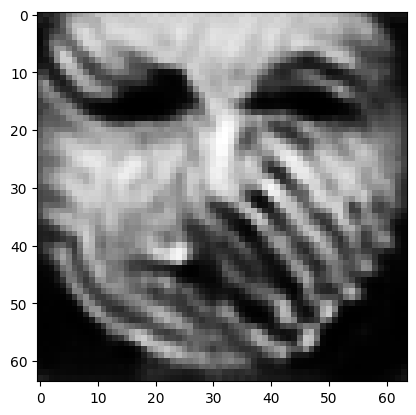

tensor([[2.5751e-05, 4.1587e-04, 2.7833e-04, 9.9647e-01, 1.7607e-06, 6.2139e-05,
         2.8154e-07, 1.0637e-04, 1.8409e-04, 7.6808e-07, 4.3000e-06, 5.4433e-06,
         7.9779e-04, 4.6354e-05, 3.1191e-06, 1.9348e-06, 4.9677e-05, 7.8062e-06,
         1.9646e-05, 2.5723e-05, 2.0629e-06, 2.3283e-07, 1.0772e-05, 3.6028e-06,
         9.7671e-05, 1.1501e-04, 3.1488e-06, 9.0703e-06, 1.1121e-05, 1.6204e-05,
         6.8590e-04, 7.8232e-06, 2.3990e-05, 1.2299e-06, 1.6045e-04, 2.2405e-05,
         7.5007e-06, 2.9998e-04, 1.1523e-05, 1.2971e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035345007199794054
tensor([[2.5748e-05, 4.1576e-04, 2.7826e-04, 9.9647e-01, 1.7601e-06, 6.2126e-05,
         2.8146e-07, 1.0635e-04, 1.8404e-04, 7.6785e-07, 4.2985e-06, 5.4415e-06,
         7.9753e-04, 4.6338e-05, 3.1184e-06, 1.9343e-06, 4.9667e-05, 7.8040e-06,
         1.9642e-05, 2.5718e-05, 2.0622e-06, 2.3276e-07, 1.0767e-05, 3.6021e-06,
         9.7652e-05, 1.1497e-04, 3.1479e

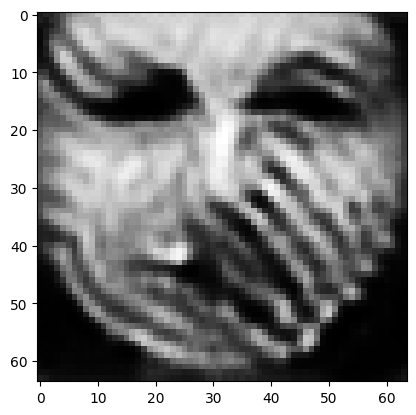

tensor([[2.5737e-05, 4.1534e-04, 2.7799e-04, 9.9648e-01, 1.7579e-06, 6.2076e-05,
         2.8111e-07, 1.0629e-04, 1.8380e-04, 7.6693e-07, 4.2927e-06, 5.4341e-06,
         7.9650e-04, 4.6276e-05, 3.1151e-06, 1.9324e-06, 4.9629e-05, 7.7954e-06,
         1.9627e-05, 2.5694e-05, 2.0593e-06, 2.3248e-07, 1.0750e-05, 3.5993e-06,
         9.7575e-05, 1.1483e-04, 3.1441e-06, 9.0540e-06, 1.1105e-05, 1.6181e-05,
         6.8445e-04, 7.8155e-06, 2.3947e-05, 1.2275e-06, 1.6032e-04, 2.2373e-05,
         7.4885e-06, 2.9966e-04, 1.1504e-05, 1.2944e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035290364176034927
tensor([[2.5735e-05, 4.1524e-04, 2.7793e-04, 9.9648e-01, 1.7573e-06, 6.2063e-05,
         2.8102e-07, 1.0627e-04, 1.8375e-04, 7.6671e-07, 4.2913e-06, 5.4323e-06,
         7.9625e-04, 4.6261e-05, 3.1143e-06, 1.9319e-06, 4.9620e-05, 7.7934e-06,
         1.9623e-05, 2.5689e-05, 2.0586e-06, 2.3241e-07, 1.0745e-05, 3.5986e-06,
         9.7557e-05, 1.1479e-04, 3.1432e

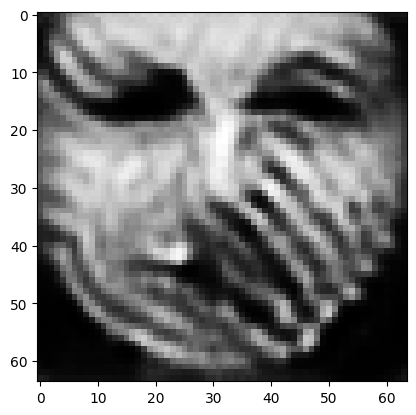

tensor([[2.5724e-05, 4.1485e-04, 2.7767e-04, 9.9648e-01, 1.7552e-06, 6.2014e-05,
         2.8069e-07, 1.0621e-04, 1.8353e-04, 7.6583e-07, 4.2857e-06, 5.4252e-06,
         7.9528e-04, 4.6203e-05, 3.1112e-06, 1.9300e-06, 4.9585e-05, 7.7853e-06,
         1.9608e-05, 2.5666e-05, 2.0558e-06, 2.3215e-07, 1.0729e-05, 3.5960e-06,
         9.7486e-05, 1.1466e-04, 3.1395e-06, 9.0386e-06, 1.1091e-05, 1.6159e-05,
         6.8307e-04, 7.8081e-06, 2.3906e-05, 1.2252e-06, 1.6019e-04, 2.2342e-05,
         7.4770e-06, 2.9936e-04, 1.1486e-05, 1.2918e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035241658333688974
tensor([[2.5721e-05, 4.1475e-04, 2.7760e-04, 9.9648e-01, 1.7547e-06, 6.2002e-05,
         2.8061e-07, 1.0619e-04, 1.8347e-04, 7.6562e-07, 4.2844e-06, 5.4235e-06,
         7.9504e-04, 4.6188e-05, 3.1104e-06, 1.9296e-06, 4.9576e-05, 7.7833e-06,
         1.9605e-05, 2.5661e-05, 2.0551e-06, 2.3208e-07, 1.0725e-05, 3.5954e-06,
         9.7469e-05, 1.1463e-04, 3.1386e

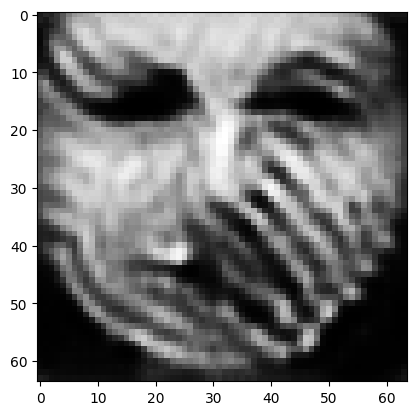

tensor([[2.5711e-05, 4.1438e-04, 2.7736e-04, 9.9649e-01, 1.7528e-06, 6.1956e-05,
         2.8029e-07, 1.0613e-04, 1.8327e-04, 7.6479e-07, 4.2791e-06, 5.4169e-06,
         7.9411e-04, 4.6133e-05, 3.1075e-06, 1.9278e-06, 4.9543e-05, 7.7757e-06,
         1.9591e-05, 2.5640e-05, 2.0525e-06, 2.3183e-07, 1.0709e-05, 3.5929e-06,
         9.7401e-05, 1.1450e-04, 3.1352e-06, 9.0240e-06, 1.1077e-05, 1.6138e-05,
         6.8177e-04, 7.8012e-06, 2.3868e-05, 1.2230e-06, 1.6007e-04, 2.2313e-05,
         7.4662e-06, 2.9907e-04, 1.1469e-05, 1.2894e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035195332020521164
tensor([[2.5709e-05, 4.1429e-04, 2.7730e-04, 9.9649e-01, 1.7523e-06, 6.1944e-05,
         2.8021e-07, 1.0612e-04, 1.8322e-04, 7.6459e-07, 4.2778e-06, 5.4152e-06,
         7.9389e-04, 4.6120e-05, 3.1068e-06, 1.9274e-06, 4.9535e-05, 7.7739e-06,
         1.9587e-05, 2.5635e-05, 2.0519e-06, 2.3177e-07, 1.0706e-05, 3.5923e-06,
         9.7385e-05, 1.1447e-04, 3.1343e

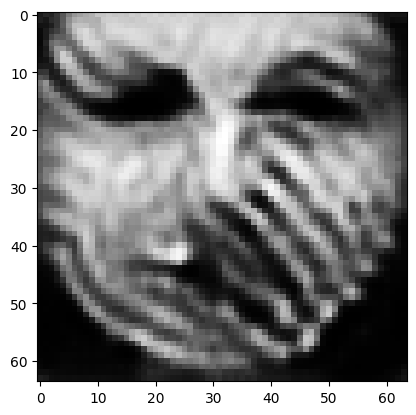

tensor([[2.5699e-05, 4.1393e-04, 2.7706e-04, 9.9649e-01, 1.7504e-06, 6.1901e-05,
         2.7992e-07, 1.0606e-04, 1.8302e-04, 7.6380e-07, 4.2728e-06, 5.4089e-06,
         7.9301e-04, 4.6067e-05, 3.1040e-06, 1.9257e-06, 4.9503e-05, 7.7667e-06,
         1.9574e-05, 2.5615e-05, 2.0494e-06, 2.3153e-07, 1.0691e-05, 3.5900e-06,
         9.7321e-05, 1.1435e-04, 3.1311e-06, 9.0102e-06, 1.1064e-05, 1.6117e-05,
         6.8052e-04, 7.7946e-06, 2.3832e-05, 1.2210e-06, 1.5996e-04, 2.2286e-05,
         7.4559e-06, 2.9879e-04, 1.1453e-05, 1.2870e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035151378251612186
tensor([[2.5697e-05, 4.1385e-04, 2.7701e-04, 9.9649e-01, 1.7500e-06, 6.1890e-05,
         2.7984e-07, 1.0605e-04, 1.8297e-04, 7.6360e-07, 4.2716e-06, 5.4074e-06,
         7.9280e-04, 4.6054e-05, 3.1033e-06, 1.9253e-06, 4.9495e-05, 7.7649e-06,
         1.9571e-05, 2.5610e-05, 2.0488e-06, 2.3147e-07, 1.0687e-05, 3.5894e-06,
         9.7306e-05, 1.1432e-04, 3.1303e

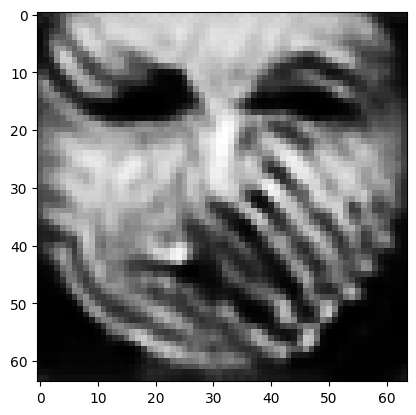

tensor([[2.5688e-05, 4.1351e-04, 2.7678e-04, 9.9650e-01, 1.7482e-06, 6.1848e-05,
         2.7956e-07, 1.0599e-04, 1.8278e-04, 7.6285e-07, 4.2668e-06, 5.4013e-06,
         7.9196e-04, 4.6004e-05, 3.1007e-06, 1.9238e-06, 4.9465e-05, 7.7581e-06,
         1.9559e-05, 2.5591e-05, 2.0465e-06, 2.3124e-07, 1.0673e-05, 3.5872e-06,
         9.7245e-05, 1.1420e-04, 3.1272e-06, 8.9970e-06, 1.1051e-05, 1.6098e-05,
         6.7934e-04, 7.7883e-06, 2.3797e-05, 1.2190e-06, 1.5985e-04, 2.2260e-05,
         7.4461e-06, 2.9853e-04, 1.1438e-05, 1.2848e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035107426811009645
tensor([[2.5685e-05, 4.1343e-04, 2.7673e-04, 9.9650e-01, 1.7478e-06, 6.1838e-05,
         2.7949e-07, 1.0598e-04, 1.8273e-04, 7.6267e-07, 4.2656e-06, 5.3999e-06,
         7.9176e-04, 4.5992e-05, 3.1000e-06, 1.9234e-06, 4.9457e-05, 7.7564e-06,
         1.9556e-05, 2.5586e-05, 2.0459e-06, 2.3118e-07, 1.0670e-05, 3.5866e-06,
         9.7230e-05, 1.1418e-04, 3.1264e

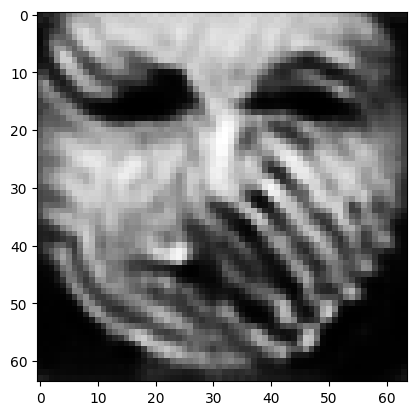

tensor([[2.5676e-05, 4.1311e-04, 2.7651e-04, 9.9650e-01, 1.7461e-06, 6.1797e-05,
         2.7922e-07, 1.0593e-04, 1.8255e-04, 7.6195e-07, 4.2611e-06, 5.3941e-06,
         7.9096e-04, 4.5945e-05, 3.0975e-06, 1.9218e-06, 4.9428e-05, 7.7498e-06,
         1.9544e-05, 2.5568e-05, 2.0437e-06, 2.3096e-07, 1.0656e-05, 3.5845e-06,
         9.7171e-05, 1.1407e-04, 3.1234e-06, 8.9844e-06, 1.1039e-05, 1.6080e-05,
         6.7821e-04, 7.7824e-06, 2.3764e-05, 1.2171e-06, 1.5975e-04, 2.2235e-05,
         7.4368e-06, 2.9828e-04, 1.1423e-05, 1.2827e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003506703767925501
tensor([[2.5674e-05, 4.1303e-04, 2.7646e-04, 9.9650e-01, 1.7456e-06, 6.1787e-05,
         2.7915e-07, 1.0591e-04, 1.8251e-04, 7.6178e-07, 4.2600e-06, 5.3927e-06,
         7.9077e-04, 4.5933e-05, 3.0969e-06, 1.9215e-06, 4.9421e-05, 7.7482e-06,
         1.9541e-05, 2.5563e-05, 2.0431e-06, 2.3091e-07, 1.0653e-05, 3.5840e-06,
         9.7157e-05, 1.1404e-04, 3.1227e-

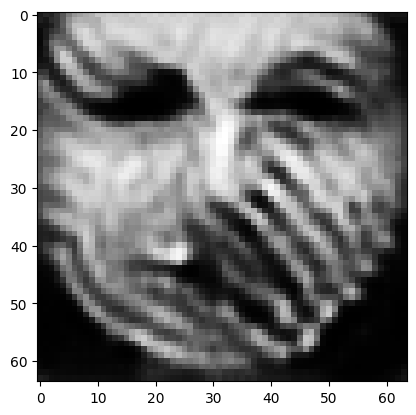

tensor([[2.5665e-05, 4.1273e-04, 2.7625e-04, 9.9650e-01, 1.7440e-06, 6.1748e-05,
         2.7889e-07, 1.0586e-04, 1.8234e-04, 7.6109e-07, 4.2556e-06, 5.3872e-06,
         7.9001e-04, 4.5888e-05, 3.0945e-06, 1.9200e-06, 4.9393e-05, 7.7419e-06,
         1.9529e-05, 2.5545e-05, 2.0410e-06, 2.3070e-07, 1.0640e-05, 3.5819e-06,
         9.7102e-05, 1.1394e-04, 3.1198e-06, 8.9724e-06, 1.1028e-05, 1.6063e-05,
         6.7714e-04, 7.7766e-06, 2.3732e-05, 1.2153e-06, 1.5965e-04, 2.2212e-05,
         7.4279e-06, 2.9804e-04, 1.1409e-05, 1.2807e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003502902342006564
tensor([[2.5663e-05, 4.1266e-04, 2.7620e-04, 9.9650e-01, 1.7436e-06, 6.1739e-05,
         2.7883e-07, 1.0585e-04, 1.8229e-04, 7.6092e-07, 4.2545e-06, 5.3859e-06,
         7.8983e-04, 4.5877e-05, 3.0939e-06, 1.9197e-06, 4.9386e-05, 7.7404e-06,
         1.9527e-05, 2.5541e-05, 2.0404e-06, 2.3065e-07, 1.0637e-05, 3.5814e-06,
         9.7088e-05, 1.1391e-04, 3.1192e-

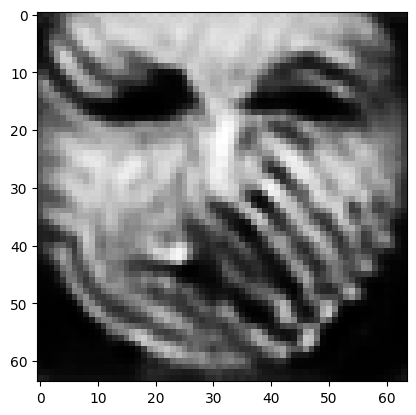

tensor([[2.5655e-05, 4.1237e-04, 2.7601e-04, 9.9651e-01, 1.7421e-06, 6.1702e-05,
         2.7858e-07, 1.0580e-04, 1.8213e-04, 7.6027e-07, 4.2504e-06, 5.3807e-06,
         7.8911e-04, 4.5834e-05, 3.0916e-06, 1.9183e-06, 4.9359e-05, 7.7345e-06,
         1.9516e-05, 2.5524e-05, 2.0384e-06, 2.3045e-07, 1.0625e-05, 3.5795e-06,
         9.7035e-05, 1.1382e-04, 3.1165e-06, 8.9610e-06, 1.1017e-05, 1.6046e-05,
         6.7613e-04, 7.7712e-06, 2.3702e-05, 1.2136e-06, 1.5955e-04, 2.2190e-05,
         7.4194e-06, 2.9781e-04, 1.1395e-05, 1.2788e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003499219659715891
tensor([[2.5653e-05, 4.1230e-04, 2.7596e-04, 9.9651e-01, 1.7417e-06, 6.1693e-05,
         2.7852e-07, 1.0579e-04, 1.8209e-04, 7.6011e-07, 4.2494e-06, 5.3794e-06,
         7.8894e-04, 4.5823e-05, 3.0910e-06, 1.9179e-06, 4.9353e-05, 7.7330e-06,
         1.9513e-05, 2.5520e-05, 2.0379e-06, 2.3040e-07, 1.0623e-05, 3.5790e-06,
         9.7023e-05, 1.1379e-04, 3.1158e-

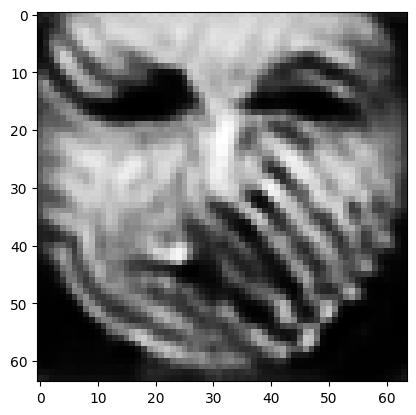

tensor([[2.5645e-05, 4.1203e-04, 2.7577e-04, 9.9651e-01, 1.7403e-06, 6.1659e-05,
         2.7829e-07, 1.0574e-04, 1.8194e-04, 7.5950e-07, 4.2455e-06, 5.3745e-06,
         7.8826e-04, 4.5782e-05, 3.0888e-06, 1.9166e-06, 4.9328e-05, 7.7274e-06,
         1.9503e-05, 2.5504e-05, 2.0360e-06, 2.3021e-07, 1.0611e-05, 3.5772e-06,
         9.6973e-05, 1.1370e-04, 3.1133e-06, 8.9502e-06, 1.1007e-05, 1.6031e-05,
         6.7516e-04, 7.7661e-06, 2.3673e-05, 1.2120e-06, 1.5946e-04, 2.2169e-05,
         7.4114e-06, 2.9760e-04, 1.1383e-05, 1.2770e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003496012417599559
tensor([[2.5643e-05, 4.1196e-04, 2.7573e-04, 9.9651e-01, 1.7399e-06, 6.1650e-05,
         2.7823e-07, 1.0573e-04, 1.8190e-04, 7.5935e-07, 4.2445e-06, 5.3733e-06,
         7.8809e-04, 4.5772e-05, 3.0883e-06, 1.9163e-06, 4.9321e-05, 7.7259e-06,
         1.9500e-05, 2.5500e-05, 2.0356e-06, 2.3016e-07, 1.0608e-05, 3.5767e-06,
         9.6960e-05, 1.1368e-04, 3.1126e-

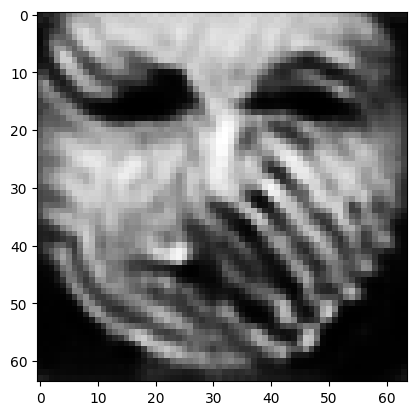

tensor([[2.5636e-05, 4.1171e-04, 2.7555e-04, 9.9651e-01, 1.7385e-06, 6.1617e-05,
         2.7801e-07, 1.0569e-04, 1.8175e-04, 7.5877e-07, 4.2408e-06, 5.3686e-06,
         7.8744e-04, 4.5734e-05, 3.0862e-06, 1.9151e-06, 4.9297e-05, 7.7206e-06,
         1.9491e-05, 2.5485e-05, 2.0337e-06, 2.2998e-07, 1.0598e-05, 3.5749e-06,
         9.6912e-05, 1.1359e-04, 3.1102e-06, 8.9400e-06, 1.0997e-05, 1.6016e-05,
         6.7425e-04, 7.7612e-06, 2.3646e-05, 1.2105e-06, 1.5938e-04, 2.2149e-05,
         7.4038e-06, 2.9739e-04, 1.1371e-05, 1.2753e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034923297353088856
tensor([[2.5634e-05, 4.1164e-04, 2.7551e-04, 9.9651e-01, 1.7382e-06, 6.1609e-05,
         2.7796e-07, 1.0568e-04, 1.8172e-04, 7.5863e-07, 4.2399e-06, 5.3675e-06,
         7.8728e-04, 4.5724e-05, 3.0857e-06, 1.9148e-06, 4.9291e-05, 7.7193e-06,
         1.9489e-05, 2.5481e-05, 2.0333e-06, 2.2994e-07, 1.0595e-05, 3.5745e-06,
         9.6901e-05, 1.1357e-04, 3.1097e

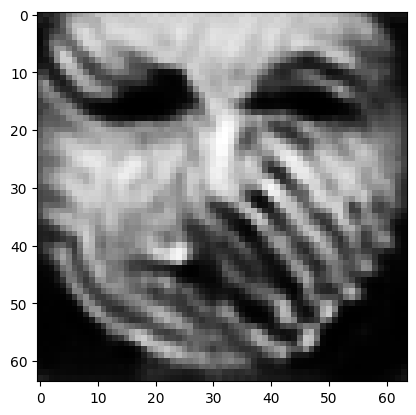

tensor([[2.5626e-05, 4.1140e-04, 2.7534e-04, 9.9652e-01, 1.7369e-06, 6.1577e-05,
         2.7774e-07, 1.0564e-04, 1.8158e-04, 7.5807e-07, 4.2363e-06, 5.3630e-06,
         7.8667e-04, 4.5687e-05, 3.0837e-06, 1.9136e-06, 4.9268e-05, 7.7142e-06,
         1.9479e-05, 2.5467e-05, 2.0316e-06, 2.2977e-07, 1.0585e-05, 3.5728e-06,
         9.6855e-05, 1.1348e-04, 3.1073e-06, 8.9302e-06, 1.0988e-05, 1.6002e-05,
         6.7338e-04, 7.7565e-06, 2.3620e-05, 1.2090e-06, 1.5930e-04, 2.2130e-05,
         7.3965e-06, 2.9720e-04, 1.1359e-05, 1.2736e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00348912226036191
tensor([[2.5625e-05, 4.1134e-04, 2.7530e-04, 9.9652e-01, 1.7366e-06, 6.1569e-05,
         2.7769e-07, 1.0563e-04, 1.8154e-04, 7.5793e-07, 4.2354e-06, 5.3620e-06,
         7.8652e-04, 4.5679e-05, 3.0832e-06, 1.9133e-06, 4.9263e-05, 7.7129e-06,
         1.9477e-05, 2.5463e-05, 2.0311e-06, 2.2973e-07, 1.0582e-05, 3.5724e-06,
         9.6844e-05, 1.1346e-04, 3.1068e-0

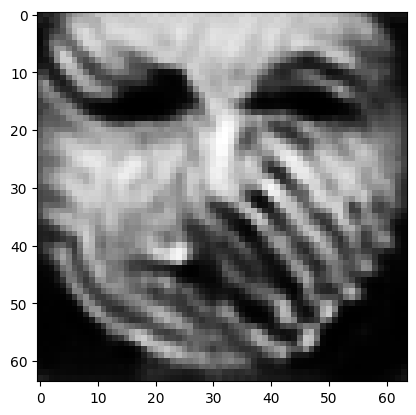

tensor([[2.5618e-05, 4.1111e-04, 2.7514e-04, 9.9652e-01, 1.7353e-06, 6.1539e-05,
         2.7749e-07, 1.0559e-04, 1.8141e-04, 7.5740e-07, 4.2321e-06, 5.3577e-06,
         7.8593e-04, 4.5644e-05, 3.0814e-06, 1.9122e-06, 4.9241e-05, 7.7080e-06,
         1.9468e-05, 2.5449e-05, 2.0295e-06, 2.2956e-07, 1.0572e-05, 3.5708e-06,
         9.6802e-05, 1.1338e-04, 3.1046e-06, 8.9209e-06, 1.0979e-05, 1.5989e-05,
         6.7256e-04, 7.7521e-06, 2.3596e-05, 1.2077e-06, 1.5922e-04, 2.2112e-05,
         7.3897e-06, 2.9701e-04, 1.1348e-05, 1.2721e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034862712491303682
tensor([[2.5616e-05, 4.1105e-04, 2.7510e-04, 9.9652e-01, 1.7350e-06, 6.1532e-05,
         2.7744e-07, 1.0558e-04, 1.8138e-04, 7.5728e-07, 4.2313e-06, 5.3567e-06,
         7.8579e-04, 4.5635e-05, 3.0809e-06, 1.9119e-06, 4.9235e-05, 7.7069e-06,
         1.9466e-05, 2.5446e-05, 2.0291e-06, 2.2952e-07, 1.0570e-05, 3.5704e-06,
         9.6791e-05, 1.1336e-04, 3.1041e

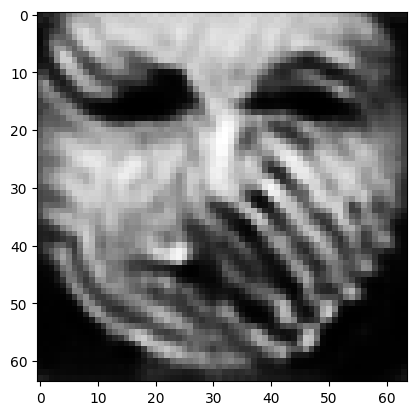

tensor([[2.5610e-05, 4.1083e-04, 2.7495e-04, 9.9652e-01, 1.7338e-06, 6.1503e-05,
         2.7725e-07, 1.0554e-04, 1.8125e-04, 7.5677e-07, 4.2280e-06, 5.3527e-06,
         7.8524e-04, 4.5602e-05, 3.0791e-06, 1.9108e-06, 4.9214e-05, 7.7022e-06,
         1.9457e-05, 2.5433e-05, 2.0275e-06, 2.2937e-07, 1.0561e-05, 3.5689e-06,
         9.6750e-05, 1.1329e-04, 3.1020e-06, 8.9121e-06, 1.0970e-05, 1.5976e-05,
         6.7178e-04, 7.7478e-06, 2.3572e-05, 1.2063e-06, 1.5915e-04, 2.2095e-05,
         7.3831e-06, 2.9684e-04, 1.1338e-05, 1.2706e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034834202378988266
tensor([[2.5608e-05, 4.1078e-04, 2.7491e-04, 9.9652e-01, 1.7335e-06, 6.1496e-05,
         2.7720e-07, 1.0553e-04, 1.8122e-04, 7.5665e-07, 4.2273e-06, 5.3517e-06,
         7.8510e-04, 4.5594e-05, 3.0787e-06, 1.9105e-06, 4.9209e-05, 7.7011e-06,
         1.9455e-05, 2.5430e-05, 2.0271e-06, 2.2933e-07, 1.0558e-05, 3.5685e-06,
         9.6740e-05, 1.1327e-04, 3.1015e

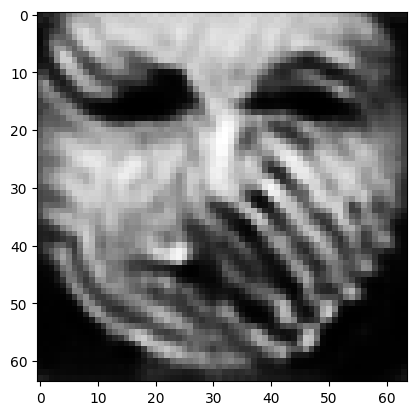

tensor([[2.5602e-05, 4.1057e-04, 2.7477e-04, 9.9653e-01, 1.7324e-06, 6.1469e-05,
         2.7702e-07, 1.0550e-04, 1.8110e-04, 7.5618e-07, 4.2242e-06, 5.3479e-06,
         7.8457e-04, 4.5562e-05, 3.0770e-06, 1.9095e-06, 4.9190e-05, 7.6967e-06,
         1.9447e-05, 2.5417e-05, 2.0257e-06, 2.2918e-07, 1.0550e-05, 3.5671e-06,
         9.6701e-05, 1.1320e-04, 3.0995e-06, 8.9038e-06, 1.0962e-05, 1.5964e-05,
         6.7104e-04, 7.7438e-06, 2.3550e-05, 1.2051e-06, 1.5908e-04, 2.2079e-05,
         7.3769e-06, 2.9667e-04, 1.1328e-05, 1.2692e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003480806713923812
tensor([[2.5600e-05, 4.1052e-04, 2.7473e-04, 9.9653e-01, 1.7321e-06, 6.1462e-05,
         2.7697e-07, 1.0549e-04, 1.8107e-04, 7.5606e-07, 4.2235e-06, 5.3470e-06,
         7.8444e-04, 4.5555e-05, 3.0766e-06, 1.9093e-06, 4.9184e-05, 7.6956e-06,
         1.9445e-05, 2.5414e-05, 2.0253e-06, 2.2915e-07, 1.0548e-05, 3.5667e-06,
         9.6692e-05, 1.1318e-04, 3.0990e-

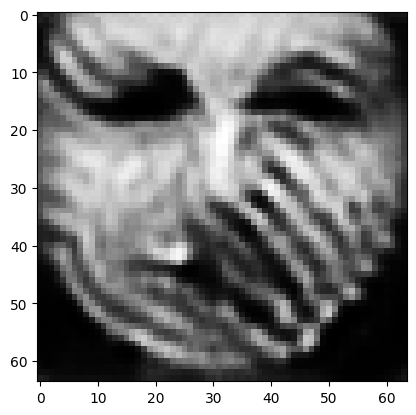

tensor([[2.5595e-05, 4.1032e-04, 2.7459e-04, 9.9653e-01, 1.7311e-06, 6.1436e-05,
         2.7680e-07, 1.0545e-04, 1.8096e-04, 7.5561e-07, 4.2206e-06, 5.3434e-06,
         7.8394e-04, 4.5525e-05, 3.0750e-06, 1.9083e-06, 4.9166e-05, 7.6915e-06,
         1.9438e-05, 2.5402e-05, 2.0239e-06, 2.2901e-07, 1.0539e-05, 3.5653e-06,
         9.6655e-05, 1.1311e-04, 3.0971e-06, 8.8958e-06, 1.0955e-05, 1.5953e-05,
         6.7034e-04, 7.7400e-06, 2.3529e-05, 1.2039e-06, 1.5901e-04, 2.2064e-05,
         7.3711e-06, 2.9651e-04, 1.1319e-05, 1.2679e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003478430677205324
tensor([[2.5593e-05, 4.1027e-04, 2.7456e-04, 9.9653e-01, 1.7308e-06, 6.1430e-05,
         2.7676e-07, 1.0545e-04, 1.8093e-04, 7.5550e-07, 4.2199e-06, 5.3425e-06,
         7.8382e-04, 4.5518e-05, 3.0746e-06, 1.9081e-06, 4.9161e-05, 7.6905e-06,
         1.9436e-05, 2.5400e-05, 2.0236e-06, 2.2898e-07, 1.0537e-05, 3.5650e-06,
         9.6647e-05, 1.1310e-04, 3.0967e-

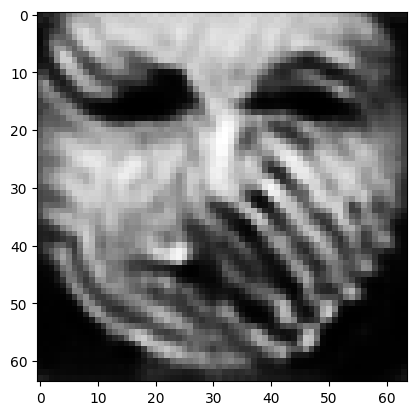

tensor([[2.5587e-05, 4.1008e-04, 2.7443e-04, 9.9653e-01, 1.7298e-06, 6.1405e-05,
         2.7660e-07, 1.0541e-04, 1.8082e-04, 7.5506e-07, 4.2171e-06, 5.3391e-06,
         7.8335e-04, 4.5489e-05, 3.0730e-06, 1.9071e-06, 4.9143e-05, 7.6865e-06,
         1.9429e-05, 2.5388e-05, 2.0222e-06, 2.2884e-07, 1.0529e-05, 3.5637e-06,
         9.6612e-05, 1.1303e-04, 3.0949e-06, 8.8883e-06, 1.0948e-05, 1.5942e-05,
         6.6967e-04, 7.7364e-06, 2.3509e-05, 1.2028e-06, 1.5895e-04, 2.2049e-05,
         7.3655e-06, 2.9636e-04, 1.1310e-05, 1.2666e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034759361296892166
tensor([[2.5586e-05, 4.1003e-04, 2.7440e-04, 9.9653e-01, 1.7295e-06, 6.1399e-05,
         2.7656e-07, 1.0541e-04, 1.8080e-04, 7.5496e-07, 4.2165e-06, 5.3383e-06,
         7.8324e-04, 4.5483e-05, 3.0727e-06, 1.9069e-06, 4.9139e-05, 7.6856e-06,
         1.9427e-05, 2.5386e-05, 2.0219e-06, 2.2881e-07, 1.0528e-05, 3.5634e-06,
         9.6603e-05, 1.1302e-04, 3.0944e

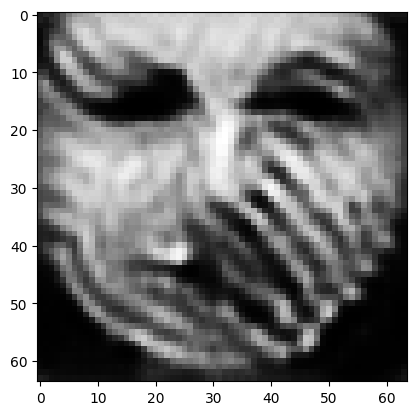

tensor([[2.5581e-05, 4.0986e-04, 2.7427e-04, 9.9653e-01, 1.7286e-06, 6.1376e-05,
         2.7640e-07, 1.0537e-04, 1.8070e-04, 7.5455e-07, 4.2139e-06, 5.3350e-06,
         7.8278e-04, 4.5456e-05, 3.0712e-06, 1.9060e-06, 4.9122e-05, 7.6818e-06,
         1.9420e-05, 2.5375e-05, 2.0206e-06, 2.2868e-07, 1.0520e-05, 3.5621e-06,
         9.6570e-05, 1.1295e-04, 3.0928e-06, 8.8811e-06, 1.0941e-05, 1.5932e-05,
         6.6904e-04, 7.7330e-06, 2.3491e-05, 1.2017e-06, 1.5889e-04, 2.2035e-05,
         7.3602e-06, 2.9622e-04, 1.1302e-05, 1.2655e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003473560092970729
tensor([[2.5579e-05, 4.0981e-04, 2.7424e-04, 9.9653e-01, 1.7284e-06, 6.1370e-05,
         2.7636e-07, 1.0537e-04, 1.8067e-04, 7.5445e-07, 4.2132e-06, 5.3342e-06,
         7.8268e-04, 4.5449e-05, 3.0709e-06, 1.9058e-06, 4.9118e-05, 7.6809e-06,
         1.9419e-05, 2.5372e-05, 2.0203e-06, 2.2865e-07, 1.0518e-05, 3.5618e-06,
         9.6562e-05, 1.1294e-04, 3.0923e-

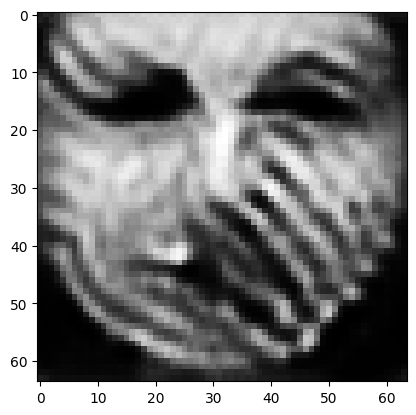

tensor([[2.5575e-05, 4.0964e-04, 2.7413e-04, 9.9653e-01, 1.7274e-06, 6.1348e-05,
         2.7622e-07, 1.0534e-04, 1.8057e-04, 7.5407e-07, 4.2107e-06, 5.3311e-06,
         7.8225e-04, 4.5424e-05, 3.0695e-06, 1.9050e-06, 4.9102e-05, 7.6773e-06,
         1.9412e-05, 2.5362e-05, 2.0191e-06, 2.2854e-07, 1.0511e-05, 3.5606e-06,
         9.6531e-05, 1.1288e-04, 3.0907e-06, 8.8743e-06, 1.0934e-05, 1.5922e-05,
         6.6844e-04, 7.7297e-06, 2.3473e-05, 1.2007e-06, 1.5884e-04, 2.2022e-05,
         7.3551e-06, 2.9608e-04, 1.1294e-05, 1.2643e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034713030327111483
tensor([[2.5573e-05, 4.0960e-04, 2.7410e-04, 9.9654e-01, 1.7272e-06, 6.1343e-05,
         2.7618e-07, 1.0533e-04, 1.8055e-04, 7.5397e-07, 4.2101e-06, 5.3303e-06,
         7.8214e-04, 4.5417e-05, 3.0691e-06, 1.9048e-06, 4.9098e-05, 7.6765e-06,
         1.9410e-05, 2.5359e-05, 2.0188e-06, 2.2851e-07, 1.0509e-05, 3.5603e-06,
         9.6523e-05, 1.1287e-04, 3.0903e

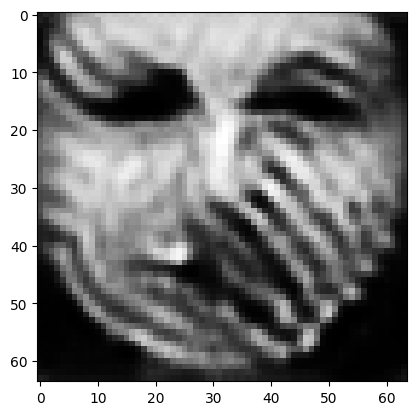

tensor([[2.5568e-05, 4.0944e-04, 2.7399e-04, 9.9654e-01, 1.7264e-06, 6.1321e-05,
         2.7604e-07, 1.0530e-04, 1.8046e-04, 7.5360e-07, 4.2078e-06, 5.3274e-06,
         7.8174e-04, 4.5393e-05, 3.0678e-06, 1.9040e-06, 4.9082e-05, 7.6731e-06,
         1.9404e-05, 2.5350e-05, 2.0177e-06, 2.2839e-07, 1.0503e-05, 3.5592e-06,
         9.6493e-05, 1.1281e-04, 3.0888e-06, 8.8678e-06, 1.0928e-05, 1.5913e-05,
         6.6787e-04, 7.7266e-06, 2.3456e-05, 1.1998e-06, 1.5878e-04, 2.2009e-05,
         7.3504e-06, 2.9595e-04, 1.1286e-05, 1.2633e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003469164716079831
tensor([[2.5567e-05, 4.0940e-04, 2.7396e-04, 9.9654e-01, 1.7261e-06, 6.1316e-05,
         2.7601e-07, 1.0530e-04, 1.8044e-04, 7.5351e-07, 4.2072e-06, 5.3266e-06,
         7.8164e-04, 4.5387e-05, 3.0675e-06, 1.9038e-06, 4.9079e-05, 7.6722e-06,
         1.9403e-05, 2.5347e-05, 2.0174e-06, 2.2836e-07, 1.0501e-05, 3.5589e-06,
         9.6486e-05, 1.1280e-04, 3.0884e-

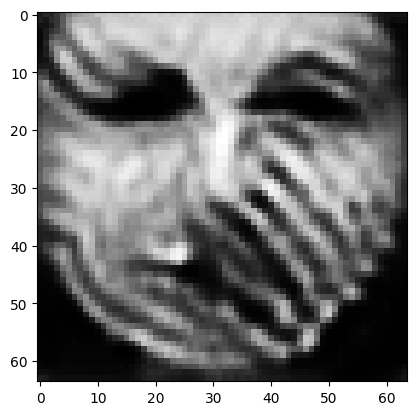

tensor([[2.5563e-05, 4.0924e-04, 2.7385e-04, 9.9654e-01, 1.7253e-06, 6.1296e-05,
         2.7587e-07, 1.0527e-04, 1.8035e-04, 7.5316e-07, 4.2049e-06, 5.3238e-06,
         7.8125e-04, 4.5364e-05, 3.0662e-06, 1.9030e-06, 4.9064e-05, 7.6690e-06,
         1.9397e-05, 2.5338e-05, 2.0163e-06, 2.2825e-07, 1.0495e-05, 3.5578e-06,
         9.6457e-05, 1.1275e-04, 3.0869e-06, 8.8616e-06, 1.0922e-05, 1.5904e-05,
         6.6732e-04, 7.7236e-06, 2.3439e-05, 1.1989e-06, 1.5873e-04, 2.1998e-05,
         7.3458e-06, 2.9583e-04, 1.1279e-05, 1.2622e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003467263886705041
tensor([[2.5562e-05, 4.0920e-04, 2.7383e-04, 9.9654e-01, 1.7251e-06, 6.1291e-05,
         2.7584e-07, 1.0526e-04, 1.8033e-04, 7.5308e-07, 4.2044e-06, 5.3231e-06,
         7.8116e-04, 4.5358e-05, 3.0659e-06, 1.9029e-06, 4.9060e-05, 7.6682e-06,
         1.9395e-05, 2.5336e-05, 2.0160e-06, 2.2823e-07, 1.0493e-05, 3.5576e-06,
         9.6450e-05, 1.1273e-04, 3.0866e-

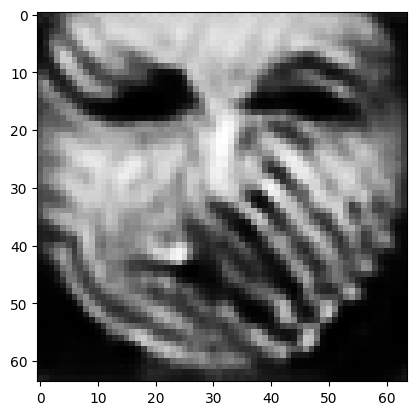

tensor([[2.5557e-05, 4.0906e-04, 2.7373e-04, 9.9654e-01, 1.7243e-06, 6.1272e-05,
         2.7571e-07, 1.0524e-04, 1.8024e-04, 7.5274e-07, 4.2023e-06, 5.3205e-06,
         7.8079e-04, 4.5336e-05, 3.0647e-06, 1.9022e-06, 4.9046e-05, 7.6651e-06,
         1.9390e-05, 2.5327e-05, 2.0150e-06, 2.2813e-07, 1.0487e-05, 3.5566e-06,
         9.6423e-05, 1.1268e-04, 3.0852e-06, 8.8558e-06, 1.0917e-05, 1.5896e-05,
         6.6681e-04, 7.7208e-06, 2.3424e-05, 1.1980e-06, 1.5868e-04, 2.1986e-05,
         7.3414e-06, 2.9571e-04, 1.1272e-05, 1.2613e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034652443137019873
tensor([[2.5556e-05, 4.0902e-04, 2.7370e-04, 9.9654e-01, 1.7241e-06, 6.1267e-05,
         2.7568e-07, 1.0523e-04, 1.8022e-04, 7.5267e-07, 4.2018e-06, 5.3199e-06,
         7.8070e-04, 4.5331e-05, 3.0644e-06, 1.9020e-06, 4.9043e-05, 7.6644e-06,
         1.9389e-05, 2.5325e-05, 2.0147e-06, 2.2810e-07, 1.0485e-05, 3.5563e-06,
         9.6417e-05, 1.1267e-04, 3.0849e

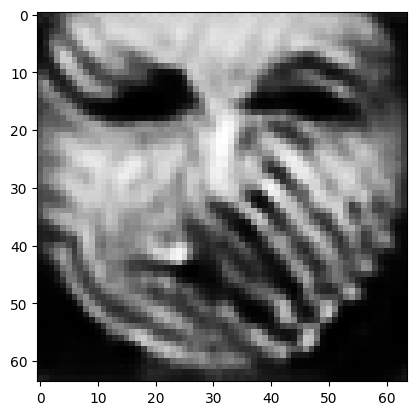

tensor([[2.5552e-05, 4.0888e-04, 2.7361e-04, 9.9654e-01, 1.7234e-06, 6.1249e-05,
         2.7556e-07, 1.0521e-04, 1.8014e-04, 7.5235e-07, 4.1998e-06, 5.3173e-06,
         7.8035e-04, 4.5310e-05, 3.0633e-06, 1.9013e-06, 4.9030e-05, 7.6615e-06,
         1.9383e-05, 2.5317e-05, 2.0138e-06, 2.2800e-07, 1.0480e-05, 3.5554e-06,
         9.6391e-05, 1.1262e-04, 3.0836e-06, 8.8503e-06, 1.0911e-05, 1.5888e-05,
         6.6632e-04, 7.7181e-06, 2.3409e-05, 1.1972e-06, 1.5864e-04, 2.1975e-05,
         7.3374e-06, 2.9560e-04, 1.1266e-05, 1.2603e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003463699948042631
tensor([[2.5551e-05, 4.0885e-04, 2.7358e-04, 9.9654e-01, 1.7232e-06, 6.1245e-05,
         2.7553e-07, 1.0520e-04, 1.8012e-04, 7.5227e-07, 4.1993e-06, 5.3167e-06,
         7.8027e-04, 4.5305e-05, 3.0630e-06, 1.9011e-06, 4.9027e-05, 7.6608e-06,
         1.9382e-05, 2.5315e-05, 2.0135e-06, 2.2798e-07, 1.0478e-05, 3.5551e-06,
         9.6384e-05, 1.1261e-04, 3.0833e-

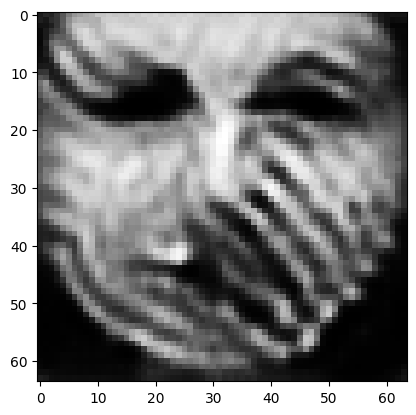

tensor([[2.5547e-05, 4.0872e-04, 2.7349e-04, 9.9654e-01, 1.7225e-06, 6.1227e-05,
         2.7542e-07, 1.0518e-04, 1.8005e-04, 7.5197e-07, 4.1974e-06, 5.3143e-06,
         7.7994e-04, 4.5285e-05, 3.0620e-06, 1.9005e-06, 4.9014e-05, 7.6580e-06,
         1.9377e-05, 2.5307e-05, 2.0126e-06, 2.2789e-07, 1.0473e-05, 3.5542e-06,
         9.6360e-05, 1.1257e-04, 3.0820e-06, 8.8451e-06, 1.0906e-05, 1.5880e-05,
         6.6586e-04, 7.7155e-06, 2.3395e-05, 1.1964e-06, 1.5859e-04, 2.1965e-05,
         7.3335e-06, 2.9549e-04, 1.1260e-05, 1.2595e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003461918095126748
tensor([[2.5546e-05, 4.0868e-04, 2.7347e-04, 9.9654e-01, 1.7223e-06, 6.1223e-05,
         2.7539e-07, 1.0517e-04, 1.8003e-04, 7.5190e-07, 4.1969e-06, 5.3137e-06,
         7.7985e-04, 4.5281e-05, 3.0617e-06, 1.9003e-06, 4.9011e-05, 7.6573e-06,
         1.9375e-05, 2.5305e-05, 2.0124e-06, 2.2786e-07, 1.0471e-05, 3.5540e-06,
         9.6354e-05, 1.1256e-04, 3.0817e-

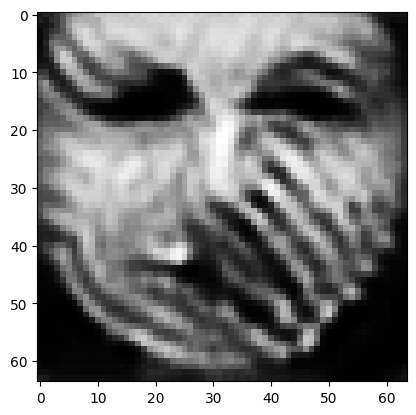

tensor([[2.5542e-05, 4.0856e-04, 2.7338e-04, 9.9655e-01, 1.7217e-06, 6.1207e-05,
         2.7528e-07, 1.0515e-04, 1.7996e-04, 7.5161e-07, 4.1951e-06, 5.3115e-06,
         7.7954e-04, 4.5262e-05, 3.0607e-06, 1.8997e-06, 4.8999e-05, 7.6547e-06,
         1.9371e-05, 2.5297e-05, 2.0115e-06, 2.2778e-07, 1.0466e-05, 3.5531e-06,
         9.6331e-05, 1.1251e-04, 3.0805e-06, 8.8401e-06, 1.0902e-05, 1.5873e-05,
         6.6542e-04, 7.7131e-06, 2.3382e-05, 1.1956e-06, 1.5855e-04, 2.1956e-05,
         7.3298e-06, 2.9539e-04, 1.1254e-05, 1.2586e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003460373729467392
tensor([[2.5542e-05, 4.0853e-04, 2.7336e-04, 9.9655e-01, 1.7215e-06, 6.1203e-05,
         2.7526e-07, 1.0515e-04, 1.7994e-04, 7.5154e-07, 4.1946e-06, 5.3109e-06,
         7.7946e-04, 4.5257e-05, 3.0604e-06, 1.8996e-06, 4.8996e-05, 7.6541e-06,
         1.9370e-05, 2.5296e-05, 2.0113e-06, 2.2776e-07, 1.0465e-05, 3.5529e-06,
         9.6325e-05, 1.1250e-04, 3.0802e-

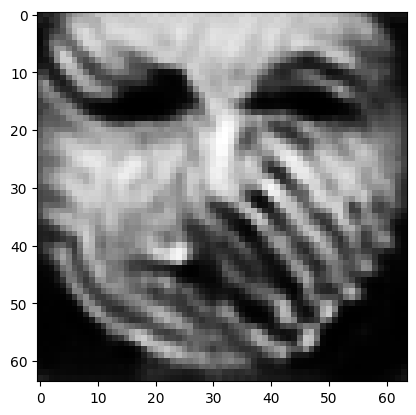

tensor([[2.5538e-05, 4.0841e-04, 2.7328e-04, 9.9655e-01, 1.7208e-06, 6.1187e-05,
         2.7515e-07, 1.0513e-04, 1.7987e-04, 7.5128e-07, 4.1929e-06, 5.3087e-06,
         7.7917e-04, 4.5239e-05, 3.0595e-06, 1.8990e-06, 4.8984e-05, 7.6516e-06,
         1.9365e-05, 2.5288e-05, 2.0104e-06, 2.2767e-07, 1.0460e-05, 3.5521e-06,
         9.6303e-05, 1.1246e-04, 3.0791e-06, 8.8353e-06, 1.0897e-05, 1.5866e-05,
         6.6500e-04, 7.7108e-06, 2.3370e-05, 1.1949e-06, 1.5851e-04, 2.1946e-05,
         7.3262e-06, 2.9530e-04, 1.1248e-05, 1.2579e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003458829363808036
tensor([[2.5537e-05, 4.0838e-04, 2.7326e-04, 9.9655e-01, 1.7207e-06, 6.1184e-05,
         2.7513e-07, 1.0512e-04, 1.7986e-04, 7.5121e-07, 4.1925e-06, 5.3082e-06,
         7.7910e-04, 4.5235e-05, 3.0592e-06, 1.8989e-06, 4.8982e-05, 7.6510e-06,
         1.9364e-05, 2.5287e-05, 2.0102e-06, 2.2765e-07, 1.0459e-05, 3.5519e-06,
         9.6297e-05, 1.1245e-04, 3.0789e-

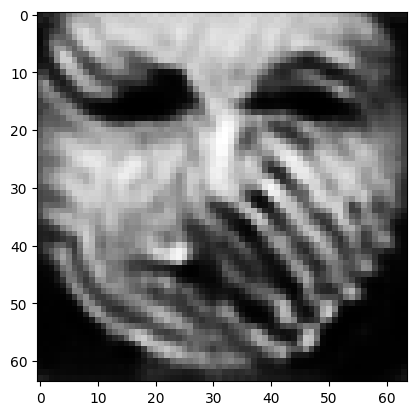

tensor([[2.5534e-05, 4.0827e-04, 2.7318e-04, 9.9655e-01, 1.7201e-06, 6.1169e-05,
         2.7503e-07, 1.0510e-04, 1.7979e-04, 7.5096e-07, 4.1909e-06, 5.3062e-06,
         7.7881e-04, 4.5218e-05, 3.0583e-06, 1.8983e-06, 4.8971e-05, 7.6486e-06,
         1.9360e-05, 2.5280e-05, 2.0094e-06, 2.2757e-07, 1.0454e-05, 3.5511e-06,
         9.6276e-05, 1.1241e-04, 3.0778e-06, 8.8309e-06, 1.0893e-05, 1.5860e-05,
         6.6461e-04, 7.7086e-06, 2.3358e-05, 1.1943e-06, 1.5847e-04, 2.1938e-05,
         7.3229e-06, 2.9521e-04, 1.1243e-05, 1.2571e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034575224854052067
tensor([[2.5533e-05, 4.0824e-04, 2.7316e-04, 9.9655e-01, 1.7199e-06, 6.1165e-05,
         2.7501e-07, 1.0510e-04, 1.7978e-04, 7.5089e-07, 4.1905e-06, 5.3057e-06,
         7.7874e-04, 4.5214e-05, 3.0581e-06, 1.8982e-06, 4.8968e-05, 7.6480e-06,
         1.9359e-05, 2.5278e-05, 2.0092e-06, 2.2755e-07, 1.0453e-05, 3.5509e-06,
         9.6271e-05, 1.1240e-04, 3.0775e

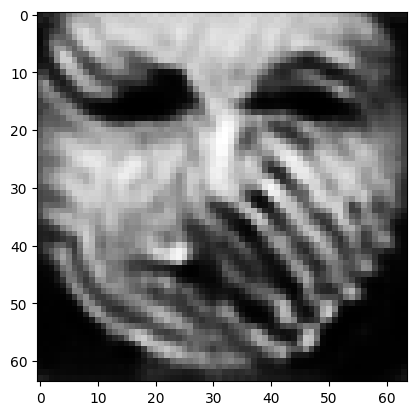

tensor([[2.5530e-05, 4.0813e-04, 2.7309e-04, 9.9655e-01, 1.7194e-06, 6.1151e-05,
         2.7491e-07, 1.0508e-04, 1.7972e-04, 7.5065e-07, 4.1889e-06, 5.3037e-06,
         7.7848e-04, 4.5198e-05, 3.0572e-06, 1.8977e-06, 4.8958e-05, 7.6458e-06,
         1.9355e-05, 2.5272e-05, 2.0085e-06, 2.2748e-07, 1.0449e-05, 3.5502e-06,
         9.6251e-05, 1.1237e-04, 3.0765e-06, 8.8266e-06, 1.0889e-05, 1.5854e-05,
         6.6424e-04, 7.7065e-06, 2.3346e-05, 1.1937e-06, 1.5844e-04, 2.1929e-05,
         7.3197e-06, 2.9512e-04, 1.1238e-05, 1.2564e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003456215839833021
tensor([[2.5529e-05, 4.0811e-04, 2.7307e-04, 9.9655e-01, 1.7192e-06, 6.1147e-05,
         2.7489e-07, 1.0508e-04, 1.7970e-04, 7.5059e-07, 4.1885e-06, 5.3033e-06,
         7.7841e-04, 4.5194e-05, 3.0570e-06, 1.8975e-06, 4.8955e-05, 7.6452e-06,
         1.9353e-05, 2.5270e-05, 2.0083e-06, 2.2746e-07, 1.0447e-05, 3.5500e-06,
         9.6246e-05, 1.1236e-04, 3.0763e-

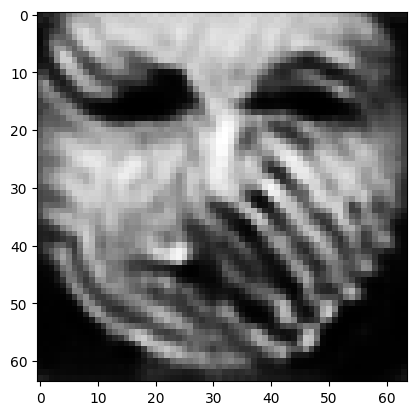

tensor([[2.5526e-05, 4.0800e-04, 2.7300e-04, 9.9655e-01, 1.7187e-06, 6.1134e-05,
         2.7480e-07, 1.0506e-04, 1.7965e-04, 7.5036e-07, 4.1871e-06, 5.3014e-06,
         7.7816e-04, 4.5179e-05, 3.0562e-06, 1.8970e-06, 4.8946e-05, 7.6431e-06,
         1.9350e-05, 2.5264e-05, 2.0076e-06, 2.2739e-07, 1.0443e-05, 3.5493e-06,
         9.6227e-05, 1.1233e-04, 3.0753e-06, 8.8226e-06, 1.0885e-05, 1.5848e-05,
         6.6388e-04, 7.7045e-06, 2.3336e-05, 1.1930e-06, 1.5840e-04, 2.1921e-05,
         7.3167e-06, 2.9504e-04, 1.1233e-05, 1.2557e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003454908961430192
tensor([[2.5525e-05, 4.0798e-04, 2.7298e-04, 9.9655e-01, 1.7185e-06, 6.1131e-05,
         2.7478e-07, 1.0505e-04, 1.7963e-04, 7.5030e-07, 4.1867e-06, 5.3010e-06,
         7.7810e-04, 4.5175e-05, 3.0560e-06, 1.8969e-06, 4.8943e-05, 7.6425e-06,
         1.9349e-05, 2.5263e-05, 2.0074e-06, 2.2737e-07, 1.0442e-05, 3.5491e-06,
         9.6223e-05, 1.1232e-04, 3.0751e-

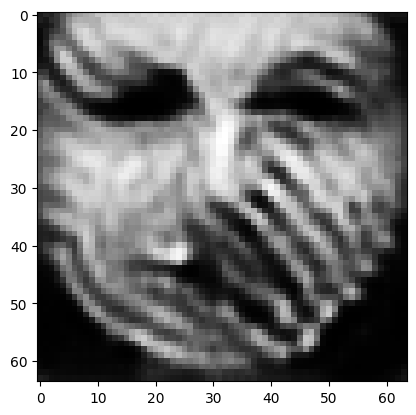

tensor([[2.5522e-05, 4.0788e-04, 2.7292e-04, 9.9655e-01, 1.7180e-06, 6.1118e-05,
         2.7470e-07, 1.0504e-04, 1.7958e-04, 7.5009e-07, 4.1853e-06, 5.2993e-06,
         7.7786e-04, 4.5161e-05, 3.0552e-06, 1.8964e-06, 4.8934e-05, 7.6406e-06,
         1.9345e-05, 2.5257e-05, 2.0067e-06, 2.2731e-07, 1.0438e-05, 3.5484e-06,
         9.6205e-05, 1.1228e-04, 3.0742e-06, 8.8188e-06, 1.0881e-05, 1.5842e-05,
         6.6355e-04, 7.7027e-06, 2.3326e-05, 1.1925e-06, 1.5837e-04, 2.1914e-05,
         7.3139e-06, 2.9497e-04, 1.1229e-05, 1.2551e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034534833393990993
tensor([[2.5522e-05, 4.0786e-04, 2.7290e-04, 9.9655e-01, 1.7179e-06, 6.1115e-05,
         2.7468e-07, 1.0503e-04, 1.7956e-04, 7.5003e-07, 4.1850e-06, 5.2988e-06,
         7.7780e-04, 4.5157e-05, 3.0550e-06, 1.8963e-06, 4.8931e-05, 7.6400e-06,
         1.9344e-05, 2.5256e-05, 2.0066e-06, 2.2729e-07, 1.0437e-05, 3.5482e-06,
         9.6200e-05, 1.1228e-04, 3.0739e

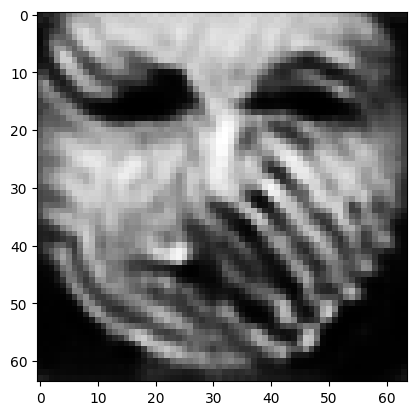

tensor([[2.5519e-05, 4.0777e-04, 2.7284e-04, 9.9655e-01, 1.7174e-06, 6.1103e-05,
         2.7460e-07, 1.0502e-04, 1.7951e-04, 7.4983e-07, 4.1837e-06, 5.2972e-06,
         7.7757e-04, 4.5143e-05, 3.0543e-06, 1.8959e-06, 4.8923e-05, 7.6381e-06,
         1.9341e-05, 2.5250e-05, 2.0059e-06, 2.2722e-07, 1.0433e-05, 3.5476e-06,
         9.6184e-05, 1.1224e-04, 3.0731e-06, 8.8151e-06, 1.0878e-05, 1.5837e-05,
         6.6323e-04, 7.7009e-06, 2.3316e-05, 1.1919e-06, 1.5834e-04, 2.1907e-05,
         7.3111e-06, 2.9489e-04, 1.1225e-05, 1.2545e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034524141810834408
tensor([[2.5518e-05, 4.0775e-04, 2.7282e-04, 9.9655e-01, 1.7173e-06, 6.1100e-05,
         2.7458e-07, 1.0501e-04, 1.7950e-04, 7.4977e-07, 4.1833e-06, 5.2967e-06,
         7.7751e-04, 4.5140e-05, 3.0541e-06, 1.8957e-06, 4.8920e-05, 7.6376e-06,
         1.9340e-05, 2.5249e-05, 2.0058e-06, 2.2721e-07, 1.0432e-05, 3.5474e-06,
         9.6179e-05, 1.1224e-04, 3.0729e

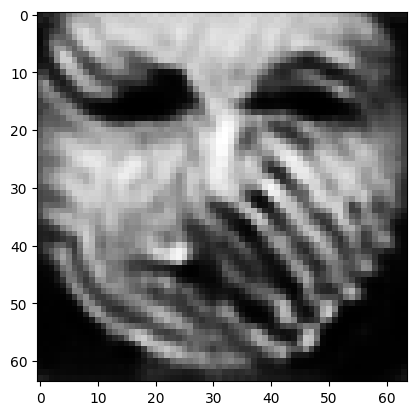

tensor([[2.5516e-05, 4.0766e-04, 2.7276e-04, 9.9655e-01, 1.7168e-06, 6.1089e-05,
         2.7450e-07, 1.0500e-04, 1.7945e-04, 7.4958e-07, 4.1821e-06, 5.2952e-06,
         7.7729e-04, 4.5127e-05, 3.0534e-06, 1.8953e-06, 4.8912e-05, 7.6358e-06,
         1.9336e-05, 2.5244e-05, 2.0052e-06, 2.2715e-07, 1.0429e-05, 3.5468e-06,
         9.6163e-05, 1.1221e-04, 3.0721e-06, 8.8116e-06, 1.0874e-05, 1.5832e-05,
         6.6293e-04, 7.6992e-06, 2.3307e-05, 1.1914e-06, 1.5831e-04, 2.1900e-05,
         7.3085e-06, 2.9482e-04, 1.1221e-05, 1.2539e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034512262791395187
tensor([[2.5515e-05, 4.0764e-04, 2.7275e-04, 9.9655e-01, 1.7167e-06, 6.1086e-05,
         2.7448e-07, 1.0500e-04, 1.7944e-04, 7.4953e-07, 4.1818e-06, 5.2948e-06,
         7.7724e-04, 4.5124e-05, 3.0532e-06, 1.8952e-06, 4.8910e-05, 7.6354e-06,
         1.9336e-05, 2.5242e-05, 2.0050e-06, 2.2713e-07, 1.0428e-05, 3.5467e-06,
         9.6159e-05, 1.1220e-04, 3.0718e

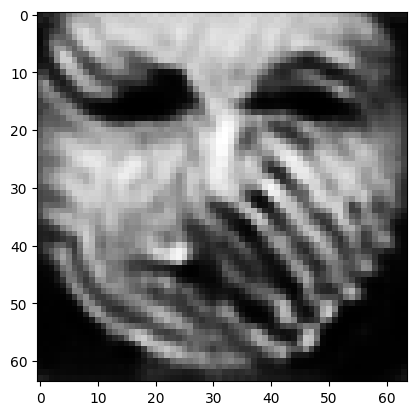

tensor([[2.5512e-05, 4.0755e-04, 2.7269e-04, 9.9656e-01, 1.7162e-06, 6.1075e-05,
         2.7441e-07, 1.0498e-04, 1.7939e-04, 7.4934e-07, 4.1805e-06, 5.2933e-06,
         7.7703e-04, 4.5111e-05, 3.0526e-06, 1.8948e-06, 4.8902e-05, 7.6336e-06,
         1.9332e-05, 2.5237e-05, 2.0044e-06, 2.2707e-07, 1.0425e-05, 3.5461e-06,
         9.6143e-05, 1.1217e-04, 3.0711e-06, 8.8083e-06, 1.0871e-05, 1.5827e-05,
         6.6264e-04, 7.6976e-06, 2.3298e-05, 1.1909e-06, 1.5828e-04, 2.1893e-05,
         7.3061e-06, 2.9475e-04, 1.1217e-05, 1.2534e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00345015712082386
tensor([[2.5512e-05, 4.0753e-04, 2.7268e-04, 9.9656e-01, 1.7161e-06, 6.1073e-05,
         2.7439e-07, 1.0498e-04, 1.7938e-04, 7.4929e-07, 4.1802e-06, 5.2929e-06,
         7.7698e-04, 4.5108e-05, 3.0524e-06, 1.8947e-06, 4.8900e-05, 7.6332e-06,
         1.9332e-05, 2.5236e-05, 2.0043e-06, 2.2706e-07, 1.0424e-05, 3.5460e-06,
         9.6139e-05, 1.1216e-04, 3.0709e-0

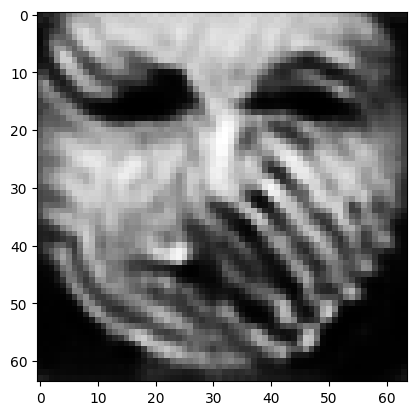

tensor([[2.5510e-05, 4.0746e-04, 2.7262e-04, 9.9656e-01, 1.7157e-06, 6.1062e-05,
         2.7433e-07, 1.0496e-04, 1.7934e-04, 7.4912e-07, 4.1791e-06, 5.2915e-06,
         7.7679e-04, 4.5096e-05, 3.0518e-06, 1.8943e-06, 4.8893e-05, 7.6316e-06,
         1.9329e-05, 2.5232e-05, 2.0037e-06, 2.2701e-07, 1.0420e-05, 3.5454e-06,
         9.6125e-05, 1.1214e-04, 3.0701e-06, 8.8051e-06, 1.0868e-05, 1.5823e-05,
         6.6236e-04, 7.6960e-06, 2.3290e-05, 1.1905e-06, 1.5826e-04, 2.1887e-05,
         7.3037e-06, 2.9469e-04, 1.1213e-05, 1.2529e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003449206706136465
tensor([[2.5509e-05, 4.0744e-04, 2.7261e-04, 9.9656e-01, 1.7156e-06, 6.1060e-05,
         2.7431e-07, 1.0496e-04, 1.7933e-04, 7.4908e-07, 4.1789e-06, 5.2912e-06,
         7.7674e-04, 4.5094e-05, 3.0516e-06, 1.8943e-06, 4.8891e-05, 7.6312e-06,
         1.9328e-05, 2.5231e-05, 2.0036e-06, 2.2699e-07, 1.0420e-05, 3.5453e-06,
         9.6121e-05, 1.1213e-04, 3.0700e-

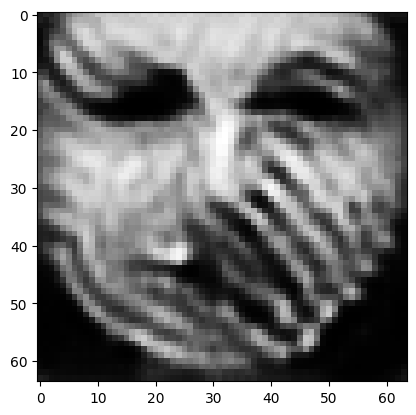

tensor([[2.5507e-05, 4.0736e-04, 2.7256e-04, 9.9656e-01, 1.7152e-06, 6.1050e-05,
         2.7425e-07, 1.0495e-04, 1.7928e-04, 7.4891e-07, 4.1778e-06, 5.2898e-06,
         7.7655e-04, 4.5082e-05, 3.0510e-06, 1.8939e-06, 4.8884e-05, 7.6296e-06,
         1.9325e-05, 2.5226e-05, 2.0031e-06, 2.2694e-07, 1.0416e-05, 3.5448e-06,
         9.6107e-05, 1.1211e-04, 3.0693e-06, 8.8022e-06, 1.0866e-05, 1.5819e-05,
         6.6210e-04, 7.6946e-06, 2.3282e-05, 1.1900e-06, 1.5823e-04, 2.1881e-05,
         7.3015e-06, 2.9463e-04, 1.1210e-05, 1.2524e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00344825629144907
tensor([[2.5506e-05, 4.0734e-04, 2.7255e-04, 9.9656e-01, 1.7151e-06, 6.1048e-05,
         2.7423e-07, 1.0495e-04, 1.7927e-04, 7.4887e-07, 4.1775e-06, 5.2895e-06,
         7.7651e-04, 4.5079e-05, 3.0509e-06, 1.8938e-06, 4.8882e-05, 7.6292e-06,
         1.9324e-05, 2.5225e-05, 2.0029e-06, 2.2693e-07, 1.0416e-05, 3.5447e-06,
         9.6104e-05, 1.1210e-04, 3.0691e-0

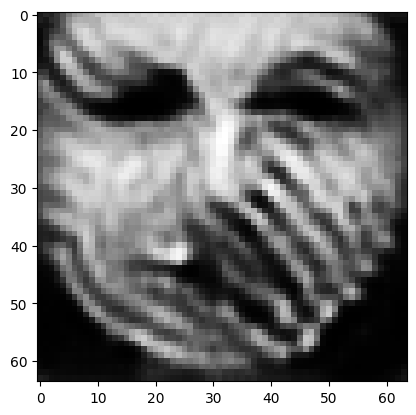

tensor([[2.5504e-05, 4.0727e-04, 2.7250e-04, 9.9656e-01, 1.7147e-06, 6.1039e-05,
         2.7417e-07, 1.0493e-04, 1.7923e-04, 7.4871e-07, 4.1765e-06, 5.2882e-06,
         7.7633e-04, 4.5069e-05, 3.0503e-06, 1.8934e-06, 4.8875e-05, 7.6278e-06,
         1.9322e-05, 2.5221e-05, 2.0025e-06, 2.2688e-07, 1.0413e-05, 3.5442e-06,
         9.6091e-05, 1.1208e-04, 3.0684e-06, 8.7994e-06, 1.0863e-05, 1.5815e-05,
         6.6186e-04, 7.6932e-06, 2.3275e-05, 1.1896e-06, 1.5821e-04, 2.1876e-05,
         7.2994e-06, 2.9457e-04, 1.1206e-05, 1.2519e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003447305876761675
tensor([[2.5504e-05, 4.0725e-04, 2.7249e-04, 9.9656e-01, 1.7146e-06, 6.1036e-05,
         2.7415e-07, 1.0493e-04, 1.7922e-04, 7.4866e-07, 4.1762e-06, 5.2879e-06,
         7.7629e-04, 4.5066e-05, 3.0501e-06, 1.8933e-06, 4.8873e-05, 7.6273e-06,
         1.9321e-05, 2.5220e-05, 2.0023e-06, 2.2687e-07, 1.0412e-05, 3.5440e-06,
         9.6087e-05, 1.1207e-04, 3.0682e-

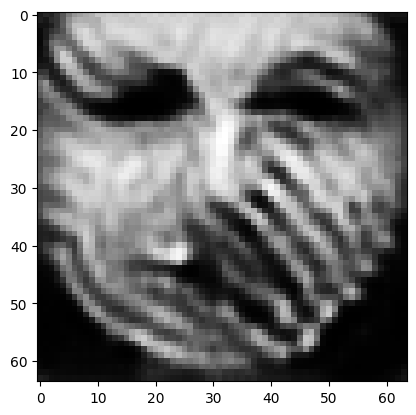

tensor([[2.5502e-05, 4.0719e-04, 2.7244e-04, 9.9656e-01, 1.7143e-06, 6.1027e-05,
         2.7410e-07, 1.0492e-04, 1.7919e-04, 7.4851e-07, 4.1753e-06, 5.2867e-06,
         7.7612e-04, 4.5056e-05, 3.0496e-06, 1.8930e-06, 4.8867e-05, 7.6260e-06,
         1.9318e-05, 2.5216e-05, 2.0019e-06, 2.2682e-07, 1.0409e-05, 3.5436e-06,
         9.6075e-05, 1.1205e-04, 3.0676e-06, 8.7967e-06, 1.0860e-05, 1.5811e-05,
         6.6162e-04, 7.6919e-06, 2.3268e-05, 1.1892e-06, 1.5819e-04, 2.1871e-05,
         7.2974e-06, 2.9452e-04, 1.1203e-05, 1.2514e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034464742057025433
tensor([[2.5501e-05, 4.0717e-04, 2.7243e-04, 9.9656e-01, 1.7142e-06, 6.1025e-05,
         2.7408e-07, 1.0492e-04, 1.7918e-04, 7.4847e-07, 4.1750e-06, 5.2864e-06,
         7.7608e-04, 4.5054e-05, 3.0495e-06, 1.8930e-06, 4.8865e-05, 7.6256e-06,
         1.9318e-05, 2.5215e-05, 2.0017e-06, 2.2681e-07, 1.0409e-05, 3.5435e-06,
         9.6071e-05, 1.1204e-04, 3.0675e

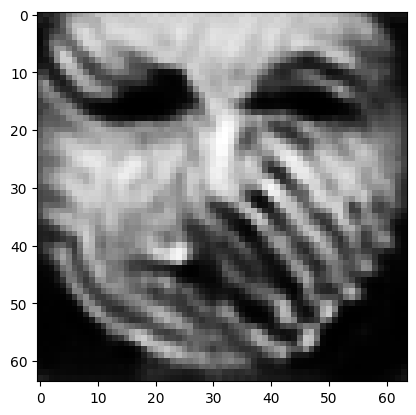

tensor([[2.5499e-05, 4.0711e-04, 2.7239e-04, 9.9656e-01, 1.7138e-06, 6.1017e-05,
         2.7403e-07, 1.0491e-04, 1.7914e-04, 7.4833e-07, 4.1741e-06, 5.2853e-06,
         7.7592e-04, 4.5044e-05, 3.0490e-06, 1.8927e-06, 4.8859e-05, 7.6243e-06,
         1.9315e-05, 2.5211e-05, 2.0013e-06, 2.2676e-07, 1.0406e-05, 3.5430e-06,
         9.6059e-05, 1.1202e-04, 3.0669e-06, 8.7943e-06, 1.0858e-05, 1.5807e-05,
         6.6141e-04, 7.6907e-06, 2.3261e-05, 1.1889e-06, 1.5816e-04, 2.1866e-05,
         7.2956e-06, 2.9447e-04, 1.1200e-05, 1.2510e-06]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034457615111023188
tensor([[2.5499e-05, 4.0709e-04, 2.7238e-04, 9.9656e-01, 1.7137e-06, 6.1015e-05,
         2.7401e-07, 1.0490e-04, 1.7913e-04, 7.4830e-07, 4.1739e-06, 5.2850e-06,
         7.7589e-04, 4.5042e-05, 3.0488e-06, 1.8926e-06, 4.8858e-05, 7.6240e-06,
         1.9315e-05, 2.5210e-05, 2.0012e-06, 2.2675e-07, 1.0405e-05, 3.5429e-06,
         9.6057e-05, 1.1202e-04, 3.0667e

In [14]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=3)

tensor([[2.5848e-04, 4.0420e-05, 9.8727e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2035e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.9753024578094482


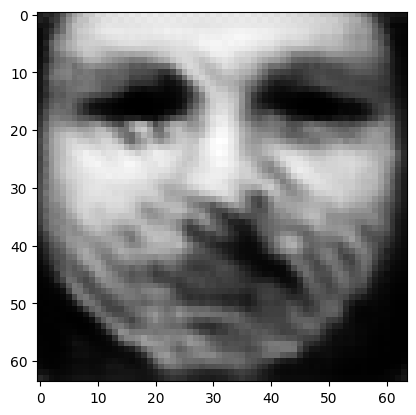

tensor([[5.3599e-05, 3.4620e-04, 3.5397e-03, 9.2160e-03, 1.9943e-02, 7.3009e-05,
         1.8693e-04, 2.0717e-04, 3.8673e-04, 9.3505e-06, 2.9017e-05, 4.4232e-05,
         3.3092e-02, 4.1033e-03, 2.2446e-05, 6.1296e-06, 1.5334e-02, 4.2290e-04,
         3.6971e-04, 3.8789e-05, 7.1003e-03, 4.1383e-05, 3.6076e-01, 4.5579e-05,
         2.7804e-01, 8.5181e-02, 3.9645e-05, 8.1936e-04, 2.1647e-03, 1.3933e-03,
         2.0577e-03, 1.1451e-04, 4.4759e-03, 3.1025e-03, 2.2902e-02, 3.2640e-03,
         1.2309e-01, 4.1780e-03, 1.1181e-02, 2.6305e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.9148707389831543
tensor([[4.7151e-03, 1.1575e-05, 1.0534e-01, 1.5089e-04, 8.5483e-02, 3.3030e-02,
         2.0048e-01, 5.7379e-02, 1.1474e-04, 1.4374e-04, 3.0080e-04, 1.0295e-04,
         1.2935e-03, 2.3140e-05, 2.7023e-05, 1.3493e-04, 2.8182e-02, 8.2893e-02,
         2.4550e-04, 2.1403e-02, 2.1355e-04, 8.6259e-05, 5.1239e-06, 6.8537e-04,
         6.6087e-02, 1.8923e-05, 2.0793e-03

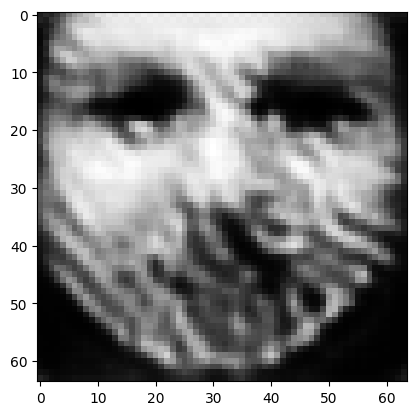

tensor([[4.4521e-05, 2.7630e-05, 5.0139e-04, 3.7202e-05, 9.1603e-01, 2.8578e-05,
         4.7244e-04, 2.3418e-05, 7.7022e-05, 3.3791e-06, 2.9002e-06, 1.3920e-05,
         2.6955e-02, 3.5964e-04, 1.6370e-04, 1.1198e-06, 8.3181e-04, 9.0693e-03,
         1.3854e-05, 1.5456e-04, 6.4234e-04, 2.5008e-05, 4.0001e-03, 2.9761e-06,
         1.3621e-02, 8.8017e-06, 2.4423e-04, 1.2950e-04, 2.8978e-05, 9.5279e-06,
         1.2806e-04, 1.6063e-04, 5.0407e-03, 4.4632e-04, 3.1929e-03, 1.1401e-03,
         3.0035e-03, 3.1560e-05, 1.3188e-02, 1.4673e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08770822733640671
tensor([[4.0258e-05, 1.9256e-05, 4.3459e-04, 2.9026e-05, 9.3532e-01, 2.2575e-05,
         4.0700e-04, 2.1543e-05, 5.2940e-05, 2.2370e-06, 1.9792e-06, 9.6992e-06,
         1.8341e-02, 2.8428e-04, 1.0911e-04, 8.2565e-07, 6.4530e-04, 8.3985e-03,
         1.0232e-05, 1.1982e-04, 4.6215e-04, 1.7121e-05, 2.7478e-03, 2.2714e-06,
         1.1528e-02, 5.1967e-06, 1.9854e-0

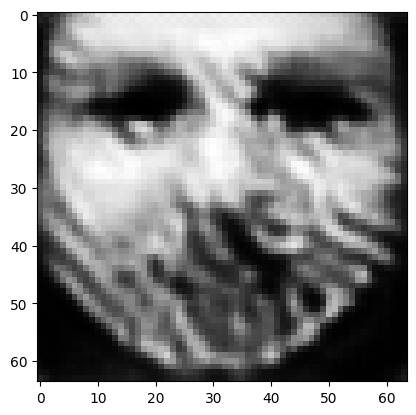

tensor([[3.2485e-05, 9.8293e-06, 3.2079e-04, 1.9007e-05, 9.6104e-01, 1.4264e-05,
         2.9269e-04, 1.7399e-05, 2.2759e-05, 1.0322e-06, 8.4656e-07, 4.6828e-06,
         8.1802e-03, 1.8421e-04, 4.5683e-05, 4.5930e-07, 4.4042e-04, 6.7177e-03,
         5.7815e-06, 6.7521e-05, 2.4034e-04, 7.9680e-06, 1.4596e-03, 1.3643e-06,
         8.5952e-03, 2.1536e-06, 1.2590e-04, 5.6169e-05, 9.1669e-06, 2.8622e-06,
         3.6157e-05, 7.3714e-05, 2.6575e-03, 1.7445e-04, 1.1183e-03, 4.1273e-04,
         1.2094e-03, 2.0491e-05, 6.2999e-03, 7.4188e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03973452001810074
tensor([[3.1798e-05, 8.8241e-06, 3.0693e-04, 1.7786e-05, 9.6409e-01, 1.3588e-05,
         2.8005e-04, 1.6946e-05, 1.9890e-05, 9.2056e-07, 7.3887e-07, 4.2047e-06,
         7.1155e-03, 1.6986e-04, 3.9594e-05, 4.2546e-07, 4.1229e-04, 6.5263e-03,
         5.3051e-06, 6.1800e-05, 2.1649e-04, 7.0660e-06, 1.2888e-03, 1.2758e-06,
         8.1290e-03, 1.8487e-06, 1.1866e-0

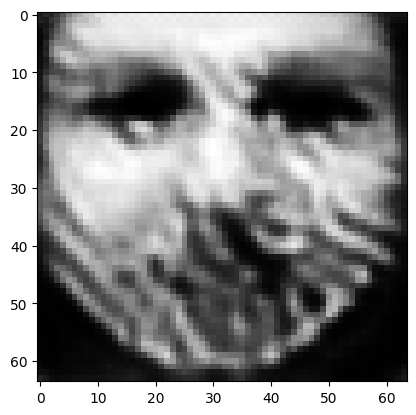

tensor([[2.9150e-05, 6.5130e-06, 2.7477e-04, 1.4640e-05, 9.7139e-01, 1.1523e-05,
         2.3716e-04, 1.5502e-05, 1.3711e-05, 6.6249e-07, 4.9428e-07, 3.0327e-06,
         4.8520e-03, 1.3403e-04, 2.6143e-05, 3.3586e-07, 3.4051e-04, 5.9058e-03,
         4.0955e-06, 4.6902e-05, 1.6043e-04, 5.0612e-06, 9.1579e-04, 1.0478e-06,
         6.8760e-03, 1.2015e-06, 9.6360e-05, 3.9768e-05, 5.7986e-06, 1.7051e-06,
         2.0419e-05, 5.3294e-05, 1.9371e-03, 1.1755e-04, 7.3887e-04, 2.6467e-04,
         8.0099e-04, 1.6613e-05, 4.5878e-03, 5.6568e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.029031336307525635
tensor([[2.8628e-05, 6.1261e-06, 2.6994e-04, 1.4072e-05, 9.7260e-01, 1.1219e-05,
         2.2977e-04, 1.5262e-05, 1.2818e-05, 6.2352e-07, 4.5705e-07, 2.8493e-06,
         4.4976e-03, 1.2693e-04, 2.4046e-05, 3.2056e-07, 3.2717e-04, 5.7881e-03,
         3.8842e-06, 4.4670e-05, 1.5090e-04, 4.7594e-06, 8.4708e-04, 1.0088e-06,
         6.6417e-03, 1.1047e-06, 9.2782e-

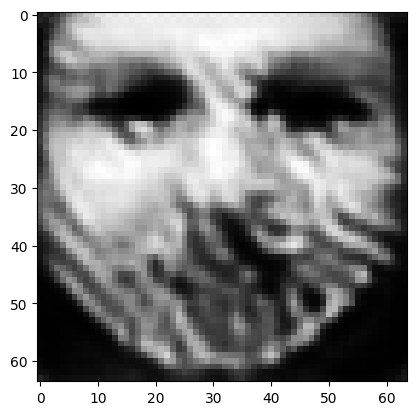

tensor([[2.6185e-05, 5.0265e-06, 2.5358e-04, 1.2465e-05, 9.7622e-01, 9.9308e-06,
         2.0016e-04, 1.4009e-05, 1.0148e-05, 4.9447e-07, 3.4801e-07, 2.2731e-06,
         3.5416e-03, 1.0845e-04, 1.7968e-05, 2.6924e-07, 2.9246e-04, 5.2386e-03,
         3.2661e-06, 3.6760e-05, 1.2429e-04, 3.8752e-06, 6.9149e-04, 8.7259e-07,
         6.0085e-03, 8.6117e-07, 7.9362e-05, 3.1803e-05, 4.3750e-06, 1.2518e-06,
         1.4770e-05, 4.3203e-05, 1.5556e-03, 9.0722e-05, 5.9106e-04, 1.9506e-04,
         6.2323e-04, 1.4765e-05, 3.8816e-03, 4.8423e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024066340178251266
tensor([[2.5630e-05, 4.8342e-06, 2.5038e-04, 1.2175e-05, 9.7691e-01, 9.6183e-06,
         1.9319e-04, 1.3701e-05, 9.6379e-06, 4.6920e-07, 3.2860e-07, 2.1646e-06,
         3.3734e-03, 1.0545e-04, 1.6906e-05, 2.5878e-07, 2.8707e-04, 5.1069e-03,
         3.1518e-06, 3.5201e-05, 1.1958e-04, 3.7219e-06, 6.6896e-04, 8.4522e-07,
         5.8936e-03, 8.2360e-07, 7.6452e-

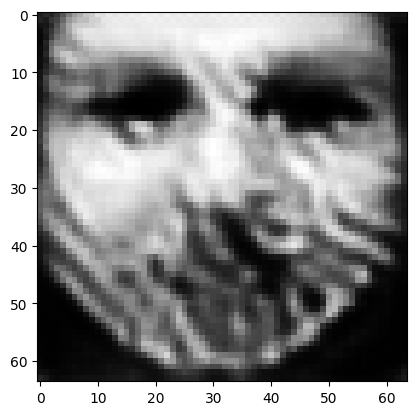

tensor([[2.3863e-05, 4.2332e-06, 2.4264e-04, 1.1246e-05, 9.7906e-01, 8.7265e-06,
         1.7159e-04, 1.2743e-05, 8.1516e-06, 3.9392e-07, 2.7115e-07, 1.8361e-06,
         2.8671e-03, 9.5398e-05, 1.3710e-05, 2.2640e-07, 2.6931e-04, 4.6803e-03,
         2.7991e-06, 3.0786e-05, 1.0491e-04, 3.2546e-06, 5.9106e-04, 7.5865e-07,
         5.4727e-03, 7.0614e-07, 6.7883e-05, 2.6950e-05, 3.5858e-06, 1.0182e-06,
         1.2108e-05, 3.7492e-05, 1.3370e-03, 7.6238e-05, 5.1973e-04, 1.5866e-04,
         5.4078e-04, 1.4050e-05, 3.4838e-03, 4.3534e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0211638230830431
tensor([[2.3467e-05, 4.1083e-06, 2.4126e-04, 1.1045e-05, 9.7951e-01, 8.5461e-06,
         1.6684e-04, 1.2529e-05, 7.8649e-06, 3.7879e-07, 2.5962e-07, 1.7691e-06,
         2.7665e-03, 9.3221e-05, 1.3058e-05, 2.1939e-07, 2.6529e-04, 4.5823e-03,
         2.7236e-06, 2.9930e-05, 1.0190e-04, 3.1589e-06, 5.7427e-04, 7.3968e-07,
         5.3837e-03, 6.8303e-07, 6.6069e-05

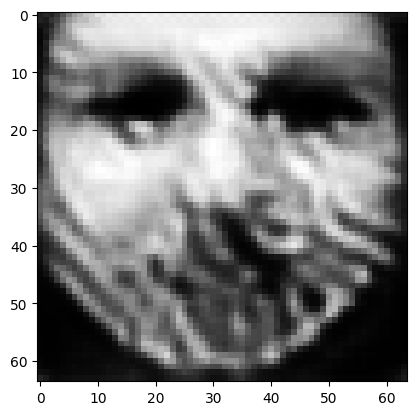

tensor([[2.2150e-05, 3.7299e-06, 2.3512e-04, 1.0406e-05, 9.8091e-01, 7.9355e-06,
         1.5222e-04, 1.1834e-05, 6.9457e-06, 3.3187e-07, 2.2461e-07, 1.5547e-06,
         2.4578e-03, 8.6358e-05, 1.1157e-05, 1.9671e-07, 2.5099e-04, 4.2978e-03,
         2.4885e-06, 2.7207e-05, 9.2264e-05, 2.8645e-06, 5.2377e-04, 6.7861e-07,
         5.1167e-03, 6.1117e-07, 6.0396e-05, 2.3814e-05, 3.0723e-06, 8.6711e-07,
         1.0457e-05, 3.3650e-05, 1.1940e-03, 6.7239e-05, 4.7165e-04, 1.3672e-04,
         4.8174e-04, 1.3458e-05, 3.2315e-03, 3.9867e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01927643083035946
tensor([[2.1827e-05, 3.6629e-06, 2.3247e-04, 1.0294e-05, 9.8119e-01, 7.7576e-06,
         1.4871e-04, 1.1621e-05, 6.7522e-06, 3.2262e-07, 2.1749e-07, 1.5124e-06,
         2.3990e-03, 8.5386e-05, 1.0831e-05, 1.9176e-07, 2.4819e-04, 4.2271e-03,
         2.4449e-06, 2.6510e-05, 9.0454e-05, 2.8109e-06, 5.1983e-04, 6.6563e-07,
         5.0803e-03, 6.0047e-07, 5.8951e-0

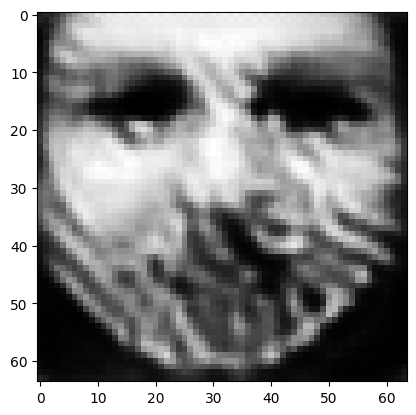

tensor([[2.0692e-05, 3.4298e-06, 2.2452e-04, 9.9043e-06, 9.8215e-01, 7.2092e-06,
         1.3708e-04, 1.0929e-05, 6.1302e-06, 2.9168e-07, 1.9369e-07, 1.3686e-06,
         2.2111e-03, 8.1616e-05, 9.7068e-06, 1.7485e-07, 2.3821e-04, 3.9940e-03,
         2.2886e-06, 2.4319e-05, 8.4280e-05, 2.6218e-06, 5.0121e-04, 6.1907e-07,
         4.9357e-03, 5.5988e-07, 5.4355e-05, 2.1460e-05, 2.7033e-06, 7.7659e-07,
         9.4083e-06, 3.1480e-05, 1.0986e-03, 6.0904e-05, 4.4886e-04, 1.2617e-04,
         4.5182e-04, 1.3151e-05, 2.9859e-03, 3.6774e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01801181398332119
tensor([[2.0455e-05, 3.3776e-06, 2.2318e-04, 9.8125e-06, 9.8236e-01, 7.1102e-06,
         1.3475e-04, 1.0796e-05, 6.0059e-06, 2.8524e-07, 1.8871e-07, 1.3374e-06,
         2.1727e-03, 8.0599e-05, 9.4584e-06, 1.7123e-07, 2.3578e-04, 3.9464e-03,
         2.2539e-06, 2.3901e-05, 8.2927e-05, 2.5792e-06, 4.9499e-04, 6.0846e-07,
         4.8970e-03, 5.4984e-07, 5.3498e-0

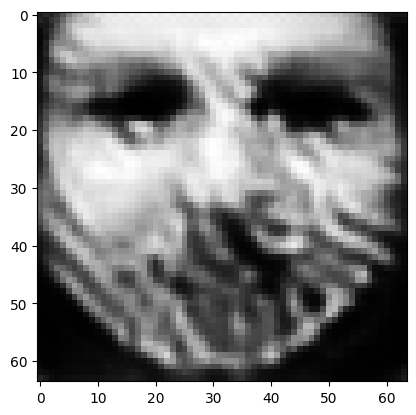

tensor([[1.9627e-05, 3.2002e-06, 2.1698e-04, 9.4888e-06, 9.8310e-01, 6.7264e-06,
         1.2631e-04, 1.0297e-05, 5.5538e-06, 2.6287e-07, 1.7205e-07, 1.2303e-06,
         2.0311e-03, 7.7396e-05, 8.6565e-06, 1.5877e-07, 2.2771e-04, 3.7719e-03,
         2.1384e-06, 2.2368e-05, 7.8150e-05, 2.4387e-06, 4.7719e-04, 5.7346e-07,
         4.7691e-03, 5.1784e-07, 5.0203e-05, 1.9807e-05, 2.4477e-06, 7.0870e-07,
         8.6163e-06, 2.9782e-05, 1.0291e-03, 5.6159e-05, 4.2999e-04, 1.1736e-04,
         4.2506e-04, 1.2874e-05, 2.8162e-03, 3.4593e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017046716064214706
tensor([[1.9431e-05, 3.1595e-06, 2.1553e-04, 9.4080e-06, 9.8327e-01, 6.6374e-06,
         1.2432e-04, 1.0172e-05, 5.4500e-06, 2.5769e-07, 1.6823e-07, 1.2053e-06,
         1.9990e-03, 7.6671e-05, 8.4708e-06, 1.5588e-07, 2.2589e-04, 3.7293e-03,
         2.1116e-06, 2.2013e-05, 7.7043e-05, 2.4061e-06, 4.7309e-04, 5.6532e-07,
         4.7384e-03, 5.1055e-07, 4.9431e-

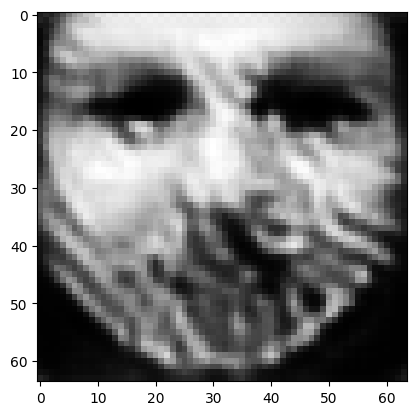

tensor([[1.8598e-05, 3.0060e-06, 2.0968e-04, 9.0906e-06, 9.8396e-01, 6.2626e-06,
         1.1599e-04, 9.6520e-06, 5.0386e-06, 2.3757e-07, 1.5341e-07, 1.1068e-06,
         1.8732e-03, 7.4024e-05, 7.7175e-06, 1.4464e-07, 2.1907e-04, 3.5380e-03,
         2.0039e-06, 2.0549e-05, 7.2475e-05, 2.2797e-06, 4.5960e-04, 5.3434e-07,
         4.6374e-03, 4.8611e-07, 4.6213e-05, 1.8387e-05, 2.2254e-06, 6.4940e-07,
         7.9726e-06, 2.8170e-05, 9.6618e-04, 5.2042e-05, 4.1290e-04, 1.0978e-04,
         4.0343e-04, 1.2623e-05, 2.6559e-03, 3.2568e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01616537757217884
tensor([[1.8403e-05, 2.9723e-06, 2.0839e-04, 9.0198e-06, 9.8412e-01, 6.1778e-06,
         1.1408e-04, 9.5260e-06, 4.9484e-06, 2.3323e-07, 1.5014e-07, 1.0857e-06,
         1.8460e-03, 7.3445e-05, 7.5504e-06, 1.4215e-07, 2.1748e-04, 3.4943e-03,
         1.9795e-06, 2.0219e-05, 7.1500e-05, 2.2518e-06, 4.5697e-04, 5.2710e-07,
         4.6130e-03, 4.8080e-07, 4.5502e-0

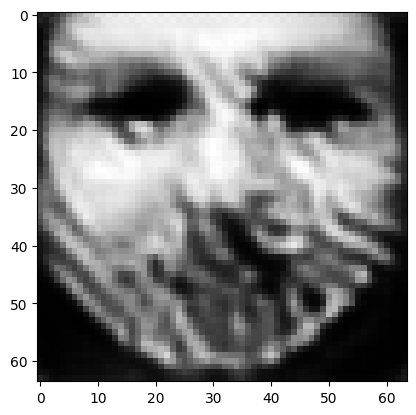

tensor([[1.7734e-05, 2.8447e-06, 2.0397e-04, 8.7367e-06, 9.8469e-01, 5.8851e-06,
         1.0746e-04, 9.1073e-06, 4.6261e-06, 2.1749e-07, 1.3868e-07, 1.0101e-06,
         1.7444e-03, 7.1157e-05, 6.9610e-06, 1.3332e-07, 2.1148e-04, 3.3430e-03,
         1.8901e-06, 1.9096e-05, 6.7852e-05, 2.1489e-06, 4.4432e-04, 5.0204e-07,
         4.5130e-03, 4.5996e-07, 4.3021e-05, 1.7237e-05, 2.0450e-06, 6.0057e-07,
         7.4663e-06, 2.6776e-05, 9.1644e-04, 4.8695e-05, 3.9780e-04, 1.0317e-04,
         3.8497e-04, 1.2408e-05, 2.5266e-03, 3.0933e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015424720011651516
tensor([[1.7571e-05, 2.8139e-06, 2.0327e-04, 8.6679e-06, 9.8482e-01, 5.8235e-06,
         1.0589e-04, 9.0090e-06, 4.5586e-06, 2.1389e-07, 1.3604e-07, 9.9302e-07,
         1.7229e-03, 7.0573e-05, 6.8220e-06, 1.3125e-07, 2.0992e-04, 3.3077e-03,
         1.8684e-06, 1.8855e-05, 6.7020e-05, 2.1250e-06, 4.4077e-04, 4.9562e-07,
         4.4858e-03, 4.5482e-07, 4.2504e-

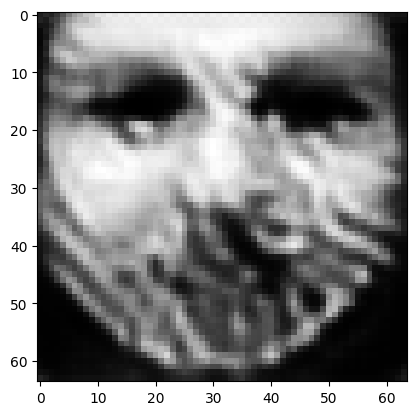

tensor([[1.6969e-05, 2.7032e-06, 1.9944e-04, 8.4177e-06, 9.8531e-01, 5.5780e-06,
         1.0026e-04, 8.6427e-06, 4.3065e-06, 2.0075e-07, 1.2678e-07, 9.3201e-07,
         1.6412e-03, 6.8645e-05, 6.3521e-06, 1.2391e-07, 2.0464e-04, 3.1819e-03,
         1.7917e-06, 1.7917e-05, 6.3992e-05, 2.0360e-06, 4.2997e-04, 4.7332e-07,
         4.3939e-03, 4.3674e-07, 4.0467e-05, 1.6281e-05, 1.8982e-06, 5.6045e-07,
         7.0539e-06, 2.5505e-05, 8.7452e-04, 4.5949e-05, 3.8459e-04, 9.7391e-05,
         3.6874e-04, 1.2197e-05, 2.4232e-03, 2.9651e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014797925017774105
tensor([[1.6828e-05, 2.6749e-06, 1.9828e-04, 8.3486e-06, 9.8543e-01, 5.5169e-06,
         9.8951e-05, 8.5548e-06, 4.2419e-06, 1.9766e-07, 1.2453e-07, 9.1765e-07,
         1.6202e-03, 6.8122e-05, 6.2399e-06, 1.2221e-07, 2.0327e-04, 3.1532e-03,
         1.7732e-06, 1.7690e-05, 6.3276e-05, 2.0132e-06, 4.2676e-04, 4.6794e-07,
         4.3714e-03, 4.3179e-07, 3.9959e-

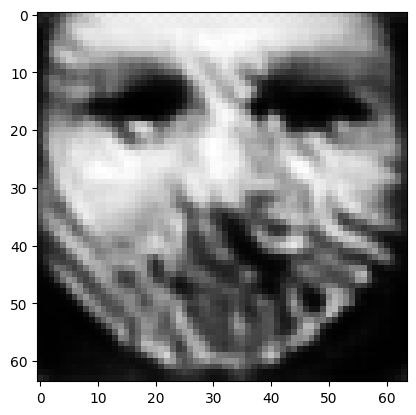

tensor([[1.6281e-05, 2.5743e-06, 1.9360e-04, 8.0995e-06, 9.8589e-01, 5.2734e-06,
         9.3929e-05, 8.2144e-06, 4.0021e-06, 1.8610e-07, 1.1614e-07, 8.6393e-07,
         1.5426e-03, 6.6322e-05, 5.8334e-06, 1.1590e-07, 1.9845e-04, 3.0405e-03,
         1.7051e-06, 1.6814e-05, 6.0570e-05, 1.9290e-06, 4.1680e-04, 4.4806e-07,
         4.2921e-03, 4.1446e-07, 3.8002e-05, 1.5380e-05, 1.7597e-06, 5.2318e-07,
         6.6537e-06, 2.4385e-05, 8.3555e-04, 4.3336e-05, 3.7191e-04, 9.2110e-05,
         3.5426e-04, 1.1988e-05, 2.3129e-03, 2.8352e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014215397648513317
tensor([[1.6161e-05, 2.5513e-06, 1.9256e-04, 8.0425e-06, 9.8599e-01, 5.2194e-06,
         9.2823e-05, 8.1377e-06, 3.9489e-06, 1.8353e-07, 1.1430e-07, 8.5215e-07,
         1.5250e-03, 6.5895e-05, 5.7439e-06, 1.1450e-07, 1.9734e-04, 3.0158e-03,
         1.6898e-06, 1.6621e-05, 5.9965e-05, 1.9101e-06, 4.1444e-04, 4.4364e-07,
         4.2735e-03, 4.1042e-07, 3.7573e-

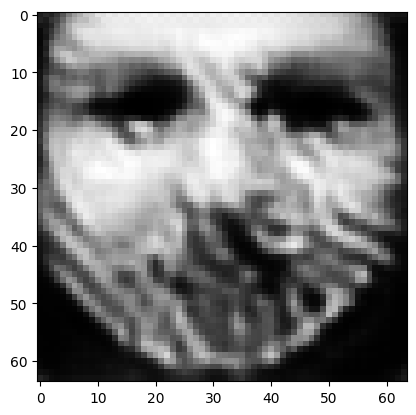

tensor([[1.5755e-05, 2.4664e-06, 1.8880e-04, 7.8262e-06, 9.8636e-01, 5.0383e-06,
         8.9099e-05, 7.8833e-06, 3.7630e-06, 1.7458e-07, 1.0790e-07, 8.1093e-07,
         1.4613e-03, 6.4190e-05, 5.4293e-06, 1.0961e-07, 1.9305e-04, 2.9318e-03,
         1.6341e-06, 1.5975e-05, 5.7785e-05, 1.8413e-06, 4.0402e-04, 4.2811e-07,
         4.1992e-03, 3.9488e-07, 3.6128e-05, 1.4657e-05, 1.6484e-06, 4.9261e-07,
         6.3236e-06, 2.3476e-05, 8.0421e-04, 4.1197e-05, 3.6068e-04, 8.7716e-05,
         3.4092e-04, 1.1791e-05, 2.2265e-03, 2.7300e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013735655695199966
tensor([[1.5661e-05, 2.4474e-06, 1.8780e-04, 7.7780e-06, 9.8644e-01, 4.9936e-06,
         8.8242e-05, 7.8222e-06, 3.7197e-06, 1.7252e-07, 1.0646e-07, 8.0166e-07,
         1.4464e-03, 6.3830e-05, 5.3606e-06, 1.0850e-07, 1.9209e-04, 2.9122e-03,
         1.6216e-06, 1.5818e-05, 5.7291e-05, 1.8256e-06, 4.0200e-04, 4.2467e-07,
         4.1835e-03, 3.9146e-07, 3.5782e-

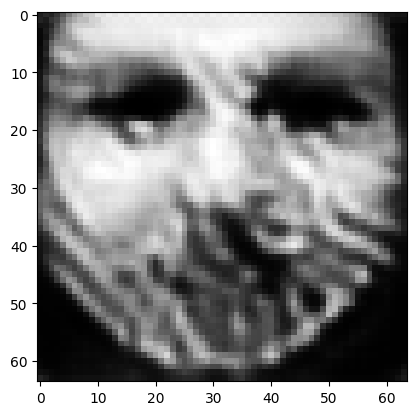

tensor([[1.5312e-05, 2.3732e-06, 1.8471e-04, 7.5887e-06, 9.8676e-01, 4.8466e-06,
         8.5041e-05, 7.6094e-06, 3.5696e-06, 1.6502e-07, 1.0114e-07, 7.6748e-07,
         1.3934e-03, 6.2204e-05, 5.0920e-06, 1.0425e-07, 1.8822e-04, 2.8350e-03,
         1.5723e-06, 1.5290e-05, 5.5429e-05, 1.7680e-06, 3.9246e-04, 4.1141e-07,
         4.1201e-03, 3.7841e-07, 3.4570e-05, 1.4057e-05, 1.5541e-06, 4.6641e-07,
         6.0535e-06, 2.2699e-05, 7.7814e-04, 3.9412e-05, 3.5078e-04, 8.3963e-05,
         3.2900e-04, 1.1604e-05, 2.1556e-03, 2.6409e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013326265849173069
tensor([[1.5226e-05, 2.3568e-06, 1.8391e-04, 7.5467e-06, 9.8684e-01, 4.8075e-06,
         8.4233e-05, 7.5512e-06, 3.5357e-06, 1.6327e-07, 9.9886e-08, 7.5965e-07,
         1.3815e-03, 6.1876e-05, 5.0322e-06, 1.0323e-07, 1.8725e-04, 2.8153e-03,
         1.5608e-06, 1.5159e-05, 5.5001e-05, 1.7554e-06, 3.9079e-04, 4.0817e-07,
         4.1057e-03, 3.7569e-07, 3.4279e-

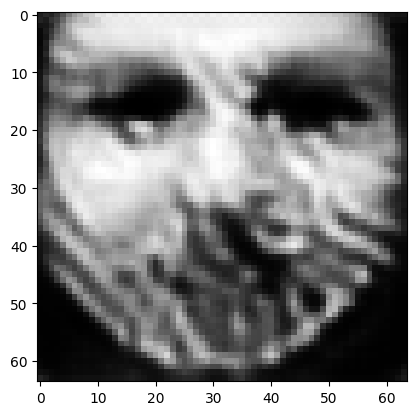

tensor([[1.4937e-05, 2.2929e-06, 1.8103e-04, 7.3806e-06, 9.8712e-01, 4.6748e-06,
         8.1523e-05, 7.3601e-06, 3.4042e-06, 1.5683e-07, 9.5410e-08, 7.3053e-07,
         1.3344e-03, 6.0508e-05, 4.8156e-06, 9.9626e-08, 1.8368e-04, 2.7517e-03,
         1.5179e-06, 1.4703e-05, 5.3382e-05, 1.7060e-06, 3.8233e-04, 3.9688e-07,
         4.0467e-03, 3.6391e-07, 3.3241e-05, 1.3519e-05, 1.4731e-06, 4.4442e-07,
         5.8212e-06, 2.2054e-05, 7.5594e-04, 3.7881e-05, 3.4216e-04, 8.0809e-05,
         3.1859e-04, 1.1444e-05, 2.0949e-03, 2.5616e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012967425398528576
tensor([[1.4866e-05, 2.2765e-06, 1.8068e-04, 7.3382e-06, 9.8718e-01, 4.6505e-06,
         8.0888e-05, 7.3205e-06, 3.3773e-06, 1.5534e-07, 9.4331e-08, 7.2364e-07,
         1.3243e-03, 6.0094e-05, 4.7586e-06, 9.8730e-08, 1.8271e-04, 2.7362e-03,
         1.5068e-06, 1.4616e-05, 5.2991e-05, 1.6944e-06, 3.7947e-04, 3.9378e-07,
         4.0293e-03, 3.6081e-07, 3.3037e-

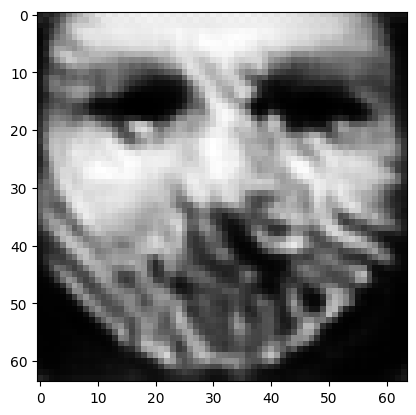

tensor([[1.4612e-05, 2.2248e-06, 1.7801e-04, 7.1958e-06, 9.8742e-01, 4.5332e-06,
         7.8643e-05, 7.1552e-06, 3.2703e-06, 1.5019e-07, 9.0616e-08, 6.9953e-07,
         1.2863e-03, 5.8981e-05, 4.5893e-06, 9.5694e-08, 1.7943e-04, 2.6824e-03,
         1.4708e-06, 1.4226e-05, 5.1634e-05, 1.6533e-06, 3.7247e-04, 3.8398e-07,
         3.9759e-03, 3.5094e-07, 3.2173e-05, 1.3077e-05, 1.4072e-06, 4.2593e-07,
         5.6242e-06, 2.1463e-05, 7.3686e-04, 3.6617e-05, 3.3449e-04, 7.8012e-05,
         3.0887e-04, 1.1277e-05, 2.0472e-03, 2.4962e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01265883818268776
tensor([[1.4552e-05, 2.2133e-06, 1.7732e-04, 7.1631e-06, 9.8748e-01, 4.5043e-06,
         7.8112e-05, 7.1139e-06, 3.2456e-06, 1.4901e-07, 8.9750e-08, 6.9398e-07,
         1.2777e-03, 5.8735e-05, 4.5516e-06, 9.4981e-08, 1.7863e-04, 2.6693e-03,
         1.4626e-06, 1.4133e-05, 5.1321e-05, 1.6439e-06, 3.7100e-04, 3.8171e-07,
         3.9638e-03, 3.4875e-07, 3.1968e-0

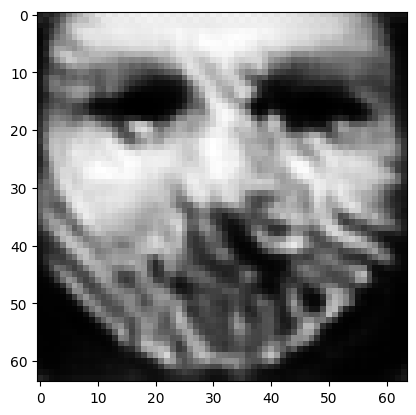

tensor([[1.4332e-05, 2.1656e-06, 1.7509e-04, 7.0270e-06, 9.8769e-01, 4.4094e-06,
         7.6229e-05, 6.9748e-06, 3.1538e-06, 1.4464e-07, 8.6470e-08, 6.7261e-07,
         1.2450e-03, 5.7568e-05, 4.3996e-06, 9.2290e-08, 1.7552e-04, 2.6222e-03,
         1.4299e-06, 1.3816e-05, 5.0094e-05, 1.6069e-06, 3.6324e-04, 3.7294e-07,
         3.9123e-03, 3.3942e-07, 3.1252e-05, 1.2696e-05, 1.3506e-06, 4.0981e-07,
         5.4463e-06, 2.0944e-05, 7.2015e-04, 3.5489e-05, 3.2775e-04, 7.5555e-05,
         2.9993e-04, 1.1106e-05, 2.0043e-03, 2.4366e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01238524354994297
tensor([[1.4277e-05, 2.1552e-06, 1.7443e-04, 6.9966e-06, 9.8774e-01, 4.3829e-06,
         7.5754e-05, 6.9365e-06, 3.1317e-06, 1.4362e-07, 8.5704e-08, 6.6769e-07,
         1.2374e-03, 5.7346e-05, 4.3668e-06, 9.1653e-08, 1.7481e-04, 2.6102e-03,
         1.4225e-06, 1.3732e-05, 4.9815e-05, 1.5986e-06, 3.6195e-04, 3.7092e-07,
         3.9015e-03, 3.3750e-07, 3.1066e-0

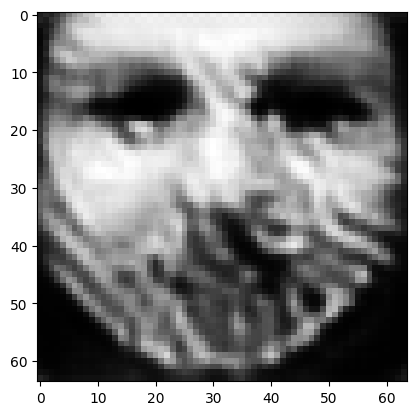

tensor([[1.4078e-05, 2.1134e-06, 1.7204e-04, 6.8736e-06, 9.8794e-01, 4.2917e-06,
         7.4084e-05, 6.8093e-06, 3.0438e-06, 1.3982e-07, 8.2787e-08, 6.4806e-07,
         1.2073e-03, 5.6323e-05, 4.2358e-06, 8.9300e-08, 1.7208e-04, 2.5677e-03,
         1.3944e-06, 1.3431e-05, 4.8715e-05, 1.5648e-06, 3.5505e-04, 3.6339e-07,
         3.8574e-03, 3.2920e-07, 3.0374e-05, 1.2351e-05, 1.3004e-06, 3.9555e-07,
         5.2794e-06, 2.0477e-05, 7.0414e-04, 3.4434e-05, 3.2192e-04, 7.3399e-05,
         2.9221e-04, 1.0941e-05, 1.9599e-03, 2.3772e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012134304270148277
tensor([[1.4030e-05, 2.1028e-06, 1.7152e-04, 6.8423e-06, 9.8799e-01, 4.2717e-06,
         7.3692e-05, 6.7825e-06, 3.0222e-06, 1.3890e-07, 8.2082e-08, 6.4316e-07,
         1.2000e-03, 5.6040e-05, 4.2020e-06, 8.8733e-08, 1.7142e-04, 2.5574e-03,
         1.3876e-06, 1.3363e-05, 4.8440e-05, 1.5563e-06, 3.5304e-04, 3.6160e-07,
         3.8464e-03, 3.2708e-07, 3.0206e-

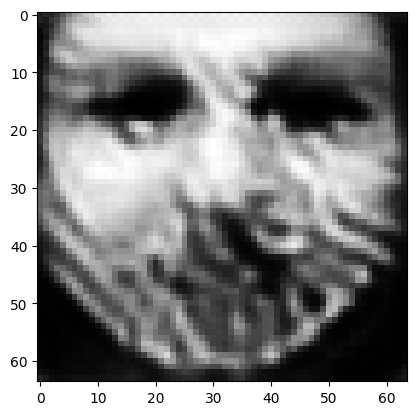

tensor([[1.3828e-05, 2.0646e-06, 1.6928e-04, 6.7284e-06, 9.8817e-01, 4.1836e-06,
         7.2063e-05, 6.6613e-06, 2.9406e-06, 1.3541e-07, 7.9389e-08, 6.2483e-07,
         1.1731e-03, 5.5110e-05, 4.0772e-06, 8.6524e-08, 1.6895e-04, 2.5137e-03,
         1.3619e-06, 1.3073e-05, 4.7430e-05, 1.5254e-06, 3.4705e-04, 3.5462e-07,
         3.8077e-03, 3.1990e-07, 2.9521e-05, 1.2044e-05, 1.2554e-06, 3.8212e-07,
         5.1258e-06, 2.0021e-05, 6.8871e-04, 3.3453e-05, 3.1652e-04, 7.1235e-05,
         2.8507e-04, 1.0778e-05, 1.9187e-03, 2.3211e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011898968368768692
tensor([[1.3781e-05, 2.0549e-06, 1.6883e-04, 6.6998e-06, 9.8822e-01, 4.1650e-06,
         7.1691e-05, 6.6355e-06, 2.9214e-06, 1.3457e-07, 7.8743e-08, 6.2033e-07,
         1.1668e-03, 5.4852e-05, 4.0452e-06, 8.5994e-08, 1.6835e-04, 2.5036e-03,
         1.3555e-06, 1.3011e-05, 4.7181e-05, 1.5177e-06, 3.4525e-04, 3.5288e-07,
         3.7974e-03, 3.1799e-07, 2.9369e-

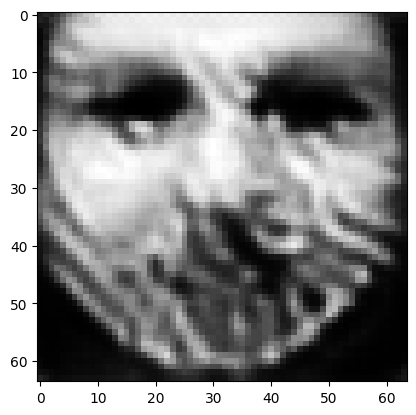

tensor([[1.3584e-05, 2.0208e-06, 1.6667e-04, 6.5970e-06, 9.8839e-01, 4.0792e-06,
         7.0127e-05, 6.5170e-06, 2.8472e-06, 1.3135e-07, 7.6256e-08, 6.0342e-07,
         1.1431e-03, 5.4033e-05, 3.9308e-06, 8.3940e-08, 1.6604e-04, 2.4606e-03,
         1.3318e-06, 1.2739e-05, 4.6249e-05, 1.4893e-06, 3.4013e-04, 3.4623e-07,
         3.7617e-03, 3.1164e-07, 2.8733e-05, 1.1752e-05, 1.2139e-06, 3.7014e-07,
         4.9911e-06, 1.9587e-05, 6.7459e-04, 3.2556e-05, 3.1181e-04, 6.9272e-05,
         2.7864e-04, 1.0628e-05, 1.8814e-03, 2.2704e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011681606061756611
tensor([[1.3535e-05, 2.0134e-06, 1.6604e-04, 6.5737e-06, 9.8843e-01, 4.0565e-06,
         6.9742e-05, 6.4855e-06, 2.8292e-06, 1.3061e-07, 7.5681e-08, 5.9957e-07,
         1.1374e-03, 5.3874e-05, 3.9060e-06, 8.3463e-08, 1.6552e-04, 2.4498e-03,
         1.3265e-06, 1.2668e-05, 4.6037e-05, 1.4829e-06, 3.3932e-04, 3.4476e-07,
         3.7546e-03, 3.1037e-07, 2.8570e-

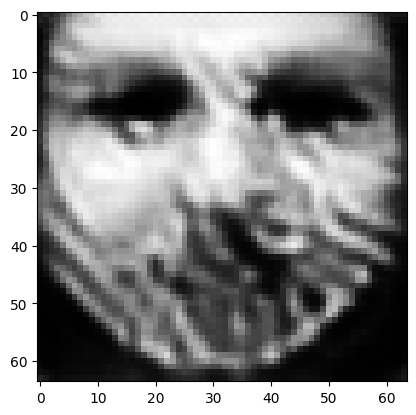

tensor([[1.3375e-05, 1.9824e-06, 1.6416e-04, 6.4774e-06, 9.8858e-01, 3.9888e-06,
         6.8480e-05, 6.3906e-06, 2.7639e-06, 1.2793e-07, 7.3564e-08, 5.8481e-07,
         1.1160e-03, 5.3051e-05, 3.8066e-06, 8.1723e-08, 1.6344e-04, 2.4146e-03,
         1.3057e-06, 1.2450e-05, 4.5202e-05, 1.4575e-06, 3.3379e-04, 3.3920e-07,
         3.7202e-03, 3.0428e-07, 2.8041e-05, 1.1497e-05, 1.1773e-06, 3.5953e-07,
         4.8678e-06, 1.9215e-05, 6.6192e-04, 3.1743e-05, 3.0761e-04, 6.7576e-05,
         2.7284e-04, 1.0485e-05, 1.8463e-03, 2.2240e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011485997587442398
tensor([[1.3335e-05, 1.9757e-06, 1.6358e-04, 6.4557e-06, 9.8862e-01, 3.9691e-06,
         6.8153e-05, 6.3627e-06, 2.7475e-06, 1.2728e-07, 7.3062e-08, 5.8138e-07,
         1.1106e-03, 5.2904e-05, 3.7852e-06, 8.1313e-08, 1.6296e-04, 2.4058e-03,
         1.3010e-06, 1.2388e-05, 4.5009e-05, 1.4516e-06, 3.3293e-04, 3.3791e-07,
         3.7131e-03, 3.0301e-07, 2.7901e-

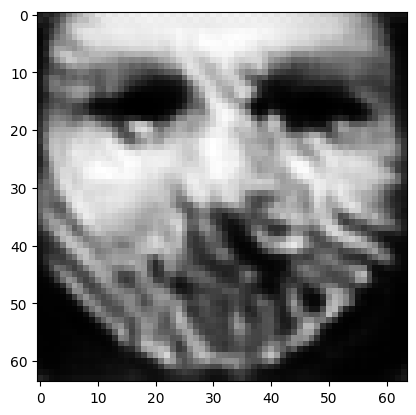

tensor([[1.3187e-05, 1.9467e-06, 1.6185e-04, 6.3642e-06, 9.8876e-01, 3.9067e-06,
         6.6983e-05, 6.2728e-06, 2.6858e-06, 1.2480e-07, 7.1091e-08, 5.6763e-07,
         1.0899e-03, 5.2135e-05, 3.6934e-06, 7.9734e-08, 1.6097e-04, 2.3741e-03,
         1.2812e-06, 1.2186e-05, 4.4218e-05, 1.4276e-06, 3.2747e-04, 3.3265e-07,
         3.6793e-03, 2.9703e-07, 2.7421e-05, 1.1258e-05, 1.1441e-06, 3.4975e-07,
         4.7495e-06, 1.8873e-05, 6.5006e-04, 3.0983e-05, 3.0369e-04, 6.5963e-05,
         2.6726e-04, 1.0351e-05, 1.8130e-03, 2.1808e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011302019469439983
tensor([[1.3151e-05, 1.9396e-06, 1.6150e-04, 6.3416e-06, 9.8880e-01, 3.8927e-06,
         6.6689e-05, 6.2519e-06, 2.6716e-06, 1.2420e-07, 7.0606e-08, 5.6427e-07,
         1.0851e-03, 5.1932e-05, 3.6699e-06, 7.9335e-08, 1.6047e-04, 2.3659e-03,
         1.2761e-06, 1.2141e-05, 4.4021e-05, 1.4219e-06, 3.2600e-04, 3.3129e-07,
         3.6707e-03, 2.9558e-07, 2.7309e-

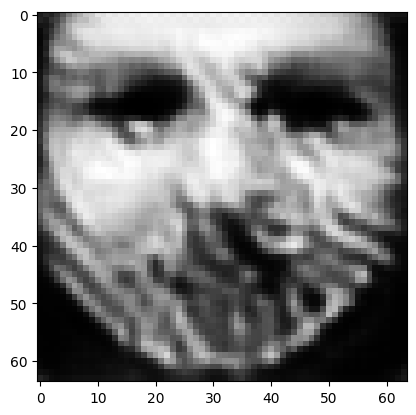

tensor([[1.3013e-05, 1.9139e-06, 1.5975e-04, 6.2599e-06, 9.8893e-01, 3.8304e-06,
         6.5562e-05, 6.1651e-06, 2.6135e-06, 1.2188e-07, 6.8817e-08, 5.5166e-07,
         1.0656e-03, 5.1290e-05, 3.5884e-06, 7.7878e-08, 1.5872e-04, 2.3353e-03,
         1.2583e-06, 1.1944e-05, 4.3291e-05, 1.4003e-06, 3.2159e-04, 3.2662e-07,
         3.6422e-03, 2.9048e-07, 2.6834e-05, 1.1037e-05, 1.1135e-06, 3.4082e-07,
         4.6418e-06, 1.8554e-05, 6.3897e-04, 3.0285e-05, 3.0012e-04, 6.4461e-05,
         2.6210e-04, 1.0230e-05, 1.7827e-03, 2.1403e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01113121211528778
tensor([[1.2982e-05, 1.9077e-06, 1.5941e-04, 6.2403e-06, 9.8896e-01, 3.8177e-06,
         6.5309e-05, 6.1473e-06, 2.6005e-06, 1.2135e-07, 6.8401e-08, 5.4869e-07,
         1.0614e-03, 5.1115e-05, 3.5688e-06, 7.7530e-08, 1.5829e-04, 2.3283e-03,
         1.2541e-06, 1.1903e-05, 4.3119e-05, 1.3952e-06, 3.2034e-04, 3.2549e-07,
         3.6346e-03, 2.8922e-07, 2.6732e-0

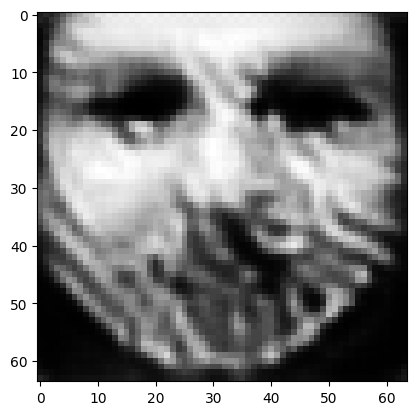

tensor([[1.2862e-05, 1.8851e-06, 1.5800e-04, 6.1687e-06, 9.8908e-01, 3.7667e-06,
         6.4329e-05, 6.0737e-06, 2.5528e-06, 1.1940e-07, 6.6864e-08, 5.3794e-07,
         1.0454e-03, 5.0494e-05, 3.4987e-06, 7.6205e-08, 1.5668e-04, 2.3010e-03,
         1.2382e-06, 1.1742e-05, 4.2490e-05, 1.3769e-06, 3.1626e-04, 3.2135e-07,
         3.6078e-03, 2.8495e-07, 2.6330e-05, 1.0852e-05, 1.0872e-06, 3.3298e-07,
         4.5491e-06, 1.8269e-05, 6.2896e-04, 2.9678e-05, 2.9699e-04, 6.3123e-05,
         2.5746e-04, 1.0113e-05, 1.7579e-03, 2.1052e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01098183449357748
tensor([[1.2835e-05, 1.8795e-06, 1.5769e-04, 6.1514e-06, 9.8911e-01, 3.7558e-06,
         6.4108e-05, 6.0575e-06, 2.5417e-06, 1.1895e-07, 6.6506e-08, 5.3539e-07,
         1.0417e-03, 5.0333e-05, 3.4817e-06, 7.5894e-08, 1.5629e-04, 2.2948e-03,
         1.2344e-06, 1.1707e-05, 4.2342e-05, 1.3724e-06, 3.1518e-04, 3.2036e-07,
         3.6010e-03, 2.8387e-07, 2.6240e-0

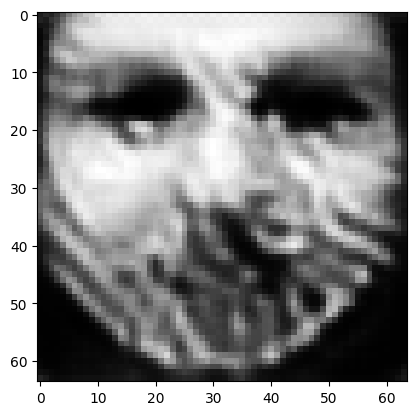

tensor([[1.2726e-05, 1.8589e-06, 1.5635e-04, 6.0857e-06, 9.8921e-01, 3.7093e-06,
         6.3226e-05, 5.9900e-06, 2.4980e-06, 1.1718e-07, 6.5127e-08, 5.2557e-07,
         1.0273e-03, 4.9764e-05, 3.4183e-06, 7.4690e-08, 1.5483e-04, 2.2701e-03,
         1.2199e-06, 1.1561e-05, 4.1772e-05, 1.3555e-06, 3.1147e-04, 3.1654e-07,
         3.5763e-03, 2.7994e-07, 2.5874e-05, 1.0685e-05, 1.0634e-06, 3.2592e-07,
         4.4643e-06, 1.8006e-05, 6.1981e-04, 2.9118e-05, 2.9414e-04, 6.1912e-05,
         2.5321e-04, 1.0004e-05, 1.7350e-03, 2.0733e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010845760814845562
tensor([[1.2700e-05, 1.8537e-06, 1.5606e-04, 6.0692e-06, 9.8924e-01, 3.6992e-06,
         6.3020e-05, 5.9750e-06, 2.4878e-06, 1.1676e-07, 6.4796e-08, 5.2320e-07,
         1.0239e-03, 4.9610e-05, 3.4023e-06, 7.4398e-08, 1.5447e-04, 2.2642e-03,
         1.2163e-06, 1.1529e-05, 4.1633e-05, 1.3513e-06, 3.1043e-04, 3.1560e-07,
         3.5700e-03, 2.7893e-07, 2.5790e-

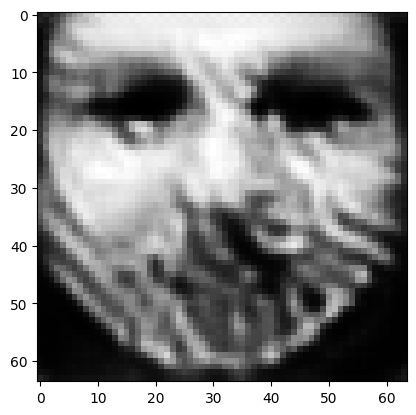

tensor([[1.2595e-05, 1.8351e-06, 1.5473e-04, 6.0092e-06, 9.8934e-01, 3.6533e-06,
         6.2182e-05, 5.9076e-06, 2.4480e-06, 1.1513e-07, 6.3521e-08, 5.1428e-07,
         1.0107e-03, 4.9105e-05, 3.3447e-06, 7.3276e-08, 1.5306e-04, 2.2401e-03,
         1.2028e-06, 1.1388e-05, 4.1110e-05, 1.3360e-06, 3.0730e-04, 3.1200e-07,
         3.5478e-03, 2.7549e-07, 2.5444e-05, 1.0527e-05, 1.0410e-06, 3.1950e-07,
         4.3877e-06, 1.7763e-05, 6.1148e-04, 2.8604e-05, 2.9157e-04, 6.0831e-05,
         2.4937e-04, 9.9054e-06, 1.7134e-03, 2.0436e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01071945670992136
tensor([[1.2571e-05, 1.8303e-06, 1.5446e-04, 5.9941e-06, 9.8936e-01, 3.6440e-06,
         6.1997e-05, 5.8938e-06, 2.4385e-06, 1.1475e-07, 6.3218e-08, 5.1210e-07,
         1.0075e-03, 4.8963e-05, 3.3303e-06, 7.3012e-08, 1.5272e-04, 2.2348e-03,
         1.1995e-06, 1.1358e-05, 4.0981e-05, 1.3321e-06, 3.0631e-04, 3.1114e-07,
         3.5418e-03, 2.7454e-07, 2.5368e-0

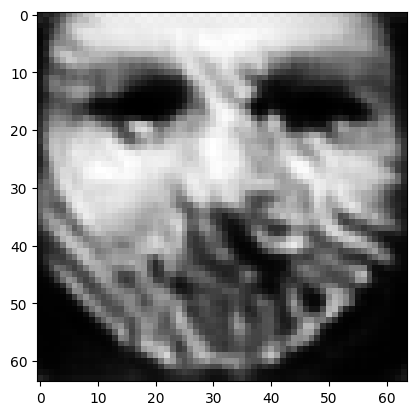

tensor([[1.2478e-05, 1.8126e-06, 1.5330e-04, 5.9363e-06, 9.8945e-01, 3.6046e-06,
         6.1252e-05, 5.8364e-06, 2.4017e-06, 1.1325e-07, 6.2059e-08, 5.0375e-07,
         9.9521e-04, 4.8457e-05, 3.2764e-06, 7.1987e-08, 1.5142e-04, 2.2132e-03,
         1.1869e-06, 1.1236e-05, 4.0482e-05, 1.3176e-06, 3.0297e-04, 3.0786e-07,
         3.5198e-03, 2.7117e-07, 2.5058e-05, 1.0385e-05, 1.0208e-06, 3.1350e-07,
         4.3148e-06, 1.7530e-05, 6.0360e-04, 2.8125e-05, 2.8904e-04, 5.9775e-05,
         2.4556e-04, 9.8071e-06, 1.6942e-03, 2.0162e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010601275600492954
tensor([[1.2456e-05, 1.8083e-06, 1.5303e-04, 5.9220e-06, 9.8948e-01, 3.5957e-06,
         6.1085e-05, 5.8236e-06, 2.3927e-06, 1.1289e-07, 6.1784e-08, 5.0172e-07,
         9.9222e-04, 4.8330e-05, 3.2634e-06, 7.1748e-08, 1.5111e-04, 2.2085e-03,
         1.1839e-06, 1.1207e-05, 4.0360e-05, 1.3140e-06, 3.0206e-04, 3.0707e-07,
         3.5142e-03, 2.7029e-07, 2.4987e-

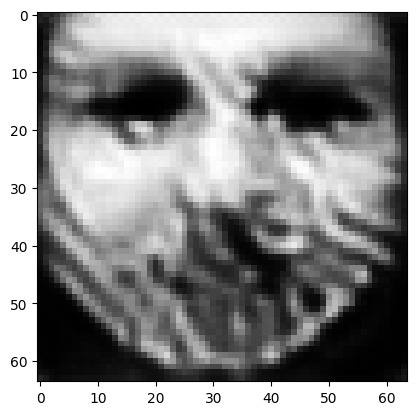

tensor([[1.2368e-05, 1.7920e-06, 1.5187e-04, 5.8680e-06, 9.8956e-01, 3.5572e-06,
         6.0384e-05, 5.7675e-06, 2.3583e-06, 1.1151e-07, 6.0711e-08, 4.9410e-07,
         9.8054e-04, 4.7888e-05, 3.2150e-06, 7.0811e-08, 1.4987e-04, 2.1887e-03,
         1.1723e-06, 1.1089e-05, 3.9898e-05, 1.3007e-06, 2.9907e-04, 3.0403e-07,
         3.4935e-03, 2.6719e-07, 2.4695e-05, 1.0249e-05, 1.0019e-06, 3.0798e-07,
         4.2464e-06, 1.7320e-05, 5.9607e-04, 2.7678e-05, 2.8671e-04, 5.8832e-05,
         2.4213e-04, 9.7174e-06, 1.6752e-03, 1.9894e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01049051247537136
tensor([[1.2346e-05, 1.7878e-06, 1.5166e-04, 5.8542e-06, 9.8959e-01, 3.5492e-06,
         6.0216e-05, 5.7548e-06, 2.3506e-06, 1.1117e-07, 6.0444e-08, 4.9222e-07,
         9.7794e-04, 4.7762e-05, 3.2021e-06, 7.0577e-08, 1.4954e-04, 2.1838e-03,
         1.1693e-06, 1.1064e-05, 3.9782e-05, 1.2975e-06, 2.9818e-04, 3.0319e-07,
         3.4876e-03, 2.6636e-07, 2.4633e-0

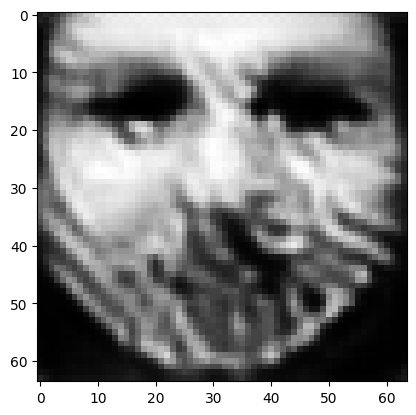

tensor([[1.2269e-05, 1.7727e-06, 1.5059e-04, 5.8040e-06, 9.8967e-01, 3.5138e-06,
         5.9589e-05, 5.7040e-06, 2.3182e-06, 1.0988e-07, 5.9465e-08, 4.8518e-07,
         9.6680e-04, 4.7355e-05, 3.1586e-06, 6.9737e-08, 1.4839e-04, 2.1667e-03,
         1.1588e-06, 1.0955e-05, 3.9352e-05, 1.2850e-06, 2.9529e-04, 3.0046e-07,
         3.4674e-03, 2.6330e-07, 2.4369e-05, 1.0120e-05, 9.8433e-07, 3.0288e-07,
         4.1822e-06, 1.7123e-05, 5.8910e-04, 2.7264e-05, 2.8452e-04, 5.7939e-05,
         2.3883e-04, 9.6330e-06, 1.6579e-03, 1.9647e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010386343114078045
tensor([[1.2250e-05, 1.7686e-06, 1.5044e-04, 5.7911e-06, 9.8969e-01, 3.5078e-06,
         5.9447e-05, 5.6937e-06, 2.3114e-06, 1.0958e-07, 5.9228e-08, 4.8351e-07,
         9.6438e-04, 4.7226e-05, 3.1466e-06, 6.9529e-08, 1.4808e-04, 2.1625e-03,
         1.1560e-06, 1.0936e-05, 3.9247e-05, 1.2820e-06, 2.9433e-04, 2.9971e-07,
         3.4614e-03, 2.6247e-07, 2.4318e-

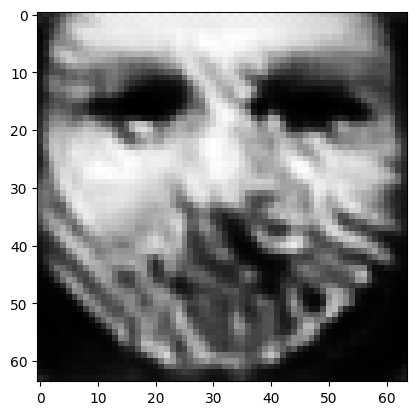

tensor([[1.2176e-05, 1.7548e-06, 1.4944e-04, 5.7458e-06, 9.8976e-01, 3.4740e-06,
         5.8854e-05, 5.6451e-06, 2.2817e-06, 1.0835e-07, 5.8331e-08, 4.7708e-07,
         9.5435e-04, 4.6867e-05, 3.1063e-06, 6.8753e-08, 1.4705e-04, 2.1462e-03,
         1.1462e-06, 1.0834e-05, 3.8855e-05, 1.2706e-06, 2.9184e-04, 2.9713e-07,
         3.4430e-03, 2.5969e-07, 2.4073e-05, 1.0003e-05, 9.6827e-07, 2.9825e-07,
         4.1239e-06, 1.6939e-05, 5.8269e-04, 2.6887e-05, 2.8250e-04, 5.7117e-05,
         2.3580e-04, 9.5561e-06, 1.6423e-03, 1.9426e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010290540754795074
tensor([[1.2160e-05, 1.7511e-06, 1.4926e-04, 5.7340e-06, 9.8978e-01, 3.4681e-06,
         5.8731e-05, 5.6361e-06, 2.2749e-06, 1.0807e-07, 5.8121e-08, 4.7553e-07,
         9.5203e-04, 4.6754e-05, 3.0957e-06, 6.8573e-08, 1.4679e-04, 2.1427e-03,
         1.1438e-06, 1.0815e-05, 3.8759e-05, 1.2677e-06, 2.9097e-04, 2.9651e-07,
         3.4377e-03, 2.5891e-07, 2.4023e-

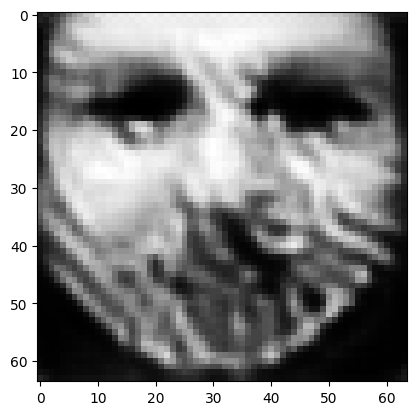

tensor([[1.2091e-05, 1.7380e-06, 1.4837e-04, 5.6912e-06, 9.8985e-01, 3.4374e-06,
         5.8186e-05, 5.5921e-06, 2.2475e-06, 1.0692e-07, 5.7289e-08, 4.6952e-07,
         9.4277e-04, 4.6404e-05, 3.0575e-06, 6.7848e-08, 1.4582e-04, 2.1274e-03,
         1.1347e-06, 1.0722e-05, 3.8389e-05, 1.2571e-06, 2.8852e-04, 2.9408e-07,
         3.4201e-03, 2.5628e-07, 2.3797e-05, 9.8952e-06, 9.5352e-07, 2.9393e-07,
         4.0688e-06, 1.6767e-05, 5.7672e-04, 2.6538e-05, 2.8054e-04, 5.6345e-05,
         2.3296e-04, 9.4831e-06, 1.6279e-03, 1.9219e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010201456025242805
tensor([[1.2076e-05, 1.7345e-06, 1.4821e-04, 5.6802e-06, 9.8987e-01, 3.4318e-06,
         5.8064e-05, 5.5838e-06, 2.2412e-06, 1.0666e-07, 5.7093e-08, 4.6809e-07,
         9.4068e-04, 4.6300e-05, 3.0476e-06, 6.7677e-08, 1.4559e-04, 2.1240e-03,
         1.1324e-06, 1.0704e-05, 3.8300e-05, 1.2544e-06, 2.8776e-04, 2.9350e-07,
         3.4155e-03, 2.5558e-07, 2.3748e-

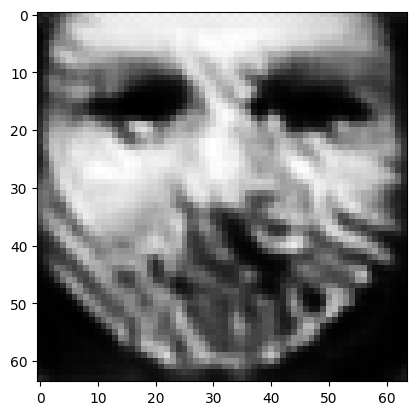

tensor([[1.2008e-05, 1.7228e-06, 1.4733e-04, 5.6415e-06, 9.8993e-01, 3.4015e-06,
         5.7527e-05, 5.5402e-06, 2.2160e-06, 1.0559e-07, 5.6327e-08, 4.6270e-07,
         9.3230e-04, 4.6008e-05, 3.0132e-06, 6.7003e-08, 1.4472e-04, 2.1090e-03,
         1.1241e-06, 1.0613e-05, 3.7971e-05, 1.2448e-06, 2.8591e-04, 2.9126e-07,
         3.4003e-03, 2.5338e-07, 2.3528e-05, 9.7906e-06, 9.3975e-07, 2.9012e-07,
         4.0199e-06, 1.6613e-05, 5.7120e-04, 2.6217e-05, 2.7882e-04, 5.5693e-05,
         2.3062e-04, 9.4212e-06, 1.6137e-03, 1.9026e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010119796730577946
tensor([[1.1994e-05, 1.7197e-06, 1.4718e-04, 5.6315e-06, 9.8995e-01, 3.3962e-06,
         5.7413e-05, 5.5324e-06, 2.2102e-06, 1.0534e-07, 5.6147e-08, 4.6139e-07,
         9.3036e-04, 4.5915e-05, 3.0041e-06, 6.6847e-08, 1.4451e-04, 2.1058e-03,
         1.1220e-06, 1.0596e-05, 3.7889e-05, 1.2423e-06, 2.8524e-04, 2.9072e-07,
         3.3960e-03, 2.5275e-07, 2.3481e-

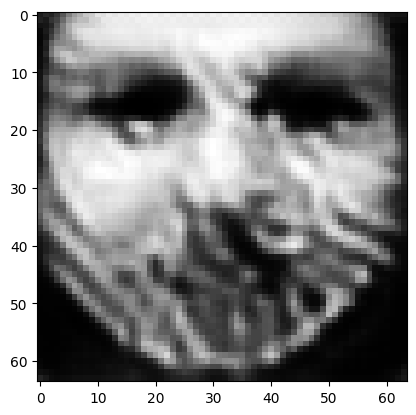

tensor([[1.1932e-05, 1.7087e-06, 1.4644e-04, 5.5952e-06, 9.9001e-01, 3.3704e-06,
         5.6927e-05, 5.4944e-06, 2.1876e-06, 1.0437e-07, 5.5445e-08, 4.5645e-07,
         9.2281e-04, 4.5616e-05, 2.9715e-06, 6.6226e-08, 1.4370e-04, 2.0921e-03,
         1.1142e-06, 1.0517e-05, 3.7583e-05, 1.2334e-06, 2.8329e-04, 2.8863e-07,
         3.3810e-03, 2.5063e-07, 2.3286e-05, 9.6966e-06, 9.2725e-07, 2.8657e-07,
         3.9743e-06, 1.6465e-05, 5.6595e-04, 2.5923e-05, 2.7721e-04, 5.5060e-05,
         2.2836e-04, 9.3607e-06, 1.6012e-03, 1.8855e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010043559595942497
tensor([[1.1918e-05, 1.7058e-06, 1.4628e-04, 5.5859e-06, 9.9002e-01, 3.3653e-06,
         5.6823e-05, 5.4870e-06, 2.1820e-06, 1.0414e-07, 5.5279e-08, 4.5524e-07,
         9.2094e-04, 4.5530e-05, 2.9633e-06, 6.6083e-08, 1.4350e-04, 2.0891e-03,
         1.1123e-06, 1.0501e-05, 3.7508e-05, 1.2311e-06, 2.8267e-04, 2.8815e-07,
         3.3770e-03, 2.5004e-07, 2.3242e-

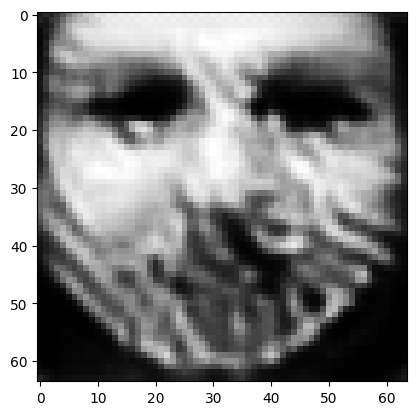

tensor([[1.1859e-05, 1.6957e-06, 1.4556e-04, 5.5522e-06, 9.9008e-01, 3.3408e-06,
         5.6362e-05, 5.4501e-06, 2.1609e-06, 1.0323e-07, 5.4622e-08, 4.5064e-07,
         9.1393e-04, 4.5254e-05, 2.9329e-06, 6.5502e-08, 1.4273e-04, 2.0759e-03,
         1.1050e-06, 1.0426e-05, 3.7223e-05, 1.2227e-06, 2.8093e-04, 2.8619e-07,
         3.3630e-03, 2.4812e-07, 2.3056e-05, 9.6071e-06, 9.1544e-07, 2.8327e-07,
         3.9321e-06, 1.6328e-05, 5.6106e-04, 2.5645e-05, 2.7573e-04, 5.4486e-05,
         2.2629e-04, 9.3051e-06, 1.5893e-03, 1.8692e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009971920400857925
tensor([[1.1847e-05, 1.6931e-06, 1.4541e-04, 5.5437e-06, 9.9009e-01, 3.3364e-06,
         5.6265e-05, 5.4432e-06, 2.1560e-06, 1.0302e-07, 5.4470e-08, 4.4954e-07,
         9.1226e-04, 4.5174e-05, 2.9252e-06, 6.5371e-08, 1.4255e-04, 2.0731e-03,
         1.1033e-06, 1.0411e-05, 3.7154e-05, 1.2206e-06, 2.8036e-04, 2.8574e-07,
         3.3593e-03, 2.4759e-07, 2.3017e-

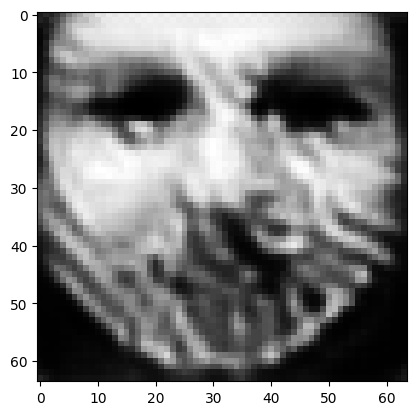

tensor([[1.1793e-05, 1.6840e-06, 1.4477e-04, 5.5126e-06, 9.9014e-01, 3.3146e-06,
         5.5847e-05, 5.4102e-06, 2.1370e-06, 1.0220e-07, 5.3868e-08, 4.4532e-07,
         9.0593e-04, 4.4913e-05, 2.8974e-06, 6.4838e-08, 1.4182e-04, 2.0610e-03,
         1.0966e-06, 1.0344e-05, 3.6891e-05, 1.2130e-06, 2.7867e-04, 2.8393e-07,
         3.3458e-03, 2.4579e-07, 2.2851e-05, 9.5263e-06, 9.0474e-07, 2.8024e-07,
         3.8936e-06, 1.6199e-05, 5.5655e-04, 2.5391e-05, 2.7438e-04, 5.3948e-05,
         2.2433e-04, 9.2517e-06, 1.5787e-03, 1.8547e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009906059131026268
tensor([[1.1778e-05, 1.6818e-06, 1.4462e-04, 5.5050e-06, 9.9016e-01, 3.3090e-06,
         5.5739e-05, 5.4017e-06, 2.1325e-06, 1.0199e-07, 5.3716e-08, 4.4425e-07,
         9.0448e-04, 4.4850e-05, 2.8903e-06, 6.4701e-08, 1.4164e-04, 2.0578e-03,
         1.0950e-06, 1.0327e-05, 3.6825e-05, 1.2111e-06, 2.7828e-04, 2.8344e-07,
         3.3425e-03, 2.4536e-07, 2.2811e-

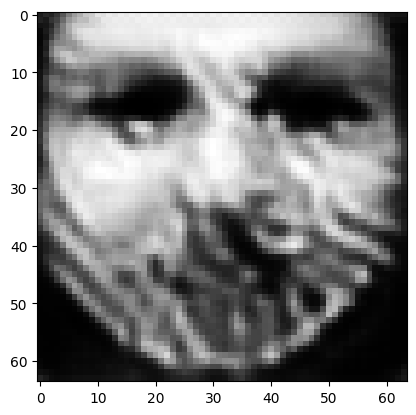

tensor([[1.1731e-05, 1.6732e-06, 1.4403e-04, 5.4760e-06, 9.9020e-01, 3.2894e-06,
         5.5362e-05, 5.3724e-06, 2.1147e-06, 1.0123e-07, 5.3166e-08, 4.4033e-07,
         8.9856e-04, 4.4602e-05, 2.8651e-06, 6.4214e-08, 1.4096e-04, 2.0473e-03,
         1.0889e-06, 1.0268e-05, 3.6580e-05, 1.2040e-06, 2.7661e-04, 2.8184e-07,
         3.3296e-03, 2.4363e-07, 2.2660e-05, 9.4499e-06, 8.9483e-07, 2.7749e-07,
         3.8583e-06, 1.6081e-05, 5.5236e-04, 2.5155e-05, 2.7313e-04, 5.3455e-05,
         2.2252e-04, 9.2030e-06, 1.5689e-03, 1.8410e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009844443760812283
tensor([[1.1717e-05, 1.6714e-06, 1.4384e-04, 5.4698e-06, 9.9022e-01, 3.2824e-06,
         5.5248e-05, 5.3623e-06, 2.1103e-06, 1.0103e-07, 5.3026e-08, 4.3939e-07,
         8.9717e-04, 4.4566e-05, 2.8596e-06, 6.4085e-08, 1.4080e-04, 2.0440e-03,
         1.0875e-06, 1.0248e-05, 3.6523e-05, 1.2025e-06, 2.7646e-04, 2.8141e-07,
         3.3271e-03, 2.4334e-07, 2.2615e-

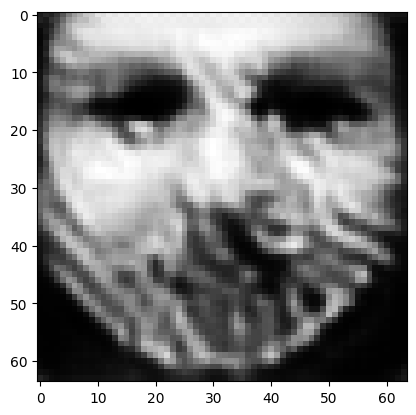

tensor([[1.1674e-05, 1.6634e-06, 1.4337e-04, 5.4426e-06, 9.9026e-01, 3.2659e-06,
         5.4906e-05, 5.3371e-06, 2.0943e-06, 1.0034e-07, 5.2519e-08, 4.3579e-07,
         8.9183e-04, 4.4319e-05, 2.8356e-06, 6.3636e-08, 1.4017e-04, 2.0343e-03,
         1.0818e-06, 1.0196e-05, 3.6299e-05, 1.1959e-06, 2.7476e-04, 2.7990e-07,
         3.3144e-03, 2.4169e-07, 2.2481e-05, 9.3792e-06, 8.8573e-07, 2.7498e-07,
         3.8264e-06, 1.5971e-05, 5.4847e-04, 2.4941e-05, 2.7200e-04, 5.3004e-05,
         2.2091e-04, 9.1587e-06, 1.5598e-03, 1.8284e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00978719163686037
tensor([[1.1661e-05, 1.6618e-06, 1.4317e-04, 5.4371e-06, 9.9027e-01, 3.2593e-06,
         5.4805e-05, 5.3281e-06, 2.0900e-06, 1.0016e-07, 5.2397e-08, 4.3494e-07,
         8.9045e-04, 4.4291e-05, 2.8309e-06, 6.3525e-08, 1.4003e-04, 2.0316e-03,
         1.0805e-06, 1.0177e-05, 3.6248e-05, 1.1944e-06, 2.7466e-04, 2.7956e-07,
         3.3124e-03, 2.4142e-07, 2.2438e-0

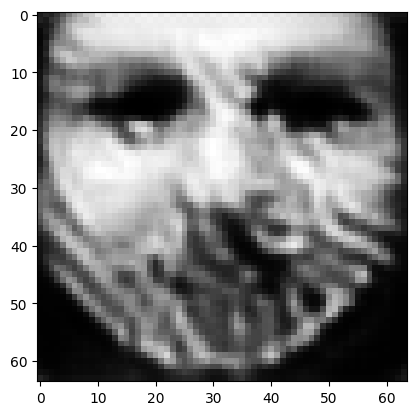

tensor([[1.1620e-05, 1.6542e-06, 1.4273e-04, 5.4116e-06, 9.9031e-01, 3.2438e-06,
         5.4479e-05, 5.3041e-06, 2.0752e-06, 9.9516e-08, 5.1923e-08, 4.3158e-07,
         8.8560e-04, 4.4058e-05, 2.8081e-06, 6.3101e-08, 1.3946e-04, 2.0222e-03,
         1.0752e-06, 1.0129e-05, 3.6041e-05, 1.1882e-06, 2.7311e-04, 2.7810e-07,
         3.3007e-03, 2.3991e-07, 2.2312e-05, 9.3137e-06, 8.7727e-07, 2.7263e-07,
         3.7964e-06, 1.5869e-05, 5.4483e-04, 2.4740e-05, 2.7097e-04, 5.2583e-05,
         2.1946e-04, 9.1173e-06, 1.5510e-03, 1.8166e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00973465945571661
tensor([[1.1607e-05, 1.6527e-06, 1.4256e-04, 5.4062e-06, 9.9032e-01, 3.2377e-06,
         5.4379e-05, 5.2953e-06, 2.0714e-06, 9.9345e-08, 5.1804e-08, 4.3076e-07,
         8.8440e-04, 4.4028e-05, 2.8033e-06, 6.2989e-08, 1.3932e-04, 2.0194e-03,
         1.0739e-06, 1.0112e-05, 3.5992e-05, 1.1868e-06, 2.7300e-04, 2.7772e-07,
         3.2986e-03, 2.3966e-07, 2.2272e-0

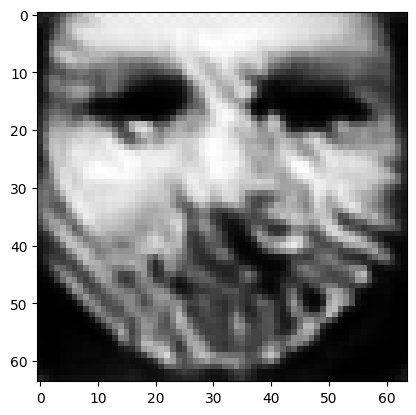

tensor([[1.1567e-05, 1.6457e-06, 1.4211e-04, 5.3827e-06, 9.9036e-01, 3.2216e-06,
         5.4060e-05, 5.2712e-06, 2.0572e-06, 9.8729e-08, 5.1356e-08, 4.2759e-07,
         8.7974e-04, 4.3825e-05, 2.7823e-06, 6.2586e-08, 1.3878e-04, 2.0103e-03,
         1.0689e-06, 1.0062e-05, 3.5798e-05, 1.1810e-06, 2.7168e-04, 2.7634e-07,
         3.2880e-03, 2.3829e-07, 2.2147e-05, 9.2495e-06, 8.6922e-07, 2.7047e-07,
         3.7688e-06, 1.5773e-05, 5.4144e-04, 2.4551e-05, 2.7003e-04, 5.2202e-05,
         2.1817e-04, 9.0805e-06, 1.5426e-03, 1.8054e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009684602729976177
tensor([[1.1557e-05, 1.6439e-06, 1.4200e-04, 5.3771e-06, 9.9037e-01, 3.2179e-06,
         5.3988e-05, 5.2660e-06, 2.0536e-06, 9.8581e-08, 5.1249e-08, 4.2681e-07,
         8.7855e-04, 4.3773e-05, 2.7771e-06, 6.2488e-08, 1.3866e-04, 2.0082e-03,
         1.0677e-06, 1.0051e-05, 3.5751e-05, 1.1795e-06, 2.7133e-04, 2.7601e-07,
         3.2853e-03, 2.3793e-07, 2.2117e-

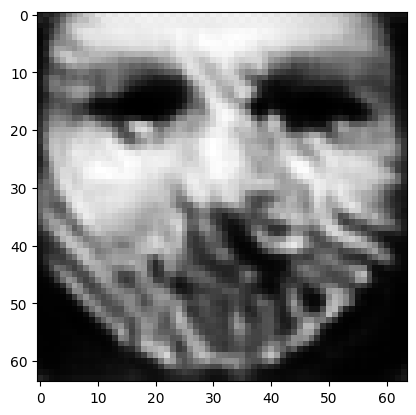

tensor([[1.1516e-05, 1.6374e-06, 1.4155e-04, 5.3561e-06, 9.9041e-01, 3.2013e-06,
         5.3672e-05, 5.2416e-06, 2.0397e-06, 9.7985e-08, 5.0818e-08, 4.2379e-07,
         8.7395e-04, 4.3595e-05, 2.7572e-06, 6.2089e-08, 1.3816e-04, 1.9994e-03,
         1.0630e-06, 1.0000e-05, 3.5568e-05, 1.1741e-06, 2.7025e-04, 2.7468e-07,
         3.2756e-03, 2.3668e-07, 2.1989e-05, 9.1893e-06, 8.6164e-07, 2.6837e-07,
         3.7411e-06, 1.5680e-05, 5.3821e-04, 2.4374e-05, 2.6909e-04, 5.1827e-05,
         2.1693e-04, 9.0442e-06, 1.5345e-03, 1.7947e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009636669419705868
tensor([[1.1506e-05, 1.6357e-06, 1.4147e-04, 5.3508e-06, 9.9042e-01, 3.1978e-06,
         5.3597e-05, 5.2361e-06, 2.0365e-06, 9.7844e-08, 5.0712e-08, 4.2305e-07,
         8.7289e-04, 4.3544e-05, 2.7520e-06, 6.1990e-08, 1.3803e-04, 1.9972e-03,
         1.0618e-06, 9.9893e-06, 3.5522e-05, 1.1728e-06, 2.6992e-04, 2.7433e-07,
         3.2730e-03, 2.3636e-07, 2.1960e-

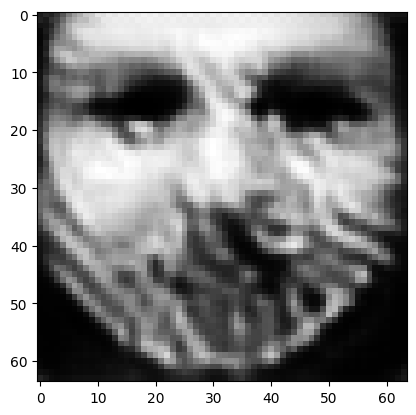

tensor([[1.1469e-05, 1.6294e-06, 1.4106e-04, 5.3309e-06, 9.9045e-01, 3.1828e-06,
         5.3308e-05, 5.2141e-06, 2.0234e-06, 9.7294e-08, 5.0312e-08, 4.2024e-07,
         8.6852e-04, 4.3369e-05, 2.7333e-06, 6.1620e-08, 1.3756e-04, 1.9891e-03,
         1.0575e-06, 9.9432e-06, 3.5351e-05, 1.1677e-06, 2.6883e-04, 2.7309e-07,
         3.2636e-03, 2.3516e-07, 2.1843e-05, 9.1333e-06, 8.5462e-07, 2.6639e-07,
         3.7149e-06, 1.5591e-05, 5.3515e-04, 2.4208e-05, 2.6820e-04, 5.1465e-05,
         2.1573e-04, 9.0096e-06, 1.5273e-03, 1.7848e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009591684676706791
tensor([[1.1460e-05, 1.6281e-06, 1.4092e-04, 5.3265e-06, 9.9046e-01, 3.1783e-06,
         5.3233e-05, 5.2076e-06, 2.0201e-06, 9.7156e-08, 5.0217e-08, 4.1960e-07,
         8.6738e-04, 4.3340e-05, 2.7293e-06, 6.1533e-08, 1.3745e-04, 1.9871e-03,
         1.0565e-06, 9.9296e-06, 3.5312e-05, 1.1665e-06, 2.6868e-04, 2.7282e-07,
         3.2617e-03, 2.3492e-07, 2.1810e-

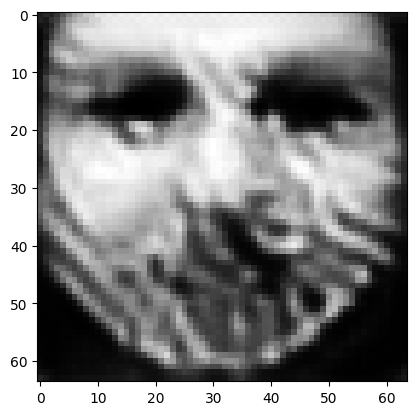

tensor([[1.1425e-05, 1.6225e-06, 1.4051e-04, 5.3084e-06, 9.9050e-01, 3.1636e-06,
         5.2965e-05, 5.1876e-06, 2.0076e-06, 9.6647e-08, 4.9846e-08, 4.1693e-07,
         8.6325e-04, 4.3186e-05, 2.7124e-06, 6.1193e-08, 1.3703e-04, 1.9797e-03,
         1.0525e-06, 9.8845e-06, 3.5151e-05, 1.1617e-06, 2.6770e-04, 2.7170e-07,
         3.2536e-03, 2.3382e-07, 2.1695e-05, 9.0800e-06, 8.4790e-07, 2.6461e-07,
         3.6903e-06, 1.5512e-05, 5.3223e-04, 2.4050e-05, 2.6738e-04, 5.1161e-05,
         2.1474e-04, 8.9781e-06, 1.5193e-03, 1.7746e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009549886919558048
tensor([[1.1417e-05, 1.6210e-06, 1.4042e-04, 5.3038e-06, 9.9050e-01, 3.1605e-06,
         5.2901e-05, 5.1832e-06, 2.0047e-06, 9.6528e-08, 4.9754e-08, 4.1628e-07,
         8.6229e-04, 4.3142e-05, 2.7081e-06, 6.1109e-08, 1.3692e-04, 1.9779e-03,
         1.0515e-06, 9.8747e-06, 3.5111e-05, 1.1606e-06, 2.6741e-04, 2.7142e-07,
         3.2514e-03, 2.3353e-07, 2.1670e-

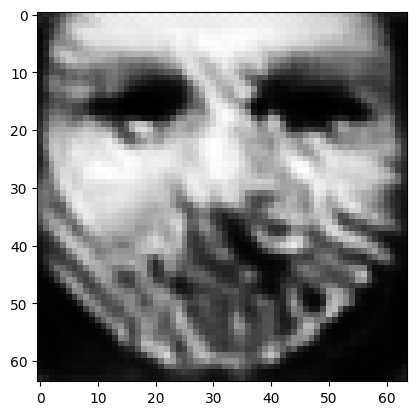

tensor([[1.1385e-05, 1.6158e-06, 1.4002e-04, 5.2870e-06, 9.9053e-01, 3.1463e-06,
         5.2645e-05, 5.1633e-06, 1.9931e-06, 9.6053e-08, 4.9406e-08, 4.1383e-07,
         8.5839e-04, 4.3004e-05, 2.6927e-06, 6.0791e-08, 1.3651e-04, 1.9709e-03,
         1.0479e-06, 9.8315e-06, 3.4964e-05, 1.1562e-06, 2.6653e-04, 2.7038e-07,
         3.2439e-03, 2.3253e-07, 2.1562e-05, 9.0317e-06, 8.4171e-07, 2.6294e-07,
         3.6673e-06, 1.5434e-05, 5.2947e-04, 2.3905e-05, 2.6662e-04, 5.0862e-05,
         2.1375e-04, 8.9473e-06, 1.5122e-03, 1.7653e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009510566480457783
tensor([[1.1378e-05, 1.6145e-06, 1.3993e-04, 5.2826e-06, 9.9054e-01, 3.1434e-06,
         5.2590e-05, 5.1595e-06, 1.9902e-06, 9.5941e-08, 4.9325e-08, 4.1323e-07,
         8.5744e-04, 4.2964e-05, 2.6889e-06, 6.0718e-08, 1.3642e-04, 1.9694e-03,
         1.0470e-06, 9.8224e-06, 3.4927e-05, 1.1550e-06, 2.6625e-04, 2.7014e-07,
         3.2419e-03, 2.3225e-07, 2.1538e-

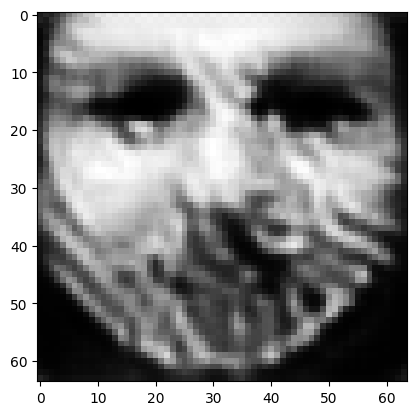

tensor([[1.1347e-05, 1.6095e-06, 1.3958e-04, 5.2667e-06, 9.9057e-01, 3.1307e-06,
         5.2351e-05, 5.1423e-06, 1.9794e-06, 9.5492e-08, 4.8999e-08, 4.1086e-07,
         8.5389e-04, 4.2825e-05, 2.6739e-06, 6.0414e-08, 1.3606e-04, 1.9627e-03,
         1.0435e-06, 9.7836e-06, 3.4784e-05, 1.1508e-06, 2.6535e-04, 2.6914e-07,
         3.2345e-03, 2.3129e-07, 2.1435e-05, 8.9878e-06, 8.3602e-07, 2.6135e-07,
         3.6455e-06, 1.5358e-05, 5.2682e-04, 2.3768e-05, 2.6587e-04, 5.0562e-05,
         2.1277e-04, 8.9164e-06, 1.5057e-03, 1.7567e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009473725222051144
tensor([[1.1339e-05, 1.6084e-06, 1.3947e-04, 5.2632e-06, 9.9058e-01, 3.1267e-06,
         5.2285e-05, 5.1369e-06, 1.9767e-06, 9.5379e-08, 4.8919e-08, 4.1030e-07,
         8.5303e-04, 4.2801e-05, 2.6705e-06, 6.0337e-08, 1.3596e-04, 1.9609e-03,
         1.0427e-06, 9.7722e-06, 3.4752e-05, 1.1499e-06, 2.6524e-04, 2.6890e-07,
         3.2330e-03, 2.3111e-07, 2.1407e-

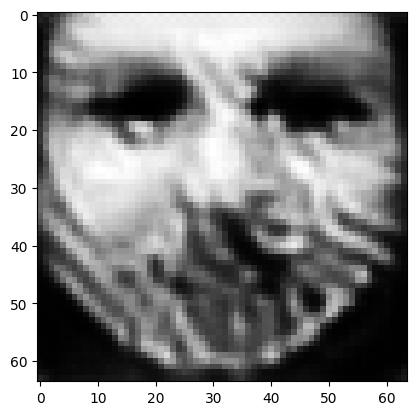

tensor([[1.1310e-05, 1.6038e-06, 1.3912e-04, 5.2485e-06, 9.9061e-01, 3.1146e-06,
         5.2061e-05, 5.1206e-06, 1.9665e-06, 9.4959e-08, 4.8618e-08, 4.0812e-07,
         8.4966e-04, 4.2675e-05, 2.6568e-06, 6.0053e-08, 1.3562e-04, 1.9546e-03,
         1.0395e-06, 9.7353e-06, 3.4621e-05, 1.1460e-06, 2.6444e-04, 2.6800e-07,
         3.2262e-03, 2.3024e-07, 2.1309e-05, 8.9444e-06, 8.3055e-07, 2.5992e-07,
         3.6258e-06, 1.5291e-05, 5.2435e-04, 2.3641e-05, 2.6522e-04, 5.0311e-05,
         2.1198e-04, 8.8902e-06, 1.4993e-03, 1.7481e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009438770823180676
tensor([[1.1303e-05, 1.6026e-06, 1.3905e-04, 5.2448e-06, 9.9061e-01, 3.1119e-06,
         5.2007e-05, 5.1168e-06, 1.9641e-06, 9.4859e-08, 4.8544e-08, 4.0758e-07,
         8.4888e-04, 4.2640e-05, 2.6533e-06, 5.9983e-08, 1.3554e-04, 1.9531e-03,
         1.0387e-06, 9.7271e-06, 3.4589e-05, 1.1450e-06, 2.6422e-04, 2.6776e-07,
         3.2245e-03, 2.3002e-07, 2.1286e-

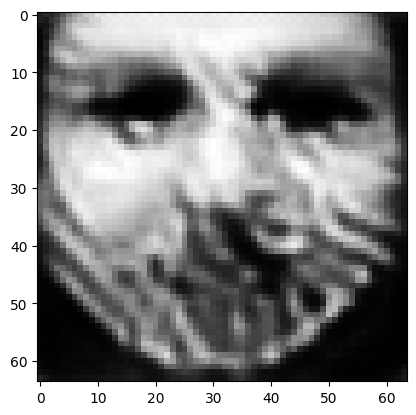

tensor([[1.1275e-05, 1.5983e-06, 1.3871e-04, 5.2313e-06, 9.9064e-01, 3.0999e-06,
         5.1790e-05, 5.1008e-06, 1.9543e-06, 9.4458e-08, 4.8260e-08, 4.0551e-07,
         8.4571e-04, 4.2528e-05, 2.6404e-06, 5.9714e-08, 1.3523e-04, 1.9470e-03,
         1.0357e-06, 9.6907e-06, 3.4466e-05, 1.1413e-06, 2.6354e-04, 2.6691e-07,
         3.2183e-03, 2.2923e-07, 2.1191e-05, 8.9044e-06, 8.2546e-07, 2.5855e-07,
         3.6072e-06, 1.5226e-05, 5.2202e-04, 2.3520e-05, 2.6460e-04, 5.0063e-05,
         2.1120e-04, 8.8647e-06, 1.4934e-03, 1.7403e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009406177327036858
tensor([[1.1268e-05, 1.5972e-06, 1.3864e-04, 5.2278e-06, 9.9064e-01, 3.0973e-06,
         5.1739e-05, 5.0972e-06, 1.9521e-06, 9.4364e-08, 4.8190e-08, 4.0500e-07,
         8.4498e-04, 4.2495e-05, 2.6371e-06, 5.9647e-08, 1.3515e-04, 1.9455e-03,
         1.0349e-06, 9.6830e-06, 3.4435e-05, 1.1404e-06, 2.6333e-04, 2.6669e-07,
         3.2166e-03, 2.2902e-07, 2.1170e-

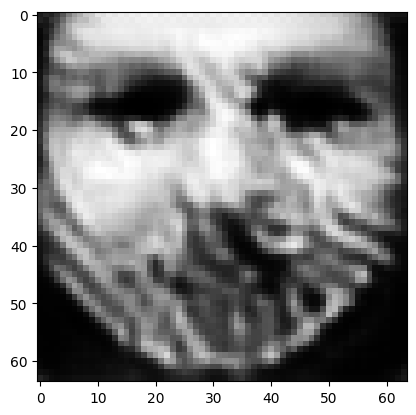

tensor([[1.1243e-05, 1.5931e-06, 1.3833e-04, 5.2147e-06, 9.9067e-01, 3.0866e-06,
         5.1541e-05, 5.0828e-06, 1.9430e-06, 9.3993e-08, 4.7925e-08, 4.0308e-07,
         8.4196e-04, 4.2382e-05, 2.6250e-06, 5.9397e-08, 1.3485e-04, 1.9400e-03,
         1.0321e-06, 9.6503e-06, 3.4319e-05, 1.1370e-06, 2.6262e-04, 2.6590e-07,
         3.2106e-03, 2.2826e-07, 2.1082e-05, 8.8674e-06, 8.2072e-07, 2.5725e-07,
         3.5895e-06, 1.5165e-05, 5.1981e-04, 2.3408e-05, 2.6399e-04, 4.9824e-05,
         2.1043e-04, 8.8401e-06, 1.4879e-03, 1.7330e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009375355206429958
tensor([[1.1236e-05, 1.5921e-06, 1.3826e-04, 5.2116e-06, 9.9067e-01, 3.0837e-06,
         5.1489e-05, 5.0790e-06, 1.9408e-06, 9.3898e-08, 4.7858e-08, 4.0258e-07,
         8.4124e-04, 4.2357e-05, 2.6220e-06, 5.9333e-08, 1.3477e-04, 1.9385e-03,
         1.0314e-06, 9.6417e-06, 3.4289e-05, 1.1361e-06, 2.6247e-04, 2.6569e-07,
         3.2092e-03, 2.2808e-07, 2.1060e-

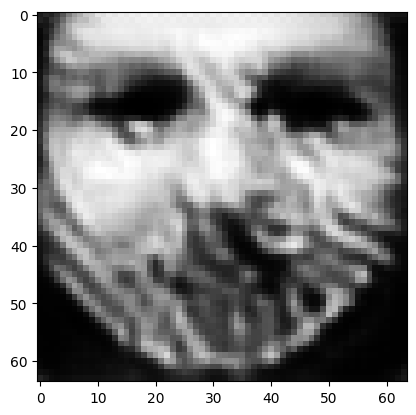

tensor([[1.1213e-05, 1.5883e-06, 1.3797e-04, 5.1995e-06, 9.9070e-01, 3.0738e-06,
         5.1303e-05, 5.0654e-06, 1.9326e-06, 9.3554e-08, 4.7610e-08, 4.0080e-07,
         8.3847e-04, 4.2249e-05, 2.6107e-06, 5.9098e-08, 1.3449e-04, 1.9333e-03,
         1.0287e-06, 9.6115e-06, 3.4181e-05, 1.1329e-06, 2.6181e-04, 2.6493e-07,
         3.2035e-03, 2.2736e-07, 2.0980e-05, 8.8322e-06, 8.1626e-07, 2.5605e-07,
         3.5730e-06, 1.5109e-05, 5.1777e-04, 2.3302e-05, 2.6344e-04, 4.9607e-05,
         2.0972e-04, 8.8175e-06, 1.4828e-03, 1.7261e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009346656501293182
tensor([[1.1208e-05, 1.5873e-06, 1.3790e-04, 5.1965e-06, 9.9070e-01, 3.0717e-06,
         5.1262e-05, 5.0625e-06, 1.9305e-06, 9.3471e-08, 4.7552e-08, 4.0036e-07,
         8.3779e-04, 4.2221e-05, 2.6080e-06, 5.9043e-08, 1.3442e-04, 1.9322e-03,
         1.0281e-06, 9.6047e-06, 3.4155e-05, 1.1321e-06, 2.6162e-04, 2.6476e-07,
         3.2021e-03, 2.2717e-07, 2.0961e-

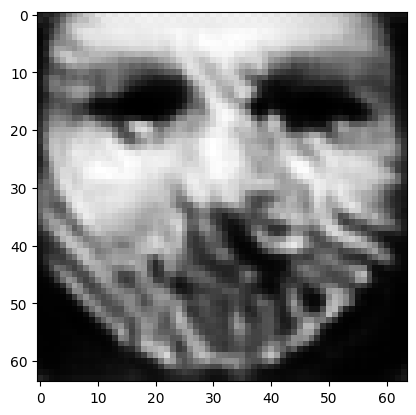

tensor([[1.1185e-05, 1.5837e-06, 1.3763e-04, 5.1852e-06, 9.9072e-01, 3.0620e-06,
         5.1084e-05, 5.0491e-06, 1.9228e-06, 9.3142e-08, 4.7318e-08, 3.9868e-07,
         8.3522e-04, 4.2124e-05, 2.5974e-06, 5.8818e-08, 1.3415e-04, 1.9272e-03,
         1.0256e-06, 9.5755e-06, 3.4053e-05, 1.1291e-06, 2.6105e-04, 2.6402e-07,
         3.1967e-03, 2.2650e-07, 2.0885e-05, 8.7993e-06, 8.1208e-07, 2.5492e-07,
         3.5575e-06, 1.5056e-05, 5.1586e-04, 2.3202e-05, 2.6293e-04, 4.9403e-05,
         2.0905e-04, 8.7962e-06, 1.4779e-03, 1.7197e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009319611825048923
tensor([[1.1180e-05, 1.5828e-06, 1.3756e-04, 5.1824e-06, 9.9073e-01, 3.0599e-06,
         5.1047e-05, 5.0464e-06, 1.9208e-06, 9.3066e-08, 4.7264e-08, 3.9827e-07,
         8.3456e-04, 4.2099e-05, 2.5949e-06, 5.8769e-08, 1.3409e-04, 1.9262e-03,
         1.0250e-06, 9.5690e-06, 3.4029e-05, 1.1283e-06, 2.6088e-04, 2.6387e-07,
         3.1954e-03, 2.2632e-07, 2.0868e-

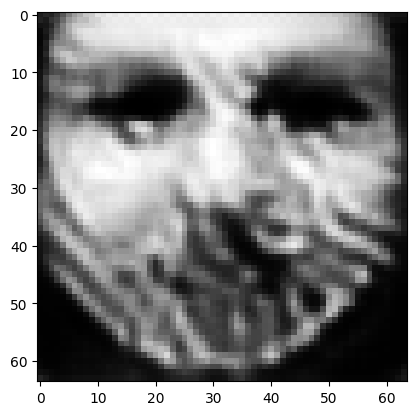

tensor([[1.1159e-05, 1.5794e-06, 1.3731e-04, 5.1716e-06, 9.9075e-01, 3.0514e-06,
         5.0885e-05, 5.0344e-06, 1.9137e-06, 9.2764e-08, 4.7048e-08, 3.9672e-07,
         8.3213e-04, 4.2001e-05, 2.5851e-06, 5.8562e-08, 1.3384e-04, 1.9217e-03,
         1.0226e-06, 9.5431e-06, 3.3934e-05, 1.1255e-06, 2.6028e-04, 2.6320e-07,
         3.1902e-03, 2.2568e-07, 2.0798e-05, 8.7691e-06, 8.0820e-07, 2.5384e-07,
         3.5426e-06, 1.5006e-05, 5.1405e-04, 2.3107e-05, 2.6243e-04, 4.9211e-05,
         2.0840e-04, 8.7753e-06, 1.4734e-03, 1.7137e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009294101037085056
tensor([[1.1153e-05, 1.5787e-06, 1.3723e-04, 5.1693e-06, 9.9075e-01, 3.0482e-06,
         5.0837e-05, 5.0302e-06, 1.9118e-06, 9.2682e-08, 4.6993e-08, 3.9634e-07,
         8.3153e-04, 4.1990e-05, 2.5829e-06, 5.8507e-08, 1.3378e-04, 1.9203e-03,
         1.0221e-06, 9.5342e-06, 3.3913e-05, 1.1249e-06, 2.6026e-04, 2.6303e-07,
         3.1892e-03, 2.2557e-07, 2.0777e-

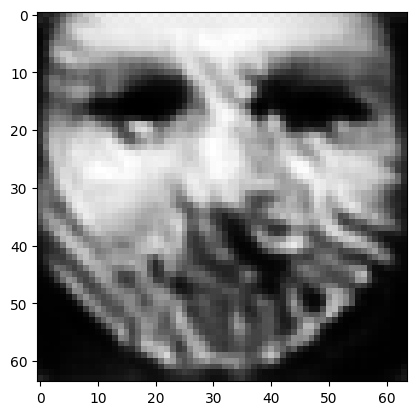

tensor([[1.1134e-05, 1.5754e-06, 1.3701e-04, 5.1588e-06, 9.9077e-01, 3.0409e-06,
         5.0690e-05, 5.0200e-06, 1.9052e-06, 9.2399e-08, 4.6791e-08, 3.9487e-07,
         8.2927e-04, 4.1890e-05, 2.5733e-06, 5.8314e-08, 1.3354e-04, 1.9162e-03,
         1.0198e-06, 9.5114e-06, 3.3821e-05, 1.1221e-06, 2.5961e-04, 2.6240e-07,
         3.1841e-03, 2.2493e-07, 2.0714e-05, 8.7399e-06, 8.0449e-07, 2.5284e-07,
         3.5290e-06, 1.4959e-05, 5.1237e-04, 2.3019e-05, 2.6197e-04, 4.9031e-05,
         2.0780e-04, 8.7562e-06, 1.4692e-03, 1.7081e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009270125068724155
tensor([[1.1129e-05, 1.5746e-06, 1.3694e-04, 5.1566e-06, 9.9078e-01, 3.0384e-06,
         5.0649e-05, 5.0164e-06, 1.9035e-06, 9.2328e-08, 4.6740e-08, 3.9452e-07,
         8.2872e-04, 4.1874e-05, 2.5712e-06, 5.8264e-08, 1.3348e-04, 1.9150e-03,
         1.0193e-06, 9.5042e-06, 3.3801e-05, 1.1216e-06, 2.5954e-04, 2.6224e-07,
         3.1831e-03, 2.2481e-07, 2.0697e-

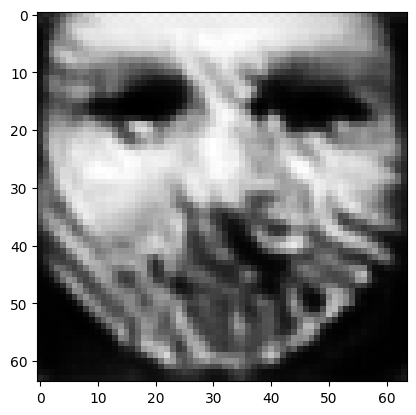

tensor([[1.1110e-05, 1.5716e-06, 1.3672e-04, 5.1471e-06, 9.9079e-01, 3.0306e-06,
         5.0504e-05, 5.0057e-06, 1.8971e-06, 9.2058e-08, 4.6545e-08, 3.9312e-07,
         8.2662e-04, 4.1788e-05, 2.5623e-06, 5.8079e-08, 1.3326e-04, 1.9109e-03,
         1.0172e-06, 9.4806e-06, 3.3717e-05, 1.1190e-06, 2.5903e-04, 2.6163e-07,
         3.1785e-03, 2.2425e-07, 2.0634e-05, 8.7120e-06, 8.0098e-07, 2.5189e-07,
         3.5164e-06, 1.4916e-05, 5.1077e-04, 2.2936e-05, 2.6157e-04, 4.8868e-05,
         2.0726e-04, 8.7387e-06, 1.4651e-03, 1.7027e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00924768391996622
tensor([[1.1106e-05, 1.5709e-06, 1.3667e-04, 5.1448e-06, 9.9080e-01, 3.0289e-06,
         5.0472e-05, 5.0034e-06, 1.8955e-06, 9.1994e-08, 4.6500e-08, 3.9278e-07,
         8.2608e-04, 4.1766e-05, 2.5601e-06, 5.8037e-08, 1.3320e-04, 1.9100e-03,
         1.0167e-06, 9.4752e-06, 3.3696e-05, 1.1184e-06, 2.5888e-04, 2.6150e-07,
         3.1773e-03, 2.2410e-07, 2.0619e-0

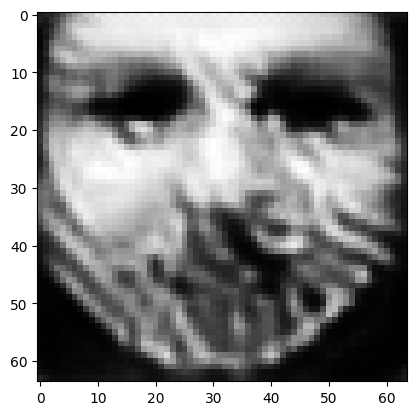

tensor([[1.1087e-05, 1.5680e-06, 1.3646e-04, 5.1357e-06, 9.9082e-01, 3.0212e-06,
         5.0331e-05, 4.9930e-06, 1.8893e-06, 9.1730e-08, 4.6314e-08, 3.9143e-07,
         8.2407e-04, 4.1688e-05, 2.5515e-06, 5.7858e-08, 1.3300e-04, 1.9060e-03,
         1.0147e-06, 9.4517e-06, 3.3615e-05, 1.1159e-06, 2.5843e-04, 2.6091e-07,
         3.1730e-03, 2.2357e-07, 2.0558e-05, 8.6863e-06, 7.9768e-07, 2.5097e-07,
         3.5041e-06, 1.4873e-05, 5.0922e-04, 2.2856e-05, 2.6116e-04, 4.8701e-05,
         2.0672e-04, 8.7213e-06, 1.4612e-03, 1.6977e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009226187132298946
tensor([[1.1082e-05, 1.5672e-06, 1.3642e-04, 5.1334e-06, 9.9082e-01, 3.0196e-06,
         5.0297e-05, 4.9907e-06, 1.8879e-06, 9.1668e-08, 4.6268e-08, 3.9110e-07,
         8.2360e-04, 4.1665e-05, 2.5493e-06, 5.7814e-08, 1.3294e-04, 1.9050e-03,
         1.0142e-06, 9.4468e-06, 3.3595e-05, 1.1153e-06, 2.5828e-04, 2.6075e-07,
         3.1719e-03, 2.2343e-07, 2.0545e-

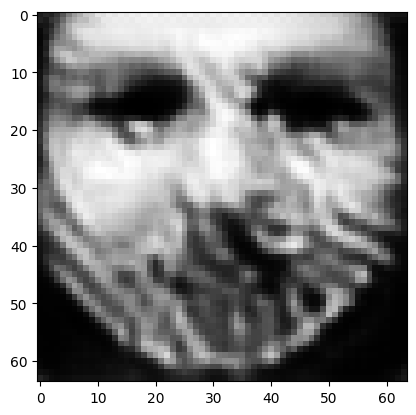

tensor([[1.1065e-05, 1.5645e-06, 1.3621e-04, 5.1249e-06, 9.9084e-01, 3.0120e-06,
         5.0165e-05, 4.9805e-06, 1.8820e-06, 9.1422e-08, 4.6096e-08, 3.8986e-07,
         8.2165e-04, 4.1597e-05, 2.5416e-06, 5.7648e-08, 1.3275e-04, 1.9013e-03,
         1.0123e-06, 9.4240e-06, 3.3521e-05, 1.1130e-06, 2.5789e-04, 2.6023e-07,
         3.1680e-03, 2.2294e-07, 2.0486e-05, 8.6616e-06, 7.9455e-07, 2.5012e-07,
         3.4926e-06, 1.4833e-05, 5.0777e-04, 2.2780e-05, 2.6078e-04, 4.8551e-05,
         2.0623e-04, 8.7056e-06, 1.4576e-03, 1.6929e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00920598953962326
tensor([[1.1061e-05, 1.5638e-06, 1.3617e-04, 5.1227e-06, 9.9084e-01, 3.0105e-06,
         5.0132e-05, 4.9783e-06, 1.8807e-06, 9.1363e-08, 4.6053e-08, 3.8955e-07,
         8.2122e-04, 4.1575e-05, 2.5394e-06, 5.7606e-08, 1.3270e-04, 1.9003e-03,
         1.0118e-06, 9.4193e-06, 3.3502e-05, 1.1125e-06, 2.5776e-04, 2.6008e-07,
         3.1668e-03, 2.2281e-07, 2.0473e-0

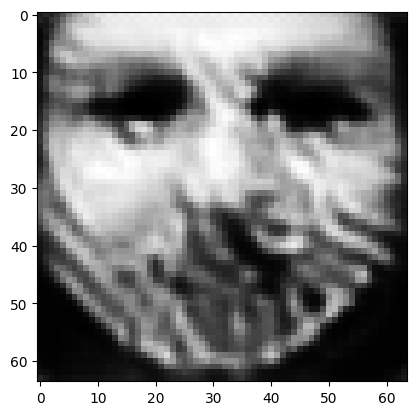

tensor([[1.1044e-05, 1.5612e-06, 1.3599e-04, 5.1147e-06, 9.9086e-01, 3.0035e-06,
         5.0006e-05, 4.9689e-06, 1.8752e-06, 9.1127e-08, 4.5888e-08, 3.8836e-07,
         8.1945e-04, 4.1508e-05, 2.5319e-06, 5.7446e-08, 1.3252e-04, 1.8968e-03,
         1.0101e-06, 9.3985e-06, 3.3431e-05, 1.1103e-06, 2.5736e-04, 2.5955e-07,
         3.1629e-03, 2.2234e-07, 2.0419e-05, 8.6384e-06, 7.9162e-07, 2.4930e-07,
         3.4821e-06, 1.4794e-05, 5.0640e-04, 2.2711e-05, 2.6043e-04, 4.8400e-05,
         2.0576e-04, 8.6904e-06, 1.4544e-03, 1.6885e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009186618030071259
tensor([[1.1040e-05, 1.5606e-06, 1.3595e-04, 5.1127e-06, 9.9086e-01, 3.0020e-06,
         4.9978e-05, 4.9669e-06, 1.8738e-06, 9.1071e-08, 4.5849e-08, 3.8807e-07,
         8.1901e-04, 4.1490e-05, 2.5301e-06, 5.7409e-08, 1.3247e-04, 1.8960e-03,
         1.0096e-06, 9.3938e-06, 3.3414e-05, 1.1098e-06, 2.5724e-04, 2.5943e-07,
         3.1619e-03, 2.2221e-07, 2.0407e-

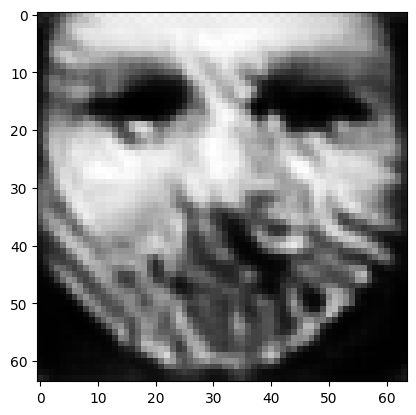

tensor([[1.1024e-05, 1.5582e-06, 1.3577e-04, 5.1051e-06, 9.9087e-01, 2.9950e-06,
         4.9854e-05, 4.9573e-06, 1.8687e-06, 9.0847e-08, 4.5692e-08, 3.8695e-07,
         8.1734e-04, 4.1430e-05, 2.5231e-06, 5.7256e-08, 1.3229e-04, 1.8925e-03,
         1.0080e-06, 9.3733e-06, 3.3347e-05, 1.1078e-06, 2.5690e-04, 2.5892e-07,
         3.1582e-03, 2.2179e-07, 2.0354e-05, 8.6157e-06, 7.8882e-07, 2.4856e-07,
         3.4721e-06, 1.4759e-05, 5.0511e-04, 2.2644e-05, 2.6010e-04, 4.8267e-05,
         2.0534e-04, 8.6767e-06, 1.4511e-03, 1.6842e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009168310090899467
tensor([[1.1021e-05, 1.5576e-06, 1.3573e-04, 5.1032e-06, 9.9088e-01, 2.9936e-06,
         4.9827e-05, 4.9554e-06, 1.8674e-06, 9.0794e-08, 4.5654e-08, 3.8667e-07,
         8.1693e-04, 4.1412e-05, 2.5213e-06, 5.7220e-08, 1.3225e-04, 1.8917e-03,
         1.0076e-06, 9.3689e-06, 3.3330e-05, 1.1073e-06, 2.5679e-04, 2.5880e-07,
         3.1572e-03, 2.2166e-07, 2.0343e-

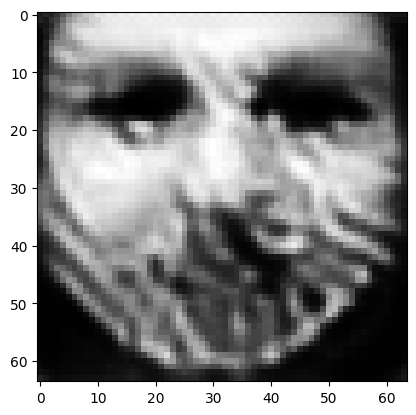

tensor([[1.1006e-05, 1.5553e-06, 1.3557e-04, 5.0959e-06, 9.9089e-01, 2.9875e-06,
         4.9714e-05, 4.9471e-06, 1.8625e-06, 9.0587e-08, 4.5506e-08, 3.8560e-07,
         8.1537e-04, 4.1349e-05, 2.5145e-06, 5.7077e-08, 1.3208e-04, 1.8885e-03,
         1.0059e-06, 9.3507e-06, 3.3266e-05, 1.1054e-06, 2.5641e-04, 2.5832e-07,
         3.1536e-03, 2.2124e-07, 2.0295e-05, 8.5950e-06, 7.8622e-07, 2.4783e-07,
         3.4626e-06, 1.4724e-05, 5.0388e-04, 2.2582e-05, 2.5978e-04, 4.8131e-05,
         2.0490e-04, 8.6627e-06, 1.4482e-03, 1.6802e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009151182137429714
tensor([[1.1002e-05, 1.5548e-06, 1.3552e-04, 5.0942e-06, 9.9089e-01, 2.9856e-06,
         4.9684e-05, 4.9445e-06, 1.8612e-06, 9.0532e-08, 4.5469e-08, 3.8534e-07,
         8.1496e-04, 4.1339e-05, 2.5130e-06, 5.7042e-08, 1.3204e-04, 1.8877e-03,
         1.0056e-06, 9.3453e-06, 3.3251e-05, 1.1049e-06, 2.5636e-04, 2.5821e-07,
         3.1528e-03, 2.2115e-07, 2.0282e-

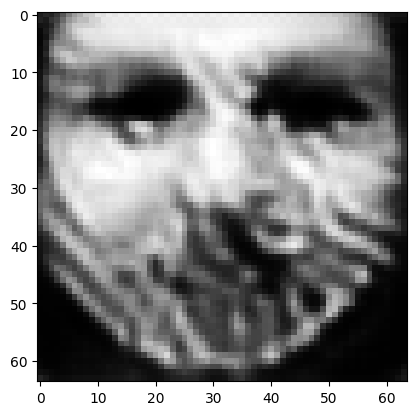

tensor([[1.0987e-05, 1.5526e-06, 1.3537e-04, 5.0874e-06, 9.9091e-01, 2.9797e-06,
         4.9576e-05, 4.9365e-06, 1.8566e-06, 9.0335e-08, 4.5328e-08, 3.8432e-07,
         8.1349e-04, 4.1279e-05, 2.5065e-06, 5.6906e-08, 1.3187e-04, 1.8846e-03,
         1.0041e-06, 9.3281e-06, 3.3189e-05, 1.1031e-06, 2.5600e-04, 2.5775e-07,
         3.1494e-03, 2.2074e-07, 2.0237e-05, 8.5742e-06, 7.8370e-07, 2.4717e-07,
         3.4538e-06, 1.4692e-05, 5.0274e-04, 2.2523e-05, 2.5949e-04, 4.8011e-05,
         2.0452e-04, 8.6504e-06, 1.4454e-03, 1.6764e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009134644642472267
tensor([[1.0984e-05, 1.5520e-06, 1.3534e-04, 5.0857e-06, 9.9091e-01, 2.9784e-06,
         4.9552e-05, 4.9347e-06, 1.8555e-06, 9.0287e-08, 4.5293e-08, 3.8406e-07,
         8.1312e-04, 4.1263e-05, 2.5049e-06, 5.6874e-08, 1.3184e-04, 1.8839e-03,
         1.0037e-06, 9.3242e-06, 3.3174e-05, 1.1026e-06, 2.5590e-04, 2.5764e-07,
         3.1485e-03, 2.2063e-07, 2.0226e-

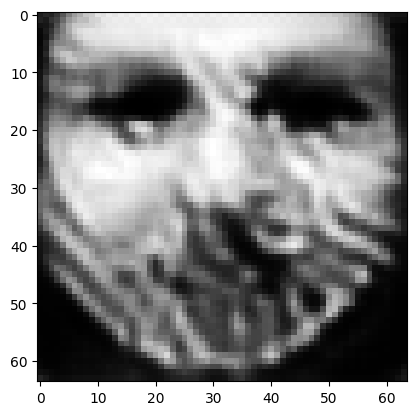

tensor([[1.0971e-05, 1.5500e-06, 1.3519e-04, 5.0791e-06, 9.9092e-01, 2.9729e-06,
         4.9450e-05, 4.9272e-06, 1.8511e-06, 9.0098e-08, 4.5160e-08, 3.8310e-07,
         8.1171e-04, 4.1207e-05, 2.4989e-06, 5.6746e-08, 1.3168e-04, 1.8810e-03,
         1.0023e-06, 9.3080e-06, 3.3116e-05, 1.1009e-06, 2.5556e-04, 2.5722e-07,
         3.1452e-03, 2.2024e-07, 2.0183e-05, 8.5552e-06, 7.8135e-07, 2.4652e-07,
         3.4452e-06, 1.4660e-05, 5.0165e-04, 2.2466e-05, 2.5921e-04, 4.7889e-05,
         2.0413e-04, 8.6378e-06, 1.4428e-03, 1.6728e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009119288064539433
tensor([[1.0967e-05, 1.5495e-06, 1.3515e-04, 5.0776e-06, 9.9093e-01, 2.9711e-06,
         4.9421e-05, 4.9248e-06, 1.8500e-06, 9.0050e-08, 4.5126e-08, 3.8286e-07,
         8.1137e-04, 4.1197e-05, 2.4974e-06, 5.6712e-08, 1.3164e-04, 1.8802e-03,
         1.0019e-06, 9.3032e-06, 3.3103e-05, 1.1006e-06, 2.5552e-04, 2.5711e-07,
         3.1445e-03, 2.2017e-07, 2.0172e-

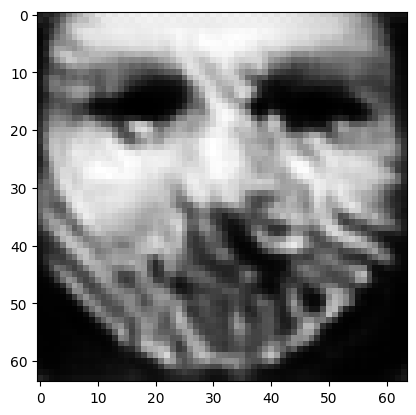

tensor([[1.0954e-05, 1.5476e-06, 1.3501e-04, 5.0715e-06, 9.9094e-01, 2.9659e-06,
         4.9326e-05, 4.9178e-06, 1.8459e-06, 8.9872e-08, 4.5001e-08, 3.8196e-07,
         8.1004e-04, 4.1144e-05, 2.4917e-06, 5.6592e-08, 1.3150e-04, 1.8774e-03,
         1.0006e-06, 9.2880e-06, 3.3048e-05, 1.0989e-06, 2.5519e-04, 2.5671e-07,
         3.1413e-03, 2.1980e-07, 2.0131e-05, 8.5366e-06, 7.7909e-07, 2.4593e-07,
         3.4373e-06, 1.4632e-05, 5.0063e-04, 2.2413e-05, 2.5895e-04, 4.7780e-05,
         2.0378e-04, 8.6266e-06, 1.4403e-03, 1.6693e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009104521945118904
tensor([[1.0951e-05, 1.5471e-06, 1.3499e-04, 5.0699e-06, 9.9094e-01, 2.9648e-06,
         4.9303e-05, 4.9161e-06, 1.8449e-06, 8.9831e-08, 4.4969e-08, 3.8173e-07,
         8.0974e-04, 4.1129e-05, 2.4903e-06, 5.6562e-08, 1.3146e-04, 1.8767e-03,
         1.0003e-06, 9.2847e-06, 3.3034e-05, 1.0986e-06, 2.5510e-04, 2.5660e-07,
         3.1405e-03, 2.1970e-07, 2.0122e-

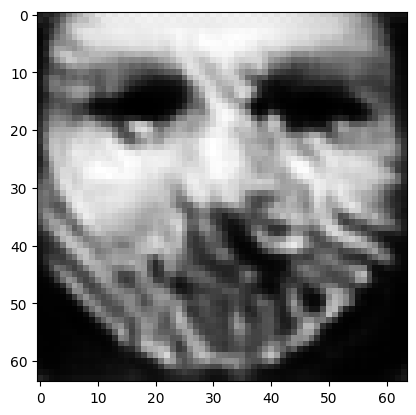

tensor([[1.0940e-05, 1.5453e-06, 1.3486e-04, 5.0641e-06, 9.9095e-01, 2.9599e-06,
         4.9213e-05, 4.9095e-06, 1.8410e-06, 8.9664e-08, 4.4852e-08, 3.8088e-07,
         8.0849e-04, 4.1079e-05, 2.4849e-06, 5.6449e-08, 1.3132e-04, 1.8742e-03,
         9.9900e-07, 9.2706e-06, 3.2982e-05, 1.0970e-06, 2.5479e-04, 2.5623e-07,
         3.1375e-03, 2.1936e-07, 2.0084e-05, 8.5199e-06, 7.7701e-07, 2.4536e-07,
         3.4298e-06, 1.4604e-05, 4.9966e-04, 2.2364e-05, 2.5870e-04, 4.7672e-05,
         2.0342e-04, 8.6152e-06, 1.4381e-03, 1.6662e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00909070111811161
tensor([[1.0937e-05, 1.5449e-06, 1.3482e-04, 5.0628e-06, 9.9095e-01, 2.9584e-06,
         4.9189e-05, 4.9075e-06, 1.8400e-06, 8.9621e-08, 4.4823e-08, 3.8068e-07,
         8.0817e-04, 4.1071e-05, 2.4838e-06, 5.6421e-08, 1.3129e-04, 1.8735e-03,
         9.9872e-07, 9.2663e-06, 3.2971e-05, 1.0967e-06, 2.5475e-04, 2.5614e-07,
         3.1369e-03, 2.1929e-07, 2.0074e-0

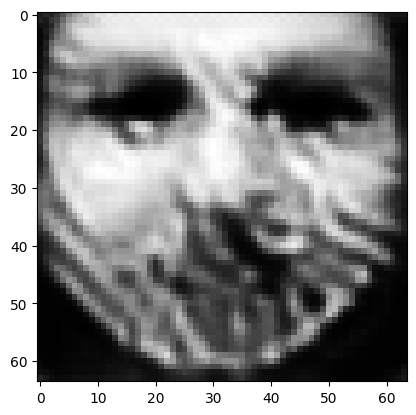

tensor([[1.0926e-05, 1.5431e-06, 1.3469e-04, 5.0573e-06, 9.9096e-01, 2.9538e-06,
         4.9104e-05, 4.9013e-06, 1.8364e-06, 8.9463e-08, 4.4712e-08, 3.7988e-07,
         8.0698e-04, 4.1024e-05, 2.4788e-06, 5.6315e-08, 1.3115e-04, 1.8712e-03,
         9.9753e-07, 9.2528e-06, 3.2922e-05, 1.0953e-06, 2.5446e-04, 2.5579e-07,
         3.1341e-03, 2.1895e-07, 2.0038e-05, 8.5034e-06, 7.7500e-07, 2.4483e-07,
         3.4227e-06, 1.4578e-05, 4.9874e-04, 2.2316e-05, 2.5847e-04, 4.7577e-05,
         2.0312e-04, 8.6051e-06, 1.4358e-03, 1.6630e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009077469818294048
tensor([[1.0923e-05, 1.5427e-06, 1.3467e-04, 5.0559e-06, 9.9097e-01, 2.9528e-06,
         4.9083e-05, 4.8998e-06, 1.8355e-06, 8.9426e-08, 4.4684e-08, 3.7968e-07,
         8.0673e-04, 4.1010e-05, 2.4774e-06, 5.6288e-08, 1.3112e-04, 1.8705e-03,
         9.9722e-07, 9.2499e-06, 3.2910e-05, 1.0949e-06, 2.5437e-04, 2.5569e-07,
         3.1333e-03, 2.1887e-07, 2.0030e-

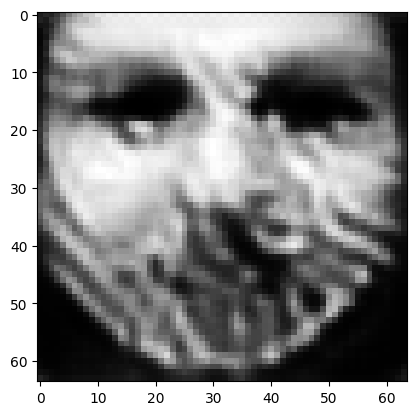

tensor([[1.0912e-05, 1.5411e-06, 1.3456e-04, 5.0507e-06, 9.9098e-01, 2.9484e-06,
         4.9002e-05, 4.8938e-06, 1.8321e-06, 8.9277e-08, 4.4579e-08, 3.7892e-07,
         8.0561e-04, 4.0966e-05, 2.4727e-06, 5.6188e-08, 1.3100e-04, 1.8682e-03,
         9.9610e-07, 9.2370e-06, 3.2864e-05, 1.0936e-06, 2.5410e-04, 2.5535e-07,
         3.1306e-03, 2.1856e-07, 1.9996e-05, 8.4884e-06, 7.7314e-07, 2.4432e-07,
         3.4161e-06, 1.4553e-05, 4.9787e-04, 2.2272e-05, 2.5825e-04, 4.7480e-05,
         2.0280e-04, 8.5949e-06, 1.4339e-03, 1.6603e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00906506646424532
tensor([[1.0909e-05, 1.5407e-06, 1.3452e-04, 5.0495e-06, 9.9098e-01, 2.9471e-06,
         4.8981e-05, 4.8920e-06, 1.8312e-06, 8.9238e-08, 4.4553e-08, 3.7874e-07,
         8.0532e-04, 4.0959e-05, 2.4717e-06, 5.6163e-08, 1.3097e-04, 1.8676e-03,
         9.9584e-07, 9.2332e-06, 3.2853e-05, 1.0932e-06, 2.5407e-04, 2.5527e-07,
         3.1301e-03, 2.1850e-07, 1.9987e-0

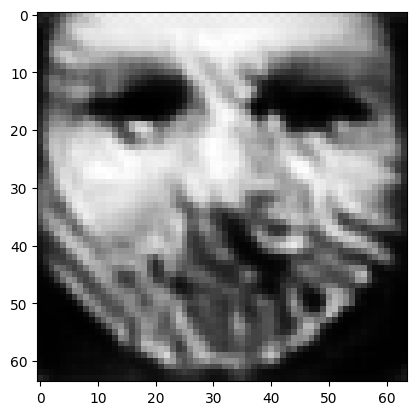

tensor([[1.0899e-05, 1.5392e-06, 1.3441e-04, 5.0447e-06, 9.9099e-01, 2.9427e-06,
         4.8903e-05, 4.8861e-06, 1.8279e-06, 8.9096e-08, 4.4453e-08, 3.7802e-07,
         8.0427e-04, 4.0919e-05, 2.4672e-06, 5.6067e-08, 1.3085e-04, 1.8654e-03,
         9.9478e-07, 9.2205e-06, 3.2810e-05, 1.0920e-06, 2.5383e-04, 2.5495e-07,
         3.1276e-03, 2.1821e-07, 1.9954e-05, 8.4733e-06, 7.7132e-07, 2.4386e-07,
         3.4098e-06, 1.4530e-05, 4.9705e-04, 2.2229e-05, 2.5805e-04, 4.7398e-05,
         2.0253e-04, 8.5861e-06, 1.4317e-03, 1.6574e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009053489193320274
tensor([[1.0896e-05, 1.5388e-06, 1.3439e-04, 5.0435e-06, 9.9099e-01, 2.9418e-06,
         4.8884e-05, 4.8848e-06, 1.8272e-06, 8.9061e-08, 4.4428e-08, 3.7784e-07,
         8.0404e-04, 4.0907e-05, 2.4660e-06, 5.6042e-08, 1.3082e-04, 1.8649e-03,
         9.9450e-07, 9.2179e-06, 3.2799e-05, 1.0916e-06, 2.5376e-04, 2.5486e-07,
         3.1269e-03, 2.1814e-07, 1.9947e-

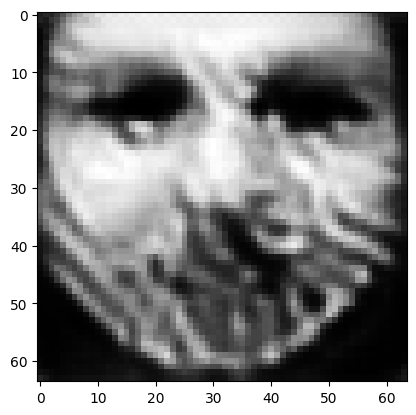

tensor([[1.0887e-05, 1.5374e-06, 1.3428e-04, 5.0388e-06, 9.9100e-01, 2.9379e-06,
         4.8812e-05, 4.8795e-06, 1.8240e-06, 8.8927e-08, 4.4334e-08, 3.7716e-07,
         8.0303e-04, 4.0867e-05, 2.4617e-06, 5.5953e-08, 1.3071e-04, 1.8628e-03,
         9.9349e-07, 9.2064e-06, 3.2757e-05, 1.0904e-06, 2.5351e-04, 2.5456e-07,
         3.1244e-03, 2.1786e-07, 1.9917e-05, 8.4598e-06, 7.6965e-07, 2.4340e-07,
         3.4038e-06, 1.4507e-05, 4.9626e-04, 2.2189e-05, 2.5785e-04, 4.7310e-05,
         2.0224e-04, 8.5769e-06, 1.4300e-03, 1.6550e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009042148478329182
tensor([[1.0885e-05, 1.5370e-06, 1.3426e-04, 5.0377e-06, 9.9100e-01, 2.9370e-06,
         4.8796e-05, 4.8783e-06, 1.8233e-06, 8.8896e-08, 4.4311e-08, 3.7700e-07,
         8.0280e-04, 4.0857e-05, 2.4607e-06, 5.5931e-08, 1.3068e-04, 1.8624e-03,
         9.9325e-07, 9.2039e-06, 3.2747e-05, 1.0901e-06, 2.5344e-04, 2.5449e-07,
         3.1238e-03, 2.1778e-07, 1.9910e-

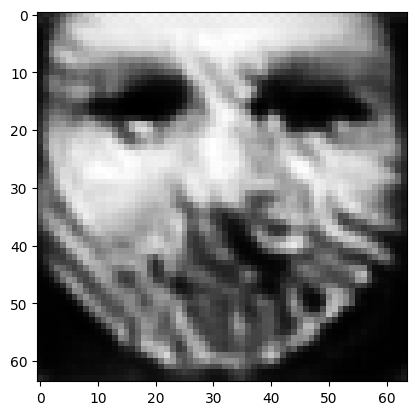

tensor([[1.0876e-05, 1.5356e-06, 1.3416e-04, 5.0333e-06, 9.9101e-01, 2.9333e-06,
         4.8727e-05, 4.8732e-06, 1.8204e-06, 8.8769e-08, 4.4222e-08, 3.7635e-07,
         8.0185e-04, 4.0819e-05, 2.4567e-06, 5.5846e-08, 1.3058e-04, 1.8604e-03,
         9.9230e-07, 9.1929e-06, 3.2708e-05, 1.0890e-06, 2.5321e-04, 2.5420e-07,
         3.1215e-03, 2.1752e-07, 1.9881e-05, 8.4472e-06, 7.6808e-07, 2.4297e-07,
         3.3981e-06, 1.4486e-05, 4.9552e-04, 2.2151e-05, 2.5766e-04, 4.7229e-05,
         2.0198e-04, 8.5682e-06, 1.4282e-03, 1.6525e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009031633846461773
tensor([[1.0873e-05, 1.5353e-06, 1.3413e-04, 5.0323e-06, 9.9101e-01, 2.9321e-06,
         4.8707e-05, 4.8716e-06, 1.8197e-06, 8.8737e-08, 4.4199e-08, 3.7620e-07,
         8.0162e-04, 4.0813e-05, 2.4557e-06, 5.5823e-08, 1.3055e-04, 1.8598e-03,
         9.9207e-07, 9.1897e-06, 3.2699e-05, 1.0887e-06, 2.5319e-04, 2.5413e-07,
         3.1210e-03, 2.1747e-07, 1.9873e-

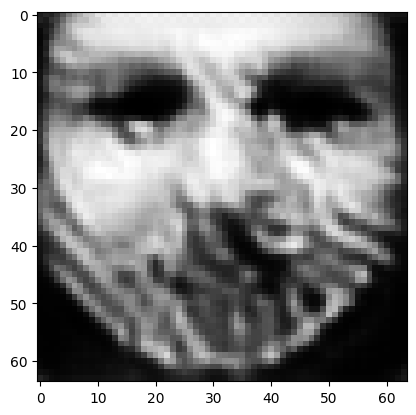

tensor([[1.0865e-05, 1.5340e-06, 1.3404e-04, 5.0282e-06, 9.9102e-01, 2.9286e-06,
         4.8643e-05, 4.8668e-06, 1.8169e-06, 8.8617e-08, 4.4115e-08, 3.7559e-07,
         8.0072e-04, 4.0778e-05, 2.4519e-06, 5.5742e-08, 1.3045e-04, 1.8580e-03,
         9.9117e-07, 9.1793e-06, 3.2662e-05, 1.0876e-06, 2.5297e-04, 2.5385e-07,
         3.1189e-03, 2.1722e-07, 1.9846e-05, 8.4346e-06, 7.6655e-07, 2.4257e-07,
         3.3928e-06, 1.4467e-05, 4.9482e-04, 2.2115e-05, 2.5749e-04, 4.7157e-05,
         2.0174e-04, 8.5606e-06, 1.4265e-03, 1.6502e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009021474048495293
tensor([[1.0863e-05, 1.5337e-06, 1.3402e-04, 5.0271e-06, 9.9102e-01, 2.9278e-06,
         4.8627e-05, 4.8657e-06, 1.8162e-06, 8.8588e-08, 4.4095e-08, 3.7544e-07,
         8.0049e-04, 4.0768e-05, 2.4510e-06, 5.5723e-08, 1.3042e-04, 1.8576e-03,
         9.9095e-07, 9.1768e-06, 3.2653e-05, 1.0873e-06, 2.5291e-04, 2.5379e-07,
         3.1183e-03, 2.1716e-07, 1.9840e-

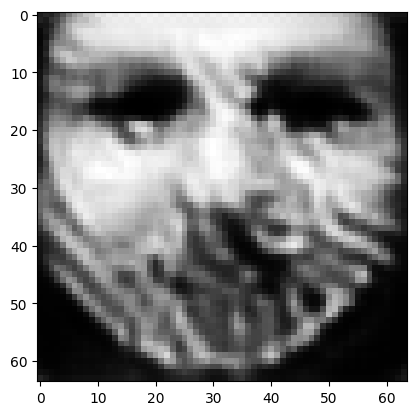

tensor([[1.0854e-05, 1.5324e-06, 1.3393e-04, 5.0232e-06, 9.9103e-01, 2.9243e-06,
         4.8565e-05, 4.8611e-06, 1.8135e-06, 8.8473e-08, 4.4014e-08, 3.7485e-07,
         7.9963e-04, 4.0736e-05, 2.4473e-06, 5.5646e-08, 1.3033e-04, 1.8558e-03,
         9.9010e-07, 9.1667e-06, 3.2618e-05, 1.0863e-06, 2.5271e-04, 2.5353e-07,
         3.1163e-03, 2.1692e-07, 1.9813e-05, 8.4230e-06, 7.6512e-07, 2.4218e-07,
         3.3876e-06, 1.4448e-05, 4.9414e-04, 2.2081e-05, 2.5731e-04, 4.7085e-05,
         2.0151e-04, 8.5531e-06, 1.4249e-03, 1.6480e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009012022987008095
tensor([[1.0852e-05, 1.5321e-06, 1.3391e-04, 5.0222e-06, 9.9103e-01, 2.9236e-06,
         4.8550e-05, 4.8600e-06, 1.8129e-06, 8.8445e-08, 4.3994e-08, 3.7471e-07,
         7.9944e-04, 4.0727e-05, 2.4464e-06, 5.5626e-08, 1.3031e-04, 1.8554e-03,
         9.8987e-07, 9.1645e-06, 3.2609e-05, 1.0860e-06, 2.5265e-04, 2.5346e-07,
         3.1158e-03, 2.1687e-07, 1.9807e-

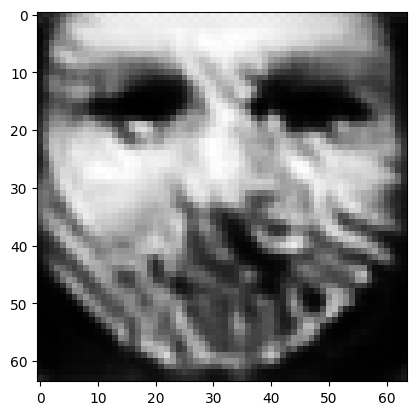

tensor([[1.0844e-05, 1.5310e-06, 1.3382e-04, 5.0187e-06, 9.9104e-01, 2.9201e-06,
         4.8489e-05, 4.8554e-06, 1.8103e-06, 8.8336e-08, 4.3918e-08, 3.7416e-07,
         7.9861e-04, 4.0699e-05, 2.4430e-06, 5.5553e-08, 1.3022e-04, 1.8537e-03,
         9.8909e-07, 9.1543e-06, 3.2577e-05, 1.0851e-06, 2.5249e-04, 2.5322e-07,
         3.1139e-03, 2.1666e-07, 1.9781e-05, 8.4118e-06, 7.6376e-07, 2.4182e-07,
         3.3829e-06, 1.4430e-05, 4.9350e-04, 2.2049e-05, 2.5716e-04, 4.7019e-05,
         2.0131e-04, 8.5463e-06, 1.4233e-03, 1.6459e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00900292582809925
tensor([[1.0843e-05, 1.5307e-06, 1.3380e-04, 5.0177e-06, 9.9104e-01, 2.9194e-06,
         4.8476e-05, 4.8544e-06, 1.8097e-06, 8.8310e-08, 4.3900e-08, 3.7403e-07,
         7.9842e-04, 4.0690e-05, 2.4422e-06, 5.5536e-08, 1.3020e-04, 1.8533e-03,
         9.8889e-07, 9.1521e-06, 3.2568e-05, 1.0848e-06, 2.5244e-04, 2.5317e-07,
         3.1134e-03, 2.1660e-07, 1.9776e-0

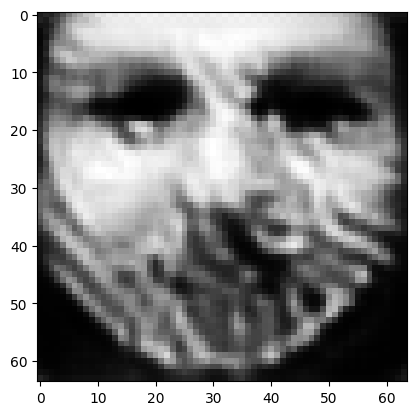

tensor([[1.0835e-05, 1.5296e-06, 1.3373e-04, 5.0143e-06, 9.9105e-01, 2.9164e-06,
         4.8420e-05, 4.8503e-06, 1.8073e-06, 8.8209e-08, 4.3828e-08, 3.7351e-07,
         7.9766e-04, 4.0661e-05, 2.4388e-06, 5.5467e-08, 1.3011e-04, 1.8517e-03,
         9.8814e-07, 9.1430e-06, 3.2537e-05, 1.0839e-06, 2.5226e-04, 2.5293e-07,
         3.1116e-03, 2.1640e-07, 1.9752e-05, 8.4016e-06, 7.6251e-07, 2.4147e-07,
         3.3782e-06, 1.4413e-05, 4.9289e-04, 2.2018e-05, 2.5700e-04, 4.6953e-05,
         2.0111e-04, 8.5395e-06, 1.4219e-03, 1.6439e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008994301781058311
tensor([[1.0833e-05, 1.5293e-06, 1.3371e-04, 5.0134e-06, 9.9105e-01, 2.9157e-06,
         4.8406e-05, 4.8494e-06, 1.8067e-06, 8.8184e-08, 4.3811e-08, 3.7338e-07,
         7.9747e-04, 4.0653e-05, 2.4380e-06, 5.5451e-08, 1.3009e-04, 1.8514e-03,
         9.8795e-07, 9.1409e-06, 3.2530e-05, 1.0836e-06, 2.5221e-04, 2.5288e-07,
         3.1111e-03, 2.1634e-07, 1.9747e-

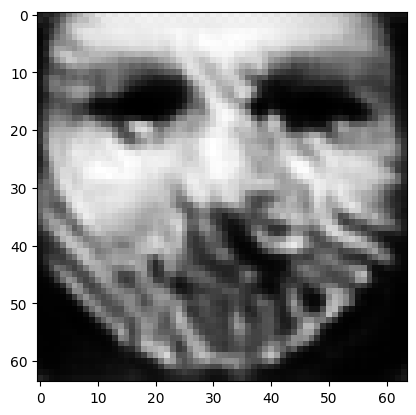

tensor([[1.0826e-05, 1.5283e-06, 1.3363e-04, 5.0102e-06, 9.9105e-01, 2.9126e-06,
         4.8351e-05, 4.8452e-06, 1.8044e-06, 8.8086e-08, 4.3741e-08, 3.7289e-07,
         7.9676e-04, 4.0628e-05, 2.4349e-06, 5.5384e-08, 1.3001e-04, 1.8498e-03,
         9.8724e-07, 9.1317e-06, 3.2501e-05, 1.0828e-06, 2.5207e-04, 2.5265e-07,
         3.1095e-03, 2.1616e-07, 1.9724e-05, 8.3917e-06, 7.6130e-07, 2.4115e-07,
         3.3740e-06, 1.4396e-05, 4.9232e-04, 2.1989e-05, 2.5687e-04, 4.6893e-05,
         2.0093e-04, 8.5335e-06, 1.4205e-03, 1.6421e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008986386470496655
tensor([[1.0824e-05, 1.5280e-06, 1.3361e-04, 5.0093e-06, 9.9106e-01, 2.9120e-06,
         4.8339e-05, 4.8443e-06, 1.8039e-06, 8.8062e-08, 4.3725e-08, 3.7277e-07,
         7.9658e-04, 4.0621e-05, 2.4341e-06, 5.5369e-08, 1.3000e-04, 1.8494e-03,
         9.8706e-07, 9.1297e-06, 3.2493e-05, 1.0826e-06, 2.5202e-04, 2.5260e-07,
         3.1090e-03, 2.1611e-07, 1.9718e-

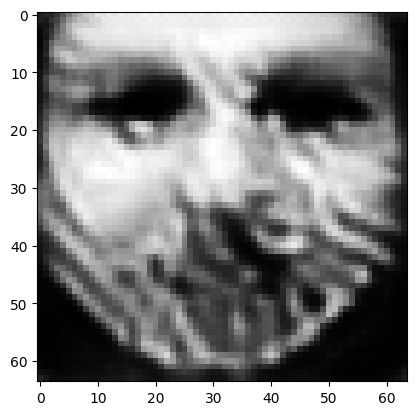

tensor([[1.0818e-05, 1.5271e-06, 1.3355e-04, 5.0062e-06, 9.9106e-01, 2.9092e-06,
         4.8288e-05, 4.8406e-06, 1.8017e-06, 8.7971e-08, 4.3660e-08, 3.7230e-07,
         7.9591e-04, 4.0594e-05, 2.4312e-06, 5.5308e-08, 1.2992e-04, 1.8480e-03,
         9.8639e-07, 9.1215e-06, 3.2466e-05, 1.0817e-06, 2.5187e-04, 2.5239e-07,
         3.1074e-03, 2.1592e-07, 1.9697e-05, 8.3825e-06, 7.6017e-07, 2.4084e-07,
         3.3698e-06, 1.4381e-05, 4.9177e-04, 2.1962e-05, 2.5673e-04, 4.6833e-05,
         2.0075e-04, 8.5274e-06, 1.4191e-03, 1.6403e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008978706784546375
tensor([[1.0816e-05, 1.5268e-06, 1.3353e-04, 5.0054e-06, 9.9106e-01, 2.9086e-06,
         4.8276e-05, 4.8398e-06, 1.8012e-06, 8.7949e-08, 4.3644e-08, 3.7218e-07,
         7.9575e-04, 4.0587e-05, 2.4304e-06, 5.5292e-08, 1.2990e-04, 1.8477e-03,
         9.8621e-07, 9.1197e-06, 3.2458e-05, 1.0815e-06, 2.5182e-04, 2.5234e-07,
         3.1070e-03, 2.1587e-07, 1.9692e-

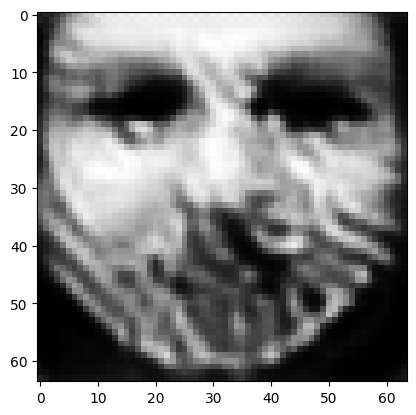

tensor([[1.0809e-05, 1.5259e-06, 1.3346e-04, 5.0025e-06, 9.9107e-01, 2.9059e-06,
         4.8227e-05, 4.8360e-06, 1.7992e-06, 8.7862e-08, 4.3582e-08, 3.7175e-07,
         7.9510e-04, 4.0564e-05, 2.4276e-06, 5.5233e-08, 1.2983e-04, 1.8463e-03,
         9.8557e-07, 9.1115e-06, 3.2433e-05, 1.0807e-06, 2.5169e-04, 2.5214e-07,
         3.1055e-03, 2.1571e-07, 1.9672e-05, 8.3736e-06, 7.5910e-07, 2.4055e-07,
         3.3660e-06, 1.4366e-05, 4.9126e-04, 2.1936e-05, 2.5660e-04, 4.6779e-05,
         2.0058e-04, 8.5219e-06, 1.4179e-03, 1.6387e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008971500210464
tensor([[1.0808e-05, 1.5257e-06, 1.3345e-04, 5.0018e-06, 9.9107e-01, 2.9053e-06,
         4.8216e-05, 4.8352e-06, 1.7987e-06, 8.7841e-08, 4.3568e-08, 3.7164e-07,
         7.9494e-04, 4.0558e-05, 2.4270e-06, 5.5220e-08, 1.2982e-04, 1.8460e-03,
         9.8542e-07, 9.1097e-06, 3.2426e-05, 1.0805e-06, 2.5165e-04, 2.5209e-07,
         3.1051e-03, 2.1566e-07, 1.9667e-05,

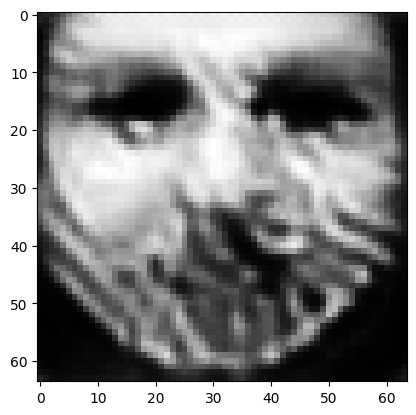

tensor([[1.0802e-05, 1.5248e-06, 1.3339e-04, 4.9990e-06, 9.9108e-01, 2.9029e-06,
         4.8171e-05, 4.8319e-06, 1.7968e-06, 8.7760e-08, 4.3510e-08, 3.7123e-07,
         7.9434e-04, 4.0534e-05, 2.4243e-06, 5.5165e-08, 1.2975e-04, 1.8447e-03,
         9.8481e-07, 9.1025e-06, 3.2401e-05, 1.0798e-06, 2.5150e-04, 2.5190e-07,
         3.1036e-03, 2.1549e-07, 1.9649e-05, 8.3656e-06, 7.5810e-07, 2.4027e-07,
         3.3622e-06, 1.4352e-05, 4.9077e-04, 2.1912e-05, 2.5648e-04, 4.6725e-05,
         2.0042e-04, 8.5164e-06, 1.4168e-03, 1.6372e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008964529260993004
tensor([[1.0800e-05, 1.5246e-06, 1.3337e-04, 4.9984e-06, 9.9108e-01, 2.9022e-06,
         4.8160e-05, 4.8310e-06, 1.7963e-06, 8.7740e-08, 4.3497e-08, 3.7113e-07,
         7.9418e-04, 4.0530e-05, 2.4237e-06, 5.5152e-08, 1.2973e-04, 1.8444e-03,
         9.8467e-07, 9.1004e-06, 3.2396e-05, 1.0796e-06, 2.5149e-04, 2.5186e-07,
         3.1033e-03, 2.1546e-07, 1.9644e-

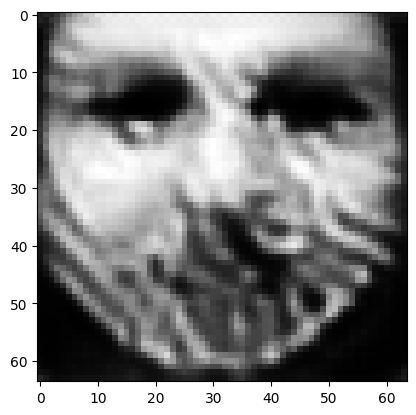

tensor([[1.0795e-05, 1.5237e-06, 1.3331e-04, 4.9957e-06, 9.9108e-01, 2.9000e-06,
         4.8117e-05, 4.8278e-06, 1.7945e-06, 8.7663e-08, 4.3441e-08, 3.7074e-07,
         7.9361e-04, 4.0507e-05, 2.4212e-06, 5.5099e-08, 1.2967e-04, 1.8432e-03,
         9.8408e-07, 9.0936e-06, 3.2372e-05, 1.0789e-06, 2.5134e-04, 2.5168e-07,
         3.1019e-03, 2.1530e-07, 1.9626e-05, 8.3576e-06, 7.5713e-07, 2.4000e-07,
         3.3587e-06, 1.4339e-05, 4.9031e-04, 2.1889e-05, 2.5636e-04, 4.6677e-05,
         2.0027e-04, 8.5114e-06, 1.4156e-03, 1.6357e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008958267979323864
tensor([[1.0793e-05, 1.5235e-06, 1.3330e-04, 4.9950e-06, 9.9108e-01, 2.8995e-06,
         4.8107e-05, 4.8272e-06, 1.7941e-06, 8.7645e-08, 4.3428e-08, 3.7064e-07,
         7.9348e-04, 4.0500e-05, 2.4205e-06, 5.5087e-08, 1.2965e-04, 1.8429e-03,
         9.8394e-07, 9.0921e-06, 3.2366e-05, 1.0787e-06, 2.5130e-04, 2.5164e-07,
         3.1015e-03, 2.1526e-07, 1.9622e-

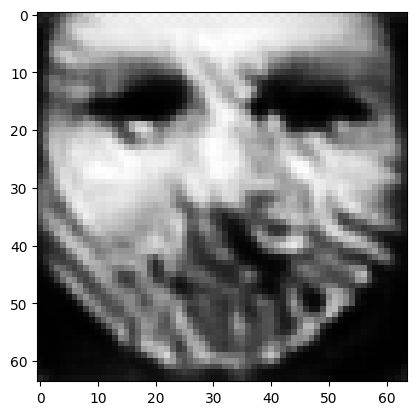

tensor([[1.0788e-05, 1.5227e-06, 1.3324e-04, 4.9925e-06, 9.9109e-01, 2.8971e-06,
         4.8066e-05, 4.8240e-06, 1.7923e-06, 8.7571e-08, 4.3376e-08, 3.7027e-07,
         7.9292e-04, 4.0481e-05, 2.4182e-06, 5.5037e-08, 1.2959e-04, 1.8418e-03,
         9.8340e-07, 9.0851e-06, 3.2344e-05, 1.0781e-06, 2.5119e-04, 2.5147e-07,
         3.1002e-03, 2.1511e-07, 1.9605e-05, 8.3501e-06, 7.5622e-07, 2.3976e-07,
         3.3554e-06, 1.4327e-05, 4.8987e-04, 2.1867e-05, 2.5626e-04, 4.6631e-05,
         2.0013e-04, 8.5067e-06, 1.4145e-03, 1.6342e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00895200576633215
tensor([[1.0786e-05, 1.5225e-06, 1.3323e-04, 4.9919e-06, 9.9109e-01, 2.8967e-06,
         4.8056e-05, 4.8233e-06, 1.7919e-06, 8.7553e-08, 4.3363e-08, 3.7018e-07,
         7.9279e-04, 4.0475e-05, 2.4176e-06, 5.5025e-08, 1.2958e-04, 1.8415e-03,
         9.8326e-07, 9.0836e-06, 3.2338e-05, 1.0779e-06, 2.5115e-04, 2.5143e-07,
         3.0999e-03, 2.1507e-07, 1.9601e-0

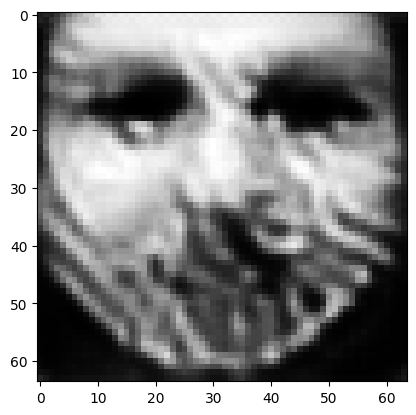

tensor([[1.0781e-05, 1.5218e-06, 1.3318e-04, 4.9894e-06, 9.9109e-01, 2.8946e-06,
         4.8019e-05, 4.8206e-06, 1.7903e-06, 8.7485e-08, 4.3315e-08, 3.6983e-07,
         7.9226e-04, 4.0455e-05, 2.4154e-06, 5.4979e-08, 1.2952e-04, 1.8404e-03,
         9.8275e-07, 9.0775e-06, 3.2317e-05, 1.0773e-06, 2.5103e-04, 2.5127e-07,
         3.0986e-03, 2.1493e-07, 1.9585e-05, 8.3432e-06, 7.5537e-07, 2.3952e-07,
         3.3522e-06, 1.4315e-05, 4.8945e-04, 2.1846e-05, 2.5615e-04, 4.6585e-05,
         1.9999e-04, 8.5018e-06, 1.4135e-03, 1.6329e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00894621666520834
tensor([[1.0780e-05, 1.5216e-06, 1.3316e-04, 4.9889e-06, 9.9109e-01, 2.8940e-06,
         4.8008e-05, 4.8197e-06, 1.7898e-06, 8.7467e-08, 4.3303e-08, 3.6974e-07,
         7.9213e-04, 4.0452e-05, 2.4149e-06, 5.4967e-08, 1.2951e-04, 1.8401e-03,
         9.8263e-07, 9.0757e-06, 3.2312e-05, 1.0771e-06, 2.5101e-04, 2.5123e-07,
         3.0984e-03, 2.1490e-07, 1.9581e-0

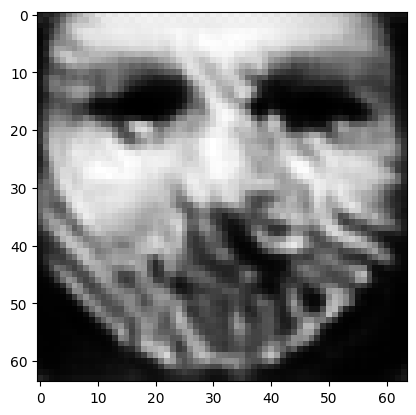

tensor([[1.0775e-05, 1.5209e-06, 1.3311e-04, 4.9866e-06, 9.9110e-01, 2.8921e-06,
         4.7973e-05, 4.8171e-06, 1.7883e-06, 8.7401e-08, 4.3256e-08, 3.6940e-07,
         7.9164e-04, 4.0432e-05, 2.4127e-06, 5.4923e-08, 1.2945e-04, 1.8391e-03,
         9.8213e-07, 9.0699e-06, 3.2292e-05, 1.0765e-06, 2.5089e-04, 2.5108e-07,
         3.0971e-03, 2.1476e-07, 1.9566e-05, 8.3364e-06, 7.5454e-07, 2.3929e-07,
         3.3492e-06, 1.4304e-05, 4.8906e-04, 2.1826e-05, 2.5605e-04, 4.6543e-05,
         1.9986e-04, 8.4975e-06, 1.4126e-03, 1.6316e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00894042756408453
tensor([[1.0774e-05, 1.5207e-06, 1.3310e-04, 4.9860e-06, 9.9110e-01, 2.8915e-06,
         4.7963e-05, 4.8163e-06, 1.7879e-06, 8.7385e-08, 4.3244e-08, 3.6932e-07,
         7.9152e-04, 4.0428e-05, 2.4122e-06, 5.4912e-08, 1.2944e-04, 1.8389e-03,
         9.8201e-07, 9.0682e-06, 3.2287e-05, 1.0764e-06, 2.5088e-04, 2.5104e-07,
         3.0969e-03, 2.1473e-07, 1.9562e-0

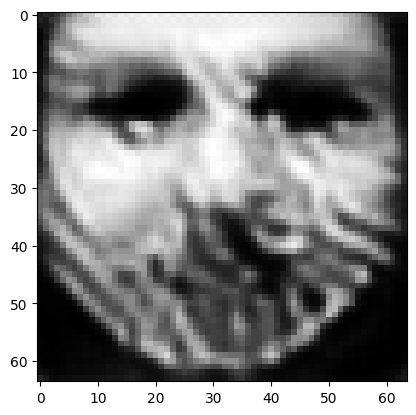

tensor([[1.0769e-05, 1.5200e-06, 1.3305e-04, 4.9839e-06, 9.9110e-01, 2.8897e-06,
         4.7929e-05, 4.8138e-06, 1.7864e-06, 8.7322e-08, 4.3200e-08, 3.6901e-07,
         7.9105e-04, 4.0410e-05, 2.4102e-06, 5.4871e-08, 1.2939e-04, 1.8379e-03,
         9.8155e-07, 9.0627e-06, 3.2268e-05, 1.0758e-06, 2.5076e-04, 2.5090e-07,
         3.0957e-03, 2.1460e-07, 1.9547e-05, 8.3300e-06, 7.5376e-07, 2.3908e-07,
         3.3463e-06, 1.4293e-05, 4.8869e-04, 2.1807e-05, 2.5595e-04, 4.6505e-05,
         1.9974e-04, 8.4935e-06, 1.4116e-03, 1.6304e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008935347199440002
tensor([[1.0768e-05, 1.5198e-06, 1.3304e-04, 4.9833e-06, 9.9111e-01, 2.8893e-06,
         4.7921e-05, 4.8133e-06, 1.7861e-06, 8.7307e-08, 4.3189e-08, 3.6893e-07,
         7.9094e-04, 4.0405e-05, 2.4097e-06, 5.4860e-08, 1.2937e-04, 1.8377e-03,
         9.8143e-07, 9.0614e-06, 3.2263e-05, 1.0757e-06, 2.5073e-04, 2.5086e-07,
         3.0954e-03, 2.1457e-07, 1.9544e-

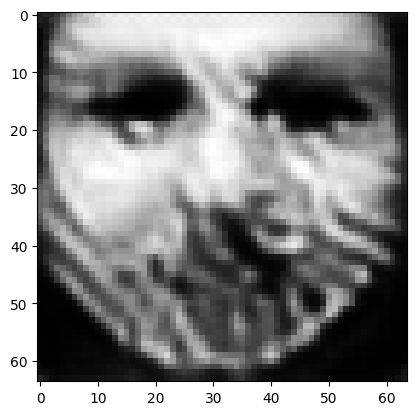

tensor([[1.0764e-05, 1.5192e-06, 1.3299e-04, 4.9813e-06, 9.9111e-01, 2.8874e-06,
         4.7887e-05, 4.8107e-06, 1.7847e-06, 8.7248e-08, 4.3147e-08, 3.6863e-07,
         7.9049e-04, 4.0389e-05, 2.4078e-06, 5.4820e-08, 1.2932e-04, 1.8367e-03,
         9.8099e-07, 9.0558e-06, 3.2245e-05, 1.0751e-06, 2.5064e-04, 2.5073e-07,
         3.0944e-03, 2.1445e-07, 1.9530e-05, 8.3239e-06, 7.5302e-07, 2.3888e-07,
         3.3437e-06, 1.4283e-05, 4.8833e-04, 2.1789e-05, 2.5587e-04, 4.6467e-05,
         1.9963e-04, 8.4896e-06, 1.4107e-03, 1.6293e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008930385112762451
tensor([[1.0763e-05, 1.5190e-06, 1.3298e-04, 4.9807e-06, 9.9111e-01, 2.8870e-06,
         4.7879e-05, 4.8101e-06, 1.7844e-06, 8.7233e-08, 4.3137e-08, 3.6855e-07,
         7.9038e-04, 4.0384e-05, 2.4073e-06, 5.4810e-08, 1.2931e-04, 1.8365e-03,
         9.8087e-07, 9.0546e-06, 3.2241e-05, 1.0750e-06, 2.5060e-04, 2.5069e-07,
         3.0941e-03, 2.1442e-07, 1.9527e-

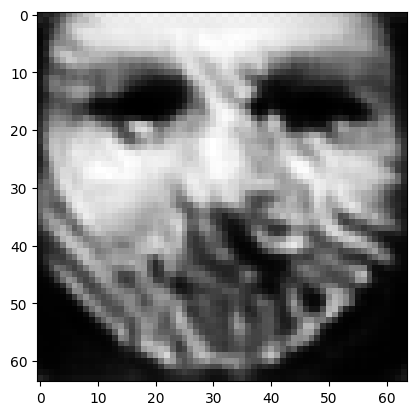

tensor([[1.0758e-05, 1.5185e-06, 1.3294e-04, 4.9788e-06, 9.9111e-01, 2.8852e-06,
         4.7848e-05, 4.8077e-06, 1.7830e-06, 8.7177e-08, 4.3097e-08, 3.6827e-07,
         7.8995e-04, 4.0369e-05, 2.4055e-06, 5.4773e-08, 1.2926e-04, 1.8356e-03,
         9.8046e-07, 9.0493e-06, 3.2224e-05, 1.0745e-06, 2.5052e-04, 2.5057e-07,
         3.0931e-03, 2.1431e-07, 1.9514e-05, 8.3181e-06, 7.5232e-07, 2.3869e-07,
         3.3411e-06, 1.4274e-05, 4.8800e-04, 2.1772e-05, 2.5578e-04, 4.6432e-05,
         1.9952e-04, 8.4859e-06, 1.4099e-03, 1.6282e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0089254230260849
tensor([[1.0757e-05, 1.5183e-06, 1.3293e-04, 4.9783e-06, 9.9112e-01, 2.8849e-06,
         4.7840e-05, 4.8072e-06, 1.7827e-06, 8.7163e-08, 4.3087e-08, 3.6820e-07,
         7.8985e-04, 4.0365e-05, 2.4050e-06, 5.4763e-08, 1.2925e-04, 1.8354e-03,
         9.8035e-07, 9.0481e-06, 3.2219e-05, 1.0744e-06, 2.5049e-04, 2.5053e-07,
         3.0929e-03, 2.1428e-07, 1.9511e-05

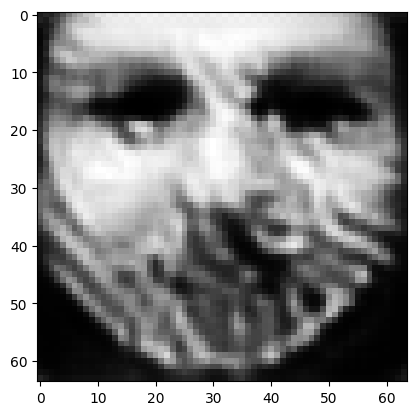

tensor([[1.0753e-05, 1.5177e-06, 1.3289e-04, 4.9765e-06, 9.9112e-01, 2.8833e-06,
         4.7811e-05, 4.8050e-06, 1.7815e-06, 8.7111e-08, 4.3049e-08, 3.6793e-07,
         7.8946e-04, 4.0349e-05, 2.4033e-06, 5.4727e-08, 1.2921e-04, 1.8346e-03,
         9.7995e-07, 9.0434e-06, 3.2203e-05, 1.0739e-06, 2.5039e-04, 2.5041e-07,
         3.0919e-03, 2.1416e-07, 1.9498e-05, 8.3128e-06, 7.5166e-07, 2.3850e-07,
         3.3387e-06, 1.4264e-05, 4.8768e-04, 2.1756e-05, 2.5570e-04, 4.6396e-05,
         1.9941e-04, 8.4821e-06, 1.4092e-03, 1.6272e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008920933119952679
tensor([[1.0752e-05, 1.5176e-06, 1.3288e-04, 4.9760e-06, 9.9112e-01, 2.8830e-06,
         4.7805e-05, 4.8046e-06, 1.7812e-06, 8.7098e-08, 4.3041e-08, 3.6786e-07,
         7.8936e-04, 4.0345e-05, 2.4029e-06, 5.4719e-08, 1.2920e-04, 1.8344e-03,
         9.7985e-07, 9.0423e-06, 3.2199e-05, 1.0737e-06, 2.5037e-04, 2.5038e-07,
         3.0916e-03, 2.1414e-07, 1.9496e-

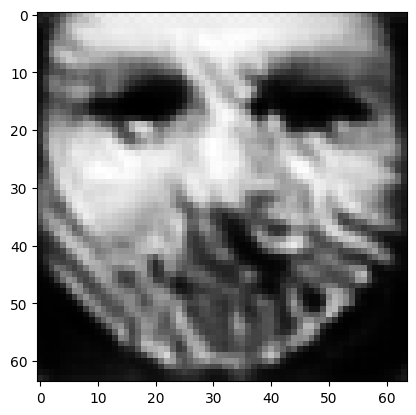

tensor([[1.0749e-05, 1.5170e-06, 1.3284e-04, 4.9743e-06, 9.9112e-01, 2.8814e-06,
         4.7776e-05, 4.8023e-06, 1.7800e-06, 8.7048e-08, 4.3004e-08, 3.6761e-07,
         7.8899e-04, 4.0332e-05, 2.4013e-06, 5.4685e-08, 1.2915e-04, 1.8336e-03,
         9.7948e-07, 9.0375e-06, 3.2184e-05, 1.0733e-06, 2.5029e-04, 2.5026e-07,
         3.0907e-03, 2.1404e-07, 1.9484e-05, 8.3077e-06, 7.5103e-07, 2.3833e-07,
         3.3364e-06, 1.4256e-05, 4.8738e-04, 2.1741e-05, 2.5563e-04, 4.6365e-05,
         1.9931e-04, 8.4789e-06, 1.4084e-03, 1.6262e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008916561491787434
tensor([[1.0748e-05, 1.5169e-06, 1.3283e-04, 4.9738e-06, 9.9112e-01, 2.8810e-06,
         4.7770e-05, 4.8019e-06, 1.7797e-06, 8.7035e-08, 4.2996e-08, 3.6755e-07,
         7.8889e-04, 4.0328e-05, 2.4009e-06, 5.4677e-08, 1.2914e-04, 1.8334e-03,
         9.7938e-07, 9.0365e-06, 3.2180e-05, 1.0732e-06, 2.5027e-04, 2.5024e-07,
         3.0905e-03, 2.1401e-07, 1.9481e-

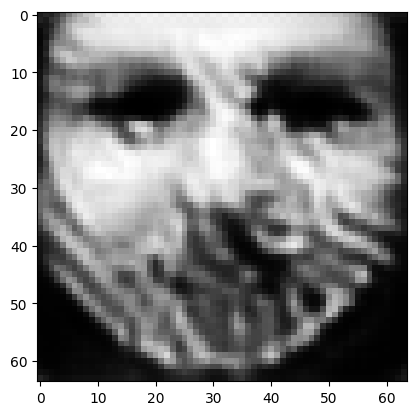

tensor([[1.0744e-05, 1.5164e-06, 1.3279e-04, 4.9722e-06, 9.9113e-01, 2.8796e-06,
         4.7743e-05, 4.7999e-06, 1.7786e-06, 8.6988e-08, 4.2962e-08, 3.6730e-07,
         7.8854e-04, 4.0314e-05, 2.3993e-06, 5.4644e-08, 1.2910e-04, 1.8327e-03,
         9.7902e-07, 9.0322e-06, 3.2165e-05, 1.0727e-06, 2.5018e-04, 2.5012e-07,
         3.0896e-03, 2.1391e-07, 1.9470e-05, 8.3029e-06, 7.5044e-07, 2.3816e-07,
         3.3341e-06, 1.4248e-05, 4.8708e-04, 2.1726e-05, 2.5555e-04, 4.6333e-05,
         1.9921e-04, 8.4755e-06, 1.4077e-03, 1.6253e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008912544697523117
tensor([[1.0743e-05, 1.5163e-06, 1.3278e-04, 4.9718e-06, 9.9113e-01, 2.8792e-06,
         4.7736e-05, 4.7993e-06, 1.7783e-06, 8.6976e-08, 4.2954e-08, 3.6724e-07,
         7.8844e-04, 4.0312e-05, 2.3990e-06, 5.4637e-08, 1.2909e-04, 1.8325e-03,
         9.7894e-07, 9.0309e-06, 3.2162e-05, 1.0726e-06, 2.5017e-04, 2.5010e-07,
         3.0894e-03, 2.1389e-07, 1.9467e-

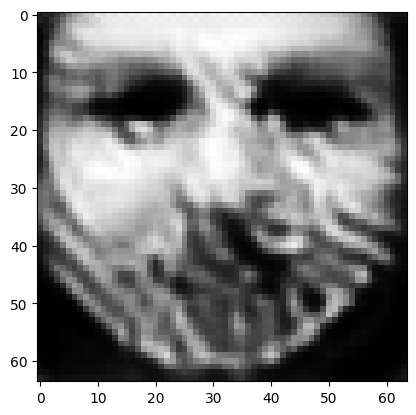

tensor([[1.0740e-05, 1.5158e-06, 1.3275e-04, 4.9702e-06, 9.9113e-01, 2.8778e-06,
         4.7711e-05, 4.7975e-06, 1.7772e-06, 8.6930e-08, 4.2921e-08, 3.6701e-07,
         7.8811e-04, 4.0298e-05, 2.3975e-06, 5.4606e-08, 1.2906e-04, 1.8318e-03,
         9.7859e-07, 9.0268e-06, 3.2148e-05, 1.0722e-06, 2.5009e-04, 2.4999e-07,
         3.0886e-03, 2.1379e-07, 1.9457e-05, 8.2981e-06, 7.4987e-07, 2.3800e-07,
         3.3321e-06, 1.4240e-05, 4.8681e-04, 2.1712e-05, 2.5548e-04, 4.6305e-05,
         1.9913e-04, 8.4725e-06, 1.4070e-03, 1.6244e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008908763527870178
tensor([[1.0739e-05, 1.5156e-06, 1.3274e-04, 4.9698e-06, 9.9113e-01, 2.8775e-06,
         4.7705e-05, 4.7971e-06, 1.7769e-06, 8.6919e-08, 4.2913e-08, 3.6695e-07,
         7.8803e-04, 4.0294e-05, 2.3971e-06, 5.4598e-08, 1.2905e-04, 1.8316e-03,
         9.7850e-07, 9.0259e-06, 3.2145e-05, 1.0721e-06, 2.5006e-04, 2.4996e-07,
         3.0883e-03, 2.1376e-07, 1.9454e-

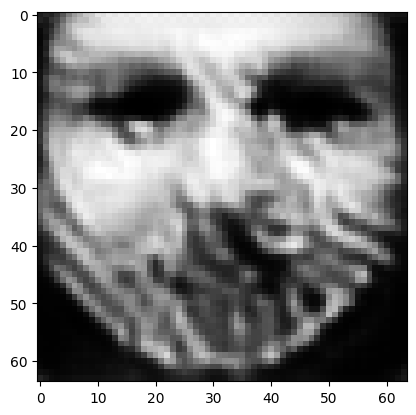

tensor([[1.0736e-05, 1.5152e-06, 1.3270e-04, 4.9683e-06, 9.9113e-01, 2.8761e-06,
         4.7680e-05, 4.7952e-06, 1.7759e-06, 8.6875e-08, 4.2882e-08, 3.6673e-07,
         7.8770e-04, 4.0283e-05, 2.3957e-06, 5.4569e-08, 1.2901e-04, 1.8309e-03,
         9.7818e-07, 9.0218e-06, 3.2132e-05, 1.0717e-06, 2.5000e-04, 2.4986e-07,
         3.0876e-03, 2.1368e-07, 1.9444e-05, 8.2936e-06, 7.4932e-07, 2.3786e-07,
         3.3301e-06, 1.4233e-05, 4.8655e-04, 2.1699e-05, 2.5542e-04, 4.6278e-05,
         1.9905e-04, 8.4696e-06, 1.4064e-03, 1.6235e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008905100636184216
tensor([[1.0735e-05, 1.5151e-06, 1.3270e-04, 4.9679e-06, 9.9114e-01, 2.8759e-06,
         4.7675e-05, 4.7948e-06, 1.7756e-06, 8.6865e-08, 4.2875e-08, 3.6668e-07,
         7.8762e-04, 4.0279e-05, 2.3954e-06, 5.4562e-08, 1.2900e-04, 1.8308e-03,
         9.7810e-07, 9.0209e-06, 3.2128e-05, 1.0716e-06, 2.4997e-04, 2.4984e-07,
         3.0874e-03, 2.1366e-07, 1.9442e-

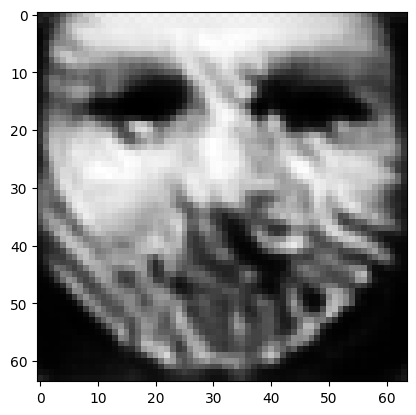

tensor([[1.0732e-05, 1.5146e-06, 1.3266e-04, 4.9665e-06, 9.9114e-01, 2.8745e-06,
         4.7652e-05, 4.7931e-06, 1.7747e-06, 8.6824e-08, 4.2846e-08, 3.6647e-07,
         7.8731e-04, 4.0269e-05, 2.3941e-06, 5.4535e-08, 1.2897e-04, 1.8301e-03,
         9.7780e-07, 9.0171e-06, 3.2116e-05, 1.0712e-06, 2.4991e-04, 2.4975e-07,
         3.0866e-03, 2.1357e-07, 1.9432e-05, 8.2894e-06, 7.4881e-07, 2.3772e-07,
         3.3282e-06, 1.4226e-05, 4.8631e-04, 2.1687e-05, 2.5536e-04, 4.6252e-05,
         1.9897e-04, 8.4669e-06, 1.4057e-03, 1.6227e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008901556022465229
tensor([[1.0731e-05, 1.5145e-06, 1.3266e-04, 4.9661e-06, 9.9114e-01, 2.8743e-06,
         4.7646e-05, 4.7927e-06, 1.7744e-06, 8.6814e-08, 4.2838e-08, 3.6642e-07,
         7.8724e-04, 4.0265e-05, 2.3937e-06, 5.4528e-08, 1.2896e-04, 1.8300e-03,
         9.7772e-07, 9.0162e-06, 3.2113e-05, 1.0711e-06, 2.4989e-04, 2.4972e-07,
         3.0864e-03, 2.1355e-07, 1.9430e-

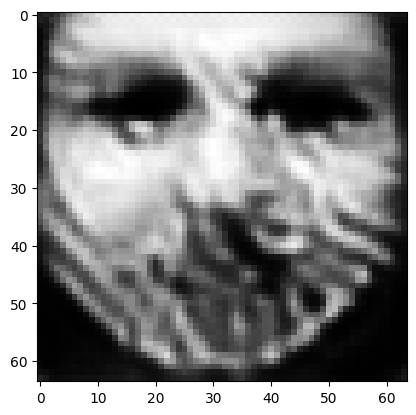

tensor([[1.0728e-05, 1.5141e-06, 1.3263e-04, 4.9647e-06, 9.9114e-01, 2.8731e-06,
         4.7625e-05, 4.7911e-06, 1.7735e-06, 8.6775e-08, 4.2811e-08, 3.6622e-07,
         7.8696e-04, 4.0253e-05, 2.3925e-06, 5.4501e-08, 1.2893e-04, 1.8294e-03,
         9.7743e-07, 9.0128e-06, 3.2101e-05, 1.0708e-06, 2.4982e-04, 2.4963e-07,
         3.0857e-03, 2.1347e-07, 1.9421e-05, 8.2856e-06, 7.4833e-07, 2.3758e-07,
         3.3264e-06, 1.4219e-05, 4.8607e-04, 2.1675e-05, 2.5530e-04, 4.6225e-05,
         1.9889e-04, 8.4641e-06, 1.4052e-03, 1.6220e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008898247964680195
tensor([[1.0727e-05, 1.5140e-06, 1.3262e-04, 4.9644e-06, 9.9114e-01, 2.8728e-06,
         4.7619e-05, 4.7906e-06, 1.7733e-06, 8.6765e-08, 4.2804e-08, 3.6617e-07,
         7.8688e-04, 4.0252e-05, 2.3922e-06, 5.4495e-08, 1.2892e-04, 1.8292e-03,
         9.7736e-07, 9.0117e-06, 3.2098e-05, 1.0707e-06, 2.4981e-04, 2.4961e-07,
         3.0855e-03, 2.1345e-07, 1.9418e-

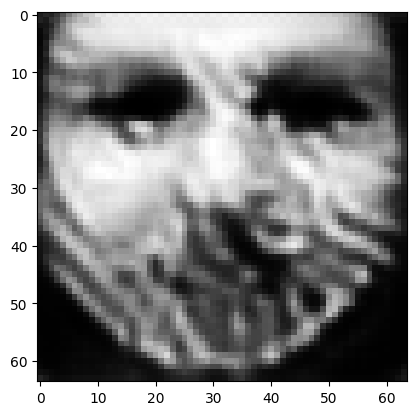

tensor([[1.0725e-05, 1.5136e-06, 1.3259e-04, 4.9631e-06, 9.9114e-01, 2.8717e-06,
         4.7599e-05, 4.7891e-06, 1.7724e-06, 8.6728e-08, 4.2777e-08, 3.6598e-07,
         7.8662e-04, 4.0241e-05, 2.3910e-06, 5.4470e-08, 1.2889e-04, 1.8286e-03,
         9.7708e-07, 9.0084e-06, 3.2087e-05, 1.0703e-06, 2.4974e-04, 2.4952e-07,
         3.0848e-03, 2.1337e-07, 1.9410e-05, 8.2817e-06, 7.4786e-07, 2.3745e-07,
         3.3248e-06, 1.4212e-05, 4.8585e-04, 2.1664e-05, 2.5524e-04, 4.6202e-05,
         1.9882e-04, 8.4616e-06, 1.4046e-03, 1.6213e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008895175531506538
tensor([[1.0724e-05, 1.5135e-06, 1.3258e-04, 4.9628e-06, 9.9114e-01, 2.8714e-06,
         4.7594e-05, 4.7888e-06, 1.7722e-06, 8.6719e-08, 4.2771e-08, 3.6594e-07,
         7.8654e-04, 4.0238e-05, 2.3907e-06, 5.4464e-08, 1.2888e-04, 1.8285e-03,
         9.7701e-07, 9.0077e-06, 3.2084e-05, 1.0703e-06, 2.4972e-04, 2.4950e-07,
         3.0847e-03, 2.1335e-07, 1.9408e-

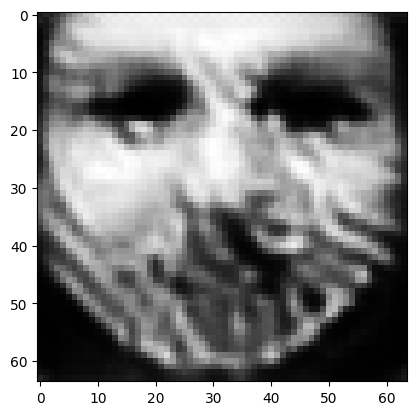

tensor([[1.0721e-05, 1.5131e-06, 1.3256e-04, 4.9616e-06, 9.9115e-01, 2.8703e-06,
         4.7574e-05, 4.7873e-06, 1.7714e-06, 8.6684e-08, 4.2746e-08, 3.6576e-07,
         7.8629e-04, 4.0228e-05, 2.3896e-06, 5.4440e-08, 1.2885e-04, 1.8279e-03,
         9.7675e-07, 9.0044e-06, 3.2073e-05, 1.0699e-06, 2.4967e-04, 2.4942e-07,
         3.0840e-03, 2.1328e-07, 1.9400e-05, 8.2781e-06, 7.4742e-07, 2.3733e-07,
         3.3232e-06, 1.4206e-05, 4.8564e-04, 2.1653e-05, 2.5519e-04, 4.6180e-05,
         1.9875e-04, 8.4592e-06, 1.4041e-03, 1.6206e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00889198575168848
tensor([[1.0721e-05, 1.5130e-06, 1.3255e-04, 4.9613e-06, 9.9115e-01, 2.8701e-06,
         4.7570e-05, 4.7870e-06, 1.7712e-06, 8.6675e-08, 4.2740e-08, 3.6571e-07,
         7.8622e-04, 4.0226e-05, 2.3893e-06, 5.4434e-08, 1.2884e-04, 1.8278e-03,
         9.7668e-07, 9.0037e-06, 3.2070e-05, 1.0698e-06, 2.4965e-04, 2.4940e-07,
         3.0839e-03, 2.1326e-07, 1.9398e-0

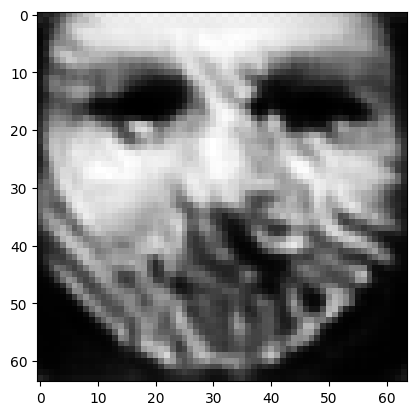

tensor([[1.0718e-05, 1.5126e-06, 1.3252e-04, 4.9601e-06, 9.9115e-01, 2.8690e-06,
         4.7551e-05, 4.7855e-06, 1.7704e-06, 8.6641e-08, 4.2716e-08, 3.6554e-07,
         7.8598e-04, 4.0217e-05, 2.3882e-06, 5.4412e-08, 1.2881e-04, 1.8273e-03,
         9.7643e-07, 9.0004e-06, 3.2060e-05, 1.0695e-06, 2.4960e-04, 2.4932e-07,
         3.0832e-03, 2.1320e-07, 1.9390e-05, 8.2747e-06, 7.4700e-07, 2.3722e-07,
         3.3217e-06, 1.4201e-05, 4.8543e-04, 2.1643e-05, 2.5514e-04, 4.6159e-05,
         1.9869e-04, 8.4570e-06, 1.4036e-03, 1.6199e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0088890315964818
tensor([[1.0717e-05, 1.5125e-06, 1.3252e-04, 4.9598e-06, 9.9115e-01, 2.8688e-06,
         4.7546e-05, 4.7852e-06, 1.7702e-06, 8.6633e-08, 4.2711e-08, 3.6550e-07,
         7.8592e-04, 4.0214e-05, 2.3879e-06, 5.4406e-08, 1.2881e-04, 1.8272e-03,
         9.7637e-07, 8.9998e-06, 3.2058e-05, 1.0695e-06, 2.4958e-04, 2.4930e-07,
         3.0831e-03, 2.1318e-07, 1.9388e-05

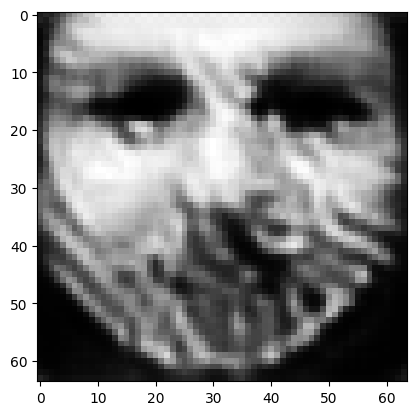

tensor([[1.0715e-05, 1.5122e-06, 1.3249e-04, 4.9587e-06, 9.9115e-01, 2.8677e-06,
         4.7528e-05, 4.7838e-06, 1.7694e-06, 8.6601e-08, 4.2688e-08, 3.6534e-07,
         7.8568e-04, 4.0206e-05, 2.3870e-06, 5.4384e-08, 1.2878e-04, 1.8267e-03,
         9.7613e-07, 8.9968e-06, 3.2048e-05, 1.0692e-06, 2.4953e-04, 2.4923e-07,
         3.0825e-03, 2.1312e-07, 1.9381e-05, 8.2714e-06, 7.4660e-07, 2.3711e-07,
         3.3202e-06, 1.4195e-05, 4.8524e-04, 2.1633e-05, 2.5509e-04, 4.6139e-05,
         1.9863e-04, 8.4549e-06, 1.4031e-03, 1.6193e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008886550553143024
tensor([[1.0714e-05, 1.5121e-06, 1.3249e-04, 4.9585e-06, 9.9115e-01, 2.8676e-06,
         4.7524e-05, 4.7835e-06, 1.7693e-06, 8.6593e-08, 4.2682e-08, 3.6530e-07,
         7.8563e-04, 4.0203e-05, 2.3867e-06, 5.4379e-08, 1.2877e-04, 1.8266e-03,
         9.7608e-07, 8.9962e-06, 3.2046e-05, 1.0691e-06, 2.4952e-04, 2.4921e-07,
         3.0823e-03, 2.1310e-07, 1.9379e-

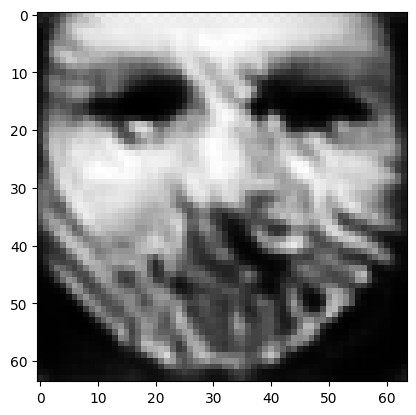

tensor([[1.0712e-05, 1.5118e-06, 1.3246e-04, 4.9574e-06, 9.9116e-01, 2.8666e-06,
         4.7507e-05, 4.7822e-06, 1.7685e-06, 8.6562e-08, 4.2661e-08, 3.6515e-07,
         7.8540e-04, 4.0195e-05, 2.3857e-06, 5.4359e-08, 1.2875e-04, 1.8261e-03,
         9.7585e-07, 8.9933e-06, 3.2037e-05, 1.0688e-06, 2.4947e-04, 2.4914e-07,
         3.0818e-03, 2.1304e-07, 1.9372e-05, 8.2683e-06, 7.4622e-07, 2.3701e-07,
         3.3189e-06, 1.4190e-05, 4.8506e-04, 2.1624e-05, 2.5504e-04, 4.6120e-05,
         1.9857e-04, 8.4529e-06, 1.4027e-03, 1.6187e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008883951231837273
tensor([[1.0712e-05, 1.5117e-06, 1.3246e-04, 4.9571e-06, 9.9116e-01, 2.8664e-06,
         4.7503e-05, 4.7819e-06, 1.7684e-06, 8.6555e-08, 4.2656e-08, 3.6511e-07,
         7.8535e-04, 4.0192e-05, 2.3855e-06, 5.4354e-08, 1.2874e-04, 1.8260e-03,
         9.7579e-07, 8.9927e-06, 3.2034e-05, 1.0688e-06, 2.4946e-04, 2.4912e-07,
         3.0816e-03, 2.1302e-07, 1.9370e-

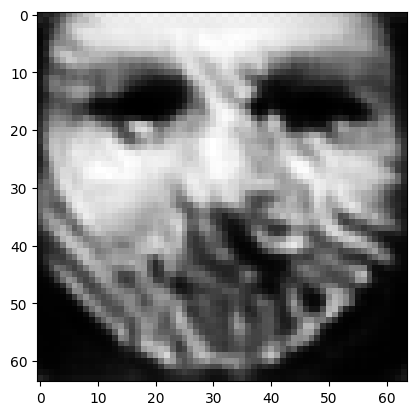

tensor([[1.0709e-05, 1.5114e-06, 1.3243e-04, 4.9561e-06, 9.9116e-01, 2.8655e-06,
         4.7487e-05, 4.7807e-06, 1.7677e-06, 8.6526e-08, 4.2635e-08, 3.6496e-07,
         7.8514e-04, 4.0185e-05, 2.3846e-06, 5.4334e-08, 1.2872e-04, 1.8255e-03,
         9.7558e-07, 8.9900e-06, 3.2026e-05, 1.0685e-06, 2.4941e-04, 2.4905e-07,
         3.0811e-03, 2.1296e-07, 1.9363e-05, 8.2654e-06, 7.4586e-07, 2.3691e-07,
         3.3176e-06, 1.4185e-05, 4.8489e-04, 2.1615e-05, 2.5500e-04, 4.6101e-05,
         1.9851e-04, 8.4509e-06, 1.4023e-03, 1.6181e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008881470188498497
tensor([[1.0709e-05, 1.5113e-06, 1.3243e-04, 4.9559e-06, 9.9116e-01, 2.8652e-06,
         4.7483e-05, 4.7804e-06, 1.7675e-06, 8.6519e-08, 4.2630e-08, 3.6492e-07,
         7.8508e-04, 4.0182e-05, 2.3843e-06, 5.4329e-08, 1.2871e-04, 1.8254e-03,
         9.7552e-07, 8.9894e-06, 3.2023e-05, 1.0684e-06, 2.4940e-04, 2.4904e-07,
         3.0810e-03, 2.1295e-07, 1.9362e-

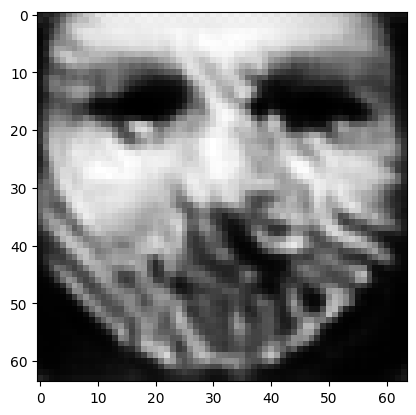

tensor([[1.0707e-05, 1.5110e-06, 1.3241e-04, 4.9550e-06, 9.9116e-01, 2.8644e-06,
         4.7468e-05, 4.7793e-06, 1.7669e-06, 8.6491e-08, 4.2611e-08, 3.6479e-07,
         7.8488e-04, 4.0175e-05, 2.3835e-06, 5.4311e-08, 1.2869e-04, 1.8250e-03,
         9.7533e-07, 8.9869e-06, 3.2015e-05, 1.0682e-06, 2.4936e-04, 2.4897e-07,
         3.0805e-03, 2.1289e-07, 1.9355e-05, 8.2626e-06, 7.4552e-07, 2.3682e-07,
         3.3164e-06, 1.4181e-05, 4.8473e-04, 2.1607e-05, 2.5496e-04, 4.6084e-05,
         1.9846e-04, 8.4491e-06, 1.4018e-03, 1.6176e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008879343047738075
tensor([[1.0706e-05, 1.5109e-06, 1.3240e-04, 4.9547e-06, 9.9116e-01, 2.8642e-06,
         4.7464e-05, 4.7790e-06, 1.7667e-06, 8.6485e-08, 4.2606e-08, 3.6475e-07,
         7.8484e-04, 4.0173e-05, 2.3832e-06, 5.4306e-08, 1.2868e-04, 1.8249e-03,
         9.7527e-07, 8.9863e-06, 3.2013e-05, 1.0681e-06, 2.4934e-04, 2.4896e-07,
         3.0803e-03, 2.1288e-07, 1.9354e-

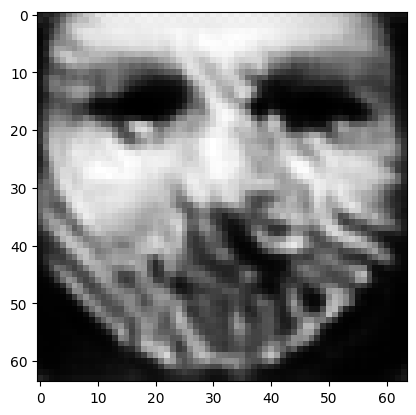

tensor([[1.0704e-05, 1.5107e-06, 1.3238e-04, 4.9538e-06, 9.9116e-01, 2.8634e-06,
         4.7450e-05, 4.7779e-06, 1.7661e-06, 8.6459e-08, 4.2588e-08, 3.6462e-07,
         7.8464e-04, 4.0166e-05, 2.3824e-06, 5.4289e-08, 1.2866e-04, 1.8245e-03,
         9.7508e-07, 8.9839e-06, 3.2005e-05, 1.0679e-06, 2.4930e-04, 2.4890e-07,
         3.0799e-03, 2.1283e-07, 1.9348e-05, 8.2599e-06, 7.4519e-07, 2.3673e-07,
         3.3152e-06, 1.4176e-05, 4.8457e-04, 2.1599e-05, 2.5492e-04, 4.6068e-05,
         1.9841e-04, 8.4473e-06, 1.4015e-03, 1.6171e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008876980282366276
tensor([[1.0704e-05, 1.5106e-06, 1.3238e-04, 4.9536e-06, 9.9116e-01, 2.8632e-06,
         4.7446e-05, 4.7777e-06, 1.7660e-06, 8.6452e-08, 4.2583e-08, 3.6459e-07,
         7.8460e-04, 4.0164e-05, 2.3822e-06, 5.4284e-08, 1.2866e-04, 1.8244e-03,
         9.7503e-07, 8.9833e-06, 3.2003e-05, 1.0678e-06, 2.4929e-04, 2.4888e-07,
         3.0797e-03, 2.1281e-07, 1.9347e-

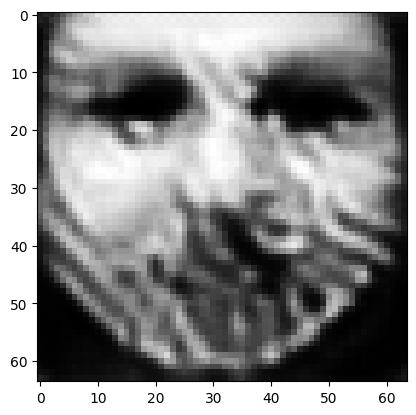

tensor([[1.0702e-05, 1.5103e-06, 1.3236e-04, 4.9527e-06, 9.9116e-01, 2.8624e-06,
         4.7432e-05, 4.7766e-06, 1.7654e-06, 8.6428e-08, 4.2566e-08, 3.6446e-07,
         7.8442e-04, 4.0158e-05, 2.3814e-06, 5.4268e-08, 1.2863e-04, 1.8240e-03,
         9.7485e-07, 8.9810e-06, 3.1996e-05, 1.0676e-06, 2.4925e-04, 2.4883e-07,
         3.0793e-03, 2.1276e-07, 1.9341e-05, 8.2574e-06, 7.4488e-07, 2.3664e-07,
         3.3141e-06, 1.4172e-05, 4.8442e-04, 2.1592e-05, 2.5488e-04, 4.6052e-05,
         1.9836e-04, 8.4457e-06, 1.4011e-03, 1.6166e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008874853141605854
tensor([[1.0701e-05, 1.5103e-06, 1.3235e-04, 4.9525e-06, 9.9116e-01, 2.8622e-06,
         4.7429e-05, 4.7764e-06, 1.7653e-06, 8.6421e-08, 4.2561e-08, 3.6443e-07,
         7.8437e-04, 4.0155e-05, 2.3812e-06, 5.4263e-08, 1.2863e-04, 1.8239e-03,
         9.7480e-07, 8.9805e-06, 3.1994e-05, 1.0675e-06, 2.4924e-04, 2.4881e-07,
         3.0792e-03, 2.1275e-07, 1.9339e-

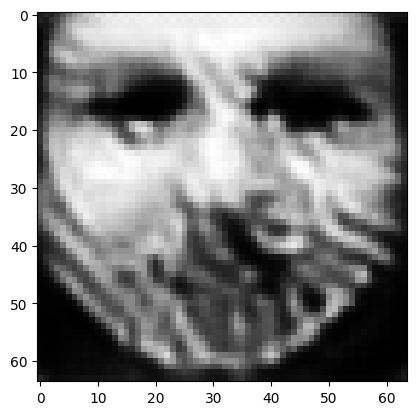

tensor([[1.0700e-05, 1.5100e-06, 1.3233e-04, 4.9517e-06, 9.9117e-01, 2.8616e-06,
         4.7416e-05, 4.7754e-06, 1.7647e-06, 8.6398e-08, 4.2545e-08, 3.6431e-07,
         7.8420e-04, 4.0148e-05, 2.3805e-06, 5.4248e-08, 1.2861e-04, 1.8235e-03,
         9.7462e-07, 8.9784e-06, 3.1987e-05, 1.0673e-06, 2.4919e-04, 2.4875e-07,
         3.0787e-03, 2.1270e-07, 1.9334e-05, 8.2551e-06, 7.4459e-07, 2.3656e-07,
         3.3130e-06, 1.4168e-05, 4.8428e-04, 2.1585e-05, 2.5485e-04, 4.6036e-05,
         1.9831e-04, 8.4440e-06, 1.4008e-03, 1.6162e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008872844278812408
tensor([[1.0699e-05, 1.5099e-06, 1.3233e-04, 4.9515e-06, 9.9117e-01, 2.8614e-06,
         4.7413e-05, 4.7752e-06, 1.7646e-06, 8.6392e-08, 4.2541e-08, 3.6428e-07,
         7.8416e-04, 4.0147e-05, 2.3803e-06, 5.4244e-08, 1.2860e-04, 1.8234e-03,
         9.7458e-07, 8.9779e-06, 3.1985e-05, 1.0673e-06, 2.4919e-04, 2.4874e-07,
         3.0786e-03, 2.1269e-07, 1.9333e-

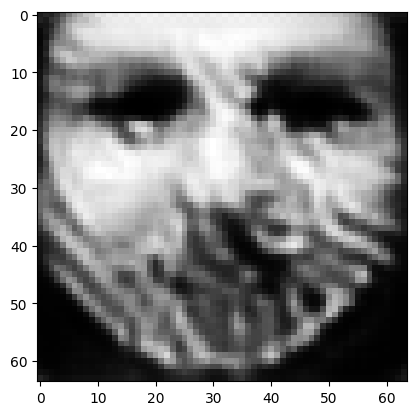

tensor([[1.0698e-05, 1.5097e-06, 1.3231e-04, 4.9507e-06, 9.9117e-01, 2.8607e-06,
         4.7400e-05, 4.7743e-06, 1.7641e-06, 8.6370e-08, 4.2525e-08, 3.6417e-07,
         7.8399e-04, 4.0140e-05, 2.3796e-06, 5.4229e-08, 1.2858e-04, 1.8231e-03,
         9.7440e-07, 8.9759e-06, 3.1978e-05, 1.0670e-06, 2.4914e-04, 2.4869e-07,
         3.0782e-03, 2.1264e-07, 1.9328e-05, 8.2528e-06, 7.4431e-07, 2.3648e-07,
         3.3120e-06, 1.4164e-05, 4.8414e-04, 2.1578e-05, 2.5481e-04, 4.6022e-05,
         1.9827e-04, 8.4424e-06, 1.4004e-03, 1.6157e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008871071971952915
tensor([[1.0697e-05, 1.5096e-06, 1.3231e-04, 4.9505e-06, 9.9117e-01, 2.8605e-06,
         4.7397e-05, 4.7740e-06, 1.7639e-06, 8.6364e-08, 4.2521e-08, 3.6414e-07,
         7.8395e-04, 4.0139e-05, 2.3794e-06, 5.4225e-08, 1.2858e-04, 1.8230e-03,
         9.7437e-07, 8.9753e-06, 3.1977e-05, 1.0670e-06, 2.4914e-04, 2.4868e-07,
         3.0781e-03, 2.1263e-07, 1.9326e-

In [15]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=4)

tensor([[2.5849e-04, 4.0420e-05, 9.8728e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5020e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2035e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5312e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  10.689163208007812


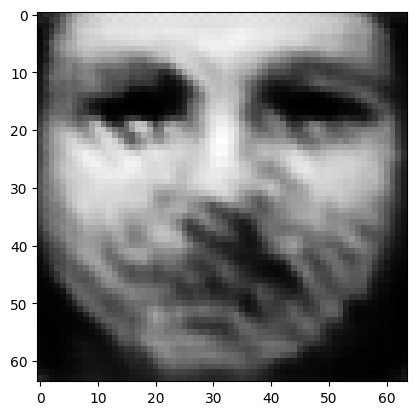

tensor([[4.8650e-05, 2.1157e-04, 3.8650e-04, 1.5778e-03, 1.6274e-02, 2.1027e-05,
         1.6599e-04, 9.2410e-05, 2.1924e-04, 5.0953e-06, 2.8288e-05, 4.3530e-05,
         4.0979e-03, 9.7526e-03, 8.5386e-05, 6.7824e-06, 5.0513e-03, 7.5828e-04,
         2.3511e-04, 1.5781e-05, 7.7750e-03, 7.6438e-05, 4.5494e-01, 5.9235e-05,
         1.7583e-01, 8.8702e-02, 3.4083e-05, 2.1717e-04, 1.3871e-04, 1.3325e-03,
         3.2579e-04, 3.3540e-04, 3.7857e-03, 2.0730e-03, 7.7763e-03, 8.2875e-03,
         2.0284e-01, 4.1800e-03, 1.6130e-03, 5.9105e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  10.769712448120117
tensor([[6.4951e-05, 2.6532e-04, 5.5495e-03, 2.2998e-04, 7.4046e-02, 5.9346e-04,
         2.0347e-03, 5.5050e-04, 1.4305e-03, 5.9028e-05, 8.6789e-05, 6.6347e-05,
         1.1155e-01, 6.1596e-04, 1.5675e-04, 1.3501e-05, 5.3254e-03, 2.7417e-03,
         1.0057e-04, 6.5757e-03, 1.6683e-03, 7.6945e-05, 1.5094e-03, 3.3460e-05,
         2.3002e-02, 8.9283e-05, 9.1973e-04

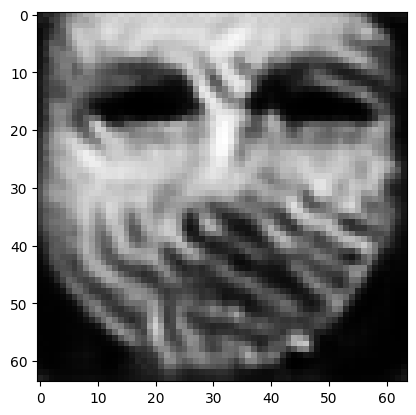

tensor([[1.8303e-04, 3.0659e-05, 4.1844e-03, 1.3721e-05, 2.0791e-04, 9.6504e-01,
         4.9655e-03, 6.5412e-03, 3.5056e-06, 2.2617e-04, 2.3503e-04, 2.3092e-04,
         4.7328e-05, 2.6144e-07, 9.5081e-08, 3.1502e-04, 4.5048e-04, 7.9263e-04,
         2.4181e-05, 5.0335e-03, 4.4586e-06, 4.8632e-06, 3.3235e-08, 2.6895e-06,
         6.4597e-06, 6.7476e-07, 1.8484e-03, 3.5046e-04, 2.0419e-03, 1.4934e-06,
         7.4288e-07, 2.3148e-05, 1.7751e-03, 1.0179e-04, 5.0611e-05, 8.8022e-07,
         1.1285e-05, 2.6444e-05, 6.5811e-05, 5.1543e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.035582538694143295
tensor([[1.6169e-04, 2.6834e-05, 3.7909e-03, 1.1891e-05, 1.7711e-04, 9.7013e-01,
         4.0813e-03, 5.7833e-03, 2.7873e-06, 1.8785e-04, 2.0211e-04, 1.9880e-04,
         3.9532e-05, 2.1001e-07, 7.3851e-08, 2.8353e-04, 4.0185e-04, 6.5496e-04,
         2.0797e-05, 4.0983e-03, 3.6866e-06, 4.0347e-06, 2.7533e-08, 2.3195e-06,
         5.2561e-06, 5.7266e-07, 1.5719e-

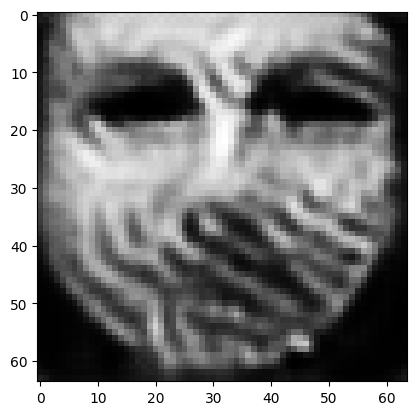

tensor([[1.1628e-04, 1.8909e-05, 2.8990e-03, 8.2589e-06, 1.1718e-04, 9.8041e-01,
         2.3867e-03, 4.0313e-03, 1.5119e-06, 1.1320e-04, 1.3719e-04, 1.3643e-04,
         2.4670e-05, 1.2181e-07, 3.8247e-08, 2.1679e-04, 2.9910e-04, 4.0536e-04,
         1.3795e-05, 2.2982e-03, 2.2516e-06, 2.4218e-06, 1.7152e-08, 1.5361e-06,
         3.1013e-06, 3.6849e-07, 1.0429e-03, 1.9684e-04, 1.1040e-03, 7.7069e-07,
         3.7756e-07, 9.9680e-06, 7.6357e-04, 4.2170e-05, 3.3061e-05, 3.8708e-07,
         6.4557e-06, 1.3171e-05, 2.6753e-05, 3.1113e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019780052825808525
tensor([[1.0875e-04, 1.7729e-05, 2.7488e-03, 7.6843e-06, 1.0854e-04, 9.8187e-01,
         2.1559e-03, 3.7413e-03, 1.3670e-06, 1.0344e-04, 1.2822e-04, 1.2821e-04,
         2.2715e-05, 1.1030e-07, 3.3982e-08, 2.0632e-04, 2.8069e-04, 3.7084e-04,
         1.2715e-05, 2.0714e-03, 2.0718e-06, 2.2097e-06, 1.5740e-08, 1.4108e-06,
         2.8043e-06, 3.3820e-07, 9.7538e-

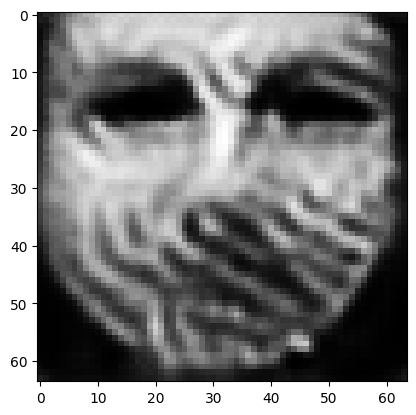

tensor([[8.7396e-05, 1.4056e-05, 2.3253e-03, 5.9035e-06, 8.4217e-05, 9.8576e-01,
         1.5716e-03, 2.9383e-03, 9.8176e-07, 7.8232e-05, 1.0407e-04, 1.0643e-04,
         1.7189e-05, 7.8827e-08, 2.3042e-08, 1.7674e-04, 2.2603e-04, 2.7860e-04,
         9.6350e-06, 1.5061e-03, 1.5766e-06, 1.6761e-06, 1.1606e-08, 1.0767e-06,
         2.0029e-06, 2.5484e-07, 7.8848e-04, 1.4177e-04, 7.6494e-04, 5.2352e-07,
         2.6498e-07, 6.2823e-06, 4.9242e-04, 2.6239e-05, 2.6375e-05, 2.4573e-07,
         4.6199e-06, 8.8629e-06, 1.6350e-05, 2.4286e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014345843344926834
tensor([[8.3561e-05, 1.3428e-05, 2.2475e-03, 5.6013e-06, 8.0251e-05, 9.8643e-01,
         1.4742e-03, 2.7921e-03, 9.2224e-07, 7.4122e-05, 9.9754e-05, 1.0261e-04,
         1.6318e-05, 7.3731e-08, 2.1356e-08, 1.7125e-04, 2.1599e-04, 2.6372e-04,
         9.0928e-06, 1.4153e-03, 1.4958e-06, 1.5870e-06, 1.0939e-08, 1.0198e-06,
         1.8752e-06, 2.4085e-07, 7.5691e-

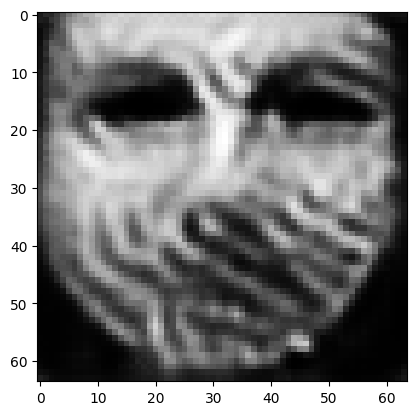

tensor([[7.1877e-05, 1.1301e-05, 1.9956e-03, 4.6449e-06, 6.7724e-05, 9.8850e-01,
         1.1954e-03, 2.3504e-03, 7.3424e-07, 6.0990e-05, 8.6443e-05, 9.0018e-05,
         1.3505e-05, 5.8519e-08, 1.6344e-08, 1.5408e-04, 1.8624e-04, 2.1907e-04,
         7.4163e-06, 1.1444e-03, 1.2469e-06, 1.3118e-06, 8.8503e-09, 8.5223e-07,
         1.4957e-06, 1.9650e-07, 6.5117e-04, 1.1363e-04, 5.8851e-04, 3.9823e-07,
         2.0772e-07, 4.5922e-06, 3.7016e-04, 1.8891e-05, 2.2407e-05, 1.8038e-07,
         3.6883e-06, 6.7022e-06, 1.1751e-05, 2.0418e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011565777473151684
tensor([[6.9723e-05, 1.0869e-05, 1.9430e-03, 4.4572e-06, 6.5287e-05, 9.8891e-01,
         1.1443e-03, 2.2677e-03, 6.9689e-07, 5.8419e-05, 8.3902e-05, 8.7424e-05,
         1.2928e-05, 5.5616e-08, 1.5418e-08, 1.5080e-04, 1.8066e-04, 2.1041e-04,
         7.0957e-06, 1.0930e-03, 1.1995e-06, 1.2604e-06, 8.4466e-09, 8.2224e-07,
         1.4236e-06, 1.8787e-07, 6.2935e-

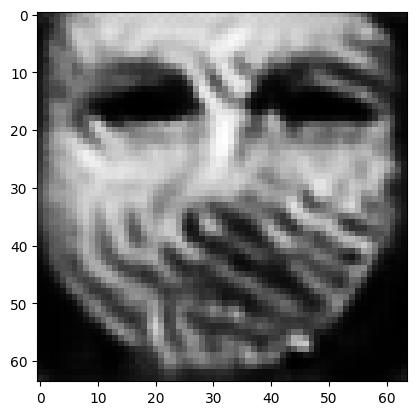

tensor([[6.2996e-05, 9.5026e-06, 1.7691e-03, 3.8579e-06, 5.7773e-05, 9.9020e-01,
         9.8900e-04, 2.0101e-03, 5.7885e-07, 5.0115e-05, 7.5956e-05, 7.8806e-05,
         1.1118e-05, 4.6962e-08, 1.2700e-08, 1.4027e-04, 1.6400e-04, 1.8433e-04,
         6.1001e-06, 9.3446e-04, 1.0510e-06, 1.0953e-06, 7.2028e-09, 7.3453e-07,
         1.2107e-06, 1.6089e-07, 5.5709e-04, 9.6756e-05, 4.8085e-04, 3.2270e-07,
         1.7101e-07, 3.6619e-06, 2.9878e-04, 1.4691e-05, 1.9596e-05, 1.4325e-07,
         3.1435e-06, 5.4327e-06, 9.1300e-06, 1.7590e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009849519468843937
tensor([[6.1642e-05, 9.2354e-06, 1.7341e-03, 3.7387e-06, 5.6290e-05, 9.9046e-01,
         9.5915e-04, 1.9577e-03, 5.5638e-07, 4.8461e-05, 7.4448e-05, 7.7117e-05,
         1.0769e-05, 4.5359e-08, 1.2198e-08, 1.3826e-04, 1.6077e-04, 1.7939e-04,
         5.9116e-06, 9.0411e-04, 1.0224e-06, 1.0627e-06, 6.9632e-09, 7.1790e-07,
         1.1695e-06, 1.5548e-07, 5.4270e-

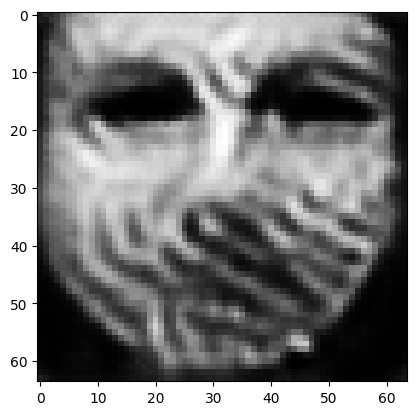

tensor([[5.7537e-05, 8.3967e-06, 1.6131e-03, 3.3694e-06, 5.1663e-05, 9.9130e-01,
         8.6660e-04, 1.7890e-03, 4.8252e-07, 4.2900e-05, 6.9534e-05, 7.1398e-05,
         9.6716e-06, 4.0449e-08, 1.0712e-08, 1.3212e-04, 1.5137e-04, 1.6461e-04,
         5.3199e-06, 8.0637e-04, 9.3176e-07, 9.5382e-07, 6.2297e-09, 6.7047e-07,
         1.0460e-06, 1.3780e-07, 4.9375e-04, 8.5950e-05, 4.1400e-04, 2.7695e-07,
         1.4722e-07, 3.1455e-06, 2.5483e-04, 1.2196e-05, 1.7814e-05, 1.2193e-07,
         2.8159e-06, 4.6425e-06, 7.5204e-06, 1.5559e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008738373406231403
tensor([[5.6638e-05, 8.2072e-06, 1.5862e-03, 3.2882e-06, 5.0632e-05, 9.9148e-01,
         8.4754e-04, 1.7524e-03, 4.6681e-07, 4.1707e-05, 6.8483e-05, 7.0167e-05,
         9.4228e-06, 3.9344e-08, 1.0382e-08, 1.3086e-04, 1.4922e-04, 1.6130e-04,
         5.1915e-06, 7.8500e-04, 9.1199e-07, 9.3047e-07, 6.0664e-09, 6.5965e-07,
         1.0186e-06, 1.3387e-07, 4.8314e-

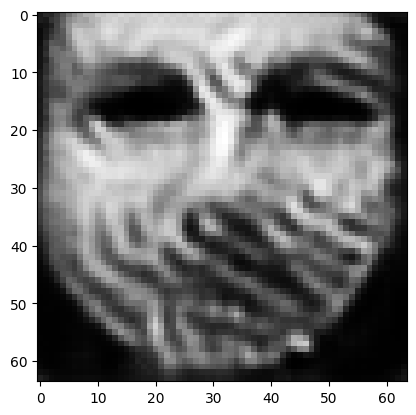

tensor([[5.3665e-05, 7.5641e-06, 1.4936e-03, 3.0221e-06, 4.7105e-05, 9.9212e-01,
         7.8152e-04, 1.6259e-03, 4.1315e-07, 3.7444e-05, 6.4762e-05, 6.5653e-05,
         8.5829e-06, 3.5702e-08, 9.2941e-09, 1.2643e-04, 1.4259e-04, 1.5036e-04,
         4.7500e-06, 7.1010e-04, 8.4506e-07, 8.4524e-07, 5.5268e-09, 6.2424e-07,
         9.2950e-07, 1.2050e-07, 4.4471e-04, 7.7923e-05, 3.6588e-04, 2.4334e-07,
         1.2916e-07, 2.7736e-06, 2.2238e-04, 1.0420e-05, 1.6471e-05, 1.0674e-07,
         2.5827e-06, 4.0660e-06, 6.3566e-06, 1.4029e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007914847694337368
tensor([[5.2991e-05, 7.4163e-06, 1.4734e-03, 2.9633e-06, 4.6290e-05, 9.9226e-01,
         7.6642e-04, 1.5985e-03, 4.0153e-07, 3.6511e-05, 6.3869e-05, 6.4566e-05,
         8.3943e-06, 3.4853e-08, 9.0437e-09, 1.2533e-04, 1.4105e-04, 1.4778e-04,
         4.6498e-06, 6.9330e-04, 8.2936e-07, 8.2597e-07, 5.4028e-09, 6.1570e-07,
         9.0925e-07, 1.1756e-07, 4.3592e-

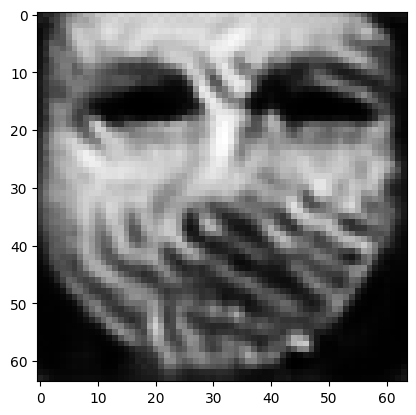

tensor([[5.0706e-05, 6.9084e-06, 1.4032e-03, 2.7580e-06, 4.3404e-05, 9.9274e-01,
         7.1579e-04, 1.5053e-03, 3.6139e-07, 3.3291e-05, 6.0822e-05, 6.0749e-05,
         7.7286e-06, 3.1962e-08, 8.1970e-09, 1.2156e-04, 1.3587e-04, 1.3879e-04,
         4.3114e-06, 6.3655e-04, 7.7479e-07, 7.5957e-07, 4.9698e-09, 5.8700e-07,
         8.3958e-07, 1.0744e-07, 4.0532e-04, 7.1745e-05, 3.2948e-04, 2.1770e-07,
         1.1532e-07, 2.4769e-06, 1.9780e-04, 9.0810e-06, 1.5357e-05, 9.4879e-08,
         2.3920e-06, 3.6293e-06, 5.5074e-06, 1.2859e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0072868759743869305
tensor([[5.0216e-05, 6.7959e-06, 1.3876e-03, 2.7126e-06, 4.2761e-05, 9.9285e-01,
         7.0495e-04, 1.4850e-03, 3.5236e-07, 3.2573e-05, 6.0146e-05, 5.9889e-05,
         7.5792e-06, 3.1326e-08, 8.0165e-09, 1.2072e-04, 1.3478e-04, 1.3681e-04,
         4.2380e-06, 6.2395e-04, 7.6269e-07, 7.4477e-07, 4.8734e-09, 5.8103e-07,
         8.2425e-07, 1.0518e-07, 3.9833e

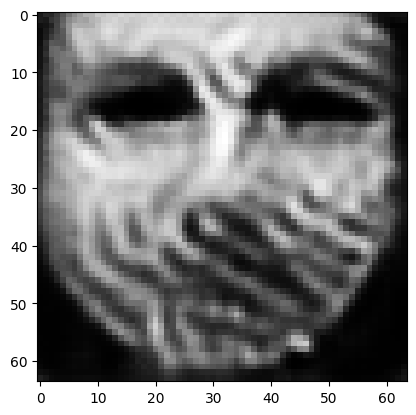

tensor([[4.8227e-05, 6.4059e-06, 1.3325e-03, 2.5551e-06, 4.0394e-05, 9.9323e-01,
         6.6310e-04, 1.4068e-03, 3.2370e-07, 3.0209e-05, 5.7694e-05, 5.6964e-05,
         7.0710e-06, 2.9016e-08, 7.3567e-09, 1.1730e-04, 1.2986e-04, 1.2924e-04,
         3.9769e-06, 5.7971e-04, 7.1967e-07, 6.9322e-07, 4.5310e-09, 5.5431e-07,
         7.6604e-07, 9.7395e-08, 3.7522e-04, 6.6829e-05, 3.0145e-04, 1.9861e-07,
         1.0479e-07, 2.2469e-06, 1.7892e-04, 8.0738e-06, 1.4476e-05, 8.5666e-08,
         2.2338e-06, 3.2953e-06, 4.8825e-06, 1.2001e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006796339061111212
tensor([[4.7801e-05, 6.3212e-06, 1.3202e-03, 2.5214e-06, 3.9882e-05, 9.9331e-01,
         6.5425e-04, 1.3898e-03, 3.1743e-07, 2.9687e-05, 5.7158e-05, 5.6308e-05,
         6.9609e-06, 2.8528e-08, 7.2179e-09, 1.1655e-04, 1.2884e-04, 1.2763e-04,
         3.9209e-06, 5.7013e-04, 7.1028e-07, 6.8185e-07, 4.4576e-09, 5.4871e-07,
         7.5365e-07, 9.5708e-08, 3.7009e-

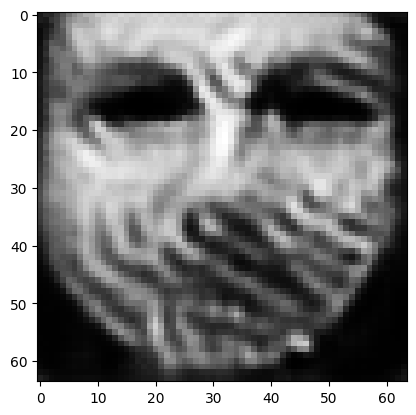

tensor([[4.6185e-05, 6.0124e-06, 1.2760e-03, 2.3970e-06, 3.7987e-05, 9.9361e-01,
         6.2219e-04, 1.3268e-03, 2.9618e-07, 2.7917e-05, 5.5221e-05, 5.4090e-05,
         6.5609e-06, 2.6739e-08, 6.7100e-09, 1.1391e-04, 1.2451e-04, 1.2177e-04,
         3.7160e-06, 5.3633e-04, 6.7656e-07, 6.4277e-07, 4.1869e-09, 5.2606e-07,
         7.0640e-07, 8.9526e-08, 3.5291e-04, 6.2992e-05, 2.7916e-04, 1.8380e-07,
         9.6714e-08, 2.0709e-06, 1.6476e-04, 7.3192e-06, 1.3770e-05, 7.8583e-08,
         2.1028e-06, 3.0393e-06, 4.4116e-06, 1.1365e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006414538715034723
tensor([[4.5793e-05, 5.9347e-06, 1.2654e-03, 2.3655e-06, 3.7502e-05, 9.9368e-01,
         6.1467e-04, 1.3122e-03, 2.9110e-07, 2.7517e-05, 5.4754e-05, 5.3579e-05,
         6.4589e-06, 2.6285e-08, 6.5828e-09, 1.1330e-04, 1.2338e-04, 1.2027e-04,
         3.6672e-06, 5.2832e-04, 6.6805e-07, 6.3395e-07, 4.1170e-09, 5.2028e-07,
         6.9430e-07, 8.8039e-08, 3.4897e-

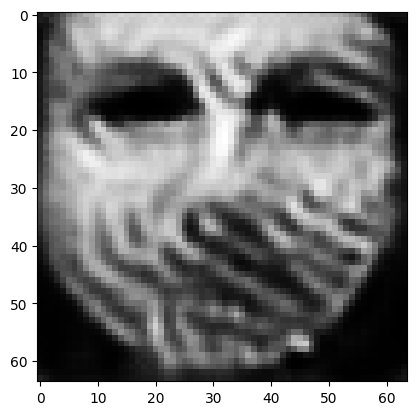

tensor([[4.4347e-05, 5.6539e-06, 1.2261e-03, 2.2504e-06, 3.5726e-05, 9.9393e-01,
         5.8678e-04, 1.2592e-03, 2.7268e-07, 2.6060e-05, 5.2997e-05, 5.1664e-05,
         6.0895e-06, 2.4634e-08, 6.1275e-09, 1.1097e-04, 1.1915e-04, 1.1473e-04,
         3.4894e-06, 4.9908e-04, 6.3699e-07, 6.0137e-07, 3.8638e-09, 4.9911e-07,
         6.5054e-07, 8.2692e-08, 3.3415e-04, 5.9513e-05, 2.6024e-04, 1.7068e-07,
         8.9634e-08, 1.9155e-06, 1.5291e-04, 6.6875e-06, 1.3105e-05, 7.2265e-08,
         1.9797e-06, 2.8197e-06, 4.0132e-06, 1.0849e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0060881637036800385
tensor([[4.4027e-05, 5.5911e-06, 1.2170e-03, 2.2245e-06, 3.5328e-05, 9.9399e-01,
         5.8051e-04, 1.2472e-03, 2.6848e-07, 2.5724e-05, 5.2597e-05, 5.1222e-05,
         6.0062e-06, 2.4270e-08, 6.0276e-09, 1.1044e-04, 1.1822e-04, 1.1350e-04,
         3.4493e-06, 4.9246e-04, 6.3005e-07, 5.9388e-07, 3.8075e-09, 4.9453e-07,
         6.4098e-07, 8.1489e-08, 3.3070e

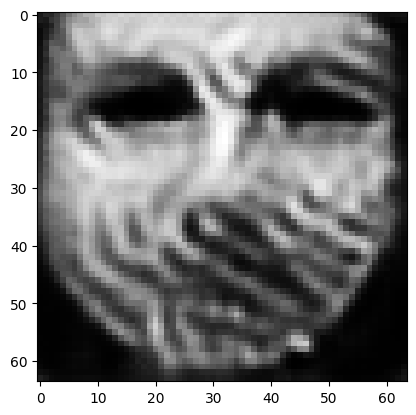

tensor([[4.2881e-05, 5.3648e-06, 1.1835e-03, 2.1313e-06, 3.3906e-05, 9.9420e-01,
         5.5735e-04, 1.2032e-03, 2.5339e-07, 2.4477e-05, 5.1133e-05, 4.9609e-05,
         5.7056e-06, 2.2986e-08, 5.6771e-09, 1.0845e-04, 1.1491e-04, 1.0915e-04,
         3.3029e-06, 4.6835e-04, 6.0522e-07, 5.6667e-07, 3.6048e-09, 4.7840e-07,
         6.0714e-07, 7.7177e-08, 3.1788e-04, 5.6632e-05, 2.4436e-04, 1.5998e-07,
         8.3883e-08, 1.7919e-06, 1.4318e-04, 6.1793e-06, 1.2559e-05, 6.7249e-08,
         1.8805e-06, 2.6405e-06, 3.6925e-06, 1.0382e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00581229105591774
tensor([[4.2615e-05, 5.3119e-06, 1.1758e-03, 2.1097e-06, 3.3581e-05, 9.9425e-01,
         5.5209e-04, 1.1930e-03, 2.4995e-07, 2.4188e-05, 5.0798e-05, 4.9237e-05,
         5.6371e-06, 2.2696e-08, 5.5981e-09, 1.0798e-04, 1.1416e-04, 1.0816e-04,
         3.2690e-06, 4.6286e-04, 5.9955e-07, 5.6045e-07, 3.5585e-09, 4.7478e-07,
         5.9952e-07, 7.6187e-08, 3.1487e-0

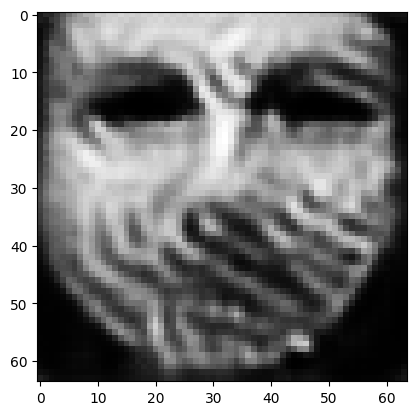

tensor([[4.1625e-05, 5.1169e-06, 1.1477e-03, 2.0300e-06, 3.2382e-05, 9.9444e-01,
         5.3269e-04, 1.1562e-03, 2.3746e-07, 2.3137e-05, 4.9545e-05, 4.7855e-05,
         5.3865e-06, 2.1621e-08, 5.3092e-09, 1.0619e-04, 1.1133e-04, 1.0447e-04,
         3.1443e-06, 4.4275e-04, 5.7863e-07, 5.3763e-07, 3.3884e-09, 4.6126e-07,
         5.7150e-07, 7.2586e-08, 3.0380e-04, 5.4219e-05, 2.3100e-04, 1.5101e-07,
         7.9069e-08, 1.6892e-06, 1.3506e-04, 5.7596e-06, 1.2091e-05, 6.3074e-08,
         1.7968e-06, 2.4904e-06, 3.4319e-06, 9.9759e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00557878240942955
tensor([[4.1388e-05, 5.0710e-06, 1.1412e-03, 2.0111e-06, 3.2098e-05, 9.9448e-01,
         5.2818e-04, 1.1477e-03, 2.3459e-07, 2.2898e-05, 4.9252e-05, 4.7533e-05,
         5.3275e-06, 2.1369e-08, 5.2418e-09, 1.0577e-04, 1.1065e-04, 1.0360e-04,
         3.1154e-06, 4.3812e-04, 5.7368e-07, 5.3236e-07, 3.3484e-09, 4.5799e-07,
         5.6486e-07, 7.1753e-08, 3.0124e-0

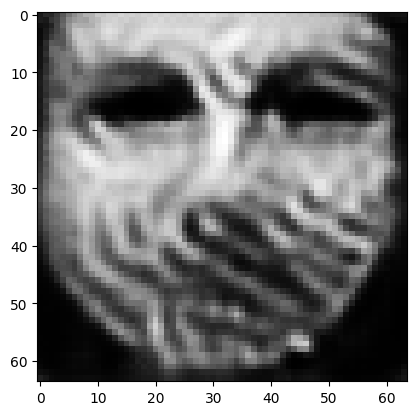

tensor([[4.0485e-05, 4.8941e-06, 1.1161e-03, 1.9360e-06, 3.1029e-05, 9.9464e-01,
         5.1174e-04, 1.1165e-03, 2.2356e-07, 2.1986e-05, 4.8183e-05, 4.6332e-05,
         5.1006e-06, 2.0412e-08, 4.9924e-09, 1.0421e-04, 1.0802e-04, 1.0038e-04,
         3.0060e-06, 4.2109e-04, 5.5503e-07, 5.1305e-07, 3.1930e-09, 4.4620e-07,
         5.3972e-07, 6.8580e-08, 2.9148e-04, 5.2141e-05, 2.1936e-04, 1.4306e-07,
         7.4842e-08, 1.6009e-06, 1.2808e-04, 5.4050e-06, 1.1654e-05, 5.9434e-08,
         1.7218e-06, 2.3607e-06, 3.2098e-06, 9.6133e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005376284942030907
tensor([[4.0277e-05, 4.8536e-06, 1.1100e-03, 1.9189e-06, 3.0786e-05, 9.9468e-01,
         5.0795e-04, 1.1095e-03, 2.2098e-07, 2.1767e-05, 4.7939e-05, 4.6045e-05,
         5.0497e-06, 2.0196e-08, 4.9376e-09, 1.0384e-04, 1.0745e-04, 9.9657e-05,
         2.9812e-06, 4.1716e-04, 5.5086e-07, 5.0843e-07, 3.1585e-09, 4.4357e-07,
         5.3412e-07, 6.7850e-08, 2.8914e-

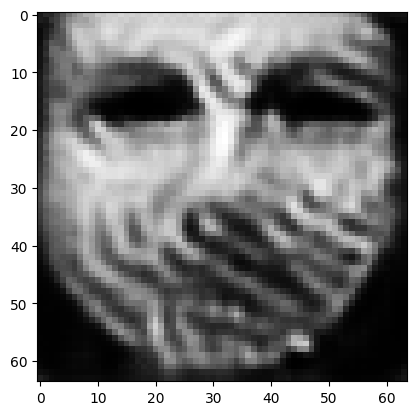

tensor([[3.9453e-05, 4.7023e-06, 1.0872e-03, 1.8542e-06, 2.9857e-05, 9.9481e-01,
         4.9348e-04, 1.0826e-03, 2.1174e-07, 2.0981e-05, 4.7023e-05, 4.4987e-05,
         4.8593e-06, 1.9384e-08, 4.7320e-09, 1.0237e-04, 1.0510e-04, 9.6865e-05,
         2.8887e-06, 4.0272e-04, 5.3504e-07, 4.9141e-07, 3.0281e-09, 4.3287e-07,
         5.1249e-07, 6.5139e-08, 2.8071e-04, 5.0330e-05, 2.0919e-04, 1.3626e-07,
         7.1256e-08, 1.5252e-06, 1.2197e-04, 5.1084e-06, 1.1260e-05, 5.6320e-08,
         1.6553e-06, 2.2472e-06, 3.0197e-06, 9.2898e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005199007224291563
tensor([[3.9256e-05, 4.6666e-06, 1.0818e-03, 1.8389e-06, 2.9636e-05, 9.9485e-01,
         4.9005e-04, 1.0763e-03, 2.0959e-07, 2.0798e-05, 4.6805e-05, 4.4735e-05,
         4.8143e-06, 1.9193e-08, 4.6837e-09, 1.0201e-04, 1.0453e-04, 9.6200e-05,
         2.8669e-06, 3.9934e-04, 5.3125e-07, 4.8740e-07, 2.9972e-09, 4.3029e-07,
         5.0737e-07, 6.4502e-08, 2.7873e-

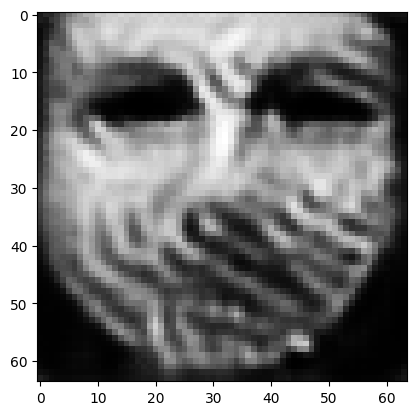

tensor([[3.8486e-05, 4.5289e-06, 1.0611e-03, 1.7805e-06, 2.8805e-05, 9.9497e-01,
         4.7690e-04, 1.0520e-03, 2.0155e-07, 2.0106e-05, 4.5961e-05, 4.3770e-05,
         4.6435e-06, 1.8472e-08, 4.4989e-09, 1.0063e-04, 1.0232e-04, 9.3638e-05,
         2.7826e-06, 3.8647e-04, 5.1668e-07, 4.7244e-07, 2.8810e-09, 4.2033e-07,
         4.8821e-07, 6.2108e-08, 2.7127e-04, 4.8716e-05, 2.0014e-04, 1.3022e-07,
         6.8141e-08, 1.4571e-06, 1.1664e-04, 4.8500e-06, 1.0902e-05, 5.3554e-08,
         1.5946e-06, 2.1471e-06, 2.8556e-06, 9.0105e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005040675401687622
tensor([[3.8309e-05, 4.4970e-06, 1.0563e-03, 1.7672e-06, 2.8612e-05, 9.9500e-01,
         4.7384e-04, 1.0462e-03, 1.9968e-07, 1.9945e-05, 4.5762e-05, 4.3543e-05,
         4.6042e-06, 1.8306e-08, 4.4562e-09, 1.0030e-04, 1.0182e-04, 9.3042e-05,
         2.7631e-06, 3.8346e-04, 5.1329e-07, 4.6894e-07, 2.8544e-09, 4.1801e-07,
         4.8380e-07, 6.1553e-08, 2.6954e-

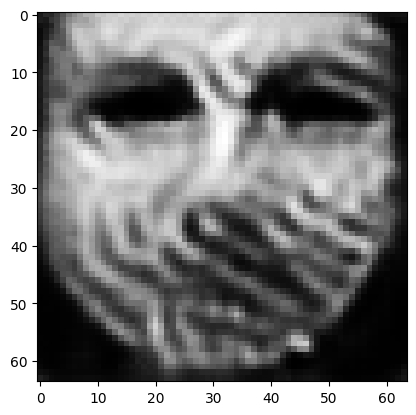

tensor([[3.7617e-05, 4.3755e-06, 1.0376e-03, 1.7157e-06, 2.7869e-05, 9.9511e-01,
         4.6217e-04, 1.0238e-03, 1.9260e-07, 1.9329e-05, 4.5012e-05, 4.2686e-05,
         4.4543e-06, 1.7682e-08, 4.2944e-09, 9.9090e-05, 9.9872e-05, 9.0767e-05,
         2.6894e-06, 3.7209e-04, 5.0048e-07, 4.5573e-07, 2.7538e-09, 4.0910e-07,
         4.6699e-07, 5.9439e-08, 2.6299e-04, 4.7271e-05, 1.9219e-04, 1.2493e-07,
         6.5433e-08, 1.3973e-06, 1.1198e-04, 4.6245e-06, 1.0585e-05, 5.1150e-08,
         1.5413e-06, 2.0596e-06, 2.7132e-06, 8.7639e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004899163730442524
tensor([[3.7451e-05, 4.3466e-06, 1.0332e-03, 1.7037e-06, 2.7692e-05, 9.9514e-01,
         4.5940e-04, 1.0185e-03, 1.9092e-07, 1.9183e-05, 4.4830e-05, 4.2481e-05,
         4.4189e-06, 1.7534e-08, 4.2558e-09, 9.8798e-05, 9.9411e-05, 9.0221e-05,
         2.6718e-06, 3.6937e-04, 4.9743e-07, 4.5256e-07, 2.7301e-09, 4.0696e-07,
         4.6303e-07, 5.8940e-08, 2.6143e-

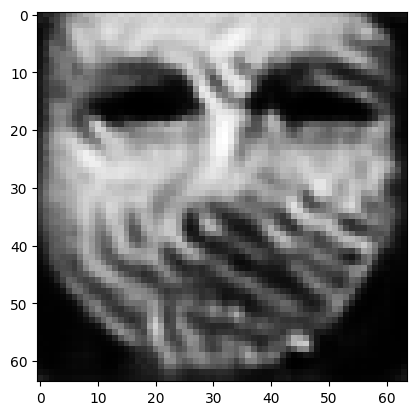

tensor([[3.6819e-05, 4.2376e-06, 1.0162e-03, 1.6573e-06, 2.7016e-05, 9.9524e-01,
         4.4891e-04, 9.9809e-04, 1.8458e-07, 1.8632e-05, 4.4140e-05, 4.1718e-05,
         4.2836e-06, 1.6970e-08, 4.1108e-09, 9.7691e-05, 9.7610e-05, 8.8156e-05,
         2.6057e-06, 3.5910e-04, 4.8584e-07, 4.4063e-07, 2.6401e-09, 3.9874e-07,
         4.4785e-07, 5.7045e-08, 2.5559e-04, 4.5958e-05, 1.8514e-04, 1.2017e-07,
         6.2975e-08, 1.3438e-06, 1.0777e-04, 4.4244e-06, 1.0300e-05, 4.9000e-08,
         1.4928e-06, 1.9808e-06, 2.5863e-06, 8.5435e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004771513398736715
tensor([[3.6670e-05, 4.2122e-06, 1.0121e-03, 1.6463e-06, 2.6861e-05, 9.9526e-01,
         4.4649e-04, 9.9323e-04, 1.8311e-07, 1.8501e-05, 4.3980e-05, 4.1546e-05,
         4.2523e-06, 1.6841e-08, 4.0780e-09, 9.7435e-05, 9.7191e-05, 8.7685e-05,
         2.5901e-06, 3.5670e-04, 4.8323e-07, 4.3785e-07, 2.6196e-09, 3.9690e-07,
         4.4437e-07, 5.6603e-08, 2.5422e-

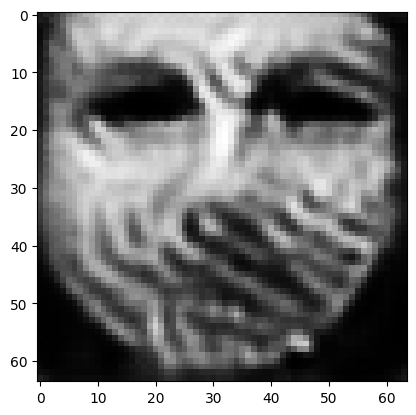

tensor([[3.6102e-05, 4.1132e-06, 9.9628e-04, 1.6032e-06, 2.6253e-05, 9.9535e-01,
         4.3741e-04, 9.7533e-04, 1.7738e-07, 1.8003e-05, 4.3364e-05, 4.0871e-05,
         4.1282e-06, 1.6340e-08, 3.9513e-09, 9.6456e-05, 9.5564e-05, 8.5852e-05,
         2.5303e-06, 3.4755e-04, 4.7276e-07, 4.2716e-07, 2.5384e-09, 3.8977e-07,
         4.3067e-07, 5.4895e-08, 2.4894e-04, 4.4765e-05, 1.7885e-04, 1.1590e-07,
         6.0724e-08, 1.2979e-06, 1.0402e-04, 4.2493e-06, 1.0041e-05, 4.7110e-08,
         1.4492e-06, 1.9095e-06, 2.4736e-06, 8.3380e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0046563055366277695
tensor([[3.5972e-05, 4.0896e-06, 9.9253e-04, 1.5931e-06, 2.6112e-05, 9.9538e-01,
         4.3531e-04, 9.7122e-04, 1.7602e-07, 1.7883e-05, 4.3218e-05, 4.0711e-05,
         4.0989e-06, 1.6222e-08, 3.9215e-09, 9.6226e-05, 9.5195e-05, 8.5425e-05,
         2.5162e-06, 3.4539e-04, 4.7029e-07, 4.2465e-07, 2.5195e-09, 3.8815e-07,
         4.2751e-07, 5.4494e-08, 2.4766e

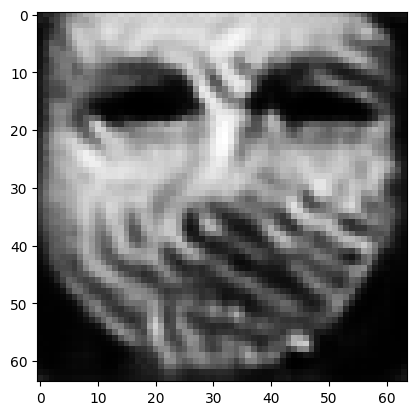

tensor([[3.5483e-05, 4.0006e-06, 9.7826e-04, 1.5551e-06, 2.5584e-05, 9.9546e-01,
         4.2743e-04, 9.5563e-04, 1.7087e-07, 1.7430e-05, 4.2674e-05, 4.0103e-05,
         3.9890e-06, 1.5787e-08, 3.8111e-09, 9.5365e-05, 9.3824e-05, 8.3832e-05,
         2.4627e-06, 3.3722e-04, 4.6111e-07, 4.1521e-07, 2.4488e-09, 3.8226e-07,
         4.1583e-07, 5.2991e-08, 2.4279e-04, 4.3708e-05, 1.7323e-04, 1.1207e-07,
         5.8688e-08, 1.2580e-06, 1.0070e-04, 4.0941e-06, 9.8050e-06, 4.5465e-08,
         1.4110e-06, 1.8465e-06, 2.3740e-06, 8.1446e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004552951082587242
tensor([[3.5367e-05, 3.9795e-06, 9.7489e-04, 1.5461e-06, 2.5459e-05, 9.9548e-01,
         4.2558e-04, 9.5193e-04, 1.6966e-07, 1.7324e-05, 4.2549e-05, 3.9961e-05,
         3.9631e-06, 1.5685e-08, 3.7851e-09, 9.5162e-05, 9.3497e-05, 8.3455e-05,
         2.4501e-06, 3.3531e-04, 4.5895e-07, 4.1302e-07, 2.4322e-09, 3.8088e-07,
         4.1308e-07, 5.2639e-08, 2.4164e-

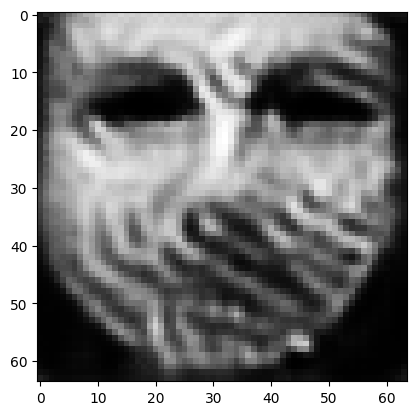

tensor([[3.4911e-05, 3.9006e-06, 9.6219e-04, 1.5116e-06, 2.4985e-05, 9.9555e-01,
         4.1854e-04, 9.3732e-04, 1.6525e-07, 1.6934e-05, 4.2067e-05, 3.9454e-05,
         3.8655e-06, 1.5296e-08, 3.6864e-09, 9.4400e-05, 9.2176e-05, 8.2022e-05,
         2.4024e-06, 3.2820e-04, 4.5084e-07, 4.0489e-07, 2.3694e-09, 3.7531e-07,
         4.0239e-07, 5.1305e-08, 2.3755e-04, 4.2751e-05, 1.6827e-04, 1.0869e-07,
         5.6901e-08, 1.2230e-06, 9.7829e-05, 3.9590e-06, 9.5942e-06, 4.4021e-08,
         1.3764e-06, 1.7913e-06, 2.2880e-06, 7.9794e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004461335483938456
tensor([[3.4799e-05, 3.8821e-06, 9.5918e-04, 1.5034e-06, 2.4872e-05, 9.9557e-01,
         4.1687e-04, 9.3372e-04, 1.6424e-07, 1.6844e-05, 4.1953e-05, 3.9341e-05,
         3.8423e-06, 1.5203e-08, 3.6628e-09, 9.4221e-05, 9.1843e-05, 8.1681e-05,
         2.3911e-06, 3.2652e-04, 4.4894e-07, 4.0300e-07, 2.3545e-09, 3.7391e-07,
         3.9980e-07, 5.0991e-08, 2.3663e-

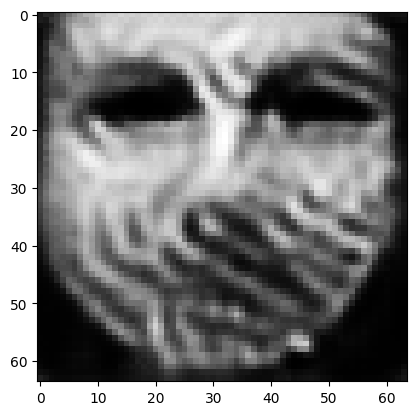

tensor([[3.4385e-05, 3.8126e-06, 9.4757e-04, 1.4726e-06, 2.4444e-05, 9.9563e-01,
         4.1052e-04, 9.2003e-04, 1.6040e-07, 1.6500e-05, 4.1522e-05, 3.8907e-05,
         3.7552e-06, 1.4857e-08, 3.5754e-09, 9.3559e-05, 9.0600e-05, 8.0413e-05,
         2.3484e-06, 3.2020e-04, 4.4174e-07, 3.9575e-07, 2.2983e-09, 3.6871e-07,
         3.9012e-07, 4.9795e-08, 2.3315e-04, 4.1881e-05, 1.6391e-04, 1.0570e-07,
         5.5315e-08, 1.1920e-06, 9.5297e-05, 3.8398e-06, 9.4091e-06, 4.2750e-08,
         1.3452e-06, 1.7426e-06, 2.2122e-06, 7.8395e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004379443824291229
tensor([[3.4287e-05, 3.7965e-06, 9.4480e-04, 1.4655e-06, 2.4344e-05, 9.9565e-01,
         4.0902e-04, 9.1673e-04, 1.5950e-07, 1.6418e-05, 4.1420e-05, 3.8805e-05,
         3.7350e-06, 1.4777e-08, 3.5553e-09, 9.3405e-05, 9.0305e-05, 8.0120e-05,
         2.3384e-06, 3.1871e-04, 4.4007e-07, 3.9403e-07, 2.2853e-09, 3.6749e-07,
         3.8787e-07, 4.9513e-08, 2.3234e-

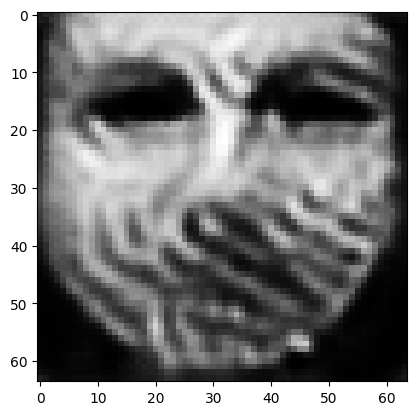

tensor([[3.3912e-05, 3.7348e-06, 9.3417e-04, 1.4382e-06, 2.3960e-05, 9.9570e-01,
         4.0322e-04, 9.0406e-04, 1.5612e-07, 1.6108e-05, 4.1022e-05, 3.8414e-05,
         3.6578e-06, 1.4469e-08, 3.4785e-09, 9.2795e-05, 8.9169e-05, 7.8994e-05,
         2.2999e-06, 3.1303e-04, 4.3362e-07, 3.8743e-07, 2.2354e-09, 3.6272e-07,
         3.7923e-07, 4.8436e-08, 2.2924e-04, 4.1096e-05, 1.5998e-04, 1.0306e-07,
         5.3902e-08, 1.1644e-06, 9.3013e-05, 3.7334e-06, 9.2453e-06, 4.1623e-08,
         1.3170e-06, 1.6988e-06, 2.1445e-06, 7.7131e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004305141977965832
tensor([[3.3822e-05, 3.7198e-06, 9.3160e-04, 1.4316e-06, 2.3866e-05, 9.9572e-01,
         4.0185e-04, 9.0106e-04, 1.5530e-07, 1.6034e-05, 4.0927e-05, 3.8320e-05,
         3.6392e-06, 1.4395e-08, 3.4601e-09, 9.2647e-05, 8.8894e-05, 7.8723e-05,
         2.2906e-06, 3.1169e-04, 4.3204e-07, 3.8584e-07, 2.2233e-09, 3.6157e-07,
         3.7716e-07, 4.8176e-08, 2.2849e-

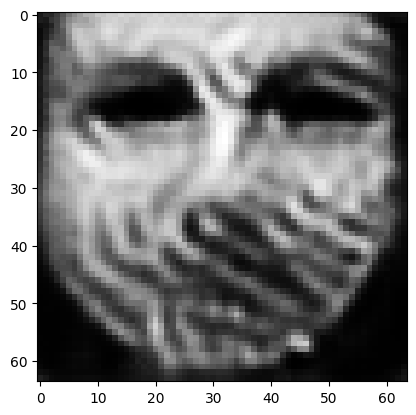

tensor([[3.3481e-05, 3.6619e-06, 9.2164e-04, 1.4061e-06, 2.3509e-05, 9.9577e-01,
         3.9661e-04, 8.8964e-04, 1.5210e-07, 1.5743e-05, 4.0557e-05, 3.7944e-05,
         3.5667e-06, 1.4111e-08, 3.3904e-09, 9.2082e-05, 8.7867e-05, 7.7694e-05,
         2.2551e-06, 3.0643e-04, 4.2599e-07, 3.7961e-07, 2.1768e-09, 3.5730e-07,
         3.6927e-07, 4.7174e-08, 2.2552e-04, 4.0375e-05, 1.5634e-04, 1.0061e-07,
         5.2580e-08, 1.1389e-06, 9.0886e-05, 3.6356e-06, 9.0910e-06, 4.0578e-08,
         1.2910e-06, 1.6581e-06, 2.0817e-06, 7.5911e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0042360578663647175
tensor([[3.3403e-05, 3.6482e-06, 9.1928e-04, 1.4002e-06, 2.3424e-05, 9.9579e-01,
         3.9538e-04, 8.8696e-04, 1.5135e-07, 1.5674e-05, 4.0471e-05, 3.7857e-05,
         3.5498e-06, 1.4045e-08, 3.3741e-09, 9.1951e-05, 8.7634e-05, 7.7457e-05,
         2.2469e-06, 3.0520e-04, 4.2460e-07, 3.7814e-07, 2.1660e-09, 3.5631e-07,
         3.6743e-07, 4.6936e-08, 2.2480e

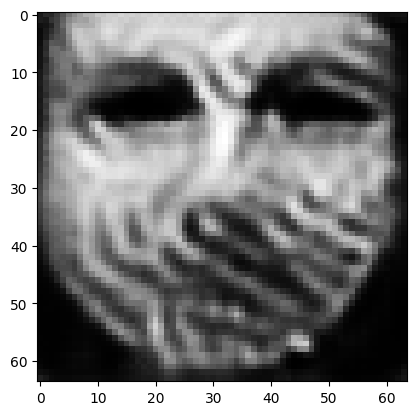

tensor([[3.3107e-05, 3.5983e-06, 9.1029e-04, 1.3795e-06, 2.3106e-05, 9.9583e-01,
         3.9049e-04, 8.7668e-04, 1.4857e-07, 1.5415e-05, 4.0125e-05, 3.7513e-05,
         3.4896e-06, 1.3793e-08, 3.3113e-09, 9.1429e-05, 8.6786e-05, 7.6522e-05,
         2.2167e-06, 3.0047e-04, 4.1938e-07, 3.7243e-07, 2.1272e-09, 3.5241e-07,
         3.6056e-07, 4.6066e-08, 2.2205e-04, 3.9720e-05, 1.5311e-04, 9.8486e-08,
         5.1422e-08, 1.1160e-06, 8.8977e-05, 3.5483e-06, 8.9549e-06, 3.9645e-08,
         1.2681e-06, 1.6213e-06, 2.0262e-06, 7.4836e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004173973109573126
tensor([[3.3034e-05, 3.5860e-06, 9.0806e-04, 1.3743e-06, 2.3028e-05, 9.9585e-01,
         3.8930e-04, 8.7425e-04, 1.4788e-07, 1.5352e-05, 4.0038e-05, 3.7426e-05,
         3.4745e-06, 1.3731e-08, 3.2958e-09, 9.1298e-05, 8.6574e-05, 7.6288e-05,
         2.2092e-06, 2.9930e-04, 4.1806e-07, 3.7103e-07, 2.1173e-09, 3.5146e-07,
         3.5886e-07, 4.5850e-08, 2.2137e-

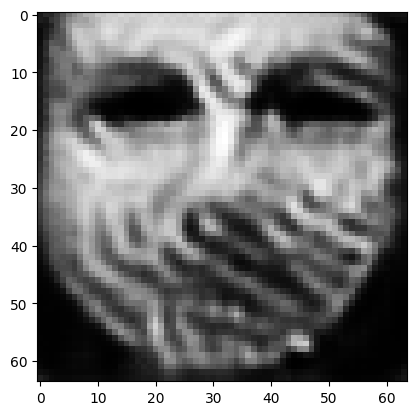

tensor([[3.2745e-05, 3.5401e-06, 8.9964e-04, 1.3547e-06, 2.2725e-05, 9.9589e-01,
         3.8465e-04, 8.6464e-04, 1.4544e-07, 1.5122e-05, 3.9710e-05, 3.7116e-05,
         3.4182e-06, 1.3490e-08, 3.2354e-09, 9.0784e-05, 8.5698e-05, 7.5358e-05,
         2.1806e-06, 2.9491e-04, 4.1297e-07, 3.6575e-07, 2.0797e-09, 3.4741e-07,
         3.5213e-07, 4.5044e-08, 2.1891e-04, 3.9100e-05, 1.5010e-04, 9.6538e-08,
         5.0362e-08, 1.0940e-06, 8.7219e-05, 3.4679e-06, 8.8260e-06, 3.8753e-08,
         1.2456e-06, 1.5869e-06, 1.9756e-06, 7.3912e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004116514697670937
tensor([[3.2673e-05, 3.5295e-06, 8.9764e-04, 1.3501e-06, 2.2652e-05, 9.9590e-01,
         3.8351e-04, 8.6224e-04, 1.4491e-07, 1.5069e-05, 3.9633e-05, 3.7046e-05,
         3.4050e-06, 1.3433e-08, 3.2209e-09, 9.0658e-05, 8.5473e-05, 7.5130e-05,
         2.1738e-06, 2.9389e-04, 4.1176e-07, 3.6450e-07, 2.0708e-09, 3.4636e-07,
         3.5048e-07, 4.4854e-08, 2.1836e-

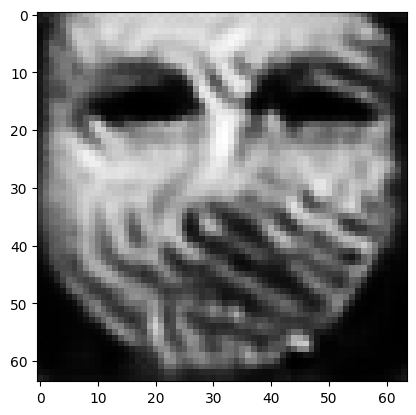

tensor([[3.2396e-05, 3.4879e-06, 8.8998e-04, 1.3320e-06, 2.2371e-05, 9.9594e-01,
         3.7917e-04, 8.5314e-04, 1.4278e-07, 1.4864e-05, 3.9338e-05, 3.6774e-05,
         3.3536e-06, 1.3213e-08, 3.1648e-09, 9.0179e-05, 8.4618e-05, 7.4254e-05,
         2.1475e-06, 2.8990e-04, 4.0707e-07, 3.5974e-07, 2.0361e-09, 3.4240e-07,
         3.4414e-07, 4.4122e-08, 2.1622e-04, 3.8524e-05, 1.4738e-04, 9.4794e-08,
         4.9426e-08, 1.0736e-06, 8.5665e-05, 3.3957e-06, 8.7081e-06, 3.7935e-08,
         1.2244e-06, 1.5557e-06, 1.9309e-06, 7.3164e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0040646325796842575
tensor([[3.2329e-05, 3.4779e-06, 8.8812e-04, 1.3276e-06, 2.2303e-05, 9.9595e-01,
         3.7813e-04, 8.5095e-04, 1.4226e-07, 1.4814e-05, 3.9268e-05, 3.6709e-05,
         3.3411e-06, 1.3161e-08, 3.1514e-09, 9.0069e-05, 8.4417e-05, 7.4043e-05,
         2.1413e-06, 2.8894e-04, 4.0594e-07, 3.5860e-07, 2.0278e-09, 3.4148e-07,
         3.4261e-07, 4.3946e-08, 2.1569e

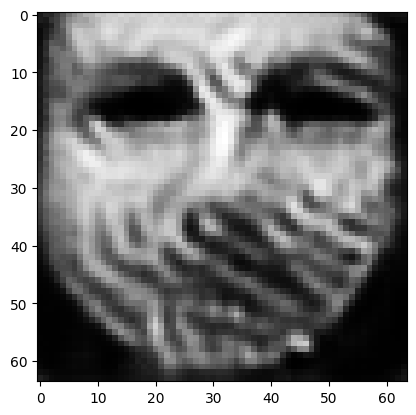

tensor([[3.2081e-05, 3.4394e-06, 8.8094e-04, 1.3110e-06, 2.2042e-05, 9.9599e-01,
         3.7421e-04, 8.4266e-04, 1.4023e-07, 1.4620e-05, 3.9000e-05, 3.6453e-05,
         3.2935e-06, 1.2961e-08, 3.1003e-09, 8.9663e-05, 8.3664e-05, 7.3238e-05,
         2.1173e-06, 2.8522e-04, 4.0169e-07, 3.5419e-07, 1.9961e-09, 3.3805e-07,
         3.3686e-07, 4.3274e-08, 2.1364e-04, 3.7992e-05, 1.4486e-04, 9.3173e-08,
         4.8561e-08, 1.0551e-06, 8.4218e-05, 3.3290e-06, 8.5977e-06, 3.7187e-08,
         1.2055e-06, 1.5272e-06, 1.8893e-06, 7.2427e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00401642918586731
tensor([[3.2022e-05, 3.4302e-06, 8.7918e-04, 1.3071e-06, 2.1979e-05, 9.9600e-01,
         3.7328e-04, 8.4067e-04, 1.3973e-07, 1.4573e-05, 3.8935e-05, 3.6391e-05,
         3.2820e-06, 1.2913e-08, 3.0881e-09, 8.9569e-05, 8.3483e-05, 7.3046e-05,
         2.1116e-06, 2.8433e-04, 4.0067e-07, 3.5312e-07, 1.9886e-09, 3.3723e-07,
         3.3548e-07, 4.3112e-08, 2.1315e-0

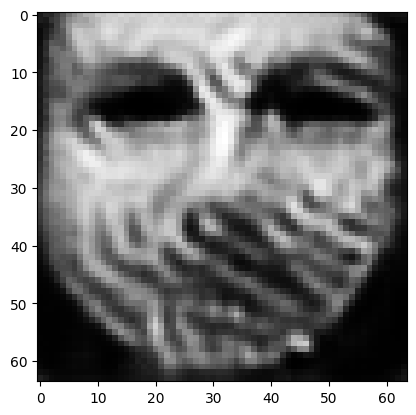

tensor([[3.1791e-05, 3.3941e-06, 8.7241e-04, 1.2917e-06, 2.1736e-05, 9.9604e-01,
         3.6967e-04, 8.3301e-04, 1.3784e-07, 1.4392e-05, 3.8681e-05, 3.6153e-05,
         3.2376e-06, 1.2725e-08, 3.0405e-09, 8.9194e-05, 8.2777e-05, 7.2293e-05,
         2.0893e-06, 2.8085e-04, 3.9671e-07, 3.4900e-07, 1.9591e-09, 3.3405e-07,
         3.3015e-07, 4.2489e-08, 2.1124e-04, 3.7499e-05, 1.4254e-04, 9.1657e-08,
         4.7752e-08, 1.0380e-06, 8.2865e-05, 3.2669e-06, 8.4947e-06, 3.6495e-08,
         1.1880e-06, 1.5006e-06, 1.8505e-06, 7.1733e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003971547354012728
tensor([[3.1735e-05, 3.3853e-06, 8.7077e-04, 1.2880e-06, 2.1677e-05, 9.9605e-01,
         3.6880e-04, 8.3117e-04, 1.3738e-07, 1.4349e-05, 3.8618e-05, 3.6095e-05,
         3.2269e-06, 1.2680e-08, 3.0289e-09, 8.9102e-05, 8.2606e-05, 7.2108e-05,
         2.0838e-06, 2.8000e-04, 3.9574e-07, 3.4800e-07, 1.9520e-09, 3.3328e-07,
         3.2886e-07, 4.2339e-08, 2.1077e-

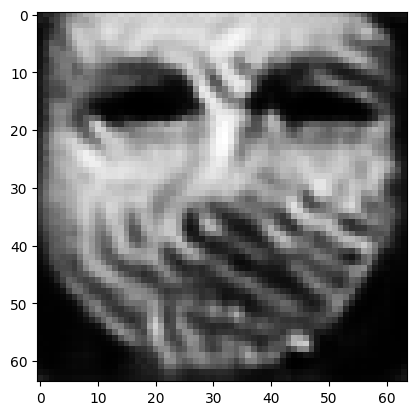

tensor([[3.1521e-05, 3.3523e-06, 8.6449e-04, 1.2739e-06, 2.1453e-05, 9.9608e-01,
         3.6548e-04, 8.2409e-04, 1.3563e-07, 1.4182e-05, 3.8380e-05, 3.5872e-05,
         3.1865e-06, 1.2508e-08, 2.9854e-09, 8.8754e-05, 8.1961e-05, 7.1409e-05,
         2.0635e-06, 2.7681e-04, 3.9211e-07, 3.4418e-07, 1.9252e-09, 3.3037e-07,
         3.2400e-07, 4.1772e-08, 2.0900e-04, 3.7042e-05, 1.4042e-04, 9.0271e-08,
         4.7008e-08, 1.0223e-06, 8.1614e-05, 3.2098e-06, 8.4003e-06, 3.5860e-08,
         1.1718e-06, 1.4761e-06, 1.8151e-06, 7.1096e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003929870203137398
tensor([[3.1471e-05, 3.3446e-06, 8.6301e-04, 1.2707e-06, 2.1401e-05, 9.9609e-01,
         3.6470e-04, 8.2242e-04, 1.3522e-07, 1.4142e-05, 3.8323e-05, 3.5819e-05,
         3.1772e-06, 1.2468e-08, 2.9753e-09, 8.8672e-05, 8.1811e-05, 7.1244e-05,
         2.0587e-06, 2.7606e-04, 3.9126e-07, 3.4327e-07, 1.9190e-09, 3.2970e-07,
         3.2288e-07, 4.1641e-08, 2.0857e-

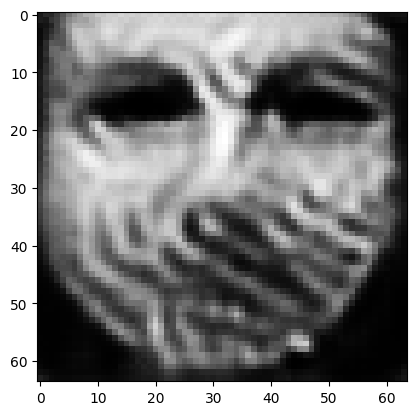

tensor([[3.1276e-05, 3.3145e-06, 8.5724e-04, 1.2580e-06, 2.1195e-05, 9.9612e-01,
         3.6164e-04, 8.1589e-04, 1.3362e-07, 1.3989e-05, 3.8101e-05, 3.5611e-05,
         3.1408e-06, 1.2313e-08, 2.9359e-09, 8.8351e-05, 8.1226e-05, 7.0598e-05,
         2.0402e-06, 2.7313e-04, 3.8795e-07, 3.3977e-07, 1.8949e-09, 3.2706e-07,
         3.1849e-07, 4.1130e-08, 2.0691e-04, 3.6623e-05, 1.3851e-04, 8.9028e-08,
         4.6338e-08, 1.0081e-06, 8.0472e-05, 3.1580e-06, 8.3156e-06, 3.5287e-08,
         1.1572e-06, 1.4539e-06, 1.7830e-06, 7.0511e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003891753265634179
tensor([[3.1229e-05, 3.3073e-06, 8.5585e-04, 1.2550e-06, 2.1146e-05, 9.9612e-01,
         3.6091e-04, 8.1433e-04, 1.3324e-07, 1.3952e-05, 3.8048e-05, 3.5561e-05,
         3.1320e-06, 1.2275e-08, 2.9265e-09, 8.8273e-05, 8.1085e-05, 7.0444e-05,
         2.0357e-06, 2.7243e-04, 3.8716e-07, 3.3892e-07, 1.8891e-09, 3.2643e-07,
         3.1744e-07, 4.1007e-08, 2.0652e-

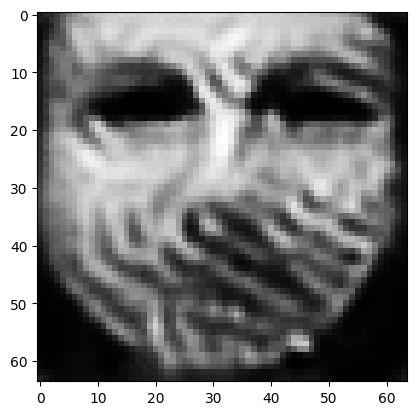

tensor([[3.1047e-05, 3.2793e-06, 8.5040e-04, 1.2432e-06, 2.0954e-05, 9.9615e-01,
         3.5807e-04, 8.0822e-04, 1.3174e-07, 1.3809e-05, 3.7839e-05, 3.5366e-05,
         3.0978e-06, 1.2130e-08, 2.8900e-09, 8.7972e-05, 8.0536e-05, 6.9844e-05,
         2.0184e-06, 2.6969e-04, 3.8403e-07, 3.3563e-07, 1.8665e-09, 3.2396e-07,
         3.1335e-07, 4.0526e-08, 2.0497e-04, 3.6231e-05, 1.3673e-04, 8.7860e-08,
         4.5707e-08, 9.9486e-07, 7.9401e-05, 3.1097e-06, 8.2356e-06, 3.4753e-08,
         1.1434e-06, 1.4330e-06, 1.7530e-06, 6.9957e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003856247290968895
tensor([[3.1003e-05, 3.2725e-06, 8.4906e-04, 1.2403e-06, 2.0907e-05, 9.9616e-01,
         3.5739e-04, 8.0674e-04, 1.3137e-07, 1.3774e-05, 3.7789e-05, 3.5319e-05,
         3.0896e-06, 1.2095e-08, 2.8813e-09, 8.7901e-05, 8.0404e-05, 6.9701e-05,
         2.0142e-06, 2.6903e-04, 3.8328e-07, 3.3483e-07, 1.8610e-09, 3.2336e-07,
         3.1236e-07, 4.0408e-08, 2.0460e-

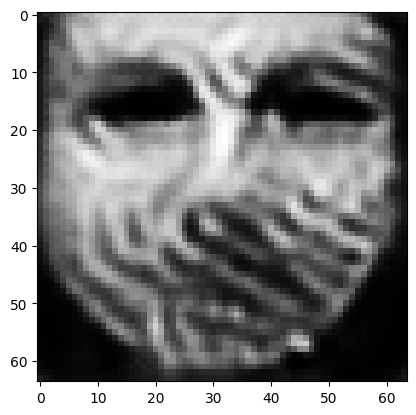

tensor([[3.0834e-05, 3.2462e-06, 8.4390e-04, 1.2291e-06, 2.0727e-05, 9.9618e-01,
         3.5479e-04, 8.0106e-04, 1.2994e-07, 1.3639e-05, 3.7593e-05, 3.5132e-05,
         3.0575e-06, 1.1959e-08, 2.8473e-09, 8.7623e-05, 7.9897e-05, 6.9145e-05,
         1.9981e-06, 2.6647e-04, 3.8034e-07, 3.3170e-07, 1.8398e-09, 3.2109e-07,
         3.0854e-07, 3.9954e-08, 2.0313e-04, 3.5864e-05, 1.3506e-04, 8.6759e-08,
         4.5108e-08, 9.8249e-07, 7.8390e-05, 3.0643e-06, 8.1597e-06, 3.4253e-08,
         1.1307e-06, 1.4134e-06, 1.7248e-06, 6.9421e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003822521772235632
tensor([[3.0792e-05, 3.2399e-06, 8.4261e-04, 1.2264e-06, 2.0683e-05, 9.9619e-01,
         3.5413e-04, 7.9965e-04, 1.2959e-07, 1.3606e-05, 3.7544e-05, 3.5086e-05,
         3.0498e-06, 1.1926e-08, 2.8390e-09, 8.7552e-05, 7.9767e-05, 6.9006e-05,
         1.9941e-06, 2.6583e-04, 3.7962e-07, 3.3092e-07, 1.8346e-09, 3.2051e-07,
         3.0759e-07, 3.9843e-08, 2.0277e-

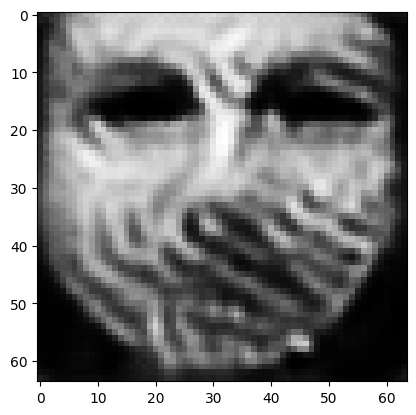

tensor([[3.0629e-05, 3.2156e-06, 8.3768e-04, 1.2161e-06, 2.0512e-05, 9.9622e-01,
         3.5158e-04, 7.9423e-04, 1.2826e-07, 1.3479e-05, 3.7354e-05, 3.4904e-05,
         3.0199e-06, 1.1797e-08, 2.8066e-09, 8.7280e-05, 7.9270e-05, 6.8468e-05,
         1.9788e-06, 2.6339e-04, 3.7680e-07, 3.2794e-07, 1.8147e-09, 3.1829e-07,
         3.0395e-07, 3.9417e-08, 2.0139e-04, 3.5515e-05, 1.3346e-04, 8.5726e-08,
         4.4547e-08, 9.7055e-07, 7.7435e-05, 3.0207e-06, 8.0873e-06, 3.3777e-08,
         1.1183e-06, 1.3947e-06, 1.6983e-06, 6.8926e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037905762437731028
tensor([[3.0589e-05, 3.2098e-06, 8.3650e-04, 1.2136e-06, 2.0471e-05, 9.9622e-01,
         3.5096e-04, 7.9294e-04, 1.2794e-07, 1.3449e-05, 3.7308e-05, 3.4859e-05,
         3.0128e-06, 1.1767e-08, 2.7988e-09, 8.7214e-05, 7.9150e-05, 6.8338e-05,
         1.9751e-06, 2.6282e-04, 3.7612e-07, 3.2724e-07, 1.8099e-09, 3.1775e-07,
         3.0308e-07, 3.9316e-08, 2.0105e

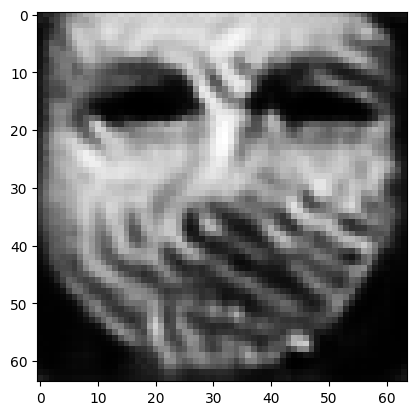

tensor([[3.0436e-05, 3.1870e-06, 8.3190e-04, 1.2039e-06, 2.0312e-05, 9.9625e-01,
         3.4858e-04, 7.8792e-04, 1.2670e-07, 1.3331e-05, 3.7133e-05, 3.4688e-05,
         2.9850e-06, 1.1647e-08, 2.7687e-09, 8.6961e-05, 7.8691e-05, 6.7836e-05,
         1.9607e-06, 2.6057e-04, 3.7350e-07, 3.2447e-07, 1.7912e-09, 3.1569e-07,
         2.9972e-07, 3.8923e-08, 1.9975e-04, 3.5192e-05, 1.3198e-04, 8.4771e-08,
         4.4033e-08, 9.5944e-07, 7.6555e-05, 2.9802e-06, 8.0198e-06, 3.3335e-08,
         1.1069e-06, 1.3776e-06, 1.6738e-06, 6.8461e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003760767402127385
tensor([[3.0401e-05, 3.1815e-06, 8.3076e-04, 1.2015e-06, 2.0273e-05, 9.9625e-01,
         3.4802e-04, 7.8670e-04, 1.2639e-07, 1.3302e-05, 3.7091e-05, 3.4646e-05,
         2.9782e-06, 1.1618e-08, 2.7615e-09, 8.6903e-05, 7.8582e-05, 6.7716e-05,
         1.9573e-06, 2.6001e-04, 3.7286e-07, 3.2379e-07, 1.7867e-09, 3.1521e-07,
         2.9890e-07, 3.8826e-08, 1.9944e-

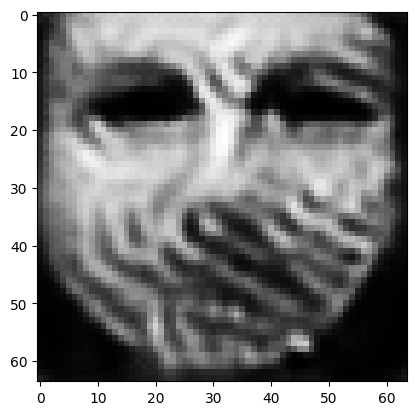

tensor([[3.0257e-05, 3.1599e-06, 8.2639e-04, 1.1924e-06, 2.0122e-05, 9.9627e-01,
         3.4579e-04, 7.8198e-04, 1.2520e-07, 1.3191e-05, 3.6926e-05, 3.4482e-05,
         2.9517e-06, 1.1506e-08, 2.7332e-09, 8.6671e-05, 7.8152e-05, 6.7240e-05,
         1.9438e-06, 2.5789e-04, 3.7037e-07, 3.2118e-07, 1.7690e-09, 3.1328e-07,
         2.9572e-07, 3.8455e-08, 1.9820e-04, 3.4886e-05, 1.3060e-04, 8.3872e-08,
         4.3543e-08, 9.4899e-07, 7.5718e-05, 2.9420e-06, 7.9558e-06, 3.2918e-08,
         1.0962e-06, 1.3614e-06, 1.6504e-06, 6.8013e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003732383018359542
tensor([[3.0223e-05, 3.1547e-06, 8.2533e-04, 1.1902e-06, 2.0086e-05, 9.9628e-01,
         3.4527e-04, 7.8083e-04, 1.2491e-07, 1.3164e-05, 3.6886e-05, 3.4444e-05,
         2.9454e-06, 1.1479e-08, 2.7266e-09, 8.6617e-05, 7.8051e-05, 6.7129e-05,
         1.9407e-06, 2.5738e-04, 3.6979e-07, 3.2054e-07, 1.7648e-09, 3.1283e-07,
         2.9497e-07, 3.8364e-08, 1.9791e-

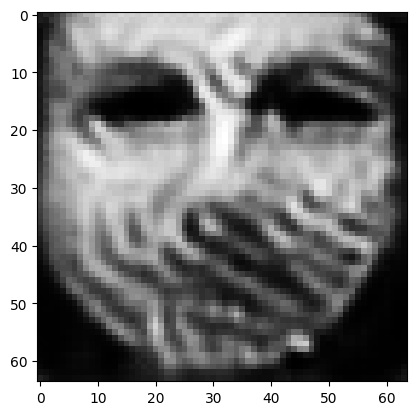

tensor([[3.0089e-05, 3.1345e-06, 8.2129e-04, 1.1817e-06, 1.9946e-05, 9.9630e-01,
         3.4320e-04, 7.7644e-04, 1.2382e-07, 1.3061e-05, 3.6733e-05, 3.4293e-05,
         2.9210e-06, 1.1375e-08, 2.7005e-09, 8.6399e-05, 7.7653e-05, 6.6689e-05,
         1.9281e-06, 2.5542e-04, 3.6749e-07, 3.1813e-07, 1.7485e-09, 3.1105e-07,
         2.9204e-07, 3.8020e-08, 1.9675e-04, 3.4601e-05, 1.2931e-04, 8.3036e-08,
         4.3088e-08, 9.3934e-07, 7.4944e-05, 2.9068e-06, 7.8964e-06, 3.2533e-08,
         1.0862e-06, 1.3464e-06, 1.6290e-06, 6.7593e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0037062542978674173
tensor([[3.0058e-05, 3.1298e-06, 8.2029e-04, 1.1796e-06, 1.9913e-05, 9.9631e-01,
         3.4272e-04, 7.7538e-04, 1.2355e-07, 1.3035e-05, 3.6696e-05, 3.4256e-05,
         2.9151e-06, 1.1351e-08, 2.6944e-09, 8.6349e-05, 7.7561e-05, 6.6587e-05,
         1.9252e-06, 2.5494e-04, 3.6695e-07, 3.1753e-07, 1.7447e-09, 3.1064e-07,
         2.9136e-07, 3.7937e-08, 1.9647e

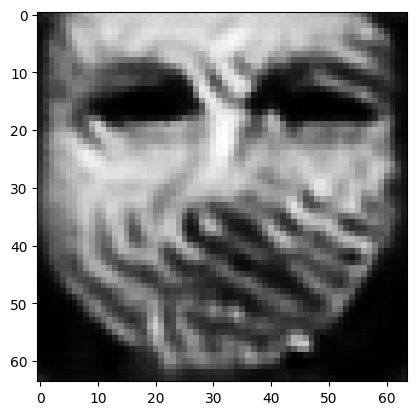

tensor([[2.9933e-05, 3.1109e-06, 8.1647e-04, 1.1717e-06, 1.9783e-05, 9.9633e-01,
         3.4076e-04, 7.7119e-04, 1.2251e-07, 1.2936e-05, 3.6551e-05, 3.4111e-05,
         2.8923e-06, 1.1254e-08, 2.6702e-09, 8.6144e-05, 7.7194e-05, 6.6176e-05,
         1.9134e-06, 2.5308e-04, 3.6480e-07, 3.1523e-07, 1.7296e-09, 3.0900e-07,
         2.8866e-07, 3.7614e-08, 1.9537e-04, 3.4333e-05, 1.2811e-04, 8.2258e-08,
         4.2665e-08, 9.3032e-07, 7.4214e-05, 2.8738e-06, 7.8411e-06, 3.2174e-08,
         1.0771e-06, 1.3323e-06, 1.6088e-06, 6.7191e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036814315244555473
tensor([[2.9902e-05, 3.1063e-06, 8.1553e-04, 1.1698e-06, 1.9751e-05, 9.9633e-01,
         3.4029e-04, 7.7016e-04, 1.2226e-07, 1.2912e-05, 3.6515e-05, 3.4076e-05,
         2.8867e-06, 1.1231e-08, 2.6643e-09, 8.6094e-05, 7.7105e-05, 6.6077e-05,
         1.9106e-06, 2.5262e-04, 3.6429e-07, 3.1466e-07, 1.7259e-09, 3.0860e-07,
         2.8800e-07, 3.7535e-08, 1.9510e

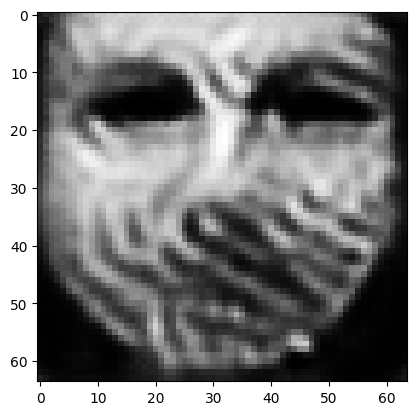

tensor([[2.9781e-05, 3.0884e-06, 8.1197e-04, 1.1622e-06, 1.9628e-05, 9.9635e-01,
         3.3843e-04, 7.6620e-04, 1.2130e-07, 1.2820e-05, 3.6380e-05, 3.3941e-05,
         2.8653e-06, 1.1140e-08, 2.6414e-09, 8.5894e-05, 7.6752e-05, 6.5688e-05,
         1.8996e-06, 2.5088e-04, 3.6226e-07, 3.1253e-07, 1.7117e-09, 3.0701e-07,
         2.8545e-07, 3.7233e-08, 1.9408e-04, 3.4082e-05, 1.2698e-04, 8.1524e-08,
         4.2269e-08, 9.2178e-07, 7.3533e-05, 2.8430e-06, 7.7887e-06, 3.1836e-08,
         1.0683e-06, 1.3191e-06, 1.5901e-06, 6.6819e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0036580332089215517
tensor([[2.9753e-05, 3.0842e-06, 8.1110e-04, 1.1605e-06, 1.9598e-05, 9.9635e-01,
         3.3799e-04, 7.6522e-04, 1.2108e-07, 1.2798e-05, 3.6348e-05, 3.3910e-05,
         2.8602e-06, 1.1119e-08, 2.6361e-09, 8.5847e-05, 7.6667e-05, 6.5599e-05,
         1.8970e-06, 2.5047e-04, 3.6179e-07, 3.1202e-07, 1.7084e-09, 3.0664e-07,
         2.8484e-07, 3.7160e-08, 1.9384e

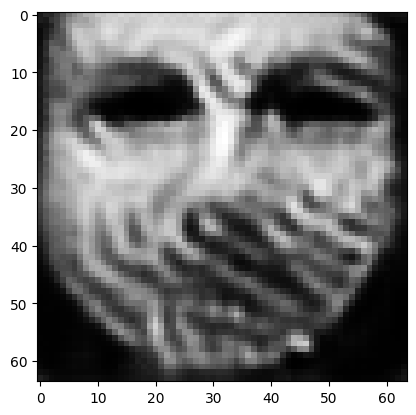

tensor([[2.9639e-05, 3.0675e-06, 8.0780e-04, 1.1534e-06, 1.9484e-05, 9.9637e-01,
         3.3628e-04, 7.6149e-04, 1.2020e-07, 1.2713e-05, 3.6222e-05, 3.3786e-05,
         2.8404e-06, 1.1036e-08, 2.6151e-09, 8.5657e-05, 7.6336e-05, 6.5240e-05,
         1.8867e-06, 2.4887e-04, 3.5991e-07, 3.1006e-07, 1.6952e-09, 3.0514e-07,
         2.8249e-07, 3.6879e-08, 1.9291e-04, 3.3849e-05, 1.2592e-04, 8.0845e-08,
         4.1903e-08, 9.1396e-07, 7.2909e-05, 2.8147e-06, 7.7402e-06, 3.1526e-08,
         1.0603e-06, 1.3069e-06, 1.5729e-06, 6.6479e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003636416047811508
tensor([[2.9611e-05, 3.0635e-06, 8.0701e-04, 1.1517e-06, 1.9456e-05, 9.9637e-01,
         3.3585e-04, 7.6060e-04, 1.1999e-07, 1.2693e-05, 3.6191e-05, 3.3756e-05,
         2.8356e-06, 1.1015e-08, 2.6099e-09, 8.5610e-05, 7.6255e-05, 6.5152e-05,
         1.8842e-06, 2.4848e-04, 3.5945e-07, 3.0958e-07, 1.6920e-09, 3.0478e-07,
         2.8192e-07, 3.6811e-08, 1.9268e-

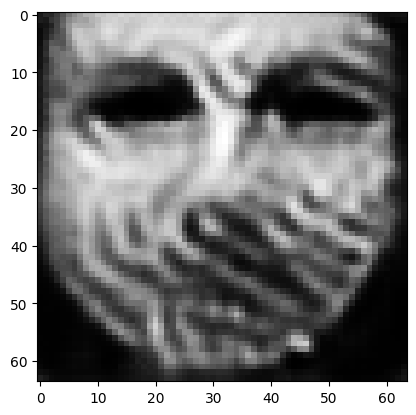

tensor([[2.9506e-05, 3.0479e-06, 8.0390e-04, 1.1452e-06, 1.9349e-05, 9.9639e-01,
         3.3426e-04, 7.5713e-04, 1.1918e-07, 1.2614e-05, 3.6073e-05, 3.3640e-05,
         2.8171e-06, 1.0937e-08, 2.5903e-09, 8.5434e-05, 7.5945e-05, 6.4818e-05,
         1.8746e-06, 2.4699e-04, 3.5769e-07, 3.0775e-07, 1.6797e-09, 3.0339e-07,
         2.7972e-07, 3.6549e-08, 1.9181e-04, 3.3631e-05, 1.2495e-04, 8.0210e-08,
         4.1562e-08, 9.0662e-07, 7.2329e-05, 2.7882e-06, 7.6947e-06, 3.1235e-08,
         1.0527e-06, 1.2957e-06, 1.5569e-06, 6.6162e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00361634255386889
tensor([[2.9481e-05, 3.0440e-06, 8.0315e-04, 1.1437e-06, 1.9323e-05, 9.9639e-01,
         3.3389e-04, 7.5632e-04, 1.1898e-07, 1.2594e-05, 3.6044e-05, 3.3613e-05,
         2.8126e-06, 1.0918e-08, 2.5855e-09, 8.5391e-05, 7.5871e-05, 6.4737e-05,
         1.8722e-06, 2.4662e-04, 3.5726e-07, 3.0731e-07, 1.6766e-09, 3.0306e-07,
         2.7919e-07, 3.6485e-08, 1.9160e-0

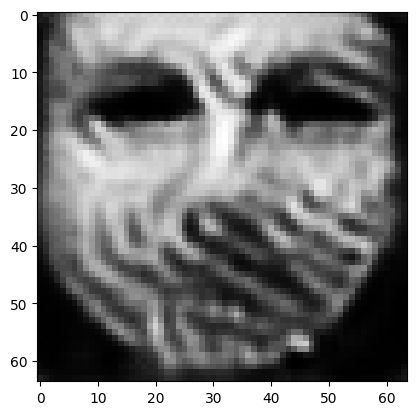

tensor([[2.9386e-05, 3.0290e-06, 8.0024e-04, 1.1376e-06, 1.9222e-05, 9.9641e-01,
         3.3244e-04, 7.5323e-04, 1.1820e-07, 1.2520e-05, 3.5932e-05, 3.3502e-05,
         2.7951e-06, 1.0843e-08, 2.5669e-09, 8.5225e-05, 7.5585e-05, 6.4420e-05,
         1.8632e-06, 2.4522e-04, 3.5556e-07, 3.0558e-07, 1.6648e-09, 3.0177e-07,
         2.7715e-07, 3.6240e-08, 1.9076e-04, 3.3429e-05, 1.2404e-04, 7.9603e-08,
         4.1237e-08, 8.9976e-07, 7.1781e-05, 2.7633e-06, 7.6514e-06, 3.0960e-08,
         1.0457e-06, 1.2851e-06, 1.5417e-06, 6.5855e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035976942162960768
tensor([[2.9362e-05, 3.0254e-06, 7.9954e-04, 1.1361e-06, 1.9198e-05, 9.9641e-01,
         3.3208e-04, 7.5249e-04, 1.1801e-07, 1.2503e-05, 3.5905e-05, 3.3475e-05,
         2.7908e-06, 1.0825e-08, 2.5623e-09, 8.5184e-05, 7.5516e-05, 6.4342e-05,
         1.8609e-06, 2.4488e-04, 3.5514e-07, 3.0516e-07, 1.6619e-09, 3.0145e-07,
         2.7665e-07, 3.6181e-08, 1.9056e

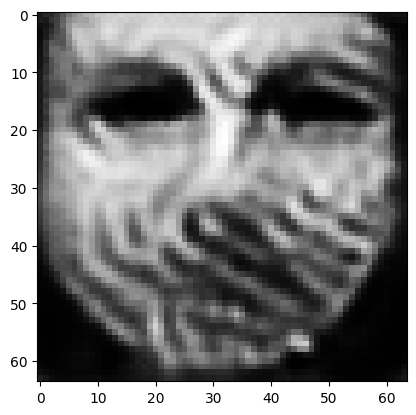

tensor([[2.9274e-05, 3.0112e-06, 7.9679e-04, 1.1304e-06, 1.9103e-05, 9.9643e-01,
         3.3075e-04, 7.4961e-04, 1.1727e-07, 1.2433e-05, 3.5799e-05, 3.3371e-05,
         2.7743e-06, 1.0755e-08, 2.5449e-09, 8.5030e-05, 7.5251e-05, 6.4046e-05,
         1.8525e-06, 2.4356e-04, 3.5355e-07, 3.0353e-07, 1.6508e-09, 3.0026e-07,
         2.7474e-07, 3.5950e-08, 1.8977e-04, 3.3240e-05, 1.2319e-04, 7.9032e-08,
         4.0929e-08, 8.9334e-07, 7.1265e-05, 2.7399e-06, 7.6105e-06, 3.0703e-08,
         1.0391e-06, 1.2752e-06, 1.5274e-06, 6.5563e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035801143385469913
tensor([[2.9252e-05, 3.0077e-06, 7.9613e-04, 1.1290e-06, 1.9080e-05, 9.9643e-01,
         3.3041e-04, 7.4891e-04, 1.1709e-07, 1.2416e-05, 3.5773e-05, 3.3345e-05,
         2.7703e-06, 1.0738e-08, 2.5407e-09, 8.4991e-05, 7.5186e-05, 6.3973e-05,
         1.8504e-06, 2.4324e-04, 3.5316e-07, 3.0313e-07, 1.6480e-09, 2.9997e-07,
         2.7427e-07, 3.5895e-08, 1.8958e

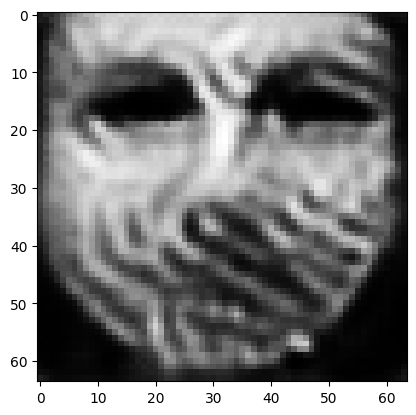

tensor([[2.9169e-05, 2.9944e-06, 7.9356e-04, 1.1237e-06, 1.8991e-05, 9.9644e-01,
         3.2917e-04, 7.4624e-04, 1.1641e-07, 1.2351e-05, 3.5675e-05, 3.3246e-05,
         2.7550e-06, 1.0672e-08, 2.5243e-09, 8.4844e-05, 7.4937e-05, 6.3695e-05,
         1.8424e-06, 2.4201e-04, 3.5166e-07, 3.0162e-07, 1.6376e-09, 2.9885e-07,
         2.7250e-07, 3.5679e-08, 1.8884e-04, 3.3064e-05, 1.2240e-04, 7.8497e-08,
         4.0641e-08, 8.8735e-07, 7.0787e-05, 2.7182e-06, 7.5720e-06, 3.0463e-08,
         1.0330e-06, 1.2661e-06, 1.5142e-06, 6.5289e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003563603386282921
tensor([[2.9150e-05, 2.9913e-06, 7.9294e-04, 1.1224e-06, 1.8970e-05, 9.9645e-01,
         3.2888e-04, 7.4559e-04, 1.1625e-07, 1.2335e-05, 3.5651e-05, 3.3223e-05,
         2.7513e-06, 1.0657e-08, 2.5205e-09, 8.4809e-05, 7.4878e-05, 6.3631e-05,
         1.8405e-06, 2.4172e-04, 3.5131e-07, 3.0125e-07, 1.6352e-09, 2.9858e-07,
         2.7208e-07, 3.5628e-08, 1.8867e-

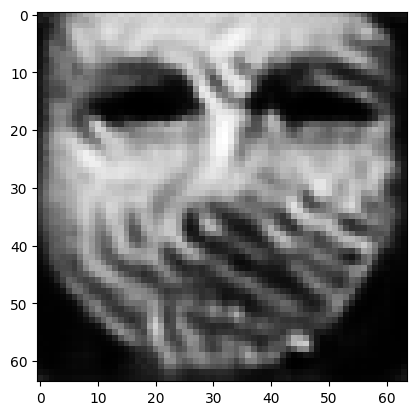

tensor([[2.9073e-05, 2.9789e-06, 7.9053e-04, 1.1175e-06, 1.8888e-05, 9.9646e-01,
         3.2772e-04, 7.4309e-04, 1.1561e-07, 1.2275e-05, 3.5558e-05, 3.3131e-05,
         2.7371e-06, 1.0596e-08, 2.5054e-09, 8.4671e-05, 7.4644e-05, 6.3372e-05,
         1.8331e-06, 2.4058e-04, 3.4991e-07, 2.9984e-07, 1.6255e-09, 2.9753e-07,
         2.7044e-07, 3.5428e-08, 1.8799e-04, 3.2901e-05, 1.2167e-04, 7.8003e-08,
         4.0374e-08, 8.8183e-07, 7.0343e-05, 2.6980e-06, 7.5365e-06, 3.0242e-08,
         1.0273e-06, 1.2575e-06, 1.5019e-06, 6.5035e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035482801031321287
tensor([[2.9054e-05, 2.9759e-06, 7.8995e-04, 1.1163e-06, 1.8868e-05, 9.9646e-01,
         3.2743e-04, 7.4248e-04, 1.1545e-07, 1.2260e-05, 3.5535e-05, 3.3108e-05,
         2.7336e-06, 1.0581e-08, 2.5016e-09, 8.4636e-05, 7.4586e-05, 6.3308e-05,
         1.8313e-06, 2.4030e-04, 3.4956e-07, 2.9950e-07, 1.6232e-09, 2.9727e-07,
         2.7004e-07, 3.5380e-08, 1.8783e

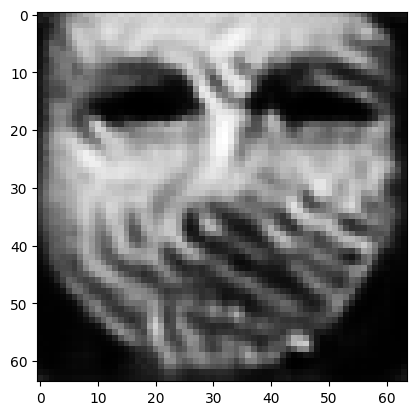

tensor([[2.8982e-05, 2.9642e-06, 7.8767e-04, 1.1116e-06, 1.8790e-05, 9.9647e-01,
         3.2634e-04, 7.4012e-04, 1.1486e-07, 1.2204e-05, 3.5448e-05, 3.3020e-05,
         2.7202e-06, 1.0524e-08, 2.4874e-09, 8.4505e-05, 7.4365e-05, 6.3064e-05,
         1.8243e-06, 2.3923e-04, 3.4823e-07, 2.9817e-07, 1.6141e-09, 2.9628e-07,
         2.6849e-07, 3.5191e-08, 1.8719e-04, 3.2746e-05, 1.2097e-04, 7.7537e-08,
         4.0123e-08, 8.7659e-07, 6.9924e-05, 2.6790e-06, 7.5028e-06, 3.0033e-08,
         1.0219e-06, 1.2495e-06, 1.4904e-06, 6.4796e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035339067690074444
tensor([[2.8964e-05, 2.9614e-06, 7.8712e-04, 1.1105e-06, 1.8771e-05, 9.9648e-01,
         3.2608e-04, 7.3955e-04, 1.1471e-07, 1.2190e-05, 3.5426e-05, 3.2999e-05,
         2.7170e-06, 1.0510e-08, 2.4840e-09, 8.4474e-05, 7.4312e-05, 6.3006e-05,
         1.8226e-06, 2.3897e-04, 3.4792e-07, 2.9784e-07, 1.6119e-09, 2.9604e-07,
         2.6812e-07, 3.5145e-08, 1.8703e

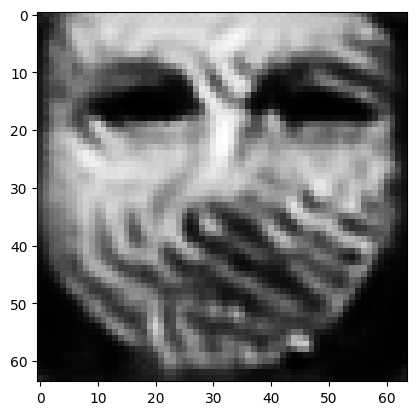

tensor([[2.8896e-05, 2.9504e-06, 7.8496e-04, 1.1061e-06, 1.8698e-05, 9.9649e-01,
         3.2505e-04, 7.3731e-04, 1.1414e-07, 1.2136e-05, 3.5344e-05, 3.2916e-05,
         2.7043e-06, 1.0456e-08, 2.4706e-09, 8.4351e-05, 7.4102e-05, 6.2777e-05,
         1.8160e-06, 2.3796e-04, 3.4667e-07, 2.9659e-07, 1.6033e-09, 2.9511e-07,
         2.6666e-07, 3.4967e-08, 1.8643e-04, 3.2600e-05, 1.2032e-04, 7.7096e-08,
         3.9884e-08, 8.7170e-07, 6.9528e-05, 2.6611e-06, 7.4710e-06, 2.9837e-08,
         1.0168e-06, 1.2419e-06, 1.4795e-06, 6.4568e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003519889432936907
tensor([[2.8879e-05, 2.9478e-06, 7.8444e-04, 1.1050e-06, 1.8680e-05, 9.9649e-01,
         3.2479e-04, 7.3677e-04, 1.1401e-07, 1.2123e-05, 3.5324e-05, 3.2896e-05,
         2.7012e-06, 1.0443e-08, 2.4673e-09, 8.4322e-05, 7.4052e-05, 6.2721e-05,
         1.8144e-06, 2.3771e-04, 3.4636e-07, 2.9628e-07, 1.6012e-09, 2.9488e-07,
         2.6631e-07, 3.4925e-08, 1.8628e-

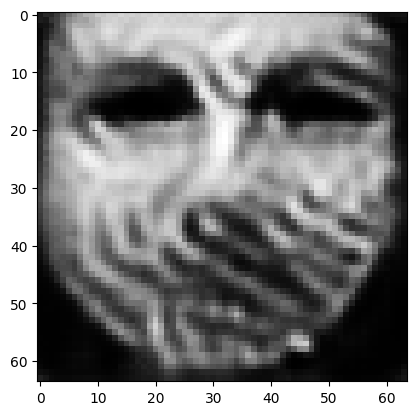

tensor([[2.8814e-05, 2.9373e-06, 7.8239e-04, 1.1008e-06, 1.8611e-05, 9.9650e-01,
         3.2382e-04, 7.3465e-04, 1.1347e-07, 1.2073e-05, 3.5245e-05, 3.2818e-05,
         2.6892e-06, 1.0392e-08, 2.4546e-09, 8.4205e-05, 7.3853e-05, 6.2504e-05,
         1.8081e-06, 2.3676e-04, 3.4518e-07, 2.9510e-07, 1.5931e-09, 2.9399e-07,
         2.6493e-07, 3.4757e-08, 1.8571e-04, 3.2462e-05, 1.1970e-04, 7.6681e-08,
         3.9660e-08, 8.6704e-07, 6.9156e-05, 2.6442e-06, 7.4410e-06, 2.9651e-08,
         1.0120e-06, 1.2348e-06, 1.4692e-06, 6.4353e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0035070599988102913
tensor([[2.8798e-05, 2.9348e-06, 7.8190e-04, 1.0998e-06, 1.8594e-05, 9.9650e-01,
         3.2358e-04, 7.3412e-04, 1.1335e-07, 1.2061e-05, 3.5226e-05, 3.2799e-05,
         2.6864e-06, 1.0379e-08, 2.4516e-09, 8.4177e-05, 7.3805e-05, 6.2452e-05,
         1.8066e-06, 2.3652e-04, 3.4490e-07, 2.9481e-07, 1.5912e-09, 2.9377e-07,
         2.6460e-07, 3.4716e-08, 1.8558e

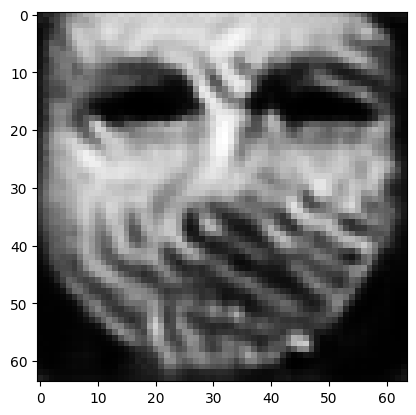

tensor([[2.8736e-05, 2.9250e-06, 7.7996e-04, 1.0959e-06, 1.8528e-05, 9.9651e-01,
         3.2265e-04, 7.3211e-04, 1.1284e-07, 1.2013e-05, 3.5151e-05, 3.2726e-05,
         2.6751e-06, 1.0331e-08, 2.4397e-09, 8.4067e-05, 7.3617e-05, 6.2247e-05,
         1.8007e-06, 2.3562e-04, 3.4378e-07, 2.9369e-07, 1.5835e-09, 2.9293e-07,
         2.6330e-07, 3.4558e-08, 1.8504e-04, 3.2331e-05, 1.1912e-04, 7.6289e-08,
         3.9448e-08, 8.6266e-07, 6.8802e-05, 2.6283e-06, 7.4130e-06, 2.9476e-08,
         1.0075e-06, 1.2280e-06, 1.4595e-06, 6.4151e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003494824282824993
tensor([[2.8722e-05, 2.9227e-06, 7.7949e-04, 1.0950e-06, 1.8513e-05, 9.9651e-01,
         3.2243e-04, 7.3162e-04, 1.1272e-07, 1.2001e-05, 3.5133e-05, 3.2708e-05,
         2.6723e-06, 1.0320e-08, 2.4369e-09, 8.4041e-05, 7.3571e-05, 6.2199e-05,
         1.7992e-06, 2.3540e-04, 3.4351e-07, 2.9342e-07, 1.5817e-09, 2.9273e-07,
         2.6299e-07, 3.4519e-08, 1.8491e-

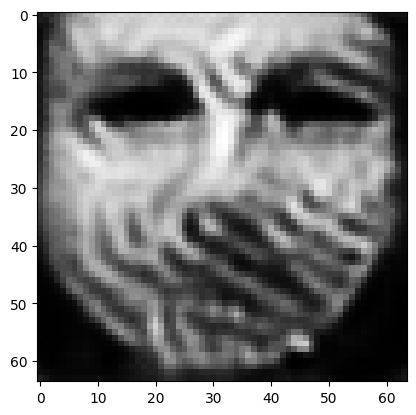

tensor([[2.8663e-05, 2.9134e-06, 7.7766e-04, 1.0912e-06, 1.8451e-05, 9.9652e-01,
         3.2155e-04, 7.2971e-04, 1.1225e-07, 1.1956e-05, 3.5063e-05, 3.2639e-05,
         2.6617e-06, 1.0274e-08, 2.4256e-09, 8.3935e-05, 7.3392e-05, 6.2004e-05,
         1.7936e-06, 2.3455e-04, 3.4246e-07, 2.9236e-07, 1.5745e-09, 2.9192e-07,
         2.6176e-07, 3.4370e-08, 1.8441e-04, 3.2207e-05, 1.1857e-04, 7.5920e-08,
         3.9248e-08, 8.5854e-07, 6.8469e-05, 2.6133e-06, 7.3864e-06, 2.9312e-08,
         1.0032e-06, 1.2216e-06, 1.4504e-06, 6.3961e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034833012614399195
tensor([[2.8649e-05, 2.9111e-06, 7.7722e-04, 1.0903e-06, 1.8435e-05, 9.9652e-01,
         3.2134e-04, 7.2925e-04, 1.1214e-07, 1.1946e-05, 3.5046e-05, 3.2622e-05,
         2.6591e-06, 1.0263e-08, 2.4229e-09, 8.3910e-05, 7.3348e-05, 6.1956e-05,
         1.7923e-06, 2.3434e-04, 3.4219e-07, 2.9211e-07, 1.5728e-09, 2.9173e-07,
         2.6146e-07, 3.4333e-08, 1.8428e

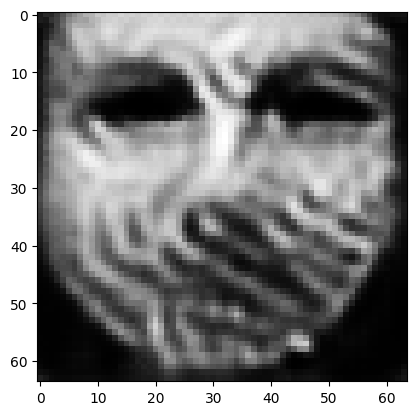

tensor([[2.8593e-05, 2.9024e-06, 7.7549e-04, 1.0868e-06, 1.8377e-05, 9.9653e-01,
         3.2051e-04, 7.2744e-04, 1.1169e-07, 1.1903e-05, 3.4979e-05, 3.2556e-05,
         2.6491e-06, 1.0220e-08, 2.4123e-09, 8.3810e-05, 7.3179e-05, 6.1774e-05,
         1.7870e-06, 2.3354e-04, 3.4120e-07, 2.9111e-07, 1.5660e-09, 2.9097e-07,
         2.6031e-07, 3.4193e-08, 1.8380e-04, 3.2090e-05, 1.1805e-04, 7.5571e-08,
         3.9061e-08, 8.5463e-07, 6.8156e-05, 2.5992e-06, 7.3612e-06, 2.9156e-08,
         9.9910e-07, 1.2156e-06, 1.4418e-06, 6.3782e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034724909346550703
tensor([[2.8580e-05, 2.9003e-06, 7.7507e-04, 1.0860e-06, 1.8363e-05, 9.9654e-01,
         3.2031e-04, 7.2699e-04, 1.1159e-07, 1.1893e-05, 3.4963e-05, 3.2541e-05,
         2.6467e-06, 1.0210e-08, 2.4098e-09, 8.3787e-05, 7.3138e-05, 6.1730e-05,
         1.7857e-06, 2.3334e-04, 3.4096e-07, 2.9087e-07, 1.5644e-09, 2.9079e-07,
         2.6003e-07, 3.4158e-08, 1.8369e

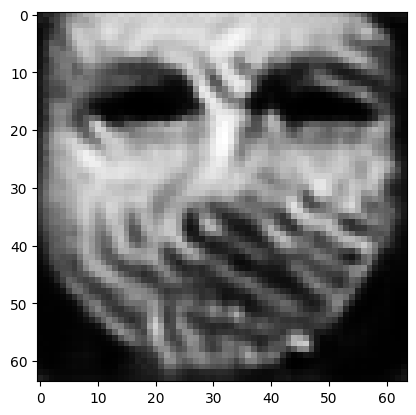

tensor([[2.8527e-05, 2.8920e-06, 7.7345e-04, 1.0827e-06, 1.8307e-05, 9.9654e-01,
         3.1951e-04, 7.2528e-04, 1.1117e-07, 1.1853e-05, 3.4900e-05, 3.2479e-05,
         2.6372e-06, 1.0170e-08, 2.3998e-09, 8.3691e-05, 7.2976e-05, 6.1556e-05,
         1.7807e-06, 2.3258e-04, 3.4002e-07, 2.8993e-07, 1.5579e-09, 2.9006e-07,
         2.5894e-07, 3.4026e-08, 1.8324e-04, 3.1979e-05, 1.1756e-04, 7.5243e-08,
         3.8884e-08, 8.5094e-07, 6.7860e-05, 2.5858e-06, 7.3376e-06, 2.9009e-08,
         9.9525e-07, 1.2099e-06, 1.4338e-06, 6.3614e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003462155582383275
tensor([[2.8515e-05, 2.8901e-06, 7.7305e-04, 1.0819e-06, 1.8294e-05, 9.9655e-01,
         3.1932e-04, 7.2486e-04, 1.1107e-07, 1.1844e-05, 3.4884e-05, 3.2464e-05,
         2.6349e-06, 1.0160e-08, 2.3974e-09, 8.3669e-05, 7.2937e-05, 6.1515e-05,
         1.7795e-06, 2.3240e-04, 3.3979e-07, 2.8970e-07, 1.5564e-09, 2.8989e-07,
         2.5868e-07, 3.3994e-08, 1.8313e-

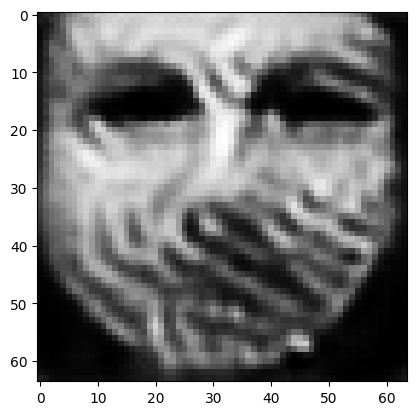

tensor([[2.8465e-05, 2.8823e-06, 7.7150e-04, 1.0788e-06, 1.8242e-05, 9.9655e-01,
         3.1856e-04, 7.2321e-04, 1.1068e-07, 1.1806e-05, 3.4824e-05, 3.2406e-05,
         2.6260e-06, 1.0122e-08, 2.3879e-09, 8.3579e-05, 7.2783e-05, 6.1350e-05,
         1.7747e-06, 2.3168e-04, 3.3890e-07, 2.8882e-07, 1.5504e-09, 2.8920e-07,
         2.5765e-07, 3.3869e-08, 1.8271e-04, 3.1874e-05, 1.1710e-04, 7.4936e-08,
         3.8718e-08, 8.4746e-07, 6.7581e-05, 2.5733e-06, 7.3154e-06, 2.8871e-08,
         9.9161e-07, 1.2046e-06, 1.4262e-06, 6.3456e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034524141810834408
tensor([[2.8452e-05, 2.8804e-06, 7.7113e-04, 1.0780e-06, 1.8229e-05, 9.9656e-01,
         3.1838e-04, 7.2282e-04, 1.1058e-07, 1.1797e-05, 3.4809e-05, 3.2391e-05,
         2.6239e-06, 1.0113e-08, 2.3856e-09, 8.3556e-05, 7.2746e-05, 6.1309e-05,
         1.7736e-06, 2.3151e-04, 3.3868e-07, 2.8860e-07, 1.5489e-09, 2.8903e-07,
         2.5740e-07, 3.3838e-08, 1.8261e

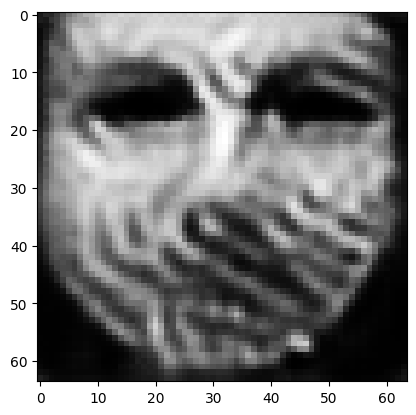

tensor([[2.8405e-05, 2.8731e-06, 7.6966e-04, 1.0751e-06, 1.8179e-05, 9.9656e-01,
         3.1767e-04, 7.2128e-04, 1.1021e-07, 1.1762e-05, 3.4752e-05, 3.2335e-05,
         2.6154e-06, 1.0076e-08, 2.3767e-09, 8.3471e-05, 7.2601e-05, 6.1154e-05,
         1.7691e-06, 2.3083e-04, 3.3783e-07, 2.8776e-07, 1.5432e-09, 2.8839e-07,
         2.5642e-07, 3.3720e-08, 1.8221e-04, 3.1775e-05, 1.1666e-04, 7.4644e-08,
         3.8560e-08, 8.4415e-07, 6.7317e-05, 2.5614e-06, 7.2943e-06, 2.8740e-08,
         9.8815e-07, 1.1995e-06, 1.4189e-06, 6.3305e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003443147987127304
tensor([[2.8394e-05, 2.8713e-06, 7.6930e-04, 1.0744e-06, 1.8167e-05, 9.9656e-01,
         3.1750e-04, 7.2091e-04, 1.1012e-07, 1.1753e-05, 3.4738e-05, 3.2322e-05,
         2.6134e-06, 1.0068e-08, 2.3746e-09, 8.3451e-05, 7.2566e-05, 6.1117e-05,
         1.7680e-06, 2.3067e-04, 3.3763e-07, 2.8756e-07, 1.5418e-09, 2.8823e-07,
         2.5619e-07, 3.3691e-08, 1.8211e-

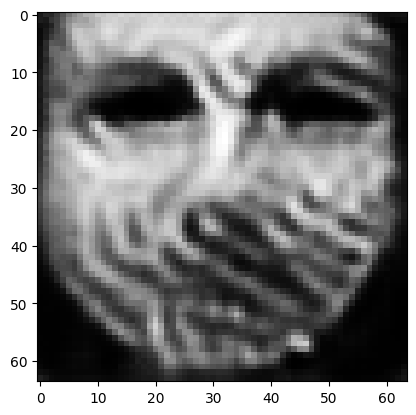

tensor([[2.8350e-05, 2.8643e-06, 7.6791e-04, 1.0716e-06, 1.8120e-05, 9.9657e-01,
         3.1683e-04, 7.1946e-04, 1.0976e-07, 1.1719e-05, 3.4684e-05, 3.2268e-05,
         2.6054e-06, 1.0033e-08, 2.3661e-09, 8.3370e-05, 7.2429e-05, 6.0969e-05,
         1.7638e-06, 2.3003e-04, 3.3682e-07, 2.8676e-07, 1.5363e-09, 2.8762e-07,
         2.5527e-07, 3.3579e-08, 1.8173e-04, 3.1681e-05, 1.1625e-04, 7.4367e-08,
         3.8409e-08, 8.4103e-07, 6.7066e-05, 2.5501e-06, 7.2741e-06, 2.8615e-08,
         9.8489e-07, 1.1947e-06, 1.4121e-06, 6.3162e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034344755113124847
tensor([[2.8340e-05, 2.8627e-06, 7.6758e-04, 1.0709e-06, 1.8109e-05, 9.9657e-01,
         3.1667e-04, 7.1911e-04, 1.0967e-07, 1.1711e-05, 3.4671e-05, 3.2256e-05,
         2.6034e-06, 1.0025e-08, 2.3641e-09, 8.3351e-05, 7.2396e-05, 6.0934e-05,
         1.7628e-06, 2.2987e-04, 3.3662e-07, 2.8657e-07, 1.5350e-09, 2.8748e-07,
         2.5505e-07, 3.3552e-08, 1.8164e

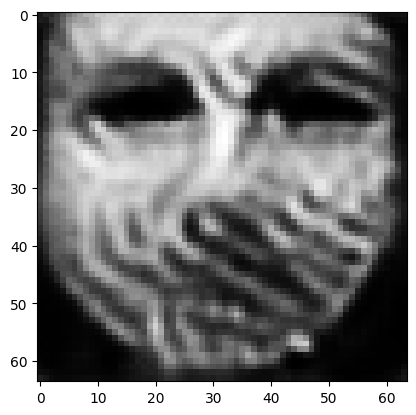

tensor([[2.8298e-05, 2.8560e-06, 7.6626e-04, 1.0682e-06, 1.8064e-05, 9.9658e-01,
         3.1604e-04, 7.1774e-04, 1.0934e-07, 1.1679e-05, 3.4620e-05, 3.2206e-05,
         2.5958e-06, 9.9925e-09, 2.3561e-09, 8.3275e-05, 7.2266e-05, 6.0795e-05,
         1.7588e-06, 2.2927e-04, 3.3586e-07, 2.8582e-07, 1.5299e-09, 2.8690e-07,
         2.5417e-07, 3.3445e-08, 1.8128e-04, 3.1592e-05, 1.1586e-04, 7.4105e-08,
         3.8267e-08, 8.3810e-07, 6.6830e-05, 2.5395e-06, 7.2551e-06, 2.8498e-08,
         9.8180e-07, 1.1902e-06, 1.4057e-06, 6.3025e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034261594992130995
tensor([[2.8288e-05, 2.8544e-06, 7.6594e-04, 1.0676e-06, 1.8053e-05, 9.9658e-01,
         3.1588e-04, 7.1741e-04, 1.0926e-07, 1.1672e-05, 3.4607e-05, 3.2194e-05,
         2.5939e-06, 9.9845e-09, 2.3542e-09, 8.3257e-05, 7.2234e-05, 6.0761e-05,
         1.7578e-06, 2.2912e-04, 3.3567e-07, 2.8564e-07, 1.5286e-09, 2.8675e-07,
         2.5396e-07, 3.3420e-08, 1.8119e

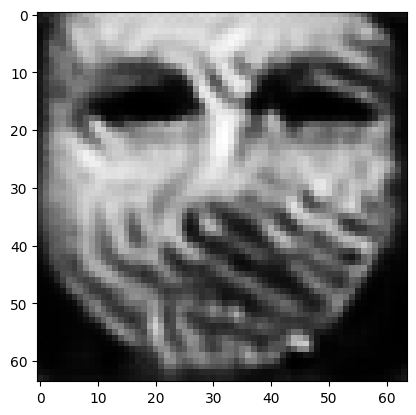

tensor([[2.8248e-05, 2.8483e-06, 7.6469e-04, 1.0651e-06, 1.8011e-05, 9.9659e-01,
         3.1528e-04, 7.1611e-04, 1.0894e-07, 1.1642e-05, 3.4559e-05, 3.2147e-05,
         2.5868e-06, 9.9539e-09, 2.3467e-09, 8.3186e-05, 7.2110e-05, 6.0629e-05,
         1.7540e-06, 2.2855e-04, 3.3495e-07, 2.8493e-07, 1.5237e-09, 2.8621e-07,
         2.5313e-07, 3.3320e-08, 1.8086e-04, 3.1508e-05, 1.1549e-04, 7.3858e-08,
         3.8133e-08, 8.3532e-07, 6.6607e-05, 2.5295e-06, 7.2371e-06, 2.8387e-08,
         9.7888e-07, 1.1860e-06, 1.3996e-06, 6.2897e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034181997179985046
tensor([[2.8239e-05, 2.8468e-06, 7.6438e-04, 1.0645e-06, 1.8001e-05, 9.9659e-01,
         3.1514e-04, 7.1580e-04, 1.0886e-07, 1.1635e-05, 3.4547e-05, 3.2136e-05,
         2.5850e-06, 9.9466e-09, 2.3449e-09, 8.3169e-05, 7.2080e-05, 6.0598e-05,
         1.7531e-06, 2.2841e-04, 3.3477e-07, 2.8476e-07, 1.5225e-09, 2.8607e-07,
         2.5293e-07, 3.3295e-08, 1.8077e

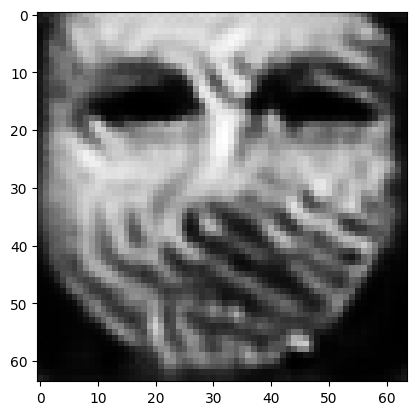

tensor([[2.8201e-05, 2.8409e-06, 7.6320e-04, 1.0622e-06, 1.7961e-05, 9.9659e-01,
         3.1458e-04, 7.1457e-04, 1.0856e-07, 1.1607e-05, 3.4501e-05, 3.2091e-05,
         2.5783e-06, 9.9176e-09, 2.3378e-09, 8.3102e-05, 7.1963e-05, 6.0474e-05,
         1.7495e-06, 2.2787e-04, 3.3410e-07, 2.8409e-07, 1.5179e-09, 2.8556e-07,
         2.5216e-07, 3.3201e-08, 1.8046e-04, 3.1429e-05, 1.1514e-04, 7.3624e-08,
         3.8006e-08, 8.3272e-07, 6.6396e-05, 2.5200e-06, 7.2201e-06, 2.8283e-08,
         9.7613e-07, 1.1819e-06, 1.3939e-06, 6.2776e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0034109526313841343
tensor([[2.8193e-05, 2.8395e-06, 7.6291e-04, 1.0616e-06, 1.7951e-05, 9.9660e-01,
         3.1444e-04, 7.1428e-04, 1.0849e-07, 1.1600e-05, 3.4490e-05, 3.2081e-05,
         2.5766e-06, 9.9106e-09, 2.3361e-09, 8.3086e-05, 7.1935e-05, 6.0444e-05,
         1.7487e-06, 2.2774e-04, 3.3393e-07, 2.8393e-07, 1.5168e-09, 2.8544e-07,
         2.5197e-07, 3.3177e-08, 1.8038e

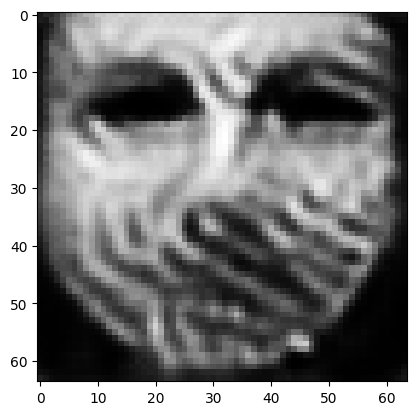

tensor([[2.8158e-05, 2.8340e-06, 7.6179e-04, 1.0594e-06, 1.7914e-05, 9.9660e-01,
         3.1392e-04, 7.1313e-04, 1.0821e-07, 1.1573e-05, 3.4447e-05, 3.2039e-05,
         2.5702e-06, 9.8835e-09, 2.3295e-09, 8.3023e-05, 7.1825e-05, 6.0328e-05,
         1.7453e-06, 2.2724e-04, 3.3329e-07, 2.8330e-07, 1.5125e-09, 2.8495e-07,
         2.5124e-07, 3.3088e-08, 1.8008e-04, 3.1354e-05, 1.1481e-04, 7.3404e-08,
         3.7886e-08, 8.3027e-07, 6.6196e-05, 2.5111e-06, 7.2041e-06, 2.8185e-08,
         9.7353e-07, 1.1781e-06, 1.3884e-06, 6.2660e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003403824521228671
tensor([[2.8149e-05, 2.8327e-06, 7.6152e-04, 1.0588e-06, 1.7904e-05, 9.9660e-01,
         3.1379e-04, 7.1285e-04, 1.0814e-07, 1.1567e-05, 3.4436e-05, 3.2028e-05,
         2.5687e-06, 9.8768e-09, 2.3278e-09, 8.3007e-05, 7.1798e-05, 6.0299e-05,
         1.7445e-06, 2.2711e-04, 3.3313e-07, 2.8314e-07, 1.5114e-09, 2.8483e-07,
         2.5106e-07, 3.3067e-08, 1.8000e-

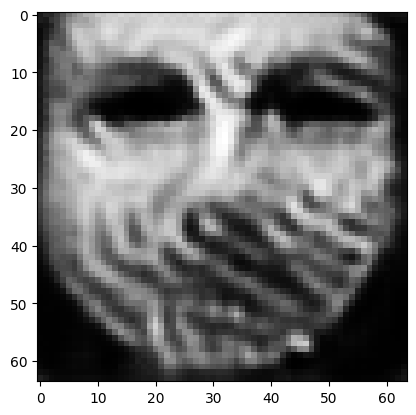

tensor([[2.8116e-05, 2.8275e-06, 7.6047e-04, 1.0567e-06, 1.7869e-05, 9.9661e-01,
         3.1329e-04, 7.1176e-04, 1.0787e-07, 1.1541e-05, 3.4395e-05, 3.1989e-05,
         2.5627e-06, 9.8513e-09, 2.3216e-09, 8.2948e-05, 7.1695e-05, 6.0190e-05,
         1.7413e-06, 2.2664e-04, 3.3253e-07, 2.8255e-07, 1.5074e-09, 2.8438e-07,
         2.5037e-07, 3.2983e-08, 1.7972e-04, 3.1283e-05, 1.1450e-04, 7.3196e-08,
         3.7774e-08, 8.2795e-07, 6.6009e-05, 2.5027e-06, 7.1889e-06, 2.8093e-08,
         9.7108e-07, 1.1745e-06, 1.3834e-06, 6.2551e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033974091056734324
tensor([[2.8108e-05, 2.8262e-06, 7.6021e-04, 1.0562e-06, 1.7861e-05, 9.9661e-01,
         3.1317e-04, 7.1150e-04, 1.0781e-07, 1.1535e-05, 3.4385e-05, 3.1979e-05,
         2.5612e-06, 9.8451e-09, 2.3201e-09, 8.2933e-05, 7.1670e-05, 6.0163e-05,
         1.7405e-06, 2.2652e-04, 3.3239e-07, 2.8240e-07, 1.5064e-09, 2.8427e-07,
         2.5020e-07, 3.2962e-08, 1.7965e

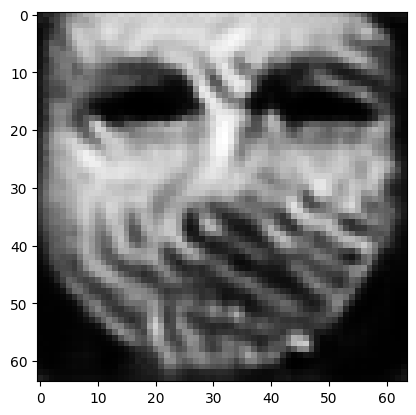

tensor([[2.8077e-05, 2.8213e-06, 7.5922e-04, 1.0543e-06, 1.7828e-05, 9.9661e-01,
         3.1270e-04, 7.1048e-04, 1.0756e-07, 1.1512e-05, 3.4347e-05, 3.1942e-05,
         2.5556e-06, 9.8211e-09, 2.3143e-09, 8.2878e-05, 7.1574e-05, 6.0061e-05,
         1.7376e-06, 2.2607e-04, 3.3182e-07, 2.8185e-07, 1.5026e-09, 2.8385e-07,
         2.4956e-07, 3.2884e-08, 1.7938e-04, 3.1217e-05, 1.1421e-04, 7.3001e-08,
         3.7668e-08, 8.2580e-07, 6.5832e-05, 2.4949e-06, 7.1748e-06, 2.8006e-08,
         9.6881e-07, 1.1711e-06, 1.3786e-06, 6.2448e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003391112433746457
tensor([[2.8070e-05, 2.8202e-06, 7.5898e-04, 1.0538e-06, 1.7819e-05, 9.9662e-01,
         3.1259e-04, 7.1023e-04, 1.0750e-07, 1.1506e-05, 3.4337e-05, 3.1933e-05,
         2.5542e-06, 9.8153e-09, 2.3129e-09, 8.2865e-05, 7.1550e-05, 6.0036e-05,
         1.7369e-06, 2.2596e-04, 3.3169e-07, 2.8171e-07, 1.5017e-09, 2.8375e-07,
         2.4941e-07, 3.2864e-08, 1.7932e-

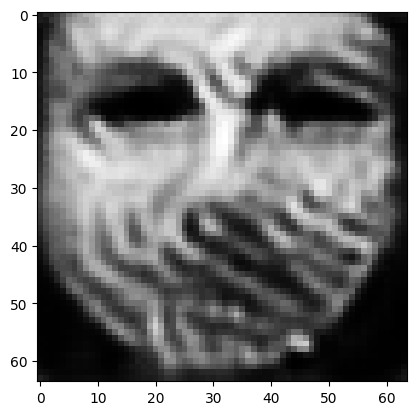

tensor([[2.8040e-05, 2.8156e-06, 7.5804e-04, 1.0519e-06, 1.7788e-05, 9.9662e-01,
         3.1215e-04, 7.0926e-04, 1.0726e-07, 1.1484e-05, 3.4301e-05, 3.1899e-05,
         2.5489e-06, 9.7926e-09, 2.3074e-09, 8.2811e-05, 7.1457e-05, 5.9938e-05,
         1.7340e-06, 2.2554e-04, 3.3115e-07, 2.8118e-07, 1.4981e-09, 2.8334e-07,
         2.4880e-07, 3.2790e-08, 1.7907e-04, 3.1155e-05, 1.1394e-04, 7.2817e-08,
         3.7568e-08, 8.2376e-07, 6.5666e-05, 2.4875e-06, 7.1616e-06, 2.7925e-08,
         9.6664e-07, 1.1679e-06, 1.3741e-06, 6.2352e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003385409712791443
tensor([[2.8033e-05, 2.8144e-06, 7.5781e-04, 1.0515e-06, 1.7781e-05, 9.9662e-01,
         3.1204e-04, 7.0903e-04, 1.0720e-07, 1.1478e-05, 3.4292e-05, 3.1890e-05,
         2.5476e-06, 9.7870e-09, 2.3060e-09, 8.2798e-05, 7.1435e-05, 5.9914e-05,
         1.7333e-06, 2.2543e-04, 3.3102e-07, 2.8106e-07, 1.4972e-09, 2.8324e-07,
         2.4865e-07, 3.2772e-08, 1.7901e-

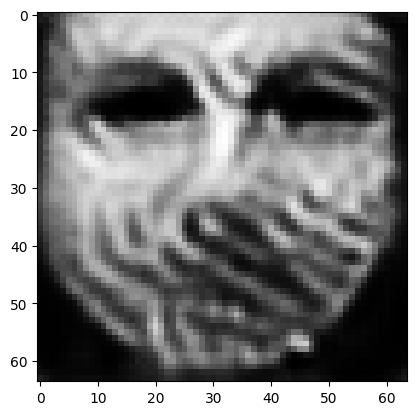

tensor([[2.8005e-05, 2.8101e-06, 7.5693e-04, 1.0497e-06, 1.7751e-05, 9.9663e-01,
         3.1162e-04, 7.0810e-04, 1.0698e-07, 1.1457e-05, 3.4257e-05, 3.1857e-05,
         2.5426e-06, 9.7656e-09, 2.3008e-09, 8.2748e-05, 7.1348e-05, 5.9822e-05,
         1.7307e-06, 2.2503e-04, 3.3052e-07, 2.8056e-07, 1.4938e-09, 2.8286e-07,
         2.4808e-07, 3.2702e-08, 1.7877e-04, 3.1095e-05, 1.1368e-04, 7.2644e-08,
         3.7474e-08, 8.2183e-07, 6.5509e-05, 2.4805e-06, 7.1490e-06, 2.7847e-08,
         9.6460e-07, 1.1649e-06, 1.3699e-06, 6.2261e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003379825735464692
tensor([[2.7998e-05, 2.8090e-06, 7.5671e-04, 1.0493e-06, 1.7744e-05, 9.9663e-01,
         3.1152e-04, 7.0788e-04, 1.0693e-07, 1.1452e-05, 3.4249e-05, 3.1849e-05,
         2.5414e-06, 9.7605e-09, 2.2995e-09, 8.2736e-05, 7.1327e-05, 5.9800e-05,
         1.7300e-06, 2.2494e-04, 3.3040e-07, 2.8044e-07, 1.4930e-09, 2.8277e-07,
         2.4794e-07, 3.2685e-08, 1.7871e-

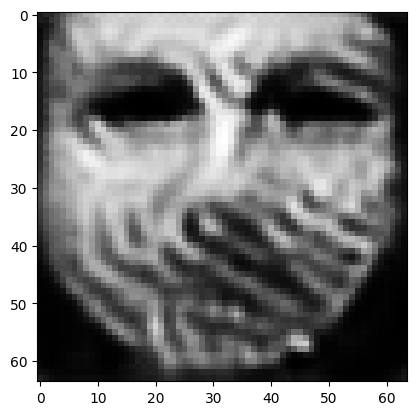

tensor([[2.7972e-05, 2.8049e-06, 7.5586e-04, 1.0477e-06, 1.7716e-05, 9.9663e-01,
         3.1113e-04, 7.0701e-04, 1.0671e-07, 1.1432e-05, 3.4216e-05, 3.1817e-05,
         2.5366e-06, 9.7401e-09, 2.2946e-09, 8.2688e-05, 7.1246e-05, 5.9713e-05,
         1.7275e-06, 2.2455e-04, 3.2992e-07, 2.7996e-07, 1.4897e-09, 2.8241e-07,
         2.4739e-07, 3.2618e-08, 1.7848e-04, 3.1039e-05, 1.1343e-04, 7.2479e-08,
         3.7383e-08, 8.2001e-07, 6.5358e-05, 2.4738e-06, 7.1371e-06, 2.7774e-08,
         9.6267e-07, 1.1621e-06, 1.3658e-06, 6.2173e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033745982218533754
tensor([[2.7965e-05, 2.8039e-06, 7.5566e-04, 1.0473e-06, 1.7709e-05, 9.9663e-01,
         3.1103e-04, 7.0680e-04, 1.0666e-07, 1.1427e-05, 3.4208e-05, 3.1809e-05,
         2.5354e-06, 9.7351e-09, 2.2934e-09, 8.2677e-05, 7.1226e-05, 5.9692e-05,
         1.7269e-06, 2.2446e-04, 3.2980e-07, 2.7984e-07, 1.4889e-09, 2.8232e-07,
         2.4726e-07, 3.2602e-08, 1.7843e

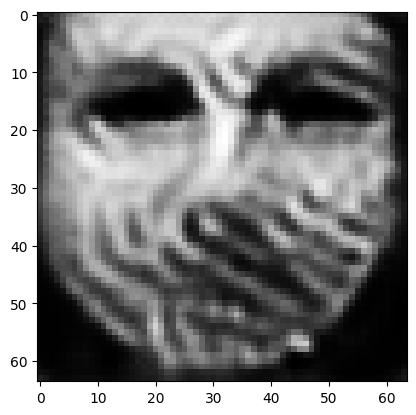

tensor([[2.7940e-05, 2.7999e-06, 7.5486e-04, 1.0457e-06, 1.7682e-05, 9.9664e-01,
         3.1066e-04, 7.0597e-04, 1.0646e-07, 1.1408e-05, 3.4177e-05, 3.1780e-05,
         2.5309e-06, 9.7158e-09, 2.2887e-09, 8.2631e-05, 7.1150e-05, 5.9609e-05,
         1.7245e-06, 2.2410e-04, 3.2935e-07, 2.7939e-07, 1.4859e-09, 2.8198e-07,
         2.4675e-07, 3.2539e-08, 1.7821e-04, 3.0986e-05, 1.1320e-04, 7.2324e-08,
         3.7298e-08, 8.1829e-07, 6.5216e-05, 2.4676e-06, 7.1258e-06, 2.7705e-08,
         9.6086e-07, 1.1594e-06, 1.3620e-06, 6.2090e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033694894518703222
tensor([[2.7934e-05, 2.7989e-06, 7.5467e-04, 1.0453e-06, 1.7676e-05, 9.9664e-01,
         3.1057e-04, 7.0578e-04, 1.0641e-07, 1.1404e-05, 3.4169e-05, 3.1772e-05,
         2.5298e-06, 9.7111e-09, 2.2875e-09, 8.2619e-05, 7.1131e-05, 5.9588e-05,
         1.7239e-06, 2.2401e-04, 3.2924e-07, 2.7928e-07, 1.4851e-09, 2.8190e-07,
         2.4663e-07, 3.2524e-08, 1.7815e

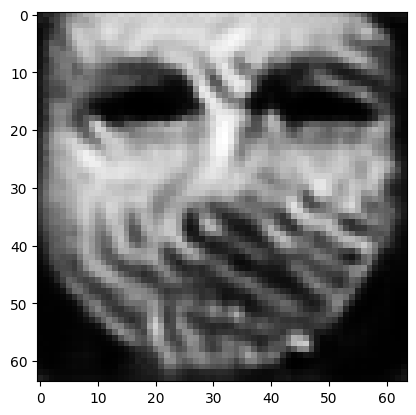

tensor([[2.7910e-05, 2.7952e-06, 7.5392e-04, 1.0438e-06, 1.7651e-05, 9.9664e-01,
         3.1021e-04, 7.0499e-04, 1.0622e-07, 1.1385e-05, 3.4140e-05, 3.1743e-05,
         2.5256e-06, 9.6930e-09, 2.2831e-09, 8.2576e-05, 7.1060e-05, 5.9510e-05,
         1.7217e-06, 2.2367e-04, 3.2882e-07, 2.7885e-07, 1.4823e-09, 2.8158e-07,
         2.4614e-07, 3.2465e-08, 1.7795e-04, 3.0936e-05, 1.1299e-04, 7.2177e-08,
         3.7218e-08, 8.1666e-07, 6.5082e-05, 2.4616e-06, 7.1152e-06, 2.7639e-08,
         9.5914e-07, 1.1568e-06, 1.3584e-06, 6.2010e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033648558892309666
tensor([[2.7905e-05, 2.7943e-06, 7.5373e-04, 1.0435e-06, 1.7644e-05, 9.9664e-01,
         3.1013e-04, 7.0480e-04, 1.0617e-07, 1.1381e-05, 3.4132e-05, 3.1737e-05,
         2.5245e-06, 9.6886e-09, 2.2820e-09, 8.2566e-05, 7.1042e-05, 5.9491e-05,
         1.7211e-06, 2.2359e-04, 3.2871e-07, 2.7875e-07, 1.4816e-09, 2.8150e-07,
         2.4603e-07, 3.2450e-08, 1.7790e

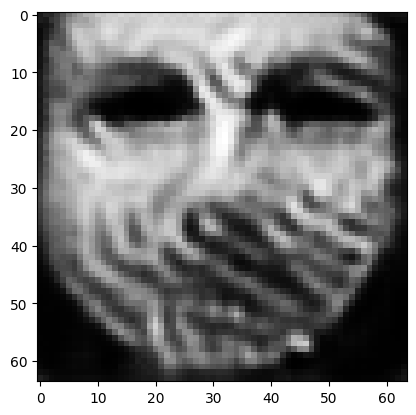

tensor([[2.7882e-05, 2.7907e-06, 7.5301e-04, 1.0421e-06, 1.7621e-05, 9.9665e-01,
         3.0979e-04, 7.0405e-04, 1.0599e-07, 1.1364e-05, 3.4105e-05, 3.1710e-05,
         2.5205e-06, 9.6714e-09, 2.2778e-09, 8.2525e-05, 7.0973e-05, 5.9417e-05,
         1.7190e-06, 2.2327e-04, 3.2831e-07, 2.7835e-07, 1.4788e-09, 2.8120e-07,
         2.4557e-07, 3.2394e-08, 1.7770e-04, 3.0888e-05, 1.1278e-04, 7.2038e-08,
         3.7141e-08, 8.1512e-07, 6.4955e-05, 2.4560e-06, 7.1052e-06, 2.7578e-08,
         9.5751e-07, 1.1544e-06, 1.3550e-06, 6.1936e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033604600466787815
tensor([[2.7876e-05, 2.7899e-06, 7.5285e-04, 1.0417e-06, 1.7615e-05, 9.9665e-01,
         3.0971e-04, 7.0387e-04, 1.0595e-07, 1.1360e-05, 3.4098e-05, 3.1703e-05,
         2.5195e-06, 9.6671e-09, 2.2768e-09, 8.2515e-05, 7.0956e-05, 5.9398e-05,
         1.7184e-06, 2.2319e-04, 3.2821e-07, 2.7825e-07, 1.4782e-09, 2.8112e-07,
         2.4546e-07, 3.2381e-08, 1.7765e

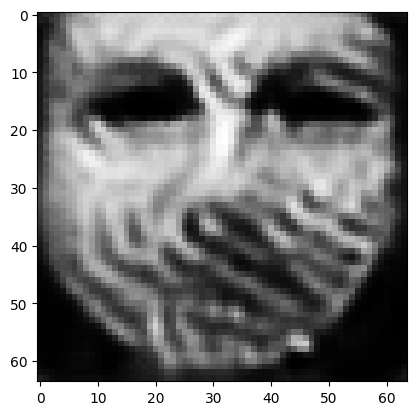

tensor([[2.7855e-05, 2.7865e-06, 7.5216e-04, 1.0404e-06, 1.7592e-05, 9.9665e-01,
         3.0939e-04, 7.0315e-04, 1.0578e-07, 1.1344e-05, 3.4071e-05, 3.1678e-05,
         2.5157e-06, 9.6507e-09, 2.2728e-09, 8.2475e-05, 7.0890e-05, 5.9328e-05,
         1.7164e-06, 2.2288e-04, 3.2783e-07, 2.7787e-07, 1.4756e-09, 2.8083e-07,
         2.4502e-07, 3.2327e-08, 1.7747e-04, 3.0842e-05, 1.1259e-04, 7.1906e-08,
         3.7069e-08, 8.1365e-07, 6.4834e-05, 2.4506e-06, 7.0957e-06, 2.7519e-08,
         9.5596e-07, 1.1521e-06, 1.3517e-06, 6.1866e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00335618294775486
tensor([[2.7849e-05, 2.7857e-06, 7.5200e-04, 1.0401e-06, 1.7587e-05, 9.9665e-01,
         3.0931e-04, 7.0298e-04, 1.0574e-07, 1.1340e-05, 3.4065e-05, 3.1671e-05,
         2.5148e-06, 9.6468e-09, 2.2718e-09, 8.2466e-05, 7.0874e-05, 5.9311e-05,
         1.7159e-06, 2.2281e-04, 3.2774e-07, 2.7777e-07, 1.4749e-09, 2.8076e-07,
         2.4492e-07, 3.2314e-08, 1.7742e-0

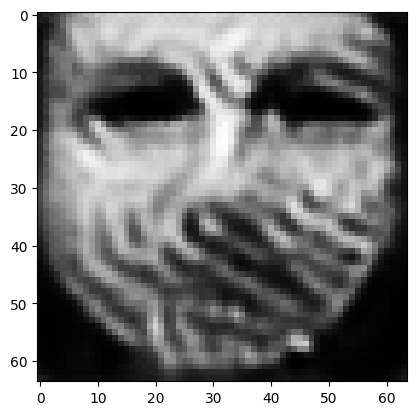

tensor([[2.7829e-05, 2.7825e-06, 7.5135e-04, 1.0388e-06, 1.7565e-05, 9.9665e-01,
         3.0901e-04, 7.0230e-04, 1.0557e-07, 1.1324e-05, 3.4040e-05, 3.1647e-05,
         2.5111e-06, 9.6314e-09, 2.2680e-09, 8.2429e-05, 7.0813e-05, 5.9244e-05,
         1.7140e-06, 2.2252e-04, 3.2737e-07, 2.7741e-07, 1.4725e-09, 2.8048e-07,
         2.4451e-07, 3.2264e-08, 1.7725e-04, 3.0799e-05, 1.1240e-04, 7.1781e-08,
         3.7001e-08, 8.1227e-07, 6.4719e-05, 2.4456e-06, 7.0867e-06, 2.7463e-08,
         9.5450e-07, 1.1500e-06, 1.3486e-06, 6.1799e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033521433360874653
tensor([[2.7824e-05, 2.7817e-06, 7.5120e-04, 1.0385e-06, 1.7560e-05, 9.9665e-01,
         3.0894e-04, 7.0214e-04, 1.0554e-07, 1.1321e-05, 3.4033e-05, 3.1641e-05,
         2.5102e-06, 9.6275e-09, 2.2671e-09, 8.2419e-05, 7.0797e-05, 5.9227e-05,
         1.7135e-06, 2.2245e-04, 3.2728e-07, 2.7732e-07, 1.4719e-09, 2.8042e-07,
         2.4441e-07, 3.2252e-08, 1.7720e

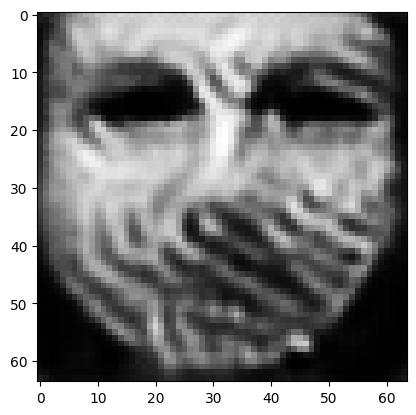

tensor([[2.7805e-05, 2.7787e-06, 7.5059e-04, 1.0373e-06, 1.7539e-05, 9.9666e-01,
         3.0865e-04, 7.0150e-04, 1.0538e-07, 1.1306e-05, 3.4009e-05, 3.1618e-05,
         2.5068e-06, 9.6128e-09, 2.2635e-09, 8.2384e-05, 7.0739e-05, 5.9164e-05,
         1.7117e-06, 2.2217e-04, 3.2694e-07, 2.7697e-07, 1.4695e-09, 2.8015e-07,
         2.4402e-07, 3.2204e-08, 1.7704e-04, 3.0759e-05, 1.1223e-04, 7.1664e-08,
         3.6936e-08, 8.1095e-07, 6.4611e-05, 2.4408e-06, 7.0782e-06, 2.7410e-08,
         9.5311e-07, 1.1479e-06, 1.3457e-06, 6.1736e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033483414445072412
tensor([[2.7800e-05, 2.7780e-06, 7.5044e-04, 1.0370e-06, 1.7534e-05, 9.9666e-01,
         3.0858e-04, 7.0135e-04, 1.0535e-07, 1.1303e-05, 3.4004e-05, 3.1612e-05,
         2.5060e-06, 9.6093e-09, 2.2627e-09, 8.2376e-05, 7.0724e-05, 5.9148e-05,
         1.7112e-06, 2.2210e-04, 3.2686e-07, 2.7689e-07, 1.4690e-09, 2.8009e-07,
         2.4392e-07, 3.2192e-08, 1.7700e

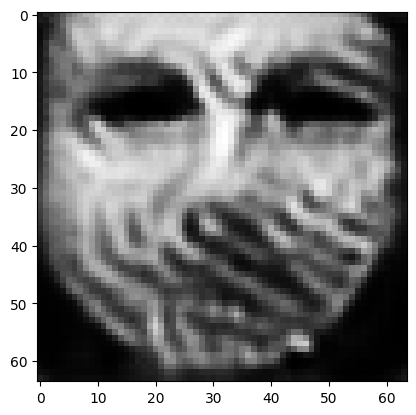

tensor([[2.7782e-05, 2.7752e-06, 7.4987e-04, 1.0359e-06, 1.7515e-05, 9.9666e-01,
         3.0831e-04, 7.0074e-04, 1.0520e-07, 1.1289e-05, 3.3981e-05, 3.1590e-05,
         2.5027e-06, 9.5955e-09, 2.2593e-09, 8.2343e-05, 7.0669e-05, 5.9089e-05,
         1.7095e-06, 2.2185e-04, 3.2654e-07, 2.7656e-07, 1.4668e-09, 2.7984e-07,
         2.4355e-07, 3.2148e-08, 1.7684e-04, 3.0720e-05, 1.1206e-04, 7.1554e-08,
         3.6875e-08, 8.0971e-07, 6.4509e-05, 2.4363e-06, 7.0703e-06, 2.7361e-08,
         9.5181e-07, 1.1460e-06, 1.3430e-06, 6.1677e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033446582965552807
tensor([[2.7777e-05, 2.7745e-06, 7.4973e-04, 1.0356e-06, 1.7510e-05, 9.9666e-01,
         3.0824e-04, 7.0059e-04, 1.0517e-07, 1.1286e-05, 3.3976e-05, 3.1585e-05,
         2.5019e-06, 9.5920e-09, 2.2585e-09, 8.2335e-05, 7.0655e-05, 5.9074e-05,
         1.7091e-06, 2.2178e-04, 3.2646e-07, 2.7649e-07, 1.4663e-09, 2.7978e-07,
         2.4346e-07, 3.2137e-08, 1.7680e

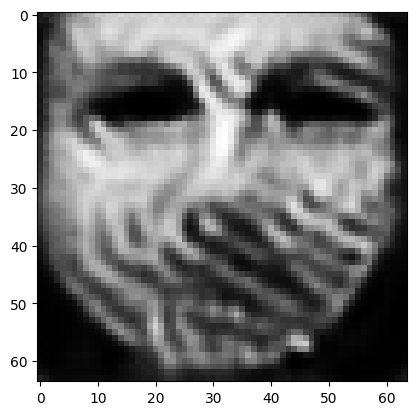

tensor([[2.7760e-05, 2.7718e-06, 7.4919e-04, 1.0346e-06, 1.7492e-05, 9.9666e-01,
         3.0799e-04, 7.0002e-04, 1.0503e-07, 1.1273e-05, 3.3954e-05, 3.1565e-05,
         2.4989e-06, 9.5790e-09, 2.2553e-09, 8.2304e-05, 7.0603e-05, 5.9018e-05,
         1.7075e-06, 2.2154e-04, 3.2615e-07, 2.7618e-07, 1.4642e-09, 2.7955e-07,
         2.4312e-07, 3.2095e-08, 1.7666e-04, 3.0684e-05, 1.1191e-04, 7.1449e-08,
         3.6818e-08, 8.0853e-07, 6.4412e-05, 2.4320e-06, 7.0627e-06, 2.7314e-08,
         9.5058e-07, 1.1442e-06, 1.3404e-06, 6.1621e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033414503559470177
tensor([[2.7756e-05, 2.7711e-06, 7.4905e-04, 1.0343e-06, 1.7488e-05, 9.9666e-01,
         3.0793e-04, 6.9988e-04, 1.0500e-07, 1.1270e-05, 3.3949e-05, 3.1560e-05,
         2.4982e-06, 9.5758e-09, 2.2545e-09, 8.2296e-05, 7.0589e-05, 5.9004e-05,
         1.7071e-06, 2.2148e-04, 3.2608e-07, 2.7610e-07, 1.4637e-09, 2.7949e-07,
         2.4303e-07, 3.2084e-08, 1.7662e

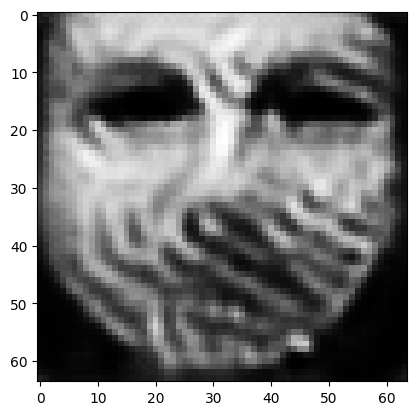

tensor([[2.7739e-05, 2.7686e-06, 7.4854e-04, 1.0333e-06, 1.7471e-05, 9.9667e-01,
         3.0769e-04, 6.9934e-04, 1.0487e-07, 1.1258e-05, 3.3929e-05, 3.1540e-05,
         2.4953e-06, 9.5635e-09, 2.2515e-09, 8.2267e-05, 7.0539e-05, 5.8951e-05,
         1.7055e-06, 2.2125e-04, 3.2579e-07, 2.7581e-07, 1.4617e-09, 2.7927e-07,
         2.4271e-07, 3.2044e-08, 1.7648e-04, 3.0650e-05, 1.1176e-04, 7.1350e-08,
         3.6763e-08, 8.0742e-07, 6.4321e-05, 2.4280e-06, 7.0556e-06, 2.7269e-08,
         9.4942e-07, 1.1425e-06, 1.3380e-06, 6.1569e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003338123671710491
tensor([[2.7735e-05, 2.7680e-06, 7.4841e-04, 1.0331e-06, 1.7467e-05, 9.9667e-01,
         3.0763e-04, 6.9921e-04, 1.0484e-07, 1.1255e-05, 3.3924e-05, 3.1535e-05,
         2.4946e-06, 9.5605e-09, 2.2508e-09, 8.2259e-05, 7.0527e-05, 5.8938e-05,
         1.7052e-06, 2.2119e-04, 3.2572e-07, 2.7574e-07, 1.4613e-09, 2.7921e-07,
         2.4263e-07, 3.2034e-08, 1.7645e-

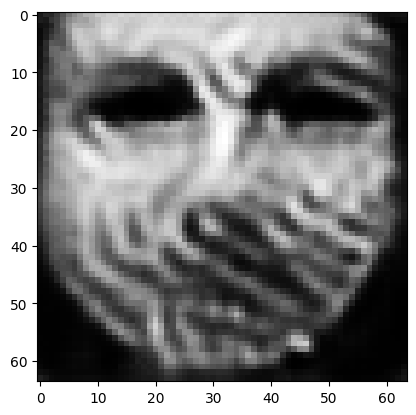

tensor([[2.7720e-05, 2.7656e-06, 7.4792e-04, 1.0321e-06, 1.7450e-05, 9.9667e-01,
         3.0740e-04, 6.9869e-04, 1.0472e-07, 1.1243e-05, 3.3904e-05, 3.1517e-05,
         2.4918e-06, 9.5486e-09, 2.2479e-09, 8.2231e-05, 7.0479e-05, 5.8886e-05,
         1.7037e-06, 2.2097e-04, 3.2545e-07, 2.7547e-07, 1.4594e-09, 2.7900e-07,
         2.4231e-07, 3.1996e-08, 1.7631e-04, 3.0617e-05, 1.1162e-04, 7.1255e-08,
         3.6711e-08, 8.0636e-07, 6.4234e-05, 2.4241e-06, 7.0487e-06, 2.7227e-08,
         9.4830e-07, 1.1408e-06, 1.3357e-06, 6.1519e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033350344747304916
tensor([[2.7716e-05, 2.7650e-06, 7.4781e-04, 1.0319e-06, 1.7446e-05, 9.9667e-01,
         3.0734e-04, 6.9857e-04, 1.0469e-07, 1.1241e-05, 3.3900e-05, 3.1512e-05,
         2.4912e-06, 9.5458e-09, 2.2472e-09, 8.2224e-05, 7.0467e-05, 5.8874e-05,
         1.7033e-06, 2.2092e-04, 3.2538e-07, 2.7540e-07, 1.4590e-09, 2.7895e-07,
         2.4224e-07, 3.1987e-08, 1.7628e

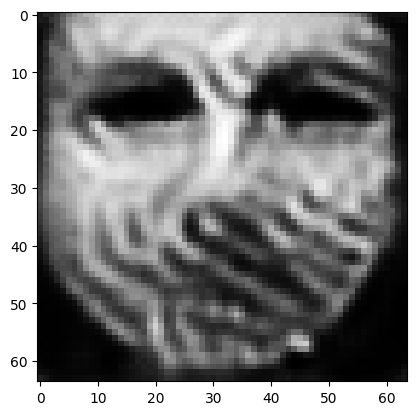

tensor([[2.7701e-05, 2.7627e-06, 7.4733e-04, 1.0310e-06, 1.7431e-05, 9.9667e-01,
         3.0712e-04, 6.9808e-04, 1.0457e-07, 1.1230e-05, 3.3881e-05, 3.1495e-05,
         2.4885e-06, 9.5345e-09, 2.2445e-09, 8.2198e-05, 7.0422e-05, 5.8825e-05,
         1.7019e-06, 2.2071e-04, 3.2512e-07, 2.7514e-07, 1.4572e-09, 2.7875e-07,
         2.4194e-07, 3.1951e-08, 1.7615e-04, 3.0586e-05, 1.1149e-04, 7.1165e-08,
         3.6662e-08, 8.0536e-07, 6.4151e-05, 2.4205e-06, 7.0422e-06, 2.7187e-08,
         9.4725e-07, 1.1392e-06, 1.3335e-06, 6.1471e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033321829978376627
tensor([[2.7697e-05, 2.7622e-06, 7.4722e-04, 1.0308e-06, 1.7427e-05, 9.9667e-01,
         3.0707e-04, 6.9797e-04, 1.0454e-07, 1.1227e-05, 3.3877e-05, 3.1490e-05,
         2.4879e-06, 9.5318e-09, 2.2438e-09, 8.2191e-05, 7.0411e-05, 5.8814e-05,
         1.7016e-06, 2.2065e-04, 3.2505e-07, 2.7507e-07, 1.4568e-09, 2.7870e-07,
         2.4187e-07, 3.1942e-08, 1.7612e

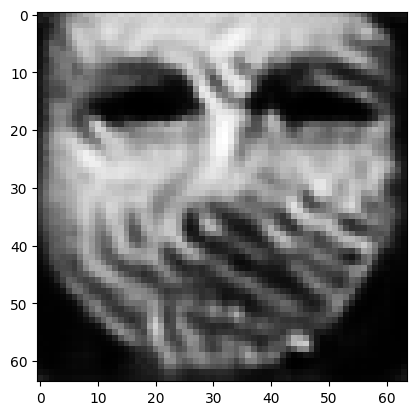

tensor([[2.7683e-05, 2.7600e-06, 7.4677e-04, 1.0299e-06, 1.7412e-05, 9.9668e-01,
         3.0686e-04, 6.9750e-04, 1.0443e-07, 1.1217e-05, 3.3859e-05, 3.1474e-05,
         2.4854e-06, 9.5211e-09, 2.2412e-09, 8.2166e-05, 7.0367e-05, 5.8767e-05,
         1.7003e-06, 2.2046e-04, 3.2480e-07, 2.7482e-07, 1.4551e-09, 2.7850e-07,
         2.4158e-07, 3.1907e-08, 1.7601e-04, 3.0557e-05, 1.1137e-04, 7.1080e-08,
         3.6615e-08, 8.0440e-07, 6.4072e-05, 2.4171e-06, 7.0362e-06, 2.7149e-08,
         9.4623e-07, 1.1378e-06, 1.3314e-06, 6.1427e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033294502645730972
tensor([[2.7679e-05, 2.7595e-06, 7.4667e-04, 1.0297e-06, 1.7409e-05, 9.9668e-01,
         3.0681e-04, 6.9739e-04, 1.0441e-07, 1.1214e-05, 3.3855e-05, 3.1470e-05,
         2.4848e-06, 9.5185e-09, 2.2406e-09, 8.2160e-05, 7.0356e-05, 5.8756e-05,
         1.7000e-06, 2.2041e-04, 3.2474e-07, 2.7476e-07, 1.4547e-09, 2.7845e-07,
         2.4151e-07, 3.1899e-08, 1.7598e

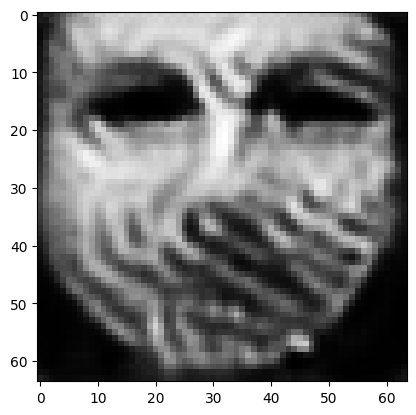

tensor([[2.7666e-05, 2.7574e-06, 7.4624e-04, 1.0289e-06, 1.7394e-05, 9.9668e-01,
         3.0661e-04, 6.9695e-04, 1.0430e-07, 1.1204e-05, 3.3838e-05, 3.1454e-05,
         2.4825e-06, 9.5082e-09, 2.2381e-09, 8.2135e-05, 7.0314e-05, 5.8711e-05,
         1.6987e-06, 2.2022e-04, 3.2450e-07, 2.7452e-07, 1.4531e-09, 2.7826e-07,
         2.4124e-07, 3.1866e-08, 1.7586e-04, 3.0529e-05, 1.1125e-04, 7.1000e-08,
         3.6570e-08, 8.0349e-07, 6.3997e-05, 2.4138e-06, 7.0303e-06, 2.7113e-08,
         9.4527e-07, 1.1363e-06, 1.3294e-06, 6.1385e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003326836507767439
tensor([[2.7662e-05, 2.7569e-06, 7.4613e-04, 1.0287e-06, 1.7391e-05, 9.9668e-01,
         3.0657e-04, 6.9685e-04, 1.0428e-07, 1.1202e-05, 3.3834e-05, 3.1450e-05,
         2.4819e-06, 9.5058e-09, 2.2375e-09, 8.2130e-05, 7.0304e-05, 5.8701e-05,
         1.6984e-06, 2.2017e-04, 3.2444e-07, 2.7446e-07, 1.4527e-09, 2.7822e-07,
         2.4117e-07, 3.1858e-08, 1.7584e-

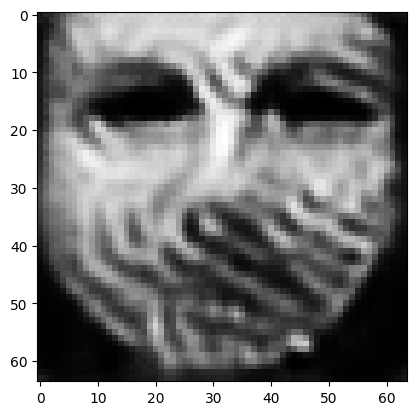

tensor([[2.7649e-05, 2.7550e-06, 7.4573e-04, 1.0279e-06, 1.7378e-05, 9.9668e-01,
         3.0638e-04, 6.9643e-04, 1.0418e-07, 1.1193e-05, 3.3818e-05, 3.1435e-05,
         2.4797e-06, 9.4961e-09, 2.2352e-09, 8.2107e-05, 7.0264e-05, 5.8658e-05,
         1.6972e-06, 2.1999e-04, 3.2422e-07, 2.7424e-07, 1.4511e-09, 2.7804e-07,
         2.4092e-07, 3.1827e-08, 1.7573e-04, 3.0502e-05, 1.1113e-04, 7.0923e-08,
         3.6528e-08, 8.0263e-07, 6.3926e-05, 2.4107e-06, 7.0247e-06, 2.7078e-08,
         9.4436e-07, 1.1350e-06, 1.3275e-06, 6.1345e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033244602382183075
tensor([[2.7646e-05, 2.7545e-06, 7.4563e-04, 1.0278e-06, 1.7374e-05, 9.9668e-01,
         3.0633e-04, 6.9633e-04, 1.0415e-07, 1.1191e-05, 3.3814e-05, 3.1431e-05,
         2.4791e-06, 9.4937e-09, 2.2346e-09, 8.2101e-05, 7.0254e-05, 5.8648e-05,
         1.6969e-06, 2.1995e-04, 3.2416e-07, 2.7418e-07, 1.4508e-09, 2.7800e-07,
         2.4085e-07, 3.1820e-08, 1.7570e

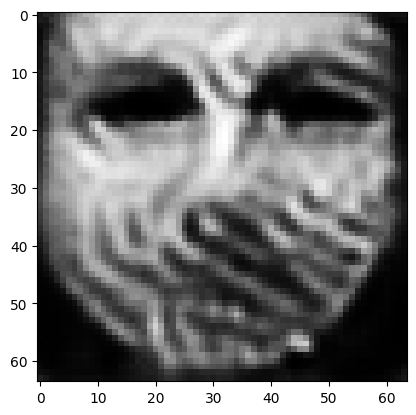

tensor([[2.7634e-05, 2.7526e-06, 7.4525e-04, 1.0270e-06, 1.7362e-05, 9.9668e-01,
         3.0616e-04, 6.9594e-04, 1.0406e-07, 1.1182e-05, 3.3800e-05, 3.1417e-05,
         2.4770e-06, 9.4846e-09, 2.2324e-09, 8.2079e-05, 7.0217e-05, 5.8608e-05,
         1.6958e-06, 2.1978e-04, 3.2395e-07, 2.7397e-07, 1.4493e-09, 2.7783e-07,
         2.4061e-07, 3.1791e-08, 1.7560e-04, 3.0477e-05, 1.1103e-04, 7.0850e-08,
         3.6487e-08, 8.0181e-07, 6.3859e-05, 2.4077e-06, 7.0194e-06, 2.7046e-08,
         9.4349e-07, 1.1337e-06, 1.3257e-06, 6.1306e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003321964992210269
tensor([[2.7631e-05, 2.7522e-06, 7.4516e-04, 1.0268e-06, 1.7359e-05, 9.9668e-01,
         3.0611e-04, 6.9584e-04, 1.0404e-07, 1.1180e-05, 3.3796e-05, 3.1414e-05,
         2.4765e-06, 9.4823e-09, 2.2318e-09, 8.2074e-05, 7.0208e-05, 5.8599e-05,
         1.6955e-06, 2.1974e-04, 3.2390e-07, 2.7392e-07, 1.4490e-09, 2.7779e-07,
         2.4055e-07, 3.1784e-08, 1.7558e-

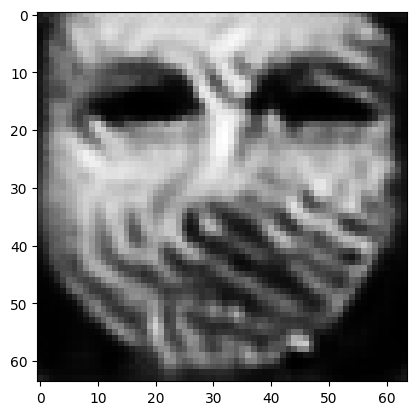

tensor([[2.7619e-05, 2.7504e-06, 7.4479e-04, 1.0261e-06, 1.7347e-05, 9.9669e-01,
         3.0594e-04, 6.9546e-04, 1.0395e-07, 1.1171e-05, 3.3782e-05, 3.1400e-05,
         2.4744e-06, 9.4736e-09, 2.2297e-09, 8.2053e-05, 7.0172e-05, 5.8561e-05,
         1.6944e-06, 2.1958e-04, 3.2369e-07, 2.7371e-07, 1.4476e-09, 2.7763e-07,
         2.4032e-07, 3.1756e-08, 1.7548e-04, 3.0453e-05, 1.1093e-04, 7.0781e-08,
         3.6449e-08, 8.0104e-07, 6.3795e-05, 2.4049e-06, 7.0145e-06, 2.7015e-08,
         9.4266e-07, 1.1325e-06, 1.3240e-06, 6.1270e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003319826442748308
tensor([[2.7616e-05, 2.7500e-06, 7.4470e-04, 1.0260e-06, 1.7344e-05, 9.9669e-01,
         3.0590e-04, 6.9537e-04, 1.0392e-07, 1.1169e-05, 3.3778e-05, 3.1397e-05,
         2.4740e-06, 9.4715e-09, 2.2292e-09, 8.2048e-05, 7.0163e-05, 5.8552e-05,
         1.6942e-06, 2.1954e-04, 3.2364e-07, 2.7366e-07, 1.4473e-09, 2.7760e-07,
         2.4027e-07, 3.1749e-08, 1.7546e-

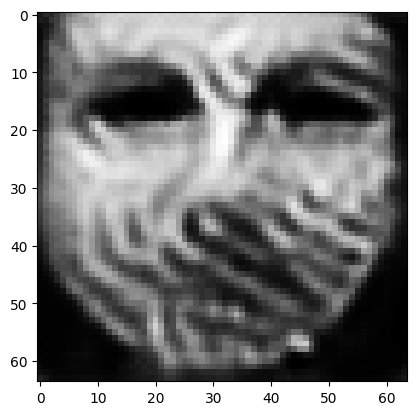

tensor([[2.7605e-05, 2.7483e-06, 7.4436e-04, 1.0253e-06, 1.7332e-05, 9.9669e-01,
         3.0574e-04, 6.9502e-04, 1.0384e-07, 1.1161e-05, 3.3765e-05, 3.1384e-05,
         2.4720e-06, 9.4632e-09, 2.2272e-09, 8.2028e-05, 7.0129e-05, 5.8516e-05,
         1.6931e-06, 2.1938e-04, 3.2345e-07, 2.7347e-07, 1.4460e-09, 2.7745e-07,
         2.4005e-07, 3.1722e-08, 1.7536e-04, 3.0430e-05, 1.1083e-04, 7.0715e-08,
         3.6413e-08, 8.0030e-07, 6.3734e-05, 2.4023e-06, 7.0097e-06, 2.6985e-08,
         9.4188e-07, 1.1314e-06, 1.3224e-06, 6.1236e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033176876604557037
tensor([[2.7603e-05, 2.7479e-06, 7.4427e-04, 1.0252e-06, 1.7329e-05, 9.9669e-01,
         3.0570e-04, 6.9493e-04, 1.0382e-07, 1.1159e-05, 3.3761e-05, 3.1381e-05,
         2.4716e-06, 9.4611e-09, 2.2267e-09, 8.2023e-05, 7.0121e-05, 5.8507e-05,
         1.6929e-06, 2.1934e-04, 3.2340e-07, 2.7342e-07, 1.4457e-09, 2.7741e-07,
         2.3999e-07, 3.1716e-08, 1.7534e

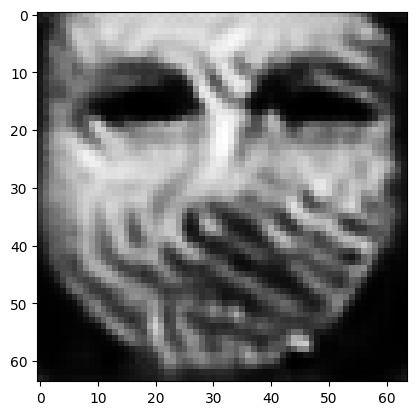

tensor([[2.7592e-05, 2.7463e-06, 7.4394e-04, 1.0245e-06, 1.7318e-05, 9.9669e-01,
         3.0555e-04, 6.9459e-04, 1.0374e-07, 1.1152e-05, 3.3748e-05, 3.1368e-05,
         2.4697e-06, 9.4532e-09, 2.2248e-09, 8.2004e-05, 7.0089e-05, 5.8473e-05,
         1.6919e-06, 2.1920e-04, 3.2322e-07, 2.7324e-07, 1.4444e-09, 2.7727e-07,
         2.3979e-07, 3.1690e-08, 1.7525e-04, 3.0408e-05, 1.1074e-04, 7.0652e-08,
         3.6378e-08, 7.9960e-07, 6.3676e-05, 2.3997e-06, 7.0051e-06, 2.6957e-08,
         9.4113e-07, 1.1303e-06, 1.3208e-06, 6.1203e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033156678546220064
tensor([[2.7589e-05, 2.7459e-06, 7.4386e-04, 1.0244e-06, 1.7316e-05, 9.9669e-01,
         3.0551e-04, 6.9451e-04, 1.0372e-07, 1.1150e-05, 3.3745e-05, 3.1365e-05,
         2.4693e-06, 9.4513e-09, 2.2243e-09, 8.1999e-05, 7.0081e-05, 5.8464e-05,
         1.6917e-06, 2.1916e-04, 3.2317e-07, 2.7319e-07, 1.4441e-09, 2.7723e-07,
         2.3974e-07, 3.1684e-08, 1.7523e

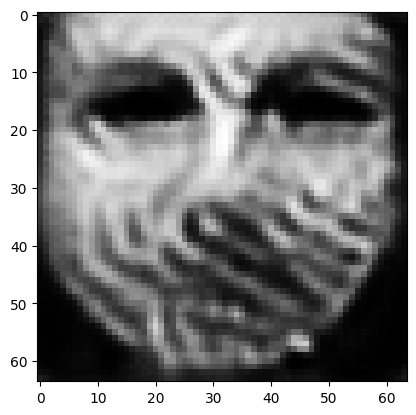

tensor([[2.7579e-05, 2.7444e-06, 7.4355e-04, 1.0238e-06, 1.7305e-05, 9.9669e-01,
         3.0537e-04, 6.9419e-04, 1.0364e-07, 1.1143e-05, 3.3733e-05, 3.1354e-05,
         2.4676e-06, 9.4438e-09, 2.2225e-09, 8.1982e-05, 7.0050e-05, 5.8432e-05,
         1.6907e-06, 2.1902e-04, 3.2300e-07, 2.7302e-07, 1.4429e-09, 2.7709e-07,
         2.3954e-07, 3.1660e-08, 1.7515e-04, 3.0388e-05, 1.1065e-04, 7.0593e-08,
         3.6345e-08, 7.9893e-07, 6.3621e-05, 2.3973e-06, 7.0008e-06, 2.6930e-08,
         9.4042e-07, 1.1292e-06, 1.3194e-06, 6.1172e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003313648048788309
tensor([[2.7577e-05, 2.7440e-06, 7.4348e-04, 1.0236e-06, 1.7303e-05, 9.9669e-01,
         3.0533e-04, 6.9411e-04, 1.0362e-07, 1.1141e-05, 3.3730e-05, 3.1351e-05,
         2.4671e-06, 9.4419e-09, 2.2221e-09, 8.1977e-05, 7.0042e-05, 5.8424e-05,
         1.6905e-06, 2.1899e-04, 3.2295e-07, 2.7297e-07, 1.4426e-09, 2.7706e-07,
         2.3949e-07, 3.1654e-08, 1.7513e-

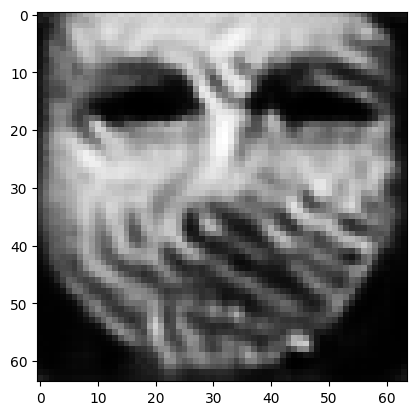

tensor([[2.7567e-05, 2.7426e-06, 7.4318e-04, 1.0231e-06, 1.7293e-05, 9.9669e-01,
         3.0519e-04, 6.9380e-04, 1.0355e-07, 1.1134e-05, 3.3718e-05, 3.1340e-05,
         2.4655e-06, 9.4348e-09, 2.2203e-09, 8.1960e-05, 7.0013e-05, 5.8393e-05,
         1.6896e-06, 2.1886e-04, 3.2279e-07, 2.7281e-07, 1.4415e-09, 2.7693e-07,
         2.3930e-07, 3.1632e-08, 1.7505e-04, 3.0368e-05, 1.1056e-04, 7.0536e-08,
         3.6314e-08, 7.9829e-07, 6.3569e-05, 2.3950e-06, 6.9967e-06, 2.6905e-08,
         9.3975e-07, 1.1283e-06, 1.3180e-06, 6.1142e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033117469865828753
tensor([[2.7565e-05, 2.7423e-06, 7.4311e-04, 1.0229e-06, 1.7291e-05, 9.9669e-01,
         3.0516e-04, 6.9373e-04, 1.0353e-07, 1.1133e-05, 3.3715e-05, 3.1337e-05,
         2.4651e-06, 9.4331e-09, 2.2199e-09, 8.1956e-05, 7.0006e-05, 5.8385e-05,
         1.6894e-06, 2.1883e-04, 3.2275e-07, 2.7277e-07, 1.4413e-09, 2.7690e-07,
         2.3926e-07, 3.1626e-08, 1.7503e

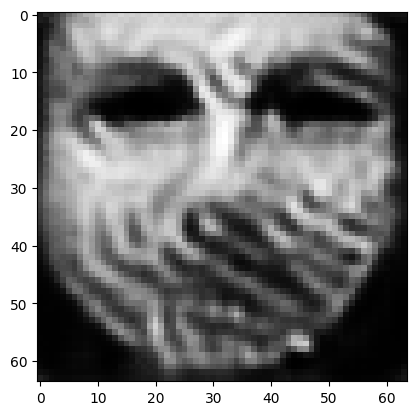

tensor([[2.7556e-05, 2.7409e-06, 7.4282e-04, 1.0224e-06, 1.7281e-05, 9.9670e-01,
         3.0503e-04, 6.9344e-04, 1.0346e-07, 1.1126e-05, 3.3704e-05, 3.1326e-05,
         2.4635e-06, 9.4263e-09, 2.2183e-09, 8.1939e-05, 6.9978e-05, 5.8355e-05,
         1.6886e-06, 2.1870e-04, 3.2259e-07, 2.7261e-07, 1.4402e-09, 2.7678e-07,
         2.3908e-07, 3.1605e-08, 1.7495e-04, 3.0350e-05, 1.1049e-04, 7.0482e-08,
         3.6284e-08, 7.9769e-07, 6.3518e-05, 2.3928e-06, 6.9928e-06, 2.6881e-08,
         9.3911e-07, 1.1273e-06, 1.3167e-06, 6.1114e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003309964668005705
tensor([[2.7554e-05, 2.7406e-06, 7.4276e-04, 1.0223e-06, 1.7279e-05, 9.9670e-01,
         3.0500e-04, 6.9337e-04, 1.0345e-07, 1.1124e-05, 3.3701e-05, 3.1324e-05,
         2.4632e-06, 9.4246e-09, 2.2179e-09, 8.1935e-05, 6.9971e-05, 5.8348e-05,
         1.6884e-06, 2.1867e-04, 3.2255e-07, 2.7257e-07, 1.4399e-09, 2.7675e-07,
         2.3903e-07, 3.1599e-08, 1.7493e-

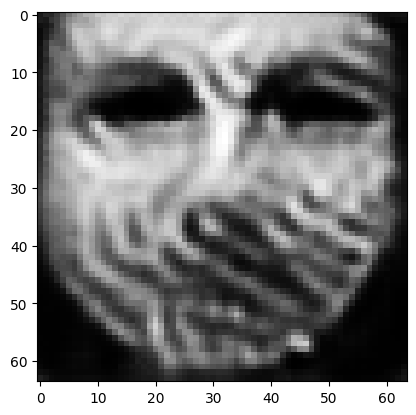

tensor([[2.7545e-05, 2.7392e-06, 7.4249e-04, 1.0217e-06, 1.7270e-05, 9.9670e-01,
         3.0487e-04, 6.9310e-04, 1.0338e-07, 1.1118e-05, 3.3691e-05, 3.1313e-05,
         2.4617e-06, 9.4181e-09, 2.2163e-09, 8.1920e-05, 6.9945e-05, 5.8320e-05,
         1.6876e-06, 2.1855e-04, 3.2240e-07, 2.7242e-07, 1.4389e-09, 2.7663e-07,
         2.3886e-07, 3.1579e-08, 1.7486e-04, 3.0332e-05, 1.1041e-04, 7.0431e-08,
         3.6255e-08, 7.9712e-07, 6.3471e-05, 2.3908e-06, 6.9891e-06, 2.6858e-08,
         9.3850e-07, 1.1264e-06, 1.3154e-06, 6.1086e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033083013258874416
tensor([[2.7543e-05, 2.7389e-06, 7.4242e-04, 1.0216e-06, 1.7268e-05, 9.9670e-01,
         3.0484e-04, 6.9303e-04, 1.0336e-07, 1.1117e-05, 3.3688e-05, 3.1311e-05,
         2.4613e-06, 9.4167e-09, 2.2159e-09, 8.1916e-05, 6.9939e-05, 5.8314e-05,
         1.6874e-06, 2.1852e-04, 3.2236e-07, 2.7239e-07, 1.4387e-09, 2.7660e-07,
         2.3883e-07, 3.1574e-08, 1.7484e

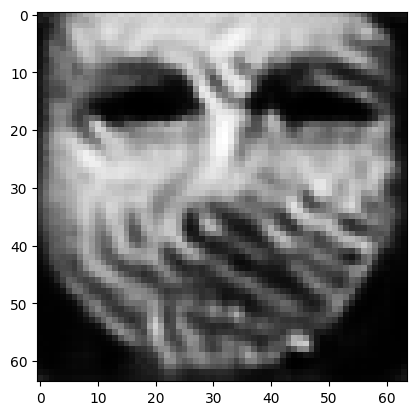

tensor([[2.7535e-05, 2.7377e-06, 7.4217e-04, 1.0211e-06, 1.7259e-05, 9.9670e-01,
         3.0472e-04, 6.9277e-04, 1.0330e-07, 1.1111e-05, 3.3678e-05, 3.1301e-05,
         2.4599e-06, 9.4105e-09, 2.2144e-09, 8.1901e-05, 6.9914e-05, 5.8286e-05,
         1.6866e-06, 2.1841e-04, 3.2221e-07, 2.7224e-07, 1.4377e-09, 2.7649e-07,
         2.3866e-07, 3.1554e-08, 1.7477e-04, 3.0315e-05, 1.1034e-04, 7.0382e-08,
         3.6229e-08, 7.9657e-07, 6.3426e-05, 2.3888e-06, 6.9855e-06, 2.6836e-08,
         9.3792e-07, 1.1256e-06, 1.3142e-06, 6.1061e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003306756727397442
tensor([[2.7533e-05, 2.7374e-06, 7.4211e-04, 1.0210e-06, 1.7257e-05, 9.9670e-01,
         3.0470e-04, 6.9271e-04, 1.0329e-07, 1.1110e-05, 3.3676e-05, 3.1299e-05,
         2.4596e-06, 9.4090e-09, 2.2141e-09, 8.1898e-05, 6.9908e-05, 5.8280e-05,
         1.6864e-06, 2.1838e-04, 3.2218e-07, 2.7221e-07, 1.4375e-09, 2.7647e-07,
         2.3862e-07, 3.1549e-08, 1.7476e-

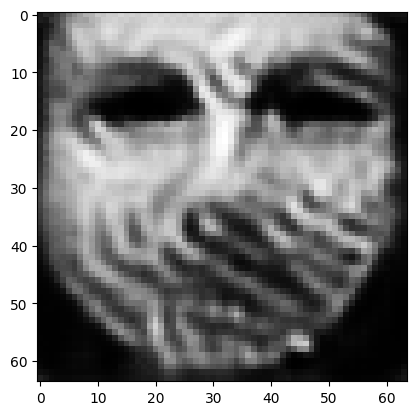

tensor([[2.7525e-05, 2.7362e-06, 7.4186e-04, 1.0206e-06, 1.7249e-05, 9.9670e-01,
         3.0458e-04, 6.9247e-04, 1.0323e-07, 1.1104e-05, 3.3666e-05, 3.1290e-05,
         2.4582e-06, 9.4031e-09, 2.2127e-09, 8.1883e-05, 6.9884e-05, 5.8255e-05,
         1.6857e-06, 2.1827e-04, 3.2204e-07, 2.7207e-07, 1.4365e-09, 2.7636e-07,
         2.3847e-07, 3.1531e-08, 1.7469e-04, 3.0299e-05, 1.1027e-04, 7.0336e-08,
         3.6203e-08, 7.9606e-07, 6.3384e-05, 2.3869e-06, 6.9822e-06, 2.6816e-08,
         9.3737e-07, 1.1248e-06, 1.3131e-06, 6.1036e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033053308725357056
tensor([[2.7523e-05, 2.7359e-06, 7.4180e-04, 1.0204e-06, 1.7247e-05, 9.9670e-01,
         3.0456e-04, 6.9241e-04, 1.0321e-07, 1.1103e-05, 3.3664e-05, 3.1288e-05,
         2.4579e-06, 9.4017e-09, 2.2123e-09, 8.1880e-05, 6.9878e-05, 5.8249e-05,
         1.6855e-06, 2.1824e-04, 3.2201e-07, 2.7204e-07, 1.4363e-09, 2.7634e-07,
         2.3843e-07, 3.1526e-08, 1.7468e

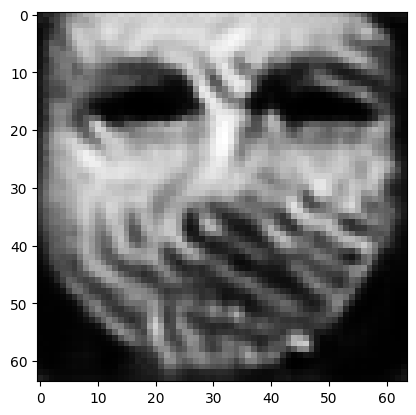

tensor([[2.7516e-05, 2.7348e-06, 7.4158e-04, 1.0200e-06, 1.7240e-05, 9.9670e-01,
         3.0445e-04, 6.9217e-04, 1.0316e-07, 1.1097e-05, 3.3655e-05, 3.1279e-05,
         2.4566e-06, 9.3963e-09, 2.2110e-09, 8.1867e-05, 6.9856e-05, 5.8225e-05,
         1.6849e-06, 2.1814e-04, 3.2188e-07, 2.7191e-07, 1.4355e-09, 2.7624e-07,
         2.3829e-07, 3.1509e-08, 1.7461e-04, 3.0284e-05, 1.1021e-04, 7.0293e-08,
         3.6179e-08, 7.9557e-07, 6.3343e-05, 2.3852e-06, 6.9791e-06, 2.6796e-08,
         9.3686e-07, 1.1240e-06, 1.3120e-06, 6.1013e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003303905250504613
tensor([[2.7514e-05, 2.7346e-06, 7.4152e-04, 1.0199e-06, 1.7238e-05, 9.9670e-01,
         3.0442e-04, 6.9212e-04, 1.0314e-07, 1.1096e-05, 3.3653e-05, 3.1277e-05,
         2.4563e-06, 9.3949e-09, 2.2107e-09, 8.1863e-05, 6.9851e-05, 5.8219e-05,
         1.6847e-06, 2.1812e-04, 3.2185e-07, 2.7188e-07, 1.4352e-09, 2.7621e-07,
         2.3826e-07, 3.1505e-08, 1.7460e-

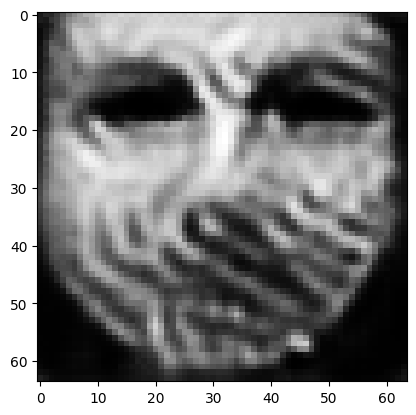

tensor([[2.7507e-05, 2.7335e-06, 7.4131e-04, 1.0195e-06, 1.7231e-05, 9.9670e-01,
         3.0432e-04, 6.9190e-04, 1.0309e-07, 1.1091e-05, 3.3644e-05, 3.1269e-05,
         2.4551e-06, 9.3897e-09, 2.2094e-09, 8.1851e-05, 6.9829e-05, 5.8196e-05,
         1.6840e-06, 2.1802e-04, 3.2173e-07, 2.7176e-07, 1.4344e-09, 2.7612e-07,
         2.3812e-07, 3.1488e-08, 1.7454e-04, 3.0270e-05, 1.1015e-04, 7.0251e-08,
         3.6156e-08, 7.9511e-07, 6.3305e-05, 2.3835e-06, 6.9761e-06, 2.6778e-08,
         9.3637e-07, 1.1233e-06, 1.3110e-06, 6.0991e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033024793956428766
tensor([[2.7506e-05, 2.7332e-06, 7.4125e-04, 1.0194e-06, 1.7229e-05, 9.9670e-01,
         3.0430e-04, 6.9185e-04, 1.0307e-07, 1.1090e-05, 3.3642e-05, 3.1267e-05,
         2.4548e-06, 9.3884e-09, 2.2091e-09, 8.1848e-05, 6.9824e-05, 5.8190e-05,
         1.6839e-06, 2.1800e-04, 3.2170e-07, 2.7173e-07, 1.4342e-09, 2.7610e-07,
         2.3809e-07, 3.1484e-08, 1.7453e

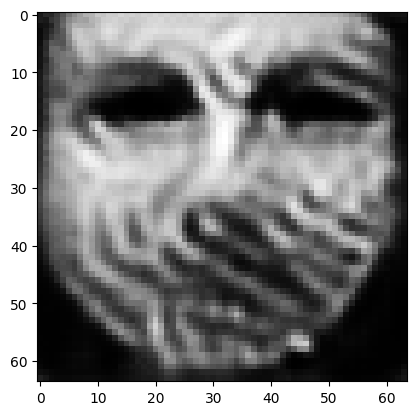

tensor([[2.7499e-05, 2.7322e-06, 7.4105e-04, 1.0190e-06, 1.7222e-05, 9.9670e-01,
         3.0420e-04, 6.9164e-04, 1.0302e-07, 1.1085e-05, 3.3634e-05, 3.1259e-05,
         2.4537e-06, 9.3835e-09, 2.2079e-09, 8.1836e-05, 6.9804e-05, 5.8169e-05,
         1.6833e-06, 2.1791e-04, 3.2158e-07, 2.7162e-07, 1.4335e-09, 2.7601e-07,
         2.3796e-07, 3.1469e-08, 1.7447e-04, 3.0256e-05, 1.1009e-04, 7.0211e-08,
         3.6134e-08, 7.9467e-07, 6.3269e-05, 2.3819e-06, 6.9732e-06, 2.6760e-08,
         9.3590e-07, 1.1226e-06, 1.3100e-06, 6.0970e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003301291260868311
tensor([[2.7498e-05, 2.7320e-06, 7.4100e-04, 1.0189e-06, 1.7221e-05, 9.9670e-01,
         3.0418e-04, 6.9158e-04, 1.0301e-07, 1.1084e-05, 3.3632e-05, 3.1257e-05,
         2.4534e-06, 9.3823e-09, 2.2077e-09, 8.1834e-05, 6.9799e-05, 5.8164e-05,
         1.6831e-06, 2.1788e-04, 3.2156e-07, 2.7159e-07, 1.4333e-09, 2.7599e-07,
         2.3793e-07, 3.1465e-08, 1.7446e-

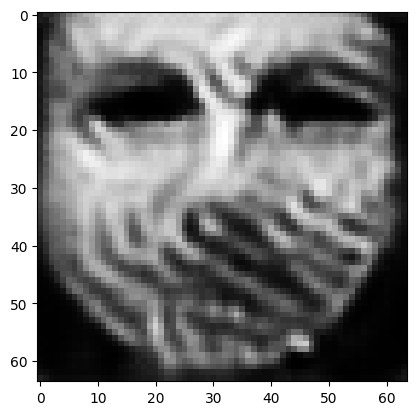

tensor([[2.7492e-05, 2.7310e-06, 7.4080e-04, 1.0185e-06, 1.7214e-05, 9.9671e-01,
         3.0409e-04, 6.9139e-04, 1.0296e-07, 1.1079e-05, 3.3624e-05, 3.1250e-05,
         2.4523e-06, 9.3776e-09, 2.2065e-09, 8.1822e-05, 6.9780e-05, 5.8144e-05,
         1.6825e-06, 2.1780e-04, 3.2145e-07, 2.7148e-07, 1.4325e-09, 2.7591e-07,
         2.3781e-07, 3.1450e-08, 1.7440e-04, 3.0243e-05, 1.1003e-04, 7.0174e-08,
         3.6114e-08, 7.9425e-07, 6.3235e-05, 2.3804e-06, 6.9705e-06, 2.6744e-08,
         9.3547e-07, 1.1220e-06, 1.3091e-06, 6.0951e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0033001031260937452
tensor([[2.7490e-05, 2.7308e-06, 7.4075e-04, 1.0184e-06, 1.7213e-05, 9.9671e-01,
         3.0407e-04, 6.9134e-04, 1.0295e-07, 1.1078e-05, 3.3622e-05, 3.1248e-05,
         2.4521e-06, 9.3765e-09, 2.2062e-09, 8.1820e-05, 6.9776e-05, 5.8139e-05,
         1.6824e-06, 2.1778e-04, 3.2142e-07, 2.7145e-07, 1.4324e-09, 2.7588e-07,
         2.3778e-07, 3.1446e-08, 1.7439e

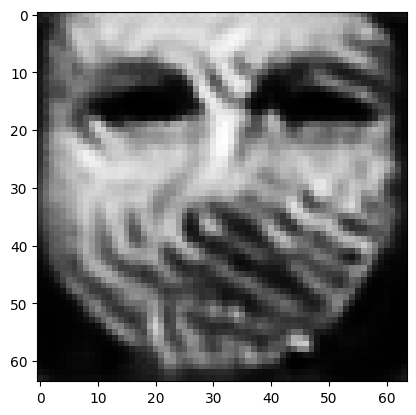

tensor([[2.7484e-05, 2.7299e-06, 7.4056e-04, 1.0181e-06, 1.7206e-05, 9.9671e-01,
         3.0398e-04, 6.9115e-04, 1.0290e-07, 1.1074e-05, 3.3614e-05, 3.1241e-05,
         2.4510e-06, 9.3719e-09, 2.2051e-09, 8.1808e-05, 6.9757e-05, 5.8119e-05,
         1.6818e-06, 2.1769e-04, 3.2131e-07, 2.7135e-07, 1.4316e-09, 2.7580e-07,
         2.3766e-07, 3.1432e-08, 1.7434e-04, 3.0231e-05, 1.0998e-04, 7.0138e-08,
         3.6094e-08, 7.9385e-07, 6.3201e-05, 2.3789e-06, 6.9679e-06, 2.6728e-08,
         9.3504e-07, 1.1214e-06, 1.3082e-06, 6.0931e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0032989149913191795
tensor([[2.7483e-05, 2.7297e-06, 7.4052e-04, 1.0180e-06, 1.7205e-05, 9.9671e-01,
         3.0396e-04, 6.9110e-04, 1.0289e-07, 1.1073e-05, 3.3613e-05, 3.1239e-05,
         2.4508e-06, 9.3709e-09, 2.2049e-09, 8.1806e-05, 6.9753e-05, 5.8114e-05,
         1.6817e-06, 2.1767e-04, 3.2129e-07, 2.7132e-07, 1.4315e-09, 2.7578e-07,
         2.3763e-07, 3.1429e-08, 1.7433e

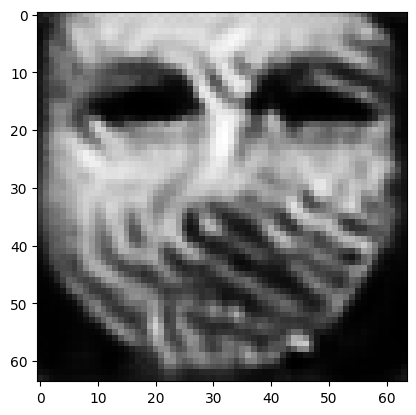

tensor([[2.7477e-05, 2.7288e-06, 7.4035e-04, 1.0177e-06, 1.7199e-05, 9.9671e-01,
         3.0388e-04, 6.9092e-04, 1.0285e-07, 1.1069e-05, 3.3606e-05, 3.1232e-05,
         2.4498e-06, 9.3667e-09, 2.2039e-09, 8.1796e-05, 6.9736e-05, 5.8096e-05,
         1.6812e-06, 2.1759e-04, 3.2119e-07, 2.7122e-07, 1.4308e-09, 2.7571e-07,
         2.3752e-07, 3.1415e-08, 1.7428e-04, 3.0219e-05, 1.0993e-04, 7.0105e-08,
         3.6075e-08, 7.9348e-07, 6.3170e-05, 2.3776e-06, 6.9655e-06, 2.6713e-08,
         9.3465e-07, 1.1208e-06, 1.3074e-06, 6.0914e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00329772662371397
tensor([[2.7476e-05, 2.7286e-06, 7.4030e-04, 1.0176e-06, 1.7198e-05, 9.9671e-01,
         3.0385e-04, 6.9088e-04, 1.0284e-07, 1.1068e-05, 3.3604e-05, 3.1231e-05,
         2.4495e-06, 9.3656e-09, 2.2036e-09, 8.1793e-05, 6.9731e-05, 5.8091e-05,
         1.6810e-06, 2.1757e-04, 3.2116e-07, 2.7120e-07, 1.4306e-09, 2.7569e-07,
         2.3749e-07, 3.1412e-08, 1.7427e-0

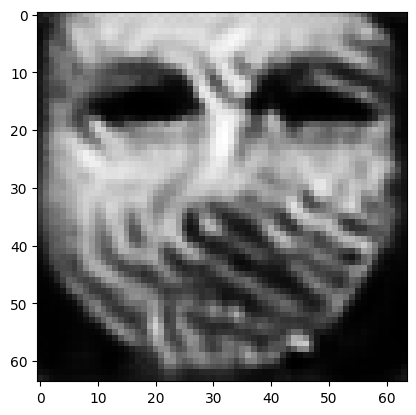

tensor([[2.7470e-05, 2.7278e-06, 7.4013e-04, 1.0173e-06, 1.7192e-05, 9.9671e-01,
         3.0377e-04, 6.9070e-04, 1.0280e-07, 1.1064e-05, 3.3597e-05, 3.1224e-05,
         2.4486e-06, 9.3615e-09, 2.2026e-09, 8.1783e-05, 6.9714e-05, 5.8073e-05,
         1.6805e-06, 2.1750e-04, 3.2107e-07, 2.7110e-07, 1.4300e-09, 2.7561e-07,
         2.3738e-07, 3.1399e-08, 1.7422e-04, 3.0208e-05, 1.0988e-04, 7.0072e-08,
         3.6058e-08, 7.9311e-07, 6.3140e-05, 2.3763e-06, 6.9632e-06, 2.6698e-08,
         9.3426e-07, 1.1202e-06, 1.3066e-06, 6.0897e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003296776209026575
tensor([[2.7469e-05, 2.7276e-06, 7.4009e-04, 1.0172e-06, 1.7191e-05, 9.9671e-01,
         3.0376e-04, 6.9066e-04, 1.0279e-07, 1.1063e-05, 3.3596e-05, 3.1223e-05,
         2.4484e-06, 9.3606e-09, 2.2024e-09, 8.1781e-05, 6.9711e-05, 5.8069e-05,
         1.6804e-06, 2.1748e-04, 3.2105e-07, 2.7108e-07, 1.4299e-09, 2.7560e-07,
         2.3736e-07, 3.1396e-08, 1.7421e-

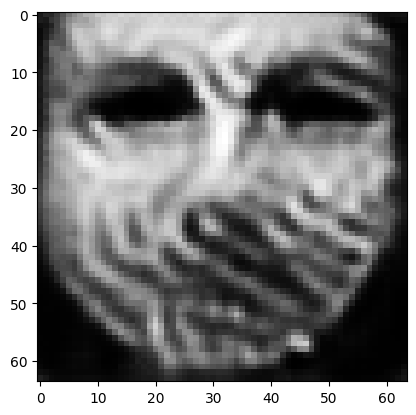

tensor([[2.7464e-05, 2.7268e-06, 7.3993e-04, 1.0169e-06, 1.7185e-05, 9.9671e-01,
         3.0368e-04, 6.9050e-04, 1.0275e-07, 1.1059e-05, 3.3589e-05, 3.1217e-05,
         2.4475e-06, 9.3567e-09, 2.2014e-09, 8.1772e-05, 6.9695e-05, 5.8052e-05,
         1.6799e-06, 2.1741e-04, 3.2096e-07, 2.7099e-07, 1.4293e-09, 2.7553e-07,
         2.3726e-07, 3.1384e-08, 1.7417e-04, 3.0197e-05, 1.0984e-04, 7.0042e-08,
         3.6041e-08, 7.9277e-07, 6.3112e-05, 2.3750e-06, 6.9610e-06, 2.6685e-08,
         9.3390e-07, 1.1197e-06, 1.3059e-06, 6.0881e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0032958255615085363
tensor([[2.7463e-05, 2.7266e-06, 7.3989e-04, 1.0168e-06, 1.7184e-05, 9.9671e-01,
         3.0366e-04, 6.9046e-04, 1.0274e-07, 1.1059e-05, 3.3588e-05, 3.1215e-05,
         2.4473e-06, 9.3558e-09, 2.2012e-09, 8.1769e-05, 6.9691e-05, 5.8048e-05,
         1.6798e-06, 2.1739e-04, 3.2094e-07, 2.7097e-07, 1.4291e-09, 2.7551e-07,
         2.3724e-07, 3.1381e-08, 1.7416e

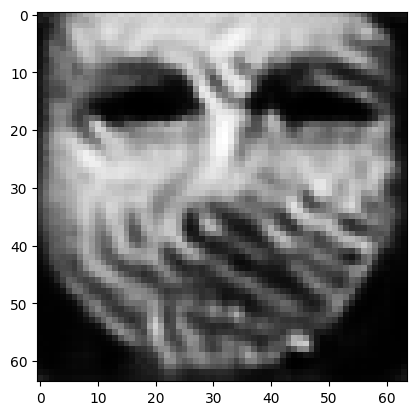

tensor([[2.7458e-05, 2.7259e-06, 7.3974e-04, 1.0165e-06, 1.7179e-05, 9.9671e-01,
         3.0359e-04, 6.9030e-04, 1.0270e-07, 1.1055e-05, 3.3582e-05, 3.1210e-05,
         2.4465e-06, 9.3522e-09, 2.2003e-09, 8.1760e-05, 6.9676e-05, 5.8032e-05,
         1.6794e-06, 2.1732e-04, 3.2085e-07, 2.7089e-07, 1.4286e-09, 2.7545e-07,
         2.3714e-07, 3.1369e-08, 1.7412e-04, 3.0187e-05, 1.0980e-04, 7.0013e-08,
         3.6025e-08, 7.9245e-07, 6.3086e-05, 2.3739e-06, 6.9589e-06, 2.6672e-08,
         9.3356e-07, 1.1192e-06, 1.3052e-06, 6.0866e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0032948751468211412
tensor([[2.7457e-05, 2.7257e-06, 7.3971e-04, 1.0165e-06, 1.7178e-05, 9.9671e-01,
         3.0357e-04, 6.9027e-04, 1.0269e-07, 1.1054e-05, 3.3580e-05, 3.1208e-05,
         2.4463e-06, 9.3513e-09, 2.2001e-09, 8.1759e-05, 6.9672e-05, 5.8028e-05,
         1.6793e-06, 2.1730e-04, 3.2083e-07, 2.7087e-07, 1.4284e-09, 2.7543e-07,
         2.3712e-07, 3.1366e-08, 1.7411e

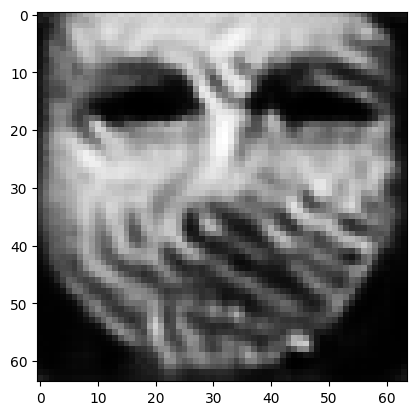

tensor([[2.7452e-05, 2.7250e-06, 7.3956e-04, 1.0162e-06, 1.7173e-05, 9.9671e-01,
         3.0351e-04, 6.9012e-04, 1.0266e-07, 1.1051e-05, 3.3575e-05, 3.1203e-05,
         2.4455e-06, 9.3479e-09, 2.1993e-09, 8.1750e-05, 6.9658e-05, 5.8013e-05,
         1.6788e-06, 2.1724e-04, 3.2075e-07, 2.7079e-07, 1.4279e-09, 2.7537e-07,
         2.3703e-07, 3.1355e-08, 1.7407e-04, 3.0178e-05, 1.0976e-04, 6.9986e-08,
         3.6010e-08, 7.9215e-07, 6.3060e-05, 2.3728e-06, 6.9569e-06, 2.6660e-08,
         9.3324e-07, 1.1187e-06, 1.3045e-06, 6.0851e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0032939244993031025
tensor([[2.7451e-05, 2.7249e-06, 7.3952e-04, 1.0161e-06, 1.7172e-05, 9.9671e-01,
         3.0349e-04, 6.9008e-04, 1.0265e-07, 1.1050e-05, 3.3573e-05, 3.1201e-05,
         2.4453e-06, 9.3469e-09, 2.1991e-09, 8.1748e-05, 6.9655e-05, 5.8009e-05,
         1.6787e-06, 2.1722e-04, 3.2073e-07, 2.7077e-07, 1.4277e-09, 2.7535e-07,
         2.3700e-07, 3.1353e-08, 1.7406e

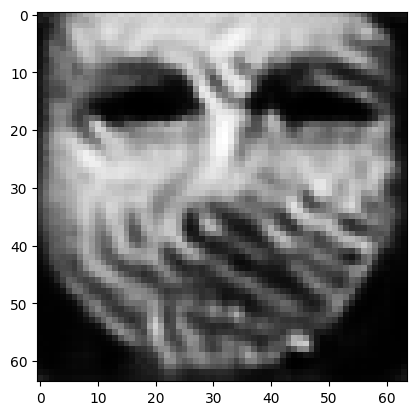

tensor([[2.7446e-05, 2.7242e-06, 7.3939e-04, 1.0159e-06, 1.7168e-05, 9.9671e-01,
         3.0343e-04, 6.8994e-04, 1.0262e-07, 1.1047e-05, 3.3568e-05, 3.1196e-05,
         2.4445e-06, 9.3437e-09, 2.1983e-09, 8.1741e-05, 6.9642e-05, 5.7995e-05,
         1.6783e-06, 2.1716e-04, 3.2065e-07, 2.7069e-07, 1.4272e-09, 2.7529e-07,
         2.3692e-07, 3.1342e-08, 1.7402e-04, 3.0168e-05, 1.0972e-04, 6.9960e-08,
         3.5995e-08, 7.9185e-07, 6.3036e-05, 2.3717e-06, 6.9551e-06, 2.6648e-08,
         9.3293e-07, 1.1183e-06, 1.3039e-06, 6.0837e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.003293092828243971
tensor([[2.7446e-05, 2.7240e-06, 7.3936e-04, 1.0158e-06, 1.7166e-05, 9.9671e-01,
         3.0341e-04, 6.8991e-04, 1.0261e-07, 1.1046e-05, 3.3567e-05, 3.1195e-05,
         2.4443e-06, 9.3429e-09, 2.1981e-09, 8.1739e-05, 6.9639e-05, 5.7992e-05,
         1.6782e-06, 2.1715e-04, 3.2063e-07, 2.7067e-07, 1.4271e-09, 2.7528e-07,
         2.3690e-07, 3.1340e-08, 1.7401e-

In [16]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=5)

tensor([[2.5848e-04, 4.0420e-05, 9.8727e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0773e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2035e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  9.273275375366211


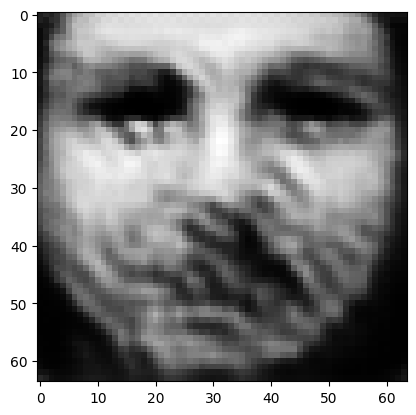

tensor([[5.5907e-05, 3.9048e-04, 7.8226e-04, 2.0091e-03, 2.1264e-02, 5.9396e-05,
         7.0957e-04, 2.4711e-04, 3.1238e-04, 1.0867e-05, 1.0372e-04, 4.4782e-05,
         8.2091e-03, 2.1653e-02, 2.9403e-04, 1.8573e-05, 1.5991e-02, 4.1071e-03,
         4.1842e-04, 6.5564e-05, 1.7495e-02, 6.5332e-05, 3.5492e-01, 1.3134e-04,
         2.4409e-01, 3.7637e-02, 5.5661e-05, 7.1997e-04, 6.3627e-04, 1.8975e-03,
         4.7800e-04, 6.0240e-04, 9.3826e-03, 2.9088e-03, 1.1131e-02, 7.8694e-03,
         2.2381e-01, 4.8013e-03, 3.7441e-03, 8.7769e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.250853538513184
tensor([[8.4255e-04, 5.4191e-05, 1.7794e-03, 3.6000e-05, 3.6085e-03, 1.7625e-02,
         2.2823e-01, 2.7460e-03, 8.8349e-05, 4.2182e-04, 1.3131e-03, 4.8576e-04,
         1.8982e-03, 6.6508e-05, 8.8366e-05, 1.0940e-03, 5.1529e-03, 7.6464e-02,
         2.2214e-04, 3.4989e-01, 4.8684e-04, 1.0052e-04, 3.8929e-06, 1.7478e-04,
         2.0101e-03, 1.4378e-06, 2.0361e-02,

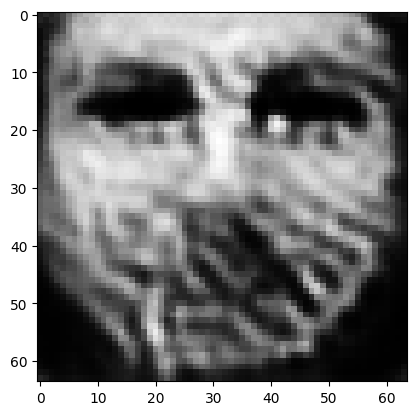

tensor([[1.7527e-03, 2.5260e-06, 2.8007e-04, 3.6545e-06, 1.9071e-04, 6.9437e-03,
         9.3306e-01, 8.8467e-03, 3.6080e-07, 2.5231e-05, 2.1852e-04, 1.5879e-05,
         2.3934e-05, 8.0092e-07, 5.2579e-06, 6.9569e-04, 3.8204e-03, 1.7418e-02,
         1.0101e-04, 1.7883e-02, 1.2815e-05, 5.9648e-06, 5.5862e-08, 7.6384e-04,
         1.7748e-04, 5.0071e-08, 5.4329e-04, 3.4135e-04, 9.8300e-04, 5.0006e-06,
         3.3066e-07, 1.4503e-04, 5.1903e-03, 1.8868e-04, 9.3233e-06, 1.3362e-05,
         2.7978e-05, 2.9288e-05, 1.8887e-04, 8.7826e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06928819417953491
tensor([[1.5912e-03, 2.1736e-06, 2.3922e-04, 3.1943e-06, 1.6099e-04, 6.1631e-03,
         9.4121e-01, 7.9987e-03, 2.9121e-07, 2.1798e-05, 1.8592e-04, 1.2607e-05,
         2.0110e-05, 6.4044e-07, 4.4680e-06, 6.5466e-04, 3.5547e-03, 1.4831e-02,
         9.4049e-05, 1.5651e-02, 1.1116e-05, 4.9210e-06, 4.7216e-08, 7.1804e-04,
         1.4665e-04, 4.0751e-08, 4.7231e-0

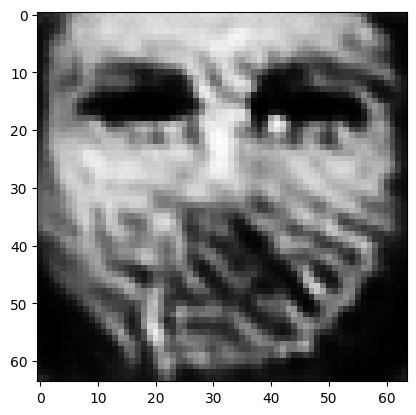

tensor([[1.2905e-03, 1.4845e-06, 1.4617e-04, 2.2109e-06, 9.5323e-05, 4.2950e-03,
         9.5865e-01, 5.9145e-03, 1.5531e-07, 1.5100e-05, 1.2180e-04, 7.0963e-06,
         1.1986e-05, 3.4180e-07, 3.1162e-06, 5.7713e-04, 2.6853e-03, 1.0165e-02,
         7.8315e-05, 1.0923e-02, 7.3152e-06, 2.9274e-06, 2.6884e-08, 5.9204e-04,
         8.2946e-05, 2.1526e-08, 3.2499e-04, 2.0501e-04, 6.5291e-04, 2.8546e-06,
         1.5259e-07, 7.5714e-05, 2.7832e-03, 9.4193e-05, 5.5708e-06, 7.4636e-06,
         1.4575e-05, 1.4691e-05, 1.0007e-04, 5.2535e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04223121702671051
tensor([[1.2348e-03, 1.3909e-06, 1.3486e-04, 2.0719e-06, 8.7344e-05, 4.0536e-03,
         9.6108e-01, 5.6150e-03, 1.4168e-07, 1.4263e-05, 1.1301e-04, 6.4247e-06,
         1.1088e-05, 3.0650e-07, 2.9102e-06, 5.6050e-04, 2.5527e-03, 9.4007e-03,
         7.6129e-05, 1.0352e-02, 6.8046e-06, 2.6898e-06, 2.4595e-08, 5.6516e-04,
         7.5077e-05, 1.9374e-08, 3.0669e-0

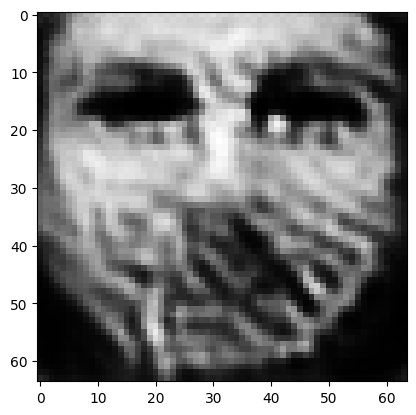

tensor([[1.0613e-03, 1.1177e-06, 1.0139e-04, 1.6746e-06, 6.5610e-05, 3.2565e-03,
         9.6824e-01, 4.6360e-03, 1.0430e-07, 1.1610e-05, 8.7642e-05, 4.5407e-06,
         8.6628e-06, 2.1827e-07, 2.3717e-06, 5.0116e-04, 2.1835e-03, 7.3251e-03,
         6.8971e-05, 8.6402e-03, 5.3867e-06, 2.0231e-06, 1.8755e-08, 4.8995e-04,
         5.5136e-05, 1.3759e-08, 2.4905e-04, 1.5606e-04, 5.2645e-04, 2.1467e-06,
         1.0392e-07, 5.3016e-05, 2.0487e-03, 6.7037e-05, 4.2658e-06, 5.4767e-06,
         1.0096e-05, 9.9325e-06, 7.5144e-05, 4.1269e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.032274212688207626
tensor([[1.0281e-03, 1.0602e-06, 9.5841e-05, 1.5938e-06, 6.1747e-05, 3.1128e-03,
         9.6961e-01, 4.4726e-03, 9.7671e-08, 1.1093e-05, 8.3057e-05, 4.2193e-06,
         8.1846e-06, 2.0216e-07, 2.2628e-06, 4.8718e-04, 2.1155e-03, 6.9166e-03,
         6.7325e-05, 8.2899e-03, 5.1125e-06, 1.9089e-06, 1.7633e-08, 4.7828e-04,
         5.1821e-05, 1.2843e-08, 2.3633e-

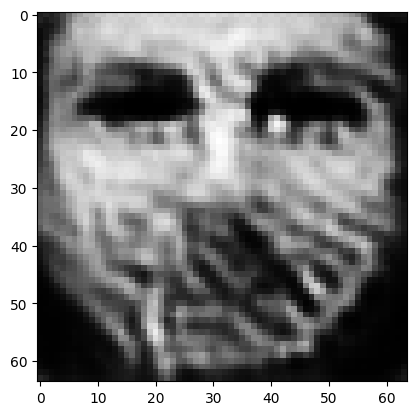

tensor([[9.1827e-04, 8.7904e-07, 7.9753e-05, 1.3633e-06, 5.1260e-05, 2.6083e-03,
         9.7385e-01, 3.9262e-03, 8.0894e-08, 9.5248e-06, 6.9795e-05, 3.2896e-06,
         6.9325e-06, 1.6061e-07, 1.9727e-06, 4.3526e-04, 1.9249e-03, 5.6928e-03,
         6.2157e-05, 7.2122e-03, 4.3790e-06, 1.5744e-06, 1.4691e-08, 4.4269e-04,
         4.3158e-05, 1.0369e-08, 1.9617e-04, 1.2877e-04, 4.5458e-04, 1.7734e-06,
         8.0775e-08, 4.0412e-05, 1.6544e-03, 5.2813e-05, 3.4997e-06, 4.3817e-06,
         7.7608e-06, 7.5986e-06, 6.4254e-05, 3.4952e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026496313512325287
tensor([[8.9317e-04, 8.4575e-07, 7.6464e-05, 1.3216e-06, 4.9291e-05, 2.4986e-03,
         9.7470e-01, 3.7919e-03, 7.8125e-08, 9.2011e-06, 6.7160e-05, 3.1164e-06,
         6.7273e-06, 1.5353e-07, 1.9243e-06, 4.2466e-04, 1.8836e-03, 5.4695e-03,
         6.1227e-05, 7.0114e-03, 4.2567e-06, 1.5090e-06, 1.4188e-08, 4.3351e-04,
         4.1486e-05, 9.8817e-09, 1.8894e-

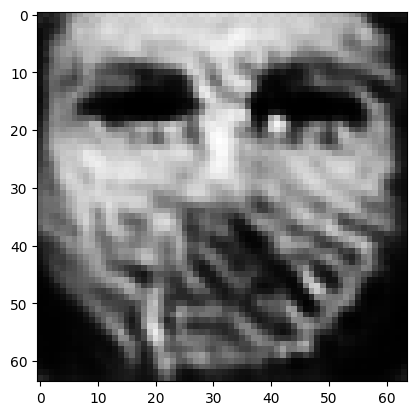

tensor([[8.1535e-04, 7.2673e-07, 6.7118e-05, 1.1772e-06, 4.2460e-05, 2.1673e-03,
         9.7754e-01, 3.3968e-03, 6.8117e-08, 8.2294e-06, 5.9402e-05, 2.5933e-06,
         5.9364e-06, 1.2924e-07, 1.7301e-06, 3.9060e-04, 1.7524e-03, 4.6756e-03,
         5.7907e-05, 6.2899e-03, 3.8052e-06, 1.3043e-06, 1.2243e-08, 4.0962e-04,
         3.5866e-05, 8.3971e-09, 1.6315e-04, 1.1185e-04, 4.1719e-04, 1.5603e-06,
         6.7199e-08, 3.2504e-05, 1.3987e-03, 4.4502e-05, 3.0457e-06, 3.7020e-06,
         6.3519e-06, 6.1695e-06, 5.8075e-05, 3.1148e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.02272014506161213
tensor([[8.0108e-04, 7.0132e-07, 6.5294e-05, 1.1463e-06, 4.1084e-05, 2.1000e-03,
         9.7812e-01, 3.3232e-03, 6.5797e-08, 8.0227e-06, 5.7876e-05, 2.4897e-06,
         5.7566e-06, 1.2415e-07, 1.6878e-06, 3.8349e-04, 1.7271e-03, 4.5181e-03,
         5.7106e-05, 6.1276e-03, 3.7057e-06, 1.2624e-06, 1.1808e-08, 4.0658e-04,
         3.4753e-05, 8.0977e-09, 1.5726e-0

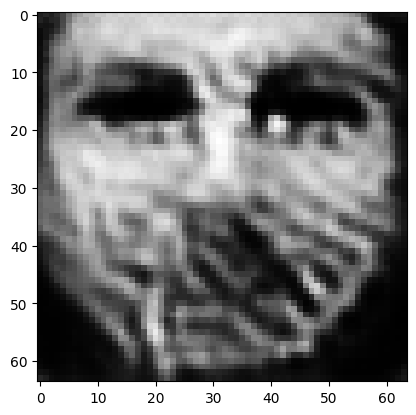

tensor([[7.5059e-04, 6.2129e-07, 5.9188e-05, 1.0456e-06, 3.6381e-05, 1.8713e-03,
         9.8000e-01, 3.0586e-03, 5.8344e-08, 7.3472e-06, 5.2814e-05, 2.1666e-06,
         5.1707e-06, 1.0803e-07, 1.5600e-06, 3.6032e-04, 1.6336e-03, 4.0392e-03,
         5.4608e-05, 5.6275e-03, 3.3850e-06, 1.1282e-06, 1.0352e-08, 3.9328e-04,
         3.0815e-05, 7.0884e-09, 1.3877e-04, 1.0084e-04, 3.9135e-04, 1.3994e-06,
         5.7512e-08, 2.7370e-05, 1.2116e-03, 3.8582e-05, 2.7087e-06, 3.2138e-06,
         5.4254e-06, 5.2586e-06, 5.3015e-05, 2.7862e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0202010627835989
tensor([[7.3901e-04, 6.0387e-07, 5.8047e-05, 1.0217e-06, 3.5322e-05, 1.8289e-03,
         9.8041e-01, 3.0100e-03, 5.6717e-08, 7.2224e-06, 5.1706e-05, 2.1033e-06,
         5.0310e-06, 1.0406e-07, 1.5243e-06, 3.5542e-04, 1.6103e-03, 3.9252e-03,
         5.3982e-05, 5.5214e-03, 3.3087e-06, 1.0997e-06, 9.9927e-09, 3.8931e-04,
         2.9866e-05, 6.8717e-09, 1.3490e-04

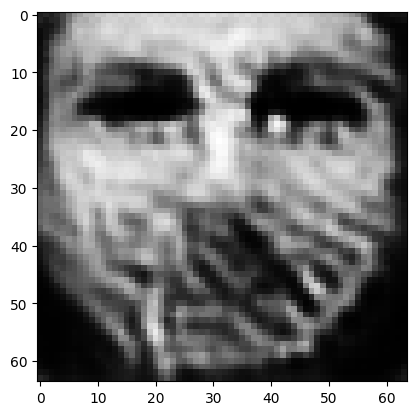

tensor([[6.9169e-04, 5.4551e-07, 5.3327e-05, 9.3913e-07, 3.1699e-05, 1.6753e-03,
         9.8190e-01, 2.7945e-03, 5.1111e-08, 6.6930e-06, 4.7354e-05, 1.8788e-06,
         4.5803e-06, 9.0551e-08, 1.3963e-06, 3.3658e-04, 1.5138e-03, 3.5556e-03,
         5.1575e-05, 5.1331e-03, 3.0449e-06, 9.9504e-07, 8.8625e-09, 3.6929e-04,
         2.6506e-05, 6.0499e-09, 1.2228e-04, 9.1751e-05, 3.6893e-04, 1.2481e-06,
         4.9815e-08, 2.3573e-05, 1.0670e-03, 3.4104e-05, 2.4516e-06, 2.8133e-06,
         4.7129e-06, 4.5148e-06, 4.8666e-05, 2.5508e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.018263859674334526
tensor([[6.8087e-04, 5.3256e-07, 5.2203e-05, 9.2044e-07, 3.0863e-05, 1.6394e-03,
         9.8225e-01, 2.7396e-03, 4.9741e-08, 6.5616e-06, 4.6333e-05, 1.8305e-06,
         4.4756e-06, 8.7522e-08, 1.3678e-06, 3.3245e-04, 1.4894e-03, 3.4797e-03,
         5.0976e-05, 5.0394e-03, 2.9843e-06, 9.7117e-07, 8.6037e-09, 3.6427e-04,
         2.5735e-05, 5.8526e-09, 1.1945e-

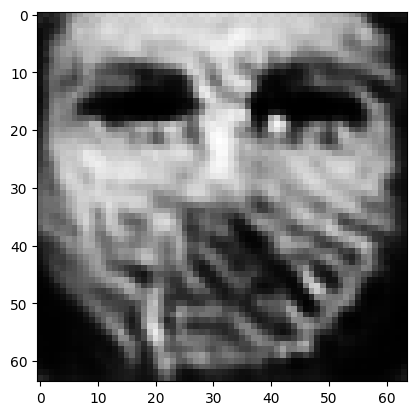

tensor([[6.4136e-04, 4.8038e-07, 4.8447e-05, 8.4849e-07, 2.7853e-05, 1.5203e-03,
         9.8356e-01, 2.5547e-03, 4.4756e-08, 6.0753e-06, 4.2531e-05, 1.6548e-06,
         4.0801e-06, 7.6057e-08, 1.2441e-06, 3.1571e-04, 1.4045e-03, 3.1604e-03,
         4.8464e-05, 4.6823e-03, 2.7556e-06, 8.8515e-07, 7.6608e-09, 3.4638e-04,
         2.3022e-05, 5.1744e-09, 1.0812e-04, 8.3788e-05, 3.4541e-04, 1.1056e-06,
         4.3179e-08, 2.0488e-05, 9.4075e-04, 3.0164e-05, 2.2369e-06, 2.4766e-06,
         4.1423e-06, 3.9092e-06, 4.4523e-05, 2.3369e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016581345349550247
tensor([[6.3264e-04, 4.7014e-07, 4.7475e-05, 8.3383e-07, 2.7189e-05, 1.4893e-03,
         9.8384e-01, 2.5073e-03, 4.3647e-08, 5.9653e-06, 4.1697e-05, 1.6144e-06,
         3.9973e-06, 7.3841e-08, 1.2226e-06, 3.1227e-04, 1.3853e-03, 3.0992e-03,
         4.7959e-05, 4.6074e-03, 2.7071e-06, 8.6545e-07, 7.4642e-09, 3.4186e-04,
         2.2416e-05, 5.0190e-09, 1.0578e-

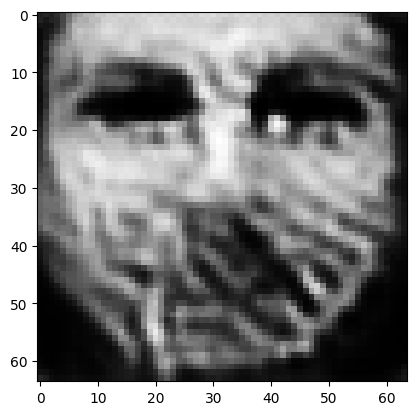

tensor([[6.0187e-04, 4.2936e-07, 4.4549e-05, 7.7973e-07, 2.4825e-05, 1.3956e-03,
         9.8488e-01, 2.3607e-03, 3.9698e-08, 5.5914e-06, 3.8871e-05, 1.4739e-06,
         3.6797e-06, 6.5474e-08, 1.1252e-06, 2.9974e-04, 1.3254e-03, 2.8355e-03,
         4.5969e-05, 4.3195e-03, 2.5289e-06, 7.9620e-07, 6.7367e-09, 3.2750e-04,
         2.0309e-05, 4.5176e-09, 9.6533e-05, 7.7777e-05, 3.2786e-04, 1.0006e-06,
         3.8104e-08, 1.8007e-05, 8.3923e-04, 2.7142e-05, 2.0778e-06, 2.2051e-06,
         3.6935e-06, 3.4464e-06, 4.1028e-05, 2.1670e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01523395162075758
tensor([[5.9448e-04, 4.2004e-07, 4.3911e-05, 7.6752e-07, 2.4285e-05, 1.3754e-03,
         9.8512e-01, 2.3276e-03, 3.8822e-08, 5.5054e-06, 3.8227e-05, 1.4427e-06,
         3.6066e-06, 6.3584e-08, 1.1015e-06, 2.9687e-04, 1.3117e-03, 2.7734e-03,
         4.5500e-05, 4.2511e-03, 2.4882e-06, 7.8015e-07, 6.5753e-09, 3.2381e-04,
         1.9830e-05, 4.4062e-09, 9.4498e-0

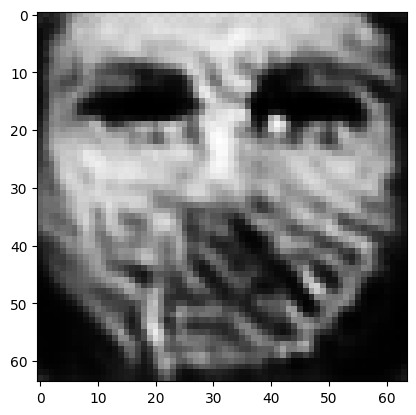

tensor([[5.6845e-04, 3.8831e-07, 4.1620e-05, 7.2612e-07, 2.2421e-05, 1.3045e-03,
         9.8596e-01, 2.2041e-03, 3.5804e-08, 5.2000e-06, 3.5942e-05, 1.3332e-06,
         3.3584e-06, 5.7210e-08, 1.0229e-06, 2.8713e-04, 1.2625e-03, 2.5629e-03,
         4.3928e-05, 4.0175e-03, 2.3501e-06, 7.2552e-07, 6.0249e-09, 3.1145e-04,
         1.8196e-05, 4.0276e-09, 8.7534e-05, 7.2895e-05, 3.1496e-04, 9.1762e-07,
         3.4164e-08, 1.6023e-05, 7.5795e-04, 2.4744e-05, 1.9565e-06, 1.9823e-06,
         3.3443e-06, 3.0892e-06, 3.8198e-05, 2.0454e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014139472506940365
tensor([[5.6274e-04, 3.8169e-07, 4.1106e-05, 7.1734e-07, 2.2034e-05, 1.2883e-03,
         9.8614e-01, 2.1767e-03, 3.5176e-08, 5.1327e-06, 3.5426e-05, 1.3091e-06,
         3.3073e-06, 5.5900e-08, 1.0066e-06, 2.8489e-04, 1.2518e-03, 2.5176e-03,
         4.3602e-05, 3.9680e-03, 2.3206e-06, 7.1402e-07, 5.9135e-09, 3.0876e-04,
         1.7858e-05, 3.9481e-09, 8.6074e-

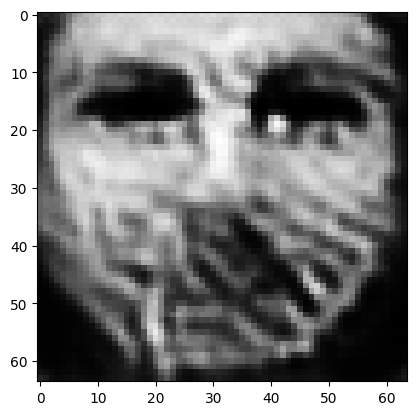

tensor([[5.4186e-04, 3.5765e-07, 3.9228e-05, 6.8487e-07, 2.0655e-05, 1.2302e-03,
         9.8680e-01, 2.0792e-03, 3.2910e-08, 4.8855e-06, 3.3582e-05, 1.2218e-06,
         3.1200e-06, 5.1273e-08, 9.4784e-07, 2.7656e-04, 1.2128e-03, 2.3555e-03,
         4.2391e-05, 3.7852e-03, 2.2128e-06, 6.7267e-07, 5.5096e-09, 2.9933e-04,
         1.6640e-05, 3.6660e-09, 8.0694e-05, 6.9034e-05, 3.0376e-04, 8.5559e-07,
         3.1314e-08, 1.4553e-05, 6.9729e-04, 2.2962e-05, 1.8604e-06, 1.8200e-06,
         3.0834e-06, 2.8185e-06, 3.6134e-05, 1.9472e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013289563357830048
tensor([[5.3707e-04, 3.5250e-07, 3.8768e-05, 6.7737e-07, 2.0340e-05, 1.2161e-03,
         9.8695e-01, 2.0556e-03, 3.2392e-08, 4.8279e-06, 3.3141e-05, 1.2018e-06,
         3.0777e-06, 5.0236e-08, 9.3521e-07, 2.7460e-04, 1.2020e-03, 2.3209e-03,
         4.2120e-05, 3.7442e-03, 2.1867e-06, 6.6314e-07, 5.4161e-09, 2.9690e-04,
         1.6346e-05, 3.5975e-09, 7.9572e-

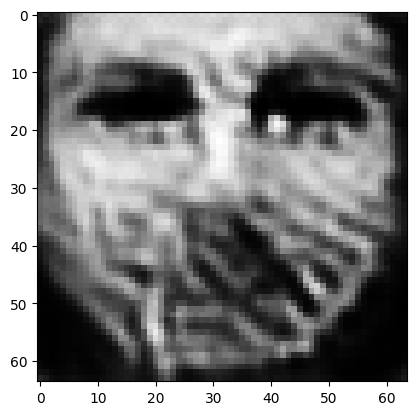

tensor([[5.1958e-04, 3.3363e-07, 3.7162e-05, 6.5030e-07, 1.9245e-05, 1.1677e-03,
         9.8749e-01, 1.9702e-03, 3.0577e-08, 4.6149e-06, 3.1547e-05, 1.1298e-06,
         2.9252e-06, 4.6586e-08, 8.8911e-07, 2.6709e-04, 1.1648e-03, 2.1981e-03,
         4.1090e-05, 3.5948e-03, 2.0955e-06, 6.2824e-07, 5.0905e-09, 2.8845e-04,
         1.5345e-05, 3.3626e-09, 7.5359e-05, 6.5712e-05, 2.9326e-04, 8.0276e-07,
         2.8922e-08, 1.3390e-05, 6.4646e-04, 2.1478e-05, 1.7809e-06, 1.6923e-06,
         2.8651e-06, 2.5923e-06, 3.4401e-05, 1.8613e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012585856020450592
tensor([[5.1561e-04, 3.2970e-07, 3.6782e-05, 6.4443e-07, 1.9014e-05, 1.1561e-03,
         9.8761e-01, 1.9506e-03, 3.0202e-08, 4.5673e-06, 3.1181e-05, 1.1137e-06,
         2.8938e-06, 4.5827e-08, 8.7993e-07, 2.6531e-04, 1.1562e-03, 2.1720e-03,
         4.0874e-05, 3.5641e-03, 2.0761e-06, 6.2069e-07, 5.0240e-09, 2.8661e-04,
         1.5131e-05, 3.3113e-09, 7.4447e-

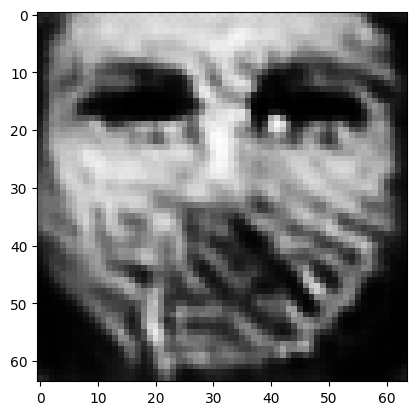

tensor([[5.0158e-04, 3.1549e-07, 3.5382e-05, 6.2301e-07, 1.8144e-05, 1.1128e-03,
         9.8804e-01, 1.8769e-03, 2.8793e-08, 4.4008e-06, 2.9895e-05, 1.0557e-06,
         2.7762e-06, 4.3134e-08, 8.4812e-07, 2.5905e-04, 1.1255e-03, 2.0818e-03,
         4.0069e-05, 3.4548e-03, 2.0046e-06, 5.9246e-07, 4.7703e-09, 2.7964e-04,
         1.4341e-05, 3.1243e-09, 7.1152e-05, 6.2966e-05, 2.8457e-04, 7.6307e-07,
         2.7098e-08, 1.2516e-05, 6.0736e-04, 2.0326e-05, 1.7197e-06, 1.5970e-06,
         2.6888e-06, 2.4156e-06, 3.3075e-05, 1.7872e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012033604085445404
tensor([[4.9837e-04, 3.1212e-07, 3.5065e-05, 6.1782e-07, 1.7941e-05, 1.1027e-03,
         9.8814e-01, 1.8605e-03, 2.8466e-08, 4.3622e-06, 2.9604e-05, 1.0427e-06,
         2.7482e-06, 4.2515e-08, 8.4066e-07, 2.5758e-04, 1.1182e-03, 2.0612e-03,
         3.9866e-05, 3.4288e-03, 1.9875e-06, 5.8575e-07, 4.7086e-09, 2.7786e-04,
         1.4157e-05, 3.0806e-09, 7.0389e-

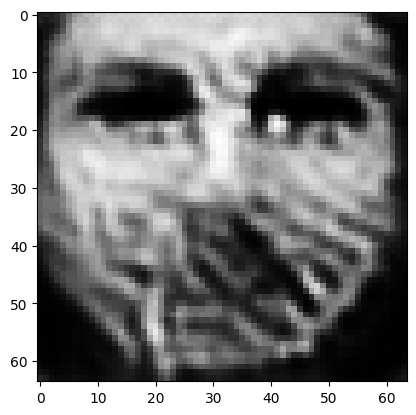

tensor([[4.8601e-04, 3.0015e-07, 3.3808e-05, 5.9981e-07, 1.7282e-05, 1.0586e-03,
         9.8850e-01, 1.7961e-03, 2.7398e-08, 4.2048e-06, 2.8475e-05, 9.9057e-07,
         2.6616e-06, 4.0542e-08, 8.1843e-07, 2.5110e-04, 1.0938e-03, 1.9902e-03,
         3.9155e-05, 3.3361e-03, 1.9285e-06, 5.6158e-07, 4.5143e-09, 2.7180e-04,
         1.3565e-05, 2.9239e-09, 6.7552e-05, 6.0725e-05, 2.7675e-04, 7.3056e-07,
         2.5620e-08, 1.1788e-05, 5.7497e-04, 1.9418e-05, 1.6657e-06, 1.5199e-06,
         2.5393e-06, 2.2667e-06, 3.2089e-05, 1.7179e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011564009822905064
tensor([[4.8309e-04, 2.9733e-07, 3.3515e-05, 5.9538e-07, 1.7118e-05, 1.0490e-03,
         9.8859e-01, 1.7814e-03, 2.7132e-08, 4.1689e-06, 2.8211e-05, 9.7891e-07,
         2.6396e-06, 4.0047e-08, 8.1265e-07, 2.4965e-04, 1.0873e-03, 1.9731e-03,
         3.8981e-05, 3.3144e-03, 1.9134e-06, 5.5603e-07, 4.4645e-09, 2.7020e-04,
         1.3416e-05, 2.8862e-09, 6.6923e-

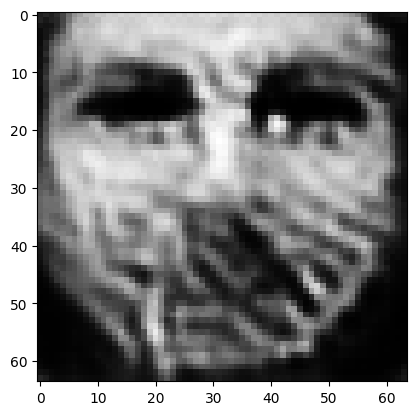

tensor([[4.7177e-04, 2.8659e-07, 3.2472e-05, 5.7869e-07, 1.6499e-05, 1.0150e-03,
         9.8892e-01, 1.7270e-03, 2.6131e-08, 4.0358e-06, 2.7243e-05, 9.3665e-07,
         2.5540e-06, 3.8165e-08, 7.8868e-07, 2.4411e-04, 1.0626e-03, 1.9079e-03,
         3.8302e-05, 3.2286e-03, 1.8565e-06, 5.3469e-07, 4.2776e-09, 2.6379e-04,
         1.2849e-05, 2.7491e-09, 6.4564e-05, 5.8671e-05, 2.6988e-04, 7.0004e-07,
         2.4277e-08, 1.1159e-05, 5.4611e-04, 1.8606e-05, 1.6173e-06, 1.4497e-06,
         2.4088e-06, 2.1383e-06, 3.1115e-05, 1.6594e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01114677358418703
tensor([[4.6920e-04, 2.8413e-07, 3.2235e-05, 5.7472e-07, 1.6351e-05, 1.0075e-03,
         9.8899e-01, 1.7146e-03, 2.5889e-08, 4.0056e-06, 2.7020e-05, 9.2728e-07,
         2.5332e-06, 3.7716e-08, 7.8284e-07, 2.4287e-04, 1.0564e-03, 1.8931e-03,
         3.8139e-05, 3.2083e-03, 1.8427e-06, 5.2978e-07, 4.2321e-09, 2.6222e-04,
         1.2712e-05, 2.7168e-09, 6.4036e-0

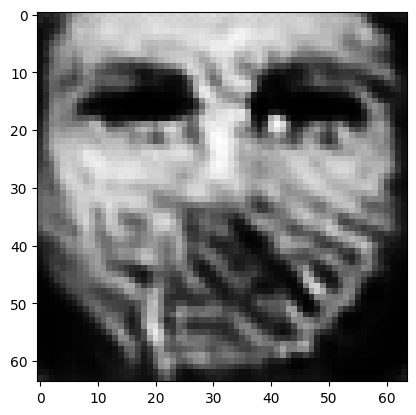

tensor([[4.5982e-04, 2.7515e-07, 3.1352e-05, 5.6022e-07, 1.5812e-05, 9.7947e-04,
         9.8927e-01, 1.6686e-03, 2.5006e-08, 3.8943e-06, 2.6206e-05, 8.9299e-07,
         2.4577e-06, 3.6102e-08, 7.6221e-07, 2.3830e-04, 1.0331e-03, 1.8403e-03,
         3.7534e-05, 3.1346e-03, 1.7927e-06, 5.1189e-07, 4.0661e-09, 2.5662e-04,
         1.2222e-05, 2.6001e-09, 6.2082e-05, 5.6889e-05, 2.6377e-04, 6.7269e-07,
         2.3090e-08, 1.0636e-05, 5.2058e-04, 1.7875e-05, 1.5737e-06, 1.3895e-06,
         2.3006e-06, 2.0297e-06, 3.0199e-05, 1.6072e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010789155960083008
tensor([[4.5773e-04, 2.7318e-07, 3.1138e-05, 5.5686e-07, 1.5686e-05, 9.7272e-04,
         9.8933e-01, 1.6577e-03, 2.4799e-08, 3.8694e-06, 2.6018e-05, 8.8533e-07,
         2.4402e-06, 3.5736e-08, 7.5781e-07, 2.3730e-04, 1.0273e-03, 1.8288e-03,
         3.7397e-05, 3.1182e-03, 1.7811e-06, 5.0792e-07, 4.0271e-09, 2.5535e-04,
         1.2109e-05, 2.5726e-09, 6.1649e-

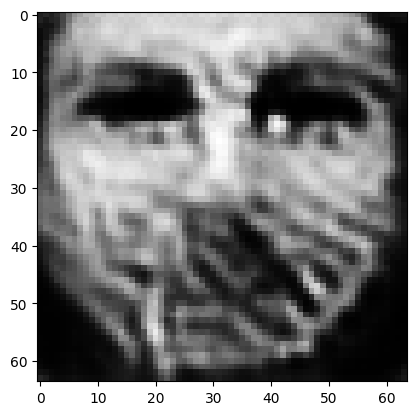

tensor([[4.4951e-04, 2.6585e-07, 3.0336e-05, 5.4435e-07, 1.5227e-05, 9.4762e-04,
         9.8957e-01, 1.6159e-03, 2.4050e-08, 3.7738e-06, 2.5326e-05, 8.5676e-07,
         2.3759e-06, 3.4411e-08, 7.4125e-07, 2.3351e-04, 1.0061e-03, 1.7872e-03,
         3.6888e-05, 3.0556e-03, 1.7401e-06, 4.9249e-07, 3.8875e-09, 2.5036e-04,
         1.1687e-05, 2.4704e-09, 6.0041e-05, 5.5364e-05, 2.5831e-04, 6.4958e-07,
         2.2087e-08, 1.0209e-05, 4.9898e-04, 1.7257e-05, 1.5354e-06, 1.3407e-06,
         2.2100e-06, 1.9385e-06, 2.9387e-05, 1.5607e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01048367004841566
tensor([[4.4754e-04, 2.6415e-07, 3.0149e-05, 5.4146e-07, 1.5123e-05, 9.4185e-04,
         9.8963e-01, 1.6061e-03, 2.3880e-08, 3.7510e-06, 2.5167e-05, 8.5008e-07,
         2.3612e-06, 3.4111e-08, 7.3736e-07, 2.3260e-04, 1.0014e-03, 1.7775e-03,
         3.6771e-05, 3.0407e-03, 1.7309e-06, 4.8881e-07, 3.8564e-09, 2.4918e-04,
         1.1592e-05, 2.4470e-09, 5.9661e-0

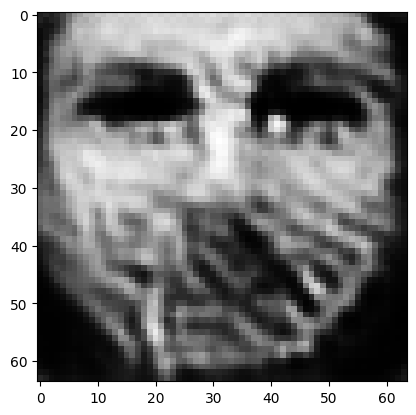

tensor([[4.4009e-04, 2.5781e-07, 2.9441e-05, 5.3057e-07, 1.4732e-05, 9.1981e-04,
         9.8984e-01, 1.5693e-03, 2.3240e-08, 3.6655e-06, 2.4565e-05, 8.2466e-07,
         2.3061e-06, 3.2992e-08, 7.2312e-07, 2.2915e-04, 9.8314e-04, 1.7404e-03,
         3.6345e-05, 2.9851e-03, 1.6964e-06, 4.7509e-07, 3.7397e-09, 2.4474e-04,
         1.1234e-05, 2.3602e-09, 5.8245e-05, 5.4066e-05, 2.5357e-04, 6.2967e-07,
         2.1244e-08, 9.8294e-06, 4.8036e-04, 1.6718e-05, 1.5022e-06, 1.2983e-06,
         2.1322e-06, 1.8598e-06, 2.8708e-05, 1.5211e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010214671492576599
tensor([[4.3835e-04, 2.5632e-07, 2.9278e-05, 5.2798e-07, 1.4639e-05, 9.1490e-04,
         9.8989e-01, 1.5609e-03, 2.3086e-08, 3.6456e-06, 2.4425e-05, 8.1882e-07,
         2.2929e-06, 3.2724e-08, 7.1962e-07, 2.2835e-04, 9.7880e-04, 1.7317e-03,
         3.6243e-05, 2.9718e-03, 1.6881e-06, 4.7188e-07, 3.7117e-09, 2.4368e-04,
         1.1149e-05, 2.3400e-09, 5.7916e-

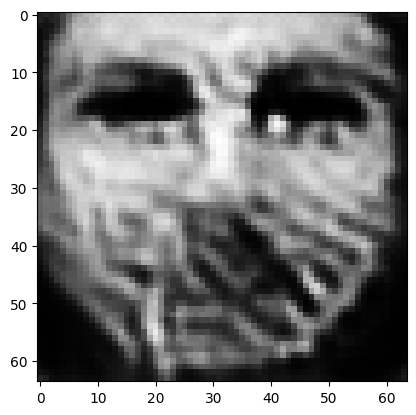

tensor([[4.3186e-04, 2.5088e-07, 2.8654e-05, 5.1833e-07, 1.4291e-05, 8.9553e-04,
         9.9007e-01, 1.5282e-03, 2.2504e-08, 3.5697e-06, 2.3888e-05, 7.9730e-07,
         2.2437e-06, 3.1737e-08, 7.0710e-07, 2.2532e-04, 9.6160e-04, 1.7009e-03,
         3.5859e-05, 2.9220e-03, 1.6566e-06, 4.5993e-07, 3.6069e-09, 2.3957e-04,
         1.0831e-05, 2.2623e-09, 5.6726e-05, 5.2902e-05, 2.4930e-04, 6.1169e-07,
         2.0484e-08, 9.5090e-06, 4.6378e-04, 1.6240e-05, 1.4722e-06, 1.2617e-06,
         2.0637e-06, 1.7915e-06, 2.8075e-05, 1.4848e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009976995177567005
tensor([[4.3030e-04, 2.4956e-07, 2.8513e-05, 5.1600e-07, 1.4208e-05, 8.9132e-04,
         9.9012e-01, 1.5207e-03, 2.2366e-08, 3.5523e-06, 2.3762e-05, 7.9233e-07,
         2.2318e-06, 3.1496e-08, 7.0382e-07, 2.2462e-04, 9.5755e-04, 1.6931e-03,
         3.5767e-05, 2.9101e-03, 1.6489e-06, 4.5712e-07, 3.5817e-09, 2.3857e-04,
         1.0754e-05, 2.2443e-09, 5.6446e-

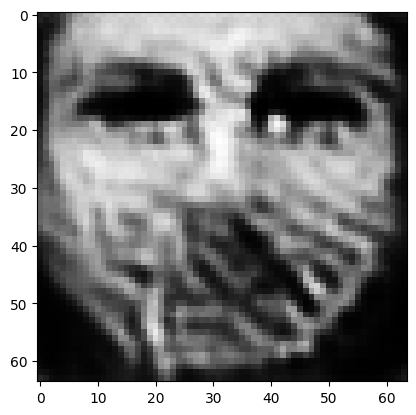

tensor([[4.2444e-04, 2.4453e-07, 2.7958e-05, 5.0680e-07, 1.3883e-05, 8.7409e-04,
         9.9029e-01, 1.4924e-03, 2.1815e-08, 3.4857e-06, 2.3277e-05, 7.7298e-07,
         2.1844e-06, 3.0568e-08, 6.9165e-07, 2.2196e-04, 9.4177e-04, 1.6629e-03,
         3.5411e-05, 2.8637e-03, 1.6183e-06, 4.4624e-07, 3.4798e-09, 2.3481e-04,
         1.0451e-05, 2.1733e-09, 5.5338e-05, 5.1834e-05, 2.4550e-04, 5.9512e-07,
         1.9787e-08, 9.2151e-06, 4.4851e-04, 1.5802e-05, 1.4438e-06, 1.2269e-06,
         1.9999e-06, 1.7298e-06, 2.7474e-05, 1.4517e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009759685955941677
tensor([[4.2298e-04, 2.4342e-07, 2.7813e-05, 5.0472e-07, 1.3808e-05, 8.6969e-04,
         9.9033e-01, 1.4850e-03, 2.1691e-08, 3.4692e-06, 2.3155e-05, 7.6830e-07,
         2.1740e-06, 3.0357e-08, 6.8898e-07, 2.2132e-04, 9.3784e-04, 1.6560e-03,
         3.5332e-05, 2.8526e-03, 1.6111e-06, 4.4361e-07, 3.4576e-09, 2.3385e-04,
         1.0379e-05, 2.1558e-09, 5.5094e-

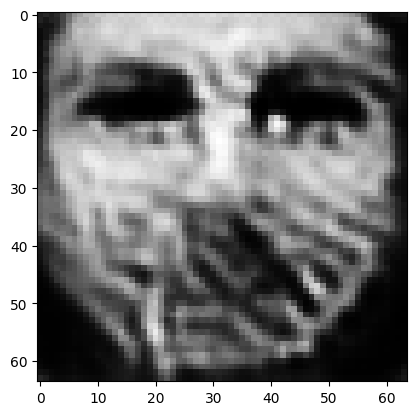

tensor([[4.1740e-04, 2.3848e-07, 2.7365e-05, 4.9624e-07, 1.3509e-05, 8.5621e-04,
         9.9049e-01, 1.4613e-03, 2.1189e-08, 3.4107e-06, 2.2725e-05, 7.5099e-07,
         2.1284e-06, 2.9465e-08, 6.7543e-07, 2.1883e-04, 9.2440e-04, 1.6242e-03,
         3.4986e-05, 2.8075e-03, 1.5819e-06, 4.3336e-07, 3.3614e-09, 2.3023e-04,
         1.0098e-05, 2.0946e-09, 5.4040e-05, 5.0860e-05, 2.4215e-04, 5.7979e-07,
         1.9154e-08, 8.9309e-06, 4.3427e-04, 1.5391e-05, 1.4182e-06, 1.1926e-06,
         1.9411e-06, 1.6733e-06, 2.6913e-05, 1.4233e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009557561948895454
tensor([[4.1609e-04, 2.3740e-07, 2.7253e-05, 4.9434e-07, 1.3441e-05, 8.5286e-04,
         9.9053e-01, 1.4552e-03, 2.1074e-08, 3.3966e-06, 2.2618e-05, 7.4683e-07,
         2.1184e-06, 2.9262e-08, 6.7246e-07, 2.1824e-04, 9.2105e-04, 1.6171e-03,
         3.4912e-05, 2.7970e-03, 1.5752e-06, 4.3096e-07, 3.3404e-09, 2.2934e-04,
         1.0033e-05, 2.0800e-09, 5.3812e-

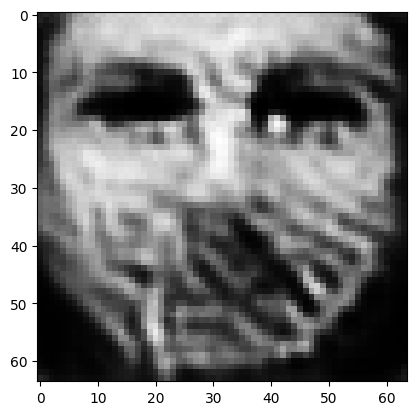

tensor([[4.1105e-04, 2.3301e-07, 2.6848e-05, 4.8682e-07, 1.3177e-05, 8.4071e-04,
         9.9067e-01, 1.4330e-03, 2.0630e-08, 3.3437e-06, 2.2220e-05, 7.3098e-07,
         2.0782e-06, 2.8473e-08, 6.6058e-07, 2.1595e-04, 9.0887e-04, 1.5887e-03,
         3.4609e-05, 2.7561e-03, 1.5493e-06, 4.2171e-07, 3.2563e-09, 2.2603e-04,
         9.7850e-06, 2.0262e-09, 5.2873e-05, 4.9982e-05, 2.3929e-04, 5.6638e-07,
         1.8590e-08, 8.6727e-06, 4.2156e-04, 1.5018e-05, 1.3959e-06, 1.1613e-06,
         1.8890e-06, 1.6227e-06, 2.6418e-05, 1.3990e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00937500037252903
tensor([[4.0987e-04, 2.3201e-07, 2.6747e-05, 4.8509e-07, 1.3115e-05, 8.3779e-04,
         9.9070e-01, 1.4274e-03, 2.0526e-08, 3.3310e-06, 2.2123e-05, 7.2728e-07,
         2.0690e-06, 2.8289e-08, 6.5789e-07, 2.1543e-04, 9.0589e-04, 1.5822e-03,
         3.4538e-05, 2.7465e-03, 1.5434e-06, 4.1954e-07, 3.2373e-09, 2.2524e-04,
         9.7274e-06, 2.0134e-09, 5.2661e-0

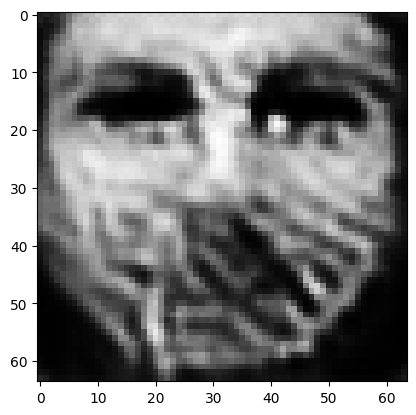

tensor([[4.0526e-04, 2.2817e-07, 2.6362e-05, 4.7852e-07, 1.2882e-05, 8.2644e-04,
         9.9083e-01, 1.4059e-03, 2.0137e-08, 3.2821e-06, 2.1751e-05, 7.1288e-07,
         2.0347e-06, 2.7604e-08, 6.4777e-07, 2.1334e-04, 8.9477e-04, 1.5576e-03,
         3.4271e-05, 2.7100e-03, 1.5211e-06, 4.1127e-07, 3.1666e-09, 2.2219e-04,
         9.5131e-06, 1.9651e-09, 5.1847e-05, 4.9172e-05, 2.3666e-04, 5.5449e-07,
         1.8092e-08, 8.4446e-06, 4.1034e-04, 1.4688e-05, 1.3767e-06, 1.1340e-06,
         1.8432e-06, 1.5773e-06, 2.5980e-05, 1.3773e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009209414944052696
tensor([[4.0422e-04, 2.2713e-07, 2.6284e-05, 4.7677e-07, 1.2821e-05, 8.2403e-04,
         9.9086e-01, 1.4016e-03, 2.0033e-08, 3.2713e-06, 2.1670e-05, 7.0957e-07,
         2.0249e-06, 2.7424e-08, 6.4503e-07, 2.1286e-04, 8.9223e-04, 1.5511e-03,
         3.4197e-05, 2.7009e-03, 1.5152e-06, 4.0926e-07, 3.1460e-09, 2.2150e-04,
         9.4585e-06, 1.9539e-09, 5.1624e-

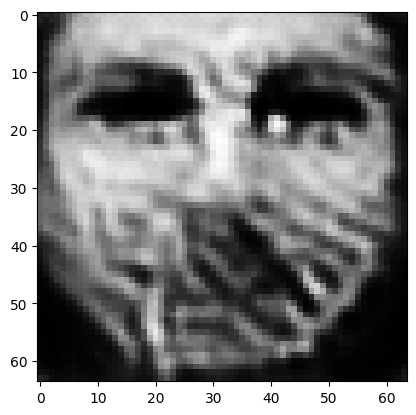

tensor([[4.0002e-04, 2.2357e-07, 2.5939e-05, 4.7084e-07, 1.2615e-05, 8.1287e-04,
         9.9098e-01, 1.3825e-03, 1.9682e-08, 3.2264e-06, 2.1340e-05, 6.9619e-07,
         1.9940e-06, 2.6831e-08, 6.3648e-07, 2.1091e-04, 8.8313e-04, 1.5284e-03,
         3.3958e-05, 2.6669e-03, 1.4956e-06, 4.0183e-07, 3.0829e-09, 2.1897e-04,
         9.2706e-06, 1.9119e-09, 5.0824e-05, 4.8465e-05, 2.3446e-04, 5.4406e-07,
         1.7645e-08, 8.2331e-06, 4.0004e-04, 1.4389e-05, 1.3588e-06, 1.1083e-06,
         1.8017e-06, 1.5372e-06, 2.5591e-05, 1.3568e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009058923460543156
tensor([[3.9905e-04, 2.2278e-07, 2.5846e-05, 4.6953e-07, 1.2568e-05, 8.0966e-04,
         9.9101e-01, 1.3775e-03, 1.9601e-08, 3.2151e-06, 2.1258e-05, 6.9281e-07,
         1.9873e-06, 2.6704e-08, 6.3492e-07, 2.1043e-04, 8.8097e-04, 1.5235e-03,
         3.3907e-05, 2.6590e-03, 1.4913e-06, 4.0010e-07, 3.0693e-09, 2.1842e-04,
         9.2284e-06, 1.9017e-09, 5.0638e-

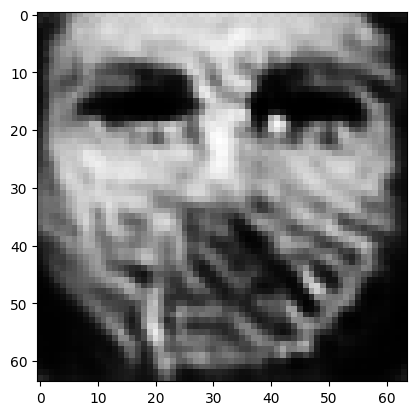

tensor([[3.9508e-04, 2.1956e-07, 2.5503e-05, 4.6413e-07, 1.2386e-05, 7.9836e-04,
         9.9112e-01, 1.3595e-03, 1.9288e-08, 3.1723e-06, 2.0944e-05, 6.7997e-07,
         1.9602e-06, 2.6181e-08, 6.2762e-07, 2.0852e-04, 8.7254e-04, 1.5028e-03,
         3.3693e-05, 2.6279e-03, 1.4735e-06, 3.9328e-07, 3.0147e-09, 2.1611e-04,
         9.0593e-06, 1.8629e-09, 4.9909e-05, 4.7808e-05, 2.3218e-04, 5.3501e-07,
         1.7258e-08, 8.0461e-06, 3.9114e-04, 1.4132e-05, 1.3428e-06, 1.0872e-06,
         1.7641e-06, 1.5004e-06, 2.5264e-05, 1.3371e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008919160813093185
tensor([[3.9414e-04, 2.1884e-07, 2.5411e-05, 4.6286e-07, 1.2343e-05, 7.9527e-04,
         9.9115e-01, 1.3550e-03, 1.9214e-08, 3.1616e-06, 2.0867e-05, 6.7688e-07,
         1.9540e-06, 2.6065e-08, 6.2621e-07, 2.0807e-04, 8.7042e-04, 1.4984e-03,
         3.3644e-05, 2.6206e-03, 1.4694e-06, 3.9167e-07, 3.0023e-09, 2.1558e-04,
         9.0193e-06, 1.8532e-09, 4.9740e-

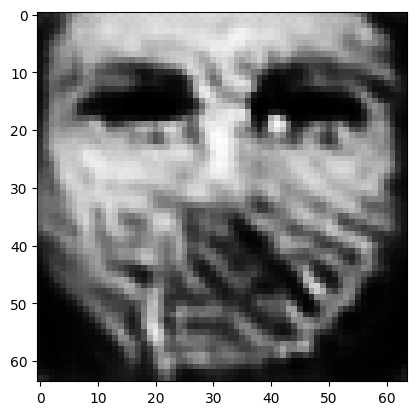

tensor([[3.9049e-04, 2.1573e-07, 2.5090e-05, 4.5766e-07, 1.2169e-05, 7.8427e-04,
         9.9125e-01, 1.3386e-03, 1.8911e-08, 3.1222e-06, 2.0584e-05, 6.6500e-07,
         1.9273e-06, 2.5583e-08, 6.1962e-07, 2.0628e-04, 8.6268e-04, 1.4791e-03,
         3.3435e-05, 2.5912e-03, 1.4524e-06, 3.8535e-07, 2.9486e-09, 2.1356e-04,
         8.8611e-06, 1.8175e-09, 4.9021e-05, 4.7196e-05, 2.3004e-04, 5.2651e-07,
         1.6897e-08, 7.8737e-06, 3.8282e-04, 1.3891e-05, 1.3270e-06, 1.0674e-06,
         1.7292e-06, 1.4665e-06, 2.4942e-05, 1.3173e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008788831532001495
tensor([[3.8953e-04, 2.1494e-07, 2.5022e-05, 4.5633e-07, 1.2124e-05, 7.8240e-04,
         9.9127e-01, 1.3348e-03, 1.8837e-08, 3.1134e-06, 2.0515e-05, 6.6235e-07,
         1.9204e-06, 2.5448e-08, 6.1730e-07, 2.0588e-04, 8.6061e-04, 1.4736e-03,
         3.3382e-05, 2.5839e-03, 1.4480e-06, 3.8376e-07, 2.9350e-09, 2.1293e-04,
         8.8186e-06, 1.8090e-09, 4.8859e-

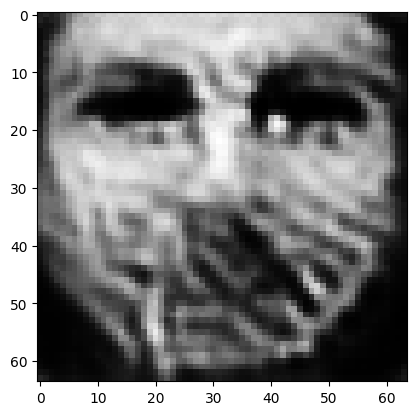

tensor([[3.8606e-04, 2.1210e-07, 2.4717e-05, 4.5155e-07, 1.1960e-05, 7.7211e-04,
         9.9137e-01, 1.3190e-03, 1.8562e-08, 3.0770e-06, 2.0250e-05, 6.5136e-07,
         1.8962e-06, 2.5001e-08, 6.1116e-07, 2.0424e-04, 8.5309e-04, 1.4552e-03,
         3.3197e-05, 2.5566e-03, 1.4327e-06, 3.7787e-07, 2.8862e-09, 2.1098e-04,
         8.6694e-06, 1.7759e-09, 4.8206e-05, 4.6610e-05, 2.2819e-04, 5.1846e-07,
         1.6554e-08, 7.7085e-06, 3.7500e-04, 1.3658e-05, 1.3126e-06, 1.0480e-06,
         1.6967e-06, 1.4348e-06, 2.4637e-05, 1.3006e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008665104396641254
tensor([[3.8522e-04, 2.1143e-07, 2.4642e-05, 4.5040e-07, 1.1920e-05, 7.6960e-04,
         9.9140e-01, 1.3150e-03, 1.8496e-08, 3.0683e-06, 2.0186e-05, 6.4874e-07,
         1.8904e-06, 2.4894e-08, 6.0972e-07, 2.0386e-04, 8.5120e-04, 1.4509e-03,
         3.3153e-05, 2.5502e-03, 1.4290e-06, 3.7646e-07, 2.8745e-09, 2.1051e-04,
         8.6331e-06, 1.7678e-09, 4.8054e-

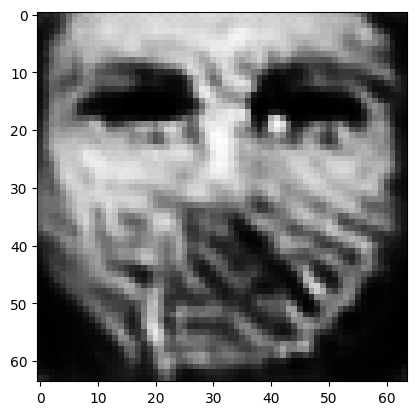

tensor([[3.8193e-04, 2.0883e-07, 2.4360e-05, 4.4597e-07, 1.1766e-05, 7.6043e-04,
         9.9149e-01, 1.2999e-03, 1.8237e-08, 3.0347e-06, 1.9943e-05, 6.3891e-07,
         1.8677e-06, 2.4480e-08, 6.0367e-07, 2.0241e-04, 8.4395e-04, 1.4344e-03,
         3.2981e-05, 2.5245e-03, 1.4147e-06, 3.7091e-07, 2.8294e-09, 2.0859e-04,
         8.4917e-06, 1.7368e-09, 4.7478e-05, 4.6061e-05, 2.2644e-04, 5.1096e-07,
         1.6233e-08, 7.5608e-06, 3.6778e-04, 1.3441e-05, 1.2992e-06, 1.0309e-06,
         1.6672e-06, 1.4058e-06, 2.4341e-05, 1.2846e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00855069886893034
tensor([[3.8113e-04, 2.0821e-07, 2.4289e-05, 4.4491e-07, 1.1728e-05, 7.5818e-04,
         9.9151e-01, 1.2962e-03, 1.8173e-08, 3.0265e-06, 1.9885e-05, 6.3653e-07,
         1.8622e-06, 2.4380e-08, 6.0226e-07, 2.0207e-04, 8.4219e-04, 1.4305e-03,
         3.2939e-05, 2.5182e-03, 1.4113e-06, 3.6958e-07, 2.8185e-09, 2.0813e-04,
         8.4576e-06, 1.7292e-09, 4.7338e-0

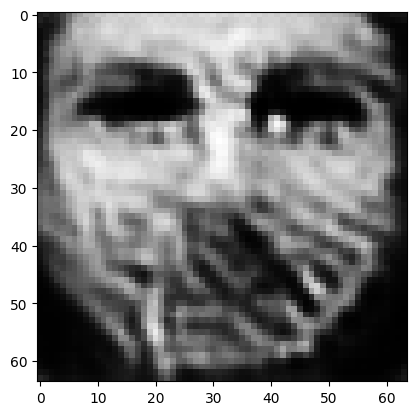

tensor([[3.7808e-04, 2.0573e-07, 2.4029e-05, 4.4071e-07, 1.1580e-05, 7.4983e-04,
         9.9159e-01, 1.2823e-03, 1.7921e-08, 2.9955e-06, 1.9664e-05, 6.2746e-07,
         1.8402e-06, 2.3987e-08, 5.9644e-07, 2.0076e-04, 8.3549e-04, 1.4148e-03,
         3.2774e-05, 2.4938e-03, 1.3977e-06, 3.6440e-07, 2.7749e-09, 2.0638e-04,
         8.3225e-06, 1.7005e-09, 4.6785e-05, 4.5550e-05, 2.2482e-04, 5.0380e-07,
         1.5927e-08, 7.4229e-06, 3.6087e-04, 1.3233e-05, 1.2863e-06, 1.0145e-06,
         1.6401e-06, 1.3788e-06, 2.4044e-05, 1.2693e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008443135768175125
tensor([[3.7737e-04, 2.0517e-07, 2.3962e-05, 4.3973e-07, 1.1545e-05, 7.4765e-04,
         9.9161e-01, 1.2788e-03, 1.7859e-08, 2.9877e-06, 1.9611e-05, 6.2524e-07,
         1.8350e-06, 2.3897e-08, 5.9524e-07, 2.0046e-04, 8.3389e-04, 1.4113e-03,
         3.2737e-05, 2.4880e-03, 1.3946e-06, 3.6316e-07, 2.7647e-09, 2.0599e-04,
         8.2909e-06, 1.6935e-09, 4.6654e-

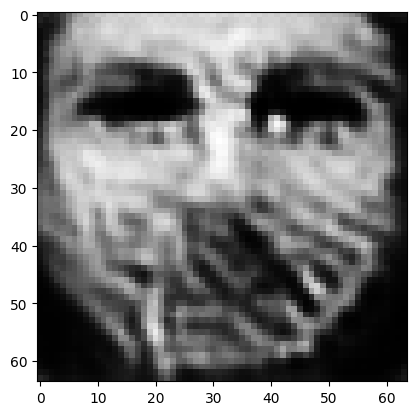

tensor([[3.7460e-04, 2.0298e-07, 2.3711e-05, 4.3587e-07, 1.1407e-05, 7.3971e-04,
         9.9169e-01, 1.2656e-03, 1.7622e-08, 2.9590e-06, 1.9409e-05, 6.1698e-07,
         1.8144e-06, 2.3543e-08, 5.9027e-07, 1.9932e-04, 8.2750e-04, 1.3979e-03,
         3.2589e-05, 2.4657e-03, 1.3822e-06, 3.5836e-07, 2.7244e-09, 2.0438e-04,
         8.1655e-06, 1.6665e-09, 4.6159e-05, 4.5075e-05, 2.2331e-04, 4.9723e-07,
         1.5640e-08, 7.2999e-06, 3.5441e-04, 1.3040e-05, 1.2742e-06, 9.9994e-07,
         1.6151e-06, 1.3539e-06, 2.3754e-05, 1.2543e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008344546891748905
tensor([[3.7389e-04, 2.0250e-07, 2.3645e-05, 4.3500e-07, 1.1376e-05, 7.3759e-04,
         9.9171e-01, 1.2622e-03, 1.7568e-08, 2.9518e-06, 1.9358e-05, 6.1491e-07,
         1.8101e-06, 2.3465e-08, 5.8926e-07, 1.9904e-04, 8.2597e-04, 1.3949e-03,
         3.2558e-05, 2.4605e-03, 1.3795e-06, 3.5722e-07, 2.7158e-09, 2.0399e-04,
         8.1364e-06, 1.6598e-09, 4.6046e-

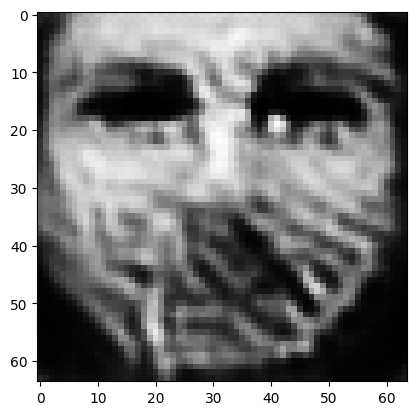

tensor([[3.7130e-04, 2.0035e-07, 2.3428e-05, 4.3120e-07, 1.1246e-05, 7.3090e-04,
         9.9178e-01, 1.2512e-03, 1.7341e-08, 2.9261e-06, 1.9170e-05, 6.0729e-07,
         1.7896e-06, 2.3113e-08, 5.8381e-07, 1.9793e-04, 8.2007e-04, 1.3813e-03,
         3.2411e-05, 2.4396e-03, 1.3669e-06, 3.5271e-07, 2.6762e-09, 2.0243e-04,
         8.0178e-06, 1.6352e-09, 4.5574e-05, 4.4632e-05, 2.2195e-04, 4.9081e-07,
         1.5372e-08, 7.1829e-06, 3.4846e-04, 1.2858e-05, 1.2627e-06, 9.8562e-07,
         1.5913e-06, 1.3310e-06, 2.3482e-05, 1.2409e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008253632113337517
tensor([[3.7066e-04, 1.9987e-07, 2.3367e-05, 4.3037e-07, 1.1217e-05, 7.2892e-04,
         9.9180e-01, 1.2481e-03, 1.7289e-08, 2.9192e-06, 1.9122e-05, 6.0534e-07,
         1.7854e-06, 2.3039e-08, 5.8284e-07, 1.9765e-04, 8.1867e-04, 1.3785e-03,
         3.2379e-05, 2.4346e-03, 1.3643e-06, 3.5166e-07, 2.6682e-09, 2.0209e-04,
         7.9917e-06, 1.6291e-09, 4.5464e-

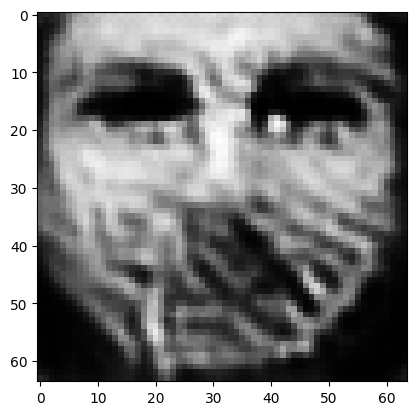

tensor([[3.6817e-04, 1.9796e-07, 2.3151e-05, 4.2704e-07, 1.1101e-05, 7.2224e-04,
         9.9186e-01, 1.2370e-03, 1.7084e-08, 2.8944e-06, 1.8943e-05, 5.9825e-07,
         1.7679e-06, 2.2735e-08, 5.7828e-07, 1.9663e-04, 8.1321e-04, 1.3666e-03,
         3.2251e-05, 2.4155e-03, 1.3534e-06, 3.4759e-07, 2.6347e-09, 2.0067e-04,
         7.8852e-06, 1.6061e-09, 4.5043e-05, 4.4213e-05, 2.2055e-04, 4.8497e-07,
         1.5133e-08, 7.0791e-06, 3.4315e-04, 1.2695e-05, 1.2520e-06, 9.7332e-07,
         1.5700e-06, 1.3103e-06, 2.3233e-05, 1.2280e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00816862192004919
tensor([[3.6760e-04, 1.9746e-07, 2.3103e-05, 4.2617e-07, 1.1071e-05, 7.2067e-04,
         9.9188e-01, 1.2346e-03, 1.7031e-08, 2.8887e-06, 1.8904e-05, 5.9656e-07,
         1.7631e-06, 2.2658e-08, 5.7711e-07, 1.9638e-04, 8.1198e-04, 1.3636e-03,
         3.2216e-05, 2.4108e-03, 1.3506e-06, 3.4660e-07, 2.6255e-09, 2.0035e-04,
         7.8587e-06, 1.6007e-09, 4.4929e-0

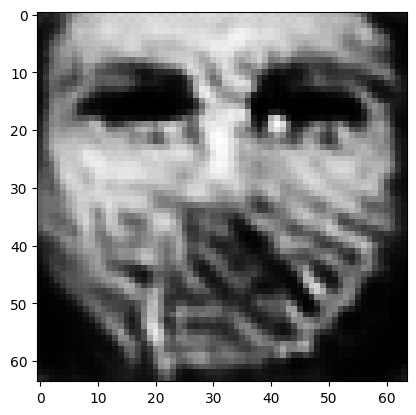

tensor([[3.6527e-04, 1.9564e-07, 2.2913e-05, 4.2303e-07, 1.0964e-05, 7.1481e-04,
         9.9194e-01, 1.2247e-03, 1.6842e-08, 2.8656e-06, 1.8742e-05, 5.8994e-07,
         1.7467e-06, 2.2374e-08, 5.7259e-07, 1.9543e-04, 8.0721e-04, 1.3522e-03,
         3.2094e-05, 2.3928e-03, 1.3405e-06, 3.4282e-07, 2.5943e-09, 1.9906e-04,
         7.7611e-06, 1.5802e-09, 4.4526e-05, 4.3832e-05, 2.1935e-04, 4.7954e-07,
         1.4911e-08, 6.9785e-06, 3.3820e-04, 1.2539e-05, 1.2418e-06, 9.6105e-07,
         1.5502e-06, 1.2914e-06, 2.3001e-05, 1.2165e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00809093564748764
tensor([[3.6473e-04, 1.9523e-07, 2.2860e-05, 4.2233e-07, 1.0940e-05, 7.1320e-04,
         9.9196e-01, 1.2220e-03, 1.6797e-08, 2.8595e-06, 1.8701e-05, 5.8830e-07,
         1.7431e-06, 2.2312e-08, 5.7167e-07, 1.9520e-04, 8.0608e-04, 1.3498e-03,
         3.2067e-05, 2.3885e-03, 1.3382e-06, 3.4192e-07, 2.5878e-09, 1.9878e-04,
         7.7389e-06, 1.5751e-09, 4.4434e-0

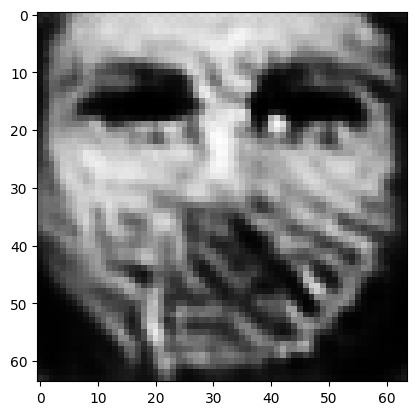

tensor([[3.6262e-04, 1.9354e-07, 2.2672e-05, 4.1939e-07, 1.0840e-05, 7.0720e-04,
         9.9201e-01, 1.2126e-03, 1.6613e-08, 2.8371e-06, 1.8551e-05, 5.8202e-07,
         1.7278e-06, 2.2059e-08, 5.6775e-07, 1.9434e-04, 8.0177e-04, 1.3396e-03,
         3.1953e-05, 2.3715e-03, 1.3289e-06, 3.3843e-07, 2.5591e-09, 1.9772e-04,
         7.6491e-06, 1.5557e-09, 4.4047e-05, 4.3477e-05, 2.1805e-04, 4.7450e-07,
         1.4710e-08, 6.8889e-06, 3.3368e-04, 1.2397e-05, 1.2320e-06, 9.5046e-07,
         1.5324e-06, 1.2739e-06, 2.2783e-05, 1.2047e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008018091320991516
tensor([[3.6208e-04, 1.9313e-07, 2.2633e-05, 4.1867e-07, 1.0816e-05, 7.0613e-04,
         9.9203e-01, 1.2104e-03, 1.6571e-08, 2.8321e-06, 1.8513e-05, 5.8061e-07,
         1.7240e-06, 2.1992e-08, 5.6649e-07, 1.9414e-04, 8.0062e-04, 1.3369e-03,
         3.1925e-05, 2.3675e-03, 1.3265e-06, 3.3758e-07, 2.5523e-09, 1.9739e-04,
         7.6266e-06, 1.5512e-09, 4.3966e-

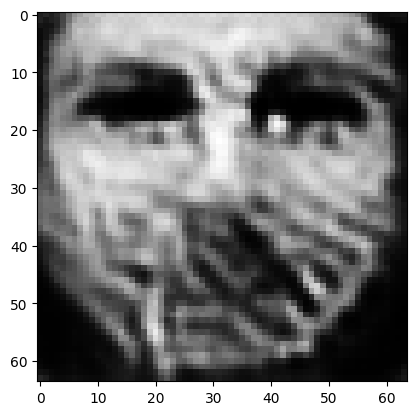

tensor([[3.6013e-04, 1.9154e-07, 2.2460e-05, 4.1598e-07, 1.0726e-05, 7.0052e-04,
         9.9208e-01, 1.2018e-03, 1.6403e-08, 2.8113e-06, 1.8374e-05, 5.7470e-07,
         1.7100e-06, 2.1761e-08, 5.6291e-07, 1.9329e-04, 7.9678e-04, 1.3273e-03,
         3.1820e-05, 2.3519e-03, 1.3179e-06, 3.3438e-07, 2.5264e-09, 1.9643e-04,
         7.5467e-06, 1.5338e-09, 4.3601e-05, 4.3151e-05, 2.1689e-04, 4.6984e-07,
         1.4527e-08, 6.8039e-06, 3.2958e-04, 1.2265e-05, 1.2230e-06, 9.4032e-07,
         1.5161e-06, 1.2579e-06, 2.2588e-05, 1.1944e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007950682193040848
tensor([[3.5966e-04, 1.9118e-07, 2.2415e-05, 4.1537e-07, 1.0705e-05, 6.9913e-04,
         9.9209e-01, 1.1996e-03, 1.6364e-08, 2.8061e-06, 1.8339e-05, 5.7326e-07,
         1.7070e-06, 2.1709e-08, 5.6212e-07, 1.9308e-04, 7.9584e-04, 1.3252e-03,
         3.1796e-05, 2.3482e-03, 1.3160e-06, 3.3363e-07, 2.5209e-09, 1.9621e-04,
         7.5286e-06, 1.5296e-09, 4.3519e-

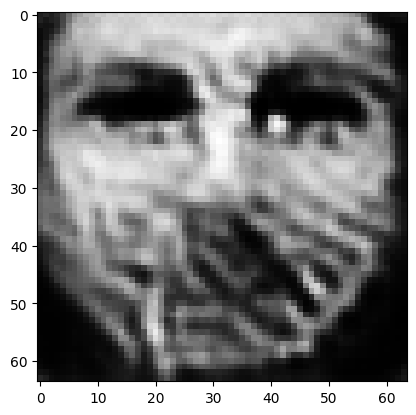

tensor([[3.5784e-04, 1.8966e-07, 2.2268e-05, 4.1278e-07, 1.0619e-05, 6.9467e-04,
         9.9214e-01, 1.1921e-03, 1.6208e-08, 2.7875e-06, 1.8211e-05, 5.6796e-07,
         1.6932e-06, 2.1478e-08, 5.5812e-07, 1.9230e-04, 7.9214e-04, 1.3156e-03,
         3.1691e-05, 2.3332e-03, 1.3074e-06, 3.3059e-07, 2.4955e-09, 1.9520e-04,
         7.4512e-06, 1.5137e-09, 4.3185e-05, 4.2850e-05, 2.1582e-04, 4.6540e-07,
         1.4355e-08, 6.7233e-06, 3.2572e-04, 1.2139e-05, 1.2146e-06, 9.3057e-07,
         1.5009e-06, 1.2431e-06, 2.2403e-05, 1.1850e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007888355292379856
tensor([[3.5740e-04, 1.8933e-07, 2.2226e-05, 4.1221e-07, 1.0599e-05, 6.9329e-04,
         9.9215e-01, 1.1900e-03, 1.6171e-08, 2.7826e-06, 1.8177e-05, 5.6659e-07,
         1.6903e-06, 2.1430e-08, 5.5742e-07, 1.9210e-04, 7.9125e-04, 1.3137e-03,
         3.1669e-05, 2.3297e-03, 1.3056e-06, 3.2987e-07, 2.4903e-09, 1.9499e-04,
         7.4339e-06, 1.5097e-09, 4.3106e-

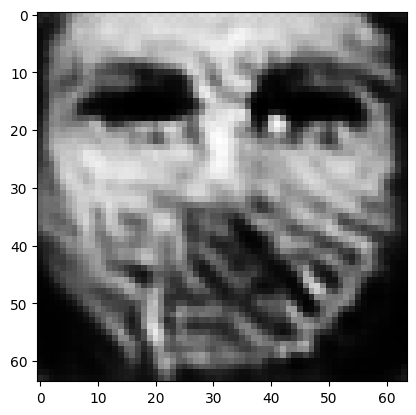

tensor([[3.5562e-04, 1.8791e-07, 2.2064e-05, 4.0972e-07, 1.0513e-05, 6.8837e-04,
         9.9220e-01, 1.1819e-03, 1.6016e-08, 2.7635e-06, 1.8050e-05, 5.6121e-07,
         1.6774e-06, 2.1215e-08, 5.5409e-07, 1.9136e-04, 7.8746e-04, 1.3050e-03,
         3.1577e-05, 2.3160e-03, 1.2976e-06, 3.2695e-07, 2.4662e-09, 1.9407e-04,
         7.3585e-06, 1.4935e-09, 4.2786e-05, 4.2551e-05, 2.1471e-04, 4.6128e-07,
         1.4189e-08, 6.6485e-06, 3.2204e-04, 1.2019e-05, 1.2061e-06, 9.2173e-07,
         1.4859e-06, 1.2285e-06, 2.2221e-05, 1.1751e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007827797904610634
tensor([[3.5519e-04, 1.8758e-07, 2.2020e-05, 4.0913e-07, 1.0491e-05, 6.8700e-04,
         9.9221e-01, 1.1797e-03, 1.5978e-08, 2.7587e-06, 1.8017e-05, 5.5985e-07,
         1.6744e-06, 2.1165e-08, 5.5342e-07, 1.9119e-04, 7.8647e-04, 1.3031e-03,
         3.1556e-05, 2.3128e-03, 1.2958e-06, 3.2624e-07, 2.4604e-09, 1.9386e-04,
         7.3399e-06, 1.4894e-09, 4.2710e-

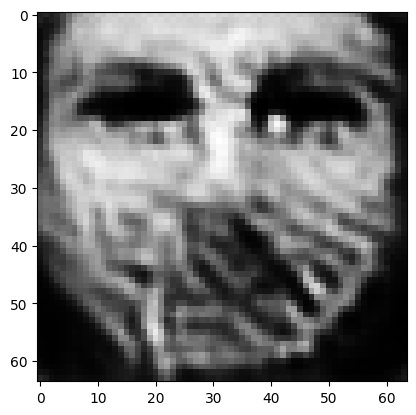

tensor([[3.5352e-04, 1.8623e-07, 2.1867e-05, 4.0674e-07, 1.0405e-05, 6.8246e-04,
         9.9226e-01, 1.1717e-03, 1.5827e-08, 2.7412e-06, 1.7895e-05, 5.5481e-07,
         1.6619e-06, 2.0954e-08, 5.5021e-07, 1.9053e-04, 7.8263e-04, 1.2948e-03,
         3.1471e-05, 2.3002e-03, 1.2881e-06, 3.2349e-07, 2.4365e-09, 1.9298e-04,
         7.2652e-06, 1.4738e-09, 4.2409e-05, 4.2256e-05, 2.1370e-04, 4.5735e-07,
         1.4027e-08, 6.5775e-06, 3.1847e-04, 1.1901e-05, 1.1978e-06, 9.1304e-07,
         1.4712e-06, 1.2146e-06, 2.2038e-05, 1.1655e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007769957184791565
tensor([[3.5311e-04, 1.8592e-07, 2.1827e-05, 4.0619e-07, 1.0385e-05, 6.8123e-04,
         9.9227e-01, 1.1697e-03, 1.5792e-08, 2.7367e-06, 1.7865e-05, 5.5353e-07,
         1.6592e-06, 2.0907e-08, 5.4957e-07, 1.9037e-04, 7.8173e-04, 1.2929e-03,
         3.1453e-05, 2.2973e-03, 1.2864e-06, 3.2284e-07, 2.4313e-09, 1.9278e-04,
         7.2480e-06, 1.4700e-09, 4.2339e-

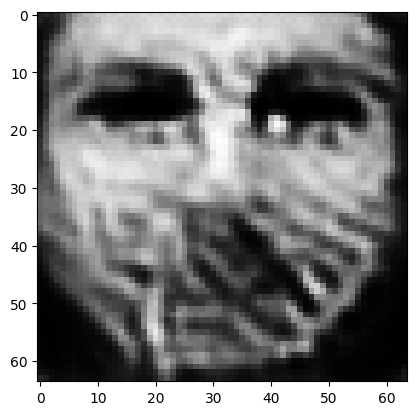

tensor([[3.5156e-04, 1.8468e-07, 2.1684e-05, 4.0399e-07, 1.0306e-05, 6.7702e-04,
         9.9231e-01, 1.1623e-03, 1.5653e-08, 2.7204e-06, 1.7752e-05, 5.4883e-07,
         1.6478e-06, 2.0714e-08, 5.4661e-07, 1.8975e-04, 7.7822e-04, 1.2852e-03,
         3.1375e-05, 2.2858e-03, 1.2793e-06, 3.2029e-07, 2.4096e-09, 1.9197e-04,
         7.1798e-06, 1.4557e-09, 4.2061e-05, 4.1983e-05, 2.1277e-04, 4.5376e-07,
         1.3879e-08, 6.5116e-06, 3.1520e-04, 1.1792e-05, 1.1901e-06, 9.0503e-07,
         1.4576e-06, 1.2016e-06, 2.1872e-05, 1.1568e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007716371677815914
tensor([[3.5119e-04, 1.8440e-07, 2.1646e-05, 4.0349e-07, 1.0287e-05, 6.7586e-04,
         9.9232e-01, 1.1604e-03, 1.5621e-08, 2.7163e-06, 1.7723e-05, 5.4766e-07,
         1.6453e-06, 2.0672e-08, 5.4603e-07, 1.8960e-04, 7.7736e-04, 1.2835e-03,
         3.1358e-05, 2.2830e-03, 1.2777e-06, 3.1969e-07, 2.4048e-09, 1.9178e-04,
         7.1639e-06, 1.4522e-09, 4.1997e-

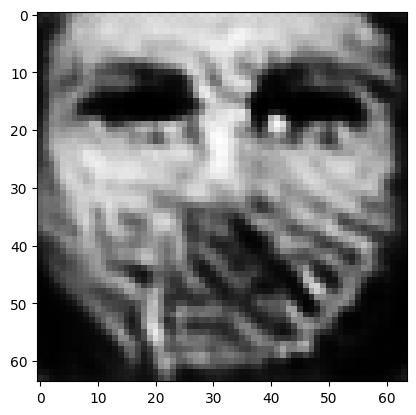

tensor([[3.4973e-04, 1.8324e-07, 2.1512e-05, 4.0144e-07, 1.0214e-05, 6.7199e-04,
         9.9236e-01, 1.1534e-03, 1.5492e-08, 2.7008e-06, 1.7617e-05, 5.4327e-07,
         1.6347e-06, 2.0492e-08, 5.4323e-07, 1.8902e-04, 7.7405e-04, 1.2763e-03,
         3.1285e-05, 2.2722e-03, 1.2711e-06, 3.1732e-07, 2.3848e-09, 1.9101e-04,
         7.1006e-06, 1.4389e-09, 4.1739e-05, 4.1728e-05, 2.1185e-04, 4.5037e-07,
         1.3741e-08, 6.4506e-06, 3.1216e-04, 1.1691e-05, 1.1830e-06, 8.9763e-07,
         1.4449e-06, 1.1894e-06, 2.1716e-05, 1.1486e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007666450925171375
tensor([[3.4938e-04, 1.8297e-07, 2.1478e-05, 4.0098e-07, 1.0197e-05, 6.7094e-04,
         9.9237e-01, 1.1516e-03, 1.5462e-08, 2.6970e-06, 1.7591e-05, 5.4218e-07,
         1.6324e-06, 2.0451e-08, 5.4266e-07, 1.8888e-04, 7.7325e-04, 1.2746e-03,
         3.1269e-05, 2.2697e-03, 1.2696e-06, 3.1675e-07, 2.3803e-09, 1.9083e-04,
         7.0857e-06, 1.4357e-09, 4.1680e-

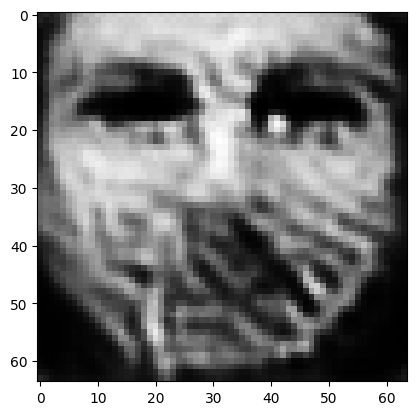

tensor([[3.4803e-04, 1.8186e-07, 2.1353e-05, 3.9905e-07, 1.0128e-05, 6.6716e-04,
         9.9241e-01, 1.1452e-03, 1.5341e-08, 2.6824e-06, 1.7496e-05, 5.3808e-07,
         1.6224e-06, 2.0288e-08, 5.4015e-07, 1.8832e-04, 7.7025e-04, 1.2680e-03,
         3.1198e-05, 2.2596e-03, 1.2635e-06, 3.1453e-07, 2.3612e-09, 1.9015e-04,
         7.0272e-06, 1.4234e-09, 4.1430e-05, 4.1493e-05, 2.1102e-04, 4.4724e-07,
         1.3612e-08, 6.3937e-06, 3.0929e-04, 1.1596e-05, 1.1762e-06, 8.9067e-07,
         1.4331e-06, 1.1783e-06, 2.1569e-05, 1.1407e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007619721814990044
tensor([[3.4770e-04, 1.8161e-07, 2.1320e-05, 3.9861e-07, 1.0112e-05, 6.6620e-04,
         9.9242e-01, 1.1435e-03, 1.5313e-08, 2.6788e-06, 1.7472e-05, 5.3707e-07,
         1.6202e-06, 2.0251e-08, 5.3960e-07, 1.8818e-04, 7.6950e-04, 1.2665e-03,
         3.1182e-05, 2.2571e-03, 1.2620e-06, 3.1400e-07, 2.3571e-09, 1.8998e-04,
         7.0136e-06, 1.4203e-09, 4.1375e-

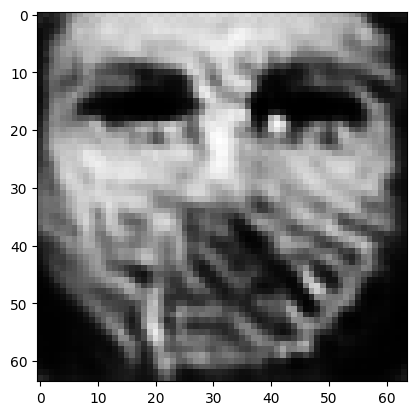

tensor([[3.4641e-04, 1.8059e-07, 2.1203e-05, 3.9682e-07, 1.0048e-05, 6.6282e-04,
         9.9245e-01, 1.1375e-03, 1.5202e-08, 2.6651e-06, 1.7381e-05, 5.3327e-07,
         1.6111e-06, 2.0097e-08, 5.3714e-07, 1.8765e-04, 7.6658e-04, 1.2604e-03,
         3.1117e-05, 2.2476e-03, 1.2562e-06, 3.1192e-07, 2.3398e-09, 1.8929e-04,
         6.9588e-06, 1.4088e-09, 4.1153e-05, 4.1270e-05, 2.1019e-04, 4.4423e-07,
         1.3491e-08, 6.3409e-06, 3.0664e-04, 1.1508e-05, 1.1699e-06, 8.8421e-07,
         1.4222e-06, 1.1678e-06, 2.1431e-05, 1.1335e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00757606653496623
tensor([[3.4611e-04, 1.8032e-07, 2.1176e-05, 3.9635e-07, 1.0032e-05, 6.6200e-04,
         9.9246e-01, 1.1361e-03, 1.5173e-08, 2.6619e-06, 1.7360e-05, 5.3235e-07,
         1.6086e-06, 2.0058e-08, 5.3651e-07, 1.8752e-04, 7.6592e-04, 1.2588e-03,
         3.1099e-05, 2.2453e-03, 1.2547e-06, 3.1141e-07, 2.3350e-09, 1.8914e-04,
         6.9452e-06, 1.4061e-09, 4.1092e-0

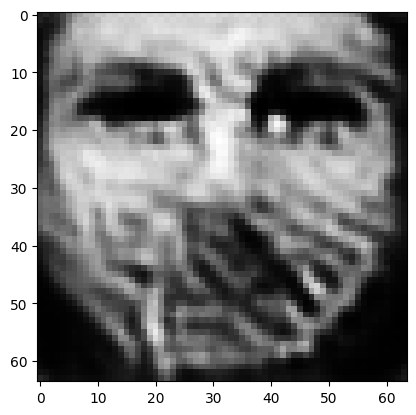

tensor([[3.4491e-04, 1.7937e-07, 2.1062e-05, 3.9468e-07, 9.9728e-06, 6.5861e-04,
         9.9249e-01, 1.1304e-03, 1.5068e-08, 2.6487e-06, 1.7274e-05, 5.2871e-07,
         1.6001e-06, 1.9919e-08, 5.3438e-07, 1.8702e-04, 7.6322e-04, 1.2532e-03,
         3.1037e-05, 2.2364e-03, 1.2493e-06, 3.0946e-07, 2.3189e-09, 1.8852e-04,
         6.8949e-06, 1.3952e-09, 4.0880e-05, 4.1064e-05, 2.0942e-04, 4.4143e-07,
         1.3378e-08, 6.2910e-06, 3.0411e-04, 1.1424e-05, 1.1638e-06, 8.7804e-07,
         1.4119e-06, 1.1579e-06, 2.1299e-05, 1.1265e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007535130251199007
tensor([[3.4463e-04, 1.7912e-07, 2.1037e-05, 3.9424e-07, 9.9576e-06, 6.5785e-04,
         9.9250e-01, 1.1291e-03, 1.5041e-08, 2.6457e-06, 1.7255e-05, 5.2785e-07,
         1.5978e-06, 1.9883e-08, 5.3380e-07, 1.8690e-04, 7.6261e-04, 1.2517e-03,
         3.1020e-05, 2.2341e-03, 1.2478e-06, 3.0899e-07, 2.3145e-09, 1.8838e-04,
         6.8822e-06, 1.3926e-09, 4.0823e-

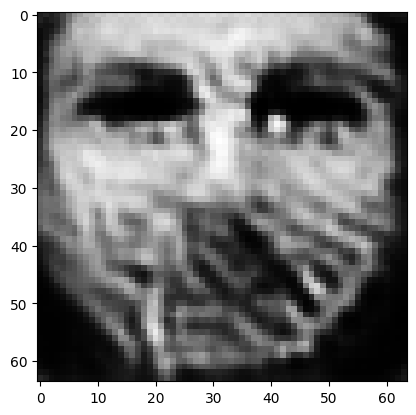

tensor([[3.4352e-04, 1.7822e-07, 2.0933e-05, 3.9268e-07, 9.9032e-06, 6.5478e-04,
         9.9253e-01, 1.1238e-03, 1.4945e-08, 2.6336e-06, 1.7176e-05, 5.2449e-07,
         1.5899e-06, 1.9753e-08, 5.3172e-07, 1.8641e-04, 7.6010e-04, 1.2464e-03,
         3.0961e-05, 2.2258e-03, 1.2427e-06, 3.0718e-07, 2.2996e-09, 1.8780e-04,
         6.8364e-06, 1.3827e-09, 4.0625e-05, 4.0873e-05, 2.0871e-04, 4.3879e-07,
         1.3272e-08, 6.2446e-06, 3.0177e-04, 1.1346e-05, 1.1581e-06, 8.7227e-07,
         1.4024e-06, 1.1489e-06, 2.1178e-05, 1.1200e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0074969143606722355
tensor([[3.4325e-04, 1.7801e-07, 2.0908e-05, 3.9231e-07, 9.8908e-06, 6.5406e-04,
         9.9254e-01, 1.1226e-03, 1.4923e-08, 2.6307e-06, 1.7156e-05, 5.2369e-07,
         1.5881e-06, 1.9723e-08, 5.3122e-07, 1.8629e-04, 7.5950e-04, 1.2451e-03,
         3.0948e-05, 2.2238e-03, 1.2416e-06, 3.0676e-07, 2.2963e-09, 1.8766e-04,
         6.8258e-06, 1.3804e-09, 4.0579e

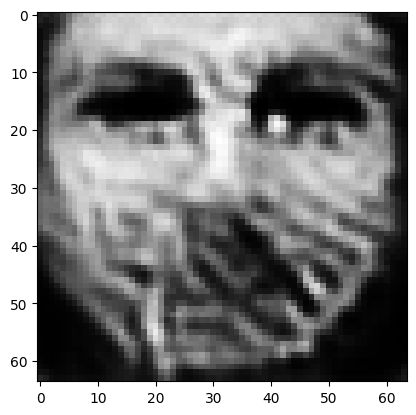

tensor([[3.4219e-04, 1.7715e-07, 2.0820e-05, 3.9083e-07, 9.8403e-06, 6.5139e-04,
         9.9257e-01, 1.1180e-03, 1.4835e-08, 2.6199e-06, 1.7084e-05, 5.2060e-07,
         1.5805e-06, 1.9598e-08, 5.2909e-07, 1.8583e-04, 7.5724e-04, 1.2398e-03,
         3.0892e-05, 2.2159e-03, 1.2367e-06, 3.0509e-07, 2.2820e-09, 1.8710e-04,
         6.7832e-06, 1.3716e-09, 4.0390e-05, 4.0698e-05, 2.0808e-04, 4.3637e-07,
         1.3176e-08, 6.2007e-06, 2.9965e-04, 1.1275e-05, 1.1529e-06, 8.6685e-07,
         1.3936e-06, 1.1407e-06, 2.1070e-05, 1.1144e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0074616544879972935
tensor([[3.4194e-04, 1.7695e-07, 2.0796e-05, 3.9049e-07, 9.8287e-06, 6.5071e-04,
         9.9257e-01, 1.1168e-03, 1.4815e-08, 2.6171e-06, 1.7066e-05, 5.1985e-07,
         1.5788e-06, 1.9570e-08, 5.2862e-07, 1.8572e-04, 7.5668e-04, 1.2386e-03,
         3.0879e-05, 2.2141e-03, 1.2356e-06, 3.0469e-07, 2.2789e-09, 1.8697e-04,
         6.7733e-06, 1.3694e-09, 4.0347e

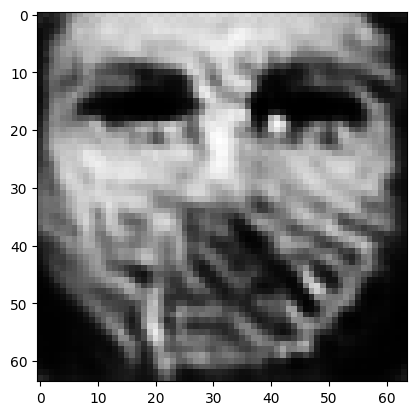

tensor([[3.4096e-04, 1.7617e-07, 2.0712e-05, 3.8912e-07, 9.7825e-06, 6.4824e-04,
         9.9260e-01, 1.1125e-03, 1.4734e-08, 2.6069e-06, 1.6998e-05, 5.1701e-07,
         1.5719e-06, 1.9455e-08, 5.2665e-07, 1.8529e-04, 7.5451e-04, 1.2338e-03,
         3.0827e-05, 2.2067e-03, 1.2311e-06, 3.0313e-07, 2.2661e-09, 1.8644e-04,
         6.7341e-06, 1.3611e-09, 4.0178e-05, 4.0534e-05, 2.0746e-04, 4.3408e-07,
         1.3087e-08, 6.1604e-06, 2.9770e-04, 1.1209e-05, 1.1481e-06, 8.6192e-07,
         1.3855e-06, 1.1331e-06, 2.0970e-05, 1.1092e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007428641896694899
tensor([[3.4073e-04, 1.7598e-07, 2.0692e-05, 3.8880e-07, 9.7716e-06, 6.4764e-04,
         9.9260e-01, 1.1115e-03, 1.4714e-08, 2.6045e-06, 1.6982e-05, 5.1633e-07,
         1.5702e-06, 1.9428e-08, 5.2619e-07, 1.8518e-04, 7.5399e-04, 1.2327e-03,
         3.0814e-05, 2.2050e-03, 1.2300e-06, 3.0276e-07, 2.2631e-09, 1.8631e-04,
         6.7248e-06, 1.3591e-09, 4.0138e-

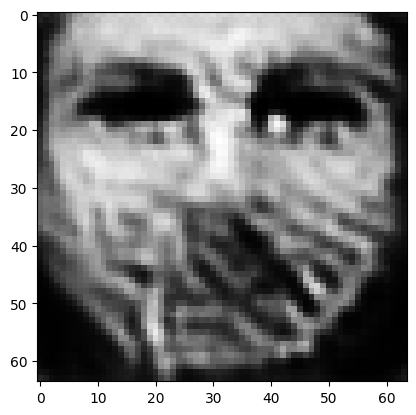

tensor([[3.3984e-04, 1.7525e-07, 2.0614e-05, 3.8754e-07, 9.7285e-06, 6.4535e-04,
         9.9263e-01, 1.1075e-03, 1.4639e-08, 2.5950e-06, 1.6919e-05, 5.1369e-07,
         1.5637e-06, 1.9321e-08, 5.2434e-07, 1.8478e-04, 7.5202e-04, 1.2282e-03,
         3.0765e-05, 2.1981e-03, 1.2259e-06, 3.0131e-07, 2.2511e-09, 1.8583e-04,
         6.6885e-06, 1.3515e-09, 3.9977e-05, 4.0382e-05, 2.0689e-04, 4.3197e-07,
         1.3003e-08, 6.1226e-06, 2.9587e-04, 1.1146e-05, 1.1436e-06, 8.5727e-07,
         1.3781e-06, 1.1260e-06, 2.0876e-05, 1.1045e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007398231420665979
tensor([[3.3962e-04, 1.7508e-07, 2.0595e-05, 3.8724e-07, 9.7183e-06, 6.4477e-04,
         9.9263e-01, 1.1065e-03, 1.4620e-08, 2.5927e-06, 1.6903e-05, 5.1304e-07,
         1.5622e-06, 1.9296e-08, 5.2392e-07, 1.8469e-04, 7.5154e-04, 1.2271e-03,
         3.0755e-05, 2.1965e-03, 1.2249e-06, 3.0096e-07, 2.2483e-09, 1.8572e-04,
         6.6798e-06, 1.3496e-09, 3.9940e-

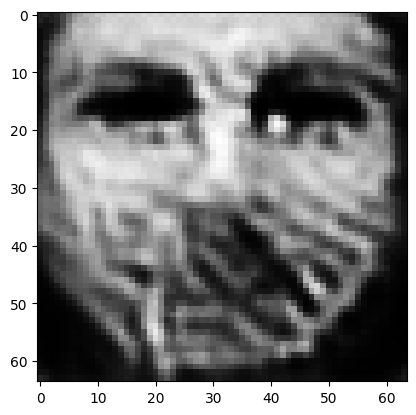

tensor([[3.3878e-04, 1.7439e-07, 2.0523e-05, 3.8605e-07, 9.6772e-06, 6.4259e-04,
         9.9266e-01, 1.1027e-03, 1.4549e-08, 2.5839e-06, 1.6844e-05, 5.1055e-07,
         1.5560e-06, 1.9195e-08, 5.2221e-07, 1.8432e-04, 7.4970e-04, 1.2228e-03,
         3.0710e-05, 2.1900e-03, 1.2211e-06, 2.9960e-07, 2.2370e-09, 1.8527e-04,
         6.6455e-06, 1.3425e-09, 3.9787e-05, 4.0239e-05, 2.0640e-04, 4.3004e-07,
         1.2926e-08, 6.0869e-06, 2.9415e-04, 1.1088e-05, 1.1395e-06, 8.5287e-07,
         1.3710e-06, 1.1195e-06, 2.0788e-05, 1.1000e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007369358092546463
tensor([[3.3858e-04, 1.7423e-07, 2.0504e-05, 3.8577e-07, 9.6674e-06, 6.4206e-04,
         9.9266e-01, 1.1018e-03, 1.4532e-08, 2.5817e-06, 1.6830e-05, 5.0995e-07,
         1.5545e-06, 1.9171e-08, 5.2180e-07, 1.8423e-04, 7.4924e-04, 1.2218e-03,
         3.0699e-05, 2.1884e-03, 1.2202e-06, 2.9927e-07, 2.2343e-09, 1.8516e-04,
         6.6373e-06, 1.3408e-09, 3.9752e-

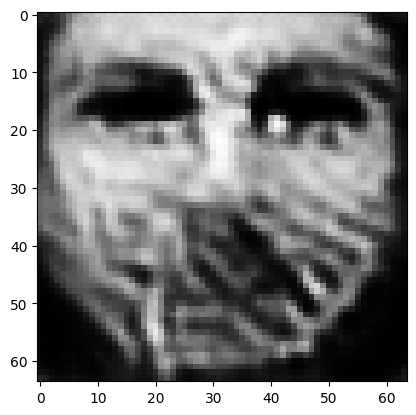

tensor([[3.3779e-04, 1.7358e-07, 2.0435e-05, 3.8465e-07, 9.6286e-06, 6.4000e-04,
         9.9268e-01, 1.0982e-03, 1.4464e-08, 2.5734e-06, 1.6774e-05, 5.0760e-07,
         1.5487e-06, 1.9076e-08, 5.2020e-07, 1.8388e-04, 7.4747e-04, 1.2177e-03,
         3.0658e-05, 2.1823e-03, 1.2165e-06, 2.9800e-07, 2.2237e-09, 1.8474e-04,
         6.6051e-06, 1.3341e-09, 3.9609e-05, 4.0104e-05, 2.0592e-04, 4.2821e-07,
         1.2852e-08, 6.0538e-06, 2.9253e-04, 1.1032e-05, 1.1356e-06, 8.4876e-07,
         1.3643e-06, 1.1133e-06, 2.0704e-05, 1.0958e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0073422593995928764
tensor([[3.3760e-04, 1.7343e-07, 2.0418e-05, 3.8439e-07, 9.6194e-06, 6.3949e-04,
         9.9269e-01, 1.0973e-03, 1.4448e-08, 2.5714e-06, 1.6760e-05, 5.0702e-07,
         1.5473e-06, 1.9053e-08, 5.1983e-07, 1.8379e-04, 7.4704e-04, 1.2167e-03,
         3.0648e-05, 2.1809e-03, 1.2156e-06, 2.9769e-07, 2.2212e-09, 1.8464e-04,
         6.5974e-06, 1.3325e-09, 3.9575e

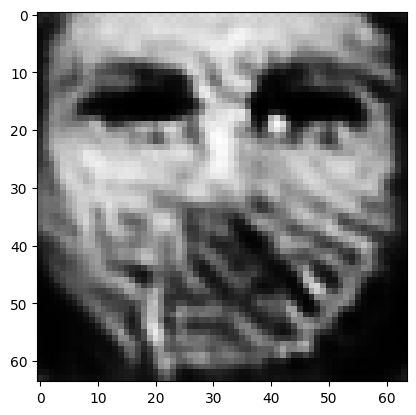

tensor([[3.3688e-04, 1.7282e-07, 2.0354e-05, 3.8334e-07, 9.5834e-06, 6.3759e-04,
         9.9271e-01, 1.0940e-03, 1.4384e-08, 2.5635e-06, 1.6708e-05, 5.0483e-07,
         1.5418e-06, 1.8963e-08, 5.1830e-07, 1.8346e-04, 7.4538e-04, 1.2130e-03,
         3.0608e-05, 2.1750e-03, 1.2121e-06, 2.9650e-07, 2.2112e-09, 1.8425e-04,
         6.5676e-06, 1.3262e-09, 3.9442e-05, 3.9977e-05, 2.0545e-04, 4.2646e-07,
         1.2782e-08, 6.0228e-06, 2.9100e-04, 1.0980e-05, 1.1319e-06, 8.4493e-07,
         1.3581e-06, 1.1075e-06, 2.0625e-05, 1.0917e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00731669832020998
tensor([[3.3670e-04, 1.7268e-07, 2.0337e-05, 3.8309e-07, 9.5748e-06, 6.3711e-04,
         9.9272e-01, 1.0932e-03, 1.4369e-08, 2.5616e-06, 1.6695e-05, 5.0429e-07,
         1.5405e-06, 1.8942e-08, 5.1795e-07, 1.8338e-04, 7.4496e-04, 1.2121e-03,
         3.0598e-05, 2.1736e-03, 1.2113e-06, 2.9621e-07, 2.2088e-09, 1.8415e-04,
         6.5604e-06, 1.3246e-09, 3.9410e-0

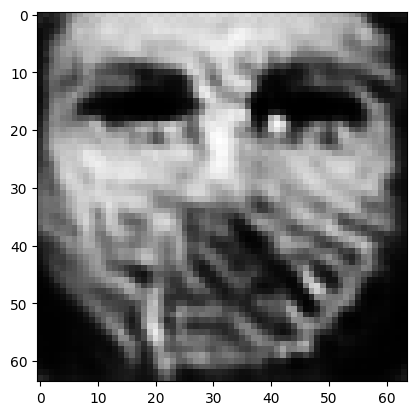

tensor([[3.3602e-04, 1.7211e-07, 2.0276e-05, 3.8210e-07, 9.5410e-06, 6.3532e-04,
         9.9273e-01, 1.0902e-03, 1.4308e-08, 2.5542e-06, 1.6646e-05, 5.0222e-07,
         1.5352e-06, 1.8858e-08, 5.1652e-07, 1.8307e-04, 7.4340e-04, 1.2086e-03,
         3.0560e-05, 2.1682e-03, 1.2080e-06, 2.9509e-07, 2.1994e-09, 1.8379e-04,
         6.5324e-06, 1.3187e-09, 3.9285e-05, 3.9857e-05, 2.0500e-04, 4.2481e-07,
         1.2717e-08, 5.9939e-06, 2.8957e-04, 1.0931e-05, 1.1284e-06, 8.4134e-07,
         1.3522e-06, 1.1020e-06, 2.0549e-05, 1.0879e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00729279313236475
tensor([[3.3585e-04, 1.7197e-07, 2.0261e-05, 3.8186e-07, 9.5328e-06, 6.3487e-04,
         9.9274e-01, 1.0894e-03, 1.4294e-08, 2.5523e-06, 1.6634e-05, 5.0171e-07,
         1.5340e-06, 1.8837e-08, 5.1619e-07, 1.8299e-04, 7.4300e-04, 1.2078e-03,
         3.0551e-05, 2.1669e-03, 1.2072e-06, 2.9482e-07, 2.1972e-09, 1.8370e-04,
         6.5257e-06, 1.3173e-09, 3.9255e-0

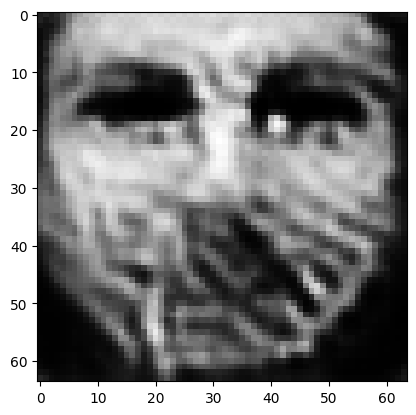

tensor([[3.3521e-04, 1.7143e-07, 2.0203e-05, 3.8092e-07, 9.5006e-06, 6.3318e-04,
         9.9276e-01, 1.0865e-03, 1.4236e-08, 2.5453e-06, 1.6587e-05, 4.9977e-07,
         1.5290e-06, 1.8758e-08, 5.1483e-07, 1.8269e-04, 7.4148e-04, 1.2045e-03,
         3.0515e-05, 2.1617e-03, 1.2040e-06, 2.9376e-07, 2.1882e-09, 1.8335e-04,
         6.4992e-06, 1.3116e-09, 3.9137e-05, 3.9744e-05, 2.0458e-04, 4.2324e-07,
         1.2655e-08, 5.9669e-06, 2.8822e-04, 1.0884e-05, 1.1250e-06, 8.3796e-07,
         1.3467e-06, 1.0969e-06, 2.0476e-05, 1.0842e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007270071189850569
tensor([[3.3505e-04, 1.7131e-07, 2.0188e-05, 3.8069e-07, 9.4929e-06, 6.3276e-04,
         9.9276e-01, 1.0857e-03, 1.4223e-08, 2.5436e-06, 1.6576e-05, 4.9929e-07,
         1.5278e-06, 1.8739e-08, 5.1451e-07, 1.8262e-04, 7.4111e-04, 1.2037e-03,
         3.0506e-05, 2.1604e-03, 1.2032e-06, 2.9351e-07, 2.1861e-09, 1.8326e-04,
         6.4928e-06, 1.3103e-09, 3.9109e-

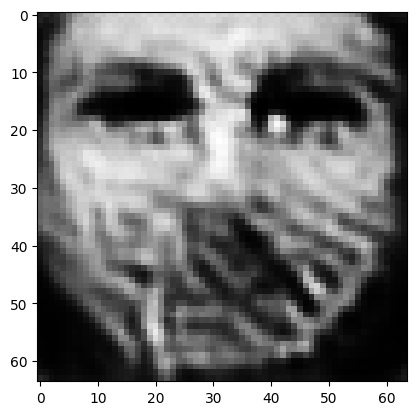

tensor([[3.3445e-04, 1.7080e-07, 2.0133e-05, 3.7980e-07, 9.4626e-06, 6.3116e-04,
         9.9278e-01, 1.0830e-03, 1.4168e-08, 2.5370e-06, 1.6532e-05, 4.9746e-07,
         1.5231e-06, 1.8663e-08, 5.1325e-07, 1.8234e-04, 7.3968e-04, 1.2006e-03,
         3.0472e-05, 2.1556e-03, 1.2002e-06, 2.9251e-07, 2.1776e-09, 1.8294e-04,
         6.4678e-06, 1.3050e-09, 3.8997e-05, 3.9637e-05, 2.0417e-04, 4.2175e-07,
         1.2596e-08, 5.9415e-06, 2.8695e-04, 1.0840e-05, 1.1218e-06, 8.3478e-07,
         1.3414e-06, 1.0921e-06, 2.0407e-05, 1.0806e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0072486503049731255
tensor([[3.3430e-04, 1.7068e-07, 2.0119e-05, 3.7959e-07, 9.4554e-06, 6.3075e-04,
         9.9278e-01, 1.0823e-03, 1.4155e-08, 2.5353e-06, 1.6521e-05, 4.9701e-07,
         1.5220e-06, 1.8646e-08, 5.1295e-07, 1.8227e-04, 7.3934e-04, 1.1999e-03,
         3.0464e-05, 2.1544e-03, 1.1995e-06, 2.9227e-07, 2.1756e-09, 1.8286e-04,
         6.4619e-06, 1.3037e-09, 3.8971e

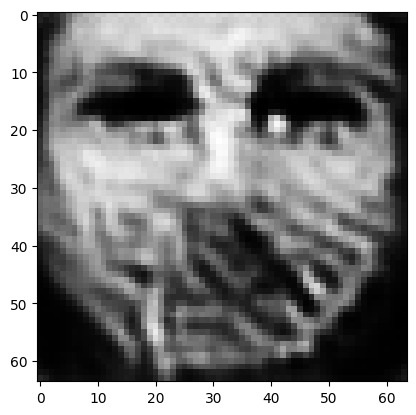

tensor([[3.3373e-04, 1.7020e-07, 2.0066e-05, 3.7875e-07, 9.4270e-06, 6.2924e-04,
         9.9280e-01, 1.0797e-03, 1.4104e-08, 2.5290e-06, 1.6480e-05, 4.9528e-07,
         1.5176e-06, 1.8575e-08, 5.1175e-07, 1.8201e-04, 7.3799e-04, 1.1970e-03,
         3.0431e-05, 2.1498e-03, 1.1967e-06, 2.9133e-07, 2.1677e-09, 1.8255e-04,
         6.4385e-06, 1.2987e-09, 3.8865e-05, 3.9536e-05, 2.0377e-04, 4.2035e-07,
         1.2541e-08, 5.9176e-06, 2.8575e-04, 1.0798e-05, 1.1188e-06, 8.3181e-07,
         1.3365e-06, 1.0875e-06, 2.0342e-05, 1.0773e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007228530943393707
tensor([[3.3360e-04, 1.7007e-07, 2.0055e-05, 3.7853e-07, 9.4195e-06, 6.2890e-04,
         9.9280e-01, 1.0792e-03, 1.4090e-08, 2.5276e-06, 1.6471e-05, 4.9486e-07,
         1.5164e-06, 1.8557e-08, 5.1142e-07, 1.8194e-04, 7.3767e-04, 1.1962e-03,
         3.0422e-05, 2.1486e-03, 1.1960e-06, 2.9110e-07, 2.1654e-09, 1.8248e-04,
         6.4324e-06, 1.2975e-09, 3.8837e-

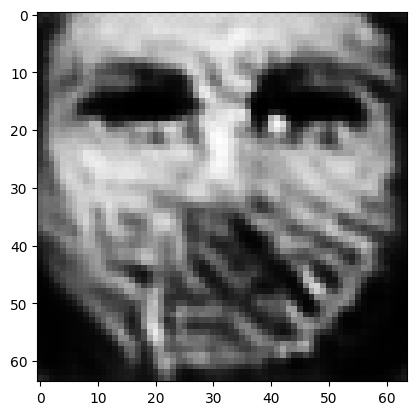

tensor([[3.3306e-04, 1.6962e-07, 2.0006e-05, 3.7774e-07, 9.3926e-06, 6.2749e-04,
         9.9282e-01, 1.0768e-03, 1.4042e-08, 2.5216e-06, 1.6432e-05, 4.9323e-07,
         1.5122e-06, 1.8490e-08, 5.1027e-07, 1.8169e-04, 7.3641e-04, 1.1934e-03,
         3.0391e-05, 2.1442e-03, 1.1933e-06, 2.9022e-07, 2.1580e-09, 1.8219e-04,
         6.4103e-06, 1.2928e-09, 3.8737e-05, 3.9441e-05, 2.0341e-04, 4.1901e-07,
         1.2488e-08, 5.8945e-06, 2.8460e-04, 1.0758e-05, 1.1159e-06, 8.2887e-07,
         1.3318e-06, 1.0833e-06, 2.0279e-05, 1.0741e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007209357805550098
tensor([[3.3294e-04, 1.6951e-07, 1.9993e-05, 3.7755e-07, 9.3861e-06, 6.2714e-04,
         9.9282e-01, 1.0761e-03, 1.4030e-08, 2.5201e-06, 1.6422e-05, 4.9283e-07,
         1.5112e-06, 1.8474e-08, 5.1000e-07, 1.8163e-04, 7.3609e-04, 1.1928e-03,
         3.0383e-05, 2.1431e-03, 1.1926e-06, 2.9000e-07, 2.1562e-09, 1.8212e-04,
         6.4050e-06, 1.2916e-09, 3.8713e-

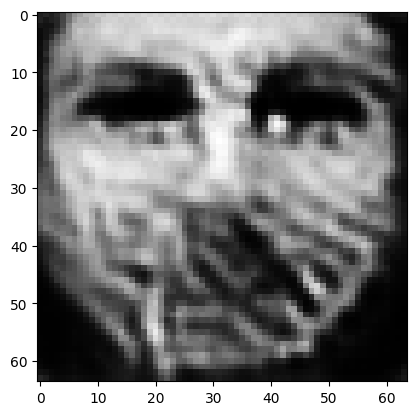

tensor([[3.3243e-04, 1.6908e-07, 1.9946e-05, 3.7680e-07, 9.3608e-06, 6.2578e-04,
         9.9283e-01, 1.0738e-03, 1.3984e-08, 2.5145e-06, 1.6385e-05, 4.9127e-07,
         1.5072e-06, 1.8411e-08, 5.0892e-07, 1.8139e-04, 7.3490e-04, 1.1902e-03,
         3.0354e-05, 2.1389e-03, 1.1901e-06, 2.8916e-07, 2.1492e-09, 1.8184e-04,
         6.3842e-06, 1.2872e-09, 3.8618e-05, 3.9350e-05, 2.0305e-04, 4.1774e-07,
         1.2438e-08, 5.8732e-06, 2.8352e-04, 1.0721e-05, 1.1132e-06, 8.2621e-07,
         1.3275e-06, 1.0792e-06, 2.0220e-05, 1.0711e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0071913679130375385
tensor([[3.3231e-04, 1.6898e-07, 1.9934e-05, 3.7662e-07, 9.3547e-06, 6.2545e-04,
         9.9284e-01, 1.0732e-03, 1.3973e-08, 2.5130e-06, 1.6376e-05, 4.9089e-07,
         1.5063e-06, 1.8396e-08, 5.0867e-07, 1.8134e-04, 7.3461e-04, 1.1896e-03,
         3.0347e-05, 2.1379e-03, 1.1895e-06, 2.8896e-07, 2.1475e-09, 1.8178e-04,
         6.3791e-06, 1.2861e-09, 3.8596e

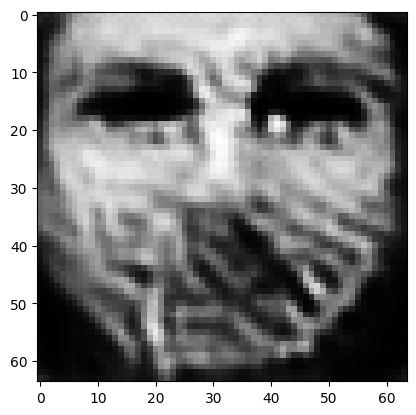

tensor([[3.3183e-04, 1.6857e-07, 1.9891e-05, 3.7591e-07, 9.3308e-06, 6.2418e-04,
         9.9285e-01, 1.0711e-03, 1.3930e-08, 2.5077e-06, 1.6341e-05, 4.8942e-07,
         1.5025e-06, 1.8336e-08, 5.0764e-07, 1.8111e-04, 7.3352e-04, 1.1871e-03,
         3.0319e-05, 2.1339e-03, 1.1871e-06, 2.8816e-07, 2.1409e-09, 1.8152e-04,
         6.3596e-06, 1.2820e-09, 3.8505e-05, 3.9265e-05, 2.0272e-04, 4.1656e-07,
         1.2392e-08, 5.8529e-06, 2.8251e-04, 1.0686e-05, 1.1106e-06, 8.2367e-07,
         1.3234e-06, 1.0754e-06, 2.0165e-05, 1.0683e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007174206431955099
tensor([[3.3171e-04, 1.6847e-07, 1.9879e-05, 3.7575e-07, 9.3250e-06, 6.2386e-04,
         9.9285e-01, 1.0705e-03, 1.3919e-08, 2.5064e-06, 1.6332e-05, 4.8906e-07,
         1.5016e-06, 1.8322e-08, 5.0741e-07, 1.8106e-04, 7.3325e-04, 1.1865e-03,
         3.0313e-05, 2.1329e-03, 1.1866e-06, 2.8797e-07, 2.1393e-09, 1.8146e-04,
         6.3548e-06, 1.2810e-09, 3.8484e-

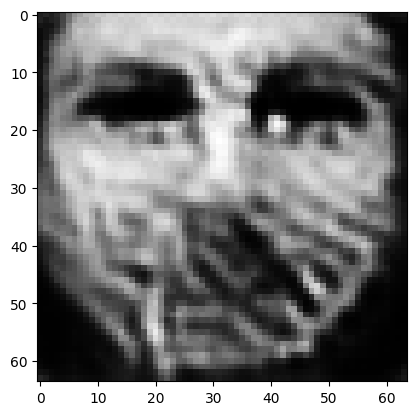

tensor([[3.3127e-04, 1.6809e-07, 1.9837e-05, 3.7508e-07, 9.3025e-06, 6.2264e-04,
         9.9287e-01, 1.0685e-03, 1.3878e-08, 2.5012e-06, 1.6299e-05, 4.8766e-07,
         1.4981e-06, 1.8267e-08, 5.0646e-07, 1.8085e-04, 7.3223e-04, 1.1842e-03,
         3.0287e-05, 2.1291e-03, 1.1843e-06, 2.8722e-07, 2.1331e-09, 1.8123e-04,
         6.3365e-06, 1.2771e-09, 3.8397e-05, 3.9185e-05, 2.0241e-04, 4.1546e-07,
         1.2348e-08, 5.8337e-06, 2.8155e-04, 1.0653e-05, 1.1082e-06, 8.2129e-07,
         1.3195e-06, 1.0718e-06, 2.0113e-05, 1.0656e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0071581099182367325
tensor([[3.3116e-04, 1.6799e-07, 1.9828e-05, 3.7491e-07, 9.2966e-06, 6.2237e-04,
         9.9287e-01, 1.0680e-03, 1.3867e-08, 2.5001e-06, 1.6292e-05, 4.8732e-07,
         1.4971e-06, 1.8252e-08, 5.0620e-07, 1.8080e-04, 7.3199e-04, 1.1835e-03,
         3.0280e-05, 2.1282e-03, 1.1837e-06, 2.8704e-07, 2.1313e-09, 1.8118e-04,
         6.3318e-06, 1.2761e-09, 3.8374e

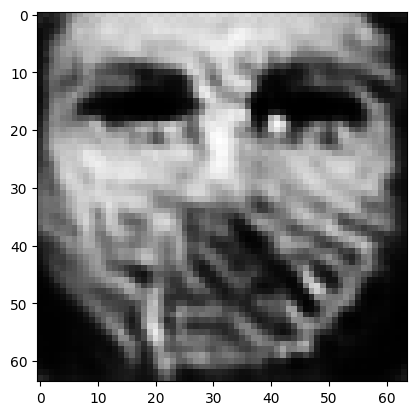

tensor([[3.3074e-04, 1.6763e-07, 1.9789e-05, 3.7429e-07, 9.2753e-06, 6.2121e-04,
         9.9288e-01, 1.0661e-03, 1.3829e-08, 2.4952e-06, 1.6260e-05, 4.8599e-07,
         1.4938e-06, 1.8200e-08, 5.0532e-07, 1.8059e-04, 7.3102e-04, 1.1813e-03,
         3.0256e-05, 2.1246e-03, 1.1817e-06, 2.8633e-07, 2.1255e-09, 1.8096e-04,
         6.3144e-06, 1.2725e-09, 3.8293e-05, 3.9110e-05, 2.0211e-04, 4.1441e-07,
         1.2307e-08, 5.8152e-06, 2.8063e-04, 1.0621e-05, 1.1059e-06, 8.1897e-07,
         1.3158e-06, 1.0684e-06, 2.0063e-05, 1.0630e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007142959628254175
tensor([[3.3064e-04, 1.6754e-07, 1.9778e-05, 3.7414e-07, 9.2703e-06, 6.2092e-04,
         9.9289e-01, 1.0656e-03, 1.3819e-08, 2.4940e-06, 1.6253e-05, 4.8567e-07,
         1.4930e-06, 1.8187e-08, 5.0511e-07, 1.8055e-04, 7.3078e-04, 1.1809e-03,
         3.0250e-05, 2.1237e-03, 1.1812e-06, 2.8616e-07, 2.1242e-09, 1.8091e-04,
         6.3104e-06, 1.2716e-09, 3.8274e-

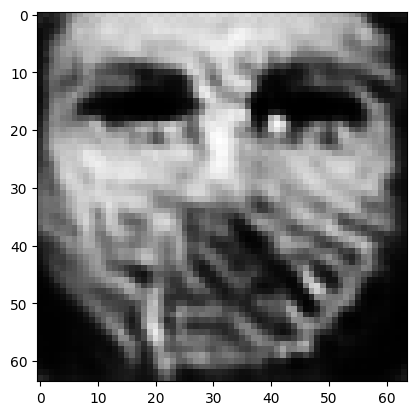

tensor([[3.3023e-04, 1.6720e-07, 1.9740e-05, 3.7353e-07, 9.2497e-06, 6.1978e-04,
         9.9290e-01, 1.0637e-03, 1.3781e-08, 2.4893e-06, 1.6223e-05, 4.8442e-07,
         1.4898e-06, 1.8138e-08, 5.0428e-07, 1.8035e-04, 7.2984e-04, 1.1789e-03,
         3.0227e-05, 2.1204e-03, 1.1791e-06, 2.8549e-07, 2.1184e-09, 1.8070e-04,
         6.2938e-06, 1.2680e-09, 3.8197e-05, 3.9037e-05, 2.0182e-04, 4.1341e-07,
         1.2267e-08, 5.7986e-06, 2.7978e-04, 1.0590e-05, 1.1037e-06, 8.1687e-07,
         1.3123e-06, 1.0653e-06, 2.0015e-05, 1.0605e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007128401193767786
tensor([[3.3013e-04, 1.6712e-07, 1.9730e-05, 3.7339e-07, 9.2446e-06, 6.1951e-04,
         9.9290e-01, 1.0632e-03, 1.3772e-08, 2.4882e-06, 1.6216e-05, 4.8411e-07,
         1.4890e-06, 1.8125e-08, 5.0407e-07, 1.8030e-04, 7.2960e-04, 1.1784e-03,
         3.0221e-05, 2.1195e-03, 1.1786e-06, 2.8533e-07, 2.1169e-09, 1.8064e-04,
         6.2897e-06, 1.2671e-09, 3.8178e-

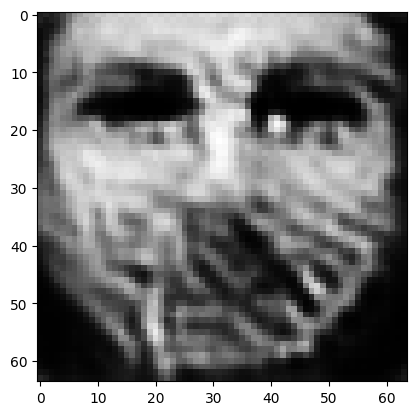

tensor([[3.2975e-04, 1.6680e-07, 1.9694e-05, 3.7280e-07, 9.2247e-06, 6.1845e-04,
         9.9291e-01, 1.0615e-03, 1.3735e-08, 2.4838e-06, 1.6189e-05, 4.8293e-07,
         1.4859e-06, 1.8078e-08, 5.0325e-07, 1.8012e-04, 7.2872e-04, 1.1765e-03,
         3.0199e-05, 2.1163e-03, 1.1766e-06, 2.8469e-07, 2.1113e-09, 1.8043e-04,
         6.2737e-06, 1.2637e-09, 3.8105e-05, 3.8967e-05, 2.0155e-04, 4.1244e-07,
         1.2228e-08, 5.7825e-06, 2.7896e-04, 1.0561e-05, 1.1016e-06, 8.1481e-07,
         1.3089e-06, 1.0622e-06, 1.9968e-05, 1.0580e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00711490772664547
tensor([[3.2965e-04, 1.6672e-07, 1.9685e-05, 3.7267e-07, 9.2201e-06, 6.1819e-04,
         9.9291e-01, 1.0610e-03, 1.3727e-08, 2.4827e-06, 1.6182e-05, 4.8265e-07,
         1.4852e-06, 1.8066e-08, 5.0306e-07, 1.8008e-04, 7.2849e-04, 1.1761e-03,
         3.0193e-05, 2.1156e-03, 1.1761e-06, 2.8453e-07, 2.1100e-09, 1.8038e-04,
         6.2699e-06, 1.2628e-09, 3.8088e-0

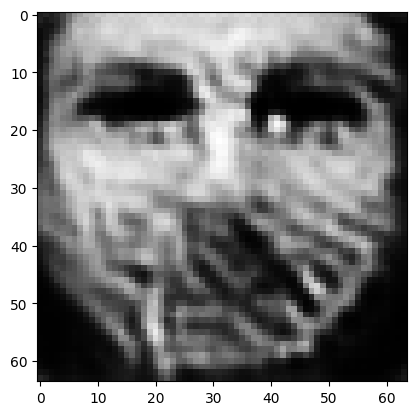

tensor([[3.2929e-04, 1.6642e-07, 1.9649e-05, 3.7213e-07, 9.2018e-06, 6.1716e-04,
         9.9292e-01, 1.0593e-03, 1.3693e-08, 2.4785e-06, 1.6155e-05, 4.8152e-07,
         1.4823e-06, 1.8023e-08, 5.0232e-07, 1.7990e-04, 7.2764e-04, 1.1744e-03,
         3.0173e-05, 2.1126e-03, 1.1742e-06, 2.8393e-07, 2.1050e-09, 1.8018e-04,
         6.2551e-06, 1.2596e-09, 3.8022e-05, 3.8900e-05, 2.0128e-04, 4.1153e-07,
         1.2192e-08, 5.7677e-06, 2.7820e-04, 1.0534e-05, 1.0996e-06, 8.1296e-07,
         1.3057e-06, 1.0593e-06, 1.9925e-05, 1.0557e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007101769093424082
tensor([[3.2920e-04, 1.6635e-07, 1.9641e-05, 3.7200e-07, 9.1972e-06, 6.1692e-04,
         9.9293e-01, 1.0589e-03, 1.3684e-08, 2.4775e-06, 1.6149e-05, 4.8125e-07,
         1.4816e-06, 1.8012e-08, 5.0213e-07, 1.7986e-04, 7.2742e-04, 1.1740e-03,
         3.0167e-05, 2.1118e-03, 1.1738e-06, 2.8378e-07, 2.1037e-09, 1.8013e-04,
         6.2514e-06, 1.2588e-09, 3.8005e-

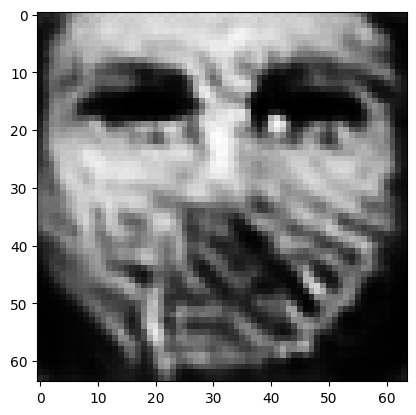

tensor([[3.2886e-04, 1.6606e-07, 1.9609e-05, 3.7147e-07, 9.1793e-06, 6.1601e-04,
         9.9294e-01, 1.0573e-03, 1.3652e-08, 2.4736e-06, 1.6124e-05, 4.8021e-07,
         1.4788e-06, 1.7968e-08, 5.0137e-07, 1.7970e-04, 7.2662e-04, 1.1722e-03,
         3.0147e-05, 2.1090e-03, 1.1720e-06, 2.8320e-07, 2.0986e-09, 1.7994e-04,
         6.2368e-06, 1.2557e-09, 3.7940e-05, 3.8837e-05, 2.0104e-04, 4.1065e-07,
         1.2157e-08, 5.7532e-06, 2.7746e-04, 1.0508e-05, 1.0976e-06, 8.1108e-07,
         1.3027e-06, 1.0566e-06, 1.9883e-05, 1.0536e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007089577615261078
tensor([[3.2877e-04, 1.6599e-07, 1.9601e-05, 3.7135e-07, 9.1751e-06, 6.1578e-04,
         9.9294e-01, 1.0569e-03, 1.3644e-08, 2.4726e-06, 1.6118e-05, 4.7996e-07,
         1.4782e-06, 1.7958e-08, 5.0119e-07, 1.7966e-04, 7.2642e-04, 1.1719e-03,
         3.0142e-05, 2.1083e-03, 1.1715e-06, 2.8306e-07, 2.0974e-09, 1.7989e-04,
         6.2334e-06, 1.2550e-09, 3.7925e-

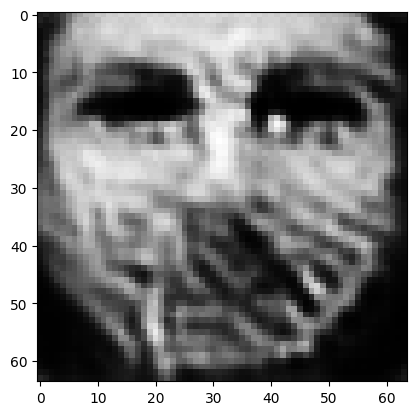

tensor([[3.2844e-04, 1.6572e-07, 1.9570e-05, 3.7086e-07, 9.1585e-06, 6.1489e-04,
         9.9295e-01, 1.0554e-03, 1.3614e-08, 2.4689e-06, 1.6094e-05, 4.7896e-07,
         1.4756e-06, 1.7917e-08, 5.0049e-07, 1.7951e-04, 7.2564e-04, 1.1703e-03,
         3.0123e-05, 2.1056e-03, 1.1698e-06, 2.8252e-07, 2.0928e-09, 1.7971e-04,
         6.2198e-06, 1.2521e-09, 3.7865e-05, 3.8777e-05, 2.0080e-04, 4.0983e-07,
         1.2125e-08, 5.7397e-06, 2.7677e-04, 1.0483e-05, 1.0958e-06, 8.0937e-07,
         1.2998e-06, 1.0540e-06, 1.9844e-05, 1.0515e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007077977526932955
tensor([[3.2836e-04, 1.6566e-07, 1.9563e-05, 3.7074e-07, 9.1544e-06, 6.1468e-04,
         9.9295e-01, 1.0550e-03, 1.3606e-08, 2.4680e-06, 1.6088e-05, 4.7872e-07,
         1.4750e-06, 1.7907e-08, 5.0032e-07, 1.7947e-04, 7.2544e-04, 1.1699e-03,
         3.0118e-05, 2.1049e-03, 1.1694e-06, 2.8239e-07, 2.0916e-09, 1.7966e-04,
         6.2164e-06, 1.2514e-09, 3.7851e-

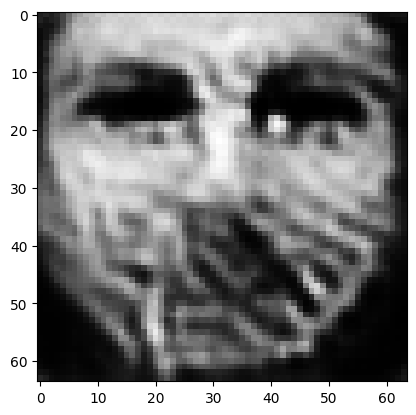

tensor([[3.2806e-04, 1.6540e-07, 1.9533e-05, 3.7028e-07, 9.1387e-06, 6.1383e-04,
         9.9296e-01, 1.0536e-03, 1.3577e-08, 2.4644e-06, 1.6065e-05, 4.7778e-07,
         1.4726e-06, 1.7869e-08, 4.9967e-07, 1.7932e-04, 7.2469e-04, 1.1684e-03,
         3.0101e-05, 2.1023e-03, 1.1678e-06, 2.8187e-07, 2.0873e-09, 1.7949e-04,
         6.2035e-06, 1.2486e-09, 3.7795e-05, 3.8720e-05, 2.0058e-04, 4.0905e-07,
         1.2093e-08, 5.7270e-06, 2.7611e-04, 1.0459e-05, 1.0941e-06, 8.0774e-07,
         1.2970e-06, 1.0516e-06, 1.9806e-05, 1.0496e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007066969294101
tensor([[3.2798e-04, 1.6534e-07, 1.9526e-05, 3.7017e-07, 9.1348e-06, 6.1363e-04,
         9.9296e-01, 1.0532e-03, 1.3570e-08, 2.4635e-06, 1.6060e-05, 4.7756e-07,
         1.4720e-06, 1.7860e-08, 4.9950e-07, 1.7929e-04, 7.2450e-04, 1.1681e-03,
         3.0096e-05, 2.1017e-03, 1.1674e-06, 2.8175e-07, 2.0862e-09, 1.7945e-04,
         6.2003e-06, 1.2479e-09, 3.7781e-05,

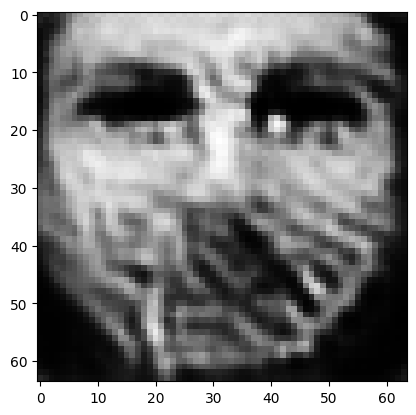

tensor([[3.2769e-04, 1.6509e-07, 1.9498e-05, 3.6972e-07, 9.1195e-06, 6.1284e-04,
         9.9297e-01, 1.0519e-03, 1.3542e-08, 2.4602e-06, 1.6039e-05, 4.7667e-07,
         1.4696e-06, 1.7823e-08, 4.9886e-07, 1.7915e-04, 7.2379e-04, 1.1666e-03,
         3.0079e-05, 2.0992e-03, 1.1659e-06, 2.8126e-07, 2.0818e-09, 1.7928e-04,
         6.1878e-06, 1.2453e-09, 3.7726e-05, 3.8666e-05, 2.0037e-04, 4.0829e-07,
         1.2063e-08, 5.7147e-06, 2.7548e-04, 1.0436e-05, 1.0924e-06, 8.0615e-07,
         1.2944e-06, 1.0492e-06, 1.9770e-05, 1.0477e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007056552451103926
tensor([[3.2762e-04, 1.6503e-07, 1.9491e-05, 3.6961e-07, 9.1158e-06, 6.1263e-04,
         9.9297e-01, 1.0516e-03, 1.3535e-08, 2.4594e-06, 1.6033e-05, 4.7645e-07,
         1.4690e-06, 1.7814e-08, 4.9871e-07, 1.7911e-04, 7.2361e-04, 1.1663e-03,
         3.0074e-05, 2.0986e-03, 1.1655e-06, 2.8114e-07, 2.0807e-09, 1.7924e-04,
         6.1848e-06, 1.2446e-09, 3.7712e-

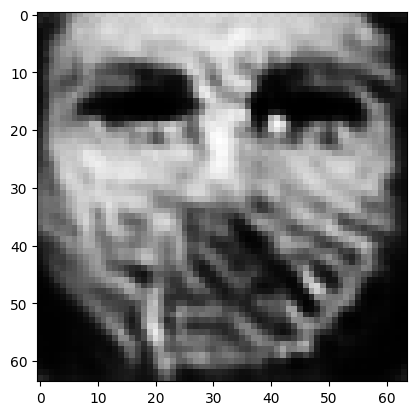

tensor([[3.2735e-04, 1.6480e-07, 1.9465e-05, 3.6919e-07, 9.1016e-06, 6.1187e-04,
         9.9298e-01, 1.0503e-03, 1.3509e-08, 2.4562e-06, 1.6013e-05, 4.7560e-07,
         1.4668e-06, 1.7779e-08, 4.9812e-07, 1.7898e-04, 7.2292e-04, 1.1650e-03,
         3.0058e-05, 2.0963e-03, 1.1640e-06, 2.8068e-07, 2.0767e-09, 1.7909e-04,
         6.1731e-06, 1.2421e-09, 3.7661e-05, 3.8614e-05, 2.0017e-04, 4.0758e-07,
         1.2035e-08, 5.7032e-06, 2.7488e-04, 1.0415e-05, 1.0908e-06, 8.0468e-07,
         1.2919e-06, 1.0470e-06, 1.9736e-05, 1.0459e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007046490907669067
tensor([[3.2728e-04, 1.6475e-07, 1.9458e-05, 3.6909e-07, 9.0981e-06, 6.1168e-04,
         9.9298e-01, 1.0500e-03, 1.3503e-08, 2.4554e-06, 1.6008e-05, 4.7540e-07,
         1.4662e-06, 1.7771e-08, 4.9797e-07, 1.7895e-04, 7.2275e-04, 1.1647e-03,
         3.0054e-05, 2.0957e-03, 1.1637e-06, 2.8056e-07, 2.0758e-09, 1.7905e-04,
         6.1702e-06, 1.2415e-09, 3.7649e-

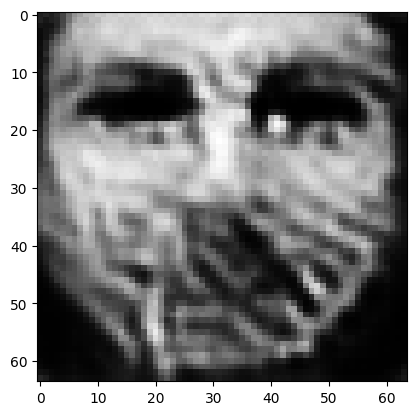

tensor([[3.2703e-04, 1.6454e-07, 1.9433e-05, 3.6869e-07, 9.0845e-06, 6.1094e-04,
         9.9299e-01, 1.0487e-03, 1.3478e-08, 2.4523e-06, 1.5988e-05, 4.7460e-07,
         1.4641e-06, 1.7738e-08, 4.9743e-07, 1.7883e-04, 7.2208e-04, 1.1635e-03,
         3.0039e-05, 2.0936e-03, 1.1623e-06, 2.8014e-07, 2.0719e-09, 1.7891e-04,
         6.1591e-06, 1.2390e-09, 3.7601e-05, 3.8565e-05, 1.9997e-04, 4.0690e-07,
         1.2008e-08, 5.6926e-06, 2.7432e-04, 1.0395e-05, 1.0893e-06, 8.0331e-07,
         1.2895e-06, 1.0449e-06, 1.9703e-05, 1.0442e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007037139497697353
tensor([[3.2697e-04, 1.6448e-07, 1.9426e-05, 3.6859e-07, 9.0812e-06, 6.1077e-04,
         9.9299e-01, 1.0484e-03, 1.3472e-08, 2.4516e-06, 1.5984e-05, 4.7441e-07,
         1.4636e-06, 1.7730e-08, 4.9730e-07, 1.7880e-04, 7.2191e-04, 1.1632e-03,
         3.0035e-05, 2.0931e-03, 1.1619e-06, 2.8003e-07, 2.0709e-09, 1.7887e-04,
         6.1564e-06, 1.2384e-09, 3.7590e-

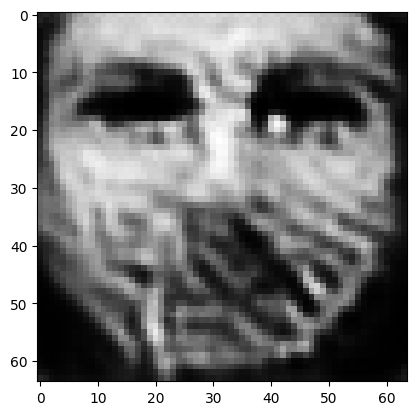

tensor([[3.2673e-04, 1.6428e-07, 1.9403e-05, 3.6820e-07, 9.0680e-06, 6.1009e-04,
         9.9300e-01, 1.0473e-03, 1.3447e-08, 2.4488e-06, 1.5966e-05, 4.7367e-07,
         1.4615e-06, 1.7698e-08, 4.9677e-07, 1.7869e-04, 7.2127e-04, 1.1620e-03,
         3.0020e-05, 2.0910e-03, 1.1606e-06, 2.7962e-07, 2.0671e-09, 1.7874e-04,
         6.1456e-06, 1.2362e-09, 3.7543e-05, 3.8519e-05, 1.9978e-04, 4.0625e-07,
         1.1983e-08, 5.6824e-06, 2.7378e-04, 1.0376e-05, 1.0878e-06, 8.0196e-07,
         1.2873e-06, 1.0429e-06, 1.9672e-05, 1.0425e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007028261199593544
tensor([[3.2667e-04, 1.6423e-07, 1.9397e-05, 3.6811e-07, 9.0648e-06, 6.0992e-04,
         9.9300e-01, 1.0470e-03, 1.3442e-08, 2.4481e-06, 1.5961e-05, 4.7349e-07,
         1.4611e-06, 1.7691e-08, 4.9664e-07, 1.7866e-04, 7.2111e-04, 1.1617e-03,
         3.0016e-05, 2.0905e-03, 1.1603e-06, 2.7952e-07, 2.0662e-09, 1.7870e-04,
         6.1431e-06, 1.2356e-09, 3.7532e-

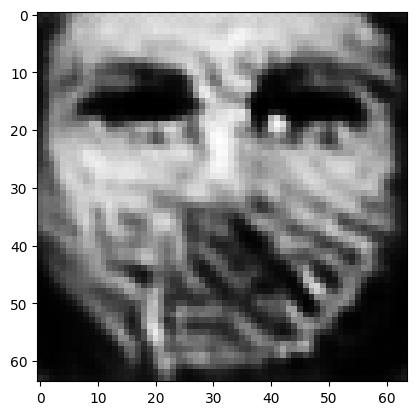

tensor([[3.2645e-04, 1.6404e-07, 1.9374e-05, 3.6775e-07, 9.0526e-06, 6.0926e-04,
         9.9300e-01, 1.0459e-03, 1.3419e-08, 2.4454e-06, 1.5944e-05, 4.7278e-07,
         1.4592e-06, 1.7661e-08, 4.9616e-07, 1.7855e-04, 7.2050e-04, 1.1606e-03,
         3.0003e-05, 2.0886e-03, 1.1590e-06, 2.7914e-07, 2.0627e-09, 1.7857e-04,
         6.1330e-06, 1.2334e-09, 3.7490e-05, 3.8475e-05, 1.9960e-04, 4.0564e-07,
         1.1958e-08, 5.6730e-06, 2.7327e-04, 1.0358e-05, 1.0864e-06, 8.0074e-07,
         1.2852e-06, 1.0410e-06, 1.9642e-05, 1.0410e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00701997522264719
tensor([[3.2640e-04, 1.6399e-07, 1.9368e-05, 3.6766e-07, 9.0495e-06, 6.0910e-04,
         9.9301e-01, 1.0457e-03, 1.3414e-08, 2.4447e-06, 1.5939e-05, 4.7260e-07,
         1.4587e-06, 1.7654e-08, 4.9604e-07, 1.7852e-04, 7.2035e-04, 1.1604e-03,
         3.0000e-05, 2.0881e-03, 1.1587e-06, 2.7904e-07, 2.0619e-09, 1.7854e-04,
         6.1306e-06, 1.2329e-09, 3.7479e-0

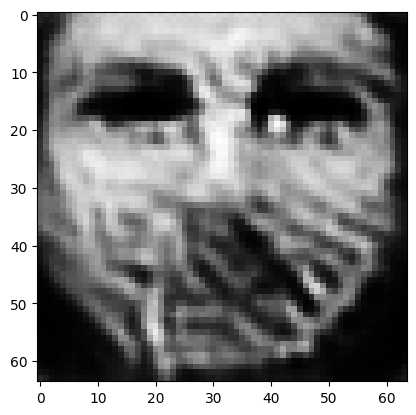

tensor([[3.2619e-04, 1.6381e-07, 1.9346e-05, 3.6732e-07, 9.0380e-06, 6.0847e-04,
         9.9301e-01, 1.0446e-03, 1.3392e-08, 2.4421e-06, 1.5923e-05, 4.7193e-07,
         1.4569e-06, 1.7626e-08, 4.9559e-07, 1.7842e-04, 7.1976e-04, 1.1593e-03,
         2.9986e-05, 2.0863e-03, 1.1575e-06, 2.7868e-07, 2.0586e-09, 1.7843e-04,
         6.1212e-06, 1.2308e-09, 3.7439e-05, 3.8433e-05, 1.9943e-04, 4.0506e-07,
         1.1935e-08, 5.6641e-06, 2.7279e-04, 1.0341e-05, 1.0851e-06, 7.9958e-07,
         1.2831e-06, 1.0392e-06, 1.9614e-05, 1.0395e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007012044079601765
tensor([[3.2614e-04, 1.6377e-07, 1.9341e-05, 3.6724e-07, 9.0351e-06, 6.0832e-04,
         9.9301e-01, 1.0443e-03, 1.3387e-08, 2.4415e-06, 1.5919e-05, 4.7177e-07,
         1.4565e-06, 1.7619e-08, 4.9548e-07, 1.7840e-04, 7.1961e-04, 1.1591e-03,
         2.9983e-05, 2.0859e-03, 1.1572e-06, 2.7859e-07, 2.0578e-09, 1.7840e-04,
         6.1189e-06, 1.2303e-09, 3.7429e-

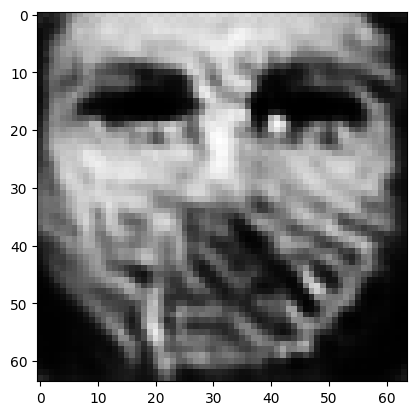

tensor([[3.2594e-04, 1.6359e-07, 1.9320e-05, 3.6691e-07, 9.0238e-06, 6.0774e-04,
         9.9302e-01, 1.0434e-03, 1.3366e-08, 2.4391e-06, 1.5903e-05, 4.7113e-07,
         1.4547e-06, 1.7592e-08, 4.9503e-07, 1.7830e-04, 7.1906e-04, 1.1581e-03,
         2.9970e-05, 2.0841e-03, 1.1561e-06, 2.7825e-07, 2.0545e-09, 1.7828e-04,
         6.1097e-06, 1.2283e-09, 3.7389e-05, 3.8393e-05, 1.9926e-04, 4.0451e-07,
         1.1913e-08, 5.6555e-06, 2.7232e-04, 1.0324e-05, 1.0839e-06, 7.9844e-07,
         1.2812e-06, 1.0375e-06, 1.9587e-05, 1.0380e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007004349492490292
tensor([[3.2589e-04, 1.6355e-07, 1.9315e-05, 3.6683e-07, 9.0211e-06, 6.0760e-04,
         9.9302e-01, 1.0431e-03, 1.3361e-08, 2.4385e-06, 1.5899e-05, 4.7098e-07,
         1.4543e-06, 1.7586e-08, 4.9492e-07, 1.7828e-04, 7.1893e-04, 1.1579e-03,
         2.9967e-05, 2.0837e-03, 1.1558e-06, 2.7816e-07, 2.0537e-09, 1.7826e-04,
         6.1075e-06, 1.2278e-09, 3.7380e-

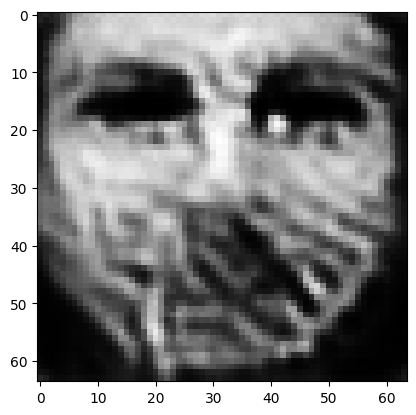

tensor([[3.2570e-04, 1.6338e-07, 1.9296e-05, 3.6652e-07, 9.0106e-06, 6.0703e-04,
         9.9303e-01, 1.0422e-03, 1.3342e-08, 2.4362e-06, 1.5884e-05, 4.7037e-07,
         1.4527e-06, 1.7560e-08, 4.9452e-07, 1.7819e-04, 7.1839e-04, 1.1570e-03,
         2.9955e-05, 2.0820e-03, 1.1547e-06, 2.7784e-07, 2.0508e-09, 1.7815e-04,
         6.0990e-06, 1.2260e-09, 3.7343e-05, 3.8355e-05, 1.9911e-04, 4.0399e-07,
         1.1893e-08, 5.6475e-06, 2.7189e-04, 1.0309e-05, 1.0827e-06, 7.9741e-07,
         1.2794e-06, 1.0359e-06, 1.9561e-05, 1.0366e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006997246760874987
tensor([[3.2565e-04, 1.6334e-07, 1.9291e-05, 3.6645e-07, 9.0081e-06, 6.0689e-04,
         9.9303e-01, 1.0419e-03, 1.3337e-08, 2.4356e-06, 1.5881e-05, 4.7023e-07,
         1.4523e-06, 1.7554e-08, 4.9442e-07, 1.7817e-04, 7.1826e-04, 1.1567e-03,
         2.9952e-05, 2.0816e-03, 1.1545e-06, 2.7776e-07, 2.0500e-09, 1.7812e-04,
         6.0969e-06, 1.2255e-09, 3.7334e-

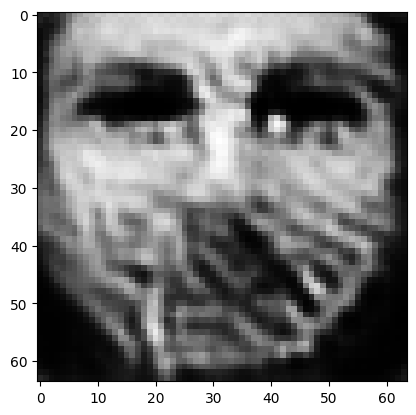

tensor([[3.2548e-04, 1.6319e-07, 1.9273e-05, 3.6615e-07, 8.9979e-06, 6.0637e-04,
         9.9303e-01, 1.0411e-03, 1.3318e-08, 2.4335e-06, 1.5867e-05, 4.6966e-07,
         1.4507e-06, 1.7530e-08, 4.9402e-07, 1.7808e-04, 7.1777e-04, 1.1558e-03,
         2.9941e-05, 2.0801e-03, 1.1534e-06, 2.7745e-07, 2.0471e-09, 1.7802e-04,
         6.0887e-06, 1.2238e-09, 3.7299e-05, 3.8319e-05, 1.9896e-04, 4.0349e-07,
         1.1873e-08, 5.6398e-06, 2.7147e-04, 1.0294e-05, 1.0816e-06, 7.9638e-07,
         1.2777e-06, 1.0343e-06, 1.9537e-05, 1.0354e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0069904993288218975
tensor([[3.2543e-04, 1.6315e-07, 1.9268e-05, 3.6608e-07, 8.9955e-06, 6.0623e-04,
         9.9304e-01, 1.0409e-03, 1.3314e-08, 2.4329e-06, 1.5863e-05, 4.6952e-07,
         1.4503e-06, 1.7524e-08, 4.9393e-07, 1.7806e-04, 7.1765e-04, 1.1556e-03,
         2.9938e-05, 2.0797e-03, 1.1532e-06, 2.7737e-07, 2.0464e-09, 1.7800e-04,
         6.0867e-06, 1.2233e-09, 3.7290e

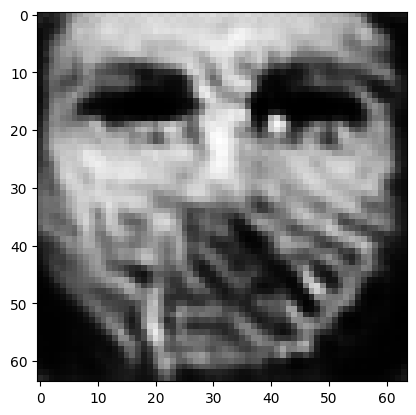

tensor([[3.2526e-04, 1.6300e-07, 1.9250e-05, 3.6580e-07, 8.9862e-06, 6.0572e-04,
         9.9304e-01, 1.0400e-03, 1.3297e-08, 2.4308e-06, 1.5850e-05, 4.6897e-07,
         1.4489e-06, 1.7502e-08, 4.9357e-07, 1.7798e-04, 7.1717e-04, 1.1548e-03,
         2.9927e-05, 2.0782e-03, 1.1522e-06, 2.7708e-07, 2.0438e-09, 1.7790e-04,
         6.0791e-06, 1.2216e-09, 3.7258e-05, 3.8285e-05, 1.9882e-04, 4.0302e-07,
         1.1854e-08, 5.6326e-06, 2.7109e-04, 1.0280e-05, 1.0805e-06, 7.9546e-07,
         1.2760e-06, 1.0329e-06, 1.9514e-05, 1.0341e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006983988452702761
tensor([[3.2522e-04, 1.6297e-07, 1.9245e-05, 3.6573e-07, 8.9839e-06, 6.0559e-04,
         9.9304e-01, 1.0398e-03, 1.3293e-08, 2.4303e-06, 1.5847e-05, 4.6884e-07,
         1.4485e-06, 1.7496e-08, 4.9348e-07, 1.7796e-04, 7.1705e-04, 1.1546e-03,
         2.9925e-05, 2.0779e-03, 1.1520e-06, 2.7701e-07, 2.0431e-09, 1.7788e-04,
         6.0773e-06, 1.2212e-09, 3.7249e-

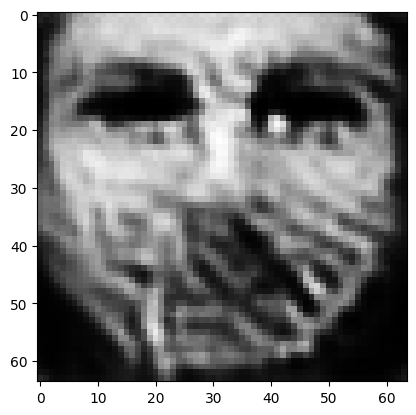

tensor([[3.2505e-04, 1.6283e-07, 1.9228e-05, 3.6547e-07, 8.9748e-06, 6.0511e-04,
         9.9305e-01, 1.0390e-03, 1.3276e-08, 2.4283e-06, 1.5834e-05, 4.6831e-07,
         1.4471e-06, 1.7475e-08, 4.9312e-07, 1.7788e-04, 7.1659e-04, 1.1538e-03,
         2.9914e-05, 2.0764e-03, 1.1511e-06, 2.7673e-07, 2.0405e-09, 1.7778e-04,
         6.0699e-06, 1.2196e-09, 3.7218e-05, 3.8252e-05, 1.9869e-04, 4.0257e-07,
         1.1837e-08, 5.6258e-06, 2.7071e-04, 1.0267e-05, 1.0795e-06, 7.9456e-07,
         1.2745e-06, 1.0315e-06, 1.9492e-05, 1.0329e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006977951154112816
tensor([[3.2502e-04, 1.6279e-07, 1.9224e-05, 3.6540e-07, 8.9727e-06, 6.0499e-04,
         9.9305e-01, 1.0388e-03, 1.3272e-08, 2.4278e-06, 1.5831e-05, 4.6819e-07,
         1.4468e-06, 1.7470e-08, 4.9305e-07, 1.7786e-04, 7.1648e-04, 1.1536e-03,
         2.9912e-05, 2.0761e-03, 1.1508e-06, 2.7666e-07, 2.0399e-09, 1.7776e-04,
         6.0682e-06, 1.2192e-09, 3.7210e-

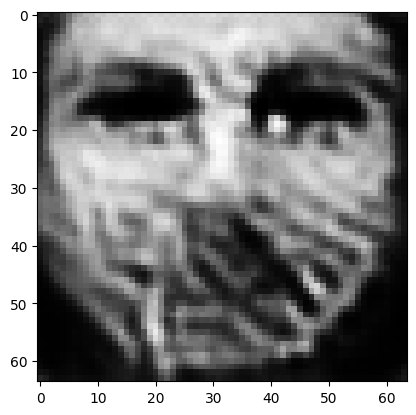

tensor([[3.2486e-04, 1.6266e-07, 1.9208e-05, 3.6514e-07, 8.9640e-06, 6.0454e-04,
         9.9305e-01, 1.0380e-03, 1.3256e-08, 2.4260e-06, 1.5819e-05, 4.6770e-07,
         1.4454e-06, 1.7449e-08, 4.9270e-07, 1.7778e-04, 7.1605e-04, 1.1529e-03,
         2.9902e-05, 2.0748e-03, 1.1499e-06, 2.7640e-07, 2.0374e-09, 1.7768e-04,
         6.0612e-06, 1.2177e-09, 3.7179e-05, 3.8222e-05, 1.9856e-04, 4.0215e-07,
         1.1820e-08, 5.6192e-06, 2.7036e-04, 1.0254e-05, 1.0785e-06, 7.9369e-07,
         1.2730e-06, 1.0302e-06, 1.9471e-05, 1.0318e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006972150411456823
tensor([[3.2483e-04, 1.6263e-07, 1.9204e-05, 3.6508e-07, 8.9619e-06, 6.0442e-04,
         9.9305e-01, 1.0379e-03, 1.3252e-08, 2.4255e-06, 1.5816e-05, 4.6758e-07,
         1.4451e-06, 1.7444e-08, 4.9262e-07, 1.7777e-04, 7.1595e-04, 1.1527e-03,
         2.9900e-05, 2.0744e-03, 1.1497e-06, 2.7634e-07, 2.0368e-09, 1.7766e-04,
         6.0595e-06, 1.2174e-09, 3.7172e-

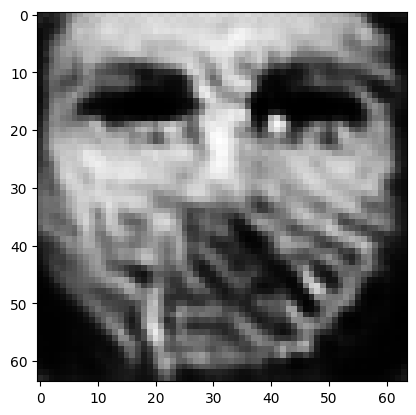

tensor([[3.2468e-04, 1.6250e-07, 1.9189e-05, 3.6484e-07, 8.9538e-06, 6.0399e-04,
         9.9306e-01, 1.0371e-03, 1.3237e-08, 2.4237e-06, 1.5804e-05, 4.6711e-07,
         1.4438e-06, 1.7424e-08, 4.9230e-07, 1.7769e-04, 7.1554e-04, 1.1520e-03,
         2.9890e-05, 2.0732e-03, 1.1489e-06, 2.7608e-07, 2.0345e-09, 1.7757e-04,
         6.0529e-06, 1.2159e-09, 3.7144e-05, 3.8193e-05, 1.9844e-04, 4.0175e-07,
         1.1804e-08, 5.6130e-06, 2.7002e-04, 1.0242e-05, 1.0776e-06, 7.9288e-07,
         1.2716e-06, 1.0289e-06, 1.9452e-05, 1.0308e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0069665866903960705
tensor([[3.2464e-04, 1.6247e-07, 1.9185e-05, 3.6478e-07, 8.9519e-06, 6.0388e-04,
         9.9306e-01, 1.0370e-03, 1.3234e-08, 2.4233e-06, 1.5801e-05, 4.6699e-07,
         1.4435e-06, 1.7420e-08, 4.9222e-07, 1.7768e-04, 7.1543e-04, 1.1518e-03,
         2.9888e-05, 2.0729e-03, 1.1487e-06, 2.7602e-07, 2.0340e-09, 1.7755e-04,
         6.0513e-06, 1.2156e-09, 3.7137e

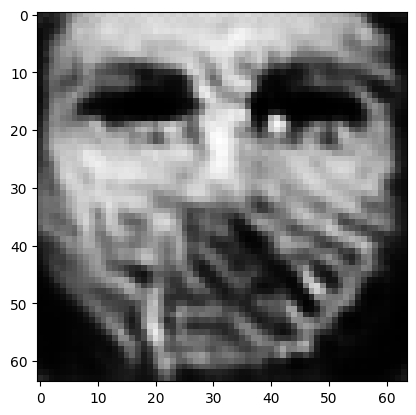

tensor([[3.2451e-04, 1.6235e-07, 1.9171e-05, 3.6455e-07, 8.9440e-06, 6.0348e-04,
         9.9306e-01, 1.0363e-03, 1.3220e-08, 2.4216e-06, 1.5790e-05, 4.6655e-07,
         1.4423e-06, 1.7401e-08, 4.9192e-07, 1.7761e-04, 7.1505e-04, 1.1511e-03,
         2.9879e-05, 2.0717e-03, 1.1479e-06, 2.7578e-07, 2.0317e-09, 1.7748e-04,
         6.0450e-06, 1.2142e-09, 3.7109e-05, 3.8165e-05, 1.9833e-04, 4.0136e-07,
         1.1789e-08, 5.6070e-06, 2.6970e-04, 1.0231e-05, 1.0767e-06, 7.9210e-07,
         1.2703e-06, 1.0277e-06, 1.9433e-05, 1.0298e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006961259059607983
tensor([[3.2447e-04, 1.6232e-07, 1.9168e-05, 3.6450e-07, 8.9422e-06, 6.0337e-04,
         9.9306e-01, 1.0361e-03, 1.3216e-08, 2.4212e-06, 1.5788e-05, 4.6644e-07,
         1.4420e-06, 1.7396e-08, 4.9184e-07, 1.7759e-04, 7.1495e-04, 1.1509e-03,
         2.9877e-05, 2.0714e-03, 1.1477e-06, 2.7573e-07, 2.0312e-09, 1.7746e-04,
         6.0435e-06, 1.2139e-09, 3.7103e-

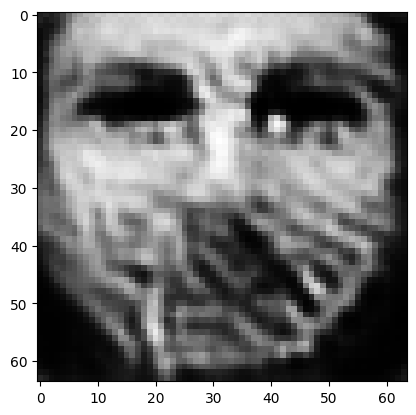

tensor([[3.2434e-04, 1.6220e-07, 1.9154e-05, 3.6428e-07, 8.9349e-06, 6.0298e-04,
         9.9307e-01, 1.0355e-03, 1.3203e-08, 2.4196e-06, 1.5777e-05, 4.6602e-07,
         1.4409e-06, 1.7379e-08, 4.9156e-07, 1.7753e-04, 7.1458e-04, 1.1503e-03,
         2.9869e-05, 2.0702e-03, 1.1469e-06, 2.7550e-07, 2.0291e-09, 1.7738e-04,
         6.0376e-06, 1.2126e-09, 3.7077e-05, 3.8139e-05, 1.9821e-04, 4.0100e-07,
         1.1775e-08, 5.6015e-06, 2.6940e-04, 1.0220e-05, 1.0759e-06, 7.9138e-07,
         1.2690e-06, 1.0266e-06, 1.9416e-05, 1.0288e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006956405472010374
tensor([[3.2431e-04, 1.6218e-07, 1.9151e-05, 3.6423e-07, 8.9332e-06, 6.0289e-04,
         9.9307e-01, 1.0353e-03, 1.3200e-08, 2.4192e-06, 1.5775e-05, 4.6592e-07,
         1.4406e-06, 1.7375e-08, 4.9149e-07, 1.7751e-04, 7.1449e-04, 1.1501e-03,
         2.9867e-05, 2.0700e-03, 1.1468e-06, 2.7545e-07, 2.0286e-09, 1.7736e-04,
         6.0362e-06, 1.2123e-09, 3.7071e-

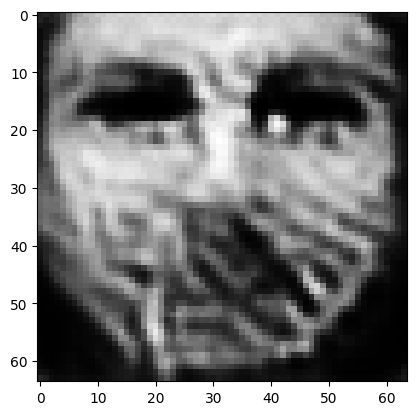

tensor([[3.2418e-04, 1.6207e-07, 1.9138e-05, 3.6402e-07, 8.9262e-06, 6.0252e-04,
         9.9307e-01, 1.0347e-03, 1.3187e-08, 2.4177e-06, 1.5765e-05, 4.6553e-07,
         1.4395e-06, 1.7358e-08, 4.9121e-07, 1.7745e-04, 7.1414e-04, 1.1495e-03,
         2.9858e-05, 2.0689e-03, 1.1460e-06, 2.7523e-07, 2.0266e-09, 1.7729e-04,
         6.0306e-06, 1.2111e-09, 3.7046e-05, 3.8114e-05, 1.9811e-04, 4.0066e-07,
         1.1761e-08, 5.5961e-06, 2.6912e-04, 1.0210e-05, 1.0751e-06, 7.9067e-07,
         1.2678e-06, 1.0255e-06, 1.9399e-05, 1.0279e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006951788440346718
tensor([[3.2415e-04, 1.6204e-07, 1.9135e-05, 3.6397e-07, 8.9246e-06, 6.0243e-04,
         9.9307e-01, 1.0346e-03, 1.3184e-08, 2.4173e-06, 1.5763e-05, 4.6543e-07,
         1.4393e-06, 1.7354e-08, 4.9114e-07, 1.7744e-04, 7.1406e-04, 1.1493e-03,
         2.9857e-05, 2.0686e-03, 1.1459e-06, 2.7518e-07, 2.0261e-09, 1.7728e-04,
         6.0293e-06, 1.2108e-09, 3.7040e-

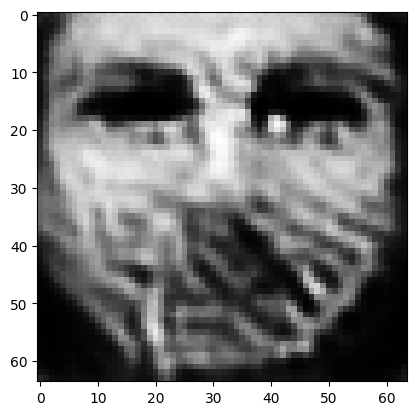

tensor([[3.2403e-04, 1.6194e-07, 1.9122e-05, 3.6378e-07, 8.9181e-06, 6.0208e-04,
         9.9308e-01, 1.0340e-03, 1.3172e-08, 2.4159e-06, 1.5753e-05, 4.6505e-07,
         1.4383e-06, 1.7338e-08, 4.9089e-07, 1.7738e-04, 7.1372e-04, 1.1488e-03,
         2.9849e-05, 2.0676e-03, 1.1452e-06, 2.7498e-07, 2.0243e-09, 1.7721e-04,
         6.0240e-06, 1.2097e-09, 3.7018e-05, 3.8091e-05, 1.9802e-04, 4.0033e-07,
         1.1748e-08, 5.5911e-06, 2.6885e-04, 1.0200e-05, 1.0744e-06, 7.9002e-07,
         1.2667e-06, 1.0245e-06, 1.9383e-05, 1.0271e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006947290152311325
tensor([[3.2400e-04, 1.6191e-07, 1.9119e-05, 3.6373e-07, 8.9164e-06, 6.0200e-04,
         9.9308e-01, 1.0338e-03, 1.3169e-08, 2.4156e-06, 1.5751e-05, 4.6496e-07,
         1.4380e-06, 1.7335e-08, 4.9082e-07, 1.7736e-04, 7.1364e-04, 1.1486e-03,
         2.9847e-05, 2.0673e-03, 1.1450e-06, 2.7493e-07, 2.0238e-09, 1.7719e-04,
         6.0227e-06, 1.2094e-09, 3.7012e-

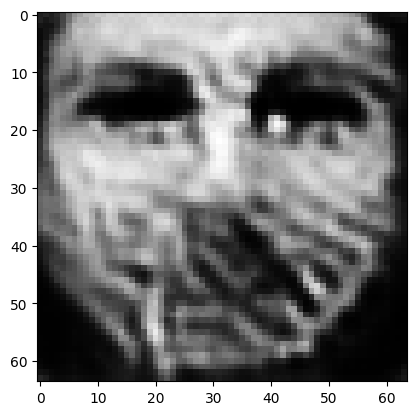

tensor([[3.2389e-04, 1.6182e-07, 1.9107e-05, 3.6355e-07, 8.9102e-06, 6.0166e-04,
         9.9308e-01, 1.0333e-03, 1.3158e-08, 2.4142e-06, 1.5742e-05, 4.6460e-07,
         1.4371e-06, 1.7320e-08, 4.9058e-07, 1.7731e-04, 7.1332e-04, 1.1481e-03,
         2.9840e-05, 2.0664e-03, 1.1444e-06, 2.7473e-07, 2.0221e-09, 1.7713e-04,
         6.0177e-06, 1.2083e-09, 3.6990e-05, 3.8068e-05, 1.9792e-04, 4.0002e-07,
         1.1736e-08, 5.5864e-06, 2.6859e-04, 1.0191e-05, 1.0736e-06, 7.8940e-07,
         1.2656e-06, 1.0235e-06, 1.9368e-05, 1.0263e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006943028420209885
tensor([[3.2386e-04, 1.6179e-07, 1.9105e-05, 3.6350e-07, 8.9086e-06, 6.0158e-04,
         9.9308e-01, 1.0332e-03, 1.3155e-08, 2.4139e-06, 1.5740e-05, 4.6452e-07,
         1.4368e-06, 1.7316e-08, 4.9051e-07, 1.7730e-04, 7.1325e-04, 1.1479e-03,
         2.9838e-05, 2.0661e-03, 1.1442e-06, 2.7469e-07, 2.0216e-09, 1.7712e-04,
         6.0164e-06, 1.2080e-09, 3.6984e-

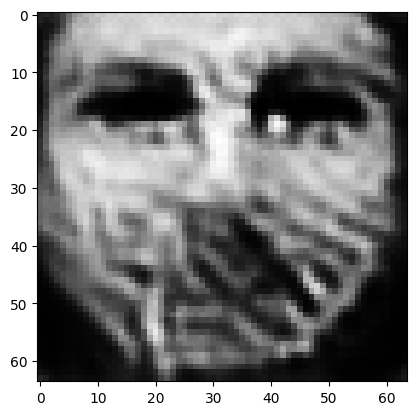

tensor([[3.2376e-04, 1.6170e-07, 1.9094e-05, 3.6333e-07, 8.9028e-06, 6.0127e-04,
         9.9309e-01, 1.0326e-03, 1.3144e-08, 2.4126e-06, 1.5732e-05, 4.6417e-07,
         1.4359e-06, 1.7302e-08, 4.9028e-07, 1.7724e-04, 7.1295e-04, 1.1474e-03,
         2.9831e-05, 2.0652e-03, 1.1436e-06, 2.7450e-07, 2.0199e-09, 1.7705e-04,
         6.0116e-06, 1.2070e-09, 3.6964e-05, 3.8047e-05, 1.9783e-04, 3.9973e-07,
         1.1725e-08, 5.5818e-06, 2.6834e-04, 1.0182e-05, 1.0730e-06, 7.8879e-07,
         1.2646e-06, 1.0226e-06, 1.9354e-05, 1.0255e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006938766222447157
tensor([[3.2373e-04, 1.6168e-07, 1.9091e-05, 3.6328e-07, 8.9014e-06, 6.0119e-04,
         9.9309e-01, 1.0325e-03, 1.3141e-08, 2.4123e-06, 1.5730e-05, 4.6409e-07,
         1.4357e-06, 1.7298e-08, 4.9023e-07, 1.7723e-04, 7.1287e-04, 1.1473e-03,
         2.9830e-05, 2.0650e-03, 1.1435e-06, 2.7446e-07, 2.0195e-09, 1.7704e-04,
         6.0105e-06, 1.2067e-09, 3.6959e-

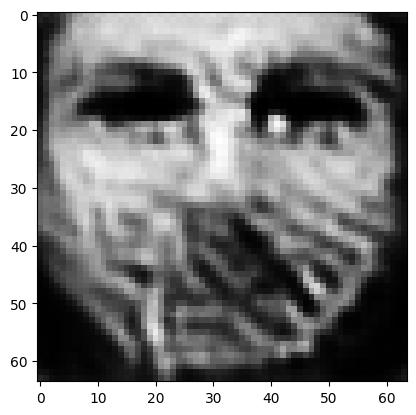

tensor([[3.2363e-04, 1.6159e-07, 1.9081e-05, 3.6312e-07, 8.8959e-06, 6.0089e-04,
         9.9309e-01, 1.0320e-03, 1.3131e-08, 2.4110e-06, 1.5722e-05, 4.6377e-07,
         1.4348e-06, 1.7285e-08, 4.9001e-07, 1.7718e-04, 7.1259e-04, 1.1468e-03,
         2.9823e-05, 2.0641e-03, 1.1429e-06, 2.7429e-07, 2.0180e-09, 1.7698e-04,
         6.0060e-06, 1.2057e-09, 3.6939e-05, 3.8027e-05, 1.9775e-04, 3.9945e-07,
         1.1714e-08, 5.5775e-06, 2.6811e-04, 1.0174e-05, 1.0723e-06, 7.8824e-07,
         1.2637e-06, 1.0218e-06, 1.9340e-05, 1.0248e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006935096345841885
tensor([[3.2361e-04, 1.6157e-07, 1.9078e-05, 3.6308e-07, 8.8944e-06, 6.0082e-04,
         9.9309e-01, 1.0319e-03, 1.3128e-08, 2.4108e-06, 1.5720e-05, 4.6369e-07,
         1.4346e-06, 1.7282e-08, 4.8994e-07, 1.7717e-04, 7.1253e-04, 1.1466e-03,
         2.9821e-05, 2.0639e-03, 1.1428e-06, 2.7424e-07, 2.0175e-09, 1.7697e-04,
         6.0048e-06, 1.2055e-09, 3.6934e-

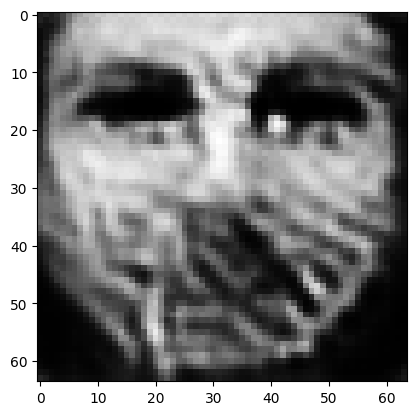

tensor([[3.2351e-04, 1.6148e-07, 1.9068e-05, 3.6292e-07, 8.8892e-06, 6.0054e-04,
         9.9309e-01, 1.0314e-03, 1.3119e-08, 2.4096e-06, 1.5712e-05, 4.6339e-07,
         1.4338e-06, 1.7269e-08, 4.8973e-07, 1.7712e-04, 7.1225e-04, 1.1462e-03,
         2.9815e-05, 2.0630e-03, 1.1422e-06, 2.7408e-07, 2.0160e-09, 1.7692e-04,
         6.0006e-06, 1.2046e-09, 3.6915e-05, 3.8008e-05, 1.9767e-04, 3.9918e-07,
         1.1703e-08, 5.5733e-06, 2.6789e-04, 1.0166e-05, 1.0717e-06, 7.8769e-07,
         1.2627e-06, 1.0209e-06, 1.9327e-05, 1.0241e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0069315447472035885
tensor([[3.2349e-04, 1.6147e-07, 1.9066e-05, 3.6288e-07, 8.8880e-06, 6.0047e-04,
         9.9309e-01, 1.0313e-03, 1.3116e-08, 2.4093e-06, 1.5710e-05, 4.6332e-07,
         1.4336e-06, 1.7266e-08, 4.8968e-07, 1.7711e-04, 7.1219e-04, 1.1461e-03,
         2.9814e-05, 2.0628e-03, 1.1421e-06, 2.7404e-07, 2.0157e-09, 1.7690e-04,
         5.9996e-06, 1.2044e-09, 3.6911e

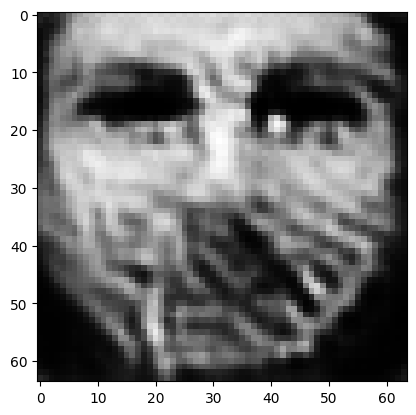

tensor([[3.2339e-04, 1.6139e-07, 1.9056e-05, 3.6273e-07, 8.8829e-06, 6.0020e-04,
         9.9310e-01, 1.0309e-03, 1.3107e-08, 2.4082e-06, 1.5703e-05, 4.6303e-07,
         1.4328e-06, 1.7254e-08, 4.8948e-07, 1.7707e-04, 7.1193e-04, 1.1456e-03,
         2.9808e-05, 2.0620e-03, 1.1416e-06, 2.7388e-07, 2.0142e-09, 1.7685e-04,
         5.9955e-06, 1.2035e-09, 3.6893e-05, 3.7990e-05, 1.9759e-04, 3.9893e-07,
         1.1693e-08, 5.5695e-06, 2.6768e-04, 1.0159e-05, 1.0712e-06, 7.8719e-07,
         1.2619e-06, 1.0202e-06, 1.9315e-05, 1.0234e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006928111892193556
tensor([[3.2337e-04, 1.6137e-07, 1.9054e-05, 3.6269e-07, 8.8817e-06, 6.0013e-04,
         9.9310e-01, 1.0308e-03, 1.3105e-08, 2.4079e-06, 1.5701e-05, 4.6295e-07,
         1.4326e-06, 1.7251e-08, 4.8943e-07, 1.7706e-04, 7.1187e-04, 1.1455e-03,
         2.9806e-05, 2.0618e-03, 1.1414e-06, 2.7385e-07, 2.0139e-09, 1.7684e-04,
         5.9945e-06, 1.2032e-09, 3.6889e-

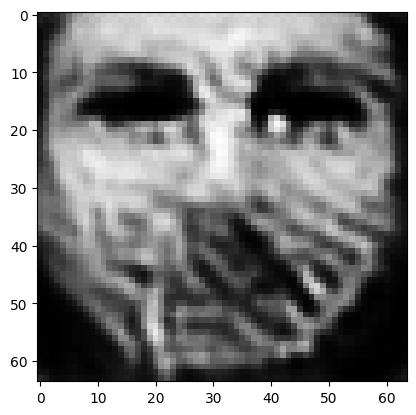

tensor([[3.2329e-04, 1.6129e-07, 1.9045e-05, 3.6255e-07, 8.8769e-06, 5.9988e-04,
         9.9310e-01, 1.0303e-03, 1.3096e-08, 2.4069e-06, 1.5695e-05, 4.6268e-07,
         1.4318e-06, 1.7239e-08, 4.8924e-07, 1.7701e-04, 7.1163e-04, 1.1451e-03,
         2.9801e-05, 2.0610e-03, 1.1409e-06, 2.7370e-07, 2.0125e-09, 1.7679e-04,
         5.9906e-06, 1.2024e-09, 3.6872e-05, 3.7973e-05, 1.9752e-04, 3.9869e-07,
         1.1684e-08, 5.5657e-06, 2.6748e-04, 1.0152e-05, 1.0706e-06, 7.8670e-07,
         1.2611e-06, 1.0194e-06, 1.9303e-05, 1.0228e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006924796849489212
tensor([[3.2327e-04, 1.6127e-07, 1.9043e-05, 3.6252e-07, 8.8758e-06, 5.9982e-04,
         9.9310e-01, 1.0302e-03, 1.3094e-08, 2.4066e-06, 1.5693e-05, 4.6261e-07,
         1.4317e-06, 1.7237e-08, 4.8919e-07, 1.7700e-04, 7.1157e-04, 1.1450e-03,
         2.9799e-05, 2.0609e-03, 1.1408e-06, 2.7366e-07, 2.0122e-09, 1.7678e-04,
         5.9897e-06, 1.2022e-09, 3.6868e-

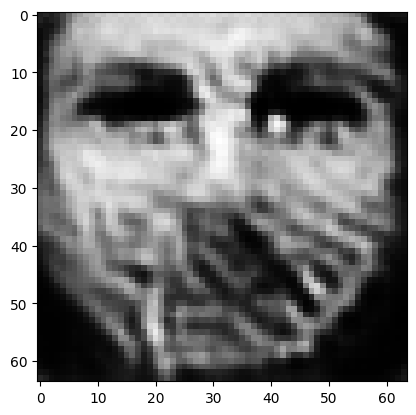

tensor([[3.2319e-04, 1.6120e-07, 1.9035e-05, 3.6239e-07, 8.8713e-06, 5.9957e-04,
         9.9310e-01, 1.0298e-03, 1.3086e-08, 2.4056e-06, 1.5686e-05, 4.6235e-07,
         1.4310e-06, 1.7226e-08, 4.8901e-07, 1.7696e-04, 7.1135e-04, 1.1446e-03,
         2.9794e-05, 2.0601e-03, 1.1403e-06, 2.7352e-07, 2.0109e-09, 1.7673e-04,
         5.9861e-06, 1.2014e-09, 3.6852e-05, 3.7956e-05, 1.9746e-04, 3.9846e-07,
         1.1675e-08, 5.5622e-06, 2.6730e-04, 1.0145e-05, 1.0701e-06, 7.8624e-07,
         1.2603e-06, 1.0187e-06, 1.9292e-05, 1.0222e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006921600550413132
tensor([[3.2316e-04, 1.6118e-07, 1.9033e-05, 3.6235e-07, 8.8701e-06, 5.9952e-04,
         9.9310e-01, 1.0297e-03, 1.3084e-08, 2.4054e-06, 1.5685e-05, 4.6229e-07,
         1.4308e-06, 1.7223e-08, 4.8896e-07, 1.7695e-04, 7.1130e-04, 1.1445e-03,
         2.9792e-05, 2.0599e-03, 1.1402e-06, 2.7348e-07, 2.0106e-09, 1.7672e-04,
         5.9852e-06, 1.2012e-09, 3.6847e-

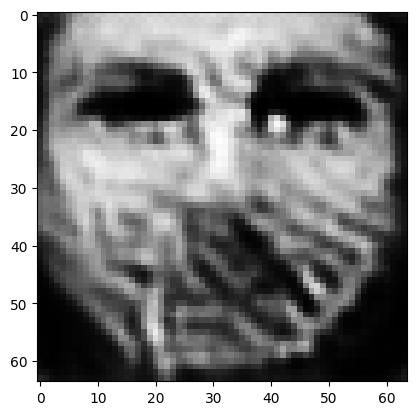

tensor([[3.2309e-04, 1.6111e-07, 1.9025e-05, 3.6222e-07, 8.8659e-06, 5.9929e-04,
         9.9311e-01, 1.0294e-03, 1.3076e-08, 2.4044e-06, 1.5679e-05, 4.6204e-07,
         1.4301e-06, 1.7213e-08, 4.8879e-07, 1.7691e-04, 7.1108e-04, 1.1441e-03,
         2.9787e-05, 2.0593e-03, 1.1398e-06, 2.7335e-07, 2.0094e-09, 1.7668e-04,
         5.9817e-06, 1.2005e-09, 3.6832e-05, 3.7941e-05, 1.9739e-04, 3.9825e-07,
         1.1667e-08, 5.5588e-06, 2.6712e-04, 1.0139e-05, 1.0696e-06, 7.8580e-07,
         1.2595e-06, 1.0181e-06, 1.9282e-05, 1.0217e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00691875908523798
tensor([[3.2307e-04, 1.6110e-07, 1.9023e-05, 3.6219e-07, 8.8648e-06, 5.9923e-04,
         9.9311e-01, 1.0293e-03, 1.3074e-08, 2.4042e-06, 1.5677e-05, 4.6198e-07,
         1.4300e-06, 1.7210e-08, 4.8875e-07, 1.7691e-04, 7.1102e-04, 1.1440e-03,
         2.9786e-05, 2.0591e-03, 1.1397e-06, 2.7332e-07, 2.0091e-09, 1.7667e-04,
         5.9809e-06, 1.2003e-09, 3.6828e-0

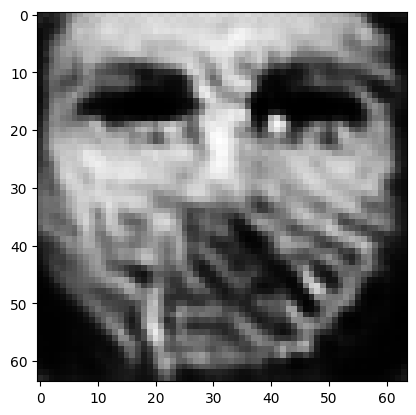

tensor([[3.2299e-04, 1.6103e-07, 1.9015e-05, 3.6207e-07, 8.8608e-06, 5.9902e-04,
         9.9311e-01, 1.0289e-03, 1.3067e-08, 2.4033e-06, 1.5671e-05, 4.6175e-07,
         1.4293e-06, 1.7201e-08, 4.8858e-07, 1.7687e-04, 7.1082e-04, 1.1436e-03,
         2.9781e-05, 2.0584e-03, 1.1393e-06, 2.7319e-07, 2.0079e-09, 1.7663e-04,
         5.9776e-06, 1.1996e-09, 3.6814e-05, 3.7926e-05, 1.9733e-04, 3.9804e-07,
         1.1659e-08, 5.5557e-06, 2.6695e-04, 1.0133e-05, 1.0692e-06, 7.8539e-07,
         1.2588e-06, 1.0174e-06, 1.9272e-05, 1.0212e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0069160363636910915
tensor([[3.2298e-04, 1.6101e-07, 1.9014e-05, 3.6204e-07, 8.8597e-06, 5.9897e-04,
         9.9311e-01, 1.0288e-03, 1.3064e-08, 2.4031e-06, 1.5670e-05, 4.6169e-07,
         1.4291e-06, 1.7198e-08, 4.8853e-07, 1.7686e-04, 7.1077e-04, 1.1435e-03,
         2.9780e-05, 2.0583e-03, 1.1391e-06, 2.7316e-07, 2.0076e-09, 1.7662e-04,
         5.9768e-06, 1.1994e-09, 3.6810e

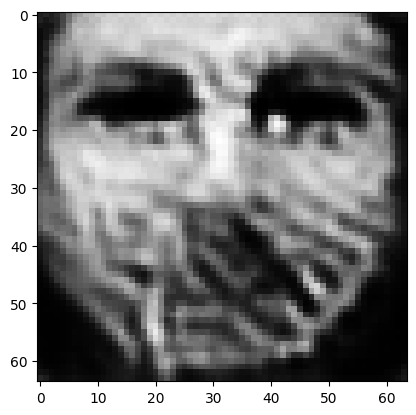

tensor([[3.2291e-04, 1.6096e-07, 1.9006e-05, 3.6193e-07, 8.8560e-06, 5.9876e-04,
         9.9311e-01, 1.0285e-03, 1.3058e-08, 2.4022e-06, 1.5665e-05, 4.6147e-07,
         1.4286e-06, 1.7189e-08, 4.8838e-07, 1.7683e-04, 7.1058e-04, 1.1432e-03,
         2.9775e-05, 2.0576e-03, 1.1388e-06, 2.7304e-07, 2.0065e-09, 1.7658e-04,
         5.9737e-06, 1.1987e-09, 3.6797e-05, 3.7913e-05, 1.9727e-04, 3.9785e-07,
         1.1651e-08, 5.5527e-06, 2.6679e-04, 1.0127e-05, 1.0687e-06, 7.8499e-07,
         1.2582e-06, 1.0168e-06, 1.9263e-05, 1.0207e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00691319489851594
tensor([[3.2289e-04, 1.6094e-07, 1.9005e-05, 3.6190e-07, 8.8550e-06, 5.9872e-04,
         9.9311e-01, 1.0284e-03, 1.3056e-08, 2.4020e-06, 1.5663e-05, 4.6141e-07,
         1.4284e-06, 1.7186e-08, 4.8834e-07, 1.7682e-04, 7.1053e-04, 1.1431e-03,
         2.9774e-05, 2.0575e-03, 1.1387e-06, 2.7301e-07, 2.0063e-09, 1.7657e-04,
         5.9730e-06, 1.1986e-09, 3.6793e-0

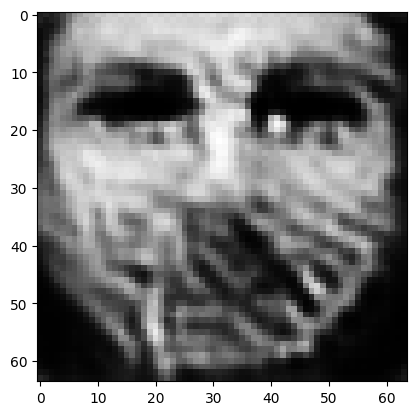

tensor([[3.2282e-04, 1.6088e-07, 1.8998e-05, 3.6179e-07, 8.8513e-06, 5.9852e-04,
         9.9311e-01, 1.0281e-03, 1.3049e-08, 2.4012e-06, 1.5658e-05, 4.6120e-07,
         1.4278e-06, 1.7178e-08, 4.8819e-07, 1.7678e-04, 7.1035e-04, 1.1428e-03,
         2.9770e-05, 2.0569e-03, 1.1383e-06, 2.7289e-07, 2.0052e-09, 1.7653e-04,
         5.9700e-06, 1.1979e-09, 3.6780e-05, 3.7899e-05, 1.9722e-04, 3.9766e-07,
         1.1644e-08, 5.5497e-06, 2.6664e-04, 1.0121e-05, 1.0683e-06, 7.8460e-07,
         1.2575e-06, 1.0163e-06, 1.9254e-05, 1.0202e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00691082701086998
tensor([[3.2280e-04, 1.6087e-07, 1.8996e-05, 3.6176e-07, 8.8504e-06, 5.9847e-04,
         9.9311e-01, 1.0280e-03, 1.3047e-08, 2.4010e-06, 1.5657e-05, 4.6114e-07,
         1.4277e-06, 1.7175e-08, 4.8815e-07, 1.7678e-04, 7.1030e-04, 1.1427e-03,
         2.9769e-05, 2.0567e-03, 1.1382e-06, 2.7286e-07, 2.0049e-09, 1.7652e-04,
         5.9692e-06, 1.1977e-09, 3.6777e-0

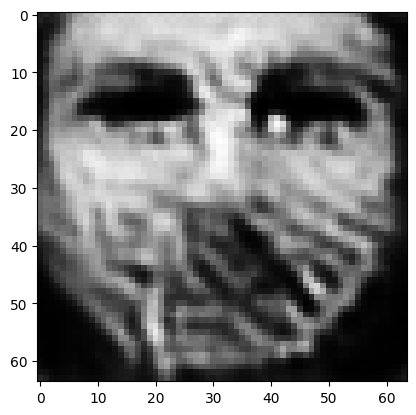

tensor([[3.2274e-04, 1.6081e-07, 1.8990e-05, 3.6166e-07, 8.8469e-06, 5.9829e-04,
         9.9312e-01, 1.0277e-03, 1.3041e-08, 2.4002e-06, 1.5652e-05, 4.6094e-07,
         1.4271e-06, 1.7167e-08, 4.8800e-07, 1.7674e-04, 7.1013e-04, 1.1423e-03,
         2.9765e-05, 2.0562e-03, 1.1378e-06, 2.7276e-07, 2.0039e-09, 1.7649e-04,
         5.9664e-06, 1.1971e-09, 3.6764e-05, 3.7887e-05, 1.9717e-04, 3.9749e-07,
         1.1637e-08, 5.5469e-06, 2.6649e-04, 1.0116e-05, 1.0679e-06, 7.8424e-07,
         1.2569e-06, 1.0157e-06, 1.9245e-05, 1.0197e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006908340845257044
tensor([[3.2273e-04, 1.6080e-07, 1.8988e-05, 3.6163e-07, 8.8460e-06, 5.9824e-04,
         9.9312e-01, 1.0276e-03, 1.3039e-08, 2.4000e-06, 1.5650e-05, 4.6090e-07,
         1.4270e-06, 1.7165e-08, 4.8797e-07, 1.7674e-04, 7.1008e-04, 1.1423e-03,
         2.9764e-05, 2.0560e-03, 1.1377e-06, 2.7273e-07, 2.0037e-09, 1.7648e-04,
         5.9657e-06, 1.1970e-09, 3.6761e-

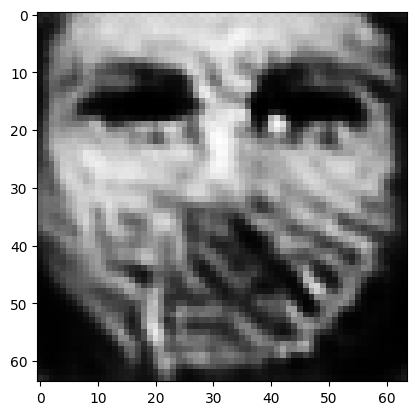

tensor([[3.2267e-04, 1.6074e-07, 1.8982e-05, 3.6153e-07, 8.8427e-06, 5.9806e-04,
         9.9312e-01, 1.0273e-03, 1.3033e-08, 2.3993e-06, 1.5646e-05, 4.6070e-07,
         1.4265e-06, 1.7157e-08, 4.8784e-07, 1.7671e-04, 7.0992e-04, 1.1420e-03,
         2.9760e-05, 2.0555e-03, 1.1374e-06, 2.7263e-07, 2.0028e-09, 1.7644e-04,
         5.9631e-06, 1.1964e-09, 3.6749e-05, 3.7875e-05, 1.9712e-04, 3.9732e-07,
         1.1631e-08, 5.5443e-06, 2.6635e-04, 1.0111e-05, 1.0675e-06, 7.8390e-07,
         1.2564e-06, 1.0152e-06, 1.9237e-05, 1.0193e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006905854679644108
tensor([[3.2265e-04, 1.6073e-07, 1.8980e-05, 3.6151e-07, 8.8419e-06, 5.9802e-04,
         9.9312e-01, 1.0272e-03, 1.3032e-08, 2.3991e-06, 1.5644e-05, 4.6065e-07,
         1.4264e-06, 1.7155e-08, 4.8780e-07, 1.7670e-04, 7.0988e-04, 1.1419e-03,
         2.9759e-05, 2.0554e-03, 1.1373e-06, 2.7260e-07, 2.0025e-09, 1.7643e-04,
         5.9624e-06, 1.1963e-09, 3.6746e-

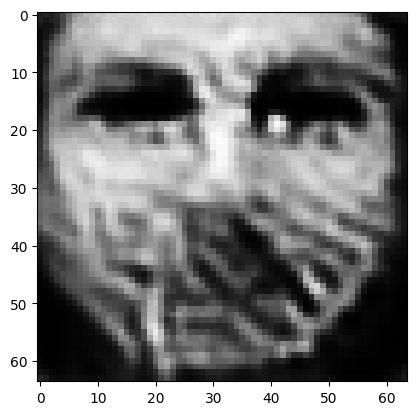

tensor([[3.2259e-04, 1.6068e-07, 1.8975e-05, 3.6141e-07, 8.8387e-06, 5.9785e-04,
         9.9312e-01, 1.0270e-03, 1.3026e-08, 2.3984e-06, 1.5640e-05, 4.6047e-07,
         1.4258e-06, 1.7147e-08, 4.8767e-07, 1.7667e-04, 7.0972e-04, 1.1416e-03,
         2.9755e-05, 2.0549e-03, 1.1370e-06, 2.7250e-07, 2.0016e-09, 1.7640e-04,
         5.9598e-06, 1.1957e-09, 3.6735e-05, 3.7863e-05, 1.9707e-04, 3.9716e-07,
         1.1624e-08, 5.5418e-06, 2.6622e-04, 1.0106e-05, 1.0672e-06, 7.8357e-07,
         1.2558e-06, 1.0147e-06, 1.9230e-05, 1.0189e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006903723813593388
tensor([[3.2258e-04, 1.6067e-07, 1.8973e-05, 3.6139e-07, 8.8380e-06, 5.9781e-04,
         9.9312e-01, 1.0269e-03, 1.3024e-08, 2.3982e-06, 1.5639e-05, 4.6043e-07,
         1.4257e-06, 1.7145e-08, 4.8764e-07, 1.7666e-04, 7.0969e-04, 1.1415e-03,
         2.9754e-05, 2.0547e-03, 1.1369e-06, 2.7248e-07, 2.0014e-09, 1.7639e-04,
         5.9592e-06, 1.1956e-09, 3.6732e-

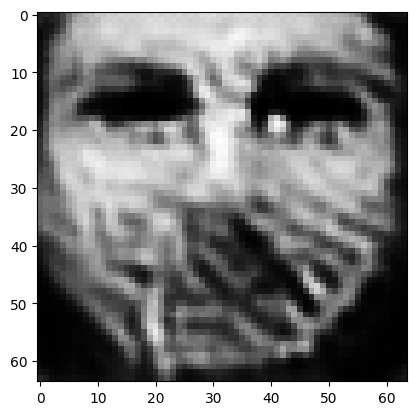

tensor([[3.2252e-04, 1.6062e-07, 1.8967e-05, 3.6130e-07, 8.8350e-06, 5.9765e-04,
         9.9312e-01, 1.0266e-03, 1.3019e-08, 2.3975e-06, 1.5634e-05, 4.6025e-07,
         1.4253e-06, 1.7138e-08, 4.8751e-07, 1.7664e-04, 7.0953e-04, 1.1413e-03,
         2.9750e-05, 2.0543e-03, 1.1366e-06, 2.7238e-07, 2.0006e-09, 1.7636e-04,
         5.9568e-06, 1.1951e-09, 3.6721e-05, 3.7852e-05, 1.9703e-04, 3.9701e-07,
         1.1618e-08, 5.5395e-06, 2.6610e-04, 1.0102e-05, 1.0668e-06, 7.8327e-07,
         1.2553e-06, 1.0143e-06, 1.9223e-05, 1.0185e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0069017112255096436
tensor([[3.2251e-04, 1.6061e-07, 1.8966e-05, 3.6128e-07, 8.8342e-06, 5.9761e-04,
         9.9312e-01, 1.0265e-03, 1.3018e-08, 2.3974e-06, 1.5633e-05, 4.6021e-07,
         1.4252e-06, 1.7136e-08, 4.8748e-07, 1.7663e-04, 7.0949e-04, 1.1412e-03,
         2.9750e-05, 2.0541e-03, 1.1365e-06, 2.7236e-07, 2.0004e-09, 1.7635e-04,
         5.9562e-06, 1.1949e-09, 3.6719e

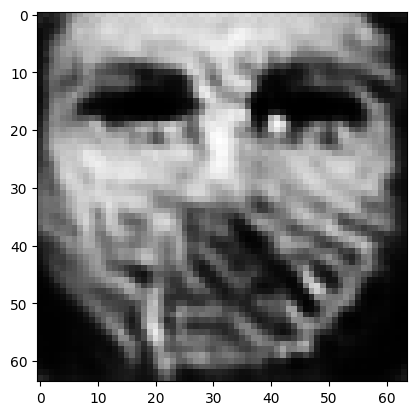

tensor([[3.2246e-04, 1.6056e-07, 1.8961e-05, 3.6120e-07, 8.8314e-06, 5.9746e-04,
         9.9312e-01, 1.0263e-03, 1.3012e-08, 2.3968e-06, 1.5629e-05, 4.6005e-07,
         1.4247e-06, 1.7129e-08, 4.8736e-07, 1.7661e-04, 7.0935e-04, 1.1409e-03,
         2.9746e-05, 2.0537e-03, 1.1362e-06, 2.7227e-07, 1.9995e-09, 1.7633e-04,
         5.9539e-06, 1.1944e-09, 3.6708e-05, 3.7842e-05, 1.9699e-04, 3.9687e-07,
         1.1613e-08, 5.5372e-06, 2.6598e-04, 1.0098e-05, 1.0665e-06, 7.8297e-07,
         1.2548e-06, 1.0138e-06, 1.9216e-05, 1.0181e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006899816915392876
tensor([[3.2245e-04, 1.6055e-07, 1.8960e-05, 3.6118e-07, 8.8307e-06, 5.9743e-04,
         9.9312e-01, 1.0262e-03, 1.3011e-08, 2.3966e-06, 1.5628e-05, 4.6001e-07,
         1.4246e-06, 1.7128e-08, 4.8733e-07, 1.7660e-04, 7.0932e-04, 1.1409e-03,
         2.9745e-05, 2.0536e-03, 1.1361e-06, 2.7225e-07, 1.9994e-09, 1.7632e-04,
         5.9534e-06, 1.1943e-09, 3.6706e-

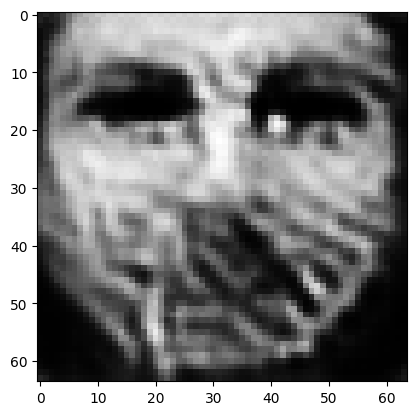

tensor([[3.2240e-04, 1.6051e-07, 1.8954e-05, 3.6110e-07, 8.8280e-06, 5.9728e-04,
         9.9313e-01, 1.0260e-03, 1.3006e-08, 2.3960e-06, 1.5624e-05, 4.5985e-07,
         1.4242e-06, 1.7121e-08, 4.8723e-07, 1.7657e-04, 7.0918e-04, 1.1406e-03,
         2.9742e-05, 2.0531e-03, 1.1359e-06, 2.7216e-07, 1.9986e-09, 1.7629e-04,
         5.9512e-06, 1.1938e-09, 3.6696e-05, 3.7832e-05, 1.9694e-04, 3.9673e-07,
         1.1608e-08, 5.5351e-06, 2.6587e-04, 1.0094e-05, 1.0662e-06, 7.8270e-07,
         1.2544e-06, 1.0134e-06, 1.9209e-05, 1.0178e-05]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006897804327309132
tensor([[3.2239e-04, 1.6050e-07, 1.8953e-05, 3.6108e-07, 8.8274e-06, 5.9724e-04,
         9.9313e-01, 1.0259e-03, 1.3005e-08, 2.3958e-06, 1.5623e-05, 4.5981e-07,
         1.4241e-06, 1.7120e-08, 4.8720e-07, 1.7657e-04, 7.0915e-04, 1.1406e-03,
         2.9741e-05, 2.0530e-03, 1.1358e-06, 2.7214e-07, 1.9984e-09, 1.7629e-04,
         5.9507e-06, 1.1937e-09, 3.6694e-

In [17]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=6)

tensor([[2.5849e-04, 4.0420e-05, 9.8728e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8280e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2035e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  9.750244140625


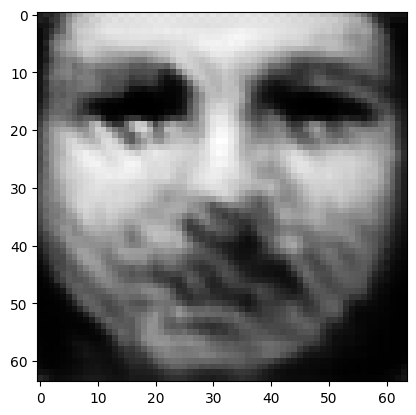

tensor([[6.6471e-05, 2.6651e-04, 7.9972e-04, 2.7887e-03, 2.4345e-02, 5.9660e-05,
         3.0020e-04, 1.5467e-04, 2.4039e-04, 7.5656e-06, 4.5283e-05, 4.7928e-05,
         7.2037e-03, 9.9288e-03, 8.9630e-05, 9.6434e-06, 8.1322e-03, 1.1204e-03,
         5.2715e-04, 2.2447e-05, 8.0236e-03, 6.5586e-05, 3.9929e-01, 7.0717e-05,
         2.1081e-01, 9.0181e-02, 4.9427e-05, 4.7291e-04, 5.2709e-04, 2.1859e-03,
         2.6163e-04, 2.5463e-04, 2.7820e-03, 2.0604e-03, 1.4919e-02, 7.5553e-03,
         1.9676e-01, 3.9023e-03, 2.5683e-03, 1.1041e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  8.774232864379883
tensor([[2.1011e-04, 1.0584e-03, 1.0008e-02, 2.7180e-03, 7.9575e-02, 1.3234e-03,
         7.9171e-03, 3.0560e-03, 1.2170e-03, 1.2223e-04, 7.6405e-04, 1.3996e-04,
         1.6745e-01, 1.6797e-02, 2.9743e-04, 9.2632e-05, 5.1278e-02, 1.6550e-02,
         1.0885e-03, 5.1407e-03, 1.0107e-02, 1.2952e-04, 1.5718e-02, 1.7118e-04,
         1.1617e-01, 4.4074e-03, 9.7012e-04,

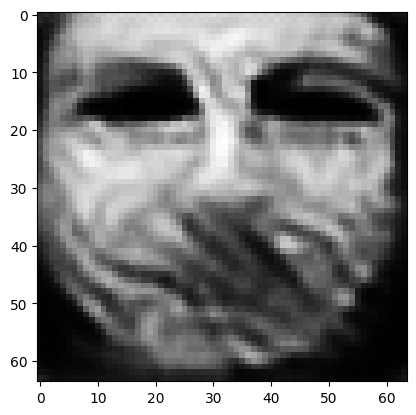

tensor([[9.5727e-04, 2.0196e-05, 1.5553e-02, 3.7307e-05, 4.5273e-04, 1.9061e-02,
         9.5713e-03, 9.1054e-01, 1.6940e-06, 1.6024e-04, 1.3047e-03, 9.5637e-06,
         2.1560e-05, 4.7870e-06, 1.2854e-06, 8.3208e-05, 8.3337e-03, 5.1425e-04,
         7.6858e-04, 5.0699e-03, 2.3953e-06, 5.9467e-06, 7.1380e-08, 2.6259e-04,
         1.9144e-04, 1.7733e-05, 9.8702e-05, 1.7778e-02, 6.3060e-03, 1.3211e-05,
         6.7404e-06, 1.1230e-05, 1.5914e-03, 1.3007e-04, 1.2712e-05, 8.1781e-07,
         3.8238e-05, 4.0211e-04, 2.7696e-04, 3.9048e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.09372052550315857
tensor([[8.0633e-04, 1.7167e-05, 1.3663e-02, 2.8543e-05, 3.6948e-04, 1.7397e-02,
         8.4567e-03, 9.2208e-01, 1.3680e-06, 1.4554e-04, 1.0996e-03, 8.3030e-06,
         1.6455e-05, 3.3002e-06, 9.9435e-07, 6.9213e-05, 6.4538e-03, 4.2491e-04,
         6.3339e-04, 4.5442e-03, 1.8094e-06, 4.9293e-06, 4.8440e-08, 2.0528e-04,
         1.4223e-04, 1.3185e-05, 8.9584e-0

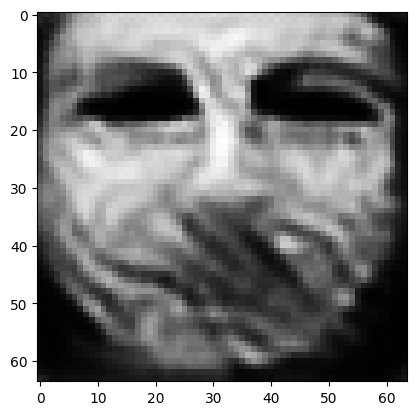

tensor([[5.3374e-04, 1.0620e-05, 9.6287e-03, 1.4584e-05, 2.0487e-04, 1.2887e-02,
         5.9332e-03, 9.4601e-01, 7.4665e-07, 1.1181e-04, 7.1133e-04, 5.4909e-06,
         7.6109e-06, 1.3233e-06, 5.3670e-07, 4.2326e-05, 3.4522e-03, 2.6362e-04,
         3.8928e-04, 3.2573e-03, 8.8906e-07, 2.9538e-06, 1.8054e-08, 1.1658e-04,
         6.7796e-05, 6.5258e-06, 6.2389e-05, 1.1879e-02, 3.0241e-03, 4.8458e-06,
         2.2394e-06, 5.7730e-06, 7.4969e-04, 6.5888e-05, 5.7028e-06, 3.0454e-07,
         1.1012e-05, 2.0009e-04, 1.2152e-04, 2.1012e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.055505458265542984
tensor([[4.9883e-04, 9.7262e-06, 9.0719e-03, 1.2989e-05, 1.8375e-04, 1.2323e-02,
         5.5904e-03, 9.4936e-01, 6.7292e-07, 1.0732e-04, 6.5770e-04, 5.1058e-06,
         6.6458e-06, 1.1158e-06, 4.7615e-07, 3.8646e-05, 3.0958e-03, 2.4082e-04,
         3.5515e-04, 3.0541e-03, 7.7782e-07, 2.6874e-06, 1.5065e-08, 1.0586e-04,
         5.9929e-05, 5.7683e-06, 5.7931e-

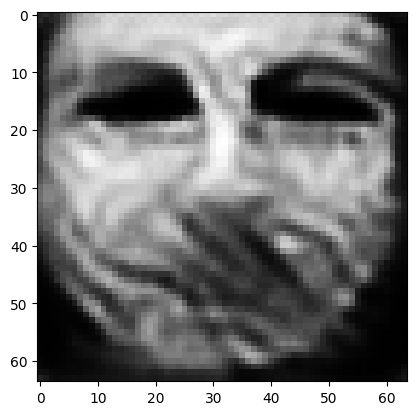

tensor([[4.0733e-04, 7.4153e-06, 7.4721e-03, 9.2832e-06, 1.3542e-04, 1.0338e-02,
         4.5677e-03, 9.5896e-01, 4.9058e-07, 9.4245e-05, 5.0864e-04, 3.9817e-06,
         4.4402e-06, 6.7287e-07, 3.2783e-07, 2.8200e-05, 2.2317e-03, 1.8192e-04,
         2.6255e-04, 2.4622e-03, 5.1263e-07, 1.9903e-06, 8.8760e-09, 7.8869e-05,
         4.3114e-05, 4.1027e-06, 4.4810e-05, 9.1924e-03, 2.0276e-03, 2.7797e-06,
         1.2662e-06, 4.1014e-06, 4.9805e-04, 4.5820e-05, 3.7035e-06, 1.7651e-07,
         6.1049e-06, 1.4027e-04, 8.1490e-05, 1.4553e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.04190512374043465
tensor([[3.9292e-04, 7.0950e-06, 7.1762e-03, 8.8418e-06, 1.2877e-04, 9.8594e-03,
         4.3693e-03, 9.6062e-01, 4.6681e-07, 9.1771e-05, 4.8768e-04, 3.7809e-06,
         4.1519e-06, 6.2680e-07, 3.0891e-07, 2.6457e-05, 2.1012e-03, 1.7274e-04,
         2.5014e-04, 2.3626e-03, 4.7718e-07, 1.8877e-06, 8.2148e-09, 7.4970e-05,
         4.0932e-05, 3.9395e-06, 4.2520e-0

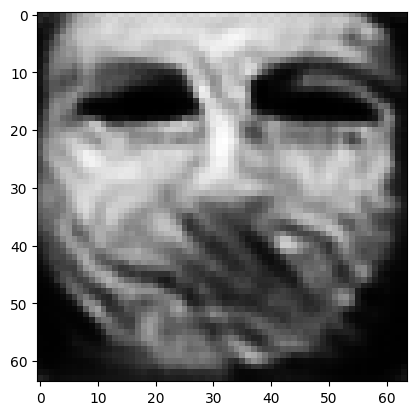

tensor([[3.5611e-04, 6.0749e-06, 6.3179e-03, 7.4015e-06, 1.0870e-04, 8.6089e-03,
         3.8318e-03, 9.6564e-01, 3.8878e-07, 8.4602e-05, 4.1555e-04, 3.2252e-06,
         3.3126e-06, 4.7601e-07, 2.5221e-07, 2.1462e-05, 1.7297e-03, 1.4574e-04,
         2.0948e-04, 2.0765e-03, 3.7315e-07, 1.5903e-06, 6.2661e-09, 6.4217e-05,
         3.4980e-05, 3.2993e-06, 3.5794e-05, 7.9571e-03, 1.5793e-03, 2.0821e-06,
         9.5434e-07, 3.3754e-06, 3.9965e-04, 3.7290e-05, 2.8651e-06, 1.3348e-07,
         4.4723e-06, 1.2060e-04, 6.5872e-05, 1.1468e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.034960199147462845
tensor([[3.4850e-04, 5.8453e-06, 6.1331e-03, 7.0743e-06, 1.0474e-04, 8.3759e-03,
         3.7328e-03, 9.6670e-01, 3.7236e-07, 8.2964e-05, 3.9853e-04, 3.1118e-06,
         3.1473e-06, 4.4413e-07, 2.4006e-07, 2.0477e-05, 1.6504e-03, 1.4025e-04,
         2.0020e-04, 2.0123e-03, 3.5228e-07, 1.5279e-06, 5.8717e-09, 6.1912e-05,
         3.3704e-05, 3.1493e-06, 3.4490e-

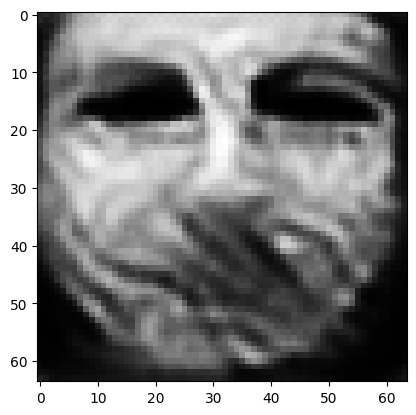

tensor([[3.1878e-04, 5.1235e-06, 5.5722e-03, 6.1063e-06, 9.1828e-05, 7.6194e-03,
         3.3683e-03, 9.7016e-01, 3.2547e-07, 7.8195e-05, 3.4427e-04, 2.7587e-06,
         2.6467e-06, 3.4906e-07, 1.9739e-07, 1.7320e-05, 1.3815e-03, 1.1949e-04,
         1.7259e-04, 1.7932e-03, 2.8821e-07, 1.3395e-06, 4.7556e-09, 5.3723e-05,
         2.9119e-05, 2.7534e-06, 3.0379e-05, 6.8852e-03, 1.2995e-03, 1.6258e-06,
         7.5472e-07, 2.8677e-06, 3.4195e-04, 3.1712e-05, 2.3104e-06, 1.0596e-07,
         3.4655e-06, 1.0656e-04, 5.6749e-05, 9.7887e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03029736690223217
tensor([[3.1337e-04, 4.9674e-06, 5.4509e-03, 5.8931e-06, 8.9120e-05, 7.4614e-03,
         3.3036e-03, 9.7087e-01, 3.1539e-07, 7.7264e-05, 3.3395e-04, 2.7043e-06,
         2.5422e-06, 3.3060e-07, 1.8970e-07, 1.6729e-05, 1.3286e-03, 1.1602e-04,
         1.6662e-04, 1.7498e-03, 2.7621e-07, 1.3069e-06, 4.5337e-09, 5.2283e-05,
         2.8251e-05, 2.6632e-06, 2.9633e-0

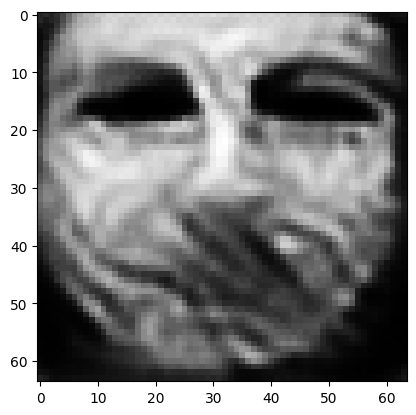

tensor([[2.8829e-04, 4.4180e-06, 5.0353e-03, 5.1895e-06, 7.9046e-05, 6.8500e-03,
         3.0212e-03, 9.7340e-01, 2.7576e-07, 7.3096e-05, 2.9988e-04, 2.4513e-06,
         2.1595e-06, 2.7183e-07, 1.5828e-07, 1.4635e-05, 1.1481e-03, 1.0125e-04,
         1.4754e-04, 1.5686e-03, 2.3082e-07, 1.1705e-06, 3.7718e-09, 4.6382e-05,
         2.4418e-05, 2.3994e-06, 2.6508e-05, 6.1851e-03, 1.1103e-03, 1.3240e-06,
         6.2139e-07, 2.5287e-06, 2.9597e-04, 2.7515e-05, 1.9162e-06, 8.7444e-08,
         2.8599e-06, 9.6918e-05, 4.8855e-05, 8.5462e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026962779462337494
tensor([[2.8527e-04, 4.3097e-06, 4.9392e-03, 5.0388e-06, 7.7005e-05, 6.7350e-03,
         2.9825e-03, 9.7392e-01, 2.6687e-07, 7.2355e-05, 2.9268e-04, 2.4066e-06,
         2.0836e-06, 2.5993e-07, 1.5356e-07, 1.4272e-05, 1.1194e-03, 9.8971e-05,
         1.4352e-04, 1.5390e-03, 2.2251e-07, 1.1463e-06, 3.6191e-09, 4.5672e-05,
         2.3838e-05, 2.3271e-06, 2.5896e-

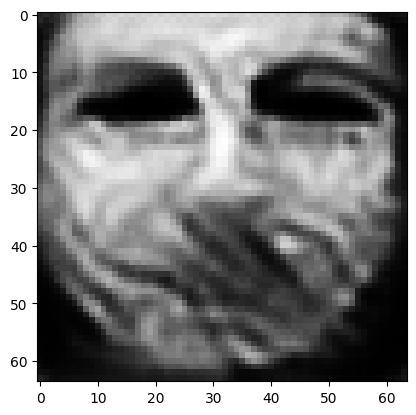

tensor([[2.6716e-04, 3.9174e-06, 4.6368e-03, 4.5310e-06, 6.9445e-05, 6.3306e-03,
         2.7666e-03, 9.7577e-01, 2.3843e-07, 6.9346e-05, 2.6653e-04, 2.2241e-06,
         1.8168e-06, 2.1841e-07, 1.3191e-07, 1.2792e-05, 9.9258e-04, 8.8552e-05,
         1.2897e-04, 1.4084e-03, 1.9136e-07, 1.0485e-06, 3.0786e-09, 4.1368e-05,
         2.1158e-05, 2.1206e-06, 2.3654e-05, 5.6183e-03, 9.7200e-04, 1.1162e-06,
         5.2264e-07, 2.2726e-06, 2.6290e-04, 2.4348e-05, 1.6511e-06, 7.4069e-08,
         2.4167e-06, 8.8772e-05, 4.3094e-05, 7.6154e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024532660841941833
tensor([[2.6272e-04, 3.8348e-06, 4.5638e-03, 4.4284e-06, 6.7700e-05, 6.2350e-03,
         2.7123e-03, 9.7619e-01, 2.3193e-07, 6.8545e-05, 2.6092e-04, 2.1817e-06,
         1.7570e-06, 2.0964e-07, 1.2681e-07, 1.2453e-05, 9.5980e-04, 8.6111e-05,
         1.2584e-04, 1.3730e-03, 1.8400e-07, 1.0231e-06, 2.9560e-09, 4.0162e-05,
         2.0461e-05, 2.0801e-06, 2.3201e-

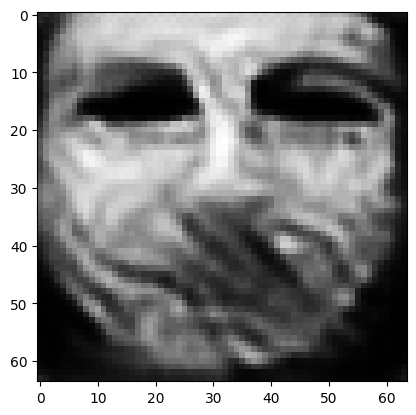

tensor([[2.4927e-04, 3.5458e-06, 4.2943e-03, 4.0589e-06, 6.1889e-05, 5.9108e-03,
         2.5438e-03, 9.7768e-01, 2.0934e-07, 6.5686e-05, 2.4101e-04, 2.0268e-06,
         1.5614e-06, 1.8058e-07, 1.1150e-07, 1.1312e-05, 8.6777e-04, 7.8266e-05,
         1.1489e-04, 1.2662e-03, 1.6105e-07, 9.4078e-07, 2.5711e-09, 3.6953e-05,
         1.8586e-05, 1.9167e-06, 2.1407e-05, 5.2125e-03, 8.6128e-04, 9.5796e-07,
         4.4981e-07, 2.0547e-06, 2.3217e-04, 2.1698e-05, 1.4447e-06, 6.3609e-08,
         2.0835e-06, 8.1881e-05, 3.8148e-05, 6.8700e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.022573070600628853
tensor([[2.4552e-04, 3.4835e-06, 4.2307e-03, 3.9796e-06, 6.0620e-05, 5.8396e-03,
         2.5012e-03, 9.7802e-01, 2.0458e-07, 6.4908e-05, 2.3637e-04, 1.9899e-06,
         1.5207e-06, 1.7439e-07, 1.0762e-07, 1.1040e-05, 8.4396e-04, 7.6393e-05,
         1.1235e-04, 1.2396e-03, 1.5569e-07, 9.1961e-07, 2.4874e-09, 3.5998e-05,
         1.8105e-05, 1.8839e-06, 2.1020e-

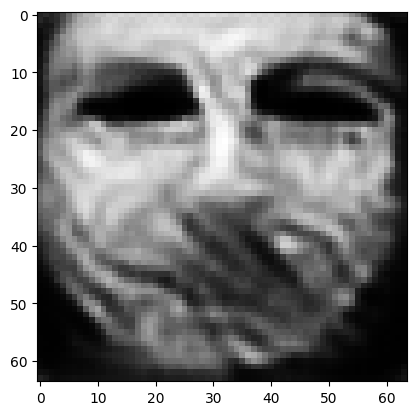

tensor([[2.3097e-04, 3.2093e-06, 4.0273e-03, 3.6670e-06, 5.5281e-05, 5.6026e-03,
         2.3376e-03, 9.7929e-01, 1.8361e-07, 6.2188e-05, 2.1851e-04, 1.8431e-06,
         1.3458e-06, 1.4897e-07, 9.2204e-08, 1.0065e-05, 7.6182e-04, 6.8070e-05,
         1.0325e-04, 1.1294e-03, 1.3467e-07, 8.4019e-07, 2.1424e-09, 3.2741e-05,
         1.6135e-05, 1.7581e-06, 1.9328e-05, 4.8595e-03, 7.6770e-04, 8.2186e-07,
         3.9040e-07, 1.8319e-06, 2.0185e-04, 1.9253e-05, 1.2631e-06, 5.4024e-08,
         1.8023e-06, 7.5297e-05, 3.3874e-05, 6.2536e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020932121202349663
tensor([[2.2746e-04, 3.1405e-06, 3.9827e-03, 3.5973e-06, 5.4142e-05, 5.5577e-03,
         2.2994e-03, 9.7958e-01, 1.7865e-07, 6.1438e-05, 2.1395e-04, 1.8067e-06,
         1.3065e-06, 1.4315e-07, 8.8517e-08, 9.8273e-06, 7.4461e-04, 6.5996e-05,
         1.0105e-04, 1.0999e-03, 1.2979e-07, 8.2059e-07, 2.0674e-09, 3.2042e-05,
         1.5736e-05, 1.7315e-06, 1.8861e-

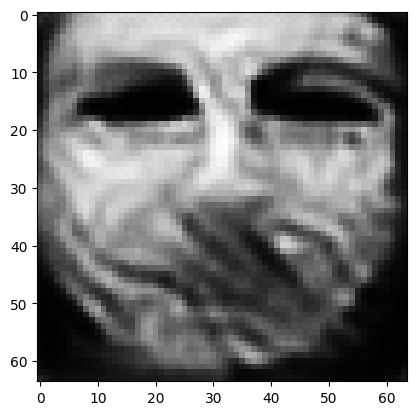

tensor([[2.1394e-04, 2.8907e-06, 3.8166e-03, 3.3198e-06, 4.9545e-05, 5.3693e-03,
         2.1403e-03, 9.8071e-01, 1.6132e-07, 5.8835e-05, 1.9729e-04, 1.6791e-06,
         1.1593e-06, 1.2169e-07, 7.5567e-08, 8.9423e-06, 6.7111e-04, 5.8667e-05,
         9.2801e-05, 9.9689e-04, 1.1206e-07, 7.5066e-07, 1.7827e-09, 2.9092e-05,
         1.4052e-05, 1.6272e-06, 1.7356e-05, 4.4958e-03, 6.9045e-04, 7.0543e-07,
         3.3739e-07, 1.6202e-06, 1.7408e-04, 1.6984e-05, 1.1087e-06, 4.5549e-08,
         1.5556e-06, 6.9062e-05, 3.0242e-05, 5.7205e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019474145025014877
tensor([[2.1070e-04, 2.8295e-06, 3.7801e-03, 3.2556e-06, 4.8498e-05, 5.3214e-03,
         2.1025e-03, 9.8098e-01, 1.5730e-07, 5.8182e-05, 1.9352e-04, 1.6476e-06,
         1.1260e-06, 1.1696e-07, 7.2744e-08, 8.7318e-06, 6.5517e-04, 5.6973e-05,
         9.0879e-05, 9.7247e-04, 1.0810e-07, 7.3475e-07, 1.7200e-09, 2.8443e-05,
         1.3691e-05, 1.6036e-06, 1.6977e-

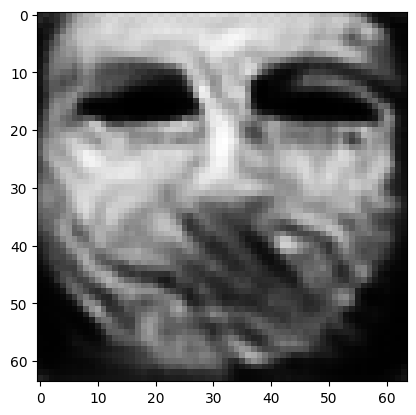

tensor([[1.9967e-04, 2.6075e-06, 3.6390e-03, 2.9979e-06, 4.4545e-05, 5.1679e-03,
         1.9785e-03, 9.8197e-01, 1.4257e-07, 5.6192e-05, 1.7922e-04, 1.5396e-06,
         1.0043e-06, 9.9155e-08, 6.3182e-08, 8.0063e-06, 5.9883e-04, 5.1274e-05,
         8.3436e-05, 8.9430e-04, 9.4435e-08, 6.8077e-07, 1.4817e-09, 2.6193e-05,
         1.2434e-05, 1.4913e-06, 1.5660e-05, 4.1194e-03, 6.2710e-04, 6.1204e-07,
         2.9086e-07, 1.4443e-06, 1.5319e-04, 1.5150e-05, 9.8413e-07, 3.8649e-08,
         1.3398e-06, 6.3433e-05, 2.7398e-05, 5.2546e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01819339208304882
tensor([[1.9747e-04, 2.5572e-06, 3.6043e-03, 2.9341e-06, 4.3641e-05, 5.1337e-03,
         1.9547e-03, 9.8220e-01, 1.3925e-07, 5.5864e-05, 1.7584e-04, 1.5172e-06,
         9.7687e-07, 9.5095e-08, 6.1296e-08, 7.8521e-06, 5.8680e-04, 5.0150e-05,
         8.1671e-05, 8.7958e-04, 9.1591e-08, 6.6988e-07, 1.4270e-09, 2.5751e-05,
         1.2182e-05, 1.4591e-06, 1.5373e-0

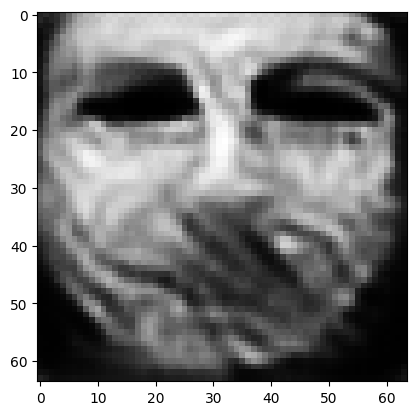

tensor([[1.8933e-04, 2.3763e-06, 3.4696e-03, 2.7009e-06, 4.0345e-05, 4.9998e-03,
         1.8656e-03, 9.8307e-01, 1.2719e-07, 5.4623e-05, 1.6362e-04, 1.4339e-06,
         8.7903e-07, 8.1162e-08, 5.4660e-08, 7.2960e-06, 5.4274e-04, 4.6159e-05,
         7.5290e-05, 8.2712e-04, 8.1535e-08, 6.2967e-07, 1.2364e-09, 2.4127e-05,
         1.1262e-05, 1.3396e-06, 1.4349e-05, 3.7242e-03, 5.7434e-04, 5.3919e-07,
         2.4988e-07, 1.3186e-06, 1.3908e-04, 1.3790e-05, 8.8664e-07, 3.3374e-08,
         1.1558e-06, 5.8371e-05, 2.5279e-05, 4.8702e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017074139788746834
tensor([[1.8729e-04, 2.3369e-06, 3.4356e-03, 2.6502e-06, 3.9570e-05, 4.9670e-03,
         1.8441e-03, 9.8327e-01, 1.2455e-07, 5.4377e-05, 1.6097e-04, 1.4158e-06,
         8.5720e-07, 7.8202e-08, 5.3163e-08, 7.1763e-06, 5.3163e-04, 4.5225e-05,
         7.3893e-05, 8.1485e-04, 7.9256e-08, 6.2026e-07, 1.1944e-09, 2.3719e-05,
         1.1021e-05, 1.3133e-06, 1.4140e-

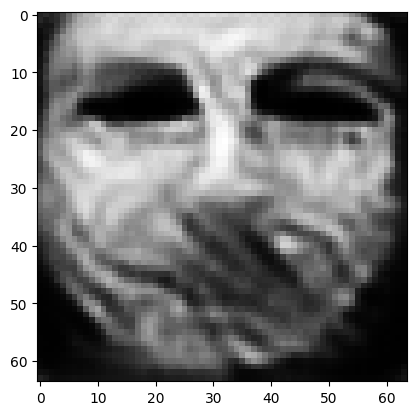

tensor([[1.7956e-04, 2.1846e-06, 3.3167e-03, 2.4466e-06, 3.6806e-05, 4.8439e-03,
         1.7672e-03, 9.8401e-01, 1.1470e-07, 5.3465e-05, 1.5133e-04, 1.3511e-06,
         7.7672e-07, 6.7608e-08, 4.7917e-08, 6.7360e-06, 4.9272e-04, 4.2067e-05,
         6.8477e-05, 7.7184e-04, 7.1320e-08, 5.8744e-07, 1.0418e-09, 2.2277e-05,
         1.0160e-05, 1.2096e-06, 1.3360e-05, 3.4113e-03, 5.3055e-04, 4.7820e-07,
         2.1698e-07, 1.2198e-06, 1.2747e-04, 1.2687e-05, 8.0398e-07, 2.9239e-08,
         1.0092e-06, 5.3957e-05, 2.3356e-05, 4.5518e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016123266890645027
tensor([[1.7785e-04, 2.1506e-06, 3.2895e-03, 2.4047e-06, 3.6233e-05, 4.8121e-03,
         1.7500e-03, 9.8417e-01, 1.1257e-07, 5.3220e-05, 1.4928e-04, 1.3353e-06,
         7.6001e-07, 6.5524e-08, 4.6864e-08, 6.6406e-06, 4.8532e-04, 4.1379e-05,
         6.7350e-05, 7.6243e-04, 6.9701e-08, 5.8028e-07, 1.0118e-09, 2.2005e-05,
         9.9903e-06, 1.1885e-06, 1.3164e-

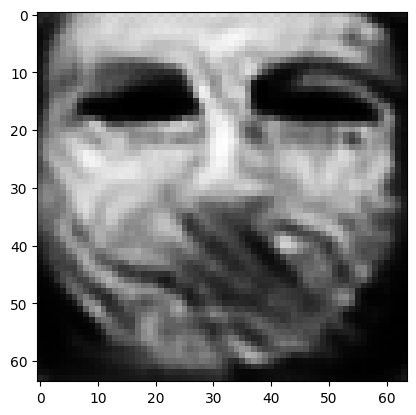

tensor([[1.7169e-04, 1.9835e-06, 3.1949e-03, 2.2165e-06, 3.4012e-05, 4.7140e-03,
         1.6909e-03, 9.8485e-01, 1.0362e-07, 5.2470e-05, 1.4009e-04, 1.2772e-06,
         6.8998e-07, 5.6011e-08, 4.2488e-08, 6.2550e-06, 4.5668e-04, 3.8820e-05,
         6.2013e-05, 7.2828e-04, 6.3144e-08, 5.5237e-07, 8.8268e-10, 2.1071e-05,
         9.4337e-06, 1.0798e-06, 1.2334e-05, 3.0669e-03, 4.9401e-04, 4.2844e-07,
         1.8725e-07, 1.1363e-06, 1.1894e-04, 1.1788e-05, 7.3790e-07, 2.5805e-08,
         8.8412e-07, 4.9654e-05, 2.2111e-05, 4.2623e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01526623871177435
tensor([[1.7006e-04, 1.9511e-06, 3.1750e-03, 2.1807e-06, 3.3489e-05, 4.6900e-03,
         1.6723e-03, 9.8499e-01, 1.0186e-07, 5.2316e-05, 1.3823e-04, 1.2623e-06,
         6.7547e-07, 5.4204e-08, 4.1461e-08, 6.1635e-06, 4.4962e-04, 3.8149e-05,
         6.0983e-05, 7.1993e-04, 6.1700e-08, 5.4585e-07, 8.5699e-10, 2.0785e-05,
         9.2824e-06, 1.0614e-06, 1.2160e-0

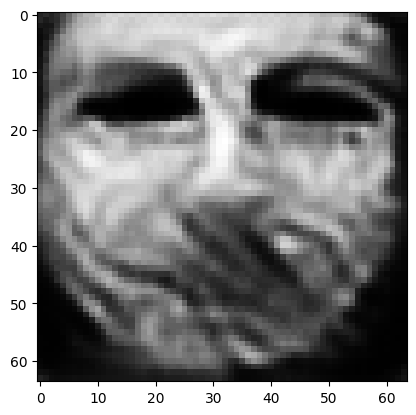

tensor([[1.6432e-04, 1.8421e-06, 3.0969e-03, 2.0755e-06, 3.1934e-05, 4.5480e-03,
         1.6013e-03, 9.8552e-01, 9.6527e-08, 5.1342e-05, 1.3226e-04, 1.1991e-06,
         6.3057e-07, 4.9515e-08, 3.8420e-08, 5.8064e-06, 4.2863e-04, 3.6004e-05,
         5.7726e-05, 6.8932e-04, 5.7114e-08, 5.2368e-07, 7.8713e-10, 1.9878e-05,
         8.8791e-06, 1.0180e-06, 1.1505e-05, 2.8908e-03, 4.6571e-04, 3.9466e-07,
         1.7188e-07, 1.0601e-06, 1.1116e-04, 1.1133e-05, 6.8574e-07, 2.3461e-08,
         8.0148e-07, 4.7176e-05, 2.1185e-05, 4.0193e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014587652869522572
tensor([[1.6299e-04, 1.8182e-06, 3.0802e-03, 2.0524e-06, 3.1556e-05, 4.5168e-03,
         1.5841e-03, 9.8564e-01, 9.5333e-08, 5.1183e-05, 1.3094e-04, 1.1852e-06,
         6.2029e-07, 4.8448e-08, 3.7731e-08, 5.7292e-06, 4.2377e-04, 3.5497e-05,
         5.7011e-05, 6.8296e-04, 5.6085e-08, 5.1901e-07, 7.7162e-10, 1.9676e-05,
         8.7805e-06, 1.0084e-06, 1.1365e-

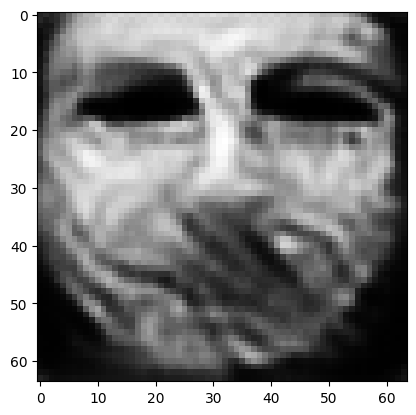

tensor([[1.5795e-04, 1.7316e-06, 3.0037e-03, 1.9620e-06, 3.0094e-05, 4.4009e-03,
         1.5240e-03, 9.8609e-01, 9.0650e-08, 5.0428e-05, 1.2580e-04, 1.1336e-06,
         5.8199e-07, 4.4500e-08, 3.5225e-08, 5.4486e-06, 4.0434e-04, 3.3629e-05,
         5.4431e-05, 6.5775e-04, 5.2296e-08, 5.0079e-07, 7.1414e-10, 1.8883e-05,
         8.3698e-06, 9.6949e-07, 1.0866e-05, 2.7473e-03, 4.4307e-04, 3.6875e-07,
         1.5996e-07, 1.0011e-06, 1.0504e-04, 1.0591e-05, 6.4298e-07, 2.1661e-08,
         7.3399e-07, 4.5297e-05, 2.0333e-05, 3.8217e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014004179276525974
tensor([[1.5683e-04, 1.7098e-06, 2.9849e-03, 1.9368e-06, 2.9713e-05, 4.3771e-03,
         1.5118e-03, 9.8620e-01, 8.9401e-08, 5.0291e-05, 1.2454e-04, 1.1230e-06,
         5.7236e-07, 4.3442e-08, 3.4629e-08, 5.3872e-06, 3.9948e-04, 3.3210e-05,
         5.3782e-05, 6.5209e-04, 5.1395e-08, 4.9666e-07, 6.9889e-10, 1.8706e-05,
         8.2631e-06, 9.5673e-07, 1.0756e-

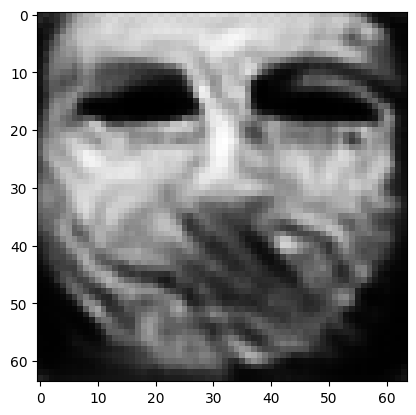

tensor([[1.5182e-04, 1.6149e-06, 2.9127e-03, 1.8282e-06, 2.8135e-05, 4.2863e-03,
         1.4560e-03, 9.8666e-01, 8.3645e-08, 4.9606e-05, 1.1905e-04, 1.0795e-06,
         5.2991e-07, 3.8994e-08, 3.1934e-08, 5.1438e-06, 3.7898e-04, 3.1315e-05,
         5.1008e-05, 6.2361e-04, 4.7432e-08, 4.7757e-07, 6.3273e-10, 1.7940e-05,
         7.7448e-06, 9.0384e-07, 1.0262e-05, 2.5709e-03, 4.2067e-04, 3.4023e-07,
         1.4512e-07, 9.4882e-07, 9.8614e-05, 9.9977e-06, 5.9799e-07, 1.9827e-08,
         6.6159e-07, 4.2885e-05, 1.9333e-05, 3.6191e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013427305035293102
tensor([[1.5069e-04, 1.5933e-06, 2.8962e-03, 1.8039e-06, 2.7785e-05, 4.2654e-03,
         1.4434e-03, 9.8677e-01, 8.2303e-08, 4.9437e-05, 1.1783e-04, 1.0699e-06,
         5.2032e-07, 3.8043e-08, 3.1332e-08, 5.0900e-06, 3.7445e-04, 3.0892e-05,
         5.0377e-05, 6.1690e-04, 4.6536e-08, 4.7320e-07, 6.1814e-10, 1.7772e-05,
         7.6271e-06, 8.9217e-07, 1.0149e-

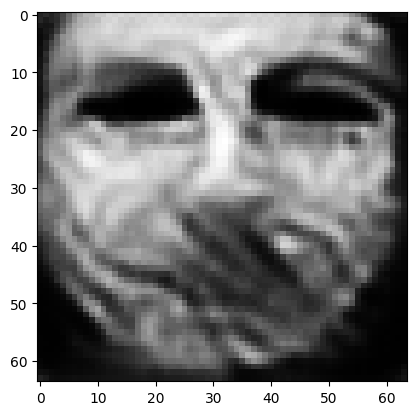

tensor([[1.4639e-04, 1.5082e-06, 2.8354e-03, 1.7094e-06, 2.6407e-05, 4.1862e-03,
         1.3921e-03, 9.8717e-01, 7.7004e-08, 4.8724e-05, 1.1311e-04, 1.0319e-06,
         4.8304e-07, 3.4401e-08, 2.8904e-08, 4.8853e-06, 3.5647e-04, 2.9179e-05,
         4.7904e-05, 5.8830e-04, 4.3034e-08, 4.5511e-07, 5.6167e-10, 1.7073e-05,
         7.1549e-06, 8.4667e-07, 9.7193e-06, 2.4188e-03, 4.0025e-04, 3.1355e-07,
         1.3182e-07, 8.9960e-07, 9.2173e-05, 9.4191e-06, 5.5708e-07, 1.8173e-08,
         6.0348e-07, 4.0702e-05, 1.8253e-05, 3.4321e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012914588674902916
tensor([[1.4536e-04, 1.4891e-06, 2.8204e-03, 1.6880e-06, 2.6089e-05, 4.1666e-03,
         1.3797e-03, 9.8726e-01, 7.5791e-08, 4.8542e-05, 1.1200e-04, 1.0226e-06,
         4.7456e-07, 3.3601e-08, 2.8343e-08, 4.8379e-06, 3.5220e-04, 2.8768e-05,
         4.7347e-05, 5.8142e-04, 4.2213e-08, 4.5072e-07, 5.4909e-10, 1.6903e-05,
         7.0430e-06, 8.3661e-07, 9.6211e-

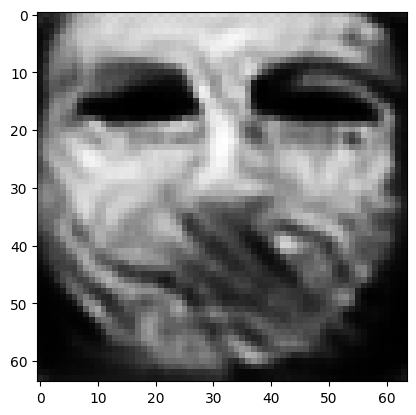

tensor([[1.4156e-04, 1.4208e-06, 2.7662e-03, 1.6117e-06, 2.4971e-05, 4.0898e-03,
         1.3341e-03, 9.8761e-01, 7.1637e-08, 4.7874e-05, 1.0806e-04, 9.8859e-07,
         4.4508e-07, 3.0890e-08, 2.6421e-08, 4.6628e-06, 3.3709e-04, 2.7341e-05,
         4.5345e-05, 5.5761e-04, 3.9379e-08, 4.3553e-07, 5.0644e-10, 1.6289e-05,
         6.6624e-06, 8.0195e-07, 9.2649e-06, 2.2989e-03, 3.8266e-04, 2.9152e-07,
         1.2134e-07, 8.5624e-07, 8.6549e-05, 8.9388e-06, 5.2267e-07, 1.6814e-08,
         5.5780e-07, 3.8932e-05, 1.7303e-05, 3.2761e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012468483299016953
tensor([[1.4065e-04, 1.4066e-06, 2.7534e-03, 1.5956e-06, 2.4716e-05, 4.0710e-03,
         1.3228e-03, 9.8769e-01, 7.0720e-08, 4.7724e-05, 1.0717e-04, 9.8047e-07,
         4.3855e-07, 3.0313e-08, 2.5992e-08, 4.6230e-06, 3.3355e-04, 2.7001e-05,
         4.4918e-05, 5.5206e-04, 3.8742e-08, 4.3201e-07, 4.9720e-10, 1.6140e-05,
         6.5730e-06, 7.9495e-07, 9.1848e-

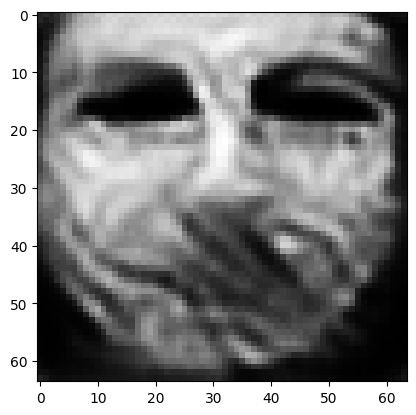

tensor([[1.3720e-04, 1.3538e-06, 2.7031e-03, 1.5334e-06, 2.3756e-05, 3.9946e-03,
         1.2830e-03, 9.8799e-01, 6.7306e-08, 4.7297e-05, 1.0396e-04, 9.5062e-07,
         4.1417e-07, 2.8178e-08, 2.4433e-08, 4.4784e-06, 3.2013e-04, 2.5772e-05,
         4.3244e-05, 5.3169e-04, 3.6491e-08, 4.1993e-07, 4.6258e-10, 1.5588e-05,
         6.2583e-06, 7.6711e-07, 8.8817e-06, 2.2062e-03, 3.6874e-04, 2.7415e-07,
         1.1303e-07, 8.1948e-07, 8.1911e-05, 8.5588e-06, 4.9372e-07, 1.5725e-08,
         5.2022e-07, 3.7476e-05, 1.6543e-05, 3.1443e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012080245651304722
tensor([[1.3643e-04, 1.3424e-06, 2.6908e-03, 1.5202e-06, 2.3542e-05, 3.9758e-03,
         1.2737e-03, 9.8806e-01, 6.6553e-08, 4.7184e-05, 1.0329e-04, 9.4376e-07,
         4.0882e-07, 2.7730e-08, 2.4099e-08, 4.4457e-06, 3.1718e-04, 2.5495e-05,
         4.2884e-05, 5.2701e-04, 3.5995e-08, 4.1711e-07, 4.5518e-10, 1.5465e-05,
         6.1889e-06, 7.6135e-07, 8.8114e-

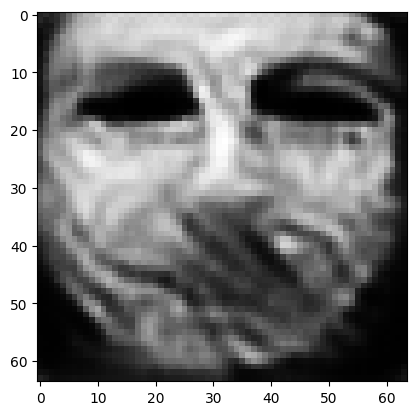

tensor([[1.3351e-04, 1.2992e-06, 2.6414e-03, 1.4664e-06, 2.2706e-05, 3.9140e-03,
         1.2414e-03, 9.8832e-01, 6.3677e-08, 4.6807e-05, 1.0061e-04, 9.2079e-07,
         3.8851e-07, 2.5968e-08, 2.2819e-08, 4.3323e-06, 3.0505e-04, 2.4477e-05,
         4.1463e-05, 5.1036e-04, 3.4134e-08, 4.0657e-07, 4.2624e-10, 1.4976e-05,
         5.9065e-06, 7.3588e-07, 8.5737e-06, 2.1273e-03, 3.5690e-04, 2.5941e-07,
         1.0587e-07, 7.9074e-07, 7.8062e-05, 8.2336e-06, 4.6950e-07, 1.4834e-08,
         4.8924e-07, 3.6229e-05, 1.5851e-05, 3.0343e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011744639836251736
tensor([[1.3284e-04, 1.2891e-06, 2.6293e-03, 1.4536e-06, 2.2509e-05, 3.8998e-03,
         1.2341e-03, 9.8839e-01, 6.2999e-08, 4.6722e-05, 9.9973e-05, 9.1558e-07,
         3.8379e-07, 2.5559e-08, 2.2526e-08, 4.3068e-06, 3.0218e-04, 2.4244e-05,
         4.1128e-05, 5.0653e-04, 3.3705e-08, 4.0411e-07, 4.1951e-10, 1.4863e-05,
         5.8396e-06, 7.2963e-07, 8.5198e-

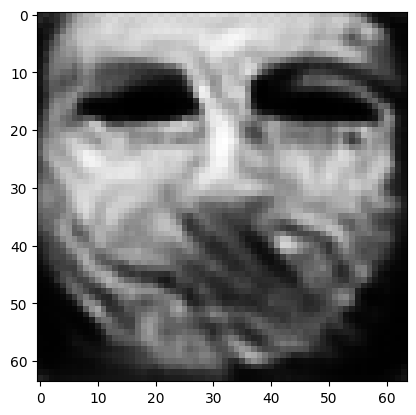

tensor([[1.3032e-04, 1.2515e-06, 2.5841e-03, 1.4059e-06, 2.1774e-05, 3.8433e-03,
         1.2064e-03, 9.8862e-01, 6.0506e-08, 4.6404e-05, 9.7632e-05, 8.9603e-07,
         3.6641e-07, 2.4084e-08, 2.1458e-08, 4.2104e-06, 2.9163e-04, 2.3383e-05,
         3.9885e-05, 4.9224e-04, 3.2130e-08, 3.9496e-07, 3.9508e-10, 1.4445e-05,
         5.5949e-06, 7.0671e-07, 8.3172e-06, 2.0561e-03, 3.4660e-04, 2.4652e-07,
         9.9513e-08, 7.6705e-07, 7.4787e-05, 7.9532e-06, 4.4840e-07, 1.4072e-08,
         4.6227e-07, 3.5100e-05, 1.5230e-05, 2.9386e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011447342112660408
tensor([[1.2971e-04, 1.2426e-06, 2.5737e-03, 1.3949e-06, 2.1607e-05, 3.8291e-03,
         1.1999e-03, 9.8867e-01, 5.9939e-08, 4.6321e-05, 9.7098e-05, 8.9141e-07,
         3.6246e-07, 2.3757e-08, 2.1218e-08, 4.1868e-06, 2.8923e-04, 2.3187e-05,
         3.9596e-05, 4.8887e-04, 3.1773e-08, 3.9284e-07, 3.8963e-10, 1.4349e-05,
         5.5406e-06, 7.0155e-07, 8.2693e-

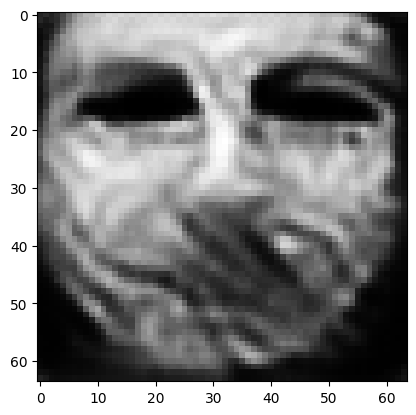

tensor([[1.2736e-04, 1.2024e-06, 2.5290e-03, 1.3468e-06, 2.0975e-05, 3.7723e-03,
         1.1756e-03, 9.8890e-01, 5.7418e-08, 4.5949e-05, 9.4591e-05, 8.7166e-07,
         3.4584e-07, 2.2375e-08, 2.0232e-08, 4.0921e-06, 2.8049e-04, 2.2416e-05,
         3.8334e-05, 4.7427e-04, 3.0293e-08, 3.8381e-07, 3.6697e-10, 1.4027e-05,
         5.3329e-06, 6.7849e-07, 8.0394e-06, 1.9840e-03, 3.3658e-04, 2.3426e-07,
         9.3605e-08, 7.4538e-07, 7.1685e-05, 7.6842e-06, 4.2868e-07, 1.3382e-08,
         4.3808e-07, 3.3968e-05, 1.4680e-05, 2.8371e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01115868054330349
tensor([[1.2682e-04, 1.1918e-06, 2.5174e-03, 1.3338e-06, 2.0808e-05, 3.7599e-03,
         1.1700e-03, 9.8896e-01, 5.6760e-08, 4.5869e-05, 9.3892e-05, 8.6669e-07,
         3.4154e-07, 2.1994e-08, 1.9979e-08, 4.0690e-06, 2.7824e-04, 2.2223e-05,
         3.8000e-05, 4.7071e-04, 2.9923e-08, 3.8148e-07, 3.6095e-10, 1.3949e-05,
         5.2802e-06, 6.7181e-07, 7.9802e-0

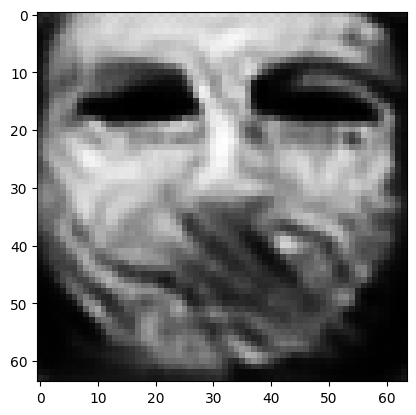

tensor([[1.2469e-04, 1.1498e-06, 2.4733e-03, 1.2838e-06, 2.0163e-05, 3.7133e-03,
         1.1478e-03, 9.8919e-01, 5.4203e-08, 4.5553e-05, 9.1182e-05, 8.4770e-07,
         3.2499e-07, 2.0540e-08, 1.8978e-08, 3.9788e-06, 2.6919e-04, 2.1435e-05,
         3.6710e-05, 4.5602e-04, 2.8471e-08, 3.7221e-07, 3.3777e-10, 1.3636e-05,
         5.0671e-06, 6.4649e-07, 7.7484e-06, 1.8947e-03, 3.2652e-04, 2.2155e-07,
         8.7263e-08, 7.2427e-07, 6.8536e-05, 7.4048e-06, 4.0890e-07, 1.2671e-08,
         4.1201e-07, 3.2714e-05, 1.4152e-05, 2.7354e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010866514407098293
tensor([[1.2416e-04, 1.1404e-06, 2.4633e-03, 1.2729e-06, 2.0016e-05, 3.7019e-03,
         1.1421e-03, 9.8925e-01, 5.3617e-08, 4.5469e-05, 9.0568e-05, 8.4325e-07,
         3.2122e-07, 2.0218e-08, 1.8745e-08, 3.9573e-06, 2.6706e-04, 2.1246e-05,
         3.6418e-05, 4.5232e-04, 2.8130e-08, 3.6996e-07, 3.3258e-10, 1.3557e-05,
         5.0165e-06, 6.4100e-07, 7.6948e-

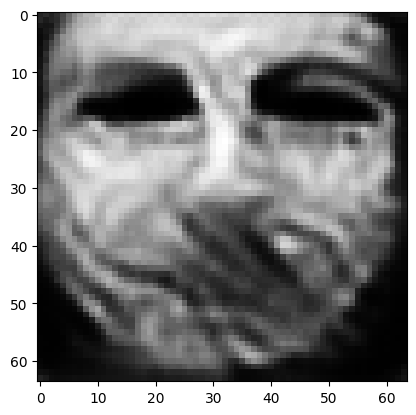

tensor([[1.2256e-04, 1.1084e-06, 2.4272e-03, 1.2382e-06, 1.9526e-05, 3.6569e-03,
         1.1224e-03, 9.8944e-01, 5.1579e-08, 4.5128e-05, 8.8421e-05, 8.2507e-07,
         3.0852e-07, 1.9183e-08, 1.8016e-08, 3.8832e-06, 2.6105e-04, 2.0598e-05,
         3.5466e-05, 4.4015e-04, 2.6994e-08, 3.6212e-07, 3.1598e-10, 1.3357e-05,
         4.8643e-06, 6.2307e-07, 7.4786e-06, 1.8265e-03, 3.1783e-04, 2.1162e-07,
         8.2637e-08, 7.0560e-07, 6.5687e-05, 7.1578e-06, 3.9307e-07, 1.2099e-08,
         3.9246e-07, 3.1729e-05, 1.3712e-05, 2.6450e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010620737448334694
tensor([[1.2217e-04, 1.1013e-06, 2.4188e-03, 1.2303e-06, 1.9405e-05, 3.6459e-03,
         1.1176e-03, 9.8948e-01, 5.1105e-08, 4.5059e-05, 8.7943e-05, 8.2089e-07,
         3.0554e-07, 1.8946e-08, 1.7845e-08, 3.8666e-06, 2.5954e-04, 2.0443e-05,
         3.5254e-05, 4.3742e-04, 2.6724e-08, 3.6030e-07, 3.1210e-10, 1.3303e-05,
         4.8247e-06, 6.1900e-07, 7.4311e-

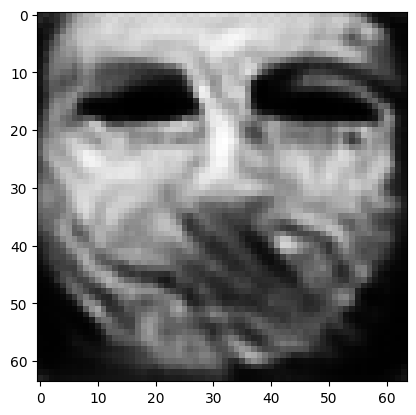

tensor([[1.2073e-04, 1.0745e-06, 2.3865e-03, 1.2005e-06, 1.8964e-05, 3.6001e-03,
         1.0996e-03, 9.8965e-01, 4.9360e-08, 4.4769e-05, 8.6160e-05, 8.0456e-07,
         2.9466e-07, 1.8099e-08, 1.7240e-08, 3.7999e-06, 2.5436e-04, 1.9884e-05,
         3.4473e-05, 4.2758e-04, 2.5747e-08, 3.5354e-07, 2.9829e-10, 1.3121e-05,
         4.6901e-06, 6.0377e-07, 7.2438e-06, 1.7710e-03, 3.1030e-04, 2.0355e-07,
         7.8947e-08, 6.8976e-07, 6.3297e-05, 6.9515e-06, 3.7968e-07, 1.1625e-08,
         3.7611e-07, 3.0947e-05, 1.3332e-05, 2.5646e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010403567925095558
tensor([[1.2036e-04, 1.0680e-06, 2.3787e-03, 1.1933e-06, 1.8857e-05, 3.5887e-03,
         1.0950e-03, 9.8969e-01, 4.8938e-08, 4.4694e-05, 8.5719e-05, 8.0044e-07,
         2.9203e-07, 1.7896e-08, 1.7089e-08, 3.7831e-06, 2.5311e-04, 1.9740e-05,
         3.4286e-05, 4.2508e-04, 2.5509e-08, 3.5186e-07, 2.9500e-10, 1.3075e-05,
         4.6567e-06, 6.0022e-07, 7.1965e-

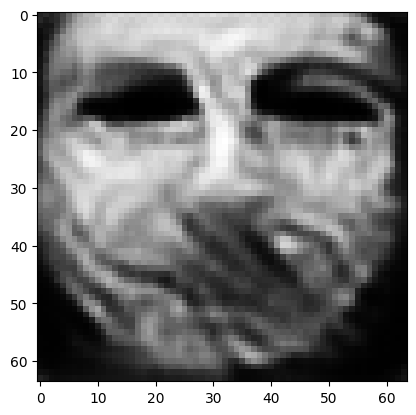

tensor([[1.1893e-04, 1.0446e-06, 2.3479e-03, 1.1673e-06, 1.8444e-05, 3.5453e-03,
         1.0777e-03, 9.8985e-01, 4.7354e-08, 4.4431e-05, 8.4115e-05, 7.8477e-07,
         2.8218e-07, 1.7151e-08, 1.6534e-08, 3.7222e-06, 2.4833e-04, 1.9197e-05,
         3.3621e-05, 4.1584e-04, 2.4621e-08, 3.4551e-07, 2.8279e-10, 1.2898e-05,
         4.5277e-06, 5.8711e-07, 7.0226e-06, 1.7227e-03, 3.0327e-04, 1.9629e-07,
         7.5740e-08, 6.7431e-07, 6.1031e-05, 6.7595e-06, 3.6732e-07, 1.1193e-08,
         3.6130e-07, 3.0233e-05, 1.2976e-05, 2.4899e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010201691649854183
tensor([[1.1862e-04, 1.0393e-06, 2.3400e-03, 1.1611e-06, 1.8341e-05, 3.5341e-03,
         1.0739e-03, 9.8989e-01, 4.6977e-08, 4.4380e-05, 8.3761e-05, 7.8128e-07,
         2.7984e-07, 1.6982e-08, 1.6413e-08, 3.7083e-06, 2.4716e-04, 1.9077e-05,
         3.3471e-05, 4.1383e-04, 2.4415e-08, 3.4406e-07, 2.7992e-10, 1.2855e-05,
         4.4966e-06, 5.8392e-07, 6.9848e-

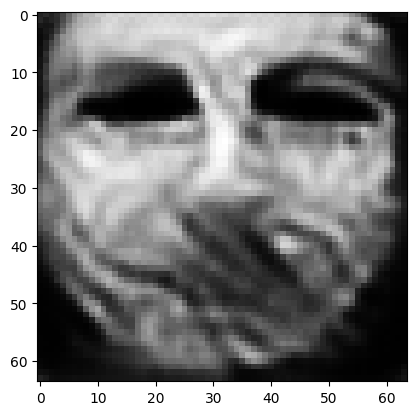

tensor([[1.1731e-04, 1.0191e-06, 2.3104e-03, 1.1386e-06, 1.7972e-05, 3.4921e-03,
         1.0582e-03, 9.9003e-01, 4.5577e-08, 4.4134e-05, 8.2384e-05, 7.6671e-07,
         2.7118e-07, 1.6359e-08, 1.5944e-08, 3.6523e-06, 2.4299e-04, 1.8601e-05,
         3.2902e-05, 4.0568e-04, 2.3641e-08, 3.3835e-07, 2.6950e-10, 1.2699e-05,
         4.3839e-06, 5.7270e-07, 6.8282e-06, 1.6825e-03, 2.9692e-04, 1.9008e-07,
         7.2993e-08, 6.6122e-07, 5.9041e-05, 6.5893e-06, 3.5621e-07, 1.0828e-08,
         3.4844e-07, 2.9623e-05, 1.2642e-05, 2.4208e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010017713531851768
tensor([[1.1696e-04, 1.0145e-06, 2.3035e-03, 1.1337e-06, 1.7888e-05, 3.4822e-03,
         1.0542e-03, 9.9007e-01, 4.5256e-08, 4.4064e-05, 8.2066e-05, 7.6296e-07,
         2.6919e-07, 1.6221e-08, 1.5831e-08, 3.6389e-06, 2.4204e-04, 1.8482e-05,
         3.2776e-05, 4.0362e-04, 2.3461e-08, 3.3694e-07, 2.6717e-10, 1.2659e-05,
         4.3570e-06, 5.7040e-07, 6.7899e-

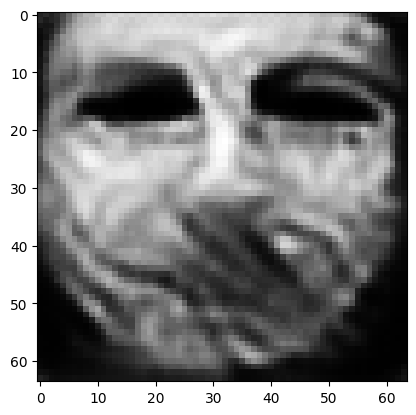

tensor([[1.1578e-04, 9.9659e-07, 2.2770e-03, 1.1135e-06, 1.7566e-05, 3.4433e-03,
         1.0404e-03, 9.9019e-01, 4.4038e-08, 4.3835e-05, 8.0859e-05, 7.5037e-07,
         2.6167e-07, 1.5695e-08, 1.5432e-08, 3.5889e-06, 2.3824e-04, 1.8077e-05,
         3.2274e-05, 3.9655e-04, 2.2796e-08, 3.3200e-07, 2.5820e-10, 1.2519e-05,
         4.2579e-06, 5.6052e-07, 6.6557e-06, 1.6494e-03, 2.9120e-04, 1.8462e-07,
         7.0667e-08, 6.4947e-07, 5.7260e-05, 6.4401e-06, 3.4631e-07, 1.0511e-08,
         3.3743e-07, 2.9081e-05, 1.2345e-05, 2.3592e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009854241274297237
tensor([[1.1545e-04, 9.9240e-07, 2.2709e-03, 1.1091e-06, 1.7490e-05, 3.4343e-03,
         1.0367e-03, 9.9022e-01, 4.3745e-08, 4.3765e-05, 8.0560e-05, 7.4702e-07,
         2.5988e-07, 1.5571e-08, 1.5328e-08, 3.5765e-06, 2.3734e-04, 1.7969e-05,
         3.2160e-05, 3.9459e-04, 2.2633e-08, 3.3072e-07, 2.5612e-10, 1.2481e-05,
         4.2328e-06, 5.5851e-07, 6.6213e-

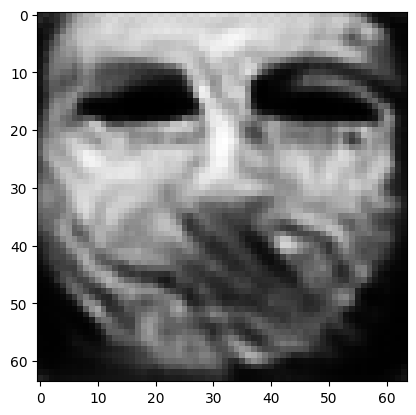

tensor([[1.1437e-04, 9.7661e-07, 2.2467e-03, 1.0916e-06, 1.7209e-05, 3.3986e-03,
         1.0242e-03, 9.9034e-01, 4.2677e-08, 4.3528e-05, 7.9492e-05, 7.3541e-07,
         2.5341e-07, 1.5129e-08, 1.4981e-08, 3.5307e-06, 2.3398e-04, 1.7614e-05,
         3.1714e-05, 3.8829e-04, 2.2053e-08, 3.2627e-07, 2.4849e-10, 1.2353e-05,
         4.1458e-06, 5.5016e-07, 6.5007e-06, 1.6219e-03, 2.8593e-04, 1.7971e-07,
         6.8683e-08, 6.3876e-07, 5.5664e-05, 6.3055e-06, 3.3744e-07, 1.0230e-08,
         3.2803e-07, 2.8598e-05, 1.2073e-05, 2.3035e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00970833282917738
tensor([[1.1411e-04, 9.7297e-07, 2.2409e-03, 1.0875e-06, 1.7144e-05, 3.3910e-03,
         1.0213e-03, 9.9037e-01, 4.2429e-08, 4.3476e-05, 7.9225e-05, 7.3253e-07,
         2.5193e-07, 1.5021e-08, 1.4897e-08, 3.5202e-06, 2.3321e-04, 1.7527e-05,
         3.1608e-05, 3.8685e-04, 2.1917e-08, 3.2520e-07, 2.4670e-10, 1.2325e-05,
         4.1260e-06, 5.4809e-07, 6.4711e-0

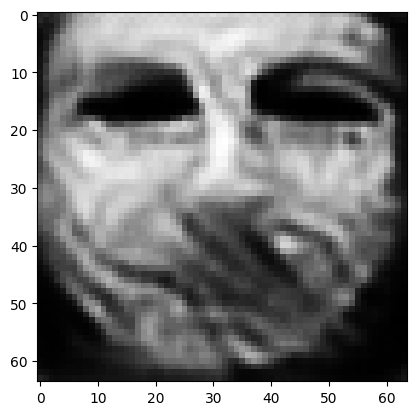

tensor([[1.1315e-04, 9.5893e-07, 2.2184e-03, 1.0717e-06, 1.6891e-05, 3.3581e-03,
         1.0101e-03, 9.9047e-01, 4.1478e-08, 4.3258e-05, 7.8273e-05, 7.2173e-07,
         2.4621e-07, 1.4631e-08, 1.4593e-08, 3.4789e-06, 2.3021e-04, 1.7212e-05,
         3.1209e-05, 3.8134e-04, 2.1402e-08, 3.2116e-07, 2.3998e-10, 1.2213e-05,
         4.0495e-06, 5.4039e-07, 6.3628e-06, 1.5962e-03, 2.8111e-04, 1.7541e-07,
         6.6892e-08, 6.2940e-07, 5.4289e-05, 6.1862e-06, 3.2963e-07, 9.9825e-09,
         3.1948e-07, 2.8159e-05, 1.1838e-05, 2.2537e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009575745090842247
tensor([[1.1291e-04, 9.5582e-07, 2.2129e-03, 1.0680e-06, 1.6827e-05, 3.3503e-03,
         1.0074e-03, 9.9049e-01, 4.1249e-08, 4.3215e-05, 7.8047e-05, 7.1919e-07,
         2.4483e-07, 1.4537e-08, 1.4518e-08, 3.4697e-06, 2.2943e-04, 1.7131e-05,
         3.1122e-05, 3.8002e-04, 2.1274e-08, 3.2017e-07, 2.3836e-10, 1.2183e-05,
         4.0290e-06, 5.3861e-07, 6.3384e-

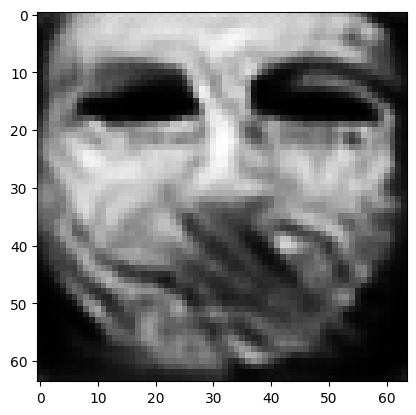

tensor([[1.1208e-04, 9.4262e-07, 2.1917e-03, 1.0532e-06, 1.6594e-05, 3.3192e-03,
         9.9751e-04, 9.9059e-01, 4.0363e-08, 4.3011e-05, 7.7169e-05, 7.0914e-07,
         2.3960e-07, 1.4180e-08, 1.4248e-08, 3.4329e-06, 2.2688e-04, 1.6847e-05,
         3.0755e-05, 3.7508e-04, 2.0809e-08, 3.1651e-07, 2.3232e-10, 1.2096e-05,
         3.9622e-06, 5.3126e-07, 6.2366e-06, 1.5722e-03, 2.7671e-04, 1.7151e-07,
         6.5261e-08, 6.2098e-07, 5.3050e-05, 6.0764e-06, 3.2251e-07, 9.7592e-09,
         3.1176e-07, 2.7754e-05, 1.1619e-05, 2.2070e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009451879188418388
tensor([[1.1188e-04, 9.3968e-07, 2.1865e-03, 1.0499e-06, 1.6534e-05, 3.3114e-03,
         9.9492e-04, 9.9062e-01, 4.0143e-08, 4.2959e-05, 7.6968e-05, 7.0675e-07,
         2.3828e-07, 1.4097e-08, 1.4180e-08, 3.4245e-06, 2.2620e-04, 1.6774e-05,
         3.0677e-05, 3.7376e-04, 2.0692e-08, 3.1557e-07, 2.3085e-10, 1.2069e-05,
         3.9429e-06, 5.2965e-07, 6.2139e-

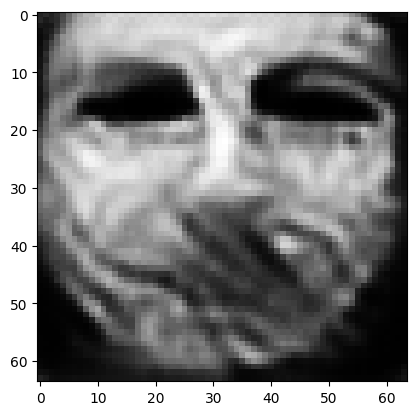

tensor([[1.1119e-04, 9.2755e-07, 2.1667e-03, 1.0367e-06, 1.6320e-05, 3.2820e-03,
         9.8619e-04, 9.9071e-01, 3.9319e-08, 4.2751e-05, 7.6164e-05, 6.9755e-07,
         2.3346e-07, 1.3780e-08, 1.3940e-08, 3.3917e-06, 2.2398e-04, 1.6519e-05,
         3.0350e-05, 3.6904e-04, 2.0271e-08, 3.1216e-07, 2.2546e-10, 1.1996e-05,
         3.8822e-06, 5.2298e-07, 6.1205e-06, 1.5507e-03, 2.7268e-04, 1.6793e-07,
         6.3785e-08, 6.1329e-07, 5.1897e-05, 5.9719e-06, 3.1597e-07, 9.5589e-09,
         3.0500e-07, 2.7388e-05, 1.1404e-05, 2.1625e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009337090887129307
tensor([[1.1100e-04, 9.2461e-07, 2.1620e-03, 1.0336e-06, 1.6268e-05, 3.2750e-03,
         9.8387e-04, 9.9073e-01, 3.9118e-08, 4.2696e-05, 7.5968e-05, 6.9520e-07,
         2.3227e-07, 1.3703e-08, 1.3877e-08, 3.3834e-06, 2.2342e-04, 1.6451e-05,
         3.0272e-05, 3.6778e-04, 2.0165e-08, 3.1128e-07, 2.2415e-10, 1.1975e-05,
         3.8664e-06, 5.2151e-07, 6.0972e-

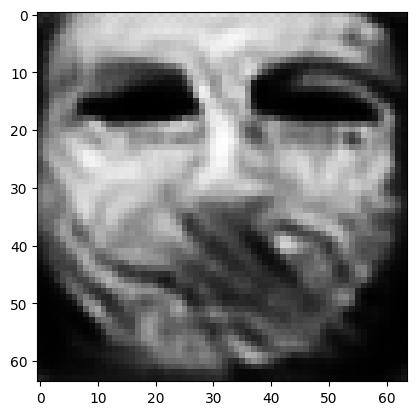

tensor([[1.1036e-04, 9.1343e-07, 2.1429e-03, 1.0209e-06, 1.6063e-05, 3.2483e-03,
         9.7600e-04, 9.9081e-01, 3.8347e-08, 4.2509e-05, 7.5226e-05, 6.8706e-07,
         2.2775e-07, 1.3407e-08, 1.3653e-08, 3.3539e-06, 2.2122e-04, 1.6217e-05,
         2.9968e-05, 3.6350e-04, 1.9773e-08, 3.0811e-07, 2.1905e-10, 1.1902e-05,
         3.8065e-06, 5.1497e-07, 6.0142e-06, 1.5303e-03, 2.6884e-04, 1.6456e-07,
         6.2389e-08, 6.0638e-07, 5.0839e-05, 5.8744e-06, 3.0983e-07, 9.3737e-09,
         2.9872e-07, 2.7041e-05, 1.1200e-05, 2.1210e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009230557829141617
tensor([[1.1021e-04, 9.1057e-07, 2.1382e-03, 1.0177e-06, 1.6014e-05, 3.2422e-03,
         9.7417e-04, 9.9083e-01, 3.8158e-08, 4.2463e-05, 7.5033e-05, 6.8504e-07,
         2.2666e-07, 1.3332e-08, 1.3597e-08, 3.3468e-06, 2.2070e-04, 1.6158e-05,
         2.9891e-05, 3.6245e-04, 1.9678e-08, 3.0733e-07, 2.1781e-10, 1.1887e-05,
         3.7926e-06, 5.1329e-07, 5.9927e-

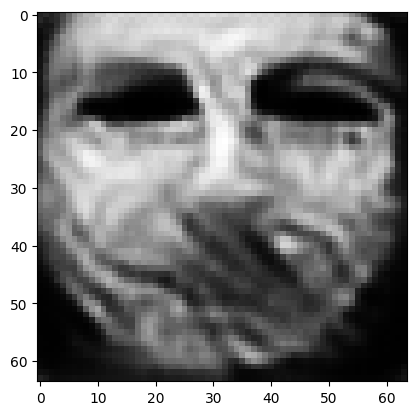

tensor([[1.0960e-04, 8.9940e-07, 2.1200e-03, 1.0051e-06, 1.5811e-05, 3.2169e-03,
         9.6673e-04, 9.9091e-01, 3.7400e-08, 4.2273e-05, 7.4320e-05, 6.7729e-07,
         2.2223e-07, 1.3042e-08, 1.3377e-08, 3.3188e-06, 2.1859e-04, 1.5930e-05,
         2.9591e-05, 3.5818e-04, 1.9305e-08, 3.0432e-07, 2.1289e-10, 1.1819e-05,
         3.7349e-06, 5.0681e-07, 5.9122e-06, 1.5089e-03, 2.6519e-04, 1.6133e-07,
         6.0994e-08, 5.9991e-07, 4.9855e-05, 5.7809e-06, 3.0393e-07, 9.1965e-09,
         2.9256e-07, 2.6698e-05, 1.1006e-05, 2.0817e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009127438999712467
tensor([[1.0943e-04, 8.9672e-07, 2.1157e-03, 1.0022e-06, 1.5761e-05, 3.2109e-03,
         9.6472e-04, 9.9093e-01, 3.7216e-08, 4.2225e-05, 7.4143e-05, 6.7533e-07,
         2.2114e-07, 1.2971e-08, 1.3320e-08, 3.3118e-06, 2.1807e-04, 1.5870e-05,
         2.9520e-05, 3.5703e-04, 1.9212e-08, 3.0355e-07, 2.1170e-10, 1.1800e-05,
         3.7200e-06, 5.0536e-07, 5.8921e-

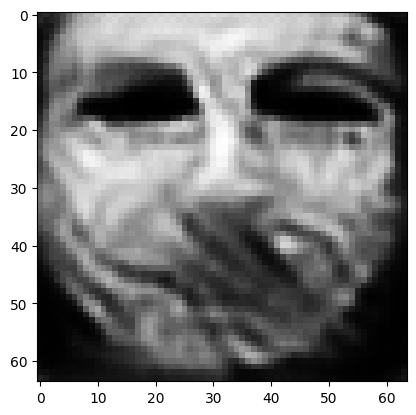

tensor([[1.0885e-04, 8.8641e-07, 2.0987e-03, 9.9048e-07, 1.5570e-05, 3.1874e-03,
         9.5742e-04, 9.9101e-01, 3.6517e-08, 4.2049e-05, 7.3465e-05, 6.6804e-07,
         2.1700e-07, 1.2700e-08, 1.3111e-08, 3.2854e-06, 2.1604e-04, 1.5653e-05,
         2.9240e-05, 3.5295e-04, 1.8863e-08, 3.0067e-07, 2.0713e-10, 1.1732e-05,
         3.6651e-06, 4.9935e-07, 5.8177e-06, 1.4893e-03, 2.6181e-04, 1.5830e-07,
         5.9688e-08, 5.9344e-07, 4.8904e-05, 5.6909e-06, 2.9838e-07, 9.0267e-09,
         2.8679e-07, 2.6376e-05, 1.0818e-05, 2.0452e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009030806832015514
tensor([[1.0873e-04, 8.8393e-07, 2.0947e-03, 9.8766e-07, 1.5526e-05, 3.1816e-03,
         9.5581e-04, 9.9103e-01, 3.6355e-08, 4.2003e-05, 7.3304e-05, 6.6628e-07,
         2.1604e-07, 1.2638e-08, 1.3065e-08, 3.2790e-06, 2.1561e-04, 1.5606e-05,
         2.9173e-05, 3.5203e-04, 1.8784e-08, 3.0000e-07, 2.0609e-10, 1.1718e-05,
         3.6537e-06, 4.9788e-07, 5.7997e-

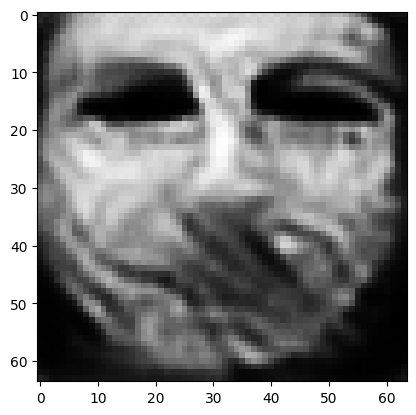

tensor([[1.0820e-04, 8.7452e-07, 2.0791e-03, 9.7706e-07, 1.5352e-05, 3.1597e-03,
         9.4903e-04, 9.9110e-01, 3.5720e-08, 4.1826e-05, 7.2693e-05, 6.5947e-07,
         2.1229e-07, 1.2399e-08, 1.2875e-08, 3.2545e-06, 2.1379e-04, 1.5409e-05,
         2.8920e-05, 3.4818e-04, 1.8468e-08, 2.9733e-07, 2.0201e-10, 1.1654e-05,
         3.6039e-06, 4.9249e-07, 5.7319e-06, 1.4715e-03, 2.5868e-04, 1.5556e-07,
         5.8509e-08, 5.8748e-07, 4.8050e-05, 5.6095e-06, 2.9337e-07, 8.8745e-09,
         2.8165e-07, 2.6081e-05, 1.0647e-05, 2.0115e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008942081592977047
tensor([[1.0806e-04, 8.7228e-07, 2.0753e-03, 9.7450e-07, 1.5310e-05, 3.1548e-03,
         9.4734e-04, 9.9111e-01, 3.5565e-08, 4.1782e-05, 7.2538e-05, 6.5773e-07,
         2.1139e-07, 1.2338e-08, 1.2827e-08, 3.2487e-06, 2.1335e-04, 1.5358e-05,
         2.8858e-05, 3.4720e-04, 1.8391e-08, 2.9664e-07, 2.0101e-10, 1.1637e-05,
         3.5915e-06, 4.9116e-07, 5.7150e-

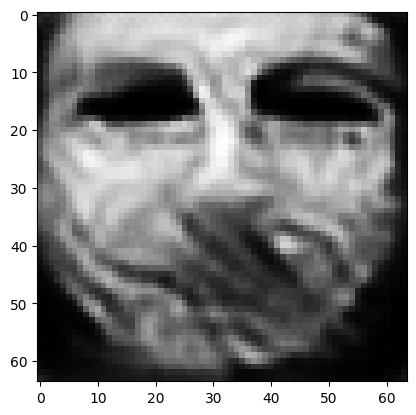

tensor([[1.0758e-04, 8.6339e-07, 2.0611e-03, 9.6462e-07, 1.5153e-05, 3.1346e-03,
         9.4134e-04, 9.9118e-01, 3.4987e-08, 4.1615e-05, 7.1996e-05, 6.5141e-07,
         2.0800e-07, 1.2123e-08, 1.2656e-08, 3.2262e-06, 2.1182e-04, 1.5179e-05,
         2.8624e-05, 3.4366e-04, 1.8107e-08, 2.9420e-07, 1.9734e-10, 1.1586e-05,
         3.5480e-06, 4.8623e-07, 5.6507e-06, 1.4551e-03, 2.5582e-04, 1.5305e-07,
         5.7429e-08, 5.8181e-07, 4.7250e-05, 5.5334e-06, 2.8877e-07, 8.7320e-09,
         2.7688e-07, 2.5798e-05, 1.0491e-05, 1.9804e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008860556408762932
tensor([[1.0745e-04, 8.6132e-07, 2.0578e-03, 9.6239e-07, 1.5116e-05, 3.1299e-03,
         9.3977e-04, 9.9119e-01, 3.4849e-08, 4.1571e-05, 7.1870e-05, 6.4981e-07,
         2.0719e-07, 1.2073e-08, 1.2613e-08, 3.2208e-06, 2.1146e-04, 1.5133e-05,
         2.8571e-05, 3.4273e-04, 1.8038e-08, 2.9359e-07, 1.9648e-10, 1.1572e-05,
         3.5369e-06, 4.8517e-07, 5.6350e-

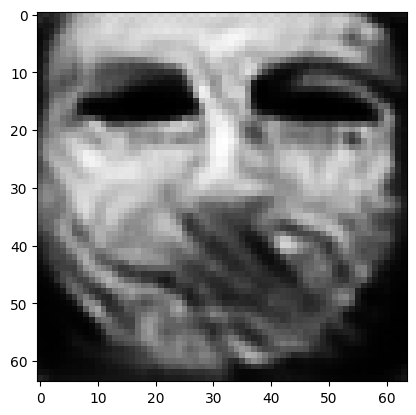

tensor([[1.0701e-04, 8.5342e-07, 2.0446e-03, 9.5381e-07, 1.4974e-05, 3.1109e-03,
         9.3411e-04, 9.9125e-01, 3.4333e-08, 4.1413e-05, 7.1390e-05, 6.4387e-07,
         2.0418e-07, 1.1886e-08, 1.2462e-08, 3.1998e-06, 2.1010e-04, 1.4970e-05,
         2.8365e-05, 3.3952e-04, 1.7783e-08, 2.9133e-07, 1.9327e-10, 1.1525e-05,
         3.4983e-06, 4.8095e-07, 5.5764e-06, 1.4414e-03, 2.5324e-04, 1.5082e-07,
         5.6497e-08, 5.7656e-07, 4.6511e-05, 5.4638e-06, 2.8460e-07, 8.6042e-09,
         2.7273e-07, 2.5549e-05, 1.0347e-05, 1.9520e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008786587044596672
tensor([[1.0692e-04, 8.5162e-07, 2.0414e-03, 9.5170e-07, 1.4939e-05, 3.1063e-03,
         9.3283e-04, 9.9127e-01, 3.4211e-08, 4.1379e-05, 7.1279e-05, 6.4256e-07,
         2.0346e-07, 1.1842e-08, 1.2428e-08, 3.1951e-06, 2.0976e-04, 1.4935e-05,
         2.8315e-05, 3.3882e-04, 1.7723e-08, 2.9081e-07, 1.9250e-10, 1.1513e-05,
         3.4889e-06, 4.7986e-07, 5.5635e-

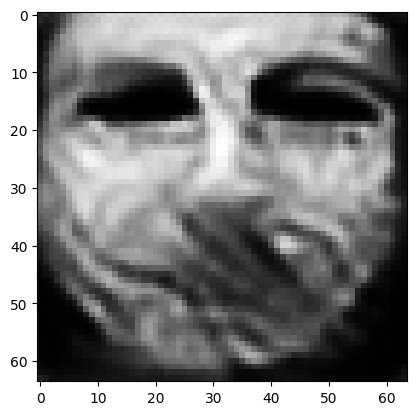

tensor([[1.0648e-04, 8.4458e-07, 2.0293e-03, 9.4399e-07, 1.4812e-05, 3.0888e-03,
         9.2720e-04, 9.9132e-01, 3.3757e-08, 4.1231e-05, 7.0818e-05, 6.3705e-07,
         2.0077e-07, 1.1674e-08, 1.2286e-08, 3.1749e-06, 2.0846e-04, 1.4785e-05,
         2.8120e-05, 3.3587e-04, 1.7491e-08, 2.8870e-07, 1.8964e-10, 1.1463e-05,
         3.4538e-06, 4.7614e-07, 5.5096e-06, 1.4290e-03, 2.5083e-04, 1.4881e-07,
         5.5658e-08, 5.7178e-07, 4.5854e-05, 5.4020e-06, 2.8088e-07, 8.4882e-09,
         2.6894e-07, 2.5328e-05, 1.0219e-05, 1.9264e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008718048222362995
tensor([[1.0637e-04, 8.4285e-07, 2.0264e-03, 9.4217e-07, 1.4782e-05, 3.0843e-03,
         9.2582e-04, 9.9133e-01, 3.3649e-08, 4.1194e-05, 7.0711e-05, 6.3569e-07,
         2.0012e-07, 1.1635e-08, 1.2253e-08, 3.1698e-06, 2.0815e-04, 1.4748e-05,
         2.8073e-05, 3.3515e-04, 1.7436e-08, 2.8819e-07, 1.8897e-10, 1.1452e-05,
         3.4457e-06, 4.7530e-07, 5.4962e-

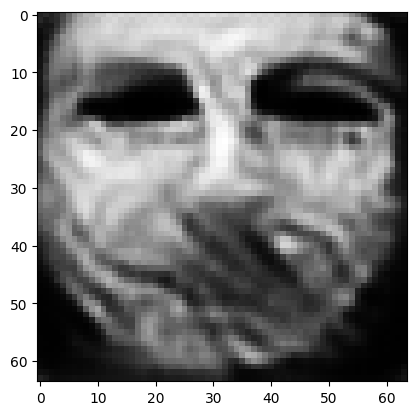

tensor([[1.0596e-04, 8.3649e-07, 2.0152e-03, 9.3502e-07, 1.4663e-05, 3.0680e-03,
         9.2065e-04, 9.9138e-01, 3.3239e-08, 4.1068e-05, 7.0297e-05, 6.3067e-07,
         1.9766e-07, 1.1481e-08, 1.2124e-08, 3.1514e-06, 2.0689e-04, 1.4611e-05,
         2.7898e-05, 3.3256e-04, 1.7224e-08, 2.8627e-07, 1.8632e-10, 1.1403e-05,
         3.4127e-06, 4.7182e-07, 5.4487e-06, 1.4180e-03, 2.4864e-04, 1.4696e-07,
         5.4906e-08, 5.6729e-07, 4.5251e-05, 5.3460e-06, 2.7743e-07, 8.3807e-09,
         2.6546e-07, 2.5125e-05, 1.0102e-05, 1.9030e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008654467761516571
tensor([[1.0587e-04, 8.3493e-07, 2.0125e-03, 9.3335e-07, 1.4637e-05, 3.0640e-03,
         9.1944e-04, 9.9139e-01, 3.3144e-08, 4.1035e-05, 7.0196e-05, 6.2941e-07,
         1.9710e-07, 1.1446e-08, 1.2095e-08, 3.1468e-06, 2.0663e-04, 1.4578e-05,
         2.7856e-05, 3.3194e-04, 1.7174e-08, 2.8581e-07, 1.8573e-10, 1.1393e-05,
         3.4058e-06, 4.7103e-07, 5.4366e-

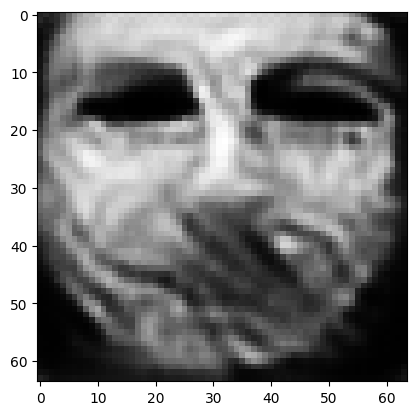

tensor([[1.0550e-04, 8.2920e-07, 2.0021e-03, 9.2693e-07, 1.4531e-05, 3.0489e-03,
         9.1472e-04, 9.9144e-01, 3.2779e-08, 4.0914e-05, 6.9810e-05, 6.2467e-07,
         1.9491e-07, 1.1309e-08, 1.1980e-08, 3.1298e-06, 2.0551e-04, 1.4452e-05,
         2.7698e-05, 3.2960e-04, 1.6983e-08, 2.8403e-07, 1.8338e-10, 1.1351e-05,
         3.3767e-06, 4.6792e-07, 5.3922e-06, 1.4078e-03, 2.4660e-04, 1.4529e-07,
         5.4239e-08, 5.6315e-07, 4.4707e-05, 5.2950e-06, 2.7434e-07, 8.2836e-09,
         2.6229e-07, 2.4937e-05, 1.0000e-05, 1.8818e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008596557192504406
tensor([[1.0540e-04, 8.2780e-07, 1.9994e-03, 9.2497e-07, 1.4503e-05, 3.0456e-03,
         9.1373e-04, 9.9145e-01, 3.2692e-08, 4.0895e-05, 6.9713e-05, 6.2384e-07,
         1.9437e-07, 1.1271e-08, 1.1952e-08, 3.1258e-06, 2.0510e-04, 1.4425e-05,
         2.7651e-05, 3.2912e-04, 1.6937e-08, 2.8364e-07, 1.8272e-10, 1.1335e-05,
         3.3683e-06, 4.6688e-07, 5.3848e-

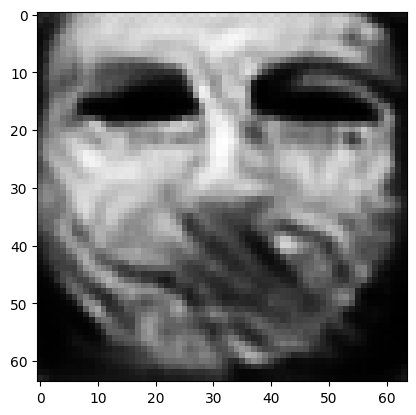

tensor([[1.0508e-04, 8.2246e-07, 1.9900e-03, 9.1914e-07, 1.4408e-05, 3.0308e-03,
         9.0940e-04, 9.9149e-01, 3.2360e-08, 4.0780e-05, 6.9374e-05, 6.1946e-07,
         1.9239e-07, 1.1151e-08, 1.1853e-08, 3.1099e-06, 2.0417e-04, 1.4314e-05,
         2.7509e-05, 3.2698e-04, 1.6766e-08, 2.8206e-07, 1.8065e-10, 1.1302e-05,
         3.3436e-06, 4.6410e-07, 5.3427e-06, 1.3984e-03, 2.4475e-04, 1.4377e-07,
         5.3607e-08, 5.5958e-07, 4.4227e-05, 5.2503e-06, 2.7150e-07, 8.1963e-09,
         2.5938e-07, 2.4767e-05, 9.9063e-06, 1.8624e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008543016389012337
tensor([[1.0498e-04, 8.2118e-07, 1.9878e-03, 9.1783e-07, 1.4385e-05, 3.0272e-03,
         9.0822e-04, 9.9150e-01, 3.2279e-08, 4.0749e-05, 6.9292e-05, 6.1832e-07,
         1.9190e-07, 1.1122e-08, 1.1826e-08, 3.1059e-06, 2.0393e-04, 1.4282e-05,
         2.7476e-05, 3.2638e-04, 1.6722e-08, 2.8166e-07, 1.8015e-10, 1.1292e-05,
         3.3369e-06, 4.6353e-07, 5.3320e-

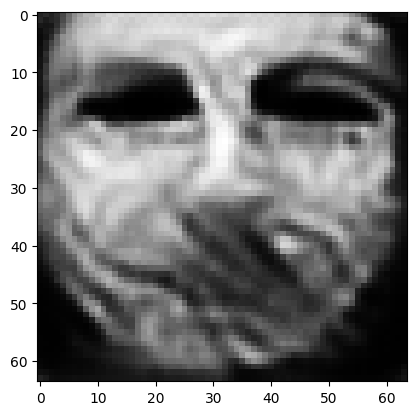

tensor([[1.0468e-04, 8.1619e-07, 1.9790e-03, 9.1221e-07, 1.4295e-05, 3.0139e-03,
         9.0421e-04, 9.9154e-01, 3.1968e-08, 4.0646e-05, 6.8970e-05, 6.1438e-07,
         1.9004e-07, 1.1008e-08, 1.1732e-08, 3.0913e-06, 2.0299e-04, 1.4178e-05,
         2.7339e-05, 3.2438e-04, 1.6562e-08, 2.8018e-07, 1.7815e-10, 1.1258e-05,
         3.3127e-06, 4.6077e-07, 5.2942e-06, 1.3900e-03, 2.4300e-04, 1.4235e-07,
         5.3040e-08, 5.5599e-07, 4.3755e-05, 5.2063e-06, 2.6885e-07, 8.1132e-09,
         2.5673e-07, 2.4605e-05, 9.8170e-06, 1.8441e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008493018336594105
tensor([[1.0461e-04, 8.1496e-07, 1.9769e-03, 9.1092e-07, 1.4273e-05, 3.0106e-03,
         9.0324e-04, 9.9155e-01, 3.1892e-08, 4.0619e-05, 6.8894e-05, 6.1339e-07,
         1.8959e-07, 1.0981e-08, 1.1710e-08, 3.0877e-06, 2.0279e-04, 1.4153e-05,
         2.7306e-05, 3.2389e-04, 1.6524e-08, 2.7982e-07, 1.7769e-10, 1.1251e-05,
         3.3073e-06, 4.6014e-07, 5.2844e-

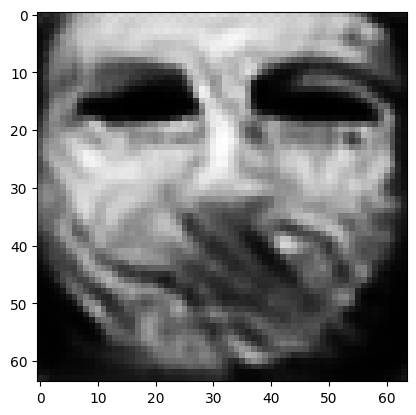

tensor([[1.0432e-04, 8.1032e-07, 1.9684e-03, 9.0560e-07, 1.4188e-05, 2.9984e-03,
         8.9959e-04, 9.9159e-01, 3.1603e-08, 4.0527e-05, 6.8586e-05, 6.0974e-07,
         1.8786e-07, 1.0872e-08, 1.1622e-08, 3.0742e-06, 2.0187e-04, 1.4056e-05,
         2.7176e-05, 3.2207e-04, 1.6374e-08, 2.7843e-07, 1.7580e-10, 1.1218e-05,
         3.2844e-06, 4.5745e-07, 5.2496e-06, 1.3816e-03, 2.4135e-04, 1.4103e-07,
         5.2496e-08, 5.5283e-07, 4.3330e-05, 5.1661e-06, 2.6641e-07, 8.0368e-09,
         2.5419e-07, 2.4453e-05, 9.7352e-06, 1.8271e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00844609085470438
tensor([[1.0423e-04, 8.0929e-07, 1.9662e-03, 9.0415e-07, 1.4165e-05, 2.9958e-03,
         8.9867e-04, 9.9160e-01, 3.1536e-08, 4.0512e-05, 6.8506e-05, 6.0901e-07,
         1.8743e-07, 1.0842e-08, 1.1598e-08, 3.0711e-06, 2.0151e-04, 1.4032e-05,
         2.7141e-05, 3.2164e-04, 1.6336e-08, 2.7809e-07, 1.7528e-10, 1.1203e-05,
         3.2769e-06, 4.5668e-07, 5.2436e-0

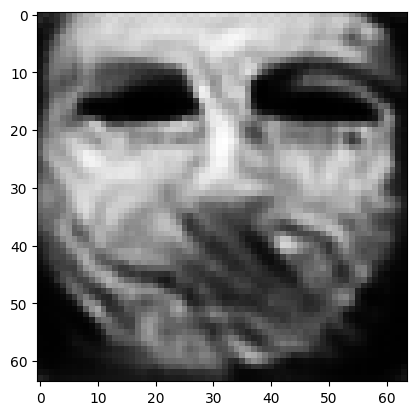

tensor([[1.0395e-04, 8.0519e-07, 1.9581e-03, 8.9944e-07, 1.4089e-05, 2.9840e-03,
         8.9528e-04, 9.9163e-01, 3.1283e-08, 4.0429e-05, 6.8223e-05, 6.0562e-07,
         1.8591e-07, 1.0747e-08, 1.1520e-08, 3.0583e-06, 2.0063e-04, 1.3944e-05,
         2.7023e-05, 3.2004e-04, 1.6201e-08, 2.7682e-07, 1.7363e-10, 1.1172e-05,
         3.2564e-06, 4.5433e-07, 5.2121e-06, 1.3742e-03, 2.3983e-04, 1.3980e-07,
         5.1991e-08, 5.5005e-07, 4.2946e-05, 5.1302e-06, 2.6413e-07, 7.9674e-09,
         2.5182e-07, 2.4313e-05, 9.6596e-06, 1.8122e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008402472361922264
tensor([[1.0388e-04, 8.0421e-07, 1.9562e-03, 8.9835e-07, 1.4071e-05, 2.9812e-03,
         8.9441e-04, 9.9164e-01, 3.1221e-08, 4.0406e-05, 6.8151e-05, 6.0471e-07,
         1.8555e-07, 1.0723e-08, 1.1501e-08, 3.0552e-06, 2.0044e-04, 1.3922e-05,
         2.6996e-05, 3.1963e-04, 1.6167e-08, 2.7650e-07, 1.7324e-10, 1.1165e-05,
         3.2516e-06, 4.5379e-07, 5.2036e-

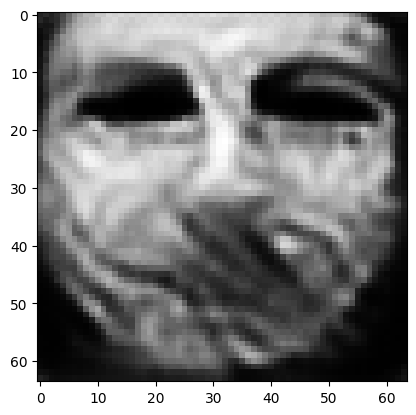

tensor([[1.0361e-04, 8.0038e-07, 1.9487e-03, 8.9398e-07, 1.4000e-05, 2.9701e-03,
         8.9112e-04, 9.9167e-01, 3.0988e-08, 4.0327e-05, 6.7886e-05, 6.0156e-07,
         1.8413e-07, 1.0634e-08, 1.1426e-08, 3.0429e-06, 1.9958e-04, 1.3838e-05,
         2.6884e-05, 3.1811e-04, 1.6040e-08, 2.7531e-07, 1.7171e-10, 1.1132e-05,
         3.2320e-06, 4.5166e-07, 5.1747e-06, 1.3675e-03, 2.3838e-04, 1.3868e-07,
         5.1553e-08, 5.4731e-07, 4.2586e-05, 5.0963e-06, 2.6205e-07, 7.9031e-09,
         2.4971e-07, 2.4187e-05, 9.5914e-06, 1.7981e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008361569605767727
tensor([[1.0355e-04, 7.9943e-07, 1.9469e-03, 8.9295e-07, 1.3984e-05, 2.9674e-03,
         8.9035e-04, 9.9168e-01, 3.0934e-08, 4.0306e-05, 6.7820e-05, 6.0075e-07,
         1.8380e-07, 1.0614e-08, 1.1410e-08, 3.0398e-06, 1.9940e-04, 1.3819e-05,
         2.6858e-05, 3.1777e-04, 1.6011e-08, 2.7503e-07, 1.7137e-10, 1.1126e-05,
         3.2280e-06, 4.5115e-07, 5.1671e-

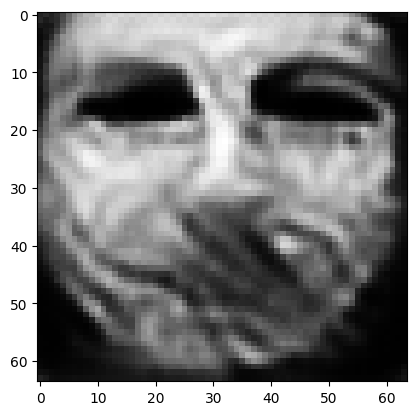

tensor([[1.0331e-04, 7.9562e-07, 1.9396e-03, 8.8863e-07, 1.3915e-05, 2.9567e-03,
         8.8744e-04, 9.9171e-01, 3.0709e-08, 4.0230e-05, 6.7564e-05, 5.9777e-07,
         1.8244e-07, 1.0528e-08, 1.1341e-08, 3.0284e-06, 1.9858e-04, 1.3744e-05,
         2.6748e-05, 3.1637e-04, 1.5891e-08, 2.7391e-07, 1.6989e-10, 1.1098e-05,
         3.2097e-06, 4.4897e-07, 5.1392e-06, 1.3607e-03, 2.3700e-04, 1.3762e-07,
         5.1127e-08, 5.4488e-07, 4.2263e-05, 5.0648e-06, 2.6008e-07, 7.8438e-09,
         2.4769e-07, 2.4069e-05, 9.5276e-06, 1.7846e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00832220260053873
tensor([[1.0325e-04, 7.9470e-07, 1.9378e-03, 8.8765e-07, 1.3899e-05, 2.9541e-03,
         8.8669e-04, 9.9172e-01, 3.0654e-08, 4.0209e-05, 6.7500e-05, 5.9697e-07,
         1.8211e-07, 1.0507e-08, 1.1324e-08, 3.0256e-06, 1.9841e-04, 1.3724e-05,
         2.6724e-05, 3.1600e-04, 1.5861e-08, 2.7363e-07, 1.6954e-10, 1.1092e-05,
         3.2054e-06, 4.4849e-07, 5.1316e-0

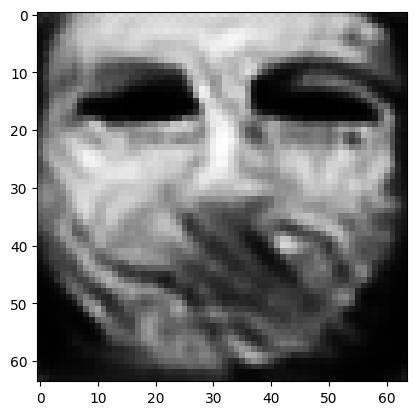

tensor([[1.0301e-04, 7.9109e-07, 1.9310e-03, 8.8376e-07, 1.3834e-05, 2.9438e-03,
         8.8378e-04, 9.9175e-01, 3.0439e-08, 4.0132e-05, 6.7261e-05, 5.9398e-07,
         1.8082e-07, 1.0428e-08, 1.1258e-08, 3.0147e-06, 1.9770e-04, 1.3648e-05,
         2.6626e-05, 3.1462e-04, 1.5747e-08, 2.7255e-07, 1.6819e-10, 1.1068e-05,
         3.1882e-06, 4.4660e-07, 5.1034e-06, 1.3545e-03, 2.3567e-04, 1.3663e-07,
         5.0743e-08, 5.4239e-07, 4.1942e-05, 5.0335e-06, 2.5820e-07, 7.7862e-09,
         2.4579e-07, 2.3956e-05, 9.4663e-06, 1.7715e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00828484445810318
tensor([[1.0294e-04, 7.9013e-07, 1.9292e-03, 8.8253e-07, 1.3817e-05, 2.9415e-03,
         8.8315e-04, 9.9176e-01, 3.0386e-08, 4.0116e-05, 6.7194e-05, 5.9335e-07,
         1.8049e-07, 1.0405e-08, 1.1240e-08, 3.0119e-06, 1.9746e-04, 1.3631e-05,
         2.6595e-05, 3.1430e-04, 1.5718e-08, 2.7229e-07, 1.6781e-10, 1.1059e-05,
         3.1835e-06, 4.4597e-07, 5.0976e-0

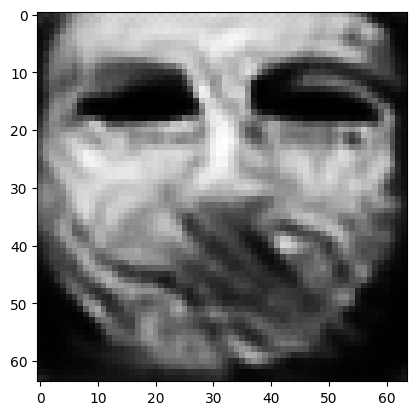

tensor([[1.0271e-04, 7.8656e-07, 1.9227e-03, 8.7861e-07, 1.3754e-05, 2.9317e-03,
         8.8044e-04, 9.9179e-01, 3.0180e-08, 4.0042e-05, 6.6956e-05, 5.9055e-07,
         1.7925e-07, 1.0326e-08, 1.1175e-08, 3.0011e-06, 1.9675e-04, 1.3559e-05,
         2.6497e-05, 3.1295e-04, 1.5608e-08, 2.7126e-07, 1.6649e-10, 1.1033e-05,
         3.1668e-06, 4.4405e-07, 5.0711e-06, 1.3480e-03, 2.3443e-04, 1.3563e-07,
         5.0339e-08, 5.4008e-07, 4.1644e-05, 5.0045e-06, 2.5635e-07, 7.7301e-09,
         2.4389e-07, 2.3842e-05, 9.4070e-06, 1.7592e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008248666301369667
tensor([[1.0266e-04, 7.8564e-07, 1.9211e-03, 8.7766e-07, 1.3740e-05, 2.9293e-03,
         8.7981e-04, 9.9179e-01, 3.0131e-08, 4.0023e-05, 6.6896e-05, 5.8985e-07,
         1.7896e-07, 1.0308e-08, 1.1160e-08, 2.9984e-06, 1.9661e-04, 1.3542e-05,
         2.6472e-05, 3.1263e-04, 1.5583e-08, 2.7102e-07, 1.6619e-10, 1.1029e-05,
         3.1636e-06, 4.4358e-07, 5.0641e-

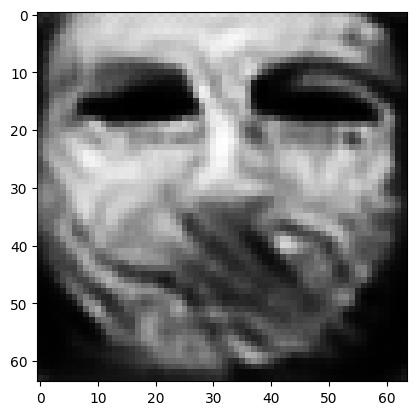

tensor([[1.0244e-04, 7.8228e-07, 1.9149e-03, 8.7380e-07, 1.3681e-05, 2.9205e-03,
         8.7725e-04, 9.9182e-01, 2.9935e-08, 3.9955e-05, 6.6658e-05, 5.8724e-07,
         1.7778e-07, 1.0230e-08, 1.1097e-08, 2.9884e-06, 1.9589e-04, 1.3473e-05,
         2.6374e-05, 3.1134e-04, 1.5477e-08, 2.7001e-07, 1.6489e-10, 1.1003e-05,
         3.1471e-06, 4.4161e-07, 5.0396e-06, 1.3417e-03, 2.3323e-04, 1.3468e-07,
         4.9963e-08, 5.3781e-07, 4.1360e-05, 4.9767e-06, 2.5463e-07, 7.6762e-09,
         2.4210e-07, 2.3731e-05, 9.3524e-06, 1.7474e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00821461621671915
tensor([[1.0240e-04, 7.8142e-07, 1.9135e-03, 8.7293e-07, 1.3668e-05, 2.9181e-03,
         8.7667e-04, 9.9183e-01, 2.9890e-08, 3.9937e-05, 6.6604e-05, 5.8657e-07,
         1.7751e-07, 1.0213e-08, 1.1084e-08, 2.9858e-06, 1.9576e-04, 1.3458e-05,
         2.6352e-05, 3.1104e-04, 1.5453e-08, 2.6979e-07, 1.6462e-10, 1.1000e-05,
         3.1441e-06, 4.4119e-07, 5.0330e-0

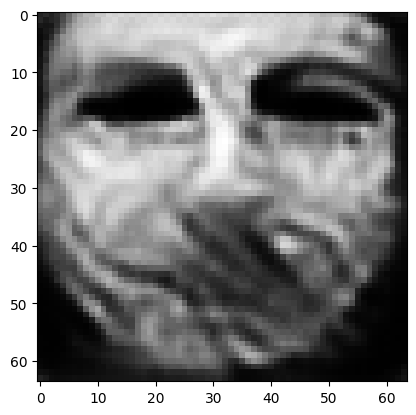

tensor([[1.0219e-04, 7.7819e-07, 1.9076e-03, 8.6925e-07, 1.3611e-05, 2.9096e-03,
         8.7428e-04, 9.9185e-01, 2.9704e-08, 3.9873e-05, 6.6381e-05, 5.8412e-07,
         1.7639e-07, 1.0140e-08, 1.1025e-08, 2.9763e-06, 1.9509e-04, 1.3394e-05,
         2.6260e-05, 3.0984e-04, 1.5354e-08, 2.6885e-07, 1.6340e-10, 1.0976e-05,
         3.1288e-06, 4.3932e-07, 5.0098e-06, 1.3358e-03, 2.3211e-04, 1.3379e-07,
         4.9611e-08, 5.3570e-07, 4.1097e-05, 4.9506e-06, 2.5300e-07, 7.6262e-09,
         2.4042e-07, 2.3628e-05, 9.3007e-06, 1.7361e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008182455785572529
tensor([[1.0214e-04, 7.7741e-07, 1.9062e-03, 8.6845e-07, 1.3598e-05, 2.9073e-03,
         8.7366e-04, 9.9186e-01, 2.9660e-08, 3.9855e-05, 6.6327e-05, 5.8345e-07,
         1.7612e-07, 1.0123e-08, 1.1011e-08, 2.9739e-06, 1.9496e-04, 1.3377e-05,
         2.6239e-05, 3.0953e-04, 1.5330e-08, 2.6862e-07, 1.6313e-10, 1.0971e-05,
         3.1255e-06, 4.3895e-07, 5.0034e-

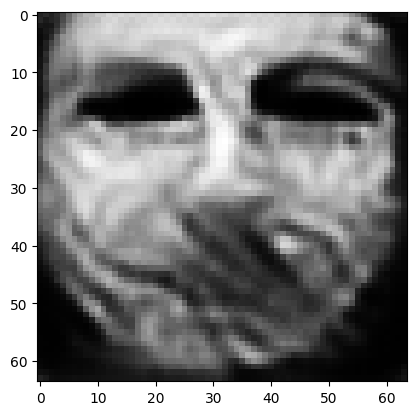

tensor([[1.0195e-04, 7.7439e-07, 1.9006e-03, 8.6509e-07, 1.3547e-05, 2.8989e-03,
         8.7142e-04, 9.9188e-01, 2.9488e-08, 3.9792e-05, 6.6121e-05, 5.8111e-07,
         1.7509e-07, 1.0058e-08, 1.0959e-08, 2.9649e-06, 1.9436e-04, 1.3319e-05,
         2.6155e-05, 3.0842e-04, 1.5239e-08, 2.6775e-07, 1.6203e-10, 1.0951e-05,
         3.1116e-06, 4.3726e-07, 4.9814e-06, 1.3306e-03, 2.3105e-04, 1.3296e-07,
         4.9291e-08, 5.3371e-07, 4.0845e-05, 4.9261e-06, 2.5148e-07, 7.5798e-09,
         2.3889e-07, 2.3534e-05, 9.2517e-06, 1.7254e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008151713758707047
tensor([[1.0190e-04, 7.7364e-07, 1.8993e-03, 8.6431e-07, 1.3534e-05, 2.8968e-03,
         8.7082e-04, 9.9189e-01, 2.9446e-08, 3.9774e-05, 6.6069e-05, 5.8048e-07,
         1.7484e-07, 1.0043e-08, 1.0945e-08, 2.9626e-06, 1.9422e-04, 1.3303e-05,
         2.6135e-05, 3.0813e-04, 1.5216e-08, 2.6752e-07, 1.6177e-10, 1.0946e-05,
         3.1084e-06, 4.3689e-07, 4.9753e-

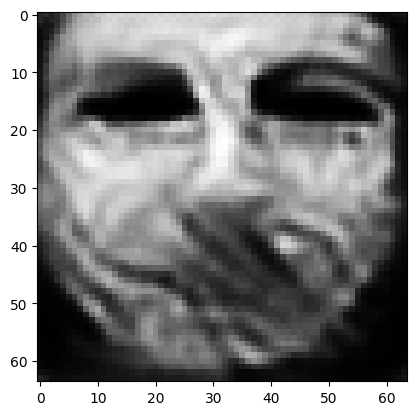

tensor([[1.0173e-04, 7.7073e-07, 1.8940e-03, 8.6111e-07, 1.3484e-05, 2.8887e-03,
         8.6862e-04, 9.9191e-01, 2.9282e-08, 3.9712e-05, 6.5874e-05, 5.7820e-07,
         1.7384e-07, 9.9808e-09, 1.0896e-08, 2.9538e-06, 1.9365e-04, 1.3248e-05,
         2.6055e-05, 3.0706e-04, 1.5129e-08, 2.6669e-07, 1.6072e-10, 1.0927e-05,
         3.0954e-06, 4.3530e-07, 4.9541e-06, 1.3256e-03, 2.3004e-04, 1.3218e-07,
         4.8983e-08, 5.3176e-07, 4.0601e-05, 4.9024e-06, 2.5004e-07, 7.5351e-09,
         2.3742e-07, 2.3443e-05, 9.2048e-06, 1.7151e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008122152648866177
tensor([[1.0168e-04, 7.7003e-07, 1.8928e-03, 8.6040e-07, 1.3473e-05, 2.8867e-03,
         8.6804e-04, 9.9192e-01, 2.9242e-08, 3.9695e-05, 6.5827e-05, 5.7759e-07,
         1.7360e-07, 9.9663e-09, 1.0883e-08, 2.9517e-06, 1.9353e-04, 1.3233e-05,
         2.6037e-05, 3.0677e-04, 1.5107e-08, 2.6648e-07, 1.6048e-10, 1.0922e-05,
         3.0924e-06, 4.3497e-07, 4.9483e-

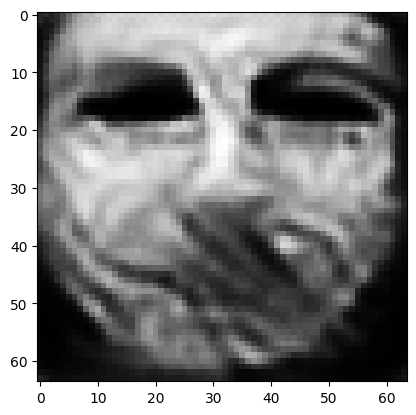

tensor([[1.0151e-04, 7.6728e-07, 1.8878e-03, 8.5739e-07, 1.3426e-05, 2.8789e-03,
         8.6596e-04, 9.9194e-01, 2.9089e-08, 3.9637e-05, 6.5642e-05, 5.7543e-07,
         1.7266e-07, 9.9082e-09, 1.0837e-08, 2.9433e-06, 1.9300e-04, 1.3180e-05,
         2.5962e-05, 3.0576e-04, 1.5025e-08, 2.6568e-07, 1.5950e-10, 1.0904e-05,
         3.0802e-06, 4.3347e-07, 4.9283e-06, 1.3210e-03, 2.2908e-04, 1.3144e-07,
         4.8696e-08, 5.2990e-07, 4.0370e-05, 4.8800e-06, 2.4867e-07, 7.4931e-09,
         2.3605e-07, 2.3358e-05, 9.1606e-06, 1.7055e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00809448305517435
tensor([[1.0147e-04, 7.6662e-07, 1.8866e-03, 8.5673e-07, 1.3415e-05, 2.8771e-03,
         8.6540e-04, 9.9194e-01, 2.9051e-08, 3.9621e-05, 6.5596e-05, 5.7485e-07,
         1.7244e-07, 9.8945e-09, 1.0825e-08, 2.9413e-06, 1.9288e-04, 1.3166e-05,
         2.5945e-05, 3.0550e-04, 1.5005e-08, 2.6548e-07, 1.5927e-10, 1.0900e-05,
         3.0773e-06, 4.3316e-07, 4.9228e-0

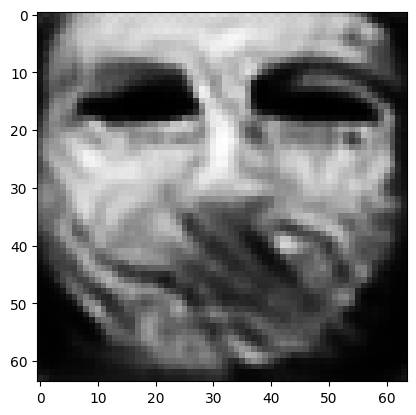

tensor([[1.0130e-04, 7.6408e-07, 1.8819e-03, 8.5391e-07, 1.3370e-05, 2.8700e-03,
         8.6340e-04, 9.9196e-01, 2.8905e-08, 3.9564e-05, 6.5426e-05, 5.7280e-07,
         1.7155e-07, 9.8398e-09, 1.0780e-08, 2.9335e-06, 1.9236e-04, 1.3114e-05,
         2.5876e-05, 3.0452e-04, 1.4926e-08, 2.6471e-07, 1.5833e-10, 1.0880e-05,
         3.0651e-06, 4.3176e-07, 4.9042e-06, 1.3168e-03, 2.2819e-04, 1.3074e-07,
         4.8424e-08, 5.2807e-07, 4.0146e-05, 4.8583e-06, 2.4737e-07, 7.4527e-09,
         2.3474e-07, 2.3276e-05, 9.1176e-06, 1.6965e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008068585768342018
tensor([[1.0126e-04, 7.6346e-07, 1.8808e-03, 8.5329e-07, 1.3360e-05, 2.8681e-03,
         8.6292e-04, 9.9197e-01, 2.8870e-08, 3.9548e-05, 6.5387e-05, 5.7227e-07,
         1.7135e-07, 9.8280e-09, 1.0770e-08, 2.9315e-06, 1.9227e-04, 1.3103e-05,
         2.5860e-05, 3.0428e-04, 1.4908e-08, 2.6452e-07, 1.5813e-10, 1.0877e-05,
         3.0627e-06, 4.3147e-07, 4.8992e-

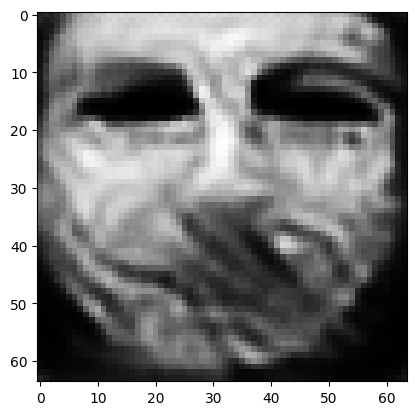

tensor([[1.0110e-04, 7.6110e-07, 1.8764e-03, 8.5073e-07, 1.3318e-05, 2.8613e-03,
         8.6106e-04, 9.9199e-01, 2.8736e-08, 3.9491e-05, 6.5231e-05, 5.7033e-07,
         1.7053e-07, 9.7790e-09, 1.0728e-08, 2.9241e-06, 1.9181e-04, 1.3055e-05,
         2.5797e-05, 3.0335e-04, 1.4837e-08, 2.6380e-07, 1.5729e-10, 1.0859e-05,
         3.0518e-06, 4.3024e-07, 4.8815e-06, 1.3131e-03, 2.2737e-04, 1.3010e-07,
         4.8179e-08, 5.2636e-07, 3.9939e-05, 4.8384e-06, 2.4617e-07, 7.4159e-09,
         2.3357e-07, 2.3201e-05, 9.0775e-06, 1.6880e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00804469920694828
tensor([[1.0107e-04, 7.6053e-07, 1.8754e-03, 8.5015e-07, 1.3309e-05, 2.8596e-03,
         8.6061e-04, 9.9199e-01, 2.8704e-08, 3.9477e-05, 6.5195e-05, 5.6984e-07,
         1.7034e-07, 9.7679e-09, 1.0719e-08, 2.9223e-06, 1.9171e-04, 1.3044e-05,
         2.5783e-05, 3.0312e-04, 1.4820e-08, 2.6363e-07, 1.5710e-10, 1.0856e-05,
         3.0495e-06, 4.2996e-07, 4.8770e-0

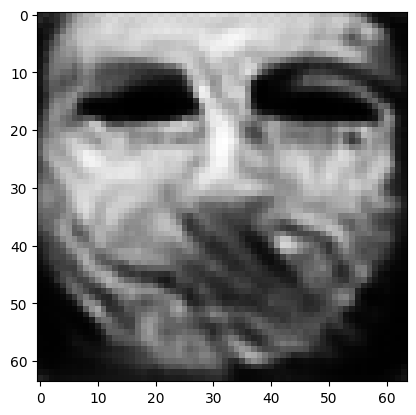

tensor([[1.0091e-04, 7.5833e-07, 1.8713e-03, 8.4775e-07, 1.3269e-05, 2.8533e-03,
         8.5885e-04, 9.9201e-01, 2.8577e-08, 3.9424e-05, 6.5050e-05, 5.6801e-07,
         1.6958e-07, 9.7217e-09, 1.0680e-08, 2.9155e-06, 1.9128e-04, 1.2999e-05,
         2.5724e-05, 3.0223e-04, 1.4752e-08, 2.6294e-07, 1.5630e-10, 1.0839e-05,
         3.0388e-06, 4.2880e-07, 4.8605e-06, 1.3098e-03, 2.2660e-04, 1.2950e-07,
         4.7948e-08, 5.2472e-07, 3.9740e-05, 4.8195e-06, 2.4504e-07, 7.3810e-09,
         2.3246e-07, 2.3130e-05, 9.0391e-06, 1.6800e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008022230118513107
tensor([[1.0088e-04, 7.5782e-07, 1.8703e-03, 8.4718e-07, 1.3260e-05, 2.8516e-03,
         8.5845e-04, 9.9201e-01, 2.8546e-08, 3.9412e-05, 6.5018e-05, 5.6759e-07,
         1.6939e-07, 9.7109e-09, 1.0671e-08, 2.9140e-06, 1.9118e-04, 1.2989e-05,
         2.5711e-05, 3.0204e-04, 1.4736e-08, 2.6278e-07, 1.5611e-10, 1.0835e-05,
         3.0363e-06, 4.2851e-07, 4.8566e-

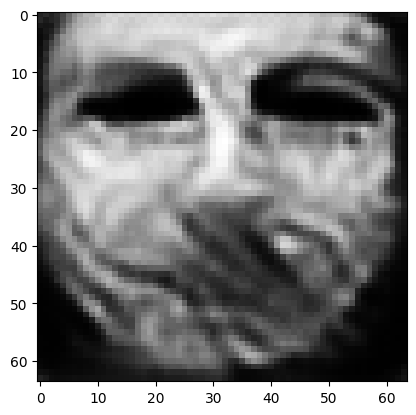

tensor([[1.0075e-04, 7.5574e-07, 1.8665e-03, 8.4501e-07, 1.3223e-05, 2.8454e-03,
         8.5683e-04, 9.9203e-01, 2.8426e-08, 3.9361e-05, 6.4886e-05, 5.6582e-07,
         1.6868e-07, 9.6695e-09, 1.0636e-08, 2.9075e-06, 1.9082e-04, 1.2947e-05,
         2.5659e-05, 3.0122e-04, 1.4674e-08, 2.6214e-07, 1.5539e-10, 1.0822e-05,
         3.0271e-06, 4.2746e-07, 4.8404e-06, 1.3066e-03, 2.2588e-04, 1.2896e-07,
         4.7737e-08, 5.2323e-07, 3.9557e-05, 4.8020e-06, 2.4400e-07, 7.3490e-09,
         2.3144e-07, 2.3065e-05, 9.0034e-06, 1.6724e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008001062087714672
tensor([[1.0071e-04, 7.5522e-07, 1.8655e-03, 8.4438e-07, 1.3214e-05, 2.8441e-03,
         8.5646e-04, 9.9204e-01, 2.8398e-08, 3.9351e-05, 6.4851e-05, 5.6546e-07,
         1.6851e-07, 9.6581e-09, 1.0627e-08, 2.9060e-06, 1.9070e-04, 1.2937e-05,
         2.5643e-05, 3.0103e-04, 1.4659e-08, 2.6199e-07, 1.5520e-10, 1.0817e-05,
         3.0246e-06, 4.2715e-07, 4.8371e-

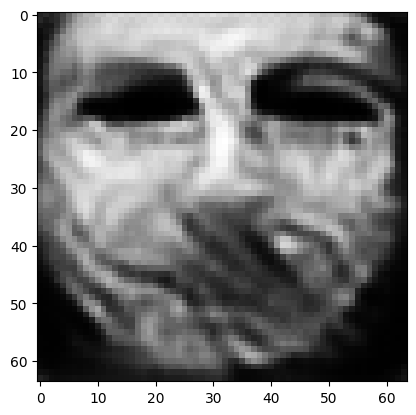

tensor([[1.0059e-04, 7.5340e-07, 1.8620e-03, 8.4241e-07, 1.3182e-05, 2.8384e-03,
         8.5499e-04, 9.9205e-01, 2.8293e-08, 3.9307e-05, 6.4731e-05, 5.6388e-07,
         1.6788e-07, 9.6209e-09, 1.0595e-08, 2.9001e-06, 1.9035e-04, 1.2900e-05,
         2.5595e-05, 3.0031e-04, 1.4603e-08, 2.6142e-07, 1.5455e-10, 1.0804e-05,
         3.0161e-06, 4.2621e-07, 4.8226e-06, 1.3037e-03, 2.2522e-04, 1.2844e-07,
         4.7541e-08, 5.2190e-07, 3.9392e-05, 4.7865e-06, 2.4303e-07, 7.3199e-09,
         2.3049e-07, 2.3005e-05, 8.9717e-06, 1.6657e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007981549017131329
tensor([[1.0056e-04, 7.5297e-07, 1.8611e-03, 8.4191e-07, 1.3174e-05, 2.8370e-03,
         8.5466e-04, 9.9205e-01, 2.8267e-08, 3.9297e-05, 6.4703e-05, 5.6352e-07,
         1.6772e-07, 9.6119e-09, 1.0588e-08, 2.8988e-06, 1.9027e-04, 1.2892e-05,
         2.5584e-05, 3.0015e-04, 1.4590e-08, 2.6128e-07, 1.5440e-10, 1.0801e-05,
         3.0140e-06, 4.2596e-07, 4.8195e-

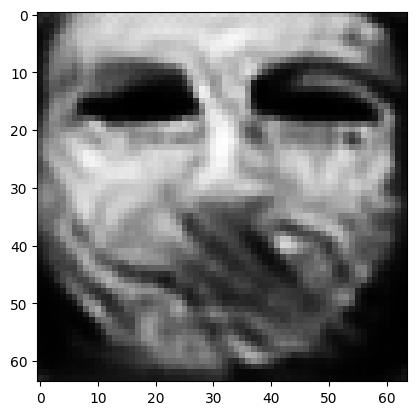

tensor([[1.0044e-04, 7.5124e-07, 1.8577e-03, 8.4003e-07, 1.3143e-05, 2.8316e-03,
         8.5327e-04, 9.9207e-01, 2.8167e-08, 3.9255e-05, 6.4591e-05, 5.6203e-07,
         1.6712e-07, 9.5769e-09, 1.0558e-08, 2.8932e-06, 1.8993e-04, 1.2856e-05,
         2.5539e-05, 2.9947e-04, 1.4536e-08, 2.6074e-07, 1.5378e-10, 1.0789e-05,
         3.0058e-06, 4.2508e-07, 4.8058e-06, 1.3011e-03, 2.2460e-04, 1.2797e-07,
         4.7363e-08, 5.2068e-07, 3.9238e-05, 4.7720e-06, 2.4212e-07, 7.2933e-09,
         2.2961e-07, 2.2950e-05, 8.9415e-06, 1.6593e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007963337004184723
tensor([[1.0041e-04, 7.5081e-07, 1.8568e-03, 8.3959e-07, 1.3136e-05, 2.8303e-03,
         8.5294e-04, 9.9207e-01, 2.8143e-08, 3.9244e-05, 6.4564e-05, 5.6165e-07,
         1.6698e-07, 9.5690e-09, 1.0551e-08, 2.8919e-06, 1.8986e-04, 1.2848e-05,
         2.5528e-05, 2.9930e-04, 1.4524e-08, 2.6061e-07, 1.5364e-10, 1.0786e-05,
         3.0040e-06, 4.2488e-07, 4.8023e-

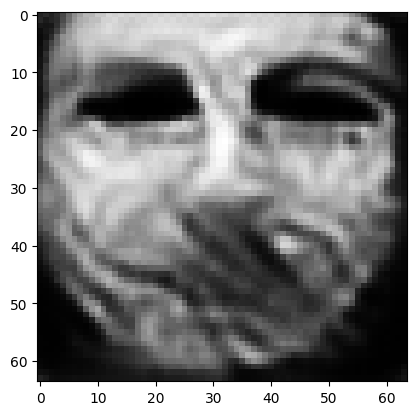

tensor([[1.0029e-04, 7.4918e-07, 1.8536e-03, 8.3782e-07, 1.3107e-05, 2.8252e-03,
         8.5161e-04, 9.9209e-01, 2.8049e-08, 3.9203e-05, 6.4458e-05, 5.6024e-07,
         1.6641e-07, 9.5360e-09, 1.0523e-08, 2.8867e-06, 1.8955e-04, 1.2814e-05,
         2.5485e-05, 2.9865e-04, 1.4474e-08, 2.6009e-07, 1.5307e-10, 1.0774e-05,
         2.9962e-06, 4.2405e-07, 4.7893e-06, 1.2987e-03, 2.2400e-04, 1.2753e-07,
         4.7199e-08, 5.1949e-07, 3.9089e-05, 4.7580e-06, 2.4126e-07, 7.2680e-09,
         2.2879e-07, 2.2897e-05, 8.9131e-06, 1.6532e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007945952005684376
tensor([[1.0026e-04, 7.4878e-07, 1.8528e-03, 8.3727e-07, 1.3099e-05, 2.8241e-03,
         8.5133e-04, 9.9209e-01, 2.8025e-08, 3.9196e-05, 6.4430e-05, 5.5997e-07,
         1.6626e-07, 9.5265e-09, 1.0516e-08, 2.8855e-06, 1.8943e-04, 1.2807e-05,
         2.5473e-05, 2.9851e-04, 1.4461e-08, 2.5997e-07, 1.5290e-10, 1.0770e-05,
         2.9938e-06, 4.2376e-07, 4.7872e-

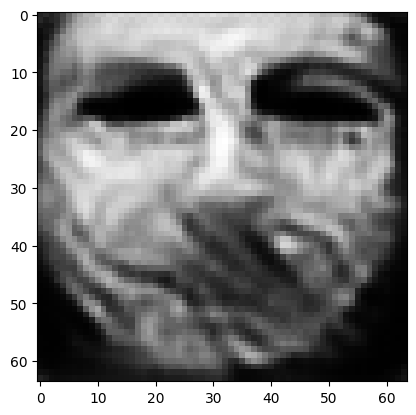

tensor([[1.0016e-04, 7.4722e-07, 1.8497e-03, 8.3564e-07, 1.3072e-05, 2.8191e-03,
         8.5011e-04, 9.9210e-01, 2.7936e-08, 3.9156e-05, 6.4329e-05, 5.5860e-07,
         1.6573e-07, 9.4965e-09, 1.0490e-08, 2.8805e-06, 1.8917e-04, 1.2776e-05,
         2.5433e-05, 2.9790e-04, 1.4414e-08, 2.5948e-07, 1.5238e-10, 1.0761e-05,
         2.9871e-06, 4.2300e-07, 4.7744e-06, 1.2963e-03, 2.2344e-04, 1.2710e-07,
         4.7036e-08, 5.1844e-07, 3.8952e-05, 4.7451e-06, 2.4044e-07, 7.2444e-09,
         2.2801e-07, 2.2847e-05, 8.8862e-06, 1.6474e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007929394952952862
tensor([[1.0014e-04, 7.4685e-07, 1.8489e-03, 8.3520e-07, 1.3065e-05, 2.8179e-03,
         8.4984e-04, 9.9211e-01, 2.7915e-08, 3.9148e-05, 6.4307e-05, 5.5830e-07,
         1.6560e-07, 9.4891e-09, 1.0485e-08, 2.8794e-06, 1.8909e-04, 1.2769e-05,
         2.5423e-05, 2.9777e-04, 1.4403e-08, 2.5937e-07, 1.5224e-10, 1.0758e-05,
         2.9854e-06, 4.2278e-07, 4.7717e-

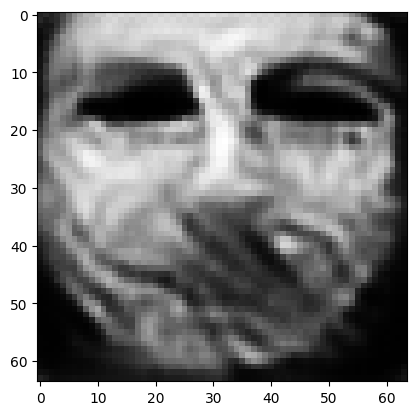

tensor([[1.0004e-04, 7.4541e-07, 1.8460e-03, 8.3361e-07, 1.3040e-05, 2.8135e-03,
         8.4872e-04, 9.9212e-01, 2.7832e-08, 3.9114e-05, 6.4210e-05, 5.5706e-07,
         1.6511e-07, 9.4602e-09, 1.0461e-08, 2.8749e-06, 1.8883e-04, 1.2741e-05,
         2.5385e-05, 2.9724e-04, 1.4359e-08, 2.5892e-07, 1.5174e-10, 1.0749e-05,
         2.9788e-06, 4.2200e-07, 4.7603e-06, 1.2940e-03, 2.2290e-04, 1.2672e-07,
         4.6885e-08, 5.1748e-07, 3.8827e-05, 4.7332e-06, 2.3969e-07, 7.2226e-09,
         2.2727e-07, 2.2801e-05, 8.8618e-06, 1.6421e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007914138026535511
tensor([[1.0002e-04, 7.4504e-07, 1.8452e-03, 8.3314e-07, 1.3034e-05, 2.8124e-03,
         8.4847e-04, 9.9212e-01, 2.7812e-08, 3.9106e-05, 6.4185e-05, 5.5681e-07,
         1.6499e-07, 9.4523e-09, 1.0455e-08, 2.8737e-06, 1.8873e-04, 1.2735e-05,
         2.5373e-05, 2.9711e-04, 1.4348e-08, 2.5881e-07, 1.5160e-10, 1.0746e-05,
         2.9771e-06, 4.2176e-07, 4.7581e-

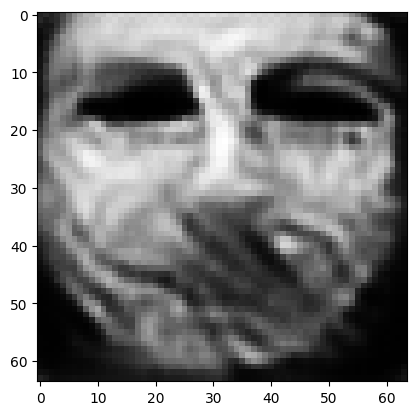

tensor([[9.9928e-05, 7.4368e-07, 1.8425e-03, 8.3163e-07, 1.3010e-05, 2.8082e-03,
         8.4740e-04, 9.9213e-01, 2.7735e-08, 3.9074e-05, 6.4095e-05, 5.5563e-07,
         1.6452e-07, 9.4252e-09, 1.0433e-08, 2.8695e-06, 1.8848e-04, 1.2708e-05,
         2.5337e-05, 2.9662e-04, 1.4307e-08, 2.5839e-07, 1.5113e-10, 1.0738e-05,
         2.9710e-06, 4.2103e-07, 4.7473e-06, 1.2918e-03, 2.2238e-04, 1.2635e-07,
         4.6739e-08, 5.1657e-07, 3.8710e-05, 4.7220e-06, 2.3898e-07, 7.2018e-09,
         2.2656e-07, 2.2757e-05, 8.8389e-06, 1.6370e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007899590767920017
tensor([[9.9904e-05, 7.4336e-07, 1.8418e-03, 8.3128e-07, 1.3004e-05, 2.8071e-03,
         8.4713e-04, 9.9213e-01, 2.7716e-08, 3.9066e-05, 6.4073e-05, 5.5533e-07,
         1.6441e-07, 9.4186e-09, 1.0427e-08, 2.8684e-06, 1.8842e-04, 1.2701e-05,
         2.5328e-05, 2.9649e-04, 1.4297e-08, 2.5828e-07, 1.5101e-10, 1.0735e-05,
         2.9695e-06, 4.2086e-07, 4.7446e-

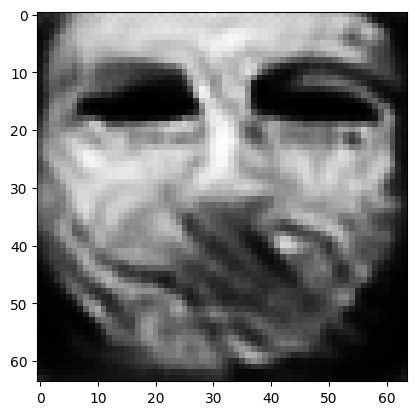

tensor([[9.9814e-05, 7.4203e-07, 1.8391e-03, 8.2972e-07, 1.2981e-05, 2.8033e-03,
         8.4611e-04, 9.9215e-01, 2.7641e-08, 3.9036e-05, 6.3982e-05, 5.5427e-07,
         1.6395e-07, 9.3908e-09, 1.0404e-08, 2.8644e-06, 1.8814e-04, 1.2676e-05,
         2.5290e-05, 2.9600e-04, 1.4257e-08, 2.5787e-07, 1.5053e-10, 1.0725e-05,
         2.9631e-06, 4.2009e-07, 4.7348e-06, 1.2896e-03, 2.2189e-04, 1.2598e-07,
         4.6596e-08, 5.1567e-07, 3.8596e-05, 4.7111e-06, 2.3830e-07, 7.1814e-09,
         2.2587e-07, 2.2713e-05, 8.8166e-06, 1.6323e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007885634899139404
tensor([[9.9792e-05, 7.4168e-07, 1.8385e-03, 8.2935e-07, 1.2975e-05, 2.8022e-03,
         8.4588e-04, 9.9215e-01, 2.7622e-08, 3.9029e-05, 6.3961e-05, 5.5400e-07,
         1.6384e-07, 9.3840e-09, 1.0399e-08, 2.8634e-06, 1.8808e-04, 1.2670e-05,
         2.5281e-05, 2.9589e-04, 1.4247e-08, 2.5777e-07, 1.5041e-10, 1.0724e-05,
         2.9618e-06, 4.1990e-07, 4.7322e-

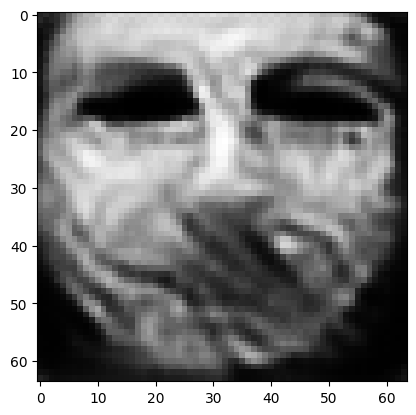

tensor([[9.9710e-05, 7.4037e-07, 1.8359e-03, 8.2787e-07, 1.2951e-05, 2.7982e-03,
         8.4499e-04, 9.9216e-01, 2.7548e-08, 3.9006e-05, 6.3879e-05, 5.5300e-07,
         1.6339e-07, 9.3570e-09, 1.0378e-08, 2.8599e-06, 1.8783e-04, 1.2645e-05,
         2.5245e-05, 2.9546e-04, 1.4208e-08, 2.5739e-07, 1.4993e-10, 1.0717e-05,
         2.9558e-06, 4.1912e-07, 4.7226e-06, 1.2872e-03, 2.2143e-04, 1.2564e-07,
         4.6454e-08, 5.1489e-07, 3.8492e-05, 4.7005e-06, 2.3765e-07, 7.1625e-09,
         2.2519e-07, 2.2671e-05, 8.7951e-06, 1.6276e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007871914654970169
tensor([[9.9686e-05, 7.4005e-07, 1.8353e-03, 8.2751e-07, 1.2945e-05, 2.7973e-03,
         8.4474e-04, 9.9216e-01, 2.7530e-08, 3.9000e-05, 6.3858e-05, 5.5274e-07,
         1.6328e-07, 9.3502e-09, 1.0373e-08, 2.8591e-06, 1.8776e-04, 1.2639e-05,
         2.5236e-05, 2.9534e-04, 1.4199e-08, 2.5729e-07, 1.4980e-10, 1.0714e-05,
         2.9542e-06, 4.1894e-07, 4.7202e-

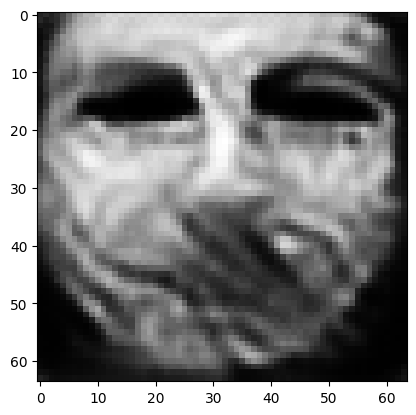

tensor([[9.9608e-05, 7.3877e-07, 1.8328e-03, 8.2610e-07, 1.2923e-05, 2.7935e-03,
         8.4390e-04, 9.9217e-01, 2.7459e-08, 3.8977e-05, 6.3778e-05, 5.5176e-07,
         1.6286e-07, 9.3245e-09, 1.0353e-08, 2.8557e-06, 1.8753e-04, 1.2616e-05,
         2.5201e-05, 2.9492e-04, 1.4162e-08, 2.5693e-07, 1.4935e-10, 1.0708e-05,
         2.9487e-06, 4.1820e-07, 4.7107e-06, 1.2849e-03, 2.2098e-04, 1.2532e-07,
         4.6319e-08, 5.1411e-07, 3.8390e-05, 4.6901e-06, 2.3702e-07, 7.1441e-09,
         2.2453e-07, 2.2630e-05, 8.7746e-06, 1.6231e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007858550176024437
tensor([[9.9589e-05, 7.3846e-07, 1.8322e-03, 8.2576e-07, 1.2918e-05, 2.7926e-03,
         8.4369e-04, 9.9217e-01, 2.7442e-08, 3.8971e-05, 6.3758e-05, 5.5153e-07,
         1.6275e-07, 9.3183e-09, 1.0348e-08, 2.8548e-06, 1.8747e-04, 1.2610e-05,
         2.5193e-05, 2.9482e-04, 1.4154e-08, 2.5684e-07, 1.4924e-10, 1.0707e-05,
         2.9475e-06, 4.1802e-07, 4.7084e-

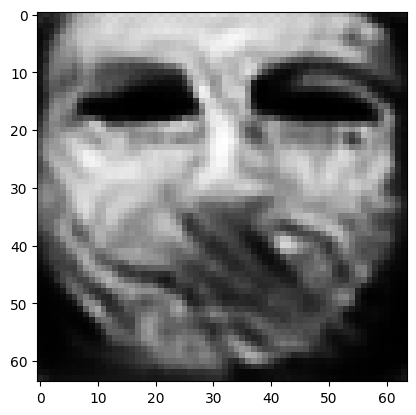

tensor([[9.9516e-05, 7.3726e-07, 1.8299e-03, 8.2442e-07, 1.2897e-05, 2.7889e-03,
         8.4289e-04, 9.9218e-01, 2.7376e-08, 3.8950e-05, 6.3684e-05, 5.5062e-07,
         1.6235e-07, 9.2941e-09, 1.0330e-08, 2.8516e-06, 1.8724e-04, 1.2589e-05,
         2.5160e-05, 2.9443e-04, 1.4119e-08, 2.5650e-07, 1.4880e-10, 1.0701e-05,
         2.9422e-06, 4.1732e-07, 4.6997e-06, 1.2827e-03, 2.2056e-04, 1.2501e-07,
         4.6189e-08, 5.1341e-07, 3.8297e-05, 4.6806e-06, 2.3644e-07, 7.1272e-09,
         2.2392e-07, 2.2593e-05, 8.7553e-06, 1.6189e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007846012711524963
tensor([[9.9494e-05, 7.3698e-07, 1.8294e-03, 8.2409e-07, 1.2891e-05, 2.7881e-03,
         8.4267e-04, 9.9219e-01, 2.7360e-08, 3.8946e-05, 6.3664e-05, 5.5040e-07,
         1.6225e-07, 9.2879e-09, 1.0325e-08, 2.8508e-06, 1.8718e-04, 1.2583e-05,
         2.5152e-05, 2.9433e-04, 1.4110e-08, 2.5642e-07, 1.4869e-10, 1.0699e-05,
         2.9408e-06, 4.1715e-07, 4.6976e-

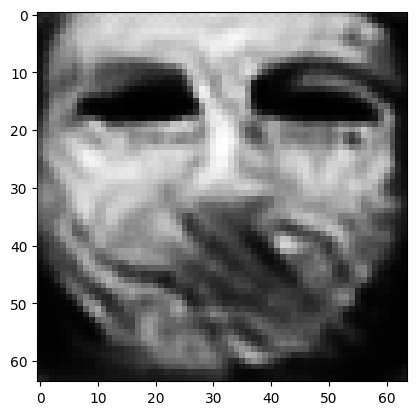

tensor([[9.9423e-05, 7.3585e-07, 1.8272e-03, 8.2283e-07, 1.2872e-05, 2.7846e-03,
         8.4191e-04, 9.9220e-01, 2.7298e-08, 3.8926e-05, 6.3593e-05, 5.4954e-07,
         1.6187e-07, 9.2651e-09, 1.0307e-08, 2.8477e-06, 1.8697e-04, 1.2562e-05,
         2.5121e-05, 2.9396e-04, 1.4078e-08, 2.5610e-07, 1.4829e-10, 1.0693e-05,
         2.9360e-06, 4.1649e-07, 4.6893e-06, 1.2807e-03, 2.2017e-04, 1.2473e-07,
         4.6069e-08, 5.1272e-07, 3.8208e-05, 4.6716e-06, 2.3588e-07, 7.1110e-09,
         2.2332e-07, 2.2557e-05, 8.7377e-06, 1.6150e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00783406663686037
tensor([[9.9405e-05, 7.3558e-07, 1.8267e-03, 8.2252e-07, 1.2867e-05, 2.7838e-03,
         8.4171e-04, 9.9220e-01, 2.7282e-08, 3.8921e-05, 6.3575e-05, 5.4932e-07,
         1.6177e-07, 9.2592e-09, 1.0302e-08, 2.8470e-06, 1.8692e-04, 1.2556e-05,
         2.5114e-05, 2.9386e-04, 1.4070e-08, 2.5601e-07, 1.4819e-10, 1.0691e-05,
         2.9347e-06, 4.1634e-07, 4.6871e-0

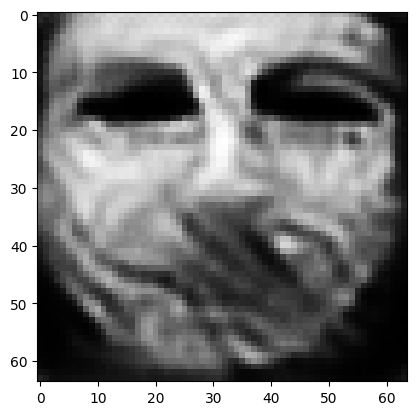

tensor([[9.9336e-05, 7.3448e-07, 1.8246e-03, 8.2128e-07, 1.2848e-05, 2.7806e-03,
         8.4101e-04, 9.9221e-01, 2.7224e-08, 3.8904e-05, 6.3508e-05, 5.4855e-07,
         1.6141e-07, 9.2367e-09, 1.0285e-08, 2.8441e-06, 1.8670e-04, 1.2537e-05,
         2.5083e-05, 2.9350e-04, 1.4039e-08, 2.5571e-07, 1.4779e-10, 1.0685e-05,
         2.9299e-06, 4.1568e-07, 4.6795e-06, 1.2786e-03, 2.1981e-04, 1.2445e-07,
         4.5949e-08, 5.1208e-07, 3.8123e-05, 4.6629e-06, 2.3535e-07, 7.0955e-09,
         2.2276e-07, 2.2523e-05, 8.7205e-06, 1.6114e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00782282929867506
tensor([[9.9321e-05, 7.3422e-07, 1.8242e-03, 8.2099e-07, 1.2844e-05, 2.7798e-03,
         8.4084e-04, 9.9221e-01, 2.7209e-08, 3.8900e-05, 6.3492e-05, 5.4835e-07,
         1.6132e-07, 9.2316e-09, 1.0282e-08, 2.8434e-06, 1.8665e-04, 1.2532e-05,
         2.5076e-05, 2.9341e-04, 1.4032e-08, 2.5564e-07, 1.4770e-10, 1.0684e-05,
         2.9289e-06, 4.1553e-07, 4.6775e-0

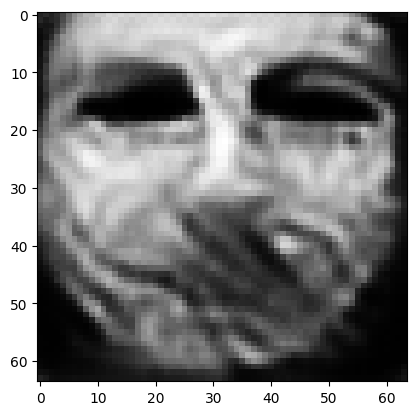

tensor([[9.9256e-05, 7.3319e-07, 1.8222e-03, 8.1986e-07, 1.2826e-05, 2.7767e-03,
         8.4015e-04, 9.9222e-01, 2.7153e-08, 3.8883e-05, 6.3429e-05, 5.4758e-07,
         1.6098e-07, 9.2108e-09, 1.0266e-08, 2.8406e-06, 1.8647e-04, 1.2513e-05,
         2.5048e-05, 2.9307e-04, 1.4003e-08, 2.5535e-07, 1.4734e-10, 1.0679e-05,
         2.9245e-06, 4.1494e-07, 4.6699e-06, 1.2768e-03, 2.1946e-04, 1.2419e-07,
         4.5841e-08, 5.1146e-07, 3.8043e-05, 4.6547e-06, 2.3486e-07, 7.0810e-09,
         2.2224e-07, 2.2491e-05, 8.7046e-06, 1.6078e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007812420837581158
tensor([[9.9242e-05, 7.3294e-07, 1.8218e-03, 8.1959e-07, 1.2822e-05, 2.7759e-03,
         8.3998e-04, 9.9222e-01, 2.7140e-08, 3.8879e-05, 6.3413e-05, 5.4739e-07,
         1.6089e-07, 9.2059e-09, 1.0262e-08, 2.8400e-06, 1.8642e-04, 1.2508e-05,
         2.5042e-05, 2.9299e-04, 1.3996e-08, 2.5528e-07, 1.4725e-10, 1.0678e-05,
         2.9234e-06, 4.1480e-07, 4.6680e-

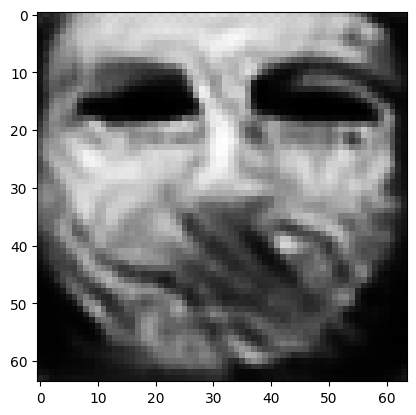

tensor([[9.9182e-05, 7.3199e-07, 1.8200e-03, 8.1852e-07, 1.2805e-05, 2.7730e-03,
         8.3933e-04, 9.9223e-01, 2.7087e-08, 3.8863e-05, 6.3354e-05, 5.4668e-07,
         1.6057e-07, 9.1862e-09, 1.0247e-08, 2.8375e-06, 1.8624e-04, 1.2491e-05,
         2.5016e-05, 2.9267e-04, 1.3968e-08, 2.5501e-07, 1.4690e-10, 1.0673e-05,
         2.9192e-06, 4.1423e-07, 4.6610e-06, 1.2750e-03, 2.1914e-04, 1.2395e-07,
         4.5737e-08, 5.1089e-07, 3.7967e-05, 4.6470e-06, 2.3439e-07, 7.0673e-09,
         2.2174e-07, 2.2461e-05, 8.6895e-06, 1.6045e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007802367210388184
tensor([[9.9168e-05, 7.3175e-07, 1.8195e-03, 8.1826e-07, 1.2801e-05, 2.7722e-03,
         8.3918e-04, 9.9223e-01, 2.7074e-08, 3.8859e-05, 6.3340e-05, 5.4650e-07,
         1.6049e-07, 9.1815e-09, 1.0243e-08, 2.8368e-06, 1.8620e-04, 1.2486e-05,
         2.5009e-05, 2.9259e-04, 1.3962e-08, 2.5494e-07, 1.4682e-10, 1.0673e-05,
         2.9182e-06, 4.1409e-07, 4.6593e-

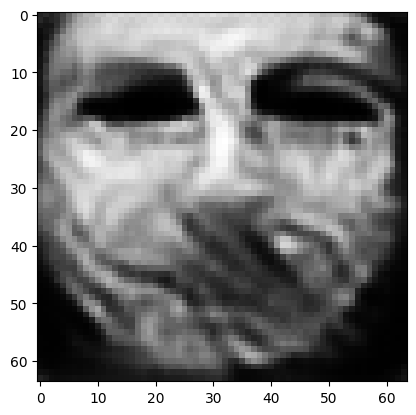

tensor([[9.9110e-05, 7.3083e-07, 1.8178e-03, 8.1724e-07, 1.2785e-05, 2.7694e-03,
         8.3856e-04, 9.9224e-01, 2.7023e-08, 3.8844e-05, 6.3283e-05, 5.4581e-07,
         1.6018e-07, 9.1629e-09, 1.0229e-08, 2.8344e-06, 1.8603e-04, 1.2469e-05,
         2.4984e-05, 2.9228e-04, 1.3935e-08, 2.5468e-07, 1.4649e-10, 1.0668e-05,
         2.9143e-06, 4.1357e-07, 4.6524e-06, 1.2733e-03, 2.1883e-04, 1.2372e-07,
         4.5639e-08, 5.1033e-07, 3.7895e-05, 4.6396e-06, 2.3395e-07, 7.0543e-09,
         2.2127e-07, 2.2433e-05, 8.6753e-06, 1.6013e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007792667951434851
tensor([[9.9094e-05, 7.3059e-07, 1.8174e-03, 8.1694e-07, 1.2780e-05, 2.7688e-03,
         8.3842e-04, 9.9224e-01, 2.7011e-08, 3.8841e-05, 6.3268e-05, 5.4567e-07,
         1.6010e-07, 9.1578e-09, 1.0225e-08, 2.8337e-06, 1.8597e-04, 1.2465e-05,
         2.4977e-05, 2.9221e-04, 1.3929e-08, 2.5462e-07, 1.4640e-10, 1.0666e-05,
         2.9132e-06, 4.1340e-07, 4.6510e-

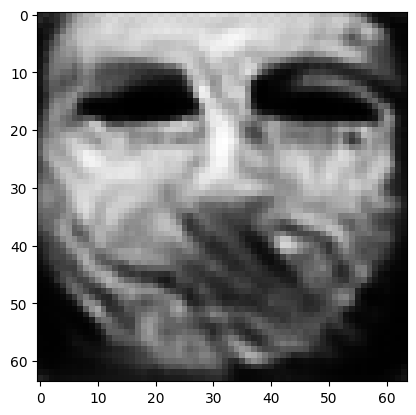

tensor([[9.9040e-05, 7.2972e-07, 1.8157e-03, 8.1599e-07, 1.2766e-05, 2.7662e-03,
         8.3783e-04, 9.9225e-01, 2.6964e-08, 3.8826e-05, 6.3214e-05, 5.4501e-07,
         1.5981e-07, 9.1402e-09, 1.0212e-08, 2.8314e-06, 1.8581e-04, 1.2449e-05,
         2.4953e-05, 2.9192e-04, 1.3904e-08, 2.5437e-07, 1.4609e-10, 1.0662e-05,
         2.9095e-06, 4.1290e-07, 4.6445e-06, 1.2716e-03, 2.1853e-04, 1.2350e-07,
         4.5543e-08, 5.0982e-07, 3.7827e-05, 4.6327e-06, 2.3353e-07, 7.0419e-09,
         2.2082e-07, 2.2405e-05, 8.6616e-06, 1.5984e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007783796638250351
tensor([[9.9028e-05, 7.2951e-07, 1.8154e-03, 8.1575e-07, 1.2762e-05, 2.7655e-03,
         8.3770e-04, 9.9225e-01, 2.6952e-08, 3.8823e-05, 6.3202e-05, 5.4486e-07,
         1.5974e-07, 9.1361e-09, 1.0209e-08, 2.8309e-06, 1.8578e-04, 1.2446e-05,
         2.4948e-05, 2.9185e-04, 1.3899e-08, 2.5432e-07, 1.4602e-10, 1.0662e-05,
         2.9087e-06, 4.1278e-07, 4.6429e-

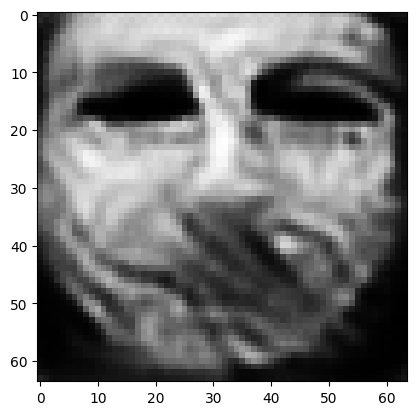

tensor([[9.8976e-05, 7.2868e-07, 1.8138e-03, 8.1485e-07, 1.2748e-05, 2.7630e-03,
         8.3714e-04, 9.9225e-01, 2.6907e-08, 3.8809e-05, 6.3151e-05, 5.4423e-07,
         1.5946e-07, 9.1196e-09, 1.0196e-08, 2.8287e-06, 1.8563e-04, 1.2430e-05,
         2.4925e-05, 2.9157e-04, 1.3875e-08, 2.5408e-07, 1.4573e-10, 1.0658e-05,
         2.9051e-06, 4.1231e-07, 4.6367e-06, 1.2701e-03, 2.1825e-04, 1.2329e-07,
         4.5456e-08, 5.0933e-07, 3.7763e-05, 4.6261e-06, 2.3313e-07, 7.0304e-09,
         2.2040e-07, 2.2379e-05, 8.6489e-06, 1.5955e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007775161415338516
tensor([[9.8965e-05, 7.2849e-07, 1.8134e-03, 8.1462e-07, 1.2744e-05, 2.7624e-03,
         8.3702e-04, 9.9226e-01, 2.6896e-08, 3.8806e-05, 6.3139e-05, 5.4410e-07,
         1.5940e-07, 9.1156e-09, 1.0193e-08, 2.8282e-06, 1.8559e-04, 1.2427e-05,
         2.4920e-05, 2.9151e-04, 1.3870e-08, 2.5403e-07, 1.4566e-10, 1.0657e-05,
         2.9042e-06, 4.1218e-07, 4.6355e-

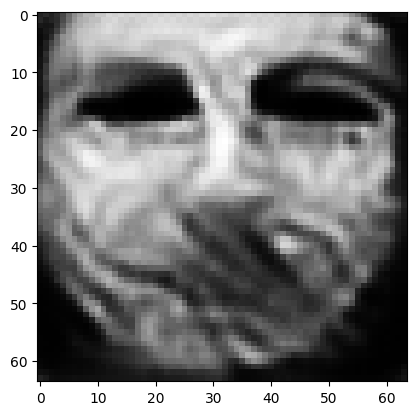

tensor([[9.8916e-05, 7.2770e-07, 1.8120e-03, 8.1376e-07, 1.2731e-05, 2.7600e-03,
         8.3649e-04, 9.9226e-01, 2.6854e-08, 3.8793e-05, 6.3092e-05, 5.4351e-07,
         1.5913e-07, 9.1000e-09, 1.0181e-08, 2.8261e-06, 1.8545e-04, 1.2413e-05,
         2.4899e-05, 2.9125e-04, 1.3848e-08, 2.5381e-07, 1.4538e-10, 1.0653e-05,
         2.9009e-06, 4.1174e-07, 4.6296e-06, 1.2687e-03, 2.1799e-04, 1.2310e-07,
         4.5373e-08, 5.0888e-07, 3.7702e-05, 4.6199e-06, 2.3276e-07, 7.0195e-09,
         2.2000e-07, 2.2355e-05, 8.6366e-06, 1.5929e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00776711804792285
tensor([[9.8905e-05, 7.2752e-07, 1.8116e-03, 8.1356e-07, 1.2727e-05, 2.7594e-03,
         8.3636e-04, 9.9226e-01, 2.6843e-08, 3.8789e-05, 6.3080e-05, 5.4337e-07,
         1.5907e-07, 9.0963e-09, 1.0178e-08, 2.8256e-06, 1.8542e-04, 1.2409e-05,
         2.4894e-05, 2.9119e-04, 1.3842e-08, 2.5376e-07, 1.4532e-10, 1.0652e-05,
         2.9002e-06, 4.1163e-07, 4.6282e-0

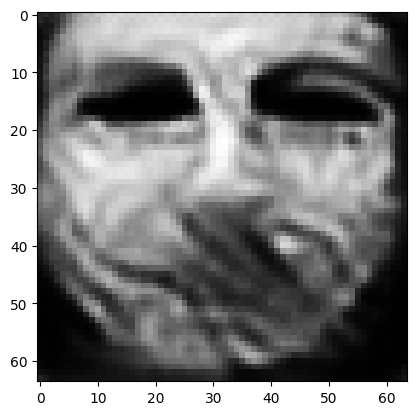

tensor([[9.8856e-05, 7.2676e-07, 1.8102e-03, 8.1269e-07, 1.2714e-05, 2.7572e-03,
         8.3587e-04, 9.9227e-01, 2.6802e-08, 3.8777e-05, 6.3033e-05, 5.4284e-07,
         1.5882e-07, 9.0806e-09, 1.0166e-08, 2.8236e-06, 1.8526e-04, 1.2395e-05,
         2.4872e-05, 2.9093e-04, 1.3821e-08, 2.5354e-07, 1.4504e-10, 1.0648e-05,
         2.8968e-06, 4.1117e-07, 4.6229e-06, 1.2673e-03, 2.1774e-04, 1.2291e-07,
         4.5290e-08, 5.0845e-07, 3.7644e-05, 4.6140e-06, 2.3239e-07, 7.0089e-09,
         2.1962e-07, 2.2332e-05, 8.6249e-06, 1.5903e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007759429514408112
tensor([[9.8843e-05, 7.2658e-07, 1.8099e-03, 8.1250e-07, 1.2711e-05, 2.7567e-03,
         8.3574e-04, 9.9227e-01, 2.6792e-08, 3.8774e-05, 6.3022e-05, 5.4270e-07,
         1.5876e-07, 9.0769e-09, 1.0163e-08, 2.8231e-06, 1.8523e-04, 1.2392e-05,
         2.4868e-05, 2.9087e-04, 1.3816e-08, 2.5349e-07, 1.4497e-10, 1.0647e-05,
         2.8959e-06, 4.1107e-07, 4.6215e-

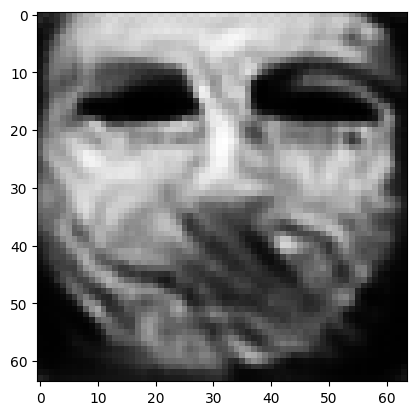

tensor([[9.8800e-05, 7.2586e-07, 1.8085e-03, 8.1172e-07, 1.2699e-05, 2.7545e-03,
         8.3529e-04, 9.9228e-01, 2.6753e-08, 3.8762e-05, 6.2979e-05, 5.4217e-07,
         1.5852e-07, 9.0630e-09, 1.0152e-08, 2.8213e-06, 1.8511e-04, 1.2379e-05,
         2.4849e-05, 2.9063e-04, 1.3796e-08, 2.5329e-07, 1.4473e-10, 1.0644e-05,
         2.8930e-06, 4.1066e-07, 4.6162e-06, 1.2660e-03, 2.1750e-04, 1.2273e-07,
         4.5216e-08, 5.0803e-07, 3.7588e-05, 4.6082e-06, 2.3205e-07, 6.9990e-09,
         2.1926e-07, 2.2309e-05, 8.6138e-06, 1.5879e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0077519770711660385
tensor([[9.8790e-05, 7.2569e-07, 1.8082e-03, 8.1153e-07, 1.2696e-05, 2.7540e-03,
         8.3518e-04, 9.9228e-01, 2.6744e-08, 3.8759e-05, 6.2969e-05, 5.4204e-07,
         1.5846e-07, 9.0597e-09, 1.0150e-08, 2.8208e-06, 1.8508e-04, 1.2376e-05,
         2.4844e-05, 2.9058e-04, 1.3791e-08, 2.5324e-07, 1.4467e-10, 1.0644e-05,
         2.8923e-06, 4.1056e-07, 4.6149e

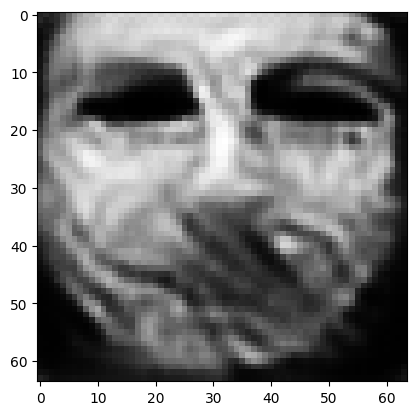

tensor([[9.8749e-05, 7.2502e-07, 1.8069e-03, 8.1078e-07, 1.2684e-05, 2.7519e-03,
         8.3474e-04, 9.9228e-01, 2.6707e-08, 3.8748e-05, 6.2928e-05, 5.4155e-07,
         1.5824e-07, 9.0462e-09, 1.0140e-08, 2.8191e-06, 1.8495e-04, 1.2364e-05,
         2.4826e-05, 2.9036e-04, 1.3772e-08, 2.5305e-07, 1.4443e-10, 1.0640e-05,
         2.8893e-06, 4.1017e-07, 4.6100e-06, 1.2648e-03, 2.1727e-04, 1.2257e-07,
         4.5144e-08, 5.0764e-07, 3.7535e-05, 4.6029e-06, 2.3173e-07, 6.9897e-09,
         2.1892e-07, 2.2289e-05, 8.6031e-06, 1.5856e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007745116483420134
tensor([[9.8738e-05, 7.2486e-07, 1.8066e-03, 8.1060e-07, 1.2681e-05, 2.7515e-03,
         8.3462e-04, 9.9229e-01, 2.6698e-08, 3.8745e-05, 6.2917e-05, 5.4142e-07,
         1.5818e-07, 9.0428e-09, 1.0137e-08, 2.8186e-06, 1.8492e-04, 1.2361e-05,
         2.4822e-05, 2.9030e-04, 1.3767e-08, 2.5300e-07, 1.4437e-10, 1.0639e-05,
         2.8886e-06, 4.1007e-07, 4.6088e-

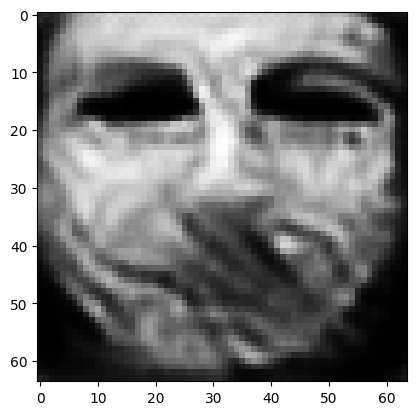

tensor([[9.8697e-05, 7.2421e-07, 1.8054e-03, 8.0987e-07, 1.2670e-05, 2.7496e-03,
         8.3421e-04, 9.9229e-01, 2.6663e-08, 3.8735e-05, 6.2878e-05, 5.4096e-07,
         1.5797e-07, 9.0298e-09, 1.0127e-08, 2.8169e-06, 1.8480e-04, 1.2349e-05,
         2.4804e-05, 2.9009e-04, 1.3749e-08, 2.5283e-07, 1.4414e-10, 1.0636e-05,
         2.8858e-06, 4.0969e-07, 4.6043e-06, 1.2636e-03, 2.1706e-04, 1.2240e-07,
         4.5074e-08, 5.0727e-07, 3.7485e-05, 4.5978e-06, 2.3142e-07, 6.9807e-09,
         2.1860e-07, 2.2268e-05, 8.5931e-06, 1.5834e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007738610729575157
tensor([[9.8687e-05, 7.2406e-07, 1.8051e-03, 8.0970e-07, 1.2668e-05, 2.7491e-03,
         8.3410e-04, 9.9229e-01, 2.6654e-08, 3.8731e-05, 6.2868e-05, 5.4085e-07,
         1.5791e-07, 9.0266e-09, 1.0124e-08, 2.8165e-06, 1.8477e-04, 1.2346e-05,
         2.4800e-05, 2.9003e-04, 1.3745e-08, 2.5278e-07, 1.4408e-10, 1.0635e-05,
         2.8851e-06, 4.0959e-07, 4.6031e-

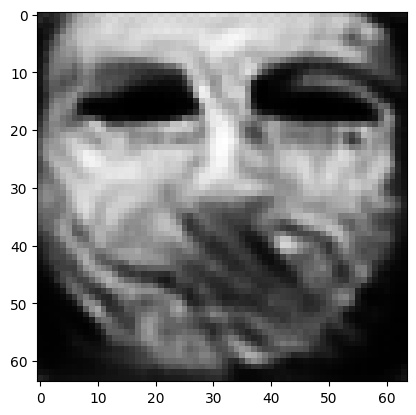

tensor([[9.8650e-05, 7.2345e-07, 1.8040e-03, 8.0904e-07, 1.2657e-05, 2.7472e-03,
         8.3370e-04, 9.9230e-01, 2.6621e-08, 3.8721e-05, 6.2831e-05, 5.4039e-07,
         1.5771e-07, 9.0147e-09, 1.0115e-08, 2.8149e-06, 1.8466e-04, 1.2335e-05,
         2.4783e-05, 2.8982e-04, 1.3728e-08, 2.5261e-07, 1.4387e-10, 1.0633e-05,
         2.8826e-06, 4.0925e-07, 4.5986e-06, 1.2625e-03, 2.1685e-04, 1.2225e-07,
         4.5010e-08, 5.0690e-07, 3.7436e-05, 4.5928e-06, 2.3113e-07, 6.9721e-09,
         2.1829e-07, 2.2249e-05, 8.5834e-06, 1.5813e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007732341066002846
tensor([[9.8641e-05, 7.2330e-07, 1.8037e-03, 8.0888e-07, 1.2655e-05, 2.7468e-03,
         8.3360e-04, 9.9230e-01, 2.6613e-08, 3.8718e-05, 6.2822e-05, 5.4028e-07,
         1.5766e-07, 9.0117e-09, 1.0113e-08, 2.8145e-06, 1.8463e-04, 1.2332e-05,
         2.4779e-05, 2.8977e-04, 1.3723e-08, 2.5257e-07, 1.4382e-10, 1.0632e-05,
         2.8819e-06, 4.0916e-07, 4.5975e-

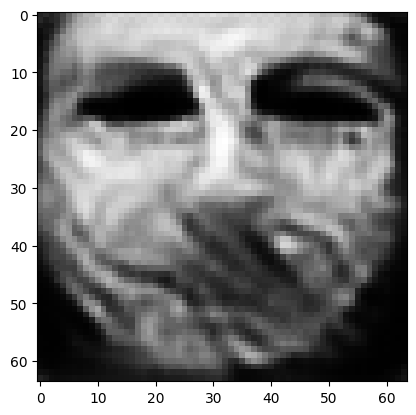

tensor([[9.8606e-05, 7.2273e-07, 1.8026e-03, 8.0824e-07, 1.2645e-05, 2.7451e-03,
         8.3323e-04, 9.9230e-01, 2.6582e-08, 3.8709e-05, 6.2787e-05, 5.3986e-07,
         1.5747e-07, 9.0003e-09, 1.0104e-08, 2.8130e-06, 1.8453e-04, 1.2322e-05,
         2.4764e-05, 2.8959e-04, 1.3707e-08, 2.5241e-07, 1.4362e-10, 1.0629e-05,
         2.8794e-06, 4.0882e-07, 4.5934e-06, 1.2614e-03, 2.1665e-04, 1.2211e-07,
         4.4949e-08, 5.0657e-07, 3.7391e-05, 4.5882e-06, 2.3085e-07, 6.9641e-09,
         2.1800e-07, 2.2231e-05, 8.5744e-06, 1.5793e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007726308424025774
tensor([[9.8597e-05, 7.2260e-07, 1.8024e-03, 8.0810e-07, 1.2642e-05, 2.7447e-03,
         8.3313e-04, 9.9230e-01, 2.6574e-08, 3.8706e-05, 6.2778e-05, 5.3975e-07,
         1.5743e-07, 8.9975e-09, 1.0102e-08, 2.8126e-06, 1.8450e-04, 1.2319e-05,
         2.4760e-05, 2.8954e-04, 1.3703e-08, 2.5236e-07, 1.4357e-10, 1.0628e-05,
         2.8788e-06, 4.0875e-07, 4.5923e-

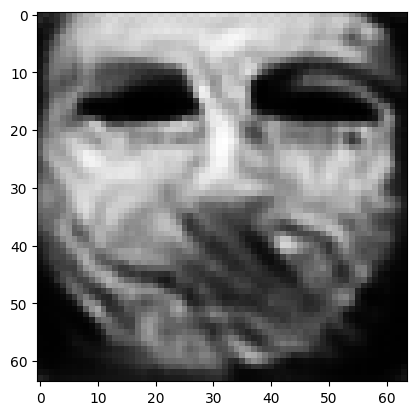

tensor([[9.8562e-05, 7.2204e-07, 1.8013e-03, 8.0747e-07, 1.2633e-05, 2.7430e-03,
         8.3278e-04, 9.9231e-01, 2.6544e-08, 3.8697e-05, 6.2744e-05, 5.3936e-07,
         1.5724e-07, 8.9865e-09, 1.0093e-08, 2.8112e-06, 1.8440e-04, 1.2309e-05,
         2.4745e-05, 2.8935e-04, 1.3688e-08, 2.5221e-07, 1.4337e-10, 1.0626e-05,
         2.8764e-06, 4.0842e-07, 4.5884e-06, 1.2604e-03, 2.1647e-04, 1.2197e-07,
         4.4889e-08, 5.0626e-07, 3.7348e-05, 4.5838e-06, 2.3059e-07, 6.9564e-09,
         2.1773e-07, 2.2214e-05, 8.5656e-06, 1.5774e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007720630150288343
tensor([[9.8553e-05, 7.2191e-07, 1.8011e-03, 8.0733e-07, 1.2630e-05, 2.7426e-03,
         8.3268e-04, 9.9231e-01, 2.6537e-08, 3.8695e-05, 6.2736e-05, 5.3926e-07,
         1.5720e-07, 8.9839e-09, 1.0091e-08, 2.8108e-06, 1.8437e-04, 1.2307e-05,
         2.4741e-05, 2.8930e-04, 1.3684e-08, 2.5217e-07, 1.4332e-10, 1.0625e-05,
         2.8758e-06, 4.0834e-07, 4.5874e-

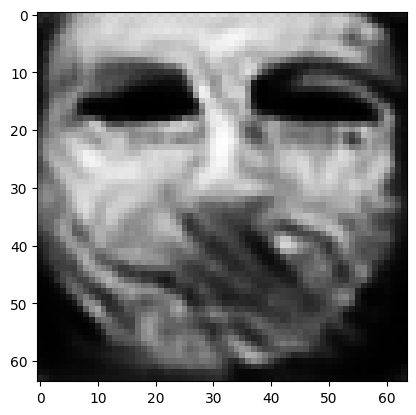

tensor([[9.8522e-05, 7.2140e-07, 1.8001e-03, 8.0676e-07, 1.2622e-05, 2.7410e-03,
         8.3235e-04, 9.9231e-01, 2.6509e-08, 3.8686e-05, 6.2706e-05, 5.3888e-07,
         1.5703e-07, 8.9739e-09, 1.0084e-08, 2.8095e-06, 1.8428e-04, 1.2298e-05,
         2.4728e-05, 2.8914e-04, 1.3669e-08, 2.5203e-07, 1.4314e-10, 1.0623e-05,
         2.8737e-06, 4.0804e-07, 4.5836e-06, 1.2595e-03, 2.1630e-04, 1.2184e-07,
         4.4835e-08, 5.0596e-07, 3.7307e-05, 4.5797e-06, 2.3034e-07, 6.9493e-09,
         2.1747e-07, 2.2198e-05, 8.5575e-06, 1.5757e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007715307176113129
tensor([[9.8513e-05, 7.2128e-07, 1.7999e-03, 8.0663e-07, 1.2619e-05, 2.7406e-03,
         8.3225e-04, 9.9232e-01, 2.6502e-08, 3.8683e-05, 6.2697e-05, 5.3878e-07,
         1.5698e-07, 8.9714e-09, 1.0082e-08, 2.8091e-06, 1.8426e-04, 1.2295e-05,
         2.4725e-05, 2.8909e-04, 1.3666e-08, 2.5199e-07, 1.4310e-10, 1.0622e-05,
         2.8731e-06, 4.0798e-07, 4.5827e-

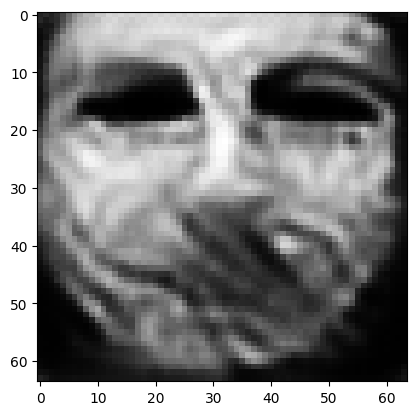

tensor([[9.8483e-05, 7.2079e-07, 1.7989e-03, 8.0610e-07, 1.2611e-05, 2.7392e-03,
         8.3193e-04, 9.9232e-01, 2.6475e-08, 3.8674e-05, 6.2667e-05, 5.3841e-07,
         1.5682e-07, 8.9619e-09, 1.0074e-08, 2.8078e-06, 1.8417e-04, 1.2286e-05,
         2.4711e-05, 2.8892e-04, 1.3652e-08, 2.5185e-07, 1.4293e-10, 1.0620e-05,
         2.8711e-06, 4.0770e-07, 4.5790e-06, 1.2586e-03, 2.1613e-04, 1.2172e-07,
         4.4785e-08, 5.0566e-07, 3.7268e-05, 4.5758e-06, 2.3011e-07, 6.9424e-09,
         2.1723e-07, 2.2183e-05, 8.5499e-06, 1.5740e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007710220292210579
tensor([[9.8477e-05, 7.2067e-07, 1.7987e-03, 8.0597e-07, 1.2609e-05, 2.7388e-03,
         8.3186e-04, 9.9232e-01, 2.6469e-08, 3.8672e-05, 6.2660e-05, 5.3832e-07,
         1.5678e-07, 8.9596e-09, 1.0072e-08, 2.8074e-06, 1.8415e-04, 1.2284e-05,
         2.4708e-05, 2.8889e-04, 1.3649e-08, 2.5182e-07, 1.4289e-10, 1.0619e-05,
         2.8707e-06, 4.0763e-07, 4.5781e-

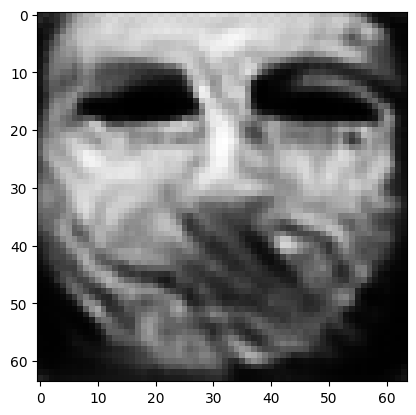

tensor([[9.8445e-05, 7.2020e-07, 1.7978e-03, 8.0544e-07, 1.2601e-05, 2.7374e-03,
         8.3155e-04, 9.9232e-01, 2.6443e-08, 3.8664e-05, 6.2631e-05, 5.3798e-07,
         1.5663e-07, 8.9500e-09, 1.0065e-08, 2.8062e-06, 1.8406e-04, 1.2276e-05,
         2.4695e-05, 2.8873e-04, 1.3635e-08, 2.5168e-07, 1.4272e-10, 1.0616e-05,
         2.8685e-06, 4.0735e-07, 4.5749e-06, 1.2578e-03, 2.1597e-04, 1.2160e-07,
         4.4734e-08, 5.0538e-07, 3.7231e-05, 4.5721e-06, 2.2988e-07, 6.9358e-09,
         2.1699e-07, 2.2168e-05, 8.5424e-06, 1.5724e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007705488707870245
tensor([[9.8439e-05, 7.2009e-07, 1.7976e-03, 8.0532e-07, 1.2599e-05, 2.7371e-03,
         8.3148e-04, 9.9233e-01, 2.6437e-08, 3.8662e-05, 6.2624e-05, 5.3790e-07,
         1.5659e-07, 8.9479e-09, 1.0063e-08, 2.8059e-06, 1.8404e-04, 1.2274e-05,
         2.4692e-05, 2.8869e-04, 1.3632e-08, 2.5165e-07, 1.4268e-10, 1.0616e-05,
         2.8681e-06, 4.0729e-07, 4.5740e-

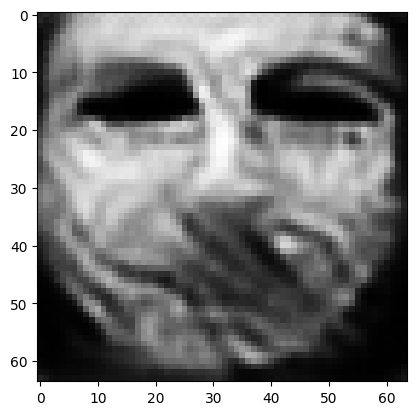

tensor([[9.8412e-05, 7.1965e-07, 1.7968e-03, 8.0484e-07, 1.2592e-05, 2.7357e-03,
         8.3119e-04, 9.9233e-01, 2.6414e-08, 3.8654e-05, 6.2597e-05, 5.3757e-07,
         1.5645e-07, 8.9394e-09, 1.0056e-08, 2.8047e-06, 1.8396e-04, 1.2266e-05,
         2.4681e-05, 2.8854e-04, 1.3620e-08, 2.5153e-07, 1.4254e-10, 1.0614e-05,
         2.8663e-06, 4.0704e-07, 4.5707e-06, 1.2570e-03, 2.1582e-04, 1.2149e-07,
         4.4690e-08, 5.0512e-07, 3.7197e-05, 4.5686e-06, 2.2967e-07, 6.9298e-09,
         2.1678e-07, 2.2155e-05, 8.5356e-06, 1.5709e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007700993679463863
tensor([[9.8405e-05, 7.1954e-07, 1.7966e-03, 8.0472e-07, 1.2590e-05, 2.7354e-03,
         8.3111e-04, 9.9233e-01, 2.6407e-08, 3.8653e-05, 6.2590e-05, 5.3749e-07,
         1.5641e-07, 8.9371e-09, 1.0055e-08, 2.8044e-06, 1.8394e-04, 1.2264e-05,
         2.4678e-05, 2.8850e-04, 1.3617e-08, 2.5150e-07, 1.4249e-10, 1.0613e-05,
         2.8657e-06, 4.0697e-07, 4.5700e-

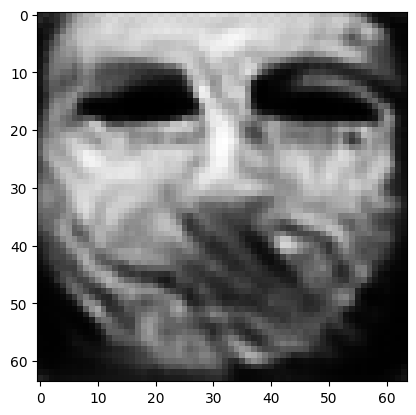

tensor([[9.8380e-05, 7.1912e-07, 1.7958e-03, 8.0426e-07, 1.2583e-05, 2.7341e-03,
         8.3085e-04, 9.9233e-01, 2.6385e-08, 3.8645e-05, 6.2565e-05, 5.3718e-07,
         1.5627e-07, 8.9291e-09, 1.0048e-08, 2.8033e-06, 1.8387e-04, 1.2256e-05,
         2.4666e-05, 2.8836e-04, 1.3605e-08, 2.5138e-07, 1.4235e-10, 1.0612e-05,
         2.8641e-06, 4.0673e-07, 4.5669e-06, 1.2562e-03, 2.1568e-04, 1.2139e-07,
         4.4645e-08, 5.0488e-07, 3.7164e-05, 4.5653e-06, 2.2947e-07, 6.9240e-09,
         2.1657e-07, 2.2142e-05, 8.5291e-06, 1.5694e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007696616463363171
tensor([[9.8373e-05, 7.1902e-07, 1.7956e-03, 8.0416e-07, 1.2581e-05, 2.7338e-03,
         8.3077e-04, 9.9233e-01, 2.6379e-08, 3.8643e-05, 6.2559e-05, 5.3710e-07,
         1.5624e-07, 8.9271e-09, 1.0047e-08, 2.8030e-06, 1.8385e-04, 1.2254e-05,
         2.4664e-05, 2.8833e-04, 1.3602e-08, 2.5135e-07, 1.4232e-10, 1.0611e-05,
         2.8636e-06, 4.0668e-07, 4.5661e-

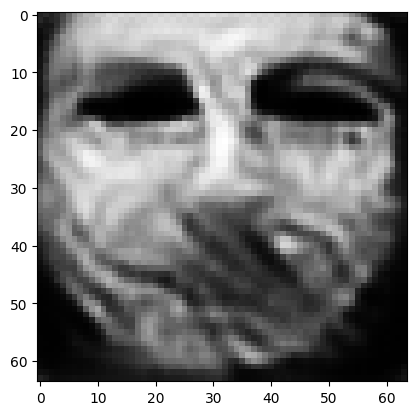

tensor([[9.8347e-05, 7.1861e-07, 1.7948e-03, 8.0370e-07, 1.2574e-05, 2.7326e-03,
         8.3050e-04, 9.9234e-01, 2.6357e-08, 3.8636e-05, 6.2533e-05, 5.3680e-07,
         1.5610e-07, 8.9190e-09, 1.0040e-08, 2.8019e-06, 1.8377e-04, 1.2247e-05,
         2.4652e-05, 2.8819e-04, 1.3591e-08, 2.5123e-07, 1.4217e-10, 1.0609e-05,
         2.8619e-06, 4.0644e-07, 4.5632e-06, 1.2555e-03, 2.1554e-04, 1.2128e-07,
         4.4602e-08, 5.0464e-07, 3.7132e-05, 4.5621e-06, 2.2928e-07, 6.9183e-09,
         2.1636e-07, 2.2129e-05, 8.5227e-06, 1.5681e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007692594546824694
tensor([[9.8341e-05, 7.1852e-07, 1.7946e-03, 8.0360e-07, 1.2572e-05, 2.7324e-03,
         8.3044e-04, 9.9234e-01, 2.6352e-08, 3.8634e-05, 6.2527e-05, 5.3673e-07,
         1.5607e-07, 8.9171e-09, 1.0039e-08, 2.8017e-06, 1.8376e-04, 1.2245e-05,
         2.4650e-05, 2.8816e-04, 1.3588e-08, 2.5120e-07, 1.4214e-10, 1.0608e-05,
         2.8615e-06, 4.0639e-07, 4.5625e-

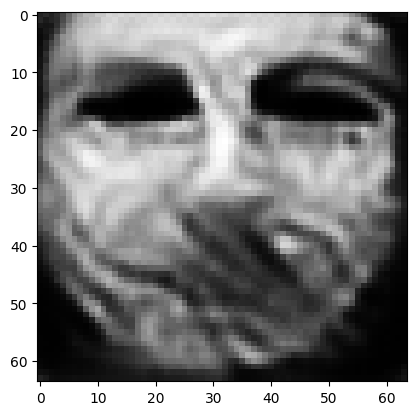

tensor([[9.8317e-05, 7.1815e-07, 1.7939e-03, 8.0319e-07, 1.2566e-05, 2.7312e-03,
         8.3019e-04, 9.9234e-01, 2.6332e-08, 3.8627e-05, 6.2504e-05, 5.3645e-07,
         1.5595e-07, 8.9098e-09, 1.0033e-08, 2.8006e-06, 1.8369e-04, 1.2238e-05,
         2.4640e-05, 2.8803e-04, 1.3578e-08, 2.5110e-07, 1.4201e-10, 1.0606e-05,
         2.8598e-06, 4.0617e-07, 4.5598e-06, 1.2548e-03, 2.1541e-04, 1.2119e-07,
         4.4563e-08, 5.0441e-07, 3.7102e-05, 4.5591e-06, 2.2910e-07, 6.9130e-09,
         2.1618e-07, 2.2117e-05, 8.5167e-06, 1.5668e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007688454352319241
tensor([[9.8312e-05, 7.1805e-07, 1.7937e-03, 8.0309e-07, 1.2564e-05, 2.7309e-03,
         8.3013e-04, 9.9234e-01, 2.6327e-08, 3.8626e-05, 6.2499e-05, 5.3638e-07,
         1.5592e-07, 8.9080e-09, 1.0032e-08, 2.8004e-06, 1.8367e-04, 1.2237e-05,
         2.4637e-05, 2.8800e-04, 1.3575e-08, 2.5107e-07, 1.4198e-10, 1.0606e-05,
         2.8595e-06, 4.0612e-07, 4.5591e-

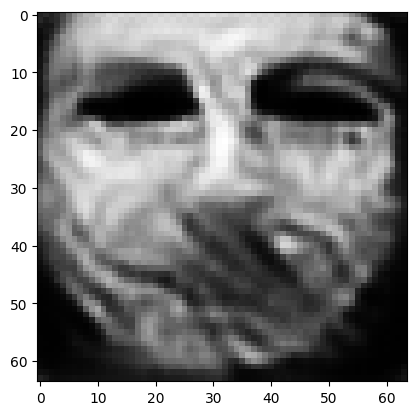

tensor([[9.8289e-05, 7.1770e-07, 1.7931e-03, 8.0270e-07, 1.2558e-05, 2.7298e-03,
         8.2989e-04, 9.9234e-01, 2.6307e-08, 3.8619e-05, 6.2477e-05, 5.3611e-07,
         1.5580e-07, 8.9010e-09, 1.0026e-08, 2.7994e-06, 1.8361e-04, 1.2230e-05,
         2.4628e-05, 2.8788e-04, 1.3565e-08, 2.5097e-07, 1.4186e-10, 1.0604e-05,
         2.8580e-06, 4.0591e-07, 4.5565e-06, 1.2542e-03, 2.1529e-04, 1.2110e-07,
         4.4526e-08, 5.0420e-07, 3.7074e-05, 4.5563e-06, 2.2893e-07, 6.9080e-09,
         2.1600e-07, 2.2106e-05, 8.5111e-06, 1.5655e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007684786804020405
tensor([[9.8283e-05, 7.1761e-07, 1.7929e-03, 8.0259e-07, 1.2557e-05, 2.7296e-03,
         8.2984e-04, 9.9235e-01, 2.6303e-08, 3.8618e-05, 6.2471e-05, 5.3606e-07,
         1.5577e-07, 8.8990e-09, 1.0025e-08, 2.7992e-06, 1.8359e-04, 1.2229e-05,
         2.4625e-05, 2.8785e-04, 1.3563e-08, 2.5094e-07, 1.4182e-10, 1.0604e-05,
         2.8575e-06, 4.0585e-07, 4.5560e-

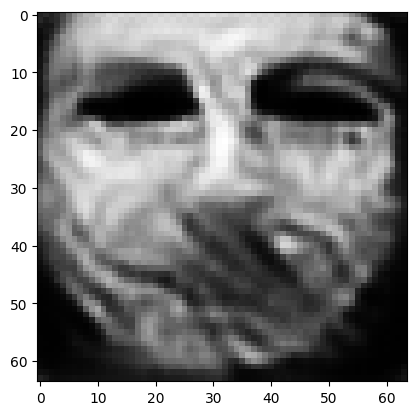

tensor([[9.8262e-05, 7.1728e-07, 1.7922e-03, 8.0222e-07, 1.2551e-05, 2.7286e-03,
         8.2961e-04, 9.9235e-01, 2.6284e-08, 3.8612e-05, 6.2450e-05, 5.3580e-07,
         1.5566e-07, 8.8925e-09, 1.0019e-08, 2.7983e-06, 1.8353e-04, 1.2222e-05,
         2.4616e-05, 2.8773e-04, 1.3553e-08, 2.5085e-07, 1.4170e-10, 1.0602e-05,
         2.8561e-06, 4.0566e-07, 4.5534e-06, 1.2535e-03, 2.1517e-04, 1.2102e-07,
         4.4490e-08, 5.0400e-07, 3.7047e-05, 4.5536e-06, 2.2877e-07, 6.9033e-09,
         2.1583e-07, 2.2095e-05, 8.5058e-06, 1.5644e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0076812379993498325
tensor([[9.8257e-05, 7.1719e-07, 1.7921e-03, 8.0213e-07, 1.2550e-05, 2.7283e-03,
         8.2956e-04, 9.9235e-01, 2.6280e-08, 3.8610e-05, 6.2445e-05, 5.3574e-07,
         1.5563e-07, 8.8910e-09, 1.0018e-08, 2.7980e-06, 1.8351e-04, 1.2221e-05,
         2.4614e-05, 2.8771e-04, 1.3551e-08, 2.5082e-07, 1.4168e-10, 1.0602e-05,
         2.8558e-06, 4.0562e-07, 4.5528e

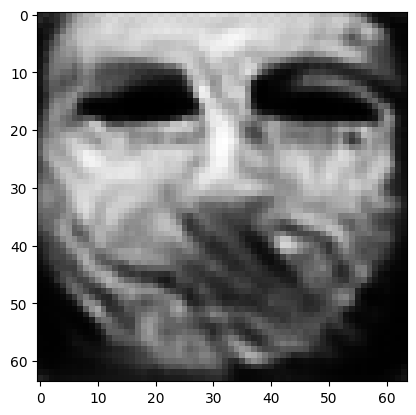

tensor([[9.8237e-05, 7.1688e-07, 1.7915e-03, 8.0178e-07, 1.2544e-05, 2.7273e-03,
         8.2934e-04, 9.9235e-01, 2.6262e-08, 3.8604e-05, 6.2425e-05, 5.3550e-07,
         1.5552e-07, 8.8846e-09, 1.0013e-08, 2.7972e-06, 1.8345e-04, 1.2215e-05,
         2.4605e-05, 2.8760e-04, 1.3542e-08, 2.5073e-07, 1.4157e-10, 1.0600e-05,
         2.8544e-06, 4.0543e-07, 4.5505e-06, 1.2530e-03, 2.1506e-04, 1.2094e-07,
         4.4456e-08, 5.0381e-07, 3.7022e-05, 4.5510e-06, 2.2861e-07, 6.8988e-09,
         2.1567e-07, 2.2085e-05, 8.5007e-06, 1.5633e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007677925750613213
tensor([[9.8232e-05, 7.1680e-07, 1.7913e-03, 8.0170e-07, 1.2543e-05, 2.7271e-03,
         8.2929e-04, 9.9235e-01, 2.6258e-08, 3.8603e-05, 6.2420e-05, 5.3543e-07,
         1.5550e-07, 8.8831e-09, 1.0012e-08, 2.7970e-06, 1.8344e-04, 1.2214e-05,
         2.4603e-05, 2.8757e-04, 1.3540e-08, 2.5071e-07, 1.4154e-10, 1.0600e-05,
         2.8541e-06, 4.0539e-07, 4.5499e-

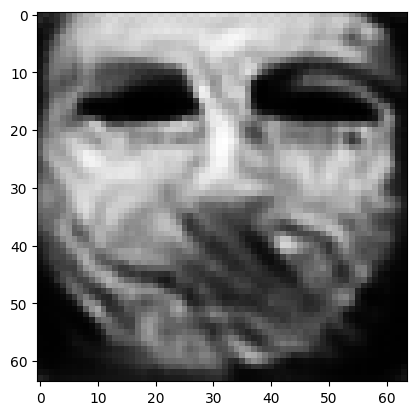

tensor([[9.8213e-05, 7.1649e-07, 1.7907e-03, 8.0136e-07, 1.2537e-05, 2.7262e-03,
         8.2908e-04, 9.9235e-01, 2.6241e-08, 3.8597e-05, 6.2401e-05, 5.3520e-07,
         1.5540e-07, 8.8771e-09, 1.0007e-08, 2.7961e-06, 1.8339e-04, 1.2208e-05,
         2.4595e-05, 2.8747e-04, 1.3531e-08, 2.5062e-07, 1.4143e-10, 1.0598e-05,
         2.8528e-06, 4.0521e-07, 4.5476e-06, 1.2524e-03, 2.1496e-04, 1.2086e-07,
         4.4425e-08, 5.0362e-07, 3.6997e-05, 4.5486e-06, 2.2847e-07, 6.8945e-09,
         2.1552e-07, 2.2076e-05, 8.4959e-06, 1.5622e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007674731779843569
tensor([[9.8208e-05, 7.1641e-07, 1.7906e-03, 8.0126e-07, 1.2536e-05, 2.7260e-03,
         8.2904e-04, 9.9236e-01, 2.6237e-08, 3.8596e-05, 6.2396e-05, 5.3516e-07,
         1.5537e-07, 8.8754e-09, 1.0006e-08, 2.7959e-06, 1.8337e-04, 1.2207e-05,
         2.4593e-05, 2.8744e-04, 1.3529e-08, 2.5060e-07, 1.4140e-10, 1.0598e-05,
         2.8524e-06, 4.0516e-07, 4.5471e-

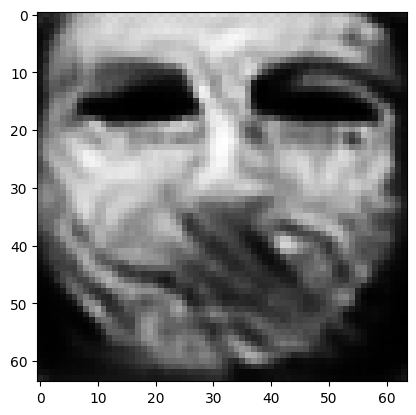

tensor([[9.8189e-05, 7.1613e-07, 1.7900e-03, 8.0095e-07, 1.2531e-05, 2.7251e-03,
         8.2884e-04, 9.9236e-01, 2.6222e-08, 3.8591e-05, 6.2378e-05, 5.3494e-07,
         1.5527e-07, 8.8698e-09, 1.0002e-08, 2.7951e-06, 1.8332e-04, 1.2201e-05,
         2.4585e-05, 2.8734e-04, 1.3521e-08, 2.5052e-07, 1.4130e-10, 1.0596e-05,
         2.8512e-06, 4.0499e-07, 4.5450e-06, 1.2519e-03, 2.1486e-04, 1.2079e-07,
         4.4393e-08, 5.0346e-07, 3.6974e-05, 4.5463e-06, 2.2833e-07, 6.8905e-09,
         2.1537e-07, 2.2067e-05, 8.4913e-06, 1.5612e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007671774365007877
tensor([[9.8185e-05, 7.1605e-07, 1.7899e-03, 8.0087e-07, 1.2530e-05, 2.7249e-03,
         8.2880e-04, 9.9236e-01, 2.6218e-08, 3.8590e-05, 6.2374e-05, 5.3488e-07,
         1.5525e-07, 8.8683e-09, 1.0000e-08, 2.7949e-06, 1.8330e-04, 1.2200e-05,
         2.4583e-05, 2.8732e-04, 1.3519e-08, 2.5049e-07, 1.4128e-10, 1.0596e-05,
         2.8509e-06, 4.0495e-07, 4.5445e-

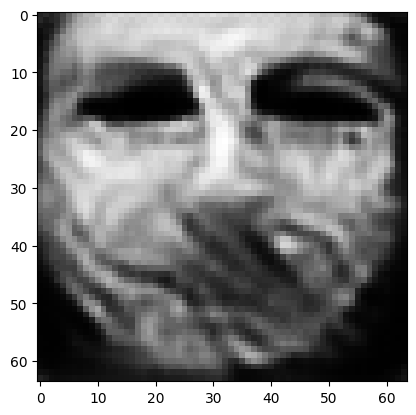

tensor([[9.8168e-05, 7.1578e-07, 1.7894e-03, 8.0056e-07, 1.2525e-05, 2.7240e-03,
         8.2861e-04, 9.9236e-01, 2.6203e-08, 3.8585e-05, 6.2357e-05, 5.3468e-07,
         1.5516e-07, 8.8630e-09, 9.9962e-09, 2.7942e-06, 1.8326e-04, 1.2195e-05,
         2.4575e-05, 2.8722e-04, 1.3511e-08, 2.5042e-07, 1.4118e-10, 1.0595e-05,
         2.8498e-06, 4.0479e-07, 4.5424e-06, 1.2514e-03, 2.1477e-04, 1.2072e-07,
         4.4364e-08, 5.0329e-07, 3.6952e-05, 4.5441e-06, 2.2820e-07, 6.8866e-09,
         2.1523e-07, 2.2058e-05, 8.4869e-06, 1.5603e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007668816950172186
tensor([[9.8163e-05, 7.1571e-07, 1.7892e-03, 8.0050e-07, 1.2524e-05, 2.7238e-03,
         8.2857e-04, 9.9236e-01, 2.6199e-08, 3.8583e-05, 6.2353e-05, 5.3462e-07,
         1.5514e-07, 8.8618e-09, 9.9952e-09, 2.7940e-06, 1.8324e-04, 1.2194e-05,
         2.4574e-05, 2.8720e-04, 1.3509e-08, 2.5040e-07, 1.4116e-10, 1.0594e-05,
         2.8495e-06, 4.0476e-07, 4.5419e-

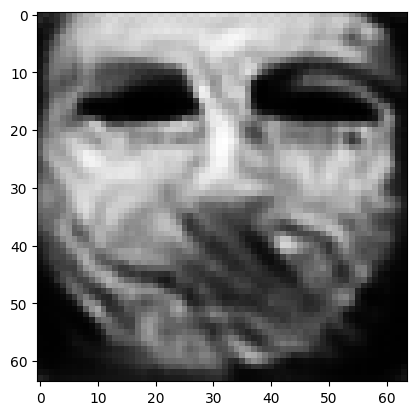

tensor([[9.8147e-05, 7.1545e-07, 1.7887e-03, 8.0021e-07, 1.2519e-05, 2.7230e-03,
         8.2839e-04, 9.9236e-01, 2.6185e-08, 3.8578e-05, 6.2336e-05, 5.3442e-07,
         1.5505e-07, 8.8565e-09, 9.9909e-09, 2.7933e-06, 1.8319e-04, 1.2189e-05,
         2.4567e-05, 2.8711e-04, 1.3501e-08, 2.5032e-07, 1.4107e-10, 1.0593e-05,
         2.8483e-06, 4.0461e-07, 4.5400e-06, 1.2509e-03, 2.1467e-04, 1.2065e-07,
         4.4337e-08, 5.0313e-07, 3.6931e-05, 4.5420e-06, 2.2807e-07, 6.8829e-09,
         2.1510e-07, 2.2050e-05, 8.4827e-06, 1.5594e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007666096091270447
tensor([[9.8143e-05, 7.1539e-07, 1.7886e-03, 8.0014e-07, 1.2518e-05, 2.7228e-03,
         8.2835e-04, 9.9236e-01, 2.6181e-08, 3.8577e-05, 6.2332e-05, 5.3438e-07,
         1.5503e-07, 8.8553e-09, 9.9900e-09, 2.7931e-06, 1.8318e-04, 1.2188e-05,
         2.4565e-05, 2.8709e-04, 1.3500e-08, 2.5030e-07, 1.4105e-10, 1.0593e-05,
         2.8481e-06, 4.0457e-07, 4.5395e-

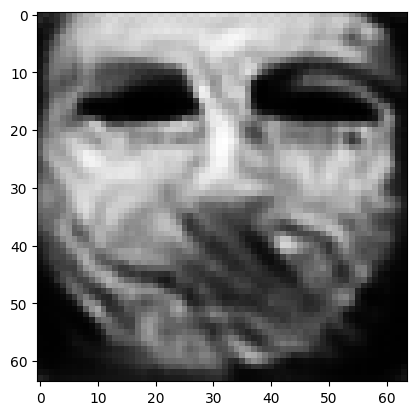

tensor([[9.8127e-05, 7.1514e-07, 1.7881e-03, 7.9985e-07, 1.2514e-05, 2.7221e-03,
         8.2818e-04, 9.9237e-01, 2.6168e-08, 3.8573e-05, 6.2316e-05, 5.3419e-07,
         1.5495e-07, 8.8502e-09, 9.9861e-09, 2.7924e-06, 1.8313e-04, 1.2183e-05,
         2.4558e-05, 2.8700e-04, 1.3493e-08, 2.5023e-07, 1.4096e-10, 1.0591e-05,
         2.8470e-06, 4.0442e-07, 4.5378e-06, 1.2504e-03, 2.1459e-04, 1.2059e-07,
         4.4310e-08, 5.0299e-07, 3.6911e-05, 4.5400e-06, 2.2795e-07, 6.8794e-09,
         2.1497e-07, 2.2042e-05, 8.4788e-06, 1.5585e-05]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00766361178830266
tensor([[9.8123e-05, 7.1508e-07, 1.7880e-03, 7.9979e-07, 1.2513e-05, 2.7219e-03,
         8.2814e-04, 9.9237e-01, 2.6165e-08, 3.8572e-05, 6.2313e-05, 5.3415e-07,
         1.5493e-07, 8.8492e-09, 9.9852e-09, 2.7923e-06, 1.8313e-04, 1.2182e-05,
         2.4556e-05, 2.8699e-04, 1.3491e-08, 2.5022e-07, 1.4094e-10, 1.0591e-05,
         2.8467e-06, 4.0439e-07, 4.5373e-0

In [11]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=7)

In [19]:
r = d2c_decoder(z).detach().cpu()
torch.save(r, 'attack7_VAE_overfit.pt')

In [18]:
r.shape

torch.Size([1, 1, 64, 64])

tensor([[2.5849e-04, 4.0420e-05, 9.8728e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8280e-05, 3.0250e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5019e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2035e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  10.40602970123291


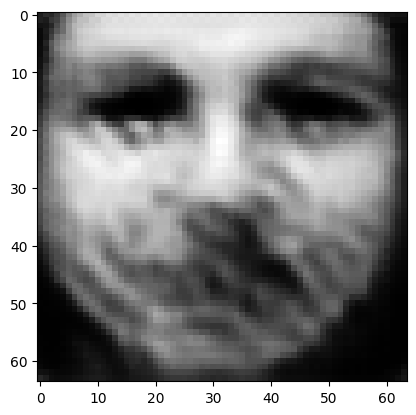

tensor([[1.1756e-04, 2.8693e-04, 1.8364e-03, 3.0526e-03, 3.6173e-02, 7.7322e-05,
         6.0450e-04, 2.3954e-04, 5.4358e-04, 1.7898e-05, 6.1289e-05, 6.7767e-05,
         1.2982e-02, 7.6143e-03, 1.6728e-04, 1.2813e-05, 1.0190e-02, 1.2662e-03,
         5.5054e-04, 7.4000e-05, 1.1796e-02, 1.2757e-04, 2.4797e-01, 1.1785e-04,
         4.3864e-01, 4.3077e-02, 1.1440e-04, 6.8000e-04, 1.0300e-03, 2.5691e-03,
         8.1777e-04, 4.1060e-04, 1.0222e-02, 4.5408e-03, 1.6873e-02, 5.9177e-03,
         1.1943e-01, 5.1418e-03, 1.2434e-02, 2.1478e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  7.517330646514893
tensor([[5.7024e-05, 1.1039e-04, 5.1715e-03, 1.4746e-04, 2.0259e-02, 6.1120e-04,
         1.3140e-03, 5.9326e-04, 1.9967e-03, 6.1818e-05, 8.9239e-05, 4.1978e-05,
         7.7134e-02, 2.7654e-04, 2.1758e-04, 8.9990e-06, 3.2416e-03, 1.6308e-03,
         1.0924e-04, 1.8139e-02, 1.7186e-03, 4.3103e-05, 3.8701e-04, 2.6891e-05,
         1.6243e-02, 1.2266e-04, 7.3279e-04,

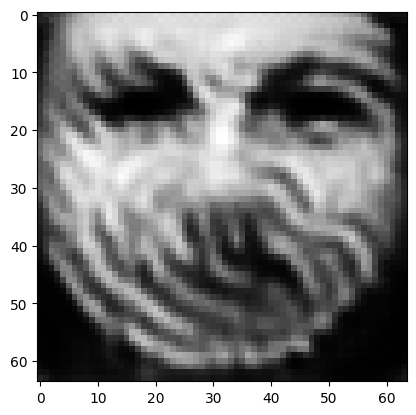

tensor([[1.3814e-05, 6.9119e-04, 7.5914e-04, 5.4311e-04, 1.9433e-04, 3.8120e-04,
         1.1377e-05, 4.8954e-05, 9.3670e-01, 6.2002e-04, 6.4733e-05, 6.9200e-04,
         1.0578e-02, 1.8763e-04, 8.5889e-05, 4.5318e-06, 5.0116e-06, 5.0465e-04,
         1.4509e-05, 8.2771e-04, 2.3529e-03, 1.6255e-05, 1.6037e-05, 1.1112e-07,
         3.5455e-05, 1.5433e-04, 2.7561e-03, 3.9877e-04, 1.3778e-04, 6.4065e-04,
         6.2949e-03, 3.8770e-06, 4.6184e-04, 5.1086e-04, 6.7660e-03, 2.5902e-05,
         9.6601e-06, 5.9307e-05, 3.5261e-03, 2.2909e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.06539718061685562
tensor([[1.1921e-05, 5.0569e-04, 6.6537e-04, 4.3048e-04, 1.5138e-04, 3.3505e-04,
         8.6538e-06, 3.6065e-05, 9.4714e-01, 5.1169e-04, 4.9925e-05, 5.7305e-04,
         8.3254e-03, 1.2873e-04, 6.8622e-05, 3.7463e-06, 3.5476e-06, 3.7327e-04,
         1.1504e-05, 6.5357e-04, 1.8861e-03, 1.3286e-05, 1.1039e-05, 8.3196e-08,
         2.8064e-05, 1.0730e-04, 2.3749e-0

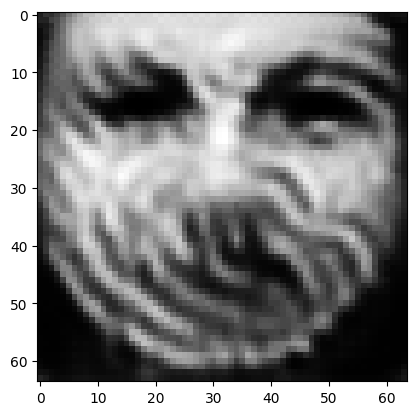

tensor([[8.4052e-06, 2.6178e-04, 4.8616e-04, 2.8528e-04, 8.1969e-05, 2.3347e-04,
         4.2557e-06, 1.8073e-05, 9.6552e-01, 3.1653e-04, 2.7670e-05, 3.8387e-04,
         4.9559e-03, 6.3113e-05, 4.6271e-05, 2.3506e-06, 1.6998e-06, 1.8677e-04,
         7.1103e-06, 3.6126e-04, 1.2179e-03, 8.1958e-06, 5.2847e-06, 4.5166e-08,
         1.7502e-05, 5.4449e-05, 1.4872e-03, 1.2849e-04, 7.0570e-05, 2.6992e-04,
         1.9967e-03, 1.1760e-06, 1.7155e-04, 2.4239e-04, 3.6517e-03, 7.7526e-06,
         3.1742e-06, 2.6834e-05, 1.7828e-03, 1.5606e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03509015217423439
tensor([[7.8858e-06, 2.3120e-04, 4.5573e-04, 2.6588e-04, 7.2292e-05, 2.1614e-04,
         3.6930e-06, 1.5877e-05, 9.6836e-01, 2.8736e-04, 2.4826e-05, 3.5428e-04,
         4.4788e-03, 5.5695e-05, 4.3069e-05, 2.1572e-06, 1.4767e-06, 1.6354e-04,
         6.5294e-06, 3.2178e-04, 1.1265e-03, 7.4515e-06, 4.5841e-06, 4.0641e-08,
         1.5993e-05, 4.8411e-05, 1.3370e-0

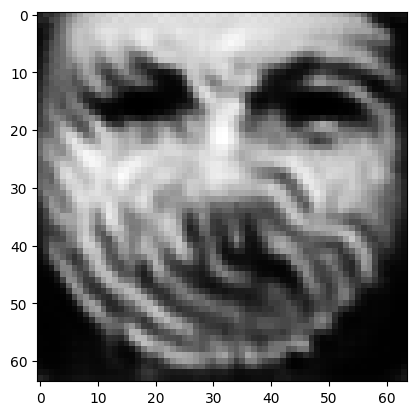

tensor([[6.4603e-06, 1.6078e-04, 3.7410e-04, 2.1992e-04, 5.0230e-05, 1.6802e-04,
         2.4549e-06, 1.1098e-05, 9.7553e-01, 2.0978e-04, 1.8308e-05, 2.7463e-04,
         3.4681e-03, 4.0082e-05, 3.5652e-05, 1.6453e-06, 1.0098e-06, 1.1066e-04,
         5.1311e-06, 2.3066e-04, 9.0441e-04, 5.6566e-06, 3.1319e-06, 3.0598e-08,
         1.2556e-05, 3.5560e-05, 9.3823e-04, 7.6321e-05, 4.8495e-05, 1.8228e-04,
         1.3046e-03, 6.6012e-07, 1.0232e-04, 1.5674e-04, 2.7380e-03, 4.4769e-06,
         1.9166e-06, 1.8806e-05, 1.2027e-03, 1.1342e-02]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.024771787226200104
tensor([[6.2062e-06, 1.4865e-04, 3.5935e-04, 2.1167e-04, 4.6742e-05, 1.5957e-04,
         2.2667e-06, 1.0327e-05, 9.7674e-01, 1.9649e-04, 1.7213e-05, 2.6079e-04,
         3.3147e-03, 3.7408e-05, 3.4237e-05, 1.5533e-06, 9.3478e-07, 1.0191e-04,
         4.8729e-06, 2.1581e-04, 8.6345e-04, 5.3568e-06, 2.9055e-06, 2.8881e-08,
         1.1992e-05, 3.3376e-05, 8.7432e-

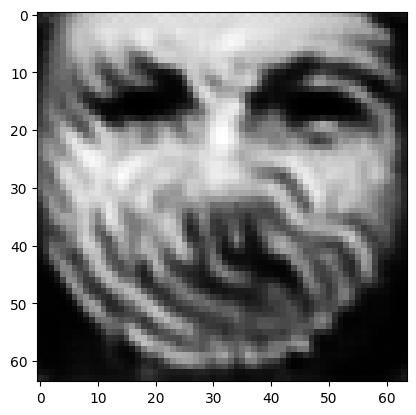

tensor([[5.4271e-06, 1.1457e-04, 3.1373e-04, 1.8847e-04, 3.6251e-05, 1.3304e-04,
         1.7295e-06, 8.1199e-06, 9.8055e-01, 1.5669e-04, 1.4017e-05, 2.1893e-04,
         2.8266e-03, 2.9906e-05, 3.0160e-05, 1.2749e-06, 7.2759e-07, 7.7452e-05,
         4.1070e-06, 1.7156e-04, 7.4662e-04, 4.4802e-06, 2.2563e-06, 2.3936e-08,
         1.0280e-05, 2.7283e-05, 6.7965e-04, 5.4232e-05, 3.8284e-05, 1.4021e-04,
         1.0207e-03, 4.5665e-07, 7.4113e-05, 1.1771e-04, 2.2369e-03, 3.2172e-06,
         1.4219e-06, 1.5231e-05, 9.3080e-04, 9.0114e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.019639676436781883
tensor([[5.2770e-06, 1.0841e-04, 3.0547e-04, 1.8398e-04, 3.4324e-05, 1.2794e-04,
         1.6315e-06, 7.7188e-06, 9.8128e-01, 1.4951e-04, 1.3427e-05, 2.1138e-04,
         2.7279e-03, 2.8575e-05, 2.9351e-05, 1.2229e-06, 6.9148e-07, 7.3149e-05,
         3.9600e-06, 1.6327e-04, 7.2558e-04, 4.3218e-06, 2.1363e-06, 2.3056e-08,
         9.9441e-06, 2.6220e-05, 6.4271e-

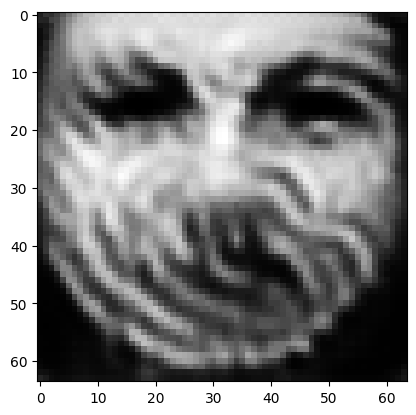

tensor([[4.7693e-06, 8.7913e-05, 2.7697e-04, 1.6441e-04, 2.8223e-05, 1.1218e-04,
         1.3295e-06, 6.3507e-06, 9.8370e-01, 1.2660e-04, 1.1448e-05, 1.8605e-04,
         2.3577e-03, 2.3814e-05, 2.6756e-05, 1.0579e-06, 5.7040e-07, 6.0132e-05,
         3.4682e-06, 1.3788e-04, 6.5018e-04, 3.7730e-06, 1.7131e-06, 1.9923e-08,
         8.7000e-06, 2.2153e-05, 5.3158e-04, 4.1862e-05, 3.2192e-05, 1.1533e-04,
         8.3886e-04, 3.4755e-07, 5.7727e-05, 9.5584e-05, 1.9427e-03, 2.4904e-06,
         1.1380e-06, 1.2947e-05, 7.6004e-04, 7.5599e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016431139782071114
tensor([[4.6705e-06, 8.4458e-05, 2.7108e-04, 1.6127e-04, 2.7161e-05, 1.0869e-04,
         1.2767e-06, 6.1240e-06, 9.8419e-01, 1.2184e-04, 1.1112e-05, 1.8092e-04,
         2.2978e-03, 2.3166e-05, 2.6393e-05, 1.0255e-06, 5.5053e-07, 5.8064e-05,
         3.3766e-06, 1.3341e-04, 6.3683e-04, 3.6771e-06, 1.6461e-06, 1.9437e-08,
         8.5035e-06, 2.1519e-05, 5.0885e-

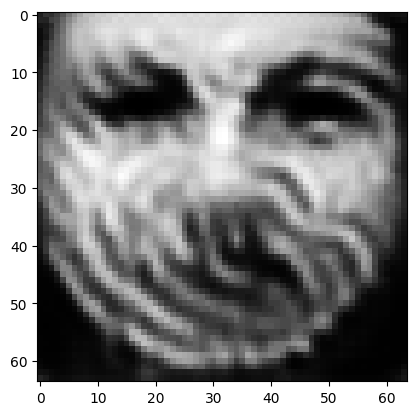

tensor([[4.3228e-06, 7.2817e-05, 2.5027e-04, 1.4981e-04, 2.3614e-05, 9.7115e-05,
         1.1082e-06, 5.3628e-06, 9.8582e-01, 1.0707e-04, 9.9233e-06, 1.6476e-04,
         2.0773e-03, 2.0768e-05, 2.4895e-05, 9.1811e-07, 4.8176e-07, 5.1160e-05,
         3.0559e-06, 1.1838e-04, 5.8699e-04, 3.3572e-06, 1.4158e-06, 1.7710e-08,
         7.7953e-06, 1.9301e-05, 4.3694e-04, 3.5479e-05, 2.7827e-05, 1.0069e-04,
         7.5583e-04, 2.9043e-07, 4.9247e-05, 8.2631e-05, 1.7498e-03, 2.1188e-06,
         9.8728e-07, 1.1631e-05, 6.6287e-04, 6.4648e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.014284618198871613
tensor([[4.2437e-06, 7.0410e-05, 2.4560e-04, 1.4720e-04, 2.2854e-05, 9.4595e-05,
         1.0736e-06, 5.2024e-06, 9.8616e-01, 1.0397e-04, 9.6668e-06, 1.6126e-04,
         2.0298e-03, 2.0251e-05, 2.4567e-05, 8.9541e-07, 4.6698e-07, 4.9730e-05,
         2.9862e-06, 1.1527e-04, 5.7561e-04, 3.2863e-06, 1.3677e-06, 1.7334e-08,
         7.6373e-06, 1.8806e-05, 4.2236e-

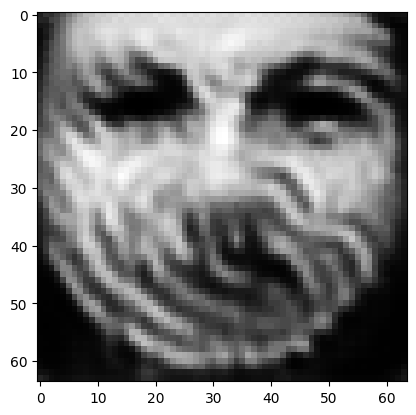

tensor([[3.9793e-06, 6.2641e-05, 2.2977e-04, 1.3874e-04, 2.0447e-05, 8.5984e-05,
         9.6046e-07, 4.6913e-06, 9.8731e-01, 9.3526e-05, 8.8311e-06, 1.4936e-04,
         1.8797e-03, 1.8706e-05, 2.3550e-05, 8.1749e-07, 4.2153e-07, 4.5116e-05,
         2.7520e-06, 1.0513e-04, 5.3912e-04, 3.0591e-06, 1.2191e-06, 1.6154e-08,
         7.1675e-06, 1.7311e-05, 3.7323e-04, 3.1238e-05, 2.4738e-05, 9.0352e-05,
         7.0044e-04, 2.5290e-07, 4.3604e-05, 7.4038e-05, 1.6103e-03, 1.8747e-06,
         8.8261e-07, 1.0728e-05, 5.9664e-04, 5.6880e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012770656496286392
tensor([[3.9265e-06, 6.1139e-05, 2.2633e-04, 1.3707e-04, 1.9991e-05, 8.4117e-05,
         9.3826e-07, 4.5937e-06, 9.8755e-01, 9.1353e-05, 8.6677e-06, 1.4687e-04,
         1.8515e-03, 1.8456e-05, 2.3385e-05, 8.0139e-07, 4.1341e-07, 4.4261e-05,
         2.7036e-06, 1.0316e-04, 5.3226e-04, 3.0153e-06, 1.1921e-06, 1.5937e-08,
         7.0890e-06, 1.7038e-05, 3.6328e-

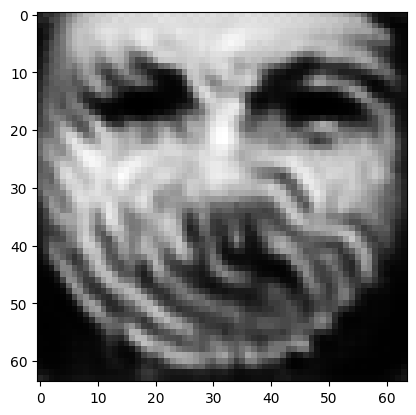

tensor([[3.7411e-06, 5.5791e-05, 2.1408e-04, 1.3061e-04, 1.8400e-05, 7.7741e-05,
         8.6205e-07, 4.2495e-06, 9.8838e-01, 8.4039e-05, 8.0878e-06, 1.3816e-04,
         1.7477e-03, 1.7512e-05, 2.2763e-05, 7.4561e-07, 3.8468e-07, 4.1237e-05,
         2.5324e-06, 9.6397e-05, 5.0721e-04, 2.8602e-06, 1.0959e-06, 1.5117e-08,
         6.7971e-06, 1.6019e-05, 3.2951e-04, 2.8715e-05, 2.2508e-05, 8.3141e-05,
         6.6819e-04, 2.2840e-07, 3.9937e-05, 6.8499e-05, 1.5097e-03, 1.7289e-06,
         8.1835e-07, 1.0110e-05, 5.5282e-04, 5.1086e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011691620573401451
tensor([[3.7008e-06, 5.4630e-05, 2.1131e-04, 1.2921e-04, 1.8041e-05, 7.6351e-05,
         8.4555e-07, 4.1748e-06, 9.8856e-01, 8.2508e-05, 7.9604e-06, 1.3623e-04,
         1.7234e-03, 1.7297e-05, 2.2612e-05, 7.3355e-07, 3.7823e-07, 4.0560e-05,
         2.4949e-06, 9.4917e-05, 5.0138e-04, 2.8252e-06, 1.0744e-06, 1.4927e-08,
         6.7275e-06, 1.5791e-05, 3.2220e-

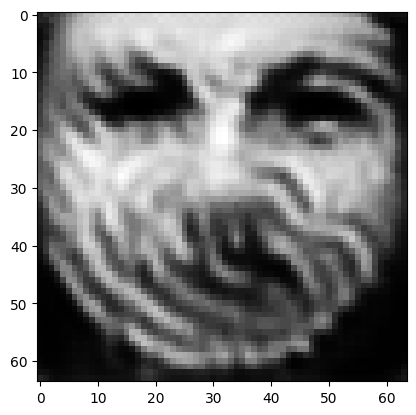

tensor([[3.5569e-06, 5.0675e-05, 2.0140e-04, 1.2496e-04, 1.6746e-05, 7.1193e-05,
         7.8578e-07, 3.9147e-06, 9.8923e-01, 7.7112e-05, 7.5299e-06, 1.2924e-04,
         1.6393e-03, 1.6575e-05, 2.2063e-05, 6.9026e-07, 3.5637e-07, 3.8169e-05,
         2.3626e-06, 8.9519e-05, 4.8003e-04, 2.7072e-06, 1.0012e-06, 1.4299e-08,
         6.4922e-06, 1.5047e-05, 2.9564e-04, 2.6737e-05, 2.0763e-05, 7.7795e-05,
         6.4858e-04, 2.0927e-07, 3.7095e-05, 6.4008e-05, 1.4290e-03, 1.6163e-06,
         7.7007e-07, 9.6756e-06, 5.1648e-04, 4.6400e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010828307829797268
tensor([[3.5248e-06, 4.9826e-05, 1.9923e-04, 1.2396e-04, 1.6470e-05, 7.0084e-05,
         7.7312e-07, 3.8560e-06, 9.8938e-01, 7.5965e-05, 7.4333e-06, 1.2773e-04,
         1.6210e-03, 1.6411e-05, 2.1961e-05, 6.8105e-07, 3.5167e-07, 3.7662e-05,
         2.3337e-06, 8.8383e-05, 4.7551e-04, 2.6816e-06, 9.8509e-07, 1.4161e-08,
         6.4416e-06, 1.4871e-05, 2.9004e-

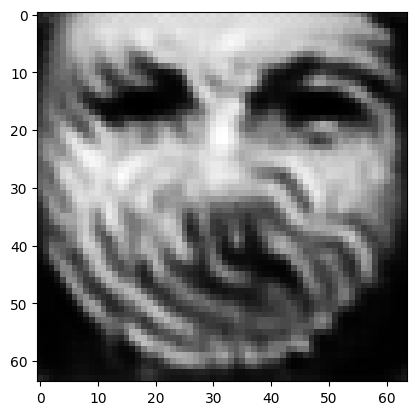

tensor([[3.4012e-06, 4.6614e-05, 1.9116e-04, 1.2012e-04, 1.5412e-05, 6.6040e-05,
         7.2488e-07, 3.6371e-06, 9.8992e-01, 7.1738e-05, 7.0635e-06, 1.2203e-04,
         1.5491e-03, 1.5724e-05, 2.1500e-05, 6.4592e-07, 3.3331e-07, 3.5628e-05,
         2.2251e-06, 8.4010e-05, 4.5723e-04, 2.5840e-06, 9.2281e-07, 1.3613e-08,
         6.2376e-06, 1.4199e-05, 2.6906e-04, 2.5075e-05, 1.9407e-05, 7.3327e-05,
         6.3069e-04, 1.9345e-07, 3.4796e-05, 6.0405e-05, 1.3595e-03, 1.5222e-06,
         7.2829e-07, 9.2723e-06, 4.8719e-04, 4.2712e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010131833143532276
tensor([[3.3719e-06, 4.5880e-05, 1.8929e-04, 1.1919e-04, 1.5170e-05, 6.5119e-05,
         7.1380e-07, 3.5872e-06, 9.9004e-01, 7.0776e-05, 6.9766e-06, 1.2071e-04,
         1.5323e-03, 1.5559e-05, 2.1384e-05, 6.3769e-07, 3.2900e-07, 3.5147e-05,
         2.1997e-06, 8.2990e-05, 4.5285e-04, 2.5616e-06, 9.0859e-07, 1.3483e-08,
         6.1899e-06, 1.4044e-05, 2.6430e-

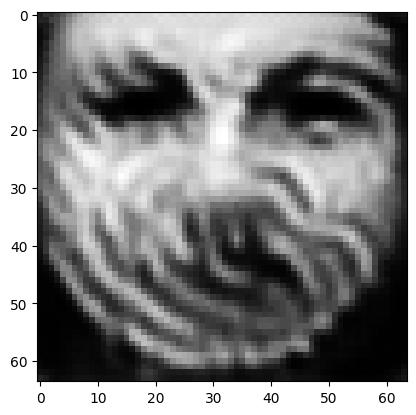

tensor([[3.2659e-06, 4.3204e-05, 1.8266e-04, 1.1558e-04, 1.4297e-05, 6.1932e-05,
         6.7343e-07, 3.4045e-06, 9.9049e-01, 6.7359e-05, 6.6578e-06, 1.1594e-04,
         1.4674e-03, 1.4909e-05, 2.0947e-05, 6.0858e-07, 3.1273e-07, 3.3408e-05,
         2.1093e-06, 7.9206e-05, 4.3668e-04, 2.4771e-06, 8.5529e-07, 1.2991e-08,
         6.0043e-06, 1.3452e-05, 2.4769e-04, 2.3630e-05, 1.8321e-05, 6.9461e-05,
         6.1168e-04, 1.7971e-07, 3.2799e-05, 5.7262e-05, 1.2995e-03, 1.4361e-06,
         6.8955e-07, 8.9053e-06, 4.6267e-04, 3.9799e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00955295655876398
tensor([[3.2424e-06, 4.2607e-05, 1.8116e-04, 1.1479e-04, 1.4093e-05, 6.1215e-05,
         6.6409e-07, 3.3630e-06, 9.9060e-01, 6.6585e-05, 6.5866e-06, 1.1483e-04,
         1.4517e-03, 1.4758e-05, 2.0826e-05, 6.0213e-07, 3.0901e-07, 3.3003e-05,
         2.0888e-06, 7.8294e-05, 4.3290e-04, 2.4571e-06, 8.4307e-07, 1.2873e-08,
         5.9599e-06, 1.3323e-05, 2.4382e-0

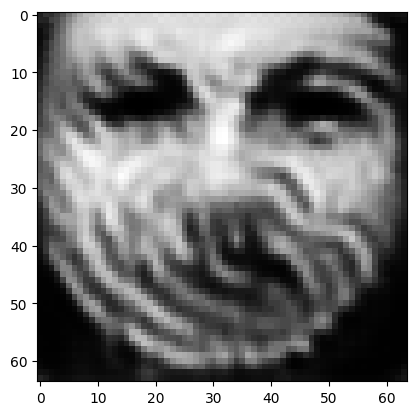

tensor([[3.1566e-06, 4.0469e-05, 1.7586e-04, 1.1198e-04, 1.3389e-05, 5.8724e-05,
         6.3153e-07, 3.2163e-06, 9.9097e-01, 6.3792e-05, 6.3357e-06, 1.1073e-04,
         1.3958e-03, 1.4218e-05, 2.0422e-05, 5.7902e-07, 2.9573e-07, 3.1612e-05,
         2.0157e-06, 7.5202e-05, 4.1984e-04, 2.3857e-06, 8.0026e-07, 1.2459e-08,
         5.8068e-06, 1.2849e-05, 2.3018e-04, 2.2397e-05, 1.7419e-05, 6.6249e-05,
         5.9471e-04, 1.6876e-07, 3.1120e-05, 5.4477e-05, 1.2506e-03, 1.3638e-06,
         6.5670e-07, 8.6254e-06, 4.4081e-04, 3.7381e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009068019688129425
tensor([[3.1371e-06, 3.9993e-05, 1.7462e-04, 1.1130e-04, 1.3232e-05, 5.8164e-05,
         6.2426e-07, 3.1835e-06, 9.9106e-01, 6.3163e-05, 6.2794e-06, 1.0981e-04,
         1.3830e-03, 1.4098e-05, 2.0336e-05, 5.7386e-07, 2.9270e-07, 3.1308e-05,
         1.9991e-06, 7.4519e-05, 4.1687e-04, 2.3694e-06, 7.9069e-07, 1.2363e-08,
         5.7713e-06, 1.2737e-05, 2.2723e-

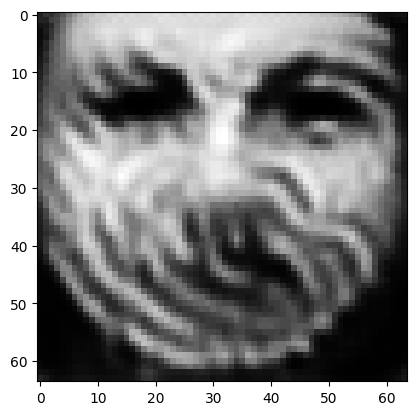

tensor([[3.0629e-06, 3.8198e-05, 1.6994e-04, 1.0863e-04, 1.2655e-05, 5.6095e-05,
         5.9717e-07, 3.0579e-06, 9.9138e-01, 6.0817e-05, 6.0617e-06, 1.0642e-04,
         1.3357e-03, 1.3627e-05, 2.0007e-05, 5.5445e-07, 2.8127e-07, 3.0156e-05,
         1.9351e-06, 7.1962e-05, 4.0563e-04, 2.3083e-06, 7.5468e-07, 1.1994e-08,
         5.6347e-06, 1.2300e-05, 2.1641e-04, 2.1360e-05, 1.6640e-05, 6.3408e-05,
         5.7827e-04, 1.5962e-07, 2.9727e-05, 5.2211e-05, 1.2073e-03, 1.3032e-06,
         6.2810e-07, 8.3590e-06, 4.2281e-04, 3.5399e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008662385866045952
tensor([[3.0455e-06, 3.7760e-05, 1.6882e-04, 1.0794e-04, 1.2520e-05, 5.5641e-05,
         5.9062e-07, 3.0260e-06, 9.9145e-01, 6.0270e-05, 6.0062e-06, 1.0566e-04,
         1.3243e-03, 1.3495e-05, 1.9931e-05, 5.4990e-07, 2.7847e-07, 2.9876e-05,
         1.9195e-06, 7.1340e-05, 4.0286e-04, 2.2930e-06, 7.4570e-07, 1.1897e-08,
         5.5988e-06, 1.2179e-05, 2.1399e-

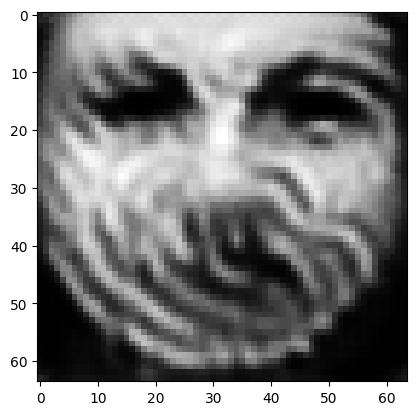

tensor([[2.9798e-06, 3.6112e-05, 1.6465e-04, 1.0526e-04, 1.2016e-05, 5.3976e-05,
         5.6611e-07, 2.9066e-06, 9.9173e-01, 5.8251e-05, 5.7955e-06, 1.0281e-04,
         1.2808e-03, 1.2986e-05, 1.9629e-05, 5.3269e-07, 2.6782e-07, 2.8811e-05,
         1.8610e-06, 6.8984e-05, 3.9229e-04, 2.2338e-06, 7.1204e-07, 1.1525e-08,
         5.4633e-06, 1.1722e-05, 2.0507e-04, 2.0317e-05, 1.5987e-05, 6.0636e-05,
         5.5661e-04, 1.5114e-07, 2.8416e-05, 5.0144e-05, 1.1693e-03, 1.2436e-06,
         5.9944e-07, 8.0735e-06, 4.0613e-04, 3.3801e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008308843709528446
tensor([[2.9649e-06, 3.5738e-05, 1.6367e-04, 1.0465e-04, 1.1900e-05, 5.3593e-05,
         5.6057e-07, 2.8795e-06, 9.9179e-01, 5.7791e-05, 5.7471e-06, 1.0214e-04,
         1.2709e-03, 1.2870e-05, 1.9558e-05, 5.2877e-07, 2.6537e-07, 2.8566e-05,
         1.8476e-06, 6.8449e-05, 3.8982e-04, 2.2200e-06, 7.0436e-07, 1.1440e-08,
         5.4316e-06, 1.1616e-05, 2.0307e-

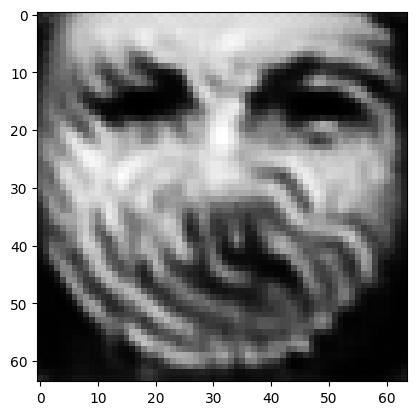

tensor([[2.9092e-06, 3.4320e-05, 1.6005e-04, 1.0223e-04, 1.1473e-05, 5.2199e-05,
         5.3994e-07, 2.7767e-06, 9.9203e-01, 5.6079e-05, 5.5645e-06, 9.9695e-05,
         1.2328e-03, 1.2416e-05, 1.9300e-05, 5.1411e-07, 2.5610e-07, 2.7650e-05,
         1.7969e-06, 6.6456e-05, 3.8054e-04, 2.1685e-06, 6.7509e-07, 1.1113e-08,
         5.3119e-06, 1.1208e-05, 1.9573e-04, 1.9415e-05, 1.5434e-05, 5.8217e-05,
         5.3677e-04, 1.4385e-07, 2.7284e-05, 4.8364e-05, 1.1363e-03, 1.1915e-06,
         5.7423e-07, 7.8160e-06, 3.9175e-04, 3.2469e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008006738498806953
tensor([[2.8962e-06, 3.3989e-05, 1.5921e-04, 1.0163e-04, 1.1373e-05, 5.1875e-05,
         5.3516e-07, 2.7524e-06, 9.9208e-01, 5.5687e-05, 5.5211e-06, 9.9130e-05,
         1.2238e-03, 1.2308e-05, 1.9243e-05, 5.1068e-07, 2.5392e-07, 2.7436e-05,
         1.7848e-06, 6.6001e-05, 3.7834e-04, 2.1566e-06, 6.6808e-07, 1.1036e-08,
         5.2830e-06, 1.1110e-05, 1.9404e-

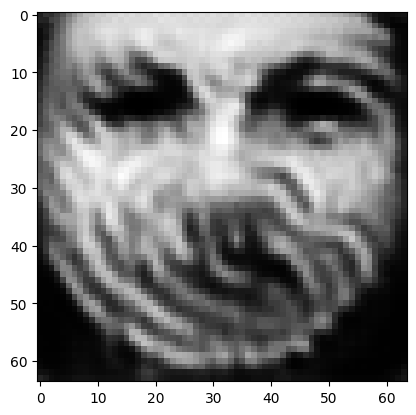

tensor([[2.8439e-06, 3.2659e-05, 1.5569e-04, 9.9256e-05, 1.1003e-05, 5.0557e-05,
         5.1706e-07, 2.6577e-06, 9.9230e-01, 5.4114e-05, 5.3484e-06, 9.6831e-05,
         1.1912e-03, 1.1886e-05, 1.9026e-05, 4.9684e-07, 2.4564e-07, 2.6596e-05,
         1.7359e-06, 6.4264e-05, 3.6964e-04, 2.1101e-06, 6.4174e-07, 1.0731e-08,
         5.1751e-06, 1.0716e-05, 1.8746e-04, 1.8596e-05, 1.4921e-05, 5.5902e-05,
         5.1831e-04, 1.3720e-07, 2.6293e-05, 4.6839e-05, 1.1033e-03, 1.1457e-06,
         5.5140e-07, 7.5627e-06, 3.7946e-04, 3.1270e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007732341066002846
tensor([[2.8309e-06, 3.2331e-05, 1.5482e-04, 9.8663e-05, 1.0915e-05, 5.0234e-05,
         5.1273e-07, 2.6344e-06, 9.9235e-01, 5.3726e-05, 5.3056e-06, 9.6266e-05,
         1.1835e-03, 1.1782e-05, 1.8975e-05, 4.9343e-07, 2.4365e-07, 2.6390e-05,
         1.7237e-06, 6.3848e-05, 3.6754e-04, 2.0990e-06, 6.3546e-07, 1.0656e-08,
         5.1498e-06, 1.0619e-05, 1.8586e-

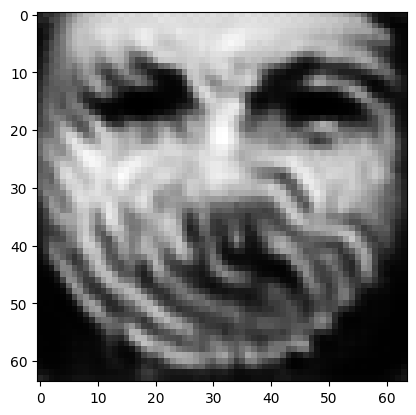

tensor([[2.7813e-06, 3.1099e-05, 1.5147e-04, 9.6386e-05, 1.0582e-05, 4.9002e-05,
         4.9647e-07, 2.5470e-06, 9.9255e-01, 5.2262e-05, 5.1429e-06, 9.4091e-05,
         1.1540e-03, 1.1390e-05, 1.8779e-05, 4.8060e-07, 2.3606e-07, 2.5619e-05,
         1.6776e-06, 6.2249e-05, 3.5959e-04, 2.0565e-06, 6.1188e-07, 1.0372e-08,
         5.0535e-06, 1.0249e-05, 1.7986e-04, 1.7836e-05, 1.4437e-05, 5.3686e-05,
         5.0086e-04, 1.3098e-07, 2.5400e-05, 4.5477e-05, 1.0714e-03, 1.1044e-06,
         5.3032e-07, 7.3169e-06, 3.6864e-04, 3.0176e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007479994557797909
tensor([[2.7692e-06, 3.0807e-05, 1.5066e-04, 9.5841e-05, 1.0503e-05, 4.8705e-05,
         4.9264e-07, 2.5264e-06, 9.9259e-01, 5.1915e-05, 5.1040e-06, 9.3565e-05,
         1.1471e-03, 1.1297e-05, 1.8730e-05, 4.7751e-07, 2.3423e-07, 2.5434e-05,
         1.6664e-06, 6.1869e-05, 3.5763e-04, 2.0464e-06, 6.0634e-07, 1.0303e-08,
         5.0305e-06, 1.0161e-05, 1.7846e-

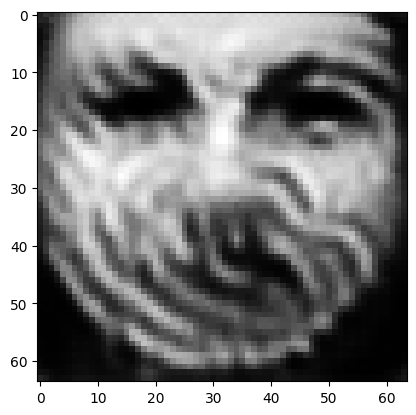

tensor([[2.7246e-06, 2.9734e-05, 1.4765e-04, 9.3778e-05, 1.0208e-05, 4.7622e-05,
         4.7828e-07, 2.4494e-06, 9.9277e-01, 5.0652e-05, 4.9588e-06, 9.1652e-05,
         1.1206e-03, 1.0945e-05, 1.8546e-05, 4.6618e-07, 2.2737e-07, 2.4744e-05,
         1.6253e-06, 6.0444e-05, 3.5041e-04, 2.0084e-06, 5.8554e-07, 1.0042e-08,
         4.9413e-06, 9.8304e-06, 1.7334e-04, 1.7162e-05, 1.4006e-05, 5.1717e-05,
         4.8496e-04, 1.2545e-07, 2.4594e-05, 4.4276e-05, 1.0428e-03, 1.0674e-06,
         5.1120e-07, 7.0928e-06, 3.5895e-04, 2.9233e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007257407996803522
tensor([[2.7144e-06, 2.9491e-05, 1.4695e-04, 9.3323e-05, 1.0140e-05, 4.7373e-05,
         4.7502e-07, 2.4319e-06, 9.9281e-01, 5.0366e-05, 4.9254e-06, 9.1203e-05,
         1.1145e-03, 1.0864e-05, 1.8504e-05, 4.6359e-07, 2.2578e-07, 2.4586e-05,
         1.6160e-06, 6.0117e-05, 3.4871e-04, 1.9996e-06, 5.8074e-07, 9.9822e-09,
         4.9206e-06, 9.7550e-06, 1.7218e-

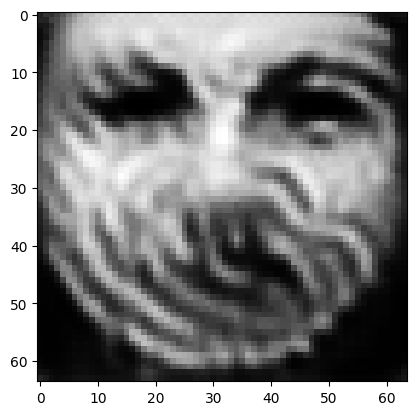

tensor([[2.6773e-06, 2.8564e-05, 1.4430e-04, 9.1301e-05, 9.9128e-06, 4.6474e-05,
         4.6407e-07, 2.3657e-06, 9.9296e-01, 4.9346e-05, 4.7992e-06, 8.9524e-05,
         1.0926e-03, 1.0561e-05, 1.8410e-05, 4.5411e-07, 2.2007e-07, 2.4035e-05,
         1.5808e-06, 5.9099e-05, 3.4270e-04, 1.9697e-06, 5.6255e-07, 9.7626e-09,
         4.8484e-06, 9.4505e-06, 1.6821e-04, 1.6610e-05, 1.3653e-05, 4.9972e-05,
         4.7040e-04, 1.2082e-07, 2.3944e-05, 4.3350e-05, 1.0170e-03, 1.0367e-06,
         4.9471e-07, 6.8755e-06, 3.5170e-04, 2.8431e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007067679427564144
tensor([[2.6688e-06, 2.8352e-05, 1.4369e-04, 9.0842e-05, 9.8595e-06, 4.6265e-05,
         4.6152e-07, 2.3504e-06, 9.9299e-01, 4.9112e-05, 4.7697e-06, 8.9146e-05,
         1.0874e-03, 1.0490e-05, 1.8389e-05, 4.5191e-07, 2.1873e-07, 2.3908e-05,
         1.5726e-06, 5.8858e-05, 3.4131e-04, 1.9629e-06, 5.5828e-07, 9.7116e-09,
         4.8316e-06, 9.3801e-06, 1.6729e-

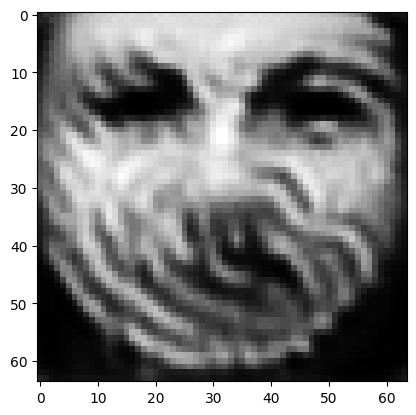

tensor([[2.6404e-06, 2.7728e-05, 1.4140e-04, 8.9624e-05, 9.6513e-06, 4.5387e-05,
         4.5235e-07, 2.3041e-06, 9.9312e-01, 4.8233e-05, 4.6822e-06, 8.7752e-05,
         1.0687e-03, 1.0323e-05, 1.8311e-05, 4.4473e-07, 2.1446e-07, 2.3527e-05,
         1.5482e-06, 5.7996e-05, 3.3705e-04, 1.9390e-06, 5.4500e-07, 9.5682e-09,
         4.7732e-06, 9.1897e-06, 1.6364e-04, 1.6233e-05, 1.3325e-05, 4.8776e-05,
         4.6243e-04, 1.1739e-07, 2.3402e-05, 4.2545e-05, 9.9749e-04, 1.0145e-06,
         4.8330e-07, 6.7289e-06, 3.4481e-04, 2.7674e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006906565278768539
tensor([[2.6337e-06, 2.7587e-05, 1.4085e-04, 8.9349e-05, 9.6006e-06, 4.5173e-05,
         4.5014e-07, 2.2935e-06, 9.9315e-01, 4.8023e-05, 4.6621e-06, 8.7420e-05,
         1.0642e-03, 1.0287e-05, 1.8292e-05, 4.4308e-07, 2.1346e-07, 2.3439e-05,
         1.5426e-06, 5.7786e-05, 3.3607e-04, 1.9332e-06, 5.4192e-07, 9.5358e-09,
         4.7589e-06, 9.1475e-06, 1.6276e-

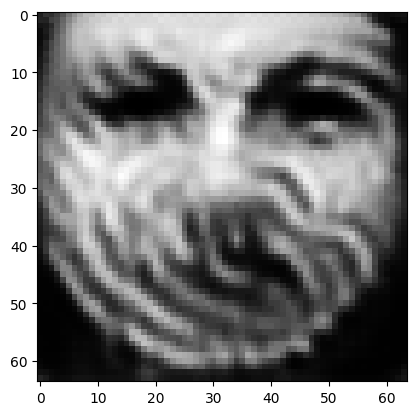

tensor([[2.6083e-06, 2.7043e-05, 1.3877e-04, 8.8288e-05, 9.4113e-06, 4.4370e-05,
         4.4190e-07, 2.2527e-06, 9.9326e-01, 4.7233e-05, 4.5851e-06, 8.6147e-05,
         1.0473e-03, 1.0144e-05, 1.8219e-05, 4.3666e-07, 2.0963e-07, 2.3101e-05,
         1.5212e-06, 5.7000e-05, 3.3227e-04, 1.9113e-06, 5.3013e-07, 9.4115e-09,
         4.7061e-06, 8.9851e-06, 1.5945e-04, 1.5937e-05, 1.3026e-05, 4.7831e-05,
         4.5712e-04, 1.1448e-07, 2.2919e-05, 4.1788e-05, 9.8103e-04, 9.9570e-07,
         4.7415e-07, 6.6123e-06, 3.3840e-04, 2.6965e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006762356963008642
tensor([[2.6023e-06, 2.6913e-05, 1.3828e-04, 8.8027e-05, 9.3672e-06, 4.4185e-05,
         4.3998e-07, 2.2429e-06, 9.9329e-01, 4.7051e-05, 4.5665e-06, 8.5843e-05,
         1.0432e-03, 1.0107e-05, 1.8202e-05, 4.3514e-07, 2.0871e-07, 2.3020e-05,
         1.5162e-06, 5.6816e-05, 3.3135e-04, 1.9061e-06, 5.2727e-07, 9.3810e-09,
         4.6935e-06, 8.9446e-06, 1.5867e-

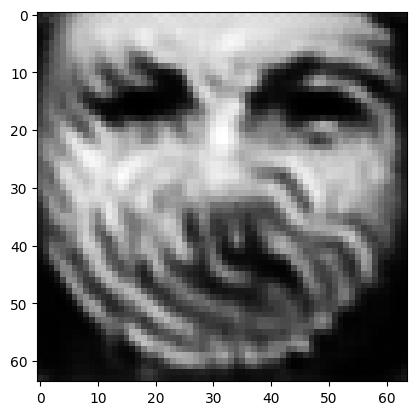

tensor([[2.5783e-06, 2.6461e-05, 1.3636e-04, 8.7246e-05, 9.2050e-06, 4.3406e-05,
         4.3282e-07, 2.2083e-06, 9.9339e-01, 4.6307e-05, 4.5036e-06, 8.4657e-05,
         1.0303e-03, 1.0012e-05, 1.8157e-05, 4.2920e-07, 2.0567e-07, 2.2739e-05,
         1.4981e-06, 5.6131e-05, 3.2838e-04, 1.8871e-06, 5.1821e-07, 9.2886e-09,
         4.6561e-06, 8.8201e-06, 1.5551e-04, 1.5697e-05, 1.2750e-05, 4.7026e-05,
         4.5365e-04, 1.1207e-07, 2.2514e-05, 4.1129e-05, 9.6636e-04, 9.8108e-07,
         4.6675e-07, 6.5117e-06, 3.3294e-04, 2.6274e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006631983909755945
tensor([[2.5726e-06, 2.6353e-05, 1.3592e-04, 8.7058e-05, 9.1665e-06, 4.3221e-05,
         4.3113e-07, 2.2002e-06, 9.9341e-01, 4.6132e-05, 4.4888e-06, 8.4377e-05,
         1.0272e-03, 9.9905e-06, 1.8147e-05, 4.2779e-07, 2.0495e-07, 2.2673e-05,
         1.4938e-06, 5.5970e-05, 3.2767e-04, 1.8827e-06, 5.1605e-07, 9.2670e-09,
         4.6472e-06, 8.7908e-06, 1.5476e-

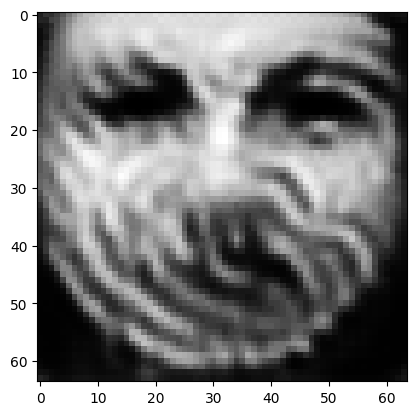

tensor([[2.5502e-06, 2.5926e-05, 1.3413e-04, 8.6192e-05, 9.0156e-06, 4.2526e-05,
         4.2471e-07, 2.1684e-06, 9.9351e-01, 4.5481e-05, 4.4277e-06, 8.3301e-05,
         1.0140e-03, 9.8892e-06, 1.8101e-05, 4.2230e-07, 2.0196e-07, 2.2408e-05,
         1.4764e-06, 5.5370e-05, 3.2480e-04, 1.8653e-06, 5.0691e-07, 9.1734e-09,
         4.6071e-06, 8.6639e-06, 1.5196e-04, 1.5483e-05, 1.2498e-05, 4.6261e-05,
         4.5030e-04, 1.0988e-07, 2.2148e-05, 4.0529e-05, 9.5219e-04, 9.6730e-07,
         4.5990e-07, 6.4138e-06, 3.2794e-04, 2.5641e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006511068437248468
tensor([[2.5447e-06, 2.5823e-05, 1.3370e-04, 8.5972e-05, 8.9794e-06, 4.2360e-05,
         4.2318e-07, 2.1607e-06, 9.9353e-01, 4.5326e-05, 4.4128e-06, 8.3042e-05,
         1.0108e-03, 9.8640e-06, 1.8089e-05, 4.2098e-07, 2.0123e-07, 2.2344e-05,
         1.4721e-06, 5.5228e-05, 3.2409e-04, 1.8611e-06, 5.0465e-07, 9.1499e-09,
         4.5970e-06, 8.6322e-06, 1.5130e-

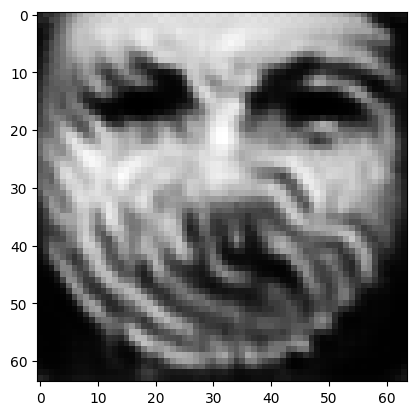

tensor([[2.5241e-06, 2.5427e-05, 1.3205e-04, 8.5099e-05, 8.8432e-06, 4.1746e-05,
         4.1740e-07, 2.1313e-06, 9.9362e-01, 4.4744e-05, 4.3556e-06, 8.2077e-05,
         9.9843e-04, 9.7608e-06, 1.8042e-05, 4.1597e-07, 1.9839e-07, 2.2098e-05,
         1.4556e-06, 5.4676e-05, 3.2130e-04, 1.8451e-06, 4.9603e-07, 9.0572e-09,
         4.5577e-06, 8.5084e-06, 1.4888e-04, 1.5279e-05, 1.2266e-05, 4.5514e-05,
         4.4648e-04, 1.0780e-07, 2.1807e-05, 3.9978e-05, 9.3859e-04, 9.5391e-07,
         4.5323e-07, 6.3166e-06, 3.2332e-04, 2.5091e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006400680169463158
tensor([[2.5193e-06, 2.5333e-05, 1.3166e-04, 8.4897e-05, 8.8108e-06, 4.1600e-05,
         4.1603e-07, 2.1244e-06, 9.9364e-01, 4.4608e-05, 4.3419e-06, 8.1848e-05,
         9.9550e-04, 9.7360e-06, 1.8030e-05, 4.1478e-07, 1.9772e-07, 2.2040e-05,
         1.4517e-06, 5.4543e-05, 3.2063e-04, 1.8413e-06, 4.9400e-07, 9.0352e-09,
         4.5484e-06, 8.4793e-06, 1.4830e-

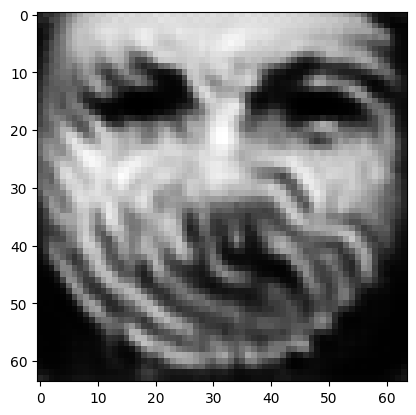

tensor([[2.4997e-06, 2.4966e-05, 1.3015e-04, 8.4129e-05, 8.6884e-06, 4.1027e-05,
         4.1070e-07, 2.0975e-06, 9.9372e-01, 4.4063e-05, 4.2895e-06, 8.0950e-05,
         9.8455e-04, 9.6417e-06, 1.7981e-05, 4.1007e-07, 1.9516e-07, 2.1810e-05,
         1.4362e-06, 5.4017e-05, 3.1809e-04, 1.8264e-06, 4.8646e-07, 8.9497e-09,
         4.5142e-06, 8.3683e-06, 1.4605e-04, 1.5091e-05, 1.2054e-05, 4.4832e-05,
         4.4314e-04, 1.0587e-07, 2.1500e-05, 3.9469e-05, 9.2612e-04, 9.4183e-07,
         4.4718e-07, 6.2291e-06, 3.1914e-04, 2.4597e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0063011785969138145
tensor([[2.4950e-06, 2.4877e-05, 1.2978e-04, 8.3937e-05, 8.6593e-06, 4.0890e-05,
         4.0942e-07, 2.0909e-06, 9.9374e-01, 4.3931e-05, 4.2766e-06, 8.0735e-05,
         9.8189e-04, 9.6183e-06, 1.7971e-05, 4.0894e-07, 1.9455e-07, 2.1755e-05,
         1.4325e-06, 5.3892e-05, 3.1750e-04, 1.8229e-06, 4.8463e-07, 8.9290e-09,
         4.5059e-06, 8.3409e-06, 1.4550e

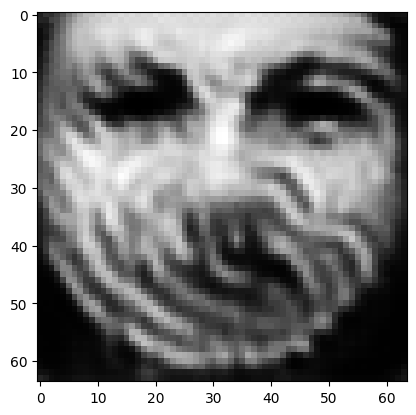

tensor([[2.4764e-06, 2.4531e-05, 1.2837e-04, 8.3200e-05, 8.5453e-06, 4.0352e-05,
         4.0443e-07, 2.0655e-06, 9.9381e-01, 4.3419e-05, 4.2272e-06, 7.9898e-05,
         9.7157e-04, 9.5287e-06, 1.7927e-05, 4.0451e-07, 1.9217e-07, 2.1539e-05,
         1.4179e-06, 5.3402e-05, 3.1516e-04, 1.8092e-06, 4.7754e-07, 8.8493e-09,
         4.4731e-06, 8.2366e-06, 1.4337e-04, 1.4913e-05, 1.1856e-05, 4.4187e-05,
         4.4003e-04, 1.0405e-07, 2.1218e-05, 3.8999e-05, 9.1431e-04, 9.3049e-07,
         4.4154e-07, 6.1455e-06, 3.1533e-04, 2.4139e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006208538077771664
tensor([[2.4719e-06, 2.4446e-05, 1.2803e-04, 8.3016e-05, 8.5178e-06, 4.0223e-05,
         4.0320e-07, 2.0591e-06, 9.9383e-01, 4.3292e-05, 4.2150e-06, 7.9698e-05,
         9.6906e-04, 9.5062e-06, 1.7917e-05, 4.0343e-07, 1.9158e-07, 2.1487e-05,
         1.4143e-06, 5.3284e-05, 3.1459e-04, 1.8058e-06, 4.7579e-07, 8.8297e-09,
         4.4650e-06, 8.2104e-06, 1.4285e-

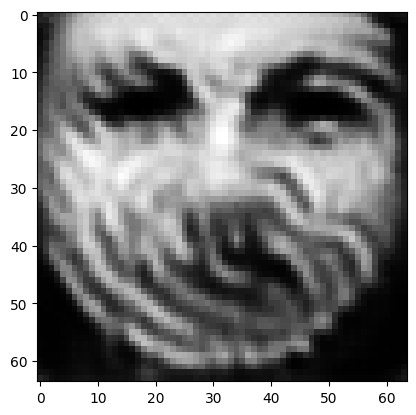

tensor([[2.4546e-06, 2.4115e-05, 1.2670e-04, 8.2306e-05, 8.4100e-06, 3.9722e-05,
         3.9848e-07, 2.0341e-06, 9.9390e-01, 4.2799e-05, 4.1674e-06, 7.8925e-05,
         9.5930e-04, 9.4165e-06, 1.7880e-05, 3.9925e-07, 1.8933e-07, 2.1281e-05,
         1.4003e-06, 5.2824e-05, 3.1236e-04, 1.7928e-06, 4.6891e-07, 8.7533e-09,
         4.4329e-06, 8.1077e-06, 1.4083e-04, 1.4739e-05, 1.1668e-05, 4.3558e-05,
         4.3681e-04, 1.0231e-07, 2.0950e-05, 3.8555e-05, 9.0291e-04, 9.1963e-07,
         4.3613e-07, 6.0633e-06, 3.1172e-04, 2.3704e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006120272912085056
tensor([[2.4505e-06, 2.4036e-05, 1.2637e-04, 8.2135e-05, 8.3834e-06, 3.9602e-05,
         3.9734e-07, 2.0282e-06, 9.9392e-01, 4.2682e-05, 4.1560e-06, 7.8743e-05,
         9.5685e-04, 9.3947e-06, 1.7870e-05, 3.9825e-07, 1.8878e-07, 2.1231e-05,
         1.3970e-06, 5.2711e-05, 3.1181e-04, 1.7896e-06, 4.6725e-07, 8.7345e-09,
         4.4248e-06, 8.0830e-06, 1.4035e-

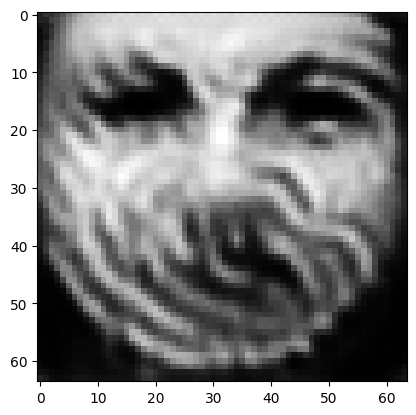

tensor([[2.4343e-06, 2.3728e-05, 1.2512e-04, 8.1465e-05, 8.2807e-06, 3.9140e-05,
         3.9288e-07, 2.0049e-06, 9.9398e-01, 4.2228e-05, 4.1115e-06, 7.8038e-05,
         9.4732e-04, 9.3088e-06, 1.7829e-05, 3.9441e-07, 1.8667e-07, 2.1038e-05,
         1.3839e-06, 5.2271e-05, 3.0965e-04, 1.7773e-06, 4.6081e-07, 8.6618e-09,
         4.3935e-06, 7.9870e-06, 1.3849e-04, 1.4572e-05, 1.1495e-05, 4.2975e-05,
         4.3374e-04, 1.0069e-07, 2.0692e-05, 3.8141e-05, 8.9236e-04, 9.0935e-07,
         4.3105e-07, 5.9880e-06, 3.0816e-04, 2.3306e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.006037924438714981
tensor([[2.4303e-06, 2.3651e-05, 1.2481e-04, 8.1294e-05, 8.2556e-06, 3.9028e-05,
         3.9178e-07, 1.9991e-06, 9.9400e-01, 4.2117e-05, 4.1004e-06, 7.7867e-05,
         9.4497e-04, 9.2864e-06, 1.7818e-05, 3.9347e-07, 1.8615e-07, 2.0989e-05,
         1.3806e-06, 5.2162e-05, 3.0910e-04, 1.7743e-06, 4.5921e-07, 8.6432e-09,
         4.3855e-06, 7.9628e-06, 1.3803e-

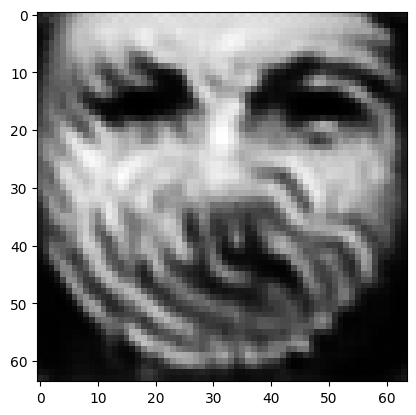

tensor([[2.4151e-06, 2.3359e-05, 1.2364e-04, 8.0645e-05, 8.1605e-06, 3.8606e-05,
         3.8761e-07, 1.9770e-06, 9.9406e-01, 4.1691e-05, 4.0584e-06, 7.7217e-05,
         9.3596e-04, 9.2022e-06, 1.7778e-05, 3.8992e-07, 1.8418e-07, 2.0806e-05,
         1.3682e-06, 5.1751e-05, 3.0706e-04, 1.7629e-06, 4.5315e-07, 8.5723e-09,
         4.3552e-06, 7.8703e-06, 1.3631e-04, 1.4408e-05, 1.1333e-05, 4.2412e-05,
         4.3057e-04, 9.9146e-08, 2.0447e-05, 3.7757e-05, 8.8245e-04, 8.9951e-07,
         4.2616e-07, 5.9156e-06, 3.0480e-04, 2.2947e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005961375776678324
tensor([[2.4115e-06, 2.3289e-05, 1.2335e-04, 8.0492e-05, 8.1377e-06, 3.8505e-05,
         3.8662e-07, 1.9717e-06, 9.9407e-01, 4.1589e-05, 4.0484e-06, 7.7062e-05,
         9.3382e-04, 9.1823e-06, 1.7768e-05, 3.8907e-07, 1.8371e-07, 2.0762e-05,
         1.3652e-06, 5.1655e-05, 3.0656e-04, 1.7602e-06, 4.5171e-07, 8.5552e-09,
         4.3478e-06, 7.8480e-06, 1.3591e-

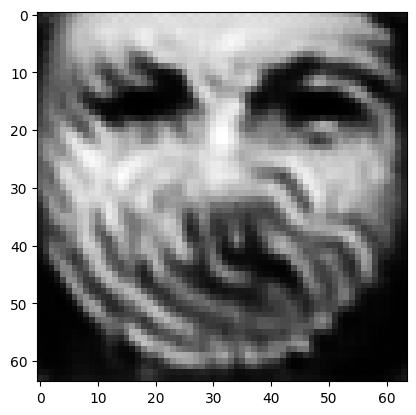

tensor([[2.3976e-06, 2.3021e-05, 1.2226e-04, 7.9890e-05, 8.0507e-06, 3.8117e-05,
         3.8280e-07, 1.9514e-06, 9.9413e-01, 4.1198e-05, 4.0094e-06, 7.6465e-05,
         9.2555e-04, 9.1046e-06, 1.7733e-05, 3.8582e-07, 1.8190e-07, 2.0594e-05,
         1.3538e-06, 5.1285e-05, 3.0467e-04, 1.7496e-06, 4.4613e-07, 8.4893e-09,
         4.3193e-06, 7.7615e-06, 1.3434e-04, 1.4256e-05, 1.1182e-05, 4.1896e-05,
         4.2762e-04, 9.7728e-08, 2.0222e-05, 3.7406e-05, 8.7330e-04, 8.9057e-07,
         4.2159e-07, 5.8484e-06, 3.0169e-04, 2.2617e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005890984088182449
tensor([[2.3944e-06, 2.2958e-05, 1.2200e-04, 7.9742e-05, 8.0303e-06, 3.8025e-05,
         3.8189e-07, 1.9466e-06, 9.9414e-01, 4.1104e-05, 4.0002e-06, 7.6323e-05,
         9.2356e-04, 9.0867e-06, 1.7726e-05, 3.8506e-07, 1.8147e-07, 2.0555e-05,
         1.3511e-06, 5.1199e-05, 3.0422e-04, 1.7472e-06, 4.4479e-07, 8.4739e-09,
         4.3125e-06, 7.7408e-06, 1.3397e-

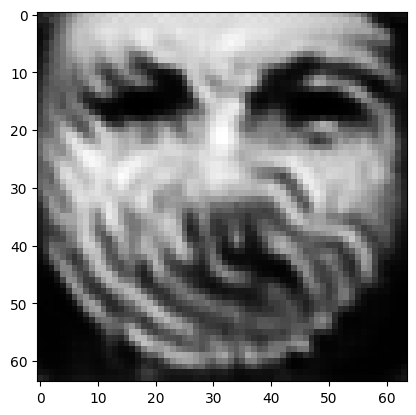

tensor([[2.3814e-06, 2.2712e-05, 1.2100e-04, 7.9178e-05, 7.9501e-06, 3.7669e-05,
         3.7832e-07, 1.9279e-06, 9.9419e-01, 4.0740e-05, 3.9643e-06, 7.5778e-05,
         9.1586e-04, 9.0157e-06, 1.7694e-05, 3.8207e-07, 1.7981e-07, 2.0401e-05,
         1.3405e-06, 5.0853e-05, 3.0247e-04, 1.7374e-06, 4.3965e-07, 8.4126e-09,
         4.2857e-06, 7.6606e-06, 1.3253e-04, 1.4117e-05, 1.1042e-05, 4.1416e-05,
         4.2484e-04, 9.6418e-08, 2.0011e-05, 3.7079e-05, 8.6489e-04, 8.8226e-07,
         4.1741e-07, 5.7859e-06, 2.9877e-04, 2.2314e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00582615751773119
tensor([[2.3783e-06, 2.2654e-05, 1.2076e-04, 7.9040e-05, 7.9308e-06, 3.7583e-05,
         3.7746e-07, 1.9234e-06, 9.9420e-01, 4.0654e-05, 3.9557e-06, 7.5648e-05,
         9.1400e-04, 8.9987e-06, 1.7687e-05, 3.8135e-07, 1.7940e-07, 2.0364e-05,
         1.3380e-06, 5.0771e-05, 3.0205e-04, 1.7351e-06, 4.3841e-07, 8.3977e-09,
         4.2791e-06, 7.6413e-06, 1.3219e-0

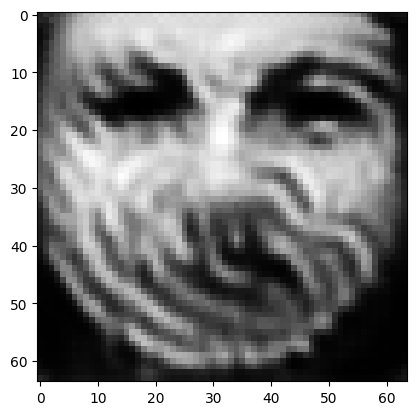

tensor([[2.3663e-06, 2.2430e-05, 1.1984e-04, 7.8503e-05, 7.8572e-06, 3.7253e-05,
         3.7418e-07, 1.9061e-06, 9.9425e-01, 4.0321e-05, 3.9226e-06, 7.5149e-05,
         9.0679e-04, 8.9342e-06, 1.7660e-05, 3.7860e-07, 1.7788e-07, 2.0225e-05,
         1.3282e-06, 5.0458e-05, 3.0046e-04, 1.7262e-06, 4.3365e-07, 8.3415e-09,
         4.2542e-06, 7.5673e-06, 1.3087e-04, 1.3991e-05, 1.0914e-05, 4.0973e-05,
         4.2227e-04, 9.5212e-08, 1.9817e-05, 3.6779e-05, 8.5705e-04, 8.7452e-07,
         4.1352e-07, 5.7274e-06, 2.9607e-04, 2.2033e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005766186397522688
tensor([[2.3634e-06, 2.2376e-05, 1.1962e-04, 7.8372e-05, 7.8393e-06, 3.7174e-05,
         3.7338e-07, 1.9019e-06, 9.9426e-01, 4.0242e-05, 3.9145e-06, 7.5029e-05,
         9.0503e-04, 8.9185e-06, 1.7654e-05, 3.7793e-07, 1.7751e-07, 2.0191e-05,
         1.3259e-06, 5.0382e-05, 3.0008e-04, 1.7240e-06, 4.3249e-07, 8.3278e-09,
         4.2481e-06, 7.5493e-06, 1.3055e-

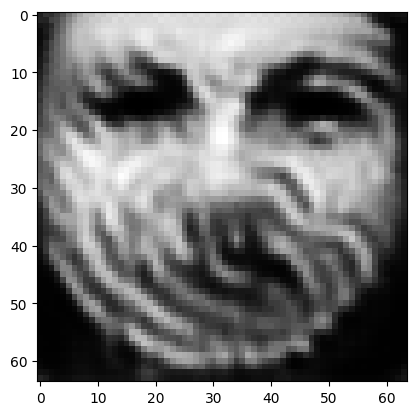

tensor([[2.3520e-06, 2.2163e-05, 1.1877e-04, 7.7857e-05, 7.7703e-06, 3.6868e-05,
         3.7029e-07, 1.8855e-06, 9.9431e-01, 3.9930e-05, 3.8830e-06, 7.4560e-05,
         8.9818e-04, 8.8560e-06, 1.7628e-05, 3.7534e-07, 1.7606e-07, 2.0059e-05,
         1.3167e-06, 5.0087e-05, 2.9860e-04, 1.7156e-06, 4.2799e-07, 8.2741e-09,
         4.2245e-06, 7.4792e-06, 1.2930e-04, 1.3871e-05, 1.0795e-05, 4.0557e-05,
         4.1974e-04, 9.4075e-08, 1.9633e-05, 3.6496e-05, 8.4976e-04, 8.6710e-07,
         4.0985e-07, 5.6718e-06, 2.9353e-04, 2.1773e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005709885619580746
tensor([[2.3492e-06, 2.2112e-05, 1.1856e-04, 7.7731e-05, 7.7535e-06, 3.6794e-05,
         3.6953e-07, 1.8815e-06, 9.9432e-01, 3.9855e-05, 3.8753e-06, 7.4447e-05,
         8.9650e-04, 8.8406e-06, 1.7621e-05, 3.7471e-07, 1.7571e-07, 2.0026e-05,
         1.3144e-06, 5.0015e-05, 2.9824e-04, 1.7135e-06, 4.2689e-07, 8.2609e-09,
         4.2187e-06, 7.4620e-06, 1.2900e-

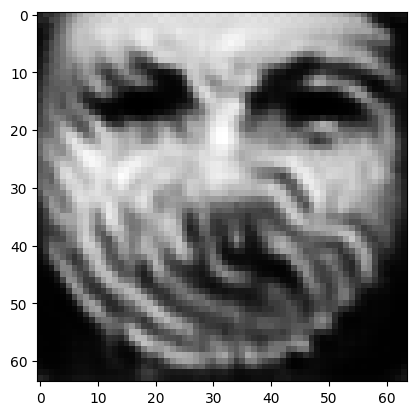

tensor([[2.3386e-06, 2.1914e-05, 1.1776e-04, 7.7242e-05, 7.6891e-06, 3.6509e-05,
         3.6664e-07, 1.8661e-06, 9.9436e-01, 3.9565e-05, 3.8458e-06, 7.4010e-05,
         8.9003e-04, 8.7819e-06, 1.7598e-05, 3.7230e-07, 1.7436e-07, 1.9903e-05,
         1.3059e-06, 4.9741e-05, 2.9687e-04, 1.7057e-06, 4.2268e-07, 8.2106e-09,
         4.1965e-06, 7.3962e-06, 1.2785e-04, 1.3759e-05, 1.0684e-05, 4.0164e-05,
         4.1730e-04, 9.3010e-08, 1.9459e-05, 3.6236e-05, 8.4298e-04, 8.6009e-07,
         4.0639e-07, 5.6193e-06, 2.9115e-04, 2.1530e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005657019559293985
tensor([[2.3360e-06, 2.1866e-05, 1.1757e-04, 7.7126e-05, 7.6736e-06, 3.6440e-05,
         3.6594e-07, 1.8624e-06, 9.9437e-01, 3.9495e-05, 3.8386e-06, 7.3903e-05,
         8.8849e-04, 8.7674e-06, 1.7593e-05, 3.7171e-07, 1.7404e-07, 1.9872e-05,
         1.3038e-06, 4.9674e-05, 2.9653e-04, 1.7037e-06, 4.2167e-07, 8.1982e-09,
         4.1913e-06, 7.3802e-06, 1.2757e-

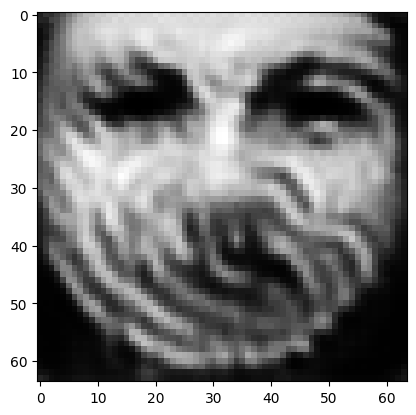

tensor([[2.3262e-06, 2.1684e-05, 1.1682e-04, 7.6680e-05, 7.6142e-06, 3.6176e-05,
         3.6326e-07, 1.8482e-06, 9.9441e-01, 3.9226e-05, 3.8112e-06, 7.3499e-05,
         8.8253e-04, 8.7131e-06, 1.7572e-05, 3.6948e-07, 1.7278e-07, 1.9758e-05,
         1.2959e-06, 4.9418e-05, 2.9525e-04, 1.6963e-06, 4.1779e-07, 8.1515e-09,
         4.1708e-06, 7.3188e-06, 1.2652e-04, 1.3653e-05, 1.0582e-05, 3.9801e-05,
         4.1498e-04, 9.2024e-08, 1.9297e-05, 3.5992e-05, 8.3673e-04, 8.5359e-07,
         4.0313e-07, 5.5706e-06, 2.8893e-04, 2.1305e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005608299747109413
tensor([[2.3238e-06, 2.1640e-05, 1.1664e-04, 7.6574e-05, 7.5997e-06, 3.6112e-05,
         3.6260e-07, 1.8447e-06, 9.9442e-01, 3.9160e-05, 3.8044e-06, 7.3400e-05,
         8.8110e-04, 8.6995e-06, 1.7567e-05, 3.6894e-07, 1.7247e-07, 1.9730e-05,
         1.2940e-06, 4.9355e-05, 2.9494e-04, 1.6945e-06, 4.1685e-07, 8.1399e-09,
         4.1658e-06, 7.3039e-06, 1.2626e-

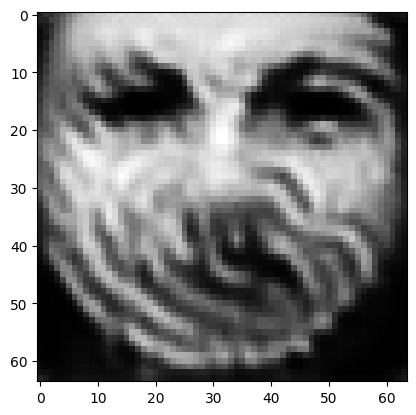

tensor([[2.3146e-06, 2.1469e-05, 1.1594e-04, 7.6160e-05, 7.5436e-06, 3.5866e-05,
         3.6008e-07, 1.8315e-06, 9.9445e-01, 3.8911e-05, 3.7784e-06, 7.3021e-05,
         8.7552e-04, 8.6469e-06, 1.7544e-05, 3.6684e-07, 1.7128e-07, 1.9619e-05,
         1.2865e-06, 4.9111e-05, 2.9371e-04, 1.6875e-06, 4.1321e-07, 8.0951e-09,
         4.1463e-06, 7.2466e-06, 1.2527e-04, 1.3553e-05, 1.0486e-05, 3.9462e-05,
         4.1282e-04, 9.1092e-08, 1.9145e-05, 3.5761e-05, 8.3083e-04, 8.4744e-07,
         4.0006e-07, 5.5251e-06, 2.8685e-04, 2.1097e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005562778562307358
tensor([[2.3123e-06, 2.1427e-05, 1.1577e-04, 7.6059e-05, 7.5300e-06, 3.5806e-05,
         3.5947e-07, 1.8283e-06, 9.9446e-01, 3.8850e-05, 3.7720e-06, 7.2928e-05,
         8.7418e-04, 8.6339e-06, 1.7538e-05, 3.6632e-07, 1.7099e-07, 1.9592e-05,
         1.2847e-06, 4.9052e-05, 2.9341e-04, 1.6858e-06, 4.1233e-07, 8.0841e-09,
         4.1416e-06, 7.2326e-06, 1.2503e-

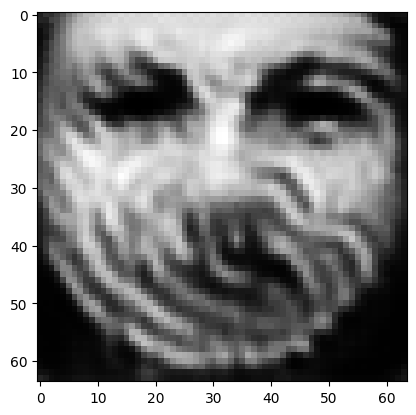

tensor([[2.3037e-06, 2.1270e-05, 1.1513e-04, 7.5671e-05, 7.4785e-06, 3.5579e-05,
         3.5714e-07, 1.8161e-06, 9.9449e-01, 3.8619e-05, 3.7481e-06, 7.2574e-05,
         8.6906e-04, 8.5859e-06, 1.7516e-05, 3.6438e-07, 1.6989e-07, 1.9490e-05,
         1.2778e-06, 4.8830e-05, 2.9227e-04, 1.6794e-06, 4.0898e-07, 8.0429e-09,
         4.1236e-06, 7.1799e-06, 1.2412e-04, 1.3461e-05, 1.0397e-05, 3.9145e-05,
         4.1086e-04, 9.0224e-08, 1.9004e-05, 3.5548e-05, 8.2532e-04, 8.4173e-07,
         3.9723e-07, 5.4829e-06, 2.8492e-04, 2.0907e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005520930048078299
tensor([[2.3016e-06, 2.1232e-05, 1.1497e-04, 7.5580e-05, 7.4655e-06, 3.5523e-05,
         3.5656e-07, 1.8132e-06, 9.9450e-01, 3.8561e-05, 3.7423e-06, 7.2486e-05,
         8.6777e-04, 8.5745e-06, 1.7510e-05, 3.6391e-07, 1.6962e-07, 1.9465e-05,
         1.2762e-06, 4.8772e-05, 2.9200e-04, 1.6778e-06, 4.0817e-07, 8.0327e-09,
         4.1191e-06, 7.1673e-06, 1.2389e-

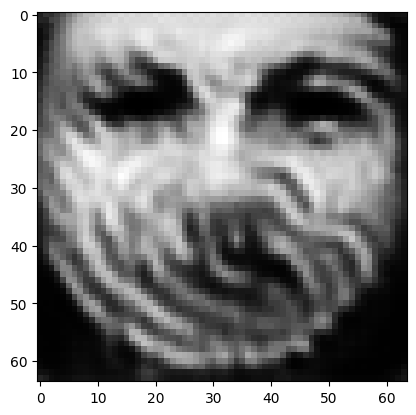

tensor([[2.2936e-06, 2.1088e-05, 1.1436e-04, 7.5237e-05, 7.4172e-06, 3.5307e-05,
         3.5436e-07, 1.8021e-06, 9.9453e-01, 3.8334e-05, 3.7206e-06, 7.2140e-05,
         8.6314e-04, 8.5332e-06, 1.7490e-05, 3.6211e-07, 1.6860e-07, 1.9372e-05,
         1.2700e-06, 4.8561e-05, 2.9095e-04, 1.6717e-06, 4.0514e-07, 7.9952e-09,
         4.1024e-06, 7.1194e-06, 1.2304e-04, 1.3378e-05, 1.0311e-05, 3.8857e-05,
         4.0915e-04, 8.9428e-08, 1.8870e-05, 3.5337e-05, 8.2034e-04, 8.3652e-07,
         3.9463e-07, 5.4448e-06, 2.8308e-04, 2.0722e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005481570027768612
tensor([[2.2917e-06, 2.1055e-05, 1.1421e-04, 7.5154e-05, 7.4058e-06, 3.5256e-05,
         3.5384e-07, 1.7995e-06, 9.9454e-01, 3.8279e-05, 3.7156e-06, 7.2057e-05,
         8.6202e-04, 8.5237e-06, 1.7486e-05, 3.6169e-07, 1.6836e-07, 1.9351e-05,
         1.2685e-06, 4.8511e-05, 2.9070e-04, 1.6702e-06, 4.0442e-07, 7.9864e-09,
         4.0985e-06, 7.1080e-06, 1.2283e-

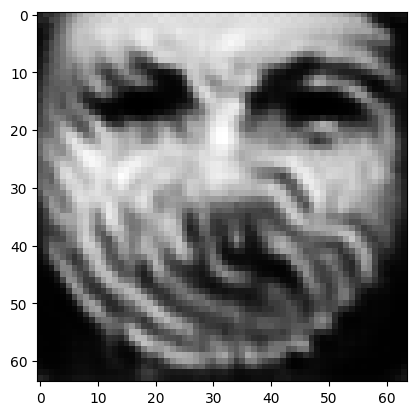

tensor([[2.2843e-06, 2.0921e-05, 1.1364e-04, 7.4833e-05, 7.3614e-06, 3.5058e-05,
         3.5181e-07, 1.7892e-06, 9.9457e-01, 3.8069e-05, 3.6956e-06, 7.1737e-05,
         8.5777e-04, 8.4853e-06, 1.7468e-05, 3.6004e-07, 1.6741e-07, 1.9264e-05,
         1.2628e-06, 4.8315e-05, 2.8973e-04, 1.6646e-06, 4.0164e-07, 7.9516e-09,
         4.0830e-06, 7.0636e-06, 1.2205e-04, 1.3302e-05, 1.0232e-05, 3.8590e-05,
         4.0755e-04, 8.8696e-08, 1.8746e-05, 3.5143e-05, 8.1576e-04, 8.3171e-07,
         3.9224e-07, 5.4093e-06, 2.8140e-04, 2.0553e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005445290356874466
tensor([[2.2825e-06, 2.0889e-05, 1.1351e-04, 7.4757e-05, 7.3506e-06, 3.5011e-05,
         3.5132e-07, 1.7867e-06, 9.9458e-01, 3.8019e-05, 3.6908e-06, 7.1661e-05,
         8.5674e-04, 8.4758e-06, 1.7463e-05, 3.5964e-07, 1.6718e-07, 1.9243e-05,
         1.2614e-06, 4.8267e-05, 2.8950e-04, 1.6632e-06, 4.0097e-07, 7.9431e-09,
         4.0793e-06, 7.0529e-06, 1.2186e-

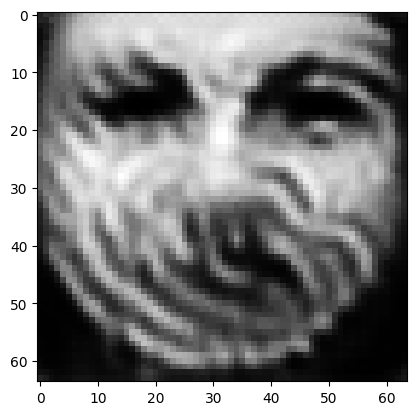

tensor([[2.2757e-06, 2.0767e-05, 1.1299e-04, 7.4454e-05, 7.3096e-06, 3.4829e-05,
         3.4945e-07, 1.7773e-06, 9.9460e-01, 3.7826e-05, 3.6723e-06, 7.1367e-05,
         8.5275e-04, 8.4403e-06, 1.7446e-05, 3.5812e-07, 1.6631e-07, 1.9164e-05,
         1.2562e-06, 4.8088e-05, 2.8860e-04, 1.6580e-06, 3.9838e-07, 7.9107e-09,
         4.0646e-06, 7.0118e-06, 1.2115e-04, 1.3232e-05, 1.0158e-05, 3.8343e-05,
         4.0605e-04, 8.8016e-08, 1.8632e-05, 3.4965e-05, 8.1149e-04, 8.2723e-07,
         3.9001e-07, 5.3765e-06, 2.7983e-04, 2.0397e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005411974154412746
tensor([[2.2740e-06, 2.0736e-05, 1.1286e-04, 7.4382e-05, 7.2995e-06, 3.4785e-05,
         3.4899e-07, 1.7750e-06, 9.9461e-01, 3.7779e-05, 3.6677e-06, 7.1295e-05,
         8.5179e-04, 8.4310e-06, 1.7440e-05, 3.5775e-07, 1.6609e-07, 1.9143e-05,
         1.2548e-06, 4.8043e-05, 2.8837e-04, 1.6567e-06, 3.9775e-07, 7.9025e-09,
         4.0611e-06, 7.0017e-06, 1.2097e-

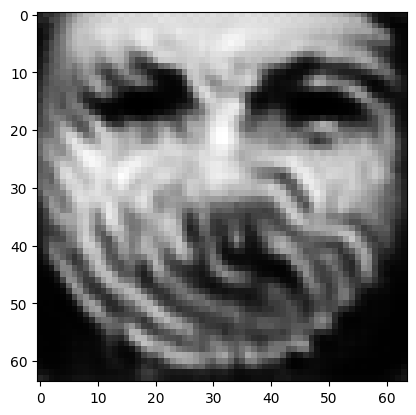

tensor([[2.2675e-06, 2.0620e-05, 1.1237e-04, 7.4097e-05, 7.2606e-06, 3.4615e-05,
         3.4721e-07, 1.7660e-06, 9.9463e-01, 3.7597e-05, 3.6502e-06, 7.1015e-05,
         8.4805e-04, 8.3963e-06, 1.7422e-05, 3.5630e-07, 1.6526e-07, 1.9066e-05,
         1.2498e-06, 4.7872e-05, 2.8751e-04, 1.6517e-06, 3.9530e-07, 7.8715e-09,
         4.0473e-06, 6.9629e-06, 1.2029e-04, 1.3165e-05, 1.0090e-05, 3.8108e-05,
         4.0460e-04, 8.7367e-08, 1.8523e-05, 3.4796e-05, 8.0746e-04, 8.2290e-07,
         3.8788e-07, 5.3454e-06, 2.7836e-04, 2.0253e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00538067240267992
tensor([[2.2659e-06, 2.0591e-05, 1.1226e-04, 7.4029e-05, 7.2511e-06, 3.4573e-05,
         3.4678e-07, 1.7638e-06, 9.9464e-01, 3.7553e-05, 3.6459e-06, 7.0947e-05,
         8.4716e-04, 8.3875e-06, 1.7417e-05, 3.5594e-07, 1.6505e-07, 1.9046e-05,
         1.2486e-06, 4.7829e-05, 2.8730e-04, 1.6505e-06, 3.9471e-07, 7.8638e-09,
         4.0439e-06, 6.9535e-06, 1.2012e-0

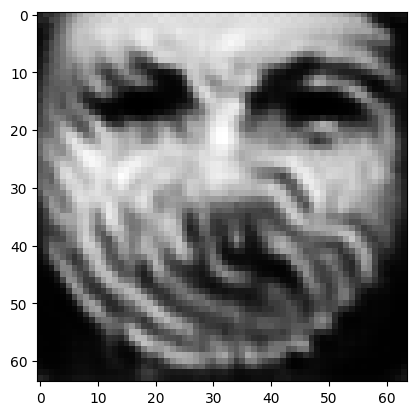

tensor([[2.2598e-06, 2.0481e-05, 1.1180e-04, 7.3762e-05, 7.2148e-06, 3.4413e-05,
         3.4512e-07, 1.7554e-06, 9.9466e-01, 3.7383e-05, 3.6295e-06, 7.0685e-05,
         8.4367e-04, 8.3553e-06, 1.7401e-05, 3.5459e-07, 1.6428e-07, 1.8975e-05,
         1.2439e-06, 4.7670e-05, 2.8651e-04, 1.6459e-06, 3.9243e-07, 7.8350e-09,
         4.0310e-06, 6.9170e-06, 1.1948e-04, 1.3101e-05, 1.0027e-05, 3.7890e-05,
         4.0324e-04, 8.6761e-08, 1.8422e-05, 3.4639e-05, 8.0371e-04, 8.1883e-07,
         3.8589e-07, 5.3162e-06, 2.7698e-04, 2.0118e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005351385101675987
tensor([[2.2584e-06, 2.0455e-05, 1.1170e-04, 7.3695e-05, 7.2063e-06, 3.4375e-05,
         3.4472e-07, 1.7534e-06, 9.9467e-01, 3.7342e-05, 3.6255e-06, 7.0622e-05,
         8.4283e-04, 8.3478e-06, 1.7398e-05, 3.5427e-07, 1.6410e-07, 1.8959e-05,
         1.2428e-06, 4.7633e-05, 2.8633e-04, 1.6448e-06, 3.9188e-07, 7.8283e-09,
         4.0280e-06, 6.9082e-06, 1.1933e-

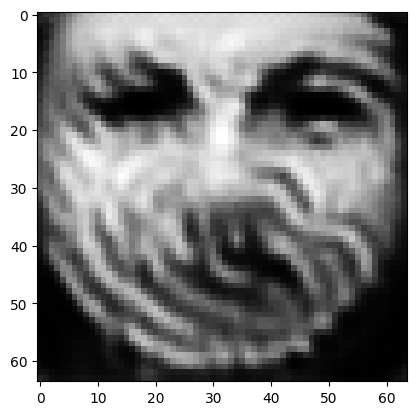

tensor([[2.2527e-06, 2.0352e-05, 1.1128e-04, 7.3439e-05, 7.1728e-06, 3.4225e-05,
         3.4316e-07, 1.7454e-06, 9.9469e-01, 3.7180e-05, 3.6101e-06, 7.0378e-05,
         8.3958e-04, 8.3177e-06, 1.7386e-05, 3.5301e-07, 1.6339e-07, 1.8894e-05,
         1.2384e-06, 4.7485e-05, 2.8562e-04, 1.6405e-06, 3.8974e-07, 7.8018e-09,
         4.0162e-06, 6.8736e-06, 1.1874e-04, 1.3042e-05, 9.9679e-06, 3.7684e-05,
         4.0190e-04, 8.6199e-08, 1.8327e-05, 3.4496e-05, 8.0027e-04, 8.1501e-07,
         3.8406e-07, 5.2883e-06, 2.7570e-04, 1.9991e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005323875695466995
tensor([[2.2513e-06, 2.0327e-05, 1.1118e-04, 7.3377e-05, 7.1648e-06, 3.4189e-05,
         3.4279e-07, 1.7435e-06, 9.9470e-01, 3.7141e-05, 3.6064e-06, 7.0318e-05,
         8.3880e-04, 8.3107e-06, 1.7383e-05, 3.5271e-07, 1.6322e-07, 1.8879e-05,
         1.2373e-06, 4.7450e-05, 2.8545e-04, 1.6395e-06, 3.8923e-07, 7.7955e-09,
         4.0134e-06, 6.8653e-06, 1.1859e-

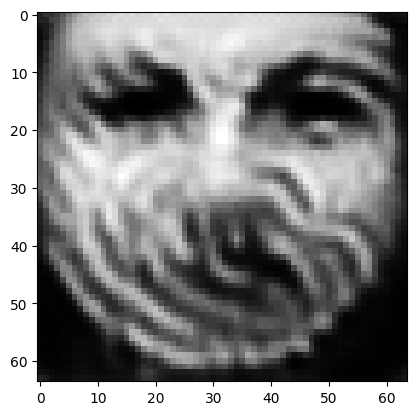

tensor([[2.2459e-06, 2.0229e-05, 1.1078e-04, 7.3132e-05, 7.1332e-06, 3.4048e-05,
         3.4132e-07, 1.7359e-06, 9.9472e-01, 3.6987e-05, 3.5917e-06, 7.0088e-05,
         8.3572e-04, 8.2818e-06, 1.7371e-05, 3.5151e-07, 1.6254e-07, 1.8816e-05,
         1.2331e-06, 4.7309e-05, 2.8476e-04, 1.6354e-06, 3.8720e-07, 7.7701e-09,
         4.0022e-06, 6.8323e-06, 1.1803e-04, 1.2986e-05, 9.9120e-06, 3.7486e-05,
         4.0063e-04, 8.5666e-08, 1.8238e-05, 3.4363e-05, 7.9695e-04, 8.1142e-07,
         3.8233e-07, 5.2616e-06, 2.7450e-04, 1.9871e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0052979071624577045
tensor([[2.2446e-06, 2.0205e-05, 1.1068e-04, 7.3074e-05, 7.1254e-06, 3.4013e-05,
         3.4095e-07, 1.7340e-06, 9.9472e-01, 3.6948e-05, 3.5881e-06, 7.0032e-05,
         8.3498e-04, 8.2746e-06, 1.7368e-05, 3.5121e-07, 1.6238e-07, 1.8801e-05,
         1.2320e-06, 4.7274e-05, 2.8459e-04, 1.6344e-06, 3.8671e-07, 7.7639e-09,
         3.9995e-06, 6.8243e-06, 1.1789e

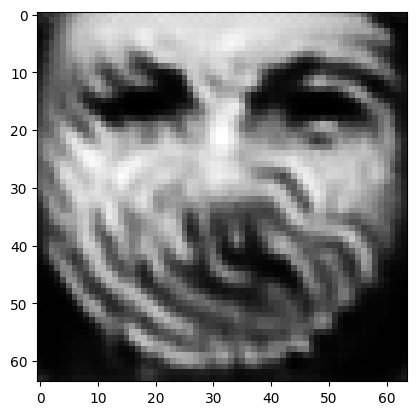

tensor([[2.2396e-06, 2.0115e-05, 1.1031e-04, 7.2854e-05, 7.0954e-06, 3.3881e-05,
         3.3954e-07, 1.7269e-06, 9.9474e-01, 3.6805e-05, 3.5746e-06, 6.9822e-05,
         8.3205e-04, 8.2482e-06, 1.7356e-05, 3.5012e-07, 1.6175e-07, 1.8743e-05,
         1.2282e-06, 4.7139e-05, 2.8395e-04, 1.6306e-06, 3.8481e-07, 7.7406e-09,
         3.9887e-06, 6.7943e-06, 1.1736e-04, 1.2932e-05, 9.8599e-06, 3.7305e-05,
         3.9943e-04, 8.5172e-08, 1.8152e-05, 3.4235e-05, 7.9390e-04, 8.0802e-07,
         3.8069e-07, 5.2374e-06, 2.7334e-04, 1.9758e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005273479502648115
tensor([[2.2383e-06, 2.0094e-05, 1.1022e-04, 7.2802e-05, 7.0879e-06, 3.3849e-05,
         3.3920e-07, 1.7252e-06, 9.9475e-01, 3.6771e-05, 3.5713e-06, 6.9772e-05,
         8.3133e-04, 8.2414e-06, 1.7353e-05, 3.4985e-07, 1.6160e-07, 1.8728e-05,
         1.2272e-06, 4.7105e-05, 2.8379e-04, 1.6296e-06, 3.8435e-07, 7.7346e-09,
         3.9860e-06, 6.7868e-06, 1.1724e-

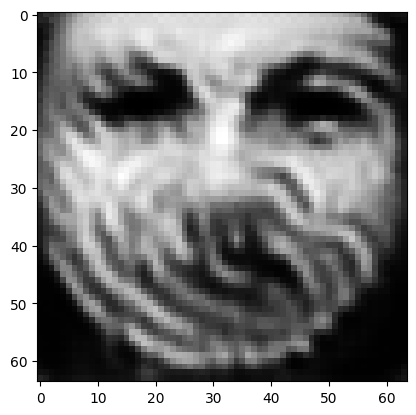

tensor([[2.2337e-06, 2.0010e-05, 1.0988e-04, 7.2595e-05, 7.0598e-06, 3.3726e-05,
         3.3788e-07, 1.7185e-06, 9.9476e-01, 3.6637e-05, 3.5587e-06, 6.9575e-05,
         8.2857e-04, 8.2169e-06, 1.7342e-05, 3.4883e-07, 1.6101e-07, 1.8675e-05,
         1.2236e-06, 4.6978e-05, 2.8319e-04, 1.6260e-06, 3.8257e-07, 7.7129e-09,
         3.9758e-06, 6.7586e-06, 1.1675e-04, 1.2882e-05, 9.8115e-06, 3.7138e-05,
         3.9829e-04, 8.4710e-08, 1.8071e-05, 3.4115e-05, 7.9109e-04, 8.0480e-07,
         3.7915e-07, 5.2148e-06, 2.7224e-04, 1.9653e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005250830203294754
tensor([[2.2325e-06, 1.9990e-05, 1.0979e-04, 7.2547e-05, 7.0529e-06, 3.3696e-05,
         3.3755e-07, 1.7169e-06, 9.9477e-01, 3.6604e-05, 3.5556e-06, 6.9528e-05,
         8.2792e-04, 8.2108e-06, 1.7339e-05, 3.4858e-07, 1.6087e-07, 1.8661e-05,
         1.2227e-06, 4.6946e-05, 2.8305e-04, 1.6251e-06, 3.8215e-07, 7.7075e-09,
         3.9734e-06, 6.7518e-06, 1.1663e-

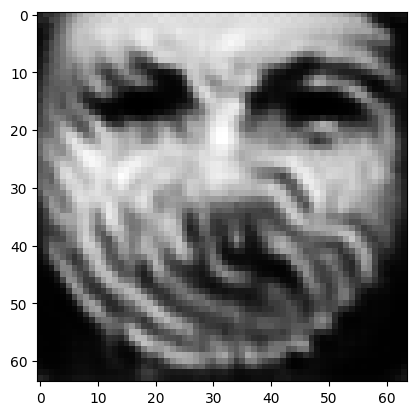

tensor([[2.2280e-06, 1.9911e-05, 1.0947e-04, 7.2352e-05, 7.0268e-06, 3.3582e-05,
         3.3630e-07, 1.7106e-06, 9.9478e-01, 3.6480e-05, 3.5435e-06, 6.9347e-05,
         8.2538e-04, 8.1862e-06, 1.7328e-05, 3.4759e-07, 1.6031e-07, 1.8610e-05,
         1.2192e-06, 4.6827e-05, 2.8246e-04, 1.6217e-06, 3.8046e-07, 7.6860e-09,
         3.9638e-06, 6.7244e-06, 1.1617e-04, 1.2833e-05, 9.7660e-06, 3.6979e-05,
         3.9719e-04, 8.4272e-08, 1.7995e-05, 3.4003e-05, 7.8842e-04, 8.0176e-07,
         3.7768e-07, 5.1935e-06, 2.7121e-04, 1.9556e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005229484755545855
tensor([[2.2270e-06, 1.9892e-05, 1.0939e-04, 7.2303e-05, 7.0206e-06, 3.3555e-05,
         3.3600e-07, 1.7091e-06, 9.9479e-01, 3.6450e-05, 3.5406e-06, 6.9303e-05,
         8.2475e-04, 8.1801e-06, 1.7325e-05, 3.4735e-07, 1.6017e-07, 1.8597e-05,
         1.2183e-06, 4.6799e-05, 2.8232e-04, 1.6209e-06, 3.8004e-07, 7.6808e-09,
         3.9614e-06, 6.7177e-06, 1.1606e-

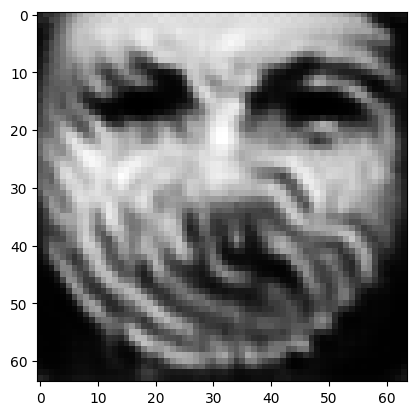

tensor([[2.2228e-06, 1.9817e-05, 1.0909e-04, 7.2117e-05, 6.9962e-06, 3.3450e-05,
         3.3482e-07, 1.7031e-06, 9.9480e-01, 3.6336e-05, 3.5290e-06, 6.9136e-05,
         8.2235e-04, 8.1560e-06, 1.7315e-05, 3.4642e-07, 1.5964e-07, 1.8548e-05,
         1.2149e-06, 4.6688e-05, 2.8177e-04, 1.6176e-06, 3.7842e-07, 7.6602e-09,
         3.9523e-06, 6.6914e-06, 1.1564e-04, 1.2785e-05, 9.7239e-06, 3.6826e-05,
         3.9609e-04, 8.3855e-08, 1.7923e-05, 3.3900e-05, 7.8588e-04, 7.9883e-07,
         3.7627e-07, 5.1729e-06, 2.7025e-04, 1.9467e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005209680180996656
tensor([[2.2219e-06, 1.9799e-05, 1.0902e-04, 7.2071e-05, 6.9904e-06, 3.3425e-05,
         3.3454e-07, 1.7017e-06, 9.9481e-01, 3.6308e-05, 3.5262e-06, 6.9096e-05,
         8.2177e-04, 8.1501e-06, 1.7312e-05, 3.4620e-07, 1.5951e-07, 1.8536e-05,
         1.2141e-06, 4.6662e-05, 2.8163e-04, 1.6168e-06, 3.7802e-07, 7.6553e-09,
         3.9501e-06, 6.6850e-06, 1.1554e-

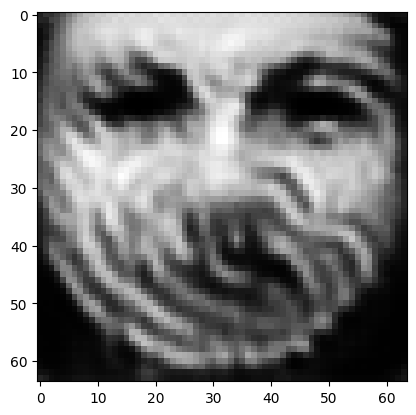

tensor([[2.2179e-06, 1.9728e-05, 1.0874e-04, 7.1894e-05, 6.9669e-06, 3.3326e-05,
         3.3340e-07, 1.6960e-06, 9.9482e-01, 3.6201e-05, 3.5152e-06, 6.8939e-05,
         8.1941e-04, 8.1267e-06, 1.7302e-05, 3.4532e-07, 1.5901e-07, 1.8489e-05,
         1.2109e-06, 4.6555e-05, 2.8111e-04, 1.6137e-06, 3.7646e-07, 7.6355e-09,
         3.9412e-06, 6.6600e-06, 1.1513e-04, 1.2739e-05, 9.6846e-06, 3.6683e-05,
         3.9499e-04, 8.3460e-08, 1.7854e-05, 3.3801e-05, 7.8353e-04, 7.9597e-07,
         3.7491e-07, 5.1534e-06, 2.6932e-04, 1.9383e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005190705880522728
tensor([[2.2170e-06, 1.9711e-05, 1.0867e-04, 7.1852e-05, 6.9612e-06, 3.3302e-05,
         3.3312e-07, 1.6946e-06, 9.9483e-01, 3.6175e-05, 3.5125e-06, 6.8900e-05,
         8.1884e-04, 8.1208e-06, 1.7299e-05, 3.4510e-07, 1.5888e-07, 1.8477e-05,
         1.2101e-06, 4.6529e-05, 2.8097e-04, 1.6129e-06, 3.7608e-07, 7.6306e-09,
         3.9390e-06, 6.6538e-06, 1.1503e-

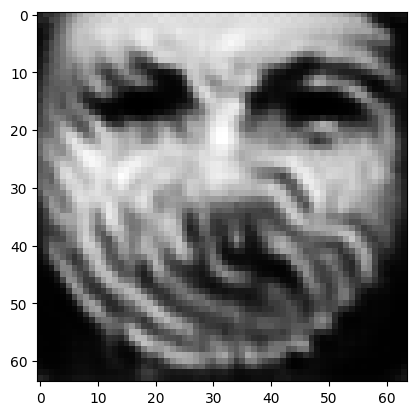

tensor([[2.2133e-06, 1.9645e-05, 1.0841e-04, 7.1686e-05, 6.9392e-06, 3.3209e-05,
         3.3205e-07, 1.6893e-06, 9.9484e-01, 3.6074e-05, 3.5022e-06, 6.8753e-05,
         8.1662e-04, 8.0993e-06, 1.7290e-05, 3.4428e-07, 1.5841e-07, 1.8433e-05,
         1.2071e-06, 4.6430e-05, 2.8048e-04, 1.6100e-06, 3.7462e-07, 7.6124e-09,
         3.9307e-06, 6.6306e-06, 1.1465e-04, 1.2696e-05, 9.6476e-06, 3.6549e-05,
         3.9397e-04, 8.3089e-08, 1.7789e-05, 3.3707e-05, 7.8132e-04, 7.9329e-07,
         3.7363e-07, 5.1353e-06, 2.6844e-04, 1.9304e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005172916688024998
tensor([[2.2124e-06, 1.9629e-05, 1.0834e-04, 7.1647e-05, 6.9338e-06, 3.3186e-05,
         3.3179e-07, 1.6880e-06, 9.9484e-01, 3.6050e-05, 3.4996e-06, 6.8717e-05,
         8.1609e-04, 8.0939e-06, 1.7287e-05, 3.4408e-07, 1.5829e-07, 1.8422e-05,
         1.2064e-06, 4.6405e-05, 2.8036e-04, 1.6093e-06, 3.7427e-07, 7.6078e-09,
         3.9287e-06, 6.6250e-06, 1.1456e-

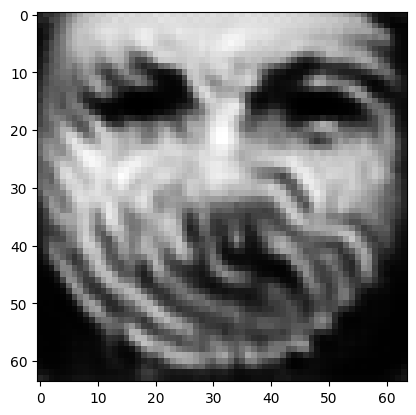

tensor([[2.2089e-06, 1.9568e-05, 1.0809e-04, 7.1498e-05, 6.9132e-06, 3.3097e-05,
         3.3079e-07, 1.6831e-06, 9.9486e-01, 3.5954e-05, 3.4901e-06, 6.8576e-05,
         8.1406e-04, 8.0740e-06, 1.7277e-05, 3.4329e-07, 1.5785e-07, 1.8380e-05,
         1.2036e-06, 4.6310e-05, 2.7988e-04, 1.6065e-06, 3.7293e-07, 7.5907e-09,
         3.9210e-06, 6.6035e-06, 1.1421e-04, 1.2655e-05, 9.6123e-06, 3.6424e-05,
         3.9306e-04, 8.2743e-08, 1.7729e-05, 3.3619e-05, 7.7925e-04, 7.9084e-07,
         3.7244e-07, 5.1186e-06, 2.6762e-04, 1.9230e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0051564318127930164
tensor([[2.2081e-06, 1.9552e-05, 1.0803e-04, 7.1461e-05, 6.9082e-06, 3.3076e-05,
         3.3055e-07, 1.6818e-06, 9.9486e-01, 3.5931e-05, 3.4877e-06, 6.8542e-05,
         8.1354e-04, 8.0690e-06, 1.7275e-05, 3.4310e-07, 1.5774e-07, 1.8369e-05,
         1.2029e-06, 4.6286e-05, 2.7976e-04, 1.6058e-06, 3.7260e-07, 7.5865e-09,
         3.9191e-06, 6.5982e-06, 1.1412e

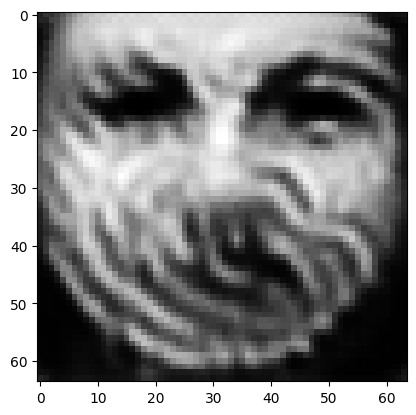

tensor([[2.2048e-06, 1.9493e-05, 1.0780e-04, 7.1317e-05, 6.8884e-06, 3.2992e-05,
         3.2957e-07, 1.6770e-06, 9.9487e-01, 3.5840e-05, 3.4783e-06, 6.8407e-05,
         8.1154e-04, 8.0488e-06, 1.7264e-05, 3.4234e-07, 1.5731e-07, 1.8328e-05,
         1.2002e-06, 4.6192e-05, 2.7931e-04, 1.6031e-06, 3.7130e-07, 7.5699e-09,
         3.9117e-06, 6.5776e-06, 1.1377e-04, 1.2616e-05, 9.5798e-06, 3.6305e-05,
         3.9212e-04, 8.2407e-08, 1.7669e-05, 3.3533e-05, 7.7733e-04, 7.8839e-07,
         3.7128e-07, 5.1026e-06, 2.6683e-04, 1.9160e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005140658468008041
tensor([[2.2040e-06, 1.9479e-05, 1.0775e-04, 7.1282e-05, 6.8836e-06, 3.2972e-05,
         3.2934e-07, 1.6759e-06, 9.9488e-01, 3.5818e-05, 3.4761e-06, 6.8374e-05,
         8.1105e-04, 8.0440e-06, 1.7262e-05, 3.4216e-07, 1.5721e-07, 1.8319e-05,
         1.1996e-06, 4.6170e-05, 2.7920e-04, 1.6025e-06, 3.7098e-07, 7.5659e-09,
         3.9099e-06, 6.5727e-06, 1.1369e-

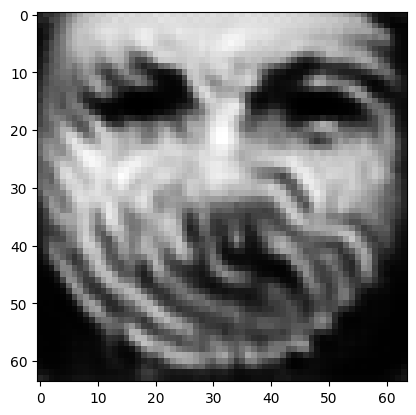

tensor([[2.2009e-06, 1.9423e-05, 1.0753e-04, 7.1145e-05, 6.8648e-06, 3.2894e-05,
         3.2843e-07, 1.6714e-06, 9.9489e-01, 3.5734e-05, 3.4674e-06, 6.8247e-05,
         8.0912e-04, 8.0250e-06, 1.7253e-05, 3.4146e-07, 1.5680e-07, 1.8280e-05,
         1.1971e-06, 4.6081e-05, 2.7877e-04, 1.5999e-06, 3.6975e-07, 7.5503e-09,
         3.9029e-06, 6.5533e-06, 1.1337e-04, 1.2579e-05, 9.5496e-06, 3.6194e-05,
         3.9122e-04, 8.2093e-08, 1.7613e-05, 3.3453e-05, 7.7554e-04, 7.8606e-07,
         3.7019e-07, 5.0874e-06, 2.6609e-04, 1.9094e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0051255966536700726
tensor([[2.2002e-06, 1.9410e-05, 1.0748e-04, 7.1110e-05, 6.8603e-06, 3.2876e-05,
         3.2821e-07, 1.6703e-06, 9.9489e-01, 3.5713e-05, 3.4653e-06, 6.8217e-05,
         8.0865e-04, 8.0205e-06, 1.7251e-05, 3.4129e-07, 1.5670e-07, 1.8272e-05,
         1.1965e-06, 4.6061e-05, 2.7867e-04, 1.5993e-06, 3.6945e-07, 7.5466e-09,
         3.9012e-06, 6.5485e-06, 1.1329e

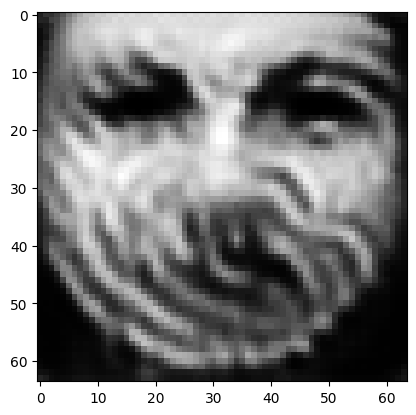

tensor([[2.1972e-06, 1.9357e-05, 1.0727e-04, 7.0980e-05, 6.8427e-06, 3.2801e-05,
         3.2735e-07, 1.6660e-06, 9.9490e-01, 3.5632e-05, 3.4571e-06, 6.8096e-05,
         8.0683e-04, 8.0029e-06, 1.7243e-05, 3.4063e-07, 1.5632e-07, 1.8236e-05,
         1.1941e-06, 4.5978e-05, 2.7828e-04, 1.5969e-06, 3.6829e-07, 7.5320e-09,
         3.8946e-06, 6.5302e-06, 1.1299e-04, 1.2544e-05, 9.5209e-06, 3.6089e-05,
         3.9039e-04, 8.1798e-08, 1.7560e-05, 3.3377e-05, 7.7386e-04, 7.8388e-07,
         3.6916e-07, 5.0731e-06, 2.6538e-04, 1.9032e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005111601669341326
tensor([[2.1965e-06, 1.9344e-05, 1.0722e-04, 7.0947e-05, 6.8384e-06, 3.2783e-05,
         3.2714e-07, 1.6650e-06, 9.9490e-01, 3.5613e-05, 3.4551e-06, 6.8067e-05,
         8.0639e-04, 7.9987e-06, 1.7241e-05, 3.4047e-07, 1.5623e-07, 1.8227e-05,
         1.1935e-06, 4.5959e-05, 2.7818e-04, 1.5964e-06, 3.6801e-07, 7.5286e-09,
         3.8930e-06, 6.5258e-06, 1.1291e-

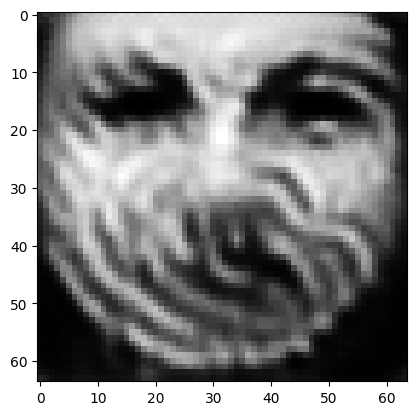

tensor([[2.1938e-06, 1.9294e-05, 1.0703e-04, 7.0823e-05, 6.8218e-06, 3.2713e-05,
         3.2634e-07, 1.6610e-06, 9.9491e-01, 3.5536e-05, 3.4474e-06, 6.7953e-05,
         8.0468e-04, 7.9821e-06, 1.7233e-05, 3.3984e-07, 1.5588e-07, 1.8194e-05,
         1.1913e-06, 4.5881e-05, 2.7781e-04, 1.5941e-06, 3.6691e-07, 7.5149e-09,
         3.8868e-06, 6.5086e-06, 1.1263e-04, 1.2511e-05, 9.4939e-06, 3.5990e-05,
         3.8960e-04, 8.1521e-08, 1.7510e-05, 3.3306e-05, 7.7226e-04, 7.8183e-07,
         3.6821e-07, 5.0595e-06, 2.6473e-04, 1.8973e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005098318215459585
tensor([[2.1931e-06, 1.9282e-05, 1.0698e-04, 7.0793e-05, 6.8178e-06, 3.2697e-05,
         3.2615e-07, 1.6600e-06, 9.9492e-01, 3.5518e-05, 3.4455e-06, 6.7925e-05,
         8.0426e-04, 7.9782e-06, 1.7232e-05, 3.3969e-07, 1.5579e-07, 1.8186e-05,
         1.1908e-06, 4.5863e-05, 2.7772e-04, 1.5936e-06, 3.6665e-07, 7.5116e-09,
         3.8853e-06, 6.5044e-06, 1.1256e-

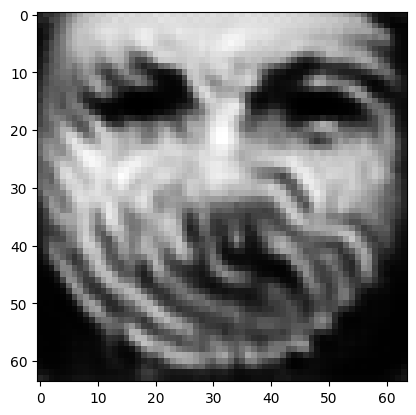

tensor([[2.1905e-06, 1.9235e-05, 1.0680e-04, 7.0677e-05, 6.8021e-06, 3.2631e-05,
         3.2539e-07, 1.6562e-06, 9.9493e-01, 3.5447e-05, 3.4383e-06, 6.7819e-05,
         8.0265e-04, 7.9623e-06, 1.7225e-05, 3.3911e-07, 1.5545e-07, 1.8154e-05,
         1.1886e-06, 4.5791e-05, 2.7737e-04, 1.5915e-06, 3.6562e-07, 7.4987e-09,
         3.8795e-06, 6.4881e-06, 1.1229e-04, 1.2480e-05, 9.4686e-06, 3.5897e-05,
         3.8886e-04, 8.1261e-08, 1.7464e-05, 3.3240e-05, 7.7074e-04, 7.7991e-07,
         3.6730e-07, 5.0467e-06, 2.6411e-04, 1.8917e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005085627548396587
tensor([[2.1899e-06, 1.9224e-05, 1.0675e-04, 7.0649e-05, 6.7984e-06, 3.2615e-05,
         3.2521e-07, 1.6553e-06, 9.9493e-01, 3.5429e-05, 3.4365e-06, 6.7793e-05,
         8.0226e-04, 7.9585e-06, 1.7223e-05, 3.3896e-07, 1.5537e-07, 1.8146e-05,
         1.1881e-06, 4.5773e-05, 2.7728e-04, 1.5910e-06, 3.6537e-07, 7.4956e-09,
         3.8781e-06, 6.4841e-06, 1.1222e-

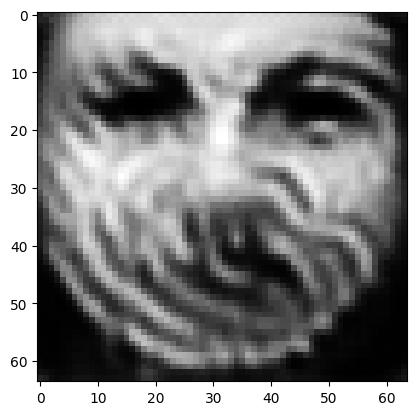

tensor([[2.1875e-06, 1.9179e-05, 1.0658e-04, 7.0539e-05, 6.7835e-06, 3.2553e-05,
         3.2449e-07, 1.6517e-06, 9.9494e-01, 3.5362e-05, 3.4296e-06, 6.7693e-05,
         8.0073e-04, 7.9435e-06, 1.7216e-05, 3.3841e-07, 1.5505e-07, 1.8116e-05,
         1.1861e-06, 4.5705e-05, 2.7695e-04, 1.5890e-06, 3.6439e-07, 7.4834e-09,
         3.8725e-06, 6.4687e-06, 1.1197e-04, 1.2451e-05, 9.4447e-06, 3.5809e-05,
         3.8816e-04, 8.1015e-08, 1.7420e-05, 3.3177e-05, 7.6930e-04, 7.7808e-07,
         3.6645e-07, 5.0347e-06, 2.6352e-04, 1.8865e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005073767155408859
tensor([[2.1869e-06, 1.9169e-05, 1.0654e-04, 7.0512e-05, 6.7800e-06, 3.2538e-05,
         3.2432e-07, 1.6508e-06, 9.9494e-01, 3.5346e-05, 3.4280e-06, 6.7668e-05,
         8.0035e-04, 7.9400e-06, 1.7215e-05, 3.3827e-07, 1.5498e-07, 1.8109e-05,
         1.1857e-06, 4.5688e-05, 2.7687e-04, 1.5885e-06, 3.6416e-07, 7.4805e-09,
         3.8712e-06, 6.4650e-06, 1.1190e-

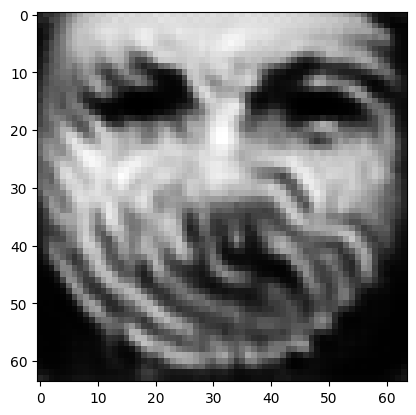

tensor([[2.1846e-06, 1.9127e-05, 1.0637e-04, 7.0408e-05, 6.7659e-06, 3.2479e-05,
         3.2364e-07, 1.6474e-06, 9.9495e-01, 3.5282e-05, 3.4214e-06, 6.7574e-05,
         7.9889e-04, 7.9256e-06, 1.7208e-05, 3.3774e-07, 1.5468e-07, 1.8080e-05,
         1.1838e-06, 4.5623e-05, 2.7655e-04, 1.5866e-06, 3.6323e-07, 7.4687e-09,
         3.8659e-06, 6.4503e-06, 1.1166e-04, 1.2423e-05, 9.4221e-06, 3.5725e-05,
         3.8748e-04, 8.0782e-08, 1.7378e-05, 3.3117e-05, 7.6794e-04, 7.7634e-07,
         3.6563e-07, 5.0232e-06, 2.6296e-04, 1.8815e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00506261782720685
tensor([[2.1840e-06, 1.9116e-05, 1.0633e-04, 7.0382e-05, 6.7624e-06, 3.2465e-05,
         3.2347e-07, 1.6466e-06, 9.9495e-01, 3.5267e-05, 3.4198e-06, 6.7550e-05,
         7.9853e-04, 7.9220e-06, 1.7206e-05, 3.3761e-07, 1.5460e-07, 1.8073e-05,
         1.1833e-06, 4.5607e-05, 2.7647e-04, 1.5861e-06, 3.6300e-07, 7.4659e-09,
         3.8646e-06, 6.4467e-06, 1.1160e-0

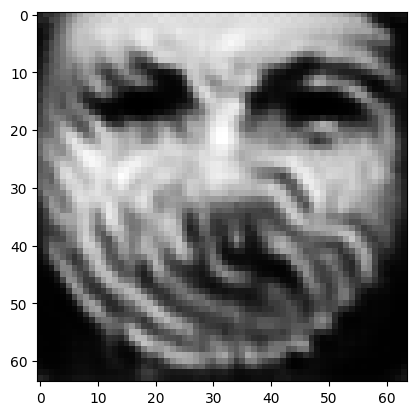

tensor([[2.1818e-06, 1.9076e-05, 1.0618e-04, 7.0280e-05, 6.7490e-06, 3.2410e-05,
         3.2283e-07, 1.6433e-06, 9.9496e-01, 3.5207e-05, 3.4135e-06, 6.7460e-05,
         7.9712e-04, 7.9080e-06, 1.7200e-05, 3.3711e-07, 1.5431e-07, 1.8046e-05,
         1.1815e-06, 4.5545e-05, 2.7617e-04, 1.5843e-06, 3.6211e-07, 7.4546e-09,
         3.8594e-06, 6.4326e-06, 1.1137e-04, 1.2396e-05, 9.4009e-06, 3.5645e-05,
         3.8682e-04, 8.0557e-08, 1.7338e-05, 3.3060e-05, 7.6664e-04, 7.7465e-07,
         3.6485e-07, 5.0121e-06, 2.6242e-04, 1.8769e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005051824729889631
tensor([[2.1812e-06, 1.9066e-05, 1.0614e-04, 7.0255e-05, 6.7457e-06, 3.2396e-05,
         3.2267e-07, 1.6426e-06, 9.9496e-01, 3.5192e-05, 3.4120e-06, 6.7438e-05,
         7.9678e-04, 7.9046e-06, 1.7198e-05, 3.3699e-07, 1.5424e-07, 1.8039e-05,
         1.1810e-06, 4.5530e-05, 2.7610e-04, 1.5839e-06, 3.6189e-07, 7.4518e-09,
         3.8582e-06, 6.4292e-06, 1.1132e-

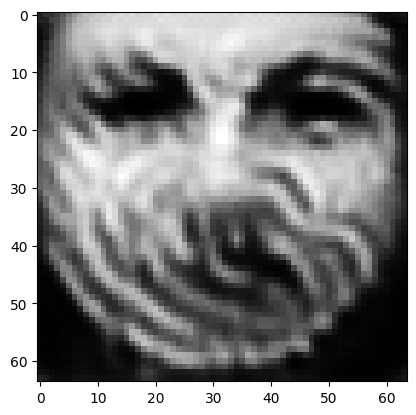

tensor([[2.1791e-06, 1.9027e-05, 1.0599e-04, 7.0159e-05, 6.7329e-06, 3.2343e-05,
         3.2205e-07, 1.6394e-06, 9.9497e-01, 3.5135e-05, 3.4060e-06, 6.7352e-05,
         7.9544e-04, 7.8911e-06, 1.7192e-05, 3.3650e-07, 1.5396e-07, 1.8013e-05,
         1.1793e-06, 4.5470e-05, 2.7581e-04, 1.5821e-06, 3.6104e-07, 7.4410e-09,
         3.8533e-06, 6.4158e-06, 1.1110e-04, 1.2370e-05, 9.3808e-06, 3.5569e-05,
         3.8620e-04, 8.0342e-08, 1.7300e-05, 3.3006e-05, 7.6540e-04, 7.7303e-07,
         3.6410e-07, 5.0016e-06, 2.6192e-04, 1.8725e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005041624419391155
tensor([[2.1786e-06, 1.9018e-05, 1.0596e-04, 7.0136e-05, 6.7298e-06, 3.2331e-05,
         3.2190e-07, 1.6387e-06, 9.9497e-01, 3.5121e-05, 3.4045e-06, 6.7331e-05,
         7.9511e-04, 7.8880e-06, 1.7190e-05, 3.3639e-07, 1.5390e-07, 1.8006e-05,
         1.1789e-06, 4.5455e-05, 2.7574e-04, 1.5817e-06, 3.6084e-07, 7.4384e-09,
         3.8521e-06, 6.4126e-06, 1.1105e-

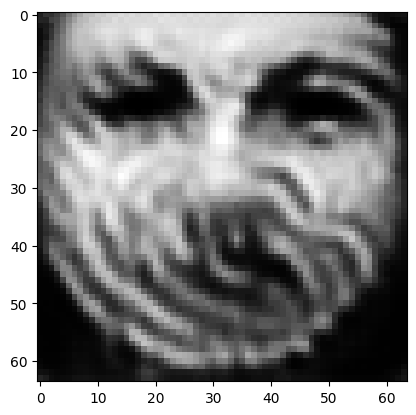

tensor([[2.1766e-06, 1.8982e-05, 1.0582e-04, 7.0047e-05, 6.7177e-06, 3.2281e-05,
         3.2132e-07, 1.6358e-06, 9.9498e-01, 3.5067e-05, 3.3989e-06, 6.7250e-05,
         7.9385e-04, 7.8755e-06, 1.7184e-05, 3.3593e-07, 1.5364e-07, 1.7982e-05,
         1.1773e-06, 4.5399e-05, 2.7546e-04, 1.5801e-06, 3.6004e-07, 7.4282e-09,
         3.8474e-06, 6.4001e-06, 1.1084e-04, 1.2345e-05, 9.3620e-06, 3.5499e-05,
         3.8561e-04, 8.0140e-08, 1.7264e-05, 3.2955e-05, 7.6425e-04, 7.7151e-07,
         3.6339e-07, 4.9917e-06, 2.6143e-04, 1.8683e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0050318981520831585
tensor([[2.1761e-06, 1.8973e-05, 1.0579e-04, 7.0025e-05, 6.7148e-06, 3.2269e-05,
         3.2118e-07, 1.6351e-06, 9.9498e-01, 3.5054e-05, 3.3975e-06, 6.7231e-05,
         7.9354e-04, 7.8724e-06, 1.7182e-05, 3.3582e-07, 1.5358e-07, 1.7976e-05,
         1.1769e-06, 4.5385e-05, 2.7540e-04, 1.5797e-06, 3.5985e-07, 7.4258e-09,
         3.8463e-06, 6.3970e-06, 1.1079e

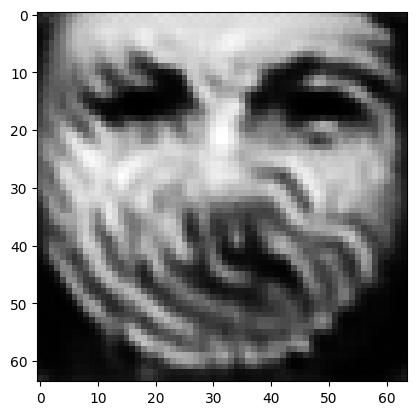

tensor([[2.1742e-06, 1.8939e-05, 1.0566e-04, 6.9941e-05, 6.7033e-06, 3.2222e-05,
         3.2063e-07, 1.6323e-06, 9.9499e-01, 3.5004e-05, 3.3921e-06, 6.7154e-05,
         7.9234e-04, 7.8604e-06, 1.7177e-05, 3.3540e-07, 1.5333e-07, 1.7952e-05,
         1.1753e-06, 4.5331e-05, 2.7514e-04, 1.5781e-06, 3.5909e-07, 7.4160e-09,
         3.8418e-06, 6.3850e-06, 1.1060e-04, 1.2322e-05, 9.3441e-06, 3.5432e-05,
         3.8504e-04, 7.9949e-08, 1.7230e-05, 3.2906e-05, 7.6315e-04, 7.7006e-07,
         3.6272e-07, 4.9823e-06, 2.6098e-04, 1.8644e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005022883880883455
tensor([[2.1737e-06, 1.8931e-05, 1.0562e-04, 6.9920e-05, 6.7005e-06, 3.2211e-05,
         3.2050e-07, 1.6316e-06, 9.9499e-01, 3.4992e-05, 3.3908e-06, 6.7136e-05,
         7.9205e-04, 7.8575e-06, 1.7175e-05, 3.3529e-07, 1.5327e-07, 1.7947e-05,
         1.1749e-06, 4.5319e-05, 2.7507e-04, 1.5777e-06, 3.5890e-07, 7.4136e-09,
         3.8408e-06, 6.3821e-06, 1.1055e-

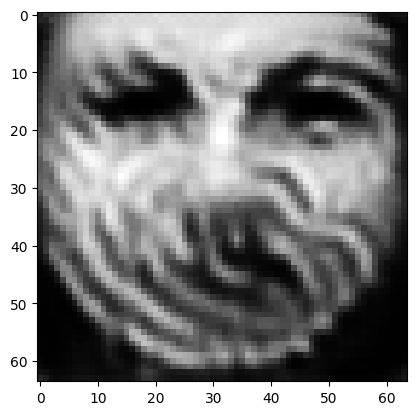

tensor([[2.1720e-06, 1.8898e-05, 1.0550e-04, 6.9840e-05, 6.6897e-06, 3.2167e-05,
         3.1999e-07, 1.6290e-06, 9.9500e-01, 3.4944e-05, 3.3857e-06, 6.7064e-05,
         7.9092e-04, 7.8463e-06, 1.7170e-05, 3.3489e-07, 1.5303e-07, 1.7925e-05,
         1.1735e-06, 4.5269e-05, 2.7483e-04, 1.5763e-06, 3.5818e-07, 7.4044e-09,
         3.8366e-06, 6.3708e-06, 1.1037e-04, 1.2300e-05, 9.3272e-06, 3.5369e-05,
         3.8451e-04, 7.9769e-08, 1.7197e-05, 3.2860e-05, 7.6211e-04, 7.6870e-07,
         3.6208e-07, 4.9734e-06, 2.6054e-04, 1.8606e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.005014343652874231
tensor([[2.1716e-06, 1.8891e-05, 1.0547e-04, 6.9821e-05, 6.6871e-06, 3.2156e-05,
         3.1986e-07, 1.6284e-06, 9.9500e-01, 3.4933e-05, 3.3845e-06, 6.7047e-05,
         7.9064e-04, 7.8436e-06, 1.7168e-05, 3.3479e-07, 1.5298e-07, 1.7919e-05,
         1.1731e-06, 4.5256e-05, 2.7477e-04, 1.5759e-06, 3.5801e-07, 7.4022e-09,
         3.8355e-06, 6.3680e-06, 1.1032e-

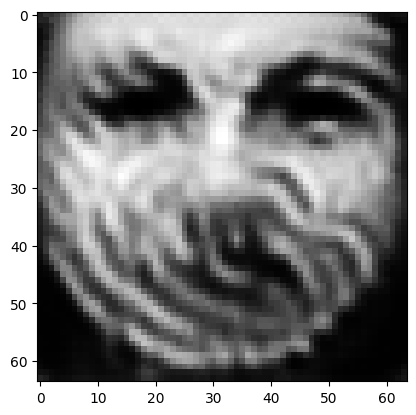

tensor([[2.1699e-06, 1.8860e-05, 1.0535e-04, 6.9744e-05, 6.6769e-06, 3.2115e-05,
         3.1937e-07, 1.6259e-06, 9.9501e-01, 3.4888e-05, 3.3797e-06, 6.6979e-05,
         7.8956e-04, 7.8329e-06, 1.7163e-05, 3.3441e-07, 1.5276e-07, 1.7898e-05,
         1.1717e-06, 4.5209e-05, 2.7454e-04, 1.5745e-06, 3.5733e-07, 7.3935e-09,
         3.8315e-06, 6.3573e-06, 1.1015e-04, 1.2279e-05, 9.3113e-06, 3.5309e-05,
         3.8400e-04, 7.9599e-08, 1.7167e-05, 3.2816e-05, 7.6114e-04, 7.6741e-07,
         3.6148e-07, 4.9650e-06, 2.6013e-04, 1.8571e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0050061591900885105
tensor([[2.1694e-06, 1.8852e-05, 1.0532e-04, 6.9726e-05, 6.6743e-06, 3.2104e-05,
         3.1925e-07, 1.6253e-06, 9.9501e-01, 3.4877e-05, 3.3785e-06, 6.6962e-05,
         7.8930e-04, 7.8301e-06, 1.7162e-05, 3.3431e-07, 1.5270e-07, 1.7893e-05,
         1.1714e-06, 4.5197e-05, 2.7448e-04, 1.5742e-06, 3.5716e-07, 7.3912e-09,
         3.8305e-06, 6.3546e-06, 1.1011e

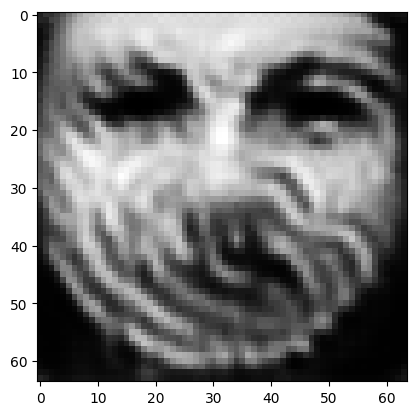

tensor([[2.1678e-06, 1.8823e-05, 1.0521e-04, 6.9653e-05, 6.6647e-06, 3.2065e-05,
         3.1879e-07, 1.6230e-06, 9.9501e-01, 3.4834e-05, 3.3739e-06, 6.6898e-05,
         7.8828e-04, 7.8200e-06, 1.7157e-05, 3.3395e-07, 1.5249e-07, 1.7873e-05,
         1.1701e-06, 4.5152e-05, 2.7426e-04, 1.5728e-06, 3.5651e-07, 7.3830e-09,
         3.8268e-06, 6.3444e-06, 1.0995e-04, 1.2259e-05, 9.2962e-06, 3.5252e-05,
         3.8351e-04, 7.9435e-08, 1.7137e-05, 3.2775e-05, 7.6021e-04, 7.6617e-07,
         3.6090e-07, 4.9570e-06, 2.5974e-04, 1.8538e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004998449236154556
tensor([[2.1675e-06, 1.8816e-05, 1.0518e-04, 6.9635e-05, 6.6624e-06, 3.2055e-05,
         3.1868e-07, 1.6224e-06, 9.9502e-01, 3.4824e-05, 3.3728e-06, 6.6882e-05,
         7.8803e-04, 7.8175e-06, 1.7156e-05, 3.3387e-07, 1.5244e-07, 1.7869e-05,
         1.1697e-06, 4.5141e-05, 2.7421e-04, 1.5725e-06, 3.5636e-07, 7.3810e-09,
         3.8258e-06, 6.3419e-06, 1.0991e-

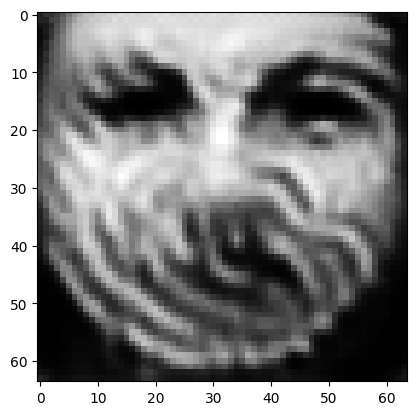

tensor([[2.1660e-06, 1.8788e-05, 1.0508e-04, 6.9565e-05, 6.6534e-06, 3.2019e-05,
         3.1824e-07, 1.6201e-06, 9.9502e-01, 3.4783e-05, 3.3685e-06, 6.6820e-05,
         7.8707e-04, 7.8076e-06, 1.7151e-05, 3.3352e-07, 1.5224e-07, 1.7850e-05,
         1.1685e-06, 4.5099e-05, 2.7400e-04, 1.5712e-06, 3.5574e-07, 7.3730e-09,
         3.8224e-06, 6.3320e-06, 1.0975e-04, 1.2240e-05, 9.2821e-06, 3.5197e-05,
         3.8302e-04, 7.9281e-08, 1.7110e-05, 3.2737e-05, 7.5933e-04, 7.6499e-07,
         3.6035e-07, 4.9491e-06, 2.5938e-04, 1.8507e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004991213791072369
tensor([[2.1656e-06, 1.8781e-05, 1.0506e-04, 6.9548e-05, 6.6512e-06, 3.2010e-05,
         3.1814e-07, 1.6196e-06, 9.9502e-01, 3.4773e-05, 3.3674e-06, 6.6805e-05,
         7.8684e-04, 7.8052e-06, 1.7150e-05, 3.3344e-07, 1.5219e-07, 1.7845e-05,
         1.1682e-06, 4.5089e-05, 2.7395e-04, 1.5709e-06, 3.5559e-07, 7.3711e-09,
         3.8215e-06, 6.3296e-06, 1.0972e-

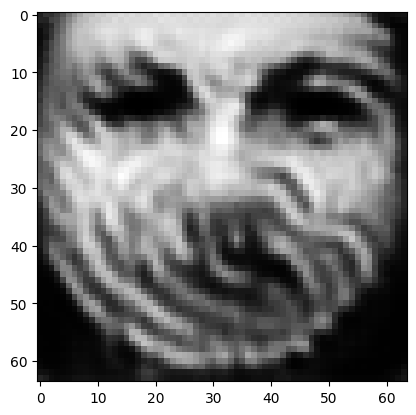

tensor([[2.1642e-06, 1.8755e-05, 1.0496e-04, 6.9481e-05, 6.6427e-06, 3.1976e-05,
         3.1773e-07, 1.6175e-06, 9.9503e-01, 3.4734e-05, 3.3632e-06, 6.6746e-05,
         7.8594e-04, 7.7954e-06, 1.7146e-05, 3.3311e-07, 1.5200e-07, 1.7827e-05,
         1.1670e-06, 4.5048e-05, 2.7374e-04, 1.5697e-06, 3.5501e-07, 7.3634e-09,
         3.8182e-06, 6.3201e-06, 1.0957e-04, 1.2222e-05, 9.2689e-06, 3.5144e-05,
         3.8253e-04, 7.9131e-08, 1.7083e-05, 3.2701e-05, 7.5850e-04, 7.6385e-07,
         3.5981e-07, 4.9415e-06, 2.5905e-04, 1.8478e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0049844528548419476
tensor([[2.1638e-06, 1.8748e-05, 1.0493e-04, 6.9465e-05, 6.6406e-06, 3.1967e-05,
         3.1763e-07, 1.6169e-06, 9.9503e-01, 3.4725e-05, 3.3622e-06, 6.6732e-05,
         7.8572e-04, 7.7930e-06, 1.7145e-05, 3.3302e-07, 1.5196e-07, 1.7822e-05,
         1.1667e-06, 4.5038e-05, 2.7369e-04, 1.5694e-06, 3.5487e-07, 7.3615e-09,
         3.8174e-06, 6.3178e-06, 1.0954e

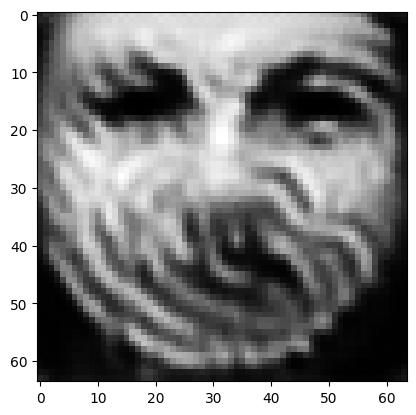

tensor([[2.1625e-06, 1.8723e-05, 1.0484e-04, 6.9402e-05, 6.6327e-06, 3.1935e-05,
         3.1723e-07, 1.6149e-06, 9.9503e-01, 3.4688e-05, 3.3582e-06, 6.6677e-05,
         7.8487e-04, 7.7838e-06, 1.7141e-05, 3.3271e-07, 1.5178e-07, 1.7805e-05,
         1.1655e-06, 4.5000e-05, 2.7350e-04, 1.5682e-06, 3.5431e-07, 7.3543e-09,
         3.8143e-06, 6.3088e-06, 1.0940e-04, 1.2204e-05, 9.2565e-06, 3.5094e-05,
         3.8207e-04, 7.8990e-08, 1.7059e-05, 3.2666e-05, 7.5771e-04, 7.6276e-07,
         3.5930e-07, 4.9344e-06, 2.5873e-04, 1.8451e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004978047218173742
tensor([[2.1621e-06, 1.8716e-05, 1.0482e-04, 6.9387e-05, 6.6306e-06, 3.1927e-05,
         3.1714e-07, 1.6144e-06, 9.9504e-01, 3.4679e-05, 3.3572e-06, 6.6663e-05,
         7.8466e-04, 7.7814e-06, 1.7139e-05, 3.3263e-07, 1.5173e-07, 1.7801e-05,
         1.1652e-06, 4.4990e-05, 2.7345e-04, 1.5680e-06, 3.5418e-07, 7.3525e-09,
         3.8135e-06, 6.3066e-06, 1.0936e-

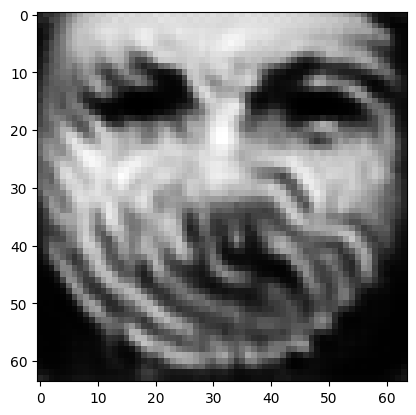

tensor([[2.1608e-06, 1.8692e-05, 1.0473e-04, 6.9327e-05, 6.6230e-06, 3.1896e-05,
         3.1676e-07, 1.6125e-06, 9.9504e-01, 3.4645e-05, 3.3534e-06, 6.6611e-05,
         7.8385e-04, 7.7726e-06, 1.7136e-05, 3.3233e-07, 1.5156e-07, 1.7784e-05,
         1.1642e-06, 4.4954e-05, 2.7327e-04, 1.5669e-06, 3.5365e-07, 7.3456e-09,
         3.8105e-06, 6.2981e-06, 1.0923e-04, 1.2188e-05, 9.2446e-06, 3.5046e-05,
         3.8163e-04, 7.8855e-08, 1.7035e-05, 3.2633e-05, 7.5695e-04, 7.6173e-07,
         3.5882e-07, 4.9276e-06, 2.5843e-04, 1.8425e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004971760790795088
tensor([[2.1605e-06, 1.8688e-05, 1.0471e-04, 6.9315e-05, 6.6212e-06, 3.1888e-05,
         3.1668e-07, 1.6121e-06, 9.9504e-01, 3.4637e-05, 3.3527e-06, 6.6598e-05,
         7.8367e-04, 7.7714e-06, 1.7135e-05, 3.3227e-07, 1.5153e-07, 1.7781e-05,
         1.1640e-06, 4.4945e-05, 2.7324e-04, 1.5666e-06, 3.5354e-07, 7.3443e-09,
         3.8099e-06, 6.2967e-06, 1.0920e-

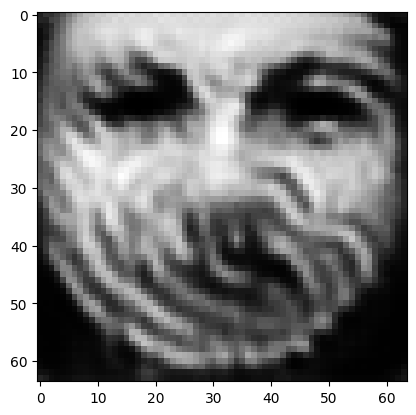

tensor([[2.1593e-06, 1.8668e-05, 1.0463e-04, 6.9273e-05, 6.6139e-06, 3.1855e-05,
         3.1633e-07, 1.6106e-06, 9.9505e-01, 3.4603e-05, 3.3497e-06, 6.6546e-05,
         7.8296e-04, 7.7662e-06, 1.7131e-05, 3.3199e-07, 1.5139e-07, 1.7767e-05,
         1.1631e-06, 4.4910e-05, 2.7308e-04, 1.5657e-06, 3.5312e-07, 7.3393e-09,
         3.8074e-06, 6.2909e-06, 1.0907e-04, 1.2176e-05, 9.2330e-06, 3.5011e-05,
         3.8144e-04, 7.8747e-08, 1.7014e-05, 3.2602e-05, 7.5631e-04, 7.6093e-07,
         3.5847e-07, 4.9230e-06, 2.5814e-04, 1.8398e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004966067150235176
tensor([[2.1590e-06, 1.8664e-05, 1.0461e-04, 6.9262e-05, 6.6120e-06, 3.1847e-05,
         3.1624e-07, 1.6102e-06, 9.9505e-01, 3.4595e-05, 3.3490e-06, 6.6533e-05,
         7.8279e-04, 7.7649e-06, 1.7129e-05, 3.3193e-07, 1.5135e-07, 1.7764e-05,
         1.1629e-06, 4.4901e-05, 2.7304e-04, 1.5654e-06, 3.5302e-07, 7.3380e-09,
         3.8068e-06, 6.2895e-06, 1.0904e-

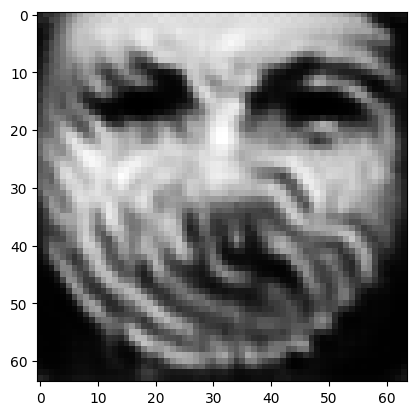

tensor([[2.1579e-06, 1.8645e-05, 1.0454e-04, 6.9222e-05, 6.6051e-06, 3.1816e-05,
         3.1591e-07, 1.6087e-06, 9.9505e-01, 3.4563e-05, 3.3462e-06, 6.6484e-05,
         7.8212e-04, 7.7600e-06, 1.7125e-05, 3.3167e-07, 1.5122e-07, 1.7751e-05,
         1.1620e-06, 4.4868e-05, 2.7290e-04, 1.5645e-06, 3.5262e-07, 7.3331e-09,
         3.8044e-06, 6.2841e-06, 1.0891e-04, 1.2165e-05, 9.2219e-06, 3.4977e-05,
         3.8125e-04, 7.8643e-08, 1.6995e-05, 3.2571e-05, 7.5569e-04, 7.6017e-07,
         3.5814e-07, 4.9187e-06, 2.5787e-04, 1.8372e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0049607292748987675
tensor([[2.1576e-06, 1.8641e-05, 1.0452e-04, 6.9211e-05, 6.6034e-06, 3.1809e-05,
         3.1583e-07, 1.6084e-06, 9.9505e-01, 3.4556e-05, 3.3455e-06, 6.6472e-05,
         7.8195e-04, 7.7588e-06, 1.7124e-05, 3.3161e-07, 1.5118e-07, 1.7748e-05,
         1.1618e-06, 4.4860e-05, 2.7286e-04, 1.5643e-06, 3.5253e-07, 7.3320e-09,
         3.8038e-06, 6.2827e-06, 1.0888e

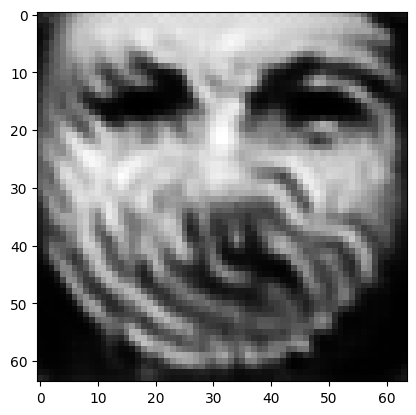

tensor([[2.1565e-06, 1.8624e-05, 1.0444e-04, 6.9173e-05, 6.5968e-06, 3.1779e-05,
         3.1552e-07, 1.6070e-06, 9.9506e-01, 3.4526e-05, 3.3429e-06, 6.6425e-05,
         7.8131e-04, 7.7541e-06, 1.7120e-05, 3.3137e-07, 1.5106e-07, 1.7735e-05,
         1.1610e-06, 4.4828e-05, 2.7272e-04, 1.5634e-06, 3.5215e-07, 7.3274e-09,
         3.8016e-06, 6.2776e-06, 1.0876e-04, 1.2155e-05, 9.2114e-06, 3.4945e-05,
         3.8106e-04, 7.8545e-08, 1.6976e-05, 3.2543e-05, 7.5511e-04, 7.5944e-07,
         3.5782e-07, 4.9146e-06, 2.5761e-04, 1.8347e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0049556284211575985
tensor([[2.1563e-06, 1.8619e-05, 1.0443e-04, 6.9164e-05, 6.5951e-06, 3.1772e-05,
         3.1544e-07, 1.6066e-06, 9.9506e-01, 3.4518e-05, 3.3422e-06, 6.6414e-05,
         7.8116e-04, 7.7529e-06, 1.7119e-05, 3.3131e-07, 1.5103e-07, 1.7732e-05,
         1.1608e-06, 4.4821e-05, 2.7269e-04, 1.5632e-06, 3.5206e-07, 7.3262e-09,
         3.8010e-06, 6.2763e-06, 1.0874e

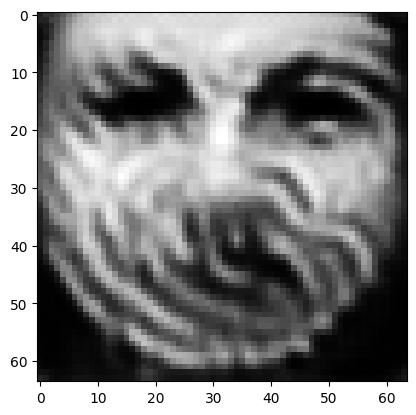

tensor([[2.1552e-06, 1.8603e-05, 1.0436e-04, 6.9127e-05, 6.5889e-06, 3.1744e-05,
         3.1515e-07, 1.6053e-06, 9.9506e-01, 3.4490e-05, 3.3397e-06, 6.6370e-05,
         7.8055e-04, 7.7484e-06, 1.7116e-05, 3.3108e-07, 1.5090e-07, 1.7721e-05,
         1.1601e-06, 4.4791e-05, 2.7256e-04, 1.5624e-06, 3.5170e-07, 7.3218e-09,
         3.7989e-06, 6.2714e-06, 1.0862e-04, 1.2144e-05, 9.2015e-06, 3.4914e-05,
         3.8089e-04, 7.8451e-08, 1.6959e-05, 3.2515e-05, 7.5456e-04, 7.5875e-07,
         3.5752e-07, 4.9107e-06, 2.5737e-04, 1.8324e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004950646311044693
tensor([[2.1550e-06, 1.8599e-05, 1.0434e-04, 6.9118e-05, 6.5874e-06, 3.1738e-05,
         3.1508e-07, 1.6050e-06, 9.9506e-01, 3.4483e-05, 3.3391e-06, 6.6358e-05,
         7.8040e-04, 7.7474e-06, 1.7115e-05, 3.3102e-07, 1.5088e-07, 1.7718e-05,
         1.1599e-06, 4.4783e-05, 2.7252e-04, 1.5622e-06, 3.5161e-07, 7.3207e-09,
         3.7984e-06, 6.2702e-06, 1.0860e-

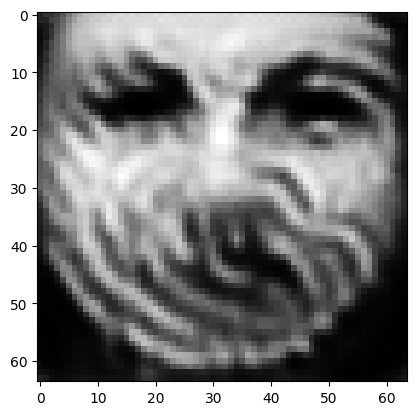

tensor([[2.1540e-06, 1.8583e-05, 1.0428e-04, 6.9083e-05, 6.5814e-06, 3.1711e-05,
         3.1479e-07, 1.6038e-06, 9.9507e-01, 3.4456e-05, 3.3367e-06, 6.6317e-05,
         7.7983e-04, 7.7432e-06, 1.7111e-05, 3.3080e-07, 1.5076e-07, 1.7707e-05,
         1.1592e-06, 4.4755e-05, 2.7240e-04, 1.5614e-06, 3.5127e-07, 7.3166e-09,
         3.7964e-06, 6.2655e-06, 1.0849e-04, 1.2135e-05, 9.1921e-06, 3.4885e-05,
         3.8073e-04, 7.8363e-08, 1.6942e-05, 3.2489e-05, 7.5404e-04, 7.5810e-07,
         3.5723e-07, 4.9070e-06, 2.5714e-04, 1.8302e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004946138709783554
tensor([[2.1537e-06, 1.8579e-05, 1.0426e-04, 6.9075e-05, 6.5800e-06, 3.1705e-05,
         3.1472e-07, 1.6035e-06, 9.9507e-01, 3.4450e-05, 3.3361e-06, 6.6306e-05,
         7.7969e-04, 7.7422e-06, 1.7110e-05, 3.3075e-07, 1.5073e-07, 1.7704e-05,
         1.1590e-06, 4.4748e-05, 2.7237e-04, 1.5612e-06, 3.5119e-07, 7.3156e-09,
         3.7959e-06, 6.2644e-06, 1.0846e-

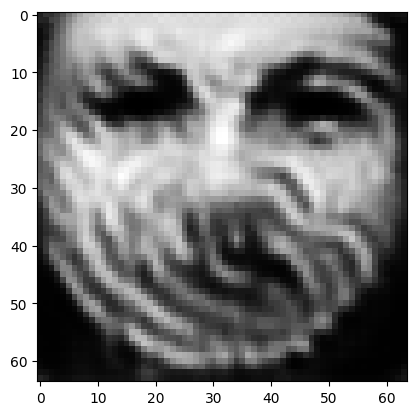

tensor([[2.1528e-06, 1.8565e-05, 1.0420e-04, 6.9042e-05, 6.5744e-06, 3.1680e-05,
         3.1446e-07, 1.6023e-06, 9.9507e-01, 3.4424e-05, 3.3338e-06, 6.6266e-05,
         7.7915e-04, 7.7381e-06, 1.7107e-05, 3.3054e-07, 1.5062e-07, 1.7693e-05,
         1.1583e-06, 4.4721e-05, 2.7225e-04, 1.5605e-06, 3.5087e-07, 7.3117e-09,
         3.7939e-06, 6.2600e-06, 1.0836e-04, 1.2126e-05, 9.1832e-06, 3.4858e-05,
         3.8057e-04, 7.8279e-08, 1.6926e-05, 3.2465e-05, 7.5355e-04, 7.5748e-07,
         3.5696e-07, 4.9035e-06, 2.5692e-04, 1.8282e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004941749852150679
tensor([[2.1526e-06, 1.8561e-05, 1.0418e-04, 6.9034e-05, 6.5730e-06, 3.1674e-05,
         3.1439e-07, 1.6020e-06, 9.9507e-01, 3.4418e-05, 3.3333e-06, 6.6256e-05,
         7.7902e-04, 7.7372e-06, 1.7106e-05, 3.3049e-07, 1.5060e-07, 1.7691e-05,
         1.1582e-06, 4.4714e-05, 2.7222e-04, 1.5603e-06, 3.5079e-07, 7.3107e-09,
         3.7935e-06, 6.2589e-06, 1.0834e-

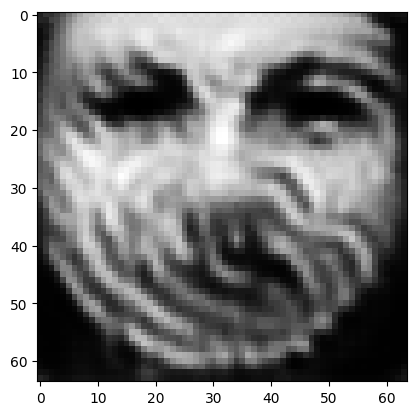

tensor([[2.1517e-06, 1.8547e-05, 1.0412e-04, 6.9003e-05, 6.5676e-06, 3.1650e-05,
         3.1414e-07, 1.6009e-06, 9.9507e-01, 3.4393e-05, 3.3311e-06, 6.6218e-05,
         7.7850e-04, 7.7333e-06, 1.7103e-05, 3.3029e-07, 1.5049e-07, 1.7681e-05,
         1.1575e-06, 4.4689e-05, 2.7211e-04, 1.5596e-06, 3.5049e-07, 7.3069e-09,
         3.7916e-06, 6.2547e-06, 1.0824e-04, 1.2117e-05, 9.1747e-06, 3.4832e-05,
         3.8042e-04, 7.8199e-08, 1.6911e-05, 3.2441e-05, 7.5307e-04, 7.5689e-07,
         3.5670e-07, 4.9002e-06, 2.5671e-04, 1.8262e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004937716759741306
tensor([[2.1515e-06, 1.8543e-05, 1.0411e-04, 6.8995e-05, 6.5663e-06, 3.1644e-05,
         3.1408e-07, 1.6006e-06, 9.9508e-01, 3.4388e-05, 3.3306e-06, 6.6209e-05,
         7.7837e-04, 7.7322e-06, 1.7102e-05, 3.3024e-07, 1.5047e-07, 1.7678e-05,
         1.1574e-06, 4.4682e-05, 2.7208e-04, 1.5594e-06, 3.5041e-07, 7.3059e-09,
         3.7912e-06, 6.2536e-06, 1.0822e-

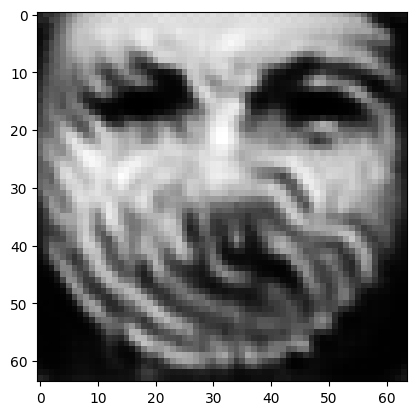

tensor([[2.1506e-06, 1.8530e-05, 1.0405e-04, 6.8965e-05, 6.5611e-06, 3.1622e-05,
         3.1384e-07, 1.5995e-06, 9.9508e-01, 3.4365e-05, 3.3285e-06, 6.6173e-05,
         7.7788e-04, 7.7284e-06, 1.7099e-05, 3.3005e-07, 1.5037e-07, 1.7668e-05,
         1.1567e-06, 4.4658e-05, 2.7197e-04, 1.5587e-06, 3.5011e-07, 7.3023e-09,
         3.7894e-06, 6.2495e-06, 1.0813e-04, 1.2109e-05, 9.1667e-06, 3.4807e-05,
         3.8027e-04, 7.8121e-08, 1.6896e-05, 3.2419e-05, 7.5262e-04, 7.5632e-07,
         3.5645e-07, 4.8969e-06, 2.5651e-04, 1.8243e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0049338024109601974
tensor([[2.1504e-06, 1.8527e-05, 1.0404e-04, 6.8958e-05, 6.5599e-06, 3.1617e-05,
         3.1378e-07, 1.5993e-06, 9.9508e-01, 3.4359e-05, 3.3280e-06, 6.6164e-05,
         7.7776e-04, 7.7275e-06, 1.7098e-05, 3.3001e-07, 1.5034e-07, 1.7666e-05,
         1.1566e-06, 4.4652e-05, 2.7194e-04, 1.5586e-06, 3.5004e-07, 7.3014e-09,
         3.7889e-06, 6.2485e-06, 1.0811e

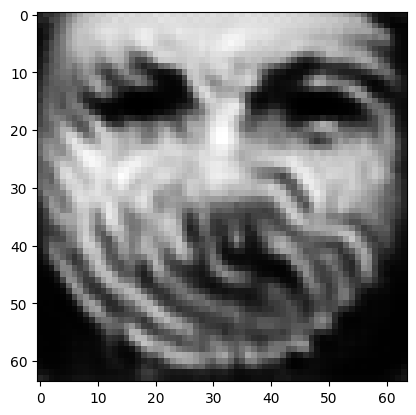

tensor([[2.1496e-06, 1.8514e-05, 1.0399e-04, 6.8929e-05, 6.5550e-06, 3.1595e-05,
         3.1355e-07, 1.5983e-06, 9.9508e-01, 3.4337e-05, 3.3260e-06, 6.6130e-05,
         7.7728e-04, 7.7238e-06, 1.7095e-05, 3.2983e-07, 1.5025e-07, 1.7657e-05,
         1.1560e-06, 4.4628e-05, 2.7183e-04, 1.5579e-06, 3.4976e-07, 7.2979e-09,
         3.7873e-06, 6.2447e-06, 1.0802e-04, 1.2101e-05, 9.1590e-06, 3.4783e-05,
         3.8013e-04, 7.8048e-08, 1.6883e-05, 3.2397e-05, 7.5219e-04, 7.5577e-07,
         3.5621e-07, 4.8939e-06, 2.5632e-04, 1.8226e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004930125083774328
tensor([[2.1494e-06, 1.8511e-05, 1.0397e-04, 6.8922e-05, 6.5538e-06, 3.1590e-05,
         3.1349e-07, 1.5980e-06, 9.9508e-01, 3.4332e-05, 3.3255e-06, 6.6122e-05,
         7.7716e-04, 7.7230e-06, 1.7094e-05, 3.2978e-07, 1.5022e-07, 1.7654e-05,
         1.1559e-06, 4.4623e-05, 2.7181e-04, 1.5578e-06, 3.4969e-07, 7.2971e-09,
         3.7868e-06, 6.2438e-06, 1.0800e-

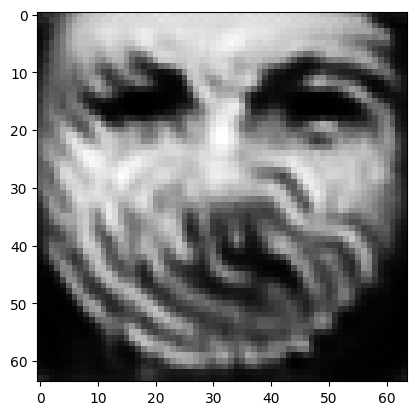

tensor([[2.1487e-06, 1.8498e-05, 1.0392e-04, 6.8895e-05, 6.5492e-06, 3.1570e-05,
         3.1327e-07, 1.5971e-06, 9.9509e-01, 3.4311e-05, 3.3237e-06, 6.6089e-05,
         7.7672e-04, 7.7195e-06, 1.7091e-05, 3.2961e-07, 1.5013e-07, 1.7646e-05,
         1.1553e-06, 4.4601e-05, 2.7171e-04, 1.5572e-06, 3.4943e-07, 7.2937e-09,
         3.7852e-06, 6.2401e-06, 1.0792e-04, 1.2094e-05, 9.1518e-06, 3.4761e-05,
         3.8000e-04, 7.7980e-08, 1.6870e-05, 3.2377e-05, 7.5179e-04, 7.5526e-07,
         3.5598e-07, 4.8910e-06, 2.5614e-04, 1.8209e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004926566034555435
tensor([[2.1485e-06, 1.8496e-05, 1.0391e-04, 6.8889e-05, 6.5481e-06, 3.1565e-05,
         3.1322e-07, 1.5968e-06, 9.9509e-01, 3.4306e-05, 3.3232e-06, 6.6081e-05,
         7.7661e-04, 7.7187e-06, 1.7091e-05, 3.2957e-07, 1.5011e-07, 1.7643e-05,
         1.1552e-06, 4.4595e-05, 2.7169e-04, 1.5570e-06, 3.4936e-07, 7.2929e-09,
         3.7849e-06, 6.2392e-06, 1.0790e-

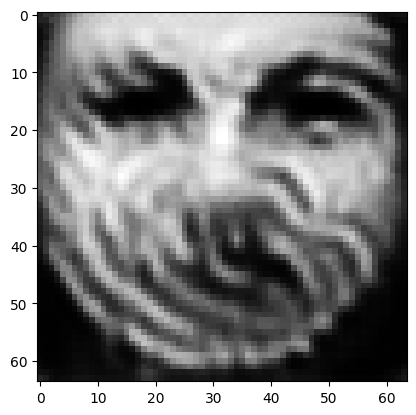

tensor([[2.1478e-06, 1.8484e-05, 1.0386e-04, 6.8864e-05, 6.5438e-06, 3.1546e-05,
         3.1302e-07, 1.5959e-06, 9.9509e-01, 3.4286e-05, 3.3215e-06, 6.6051e-05,
         7.7619e-04, 7.7156e-06, 1.7088e-05, 3.2941e-07, 1.5003e-07, 1.7635e-05,
         1.1547e-06, 4.4574e-05, 2.7159e-04, 1.5564e-06, 3.4911e-07, 7.2899e-09,
         3.7834e-06, 6.2358e-06, 1.0782e-04, 1.2087e-05, 9.1450e-06, 3.4739e-05,
         3.7987e-04, 7.7915e-08, 1.6858e-05, 3.2358e-05, 7.5140e-04, 7.5478e-07,
         3.5577e-07, 4.8884e-06, 2.5598e-04, 1.8193e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0049230074509978294
tensor([[2.1476e-06, 1.8481e-05, 1.0385e-04, 6.8857e-05, 6.5427e-06, 3.1541e-05,
         3.1296e-07, 1.5957e-06, 9.9509e-01, 3.4282e-05, 3.3210e-06, 6.6043e-05,
         7.7608e-04, 7.7147e-06, 1.7087e-05, 3.2937e-07, 1.5000e-07, 1.7633e-05,
         1.1545e-06, 4.4569e-05, 2.7157e-04, 1.5563e-06, 3.4905e-07, 7.2890e-09,
         3.7830e-06, 6.2349e-06, 1.0780e

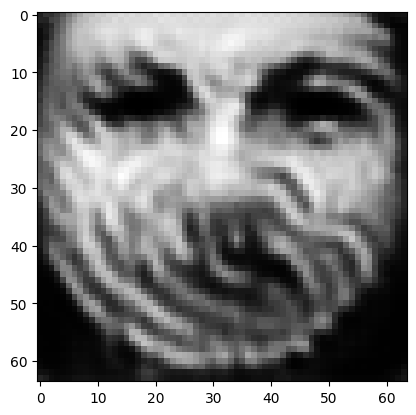

tensor([[2.1469e-06, 1.8470e-05, 1.0381e-04, 6.8833e-05, 6.5385e-06, 3.1523e-05,
         3.1277e-07, 1.5948e-06, 9.9509e-01, 3.4263e-05, 3.3193e-06, 6.6013e-05,
         7.7569e-04, 7.7116e-06, 1.7085e-05, 3.2922e-07, 1.4992e-07, 1.7625e-05,
         1.1540e-06, 4.4549e-05, 2.7148e-04, 1.5557e-06, 3.4881e-07, 7.2861e-09,
         3.7815e-06, 6.2316e-06, 1.0773e-04, 1.2080e-05, 9.1384e-06, 3.4719e-05,
         3.7975e-04, 7.7851e-08, 1.6846e-05, 3.2340e-05, 7.5103e-04, 7.5431e-07,
         3.5556e-07, 4.8857e-06, 2.5581e-04, 1.8178e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00491992337629199
tensor([[2.1467e-06, 1.8468e-05, 1.0380e-04, 6.8827e-05, 6.5376e-06, 3.1519e-05,
         3.1272e-07, 1.5946e-06, 9.9509e-01, 3.4258e-05, 3.3189e-06, 6.6007e-05,
         7.7559e-04, 7.7109e-06, 1.7084e-05, 3.2918e-07, 1.4990e-07, 1.7623e-05,
         1.1539e-06, 4.4544e-05, 2.7146e-04, 1.5556e-06, 3.4876e-07, 7.2854e-09,
         3.7812e-06, 6.2308e-06, 1.0771e-0

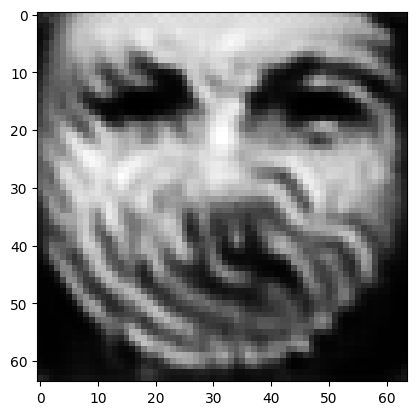

tensor([[2.1461e-06, 1.8457e-05, 1.0375e-04, 6.8804e-05, 6.5336e-06, 3.1501e-05,
         3.1254e-07, 1.5938e-06, 9.9510e-01, 3.4240e-05, 3.3173e-06, 6.5979e-05,
         7.7521e-04, 7.7080e-06, 1.7082e-05, 3.2904e-07, 1.4983e-07, 1.7616e-05,
         1.1534e-06, 4.4525e-05, 2.7137e-04, 1.5551e-06, 3.4853e-07, 7.2826e-09,
         3.7799e-06, 6.2277e-06, 1.0764e-04, 1.2073e-05, 9.1322e-06, 3.4700e-05,
         3.7964e-04, 7.7793e-08, 1.6835e-05, 3.2322e-05, 7.5068e-04, 7.5388e-07,
         3.5538e-07, 4.8833e-06, 2.5566e-04, 1.8163e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004916838835924864
tensor([[2.1459e-06, 1.8455e-05, 1.0374e-04, 6.8798e-05, 6.5327e-06, 3.1497e-05,
         3.1249e-07, 1.5936e-06, 9.9510e-01, 3.4236e-05, 3.3169e-06, 6.5972e-05,
         7.7512e-04, 7.7072e-06, 1.7081e-05, 3.2900e-07, 1.4981e-07, 1.7614e-05,
         1.1533e-06, 4.4520e-05, 2.7135e-04, 1.5550e-06, 3.4848e-07, 7.2819e-09,
         3.7795e-06, 6.2269e-06, 1.0763e-

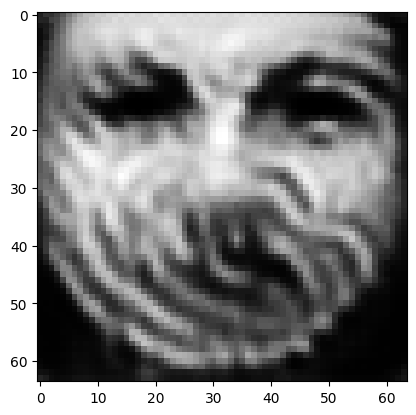

tensor([[2.1453e-06, 1.8445e-05, 1.0370e-04, 6.8776e-05, 6.5290e-06, 3.1481e-05,
         3.1231e-07, 1.5928e-06, 9.9510e-01, 3.4219e-05, 3.3154e-06, 6.5946e-05,
         7.7476e-04, 7.7045e-06, 1.7079e-05, 3.2886e-07, 1.4973e-07, 1.7607e-05,
         1.1529e-06, 4.4502e-05, 2.7127e-04, 1.5545e-06, 3.4826e-07, 7.2793e-09,
         3.7782e-06, 6.2239e-06, 1.0756e-04, 1.2067e-05, 9.1263e-06, 3.4681e-05,
         3.7953e-04, 7.7737e-08, 1.6824e-05, 3.2306e-05, 7.5035e-04, 7.5346e-07,
         3.5519e-07, 4.8809e-06, 2.5552e-04, 1.8150e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004913991782814264
tensor([[2.1452e-06, 1.8442e-05, 1.0369e-04, 6.8771e-05, 6.5281e-06, 3.1477e-05,
         3.1227e-07, 1.5926e-06, 9.9510e-01, 3.4215e-05, 3.3150e-06, 6.5939e-05,
         7.7467e-04, 7.7037e-06, 1.7078e-05, 3.2883e-07, 1.4971e-07, 1.7605e-05,
         1.1527e-06, 4.4498e-05, 2.7125e-04, 1.5543e-06, 3.4821e-07, 7.2786e-09,
         3.7779e-06, 6.2232e-06, 1.0754e-

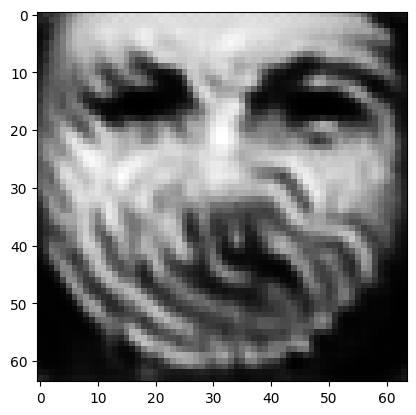

tensor([[2.1446e-06, 1.8433e-05, 1.0365e-04, 6.8750e-05, 6.5245e-06, 3.1461e-05,
         3.1210e-07, 1.5919e-06, 9.9510e-01, 3.4199e-05, 3.3136e-06, 6.5914e-05,
         7.7433e-04, 7.7012e-06, 1.7076e-05, 3.2870e-07, 1.4965e-07, 1.7598e-05,
         1.1523e-06, 4.4480e-05, 2.7118e-04, 1.5539e-06, 3.4801e-07, 7.2761e-09,
         3.7767e-06, 6.2204e-06, 1.0748e-04, 1.2061e-05, 9.1207e-06, 3.4664e-05,
         3.7943e-04, 7.7684e-08, 1.6814e-05, 3.2291e-05, 7.5004e-04, 7.5307e-07,
         3.5502e-07, 4.8787e-06, 2.5538e-04, 1.8137e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004911263473331928
tensor([[2.1444e-06, 1.8431e-05, 1.0364e-04, 6.8745e-05, 6.5236e-06, 3.1458e-05,
         3.1206e-07, 1.5917e-06, 9.9510e-01, 3.4195e-05, 3.3132e-06, 6.5908e-05,
         7.7424e-04, 7.7005e-06, 1.7075e-05, 3.2867e-07, 1.4963e-07, 1.7597e-05,
         1.1522e-06, 4.4476e-05, 2.7116e-04, 1.5538e-06, 3.4796e-07, 7.2754e-09,
         3.7764e-06, 6.2197e-06, 1.0747e-

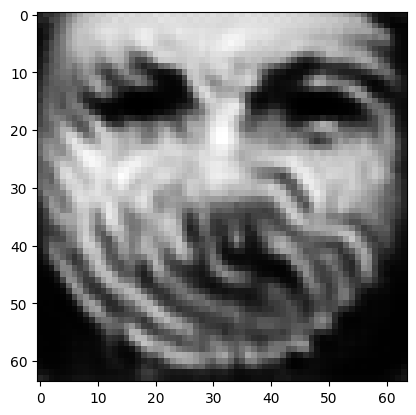

tensor([[2.1439e-06, 1.8422e-05, 1.0360e-04, 6.8725e-05, 6.5203e-06, 3.1443e-05,
         3.1190e-07, 1.5910e-06, 9.9510e-01, 3.4180e-05, 3.3119e-06, 6.5884e-05,
         7.7392e-04, 7.6980e-06, 1.7073e-05, 3.2854e-07, 1.4956e-07, 1.7590e-05,
         1.1518e-06, 4.4460e-05, 2.7108e-04, 1.5533e-06, 3.4777e-07, 7.2730e-09,
         3.7752e-06, 6.2170e-06, 1.0741e-04, 1.2056e-05, 9.1153e-06, 3.4647e-05,
         3.7932e-04, 7.7633e-08, 1.6804e-05, 3.2276e-05, 7.4973e-04, 7.5270e-07,
         3.5485e-07, 4.8765e-06, 2.5525e-04, 1.8125e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004908653907477856
tensor([[2.1437e-06, 1.8419e-05, 1.0360e-04, 6.8720e-05, 6.5195e-06, 3.1439e-05,
         3.1186e-07, 1.5908e-06, 9.9510e-01, 3.4176e-05, 3.3115e-06, 6.5878e-05,
         7.7384e-04, 7.6973e-06, 1.7073e-05, 3.2851e-07, 1.4955e-07, 1.7589e-05,
         1.1517e-06, 4.4456e-05, 2.7107e-04, 1.5532e-06, 3.4772e-07, 7.2724e-09,
         3.7750e-06, 6.2163e-06, 1.0739e-

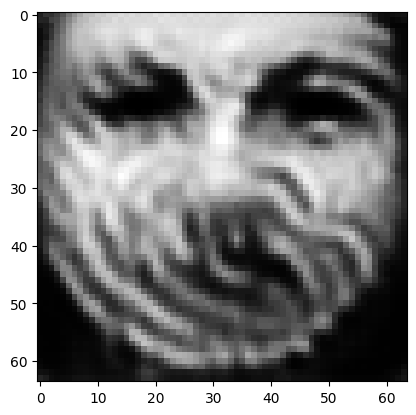

tensor([[2.1432e-06, 1.8411e-05, 1.0356e-04, 6.8702e-05, 6.5163e-06, 3.1425e-05,
         3.1171e-07, 1.5901e-06, 9.9511e-01, 3.4162e-05, 3.3102e-06, 6.5856e-05,
         7.7354e-04, 7.6950e-06, 1.7071e-05, 3.2839e-07, 1.4948e-07, 1.7583e-05,
         1.1513e-06, 4.4441e-05, 2.7100e-04, 1.5528e-06, 3.4754e-07, 7.2702e-09,
         3.7739e-06, 6.2138e-06, 1.0734e-04, 1.2051e-05, 9.1103e-06, 3.4632e-05,
         3.7923e-04, 7.7585e-08, 1.6795e-05, 3.2262e-05, 7.4945e-04, 7.5234e-07,
         3.5470e-07, 4.8745e-06, 2.5512e-04, 1.8113e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004906162619590759
tensor([[2.1431e-06, 1.8409e-05, 1.0355e-04, 6.8697e-05, 6.5155e-06, 3.1422e-05,
         3.1168e-07, 1.5900e-06, 9.9511e-01, 3.4158e-05, 3.3099e-06, 6.5850e-05,
         7.7346e-04, 7.6944e-06, 1.7070e-05, 3.2836e-07, 1.4947e-07, 1.7581e-05,
         1.1512e-06, 4.4437e-05, 2.7098e-04, 1.5527e-06, 3.4749e-07, 7.2696e-09,
         3.7736e-06, 6.2132e-06, 1.0732e-

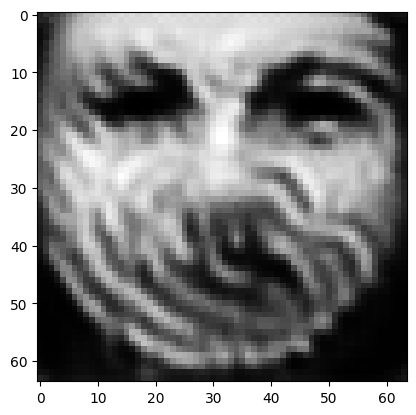

tensor([[2.1426e-06, 1.8401e-05, 1.0352e-04, 6.8680e-05, 6.5125e-06, 3.1409e-05,
         3.1153e-07, 1.5893e-06, 9.9511e-01, 3.4144e-05, 3.3087e-06, 6.5829e-05,
         7.7318e-04, 7.6922e-06, 1.7069e-05, 3.2825e-07, 1.4941e-07, 1.7576e-05,
         1.1508e-06, 4.4422e-05, 2.7092e-04, 1.5523e-06, 3.4732e-07, 7.2675e-09,
         3.7726e-06, 6.2108e-06, 1.0727e-04, 1.2046e-05, 9.1055e-06, 3.4617e-05,
         3.7914e-04, 7.7539e-08, 1.6787e-05, 3.2249e-05, 7.4918e-04, 7.5201e-07,
         3.5455e-07, 4.8726e-06, 2.5501e-04, 1.8102e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00490390881896019
tensor([[2.1424e-06, 1.8399e-05, 1.0351e-04, 6.8675e-05, 6.5118e-06, 3.1405e-05,
         3.1150e-07, 1.5892e-06, 9.9511e-01, 3.4141e-05, 3.3084e-06, 6.5824e-05,
         7.7311e-04, 7.6917e-06, 1.7068e-05, 3.2823e-07, 1.4940e-07, 1.7574e-05,
         1.1508e-06, 4.4419e-05, 2.7090e-04, 1.5522e-06, 3.4728e-07, 7.2670e-09,
         3.7724e-06, 6.2102e-06, 1.0726e-0

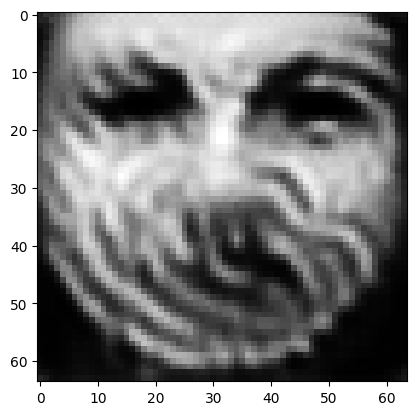

tensor([[2.1420e-06, 1.8391e-05, 1.0348e-04, 6.8659e-05, 6.5090e-06, 3.1393e-05,
         3.1136e-07, 1.5886e-06, 9.9511e-01, 3.4128e-05, 3.3072e-06, 6.5804e-05,
         7.7283e-04, 7.6896e-06, 1.7067e-05, 3.2812e-07, 1.4934e-07, 1.7569e-05,
         1.1504e-06, 4.4405e-05, 2.7084e-04, 1.5518e-06, 3.4712e-07, 7.2650e-09,
         3.7714e-06, 6.2079e-06, 1.0720e-04, 1.2041e-05, 9.1010e-06, 3.4603e-05,
         3.7906e-04, 7.7496e-08, 1.6779e-05, 3.2236e-05, 7.4892e-04, 7.5169e-07,
         3.5441e-07, 4.8708e-06, 2.5490e-04, 1.8091e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00490165501832962
tensor([[2.1419e-06, 1.8389e-05, 1.0347e-04, 6.8654e-05, 6.5083e-06, 3.1390e-05,
         3.1133e-07, 1.5884e-06, 9.9511e-01, 3.4125e-05, 3.3070e-06, 6.5799e-05,
         7.7277e-04, 7.6890e-06, 1.7066e-05, 3.2809e-07, 1.4933e-07, 1.7567e-05,
         1.1503e-06, 4.4401e-05, 2.7083e-04, 1.5517e-06, 3.4708e-07, 7.2645e-09,
         3.7711e-06, 6.2074e-06, 1.0719e-0

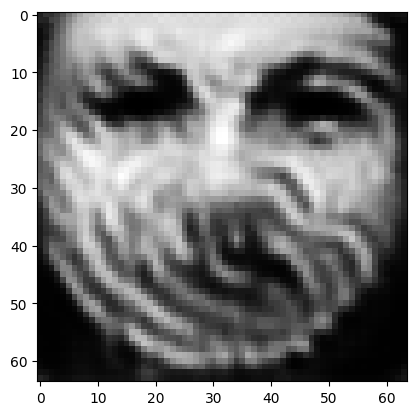

tensor([[2.1414e-06, 1.8382e-05, 1.0344e-04, 6.8638e-05, 6.5056e-06, 3.1378e-05,
         3.1120e-07, 1.5879e-06, 9.9511e-01, 3.4112e-05, 3.3058e-06, 6.5779e-05,
         7.7250e-04, 7.6870e-06, 1.7065e-05, 3.2799e-07, 1.4927e-07, 1.7562e-05,
         1.1500e-06, 4.4388e-05, 2.7077e-04, 1.5513e-06, 3.4692e-07, 7.2626e-09,
         3.7702e-06, 6.2052e-06, 1.0714e-04, 1.2036e-05, 9.0967e-06, 3.4589e-05,
         3.7898e-04, 7.7455e-08, 1.6771e-05, 3.2224e-05, 7.4867e-04, 7.5139e-07,
         3.5428e-07, 4.8690e-06, 2.5480e-04, 1.8081e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0048996382392942905
tensor([[2.1413e-06, 1.8380e-05, 1.0343e-04, 6.8634e-05, 6.5049e-06, 3.1375e-05,
         3.1117e-07, 1.5877e-06, 9.9511e-01, 3.4109e-05, 3.3056e-06, 6.5775e-05,
         7.7244e-04, 7.6865e-06, 1.7064e-05, 3.2797e-07, 1.4926e-07, 1.7561e-05,
         1.1499e-06, 4.4385e-05, 2.7075e-04, 1.5513e-06, 3.4688e-07, 7.2621e-09,
         3.7700e-06, 6.2047e-06, 1.0713e

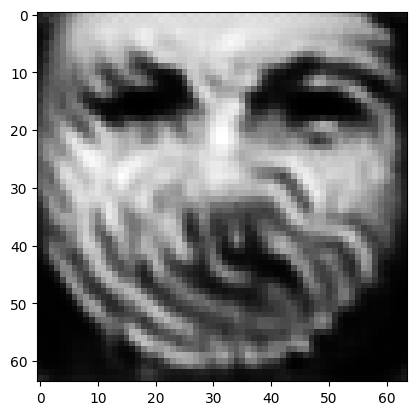

tensor([[2.1409e-06, 1.8374e-05, 1.0341e-04, 6.8619e-05, 6.5024e-06, 3.1364e-05,
         3.1105e-07, 1.5872e-06, 9.9511e-01, 3.4097e-05, 3.3045e-06, 6.5757e-05,
         7.7220e-04, 7.6846e-06, 1.7063e-05, 3.2787e-07, 1.4921e-07, 1.7556e-05,
         1.1496e-06, 4.4373e-05, 2.7070e-04, 1.5509e-06, 3.4674e-07, 7.2603e-09,
         3.7691e-06, 6.2026e-06, 1.0709e-04, 1.2032e-05, 9.0926e-06, 3.4577e-05,
         3.7891e-04, 7.7417e-08, 1.6764e-05, 3.2213e-05, 7.4844e-04, 7.5110e-07,
         3.5415e-07, 4.8674e-06, 2.5470e-04, 1.8072e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004897740203887224
tensor([[2.1408e-06, 1.8372e-05, 1.0340e-04, 6.8615e-05, 6.5017e-06, 3.1361e-05,
         3.1102e-07, 1.5870e-06, 9.9511e-01, 3.4094e-05, 3.3043e-06, 6.5752e-05,
         7.7214e-04, 7.6841e-06, 1.7062e-05, 3.2785e-07, 1.4920e-07, 1.7555e-05,
         1.1495e-06, 4.4369e-05, 2.7069e-04, 1.5508e-06, 3.4670e-07, 7.2598e-09,
         3.7689e-06, 6.2021e-06, 1.0707e-

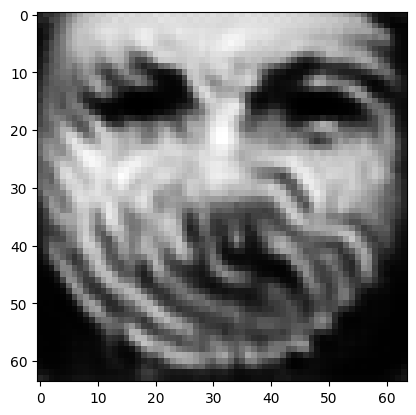

tensor([[2.1403e-06, 1.8365e-05, 1.0337e-04, 6.8601e-05, 6.4993e-06, 3.1350e-05,
         3.1090e-07, 1.5865e-06, 9.9512e-01, 3.4083e-05, 3.3033e-06, 6.5735e-05,
         7.7190e-04, 7.6823e-06, 1.7061e-05, 3.2776e-07, 1.4915e-07, 1.7550e-05,
         1.1492e-06, 4.4357e-05, 2.7063e-04, 1.5505e-06, 3.4656e-07, 7.2581e-09,
         3.7681e-06, 6.2002e-06, 1.0703e-04, 1.2028e-05, 9.0887e-06, 3.4565e-05,
         3.7884e-04, 7.7380e-08, 1.6757e-05, 3.2202e-05, 7.4821e-04, 7.5083e-07,
         3.5403e-07, 4.8658e-06, 2.5461e-04, 1.8063e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004895842168480158
tensor([[2.1403e-06, 1.8364e-05, 1.0337e-04, 6.8598e-05, 6.4987e-06, 3.1347e-05,
         3.1087e-07, 1.5864e-06, 9.9512e-01, 3.4080e-05, 3.3030e-06, 6.5730e-05,
         7.7184e-04, 7.6819e-06, 1.7061e-05, 3.2774e-07, 1.4914e-07, 1.7549e-05,
         1.1492e-06, 4.4355e-05, 2.7062e-04, 1.5504e-06, 3.4653e-07, 7.2577e-09,
         3.7679e-06, 6.1997e-06, 1.0702e-

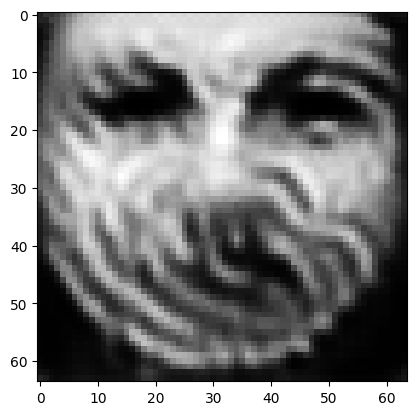

tensor([[2.1399e-06, 1.8358e-05, 1.0334e-04, 6.8584e-05, 6.4964e-06, 3.1337e-05,
         3.1076e-07, 1.5859e-06, 9.9512e-01, 3.4070e-05, 3.3021e-06, 6.5714e-05,
         7.7162e-04, 7.6801e-06, 1.7059e-05, 3.2765e-07, 1.4909e-07, 1.7544e-05,
         1.1489e-06, 4.4343e-05, 2.7057e-04, 1.5501e-06, 3.4640e-07, 7.2561e-09,
         3.7671e-06, 6.1978e-06, 1.0698e-04, 1.2024e-05, 9.0850e-06, 3.4553e-05,
         3.7877e-04, 7.7344e-08, 1.6751e-05, 3.2192e-05, 7.4800e-04, 7.5057e-07,
         3.5392e-07, 4.8643e-06, 2.5452e-04, 1.8054e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004894062876701355
tensor([[2.1398e-06, 1.8356e-05, 1.0333e-04, 6.8580e-05, 6.4958e-06, 3.1334e-05,
         3.1074e-07, 1.5858e-06, 9.9512e-01, 3.4067e-05, 3.3018e-06, 6.5710e-05,
         7.7157e-04, 7.6797e-06, 1.7059e-05, 3.2763e-07, 1.4908e-07, 1.7543e-05,
         1.1488e-06, 4.4340e-05, 2.7056e-04, 1.5501e-06, 3.4637e-07, 7.2556e-09,
         3.7669e-06, 6.1974e-06, 1.0697e-

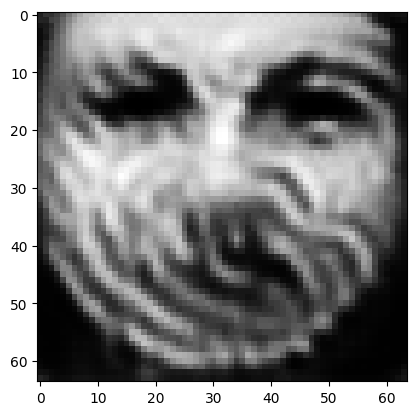

tensor([[2.1394e-06, 1.8350e-05, 1.0331e-04, 6.8568e-05, 6.4937e-06, 3.1325e-05,
         3.1063e-07, 1.5853e-06, 9.9512e-01, 3.4057e-05, 3.3009e-06, 6.5694e-05,
         7.7136e-04, 7.6781e-06, 1.7058e-05, 3.2755e-07, 1.4904e-07, 1.7539e-05,
         1.1485e-06, 4.4330e-05, 2.7051e-04, 1.5498e-06, 3.4624e-07, 7.2541e-09,
         3.7662e-06, 6.1957e-06, 1.0693e-04, 1.2021e-05, 9.0815e-06, 3.4542e-05,
         3.7871e-04, 7.7311e-08, 1.6745e-05, 3.2183e-05, 7.4780e-04, 7.5033e-07,
         3.5381e-07, 4.8629e-06, 2.5444e-04, 1.8046e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004892164841294289
tensor([[2.1393e-06, 1.8349e-05, 1.0330e-04, 6.8564e-05, 6.4932e-06, 3.1323e-05,
         3.1061e-07, 1.5852e-06, 9.9512e-01, 3.4055e-05, 3.3007e-06, 6.5690e-05,
         7.7131e-04, 7.6776e-06, 1.7057e-05, 3.2752e-07, 1.4903e-07, 1.7538e-05,
         1.1485e-06, 4.4328e-05, 2.7050e-04, 1.5497e-06, 3.4621e-07, 7.2537e-09,
         3.7660e-06, 6.1952e-06, 1.0692e-

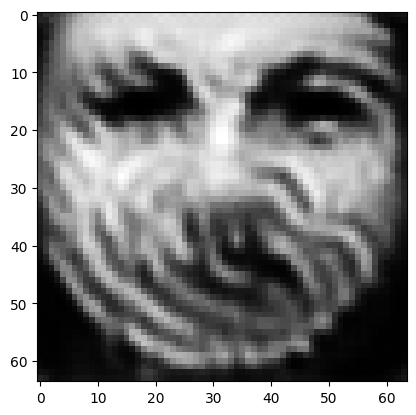

tensor([[2.1390e-06, 1.8343e-05, 1.0328e-04, 6.8552e-05, 6.4911e-06, 3.1313e-05,
         3.1051e-07, 1.5848e-06, 9.9512e-01, 3.4045e-05, 3.2999e-06, 6.5675e-05,
         7.7111e-04, 7.6761e-06, 1.7056e-05, 3.2745e-07, 1.4899e-07, 1.7534e-05,
         1.1482e-06, 4.4317e-05, 2.7046e-04, 1.5494e-06, 3.4609e-07, 7.2523e-09,
         3.7652e-06, 6.1935e-06, 1.0688e-04, 1.2017e-05, 9.0781e-06, 3.4532e-05,
         3.7865e-04, 7.7279e-08, 1.6739e-05, 3.2174e-05, 7.4761e-04, 7.5010e-07,
         3.5371e-07, 4.8615e-06, 2.5436e-04, 1.8039e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004890503827482462
tensor([[2.1389e-06, 1.8342e-05, 1.0327e-04, 6.8548e-05, 6.4906e-06, 3.1311e-05,
         3.1048e-07, 1.5847e-06, 9.9512e-01, 3.4043e-05, 3.2996e-06, 6.5671e-05,
         7.7106e-04, 7.6757e-06, 1.7056e-05, 3.2743e-07, 1.4898e-07, 1.7533e-05,
         1.1481e-06, 4.4315e-05, 2.7044e-04, 1.5494e-06, 3.4606e-07, 7.2519e-09,
         3.7651e-06, 6.1931e-06, 1.0687e-

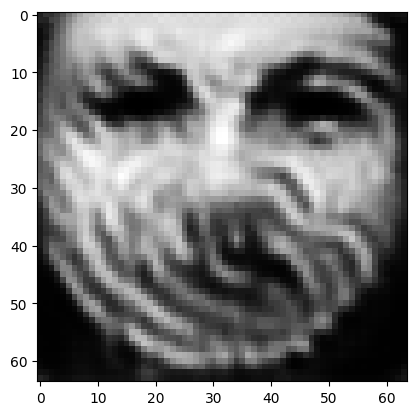

tensor([[2.1385e-06, 1.8336e-05, 1.0325e-04, 6.8536e-05, 6.4886e-06, 3.1302e-05,
         3.1039e-07, 1.5842e-06, 9.9512e-01, 3.4033e-05, 3.2988e-06, 6.5657e-05,
         7.7087e-04, 7.6743e-06, 1.7054e-05, 3.2735e-07, 1.4894e-07, 1.7529e-05,
         1.1479e-06, 4.4305e-05, 2.7040e-04, 1.5491e-06, 3.4595e-07, 7.2505e-09,
         3.7644e-06, 6.1915e-06, 1.0684e-04, 1.2014e-05, 9.0749e-06, 3.4522e-05,
         3.7859e-04, 7.7249e-08, 1.6733e-05, 3.2165e-05, 7.4743e-04, 7.4988e-07,
         3.5361e-07, 4.8602e-06, 2.5428e-04, 1.8031e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004888962022960186
tensor([[2.1385e-06, 1.8335e-05, 1.0325e-04, 6.8534e-05, 6.4881e-06, 3.1300e-05,
         3.1037e-07, 1.5841e-06, 9.9512e-01, 3.4031e-05, 3.2986e-06, 6.5654e-05,
         7.7082e-04, 7.6739e-06, 1.7054e-05, 3.2733e-07, 1.4893e-07, 1.7528e-05,
         1.1478e-06, 4.4303e-05, 2.7039e-04, 1.5490e-06, 3.4592e-07, 7.2501e-09,
         3.7642e-06, 6.1911e-06, 1.0683e-

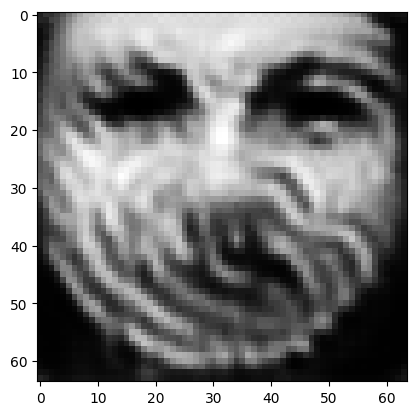

tensor([[2.1381e-06, 1.8330e-05, 1.0323e-04, 6.8522e-05, 6.4862e-06, 3.1292e-05,
         3.1028e-07, 1.5838e-06, 9.9512e-01, 3.4023e-05, 3.2979e-06, 6.5640e-05,
         7.7064e-04, 7.6725e-06, 1.7053e-05, 3.2726e-07, 1.4889e-07, 1.7525e-05,
         1.1476e-06, 4.4294e-05, 2.7035e-04, 1.5488e-06, 3.4582e-07, 7.2488e-09,
         3.7636e-06, 6.1896e-06, 1.0679e-04, 1.2011e-05, 9.0719e-06, 3.4513e-05,
         3.7854e-04, 7.7220e-08, 1.6728e-05, 3.2157e-05, 7.4725e-04, 7.4967e-07,
         3.5352e-07, 4.8590e-06, 2.5421e-04, 1.8024e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004887419752776623
tensor([[2.1381e-06, 1.8329e-05, 1.0322e-04, 6.8520e-05, 6.4858e-06, 3.1290e-05,
         3.1025e-07, 1.5836e-06, 9.9512e-01, 3.4020e-05, 3.2977e-06, 6.5637e-05,
         7.7059e-04, 7.6721e-06, 1.7053e-05, 3.2725e-07, 1.4888e-07, 1.7524e-05,
         1.1476e-06, 4.4291e-05, 2.7034e-04, 1.5487e-06, 3.4579e-07, 7.2485e-09,
         3.7634e-06, 6.1892e-06, 1.0679e-

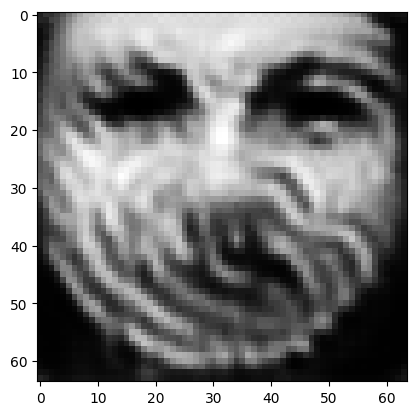

tensor([[2.1378e-06, 1.8324e-05, 1.0320e-04, 6.8509e-05, 6.4840e-06, 3.1282e-05,
         3.1017e-07, 1.5833e-06, 9.9513e-01, 3.4012e-05, 3.2969e-06, 6.5624e-05,
         7.7043e-04, 7.6708e-06, 1.7052e-05, 3.2718e-07, 1.4885e-07, 1.7520e-05,
         1.1473e-06, 4.4283e-05, 2.7030e-04, 1.5485e-06, 3.4569e-07, 7.2472e-09,
         3.7628e-06, 6.1878e-06, 1.0675e-04, 1.2008e-05, 9.0690e-06, 3.4503e-05,
         3.7848e-04, 7.7193e-08, 1.6723e-05, 3.2149e-05, 7.4708e-04, 7.4947e-07,
         3.5343e-07, 4.8578e-06, 2.5414e-04, 1.8018e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0048861149698495865
tensor([[2.1377e-06, 1.8323e-05, 1.0320e-04, 6.8506e-05, 6.4836e-06, 3.1280e-05,
         3.1015e-07, 1.5832e-06, 9.9513e-01, 3.4010e-05, 3.2967e-06, 6.5621e-05,
         7.7038e-04, 7.6705e-06, 1.7051e-05, 3.2716e-07, 1.4884e-07, 1.7520e-05,
         1.1473e-06, 4.4281e-05, 2.7029e-04, 1.5484e-06, 3.4566e-07, 7.2469e-09,
         3.7627e-06, 6.1875e-06, 1.0675e

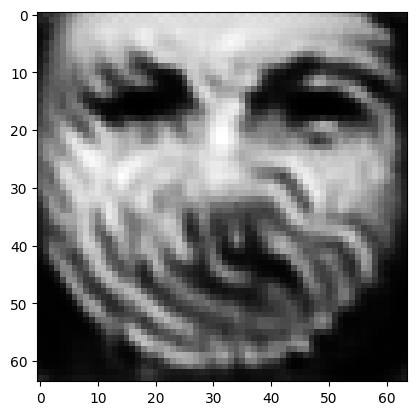

tensor([[2.1374e-06, 1.8318e-05, 1.0318e-04, 6.8496e-05, 6.4819e-06, 3.1272e-05,
         3.1007e-07, 1.5828e-06, 9.9513e-01, 3.4002e-05, 3.2961e-06, 6.5609e-05,
         7.7022e-04, 7.6692e-06, 1.7050e-05, 3.2710e-07, 1.4881e-07, 1.7516e-05,
         1.1471e-06, 4.4272e-05, 2.7026e-04, 1.5482e-06, 3.4556e-07, 7.2457e-09,
         3.7621e-06, 6.1861e-06, 1.0672e-04, 1.2005e-05, 9.0663e-06, 3.4495e-05,
         3.7844e-04, 7.7168e-08, 1.6718e-05, 3.2141e-05, 7.4693e-04, 7.4928e-07,
         3.5335e-07, 4.8567e-06, 2.5408e-04, 1.8011e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.004884809721261263
tensor([[2.1373e-06, 1.8317e-05, 1.0317e-04, 6.8494e-05, 6.4815e-06, 3.1270e-05,
         3.1005e-07, 1.5827e-06, 9.9513e-01, 3.4000e-05, 3.2959e-06, 6.5606e-05,
         7.7018e-04, 7.6689e-06, 1.7050e-05, 3.2708e-07, 1.4880e-07, 1.7516e-05,
         1.1470e-06, 4.4270e-05, 2.7025e-04, 1.5482e-06, 3.4554e-07, 7.2454e-09,
         3.7619e-06, 6.1858e-06, 1.0671e-

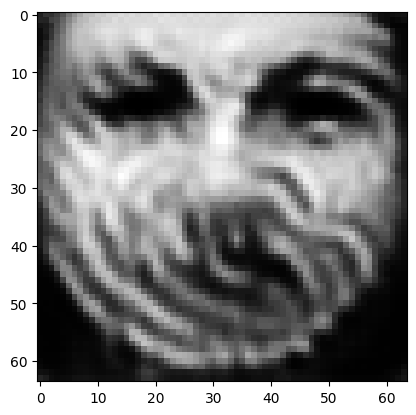

tensor([[2.1371e-06, 1.8313e-05, 1.0315e-04, 6.8484e-05, 6.4798e-06, 3.1263e-05,
         3.0997e-07, 1.5824e-06, 9.9513e-01, 3.3993e-05, 3.2952e-06, 6.5594e-05,
         7.7003e-04, 7.6677e-06, 1.7049e-05, 3.2702e-07, 1.4877e-07, 1.7512e-05,
         1.1468e-06, 4.4262e-05, 2.7021e-04, 1.5479e-06, 3.4545e-07, 7.2442e-09,
         3.7614e-06, 6.1845e-06, 1.0668e-04, 1.2003e-05, 9.0637e-06, 3.4487e-05,
         3.7839e-04, 7.7143e-08, 1.6714e-05, 3.2134e-05, 7.4678e-04, 7.4910e-07,
         3.5327e-07, 4.8557e-06, 2.5402e-04, 1.8006e-03]], device='cuda:3',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00488362368196249
tensor([[2.1370e-06, 1.8312e-05, 1.0315e-04, 6.8482e-05, 6.4795e-06, 3.1261e-05,
         3.0995e-07, 1.5823e-06, 9.9513e-01, 3.3991e-05, 3.2951e-06, 6.5592e-05,
         7.6999e-04, 7.6674e-06, 1.7049e-05, 3.2701e-07, 1.4876e-07, 1.7512e-05,
         1.1468e-06, 4.4260e-05, 2.7020e-04, 1.5479e-06, 3.4543e-07, 7.2440e-09,
         3.7613e-06, 6.1842e-06, 1.0667e-0

In [12]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=8)

In [13]:
r = d2c_decoder(z).detach().cpu()
torch.save(r, 'attack8_VAE_overfit.pt')

tensor([[2.5848e-04, 4.0420e-05, 9.8727e-04, 5.1926e-04, 5.1032e-02, 2.2791e-05,
         9.3900e-05, 5.8281e-05, 3.0249e-05, 1.1608e-06, 7.1881e-06, 3.9833e-05,
         2.3747e-03, 5.5020e-03, 8.1012e-05, 8.5645e-06, 7.0961e-03, 6.3571e-04,
         1.4794e-04, 1.9615e-05, 3.9371e-03, 2.7482e-04, 4.5967e-01, 9.8376e-05,
         7.0692e-02, 7.0774e-03, 9.5246e-05, 2.1985e-04, 3.0633e-05, 6.3834e-04,
         2.9226e-04, 6.1719e-04, 2.1063e-03, 2.2034e-03, 1.7091e-03, 6.5032e-03,
         3.6879e-01, 4.0325e-03, 1.5311e-03, 5.2322e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  13.6664400100708


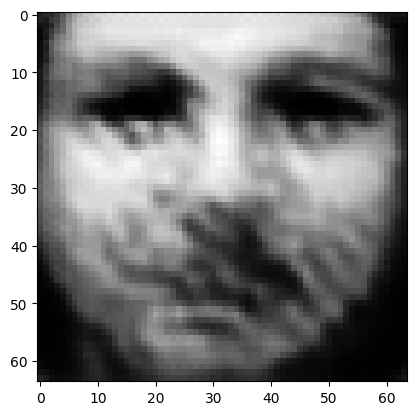

tensor([[2.8685e-05, 1.2676e-04, 9.9524e-05, 4.2428e-04, 6.0777e-03, 5.5806e-06,
         4.2212e-05, 4.1912e-05, 6.5983e-05, 1.9055e-06, 1.6409e-05, 2.1486e-05,
         1.2261e-03, 8.9918e-03, 5.7860e-05, 3.8041e-06, 2.0574e-03, 4.6068e-04,
         8.4443e-05, 5.7620e-06, 3.5208e-03, 5.5436e-05, 4.0609e-01, 3.3196e-05,
         5.4673e-02, 1.6589e-01, 1.3915e-05, 1.0494e-04, 2.1338e-05, 8.0273e-04,
         1.5244e-04, 3.5505e-04, 2.2059e-03, 7.2776e-04, 2.1800e-03, 1.0127e-02,
         3.2941e-01, 3.2897e-03, 4.0936e-04, 1.0686e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  13.170751571655273
tensor([[1.0145e-04, 2.6624e-03, 4.3343e-03, 4.0141e-03, 5.3228e-02, 3.7435e-04,
         1.2010e-03, 3.5976e-04, 4.3054e-03, 1.5079e-04, 1.7889e-04, 3.2076e-04,
         2.1734e-01, 5.7252e-03, 1.8207e-03, 2.6143e-05, 1.0919e-02, 1.0066e-02,
         4.4407e-04, 2.5736e-03, 2.9502e-02, 1.3109e-04, 8.5451e-02, 9.6286e-05,
         1.9877e-01, 4.6999e-03, 6.5905e-04

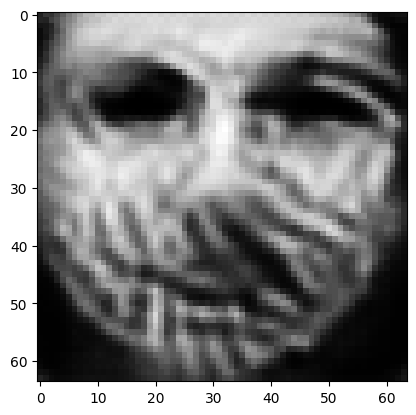

tensor([[1.7672e-04, 3.3569e-03, 1.4509e-02, 1.4447e-03, 2.8851e-04, 5.6713e-02,
         7.5881e-04, 3.8154e-03, 2.6681e-02, 2.1334e-01, 3.3274e-04, 1.0400e-02,
         8.8258e-04, 6.1430e-06, 3.5804e-06, 2.9629e-04, 2.4344e-05, 2.3303e-04,
         4.0577e-04, 1.9996e-02, 2.6705e-04, 3.1548e-04, 7.6978e-07, 7.9460e-07,
         1.6330e-05, 2.2721e-04, 5.0336e-02, 1.3233e-03, 2.5573e-02, 1.1143e-03,
         2.9424e-03, 1.7004e-04, 2.6320e-02, 1.7957e-03, 3.9059e-03, 2.5219e-05,
         2.4154e-05, 2.0847e-03, 6.9826e-03, 5.2291e-01]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.544891357421875
tensor([[3.7250e-04, 2.8005e-03, 1.2255e-02, 1.1009e-03, 2.2182e-04, 5.8194e-02,
         2.1240e-03, 1.1379e-02, 2.7219e-03, 6.0428e-01, 4.8276e-04, 6.5229e-03,
         2.7950e-04, 1.7447e-06, 2.1930e-06, 7.9179e-04, 4.4158e-05, 2.1866e-04,
         6.8747e-04, 4.7159e-02, 7.3964e-05, 4.2854e-04, 1.5563e-07, 1.9143e-06,
         1.7941e-05, 1.2782e-04, 3.5496e-02,

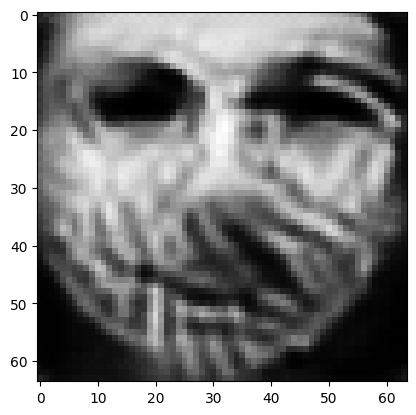

tensor([[1.0509e-04, 7.9244e-04, 4.2119e-03, 5.1422e-04, 3.3781e-05, 7.8686e-03,
         2.1764e-04, 3.4421e-03, 1.1799e-03, 9.2046e-01, 1.0484e-04, 1.2069e-03,
         6.2414e-05, 4.8233e-07, 3.0259e-07, 1.6668e-04, 8.2476e-06, 1.5585e-05,
         1.6907e-04, 5.4936e-03, 1.1201e-05, 1.6398e-04, 1.7749e-08, 4.3761e-07,
         3.2936e-06, 8.3733e-05, 4.4507e-03, 4.6228e-04, 1.9770e-02, 3.4647e-04,
         1.3861e-03, 6.0404e-05, 3.5114e-03, 6.2113e-04, 3.9374e-04, 4.6727e-06,
         6.1649e-06, 8.8450e-04, 1.2104e-03, 2.0576e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.08288201689720154
tensor([[9.9271e-05, 7.2332e-04, 3.8173e-03, 4.8501e-04, 3.0848e-05, 6.9046e-03,
         1.9475e-04, 3.1481e-03, 1.0935e-03, 9.2921e-01, 9.6215e-05, 1.0724e-03,
         5.8348e-05, 4.3904e-07, 2.7597e-07, 1.5204e-04, 7.4907e-06, 1.3910e-05,
         1.5155e-04, 4.9031e-03, 9.8043e-06, 1.5383e-04, 1.5326e-08, 4.0367e-07,
         3.0757e-06, 7.6396e-05, 3.9475e-0

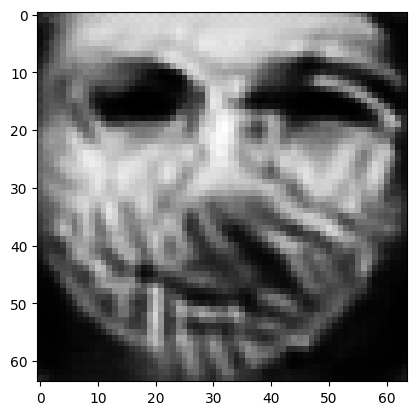

tensor([[8.1954e-05, 5.5853e-04, 2.7746e-03, 3.7861e-04, 2.3502e-05, 4.7278e-03,
         1.4730e-04, 2.4270e-03, 7.9425e-04, 9.4863e-01, 7.8637e-05, 7.8651e-04,
         4.5919e-05, 3.1230e-07, 2.0972e-07, 1.2365e-04, 5.7430e-06, 1.0342e-05,
         1.1342e-04, 3.8173e-03, 6.6567e-06, 1.2654e-04, 9.7507e-09, 3.2182e-07,
         2.3991e-06, 5.4970e-05, 2.8986e-03, 3.1676e-04, 1.3543e-02, 2.5280e-04,
         1.1197e-03, 4.4807e-05, 2.2607e-03, 4.3782e-04, 2.5104e-04, 3.4650e-06,
         4.3208e-06, 6.0005e-04, 8.2582e-04, 1.1728e-02]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0527399443089962
tensor([[7.8271e-05, 5.2728e-04, 2.5907e-03, 3.5539e-04, 2.2226e-05, 4.3966e-03,
         1.3908e-04, 2.3053e-03, 7.2938e-04, 9.5172e-01, 7.5451e-05, 7.4113e-04,
         4.3087e-05, 2.8556e-07, 1.9656e-07, 1.1886e-04, 5.4266e-06, 9.7287e-06,
         1.0662e-04, 3.6396e-03, 6.1290e-06, 1.2078e-04, 8.7828e-09, 3.0480e-07,
         2.2591e-06, 5.0982e-05, 2.7269e-03

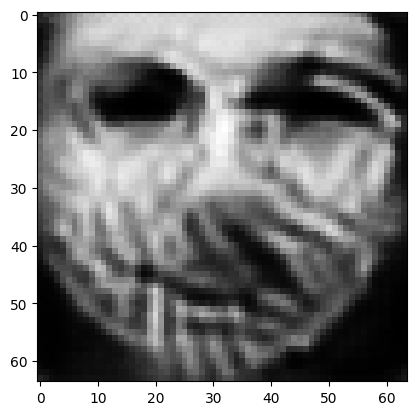

tensor([[6.6958e-05, 4.1454e-04, 2.0684e-03, 2.8926e-04, 1.8381e-05, 3.4745e-03,
         1.1480e-04, 2.0006e-03, 5.3157e-04, 9.6153e-01, 6.4734e-05, 5.7451e-04,
         3.4326e-05, 2.0598e-07, 1.4689e-07, 1.0270e-04, 4.4800e-06, 7.4865e-06,
         8.3167e-05, 2.9261e-03, 4.3068e-06, 1.0098e-04, 6.0119e-09, 2.5457e-07,
         1.8111e-06, 3.9819e-05, 2.1124e-03, 2.3638e-04, 1.0821e-02, 1.8983e-04,
         8.4219e-04, 3.5817e-05, 1.6346e-03, 3.3086e-04, 1.7626e-04, 2.6069e-06,
         3.2484e-06, 4.4930e-04, 6.0731e-04, 8.1021e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.039227668195962906
tensor([[6.4523e-05, 3.9317e-04, 1.9544e-03, 2.7528e-04, 1.7548e-05, 3.2928e-03,
         1.1005e-04, 1.9353e-03, 4.9272e-04, 9.6342e-01, 6.2807e-05, 5.4326e-04,
         3.2438e-05, 1.9050e-07, 1.3793e-07, 9.9737e-05, 4.2820e-06, 7.0636e-06,
         7.8863e-05, 2.8028e-03, 3.9832e-06, 9.6837e-05, 5.5097e-09, 2.4402e-07,
         1.7221e-06, 3.7523e-05, 2.0005e-

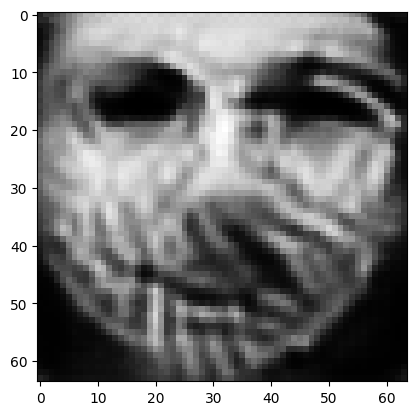

tensor([[5.6694e-05, 3.2828e-04, 1.6222e-03, 2.3289e-04, 1.5124e-05, 2.7387e-03,
         9.5923e-05, 1.7363e-03, 3.8091e-04, 9.6928e-01, 5.6509e-05, 4.5065e-04,
         2.6922e-05, 1.4721e-07, 1.1098e-07, 8.8949e-05, 3.6865e-06, 5.8402e-06,
         6.5035e-05, 2.4089e-03, 3.0362e-06, 8.4133e-05, 4.0900e-09, 2.1172e-07,
         1.4369e-06, 3.0734e-05, 1.6640e-03, 1.8791e-04, 9.0661e-03, 1.5026e-04,
         6.4699e-04, 3.0732e-05, 1.2864e-03, 2.6744e-04, 1.3270e-04, 2.0639e-06,
         2.5587e-06, 3.6094e-04, 4.7671e-04, 6.0134e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.03120320476591587
tensor([[5.5103e-05, 3.1560e-04, 1.5600e-03, 2.2472e-04, 1.4672e-05, 2.6348e-03,
         9.3684e-05, 1.7009e-03, 3.5919e-04, 9.7041e-01, 5.5177e-05, 4.3246e-04,
         2.5923e-05, 1.3943e-07, 1.0556e-07, 8.6556e-05, 3.5711e-06, 5.6184e-06,
         6.2184e-05, 2.3328e-03, 2.8569e-06, 8.1593e-05, 3.8344e-09, 2.0558e-07,
         1.3823e-06, 2.9414e-05, 1.6010e-0

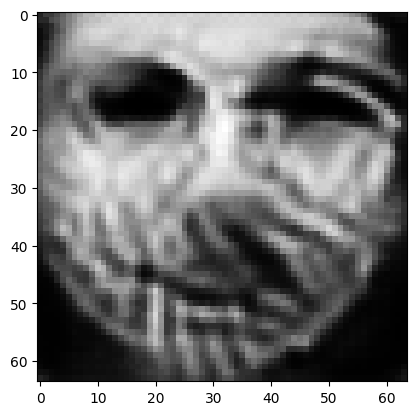

tensor([[5.0205e-05, 2.7428e-04, 1.3781e-03, 1.9664e-04, 1.3184e-05, 2.3140e-03,
         8.5165e-05, 1.5843e-03, 2.9025e-04, 9.7390e-01, 5.0814e-05, 3.7458e-04,
         2.2535e-05, 1.1414e-07, 8.8503e-08, 7.9985e-05, 3.1955e-06, 4.9099e-06,
         5.3355e-05, 2.0819e-03, 2.3238e-06, 7.3577e-05, 3.0556e-09, 1.8716e-07,
         1.2110e-06, 2.5284e-05, 1.3959e-03, 1.5958e-04, 8.0027e-03, 1.2516e-04,
         5.2762e-04, 2.7483e-05, 1.0774e-03, 2.2797e-04, 1.0742e-04, 1.7119e-06,
         2.1678e-06, 3.0474e-04, 3.9627e-04, 4.7800e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.026442909613251686
tensor([[4.9248e-05, 2.6786e-04, 1.3404e-03, 1.9208e-04, 1.2911e-05, 2.2442e-03,
         8.3413e-05, 1.5538e-03, 2.8079e-04, 9.7458e-01, 5.0020e-05, 3.6463e-04,
         2.1993e-05, 1.1043e-07, 8.5977e-08, 7.8478e-05, 3.1092e-06, 4.8000e-06,
         5.1770e-05, 2.0395e-03, 2.2411e-06, 7.2039e-05, 2.9315e-09, 1.8307e-07,
         1.1817e-06, 2.4548e-05, 1.3612e-

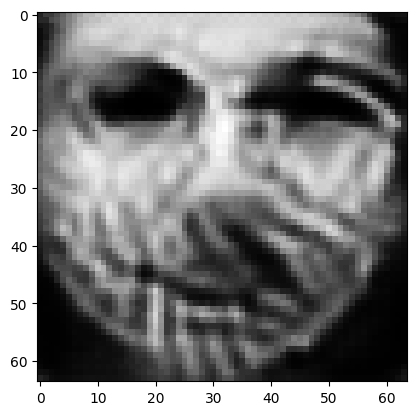

tensor([[4.5773e-05, 2.4466e-04, 1.2071e-03, 1.7649e-04, 1.1906e-05, 1.9884e-03,
         7.7067e-05, 1.4462e-03, 2.4565e-04, 9.7696e-01, 4.7092e-05, 3.2802e-04,
         2.0152e-05, 9.7862e-08, 7.6792e-08, 7.3215e-05, 2.8287e-06, 4.3532e-06,
         4.6332e-05, 1.8735e-03, 1.9551e-06, 6.6742e-05, 2.5217e-09, 1.6995e-07,
         1.0834e-06, 2.2128e-05, 1.2275e-03, 1.4179e-04, 7.2151e-03, 1.1220e-04,
         4.7105e-04, 2.5396e-05, 9.5163e-04, 2.0437e-04, 9.2924e-05, 1.5225e-06,
         1.9238e-06, 2.7124e-04, 3.4937e-04, 4.0443e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.023311017081141472
tensor([[4.5057e-05, 2.3902e-04, 1.1790e-03, 1.7278e-04, 1.1663e-05, 1.9336e-03,
         7.5569e-05, 1.4233e-03, 2.3687e-04, 9.7748e-01, 4.6372e-05, 3.1926e-04,
         1.9707e-05, 9.4843e-08, 7.4461e-08, 7.2208e-05, 2.7712e-06, 4.2378e-06,
         4.5219e-05, 1.8314e-03, 1.8907e-06, 6.5611e-05, 2.4304e-09, 1.6723e-07,
         1.0596e-06, 2.1599e-05, 1.1951e-

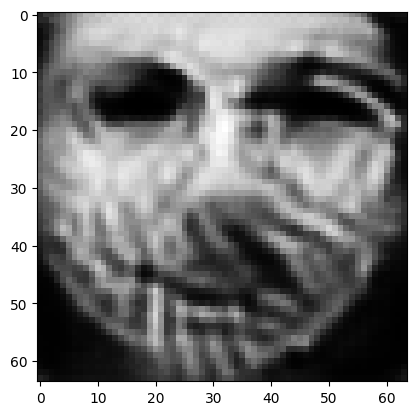

tensor([[4.2305e-05, 2.1935e-04, 1.0718e-03, 1.5937e-04, 1.0776e-05, 1.7305e-03,
         7.0482e-05, 1.3302e-03, 2.0726e-04, 9.7936e-01, 4.3699e-05, 2.8820e-04,
         1.8182e-05, 8.4039e-08, 6.6510e-08, 6.8205e-05, 2.5438e-06, 3.8429e-06,
         4.1059e-05, 1.6840e-03, 1.6667e-06, 6.1301e-05, 2.1130e-09, 1.5651e-07,
         9.7523e-07, 1.9562e-05, 1.0826e-03, 1.2622e-04, 6.6771e-03, 1.0152e-04,
         4.2495e-04, 2.3564e-05, 8.4876e-04, 1.8464e-04, 8.1189e-05, 1.3751e-06,
         1.7303e-06, 2.4221e-04, 3.1092e-04, 3.4545e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.020852968096733093
tensor([[4.1666e-05, 2.1441e-04, 1.0485e-03, 1.5605e-04, 1.0556e-05, 1.6872e-03,
         6.9313e-05, 1.3103e-03, 2.0057e-04, 9.7978e-01, 4.3075e-05, 2.8109e-04,
         1.7778e-05, 8.1355e-08, 6.4583e-08, 6.7339e-05, 2.4901e-06, 3.7477e-06,
         4.0103e-05, 1.6494e-03, 1.6147e-06, 6.0295e-05, 2.0393e-09, 1.5392e-07,
         9.5436e-07, 1.9085e-05, 1.0564e-

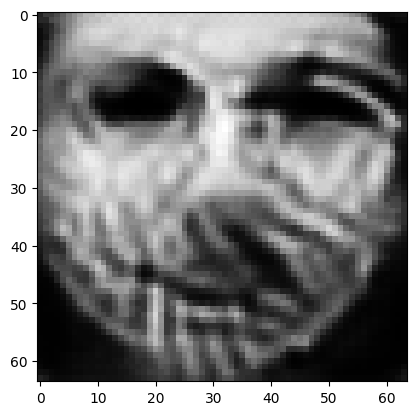

tensor([[3.9253e-05, 1.9633e-04, 9.6914e-04, 1.4406e-04, 9.7974e-06, 1.5459e-03,
         6.5387e-05, 1.2449e-03, 1.7586e-04, 9.8122e-01, 4.0913e-05, 2.5647e-04,
         1.6239e-05, 7.1906e-08, 5.7695e-08, 6.4599e-05, 2.3081e-06, 3.4086e-06,
         3.6786e-05, 1.5279e-03, 1.4317e-06, 5.6796e-05, 1.7828e-09, 1.4538e-07,
         8.7381e-07, 1.7416e-05, 9.6579e-04, 1.1340e-04, 6.2880e-03, 9.1736e-05,
         3.8154e-04, 2.2027e-05, 7.6433e-04, 1.6810e-04, 7.1520e-05, 1.2428e-06,
         1.5601e-06, 2.1766e-04, 2.7873e-04, 2.9995e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.01895972341299057
tensor([[3.8702e-05, 1.9218e-04, 9.5210e-04, 1.4142e-04, 9.6292e-06, 1.5156e-03,
         6.4521e-05, 1.2308e-03, 1.7053e-04, 9.8154e-01, 4.0437e-05, 2.5093e-04,
         1.5885e-05, 6.9858e-08, 5.6144e-08, 6.3997e-05, 2.2685e-06, 3.3322e-06,
         3.6054e-05, 1.5006e-03, 1.3919e-06, 5.5957e-05, 1.7270e-09, 1.4354e-07,
         8.5533e-07, 1.7049e-05, 9.4489e-0

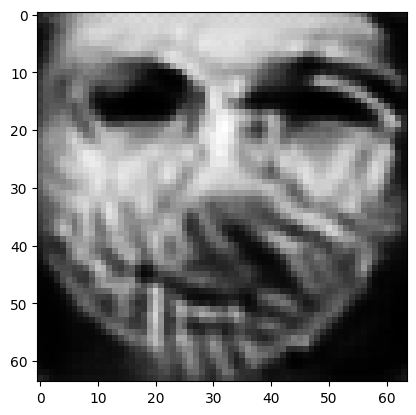

tensor([[3.6731e-05, 1.7905e-04, 8.8926e-04, 1.3355e-04, 9.0102e-06, 1.3927e-03,
         6.1123e-05, 1.1687e-03, 1.5499e-04, 9.8269e-01, 3.8778e-05, 2.3296e-04,
         1.4800e-05, 6.3943e-08, 5.1481e-08, 6.1551e-05, 2.1343e-06, 3.0713e-06,
         3.3821e-05, 1.4091e-03, 1.2680e-06, 5.3170e-05, 1.5580e-09, 1.3723e-07,
         7.9783e-07, 1.5852e-05, 8.7466e-04, 1.0369e-04, 5.9446e-03, 8.4910e-05,
         3.5493e-04, 2.0767e-05, 6.9797e-04, 1.5501e-04, 6.4421e-05, 1.1514e-06,
         1.4333e-06, 2.0032e-04, 2.5410e-04, 2.6603e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.017462553456425667
tensor([[3.6293e-05, 1.7613e-04, 8.7500e-04, 1.3191e-04, 8.8707e-06, 1.3639e-03,
         6.0355e-05, 1.1536e-03, 1.5180e-04, 9.8295e-01, 3.8384e-05, 2.2891e-04,
         1.4572e-05, 6.2694e-08, 5.0486e-08, 6.0947e-05, 2.1036e-06, 3.0139e-06,
         3.3313e-05, 1.3899e-03, 1.2410e-06, 5.2525e-05, 1.5229e-09, 1.3579e-07,
         7.8626e-07, 1.5588e-05, 8.5888e-

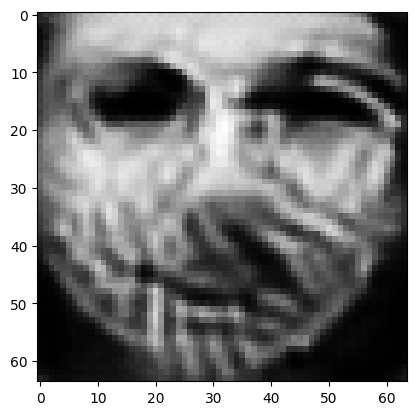

tensor([[3.4826e-05, 1.6573e-04, 8.2574e-04, 1.2591e-04, 8.4002e-06, 1.2698e-03,
         5.7745e-05, 1.1035e-03, 1.4002e-04, 9.8387e-01, 3.6962e-05, 2.1430e-04,
         1.3749e-05, 5.8074e-08, 4.6791e-08, 5.8868e-05, 1.9929e-06, 2.8200e-06,
         3.1381e-05, 1.3205e-03, 1.1424e-06, 5.0135e-05, 1.3950e-09, 1.3055e-07,
         7.4405e-07, 1.4640e-05, 8.0571e-04, 9.6165e-05, 5.6414e-03, 7.9425e-05,
         3.3609e-04, 1.9724e-05, 6.4704e-04, 1.4466e-04, 5.9063e-05, 1.0851e-06,
         1.3344e-06, 1.8694e-04, 2.3564e-04, 2.4007e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.016265662387013435
tensor([[3.4519e-05, 1.6359e-04, 8.1442e-04, 1.2480e-04, 8.3033e-06, 1.2484e-03,
         5.7155e-05, 1.0916e-03, 1.3799e-04, 9.8408e-01, 3.6633e-05, 2.1112e-04,
         1.3594e-05, 5.7192e-08, 4.6067e-08, 5.8317e-05, 1.9665e-06, 2.7793e-06,
         3.0946e-05, 1.3056e-03, 1.1220e-06, 4.9584e-05, 1.3697e-09, 1.2932e-07,
         7.3623e-07, 1.4440e-05, 7.9467e-

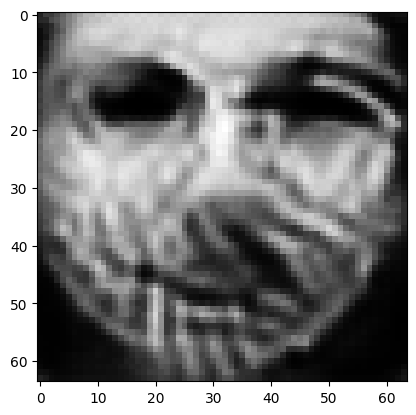

tensor([[3.3453e-05, 1.5709e-04, 7.7109e-04, 1.2131e-04, 7.9703e-06, 1.1729e-03,
         5.5220e-05, 1.0481e-03, 1.3158e-04, 9.8481e-01, 3.5549e-05, 2.0104e-04,
         1.3122e-05, 5.4427e-08, 4.3833e-08, 5.6408e-05, 1.8745e-06, 2.6477e-06,
         2.9499e-05, 1.2575e-03, 1.0559e-06, 4.7647e-05, 1.2909e-09, 1.2487e-07,
         7.0991e-07, 1.3749e-05, 7.6151e-04, 9.0735e-05, 5.3312e-03, 7.5646e-05,
         3.2621e-04, 1.8925e-05, 6.1185e-04, 1.3697e-04, 5.5307e-05, 1.0445e-06,
         1.2619e-06, 1.7747e-04, 2.2259e-04, 2.2191e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.015306037850677967
tensor([[3.3205e-05, 1.5576e-04, 7.6119e-04, 1.2056e-04, 7.8961e-06, 1.1555e-03,
         5.4771e-05, 1.0377e-03, 1.3026e-04, 9.8498e-01, 3.5311e-05, 1.9896e-04,
         1.3025e-05, 5.3869e-08, 4.3372e-08, 5.5967e-05, 1.8539e-06, 2.6194e-06,
         2.9185e-05, 1.2464e-03, 1.0419e-06, 4.7239e-05, 1.2745e-09, 1.2386e-07,
         7.0405e-07, 1.3600e-05, 7.5464e-

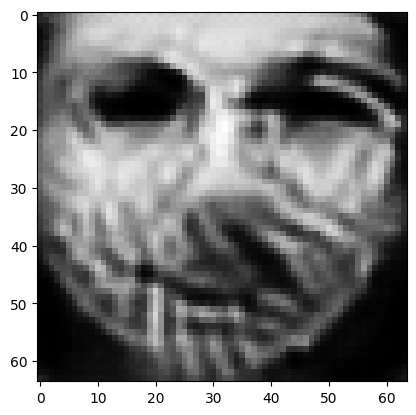

tensor([[3.2226e-05, 1.5024e-04, 7.2567e-04, 1.1715e-04, 7.6080e-06, 1.0931e-03,
         5.3170e-05, 1.0019e-03, 1.2486e-04, 9.8557e-01, 3.4431e-05, 1.9107e-04,
         1.2615e-05, 5.1515e-08, 4.1553e-08, 5.4416e-05, 1.7765e-06, 2.5107e-06,
         2.8001e-05, 1.2069e-03, 9.8935e-07, 4.5720e-05, 1.2093e-09, 1.2008e-07,
         6.7999e-07, 1.3018e-05, 7.2775e-04, 8.6270e-05, 5.0795e-03, 7.2556e-05,
         3.1805e-04, 1.8334e-05, 5.8553e-04, 1.3093e-04, 5.2190e-05, 1.0109e-06,
         1.2021e-06, 1.6973e-04, 2.1209e-04, 2.0762e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0145347835496068
tensor([[3.1990e-05, 1.4885e-04, 7.1803e-04, 1.1622e-04, 7.5350e-06, 1.0792e-03,
         5.2752e-05, 9.9399e-04, 1.2342e-04, 9.8570e-01, 3.4232e-05, 1.8916e-04,
         1.2500e-05, 5.0895e-08, 4.1096e-08, 5.4084e-05, 1.7590e-06, 2.4831e-06,
         2.7736e-05, 1.1970e-03, 9.7720e-07, 4.5387e-05, 1.1921e-09, 1.1917e-07,
         6.7347e-07, 1.2881e-05, 7.2077e-04

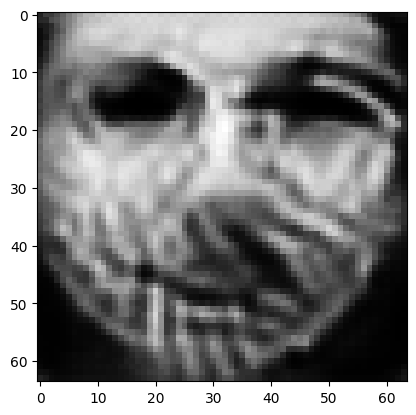

tensor([[3.1114e-05, 1.4370e-04, 6.8979e-04, 1.1289e-04, 7.2687e-06, 1.0286e-03,
         5.1215e-05, 9.6540e-04, 1.1823e-04, 9.8619e-01, 3.3448e-05, 1.8215e-04,
         1.2092e-05, 4.8620e-08, 3.9389e-08, 5.2826e-05, 1.6944e-06, 2.3808e-06,
         2.6732e-05, 1.1597e-03, 9.3207e-07, 4.4088e-05, 1.1305e-09, 1.1579e-07,
         6.4919e-07, 1.2371e-05, 6.9528e-04, 8.2395e-05, 4.9038e-03, 6.9798e-05,
         3.0869e-04, 1.7765e-05, 5.6057e-04, 1.2552e-04, 4.9432e-05, 9.7491e-07,
         1.1458e-06, 1.6255e-04, 2.0242e-04, 1.9559e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013910016044974327
tensor([[3.0926e-05, 1.4255e-04, 6.8350e-04, 1.1220e-04, 7.2088e-06, 1.0172e-03,
         5.0840e-05, 9.5856e-04, 1.1717e-04, 9.8630e-01, 3.3265e-05, 1.8056e-04,
         1.1999e-05, 4.8112e-08, 3.9012e-08, 5.2519e-05, 1.6794e-06, 2.3581e-06,
         2.6502e-05, 1.1509e-03, 9.2208e-07, 4.3783e-05, 1.1163e-09, 1.1497e-07,
         6.4379e-07, 1.2255e-05, 6.8939e-

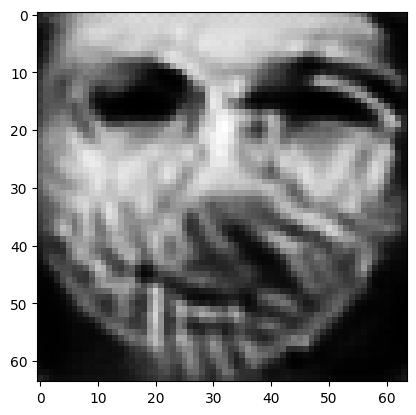

tensor([[3.0216e-05, 1.3850e-04, 6.5909e-04, 1.0980e-04, 6.9885e-06, 9.7324e-04,
         4.9457e-05, 9.3182e-04, 1.1346e-04, 9.8672e-01, 3.2607e-05, 1.7480e-04,
         1.1677e-05, 4.6373e-08, 3.7711e-08, 5.1337e-05, 1.6241e-06, 2.2771e-06,
         2.5677e-05, 1.1193e-03, 8.8620e-07, 4.2642e-05, 1.0671e-09, 1.1200e-07,
         6.2549e-07, 1.1836e-05, 6.6829e-04, 7.9141e-05, 4.7369e-03, 6.7626e-05,
         3.0177e-04, 1.7266e-05, 5.3916e-04, 1.2083e-04, 4.7266e-05, 9.4567e-07,
         1.0998e-06, 1.5673e-04, 1.9409e-04, 1.8569e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.013365083374083042
tensor([[3.0043e-05, 1.3755e-04, 6.5337e-04, 1.0922e-04, 6.9373e-06, 9.6298e-04,
         4.9127e-05, 9.2537e-04, 1.1262e-04, 9.8682e-01, 3.2452e-05, 1.7347e-04,
         1.1601e-05, 4.5966e-08, 3.7407e-08, 5.1048e-05, 1.6109e-06, 2.2583e-06,
         2.5477e-05, 1.1119e-03, 8.7793e-07, 4.2375e-05, 1.0557e-09, 1.1128e-07,
         6.2126e-07, 1.1738e-05, 6.6335e-

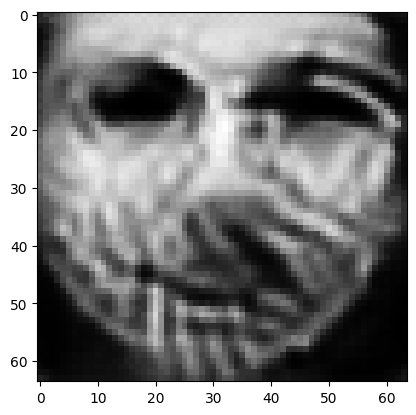

tensor([[2.9411e-05, 1.3405e-04, 6.3235e-04, 1.0707e-04, 6.7473e-06, 9.2596e-04,
         4.7909e-05, 9.0136e-04, 1.0950e-04, 9.8719e-01, 3.1861e-05, 1.6858e-04,
         1.1321e-05, 4.4450e-08, 3.6283e-08, 4.9985e-05, 1.5618e-06, 2.1892e-06,
         2.4731e-05, 1.0848e-03, 8.4747e-07, 4.1386e-05, 1.0135e-09, 1.0856e-07,
         6.0538e-07, 1.1380e-05, 6.4534e-04, 7.6264e-05, 4.5877e-03, 6.5714e-05,
         2.9540e-04, 1.6849e-05, 5.2102e-04, 1.1680e-04, 4.5447e-05, 9.1948e-07,
         1.0599e-06, 1.5172e-04, 1.8696e-04, 1.7745e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012892229482531548
tensor([[2.9264e-05, 1.3325e-04, 6.2744e-04, 1.0659e-04, 6.7033e-06, 9.1729e-04,
         4.7618e-05, 8.9554e-04, 1.0882e-04, 9.8728e-01, 3.1724e-05, 1.6748e-04,
         1.1257e-05, 4.4110e-08, 3.6031e-08, 4.9724e-05, 1.5500e-06, 2.1733e-06,
         2.4553e-05, 1.0784e-03, 8.4060e-07, 4.1160e-05, 1.0039e-09, 1.0791e-07,
         6.0179e-07, 1.1297e-05, 6.4120e-

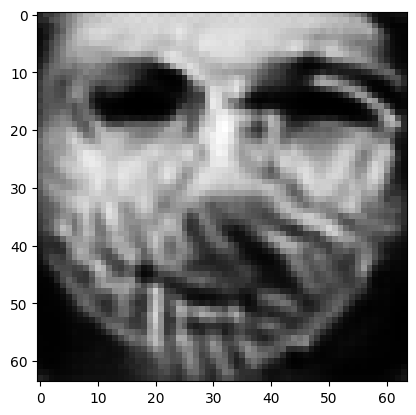

tensor([[2.8668e-05, 1.3027e-04, 6.0866e-04, 1.0476e-04, 6.5354e-06, 8.8431e-04,
         4.6502e-05, 8.7297e-04, 1.0635e-04, 9.8760e-01, 3.1184e-05, 1.6337e-04,
         1.1023e-05, 4.2863e-08, 3.5092e-08, 4.8702e-05, 1.5060e-06, 2.1126e-06,
         2.3883e-05, 1.0543e-03, 8.1505e-07, 4.0301e-05, 9.6809e-10, 1.0534e-07,
         5.8806e-07, 1.0993e-05, 6.2550e-04, 7.3691e-05, 4.4533e-03, 6.4112e-05,
         2.8989e-04, 1.6489e-05, 5.0551e-04, 1.1336e-04, 4.3891e-05, 8.9613e-07,
         1.0250e-06, 1.4731e-04, 1.8096e-04, 1.7048e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012476254254579544
tensor([[2.8529e-05, 1.2959e-04, 6.0430e-04, 1.0436e-04, 6.4960e-06, 8.7648e-04,
         4.6236e-05, 8.6763e-04, 1.0580e-04, 9.8768e-01, 3.1057e-05, 1.6241e-04,
         1.0970e-05, 4.2593e-08, 3.4883e-08, 4.8463e-05, 1.4960e-06, 2.0986e-06,
         2.3733e-05, 1.0487e-03, 8.0925e-07, 4.0097e-05, 9.6009e-10, 1.0475e-07,
         5.8495e-07, 1.0924e-05, 6.2181e-

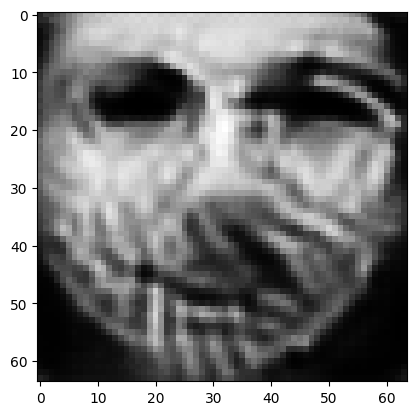

tensor([[2.7973e-05, 1.2677e-04, 5.8777e-04, 1.0259e-04, 6.3405e-06, 8.4692e-04,
         4.5217e-05, 8.4762e-04, 1.0335e-04, 9.8797e-01, 3.0572e-05, 1.5860e-04,
         1.0739e-05, 4.1451e-08, 3.4017e-08, 4.7571e-05, 1.4571e-06, 2.0428e-06,
         2.3130e-05, 1.0259e-03, 7.8595e-07, 3.9319e-05, 9.2685e-10, 1.0242e-07,
         5.7158e-07, 1.0649e-05, 6.0689e-04, 7.1371e-05, 4.3383e-03, 6.2686e-05,
         2.8446e-04, 1.6164e-05, 4.9129e-04, 1.1026e-04, 4.2465e-05, 8.7407e-07,
         9.9321e-07, 1.4329e-04, 1.7560e-04, 1.6416e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.012105214409530163
tensor([[2.7840e-05, 1.2609e-04, 5.8382e-04, 1.0216e-04, 6.3031e-06, 8.3988e-04,
         4.4975e-05, 8.4287e-04, 1.0274e-04, 9.8804e-01, 3.0460e-05, 1.5769e-04,
         1.0682e-05, 4.1174e-08, 3.3809e-08, 4.7362e-05, 1.4477e-06, 2.0296e-06,
         2.2985e-05, 1.0206e-03, 7.8038e-07, 3.9132e-05, 9.1882e-10, 1.0187e-07,
         5.6834e-07, 1.0582e-05, 6.0328e-

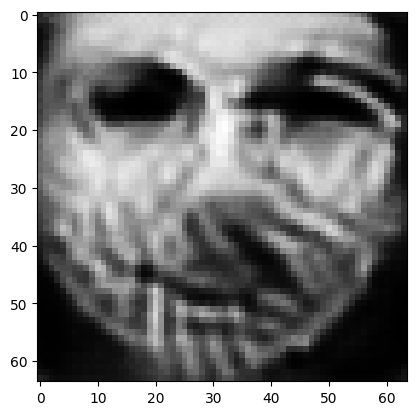

tensor([[2.7343e-05, 1.2348e-04, 5.6936e-04, 1.0053e-04, 6.1632e-06, 8.1342e-04,
         4.4077e-05, 8.2558e-04, 1.0034e-04, 9.8829e-01, 3.0053e-05, 1.5416e-04,
         1.0464e-05, 4.0141e-08, 3.3026e-08, 4.6570e-05, 1.4145e-06, 1.9810e-06,
         2.2451e-05, 1.0007e-03, 7.5930e-07, 3.8425e-05, 8.8885e-10, 9.9907e-08,
         5.5662e-07, 1.0335e-05, 5.8928e-04, 6.9349e-05, 4.2408e-03, 6.1351e-05,
         2.7905e-04, 1.5883e-05, 4.7851e-04, 1.0750e-04, 4.1147e-05, 8.5369e-07,
         9.6403e-07, 1.3974e-04, 1.7069e-04, 1.5825e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011775154620409012
tensor([[2.7222e-05, 1.2287e-04, 5.6586e-04, 1.0014e-04, 6.1300e-06, 8.0695e-04,
         4.3864e-05, 8.2137e-04, 9.9802e-05, 9.8836e-01, 2.9958e-05, 1.5334e-04,
         1.0413e-05, 3.9905e-08, 3.2847e-08, 4.6377e-05, 1.4066e-06, 1.9697e-06,
         2.2327e-05, 9.9625e-04, 7.5446e-07, 3.8257e-05, 8.8206e-10, 9.9447e-08,
         5.5402e-07, 1.0278e-05, 5.8596e-

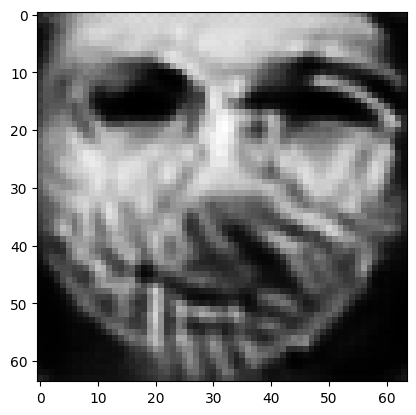

tensor([[2.6761e-05, 1.2044e-04, 5.5281e-04, 9.8589e-05, 6.0041e-06, 7.8350e-04,
         4.3077e-05, 8.0615e-04, 9.7546e-05, 9.8859e-01, 2.9593e-05, 1.5009e-04,
         1.0208e-05, 3.8947e-08, 3.2119e-08, 4.5675e-05, 1.3771e-06, 1.9259e-06,
         2.1845e-05, 9.7856e-04, 7.3508e-07, 3.7596e-05, 8.5497e-10, 9.7705e-08,
         5.4338e-07, 1.0052e-05, 5.7308e-04, 6.7564e-05, 4.1541e-03, 6.0113e-05,
         2.7397e-04, 1.5636e-05, 4.6722e-04, 1.0501e-04, 3.9943e-05, 8.3550e-07,
         9.3738e-07, 1.3655e-04, 1.6625e-04, 1.5288e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011478690430521965
tensor([[2.6654e-05, 1.1989e-04, 5.4970e-04, 9.8249e-05, 5.9749e-06, 7.7800e-04,
         4.2890e-05, 8.0252e-04, 9.7040e-05, 9.8864e-01, 2.9511e-05, 1.4935e-04,
         1.0161e-05, 3.8729e-08, 3.1956e-08, 4.5513e-05, 1.3703e-06, 1.9159e-06,
         2.1736e-05, 9.7449e-04, 7.3065e-07, 3.7436e-05, 8.4886e-10, 9.7308e-08,
         5.4105e-07, 9.9995e-06, 5.7011e-

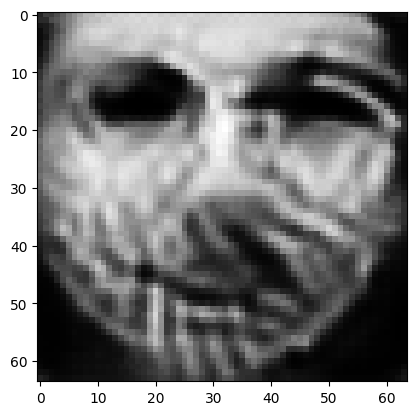

tensor([[2.6237e-05, 1.1776e-04, 5.3781e-04, 9.6887e-05, 5.8616e-06, 7.5697e-04,
         4.2176e-05, 7.8903e-04, 9.5012e-05, 9.8885e-01, 2.9188e-05, 1.4643e-04,
         9.9767e-06, 3.7867e-08, 3.1315e-08, 4.4889e-05, 1.3438e-06, 1.8768e-06,
         2.1316e-05, 9.5914e-04, 7.1347e-07, 3.6823e-05, 8.2522e-10, 9.5802e-08,
         5.3196e-07, 9.7999e-06, 5.5847e-04, 6.5966e-05, 4.0759e-03, 5.8986e-05,
         2.6925e-04, 1.5422e-05, 4.5691e-04, 1.0274e-04, 3.8885e-05, 8.1953e-07,
         9.1311e-07, 1.3374e-04, 1.6210e-04, 1.4794e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.011212081648409367
tensor([[2.6136e-05, 1.1725e-04, 5.3495e-04, 9.6571e-05, 5.8343e-06, 7.5181e-04,
         4.1997e-05, 7.8565e-04, 9.4552e-05, 9.8890e-01, 2.9110e-05, 1.4572e-04,
         9.9335e-06, 3.7668e-08, 3.1161e-08, 4.4727e-05, 1.3375e-06, 1.8674e-06,
         2.1216e-05, 9.5553e-04, 7.0940e-07, 3.6676e-05, 8.1969e-10, 9.5434e-08,
         5.2988e-07, 9.7524e-06, 5.5565e-

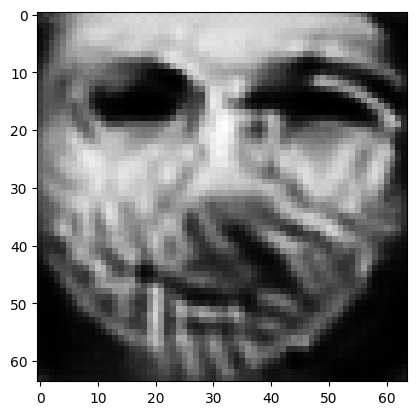

tensor([[2.5764e-05, 1.1537e-04, 5.2443e-04, 9.5498e-05, 5.7325e-06, 7.3256e-04,
         4.1319e-05, 7.7303e-04, 9.2995e-05, 9.8909e-01, 2.8805e-05, 1.4318e-04,
         9.7815e-06, 3.6961e-08, 3.0604e-08, 4.4100e-05, 1.3140e-06, 1.8318e-06,
         2.0844e-05, 9.4196e-04, 6.9456e-07, 3.6122e-05, 7.9993e-10, 9.4066e-08,
         5.2244e-07, 9.5802e-06, 5.4513e-04, 6.4540e-05, 4.0024e-03, 5.8027e-05,
         2.6567e-04, 1.5213e-05, 4.4778e-04, 1.0075e-04, 3.7960e-05, 8.0571e-07,
         8.9154e-07, 1.3129e-04, 1.5859e-04, 1.4357e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010970162227749825
tensor([[2.5679e-05, 1.1497e-04, 5.2192e-04, 9.5279e-05, 5.7098e-06, 7.2799e-04,
         4.1169e-05, 7.7010e-04, 9.2642e-05, 9.8913e-01, 2.8734e-05, 1.4258e-04,
         9.7491e-06, 3.6807e-08, 3.0485e-08, 4.3948e-05, 1.3088e-06, 1.8242e-06,
         2.0760e-05, 9.3906e-04, 6.9113e-07, 3.5993e-05, 7.9563e-10, 9.3772e-08,
         5.2093e-07, 9.5406e-06, 5.4275e-

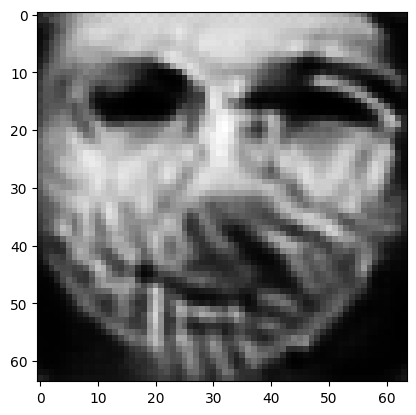

tensor([[2.5352e-05, 1.1343e-04, 5.1232e-04, 9.4392e-05, 5.6213e-06, 7.1079e-04,
         4.0575e-05, 7.5875e-04, 9.1295e-05, 9.8931e-01, 2.8452e-05, 1.4033e-04,
         9.6220e-06, 3.6199e-08, 3.0012e-08, 4.3378e-05, 1.2875e-06, 1.7939e-06,
         2.0434e-05, 9.2730e-04, 6.7805e-07, 3.5492e-05, 7.7896e-10, 9.2564e-08,
         5.1459e-07, 9.3878e-06, 5.3383e-04, 6.3301e-05, 3.9316e-03, 5.7198e-05,
         2.6273e-04, 1.5034e-05, 4.3988e-04, 9.8994e-05, 3.7146e-05, 7.9447e-07,
         8.7254e-07, 1.2917e-04, 1.5558e-04, 1.3970e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010752007365226746
tensor([[2.5273e-05, 1.1306e-04, 5.1000e-04, 9.4175e-05, 5.6000e-06, 7.0673e-04,
         4.0433e-05, 7.5610e-04, 9.0981e-05, 9.8935e-01, 2.8386e-05, 1.3981e-04,
         9.5912e-06, 3.6052e-08, 2.9898e-08, 4.3242e-05, 1.2823e-06, 1.7865e-06,
         2.0356e-05, 9.2447e-04, 6.7498e-07, 3.5371e-05, 7.7503e-10, 9.2269e-08,
         5.1304e-07, 9.3511e-06, 5.3173e-

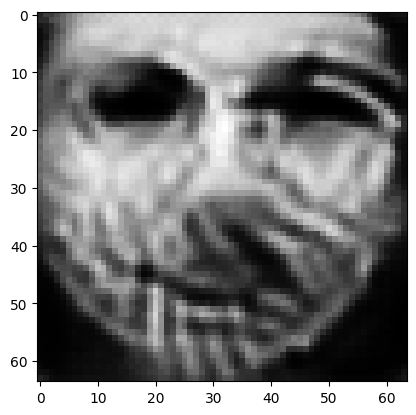

tensor([[2.4975e-05, 1.1158e-04, 5.0122e-04, 9.3276e-05, 5.5194e-06, 6.9137e-04,
         3.9918e-05, 7.4617e-04, 8.9634e-05, 9.8950e-01, 2.8125e-05, 1.3768e-04,
         9.4717e-06, 3.5459e-08, 2.9450e-08, 4.2730e-05, 1.2628e-06, 1.7585e-06,
         2.0049e-05, 9.1376e-04, 6.6265e-07, 3.4915e-05, 7.5956e-10, 9.1174e-08,
         5.0702e-07, 9.2043e-06, 5.2358e-04, 6.2162e-05, 3.8674e-03, 5.6382e-05,
         2.5974e-04, 1.4869e-05, 4.3256e-04, 9.7390e-05, 3.6378e-05, 7.8387e-07,
         8.5475e-07, 1.2713e-04, 1.5282e-04, 1.3620e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010553503409028053
tensor([[2.4902e-05, 1.1124e-04, 4.9907e-04, 9.3065e-05, 5.4998e-06, 6.8760e-04,
         3.9789e-05, 7.4366e-04, 8.9337e-05, 9.8954e-01, 2.8064e-05, 1.3719e-04,
         9.4434e-06, 3.5322e-08, 2.9346e-08, 4.2604e-05, 1.2580e-06, 1.7517e-06,
         1.9978e-05, 9.1128e-04, 6.5983e-07, 3.4808e-05, 7.5596e-10, 9.0900e-08,
         5.0561e-07, 9.1691e-06, 5.2166e-

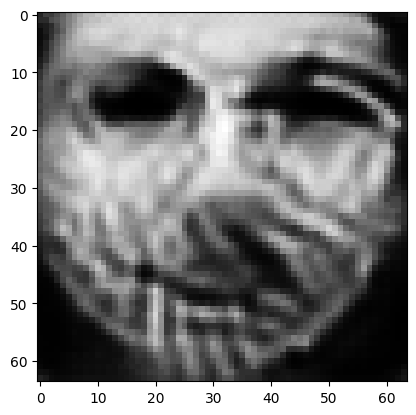

tensor([[2.4612e-05, 1.0956e-04, 4.9067e-04, 9.1992e-05, 5.4176e-06, 6.7263e-04,
         3.9319e-05, 7.3444e-04, 8.7729e-05, 9.8969e-01, 2.7816e-05, 1.3493e-04,
         9.3103e-06, 3.4686e-08, 2.8874e-08, 4.2138e-05, 1.2407e-06, 1.7240e-06,
         1.9684e-05, 9.0129e-04, 6.4691e-07, 3.4376e-05, 7.3993e-10, 8.9952e-08,
         4.9958e-07, 9.0188e-06, 5.1297e-04, 6.1074e-05, 3.8114e-03, 5.5521e-05,
         2.5657e-04, 1.4709e-05, 4.2556e-04, 9.5896e-05, 3.5590e-05, 7.7322e-07,
         8.3816e-07, 1.2507e-04, 1.5013e-04, 1.3266e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010365460999310017
tensor([[2.4539e-05, 1.0908e-04, 4.8862e-04, 9.1679e-05, 5.3963e-06, 6.6889e-04,
         3.9208e-05, 7.3234e-04, 8.7254e-05, 9.8972e-01, 2.7755e-05, 1.3432e-04,
         9.2722e-06, 3.4513e-08, 2.8747e-08, 4.2029e-05, 1.2367e-06, 1.7170e-06,
         1.9611e-05, 8.9884e-04, 6.4342e-07, 3.4270e-05, 7.3569e-10, 8.9747e-08,
         4.9803e-07, 8.9806e-06, 5.1059e-

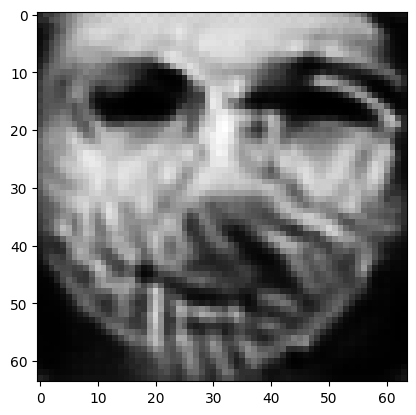

tensor([[2.4240e-05, 1.0696e-04, 4.8086e-04, 9.0231e-05, 5.3084e-06, 6.5447e-04,
         3.8741e-05, 7.2457e-04, 8.5118e-05, 9.8987e-01, 2.7515e-05, 1.3178e-04,
         9.1010e-06, 3.3725e-08, 2.8173e-08, 4.1625e-05, 1.2214e-06, 1.6862e-06,
         1.9305e-05, 8.8738e-04, 6.2857e-07, 3.3850e-05, 7.1678e-10, 8.8940e-08,
         4.9072e-07, 8.8259e-06, 5.0031e-04, 5.9941e-05, 3.7681e-03, 5.4480e-05,
         2.5231e-04, 1.4537e-05, 4.1781e-04, 9.4323e-05, 3.4673e-05, 7.6012e-07,
         8.2160e-07, 1.2281e-04, 1.4710e-04, 1.2877e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.010181395336985588
tensor([[2.4169e-05, 1.0648e-04, 4.7898e-04, 8.9898e-05, 5.2875e-06, 6.5104e-04,
         3.8627e-05, 7.2266e-04, 8.4629e-05, 9.8991e-01, 2.7456e-05, 1.3119e-04,
         9.0613e-06, 3.3542e-08, 2.8039e-08, 4.1527e-05, 1.2177e-06, 1.6789e-06,
         1.9232e-05, 8.8458e-04, 6.2509e-07, 3.3749e-05, 7.1235e-10, 8.8740e-08,
         4.8899e-07, 8.7898e-06, 4.9792e-

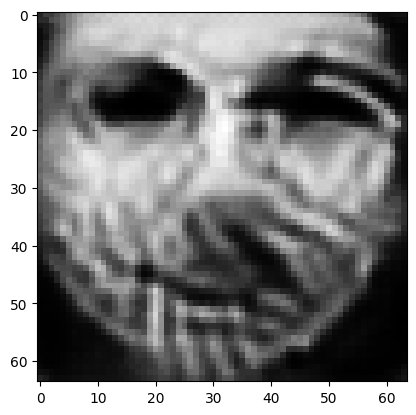

tensor([[2.3893e-05, 1.0460e-04, 4.7180e-04, 8.8616e-05, 5.2073e-06, 6.3767e-04,
         3.8184e-05, 7.1515e-04, 8.2737e-05, 9.9004e-01, 2.7229e-05, 1.2887e-04,
         8.9092e-06, 3.2848e-08, 2.7522e-08, 4.1124e-05, 1.2035e-06, 1.6510e-06,
         1.8950e-05, 8.7416e-04, 6.1173e-07, 3.3360e-05, 6.9548e-10, 8.7970e-08,
         4.8251e-07, 8.6499e-06, 4.8866e-04, 5.8884e-05, 3.7264e-03, 5.3517e-05,
         2.4838e-04, 1.4372e-05, 4.1049e-04, 9.2857e-05, 3.3829e-05, 7.4769e-07,
         8.0642e-07, 1.2074e-04, 1.4429e-04, 1.2520e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0100089805200696
tensor([[2.3827e-05, 1.0416e-04, 4.7009e-04, 8.8324e-05, 5.1883e-06, 6.3448e-04,
         3.8073e-05, 7.1328e-04, 8.2303e-05, 9.9007e-01, 2.7175e-05, 1.2833e-04,
         8.8741e-06, 3.2690e-08, 2.7400e-08, 4.1022e-05, 1.2000e-06, 1.6445e-06,
         1.8881e-05, 8.7168e-04, 6.0861e-07, 3.3265e-05, 6.9152e-10, 8.7779e-08,
         4.8103e-07, 8.6172e-06, 4.8651e-04

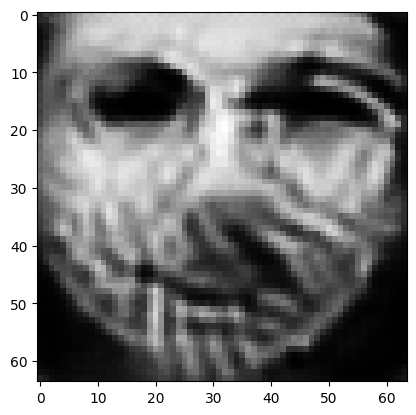

tensor([[2.3594e-05, 1.0272e-04, 4.6377e-04, 8.7366e-05, 5.1215e-06, 6.2265e-04,
         3.7645e-05, 7.0603e-04, 8.0894e-05, 9.9019e-01, 2.6979e-05, 1.2643e-04,
         8.7557e-06, 3.2151e-08, 2.6984e-08, 4.0615e-05, 1.1869e-06, 1.6214e-06,
         1.8635e-05, 8.6275e-04, 5.9782e-07, 3.2925e-05, 6.7812e-10, 8.7037e-08,
         4.7614e-07, 8.5005e-06, 4.7898e-04, 5.7979e-05, 3.6847e-03, 5.2717e-05,
         2.4538e-04, 1.4226e-05, 4.0422e-04, 9.1596e-05, 3.3141e-05, 7.3745e-07,
         7.9341e-07, 1.1907e-04, 1.4196e-04, 1.2216e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009854831732809544
tensor([[2.3542e-05, 1.0241e-04, 4.6230e-04, 8.7170e-05, 5.1063e-06, 6.1989e-04,
         3.7541e-05, 7.0422e-04, 8.0622e-05, 9.9022e-01, 2.6934e-05, 1.2602e-04,
         8.7307e-06, 3.2037e-08, 2.6897e-08, 4.0513e-05, 1.1838e-06, 1.6163e-06,
         1.8579e-05, 8.6078e-04, 5.9552e-07, 3.2847e-05, 6.7524e-10, 8.6850e-08,
         4.7511e-07, 8.4741e-06, 4.7733e-

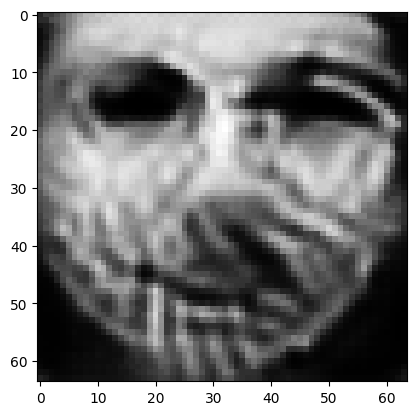

tensor([[2.3343e-05, 1.0124e-04, 4.5665e-04, 8.6430e-05, 5.0481e-06, 6.0934e-04,
         3.7140e-05, 6.9739e-04, 7.9528e-05, 9.9033e-01, 2.6757e-05, 1.2441e-04,
         8.6349e-06, 3.1599e-08, 2.6551e-08, 4.0124e-05, 1.1717e-06, 1.5967e-06,
         1.8364e-05, 8.5287e-04, 5.8649e-07, 3.2543e-05, 6.6414e-10, 8.6148e-08,
         4.7117e-07, 8.3734e-06, 4.7104e-04, 5.7214e-05, 3.6430e-03, 5.2057e-05,
         2.4322e-04, 1.4093e-05, 3.9880e-04, 9.0513e-05, 3.2586e-05, 7.2910e-07,
         7.8239e-07, 1.1773e-04, 1.3997e-04, 1.1959e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009716951288282871
tensor([[2.3296e-05, 1.0095e-04, 4.5530e-04, 8.6250e-05, 5.0342e-06, 6.0682e-04,
         3.7045e-05, 6.9578e-04, 7.9253e-05, 9.9036e-01, 2.6714e-05, 1.2401e-04,
         8.6114e-06, 3.1491e-08, 2.6467e-08, 4.0032e-05, 1.1688e-06, 1.5919e-06,
         1.8313e-05, 8.5093e-04, 5.8427e-07, 3.2470e-05, 6.6143e-10, 8.5984e-08,
         4.7022e-07, 8.3487e-06, 4.6952e-

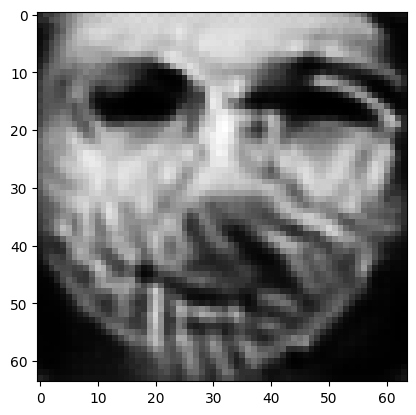

tensor([[2.3121e-05, 9.9900e-05, 4.5016e-04, 8.5601e-05, 4.9818e-06, 5.9731e-04,
         3.6671e-05, 6.8932e-04, 7.8283e-05, 9.9046e-01, 2.6543e-05, 1.2256e-04,
         8.5268e-06, 3.1093e-08, 2.6152e-08, 3.9679e-05, 1.1576e-06, 1.5743e-06,
         1.8121e-05, 8.4362e-04, 5.7608e-07, 3.2187e-05, 6.5145e-10, 8.5326e-08,
         4.6669e-07, 8.2556e-06, 4.6393e-04, 5.6514e-05, 3.6047e-03, 5.1443e-05,
         2.4118e-04, 1.3970e-05, 3.9364e-04, 8.9493e-05, 3.2085e-05, 7.2148e-07,
         7.7232e-07, 1.1652e-04, 1.3814e-04, 1.1724e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009590031579136848
tensor([[2.3078e-05, 9.9623e-05, 4.4895e-04, 8.5422e-05, 4.9690e-06, 5.9509e-04,
         3.6583e-05, 6.8784e-04, 7.8011e-05, 9.9048e-01, 2.6501e-05, 1.2218e-04,
         8.5043e-06, 3.0987e-08, 2.6069e-08, 3.9595e-05, 1.1550e-06, 1.5699e-06,
         1.8071e-05, 8.4182e-04, 5.7397e-07, 3.2118e-05, 6.4881e-10, 8.5165e-08,
         4.6572e-07, 8.2319e-06, 4.6252e-

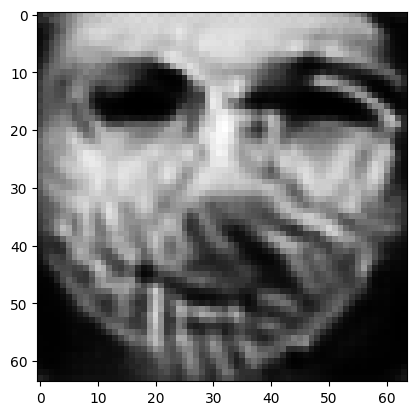

tensor([[2.2914e-05, 9.8582e-05, 4.4429e-04, 8.4742e-05, 4.9202e-06, 5.8667e-04,
         3.6250e-05, 6.8208e-04, 7.7002e-05, 9.9057e-01, 2.6338e-05, 1.2079e-04,
         8.4202e-06, 3.0581e-08, 2.5752e-08, 3.9280e-05, 1.1447e-06, 1.5531e-06,
         1.7882e-05, 8.3494e-04, 5.6601e-07, 3.1851e-05, 6.3896e-10, 8.4540e-08,
         4.6200e-07, 8.1417e-06, 4.5726e-04, 5.5849e-05, 3.5705e-03, 5.0824e-05,
         2.3894e-04, 1.3851e-05, 3.8869e-04, 8.8501e-05, 3.1604e-05, 7.1365e-07,
         7.6277e-07, 1.1531e-04, 1.3639e-04, 1.1509e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009473725222051144
tensor([[2.2873e-05, 9.8332e-05, 4.4319e-04, 8.4578e-05, 4.9085e-06, 5.8466e-04,
         3.6169e-05, 6.8070e-04, 7.6766e-05, 9.9059e-01, 2.6299e-05, 1.2046e-04,
         8.4000e-06, 3.0485e-08, 2.5676e-08, 3.9203e-05, 1.1422e-06, 1.5490e-06,
         1.7837e-05, 8.3325e-04, 5.6412e-07, 3.1786e-05, 6.3662e-10, 8.4387e-08,
         4.6109e-07, 8.1205e-06, 4.5599e-

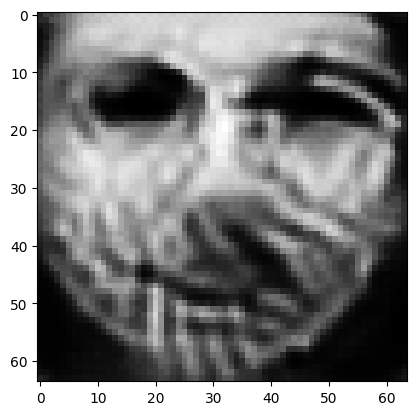

tensor([[2.2712e-05, 9.7318e-05, 4.3884e-04, 8.3893e-05, 4.8627e-06, 5.7683e-04,
         3.5864e-05, 6.7519e-04, 7.5785e-05, 9.9068e-01, 2.6138e-05, 1.1913e-04,
         8.3194e-06, 3.0095e-08, 2.5369e-08, 3.8903e-05, 1.1326e-06, 1.5332e-06,
         1.7654e-05, 8.2673e-04, 5.5652e-07, 3.1525e-05, 6.2721e-10, 8.3775e-08,
         4.5738e-07, 8.0326e-06, 4.5105e-04, 5.5218e-05, 3.5383e-03, 5.0233e-05,
         2.3671e-04, 1.3737e-05, 3.8409e-04, 8.7547e-05, 3.1143e-05, 7.0609e-07,
         7.5366e-07, 1.1413e-04, 1.3476e-04, 1.1311e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009364726021885872
tensor([[2.2673e-05, 9.7072e-05, 4.3783e-04, 8.3729e-05, 4.8520e-06, 5.7497e-04,
         3.5792e-05, 6.7385e-04, 7.5546e-05, 9.9070e-01, 2.6099e-05, 1.1881e-04,
         8.3008e-06, 3.0002e-08, 2.5295e-08, 3.8829e-05, 1.1303e-06, 1.5294e-06,
         1.7608e-05, 8.2510e-04, 5.5468e-07, 3.1462e-05, 6.2496e-10, 8.3630e-08,
         4.5649e-07, 8.0119e-06, 4.4987e-

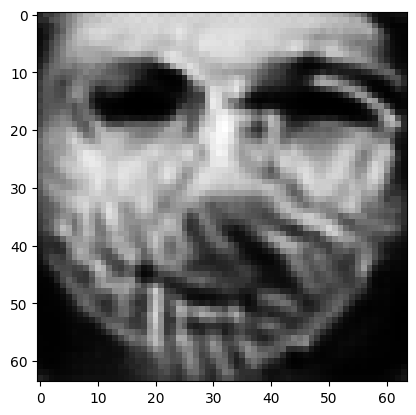

tensor([[2.2523e-05, 9.6149e-05, 4.3383e-04, 8.3091e-05, 4.8111e-06, 5.6782e-04,
         3.5518e-05, 6.6865e-04, 7.4644e-05, 9.9078e-01, 2.5950e-05, 1.1760e-04,
         8.2289e-06, 2.9647e-08, 2.5014e-08, 3.8542e-05, 1.1213e-06, 1.5154e-06,
         1.7432e-05, 8.1924e-04, 5.4775e-07, 3.1219e-05, 6.1639e-10, 8.3058e-08,
         4.5313e-07, 7.9310e-06, 4.4549e-04, 5.4638e-05, 3.5073e-03, 4.9673e-05,
         2.3461e-04, 1.3630e-05, 3.7989e-04, 8.6669e-05, 3.0717e-05, 6.9894e-07,
         7.4538e-07, 1.1304e-04, 1.3330e-04, 1.1132e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009263274259865284
tensor([[2.2486e-05, 9.5925e-05, 4.3287e-04, 8.2934e-05, 4.8013e-06, 5.6611e-04,
         3.5455e-05, 6.6740e-04, 7.4424e-05, 9.9080e-01, 2.5914e-05, 1.1731e-04,
         8.2115e-06, 2.9561e-08, 2.4948e-08, 3.8474e-05, 1.1191e-06, 1.5121e-06,
         1.7389e-05, 8.1786e-04, 5.4609e-07, 3.1161e-05, 6.1435e-10, 8.2922e-08,
         4.5232e-07, 7.9114e-06, 4.4445e-

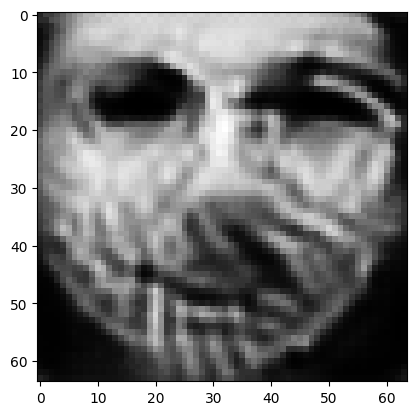

tensor([[2.2346e-05, 9.5077e-05, 4.2914e-04, 8.2339e-05, 4.7634e-06, 5.5952e-04,
         3.5205e-05, 6.6254e-04, 7.3599e-05, 9.9087e-01, 2.5779e-05, 1.1621e-04,
         8.1448e-06, 2.9234e-08, 2.4692e-08, 3.8211e-05, 1.1106e-06, 1.4993e-06,
         1.7228e-05, 8.1257e-04, 5.3977e-07, 3.0935e-05, 6.0647e-10, 8.2383e-08,
         4.4919e-07, 7.8359e-06, 4.4047e-04, 5.4100e-05, 3.4786e-03, 4.9150e-05,
         2.3261e-04, 1.3534e-05, 3.7608e-04, 8.5867e-05, 3.0326e-05, 6.9238e-07,
         7.3767e-07, 1.1202e-04, 1.3193e-04, 1.0967e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00916996318846941
tensor([[2.2313e-05, 9.4885e-05, 4.2824e-04, 8.2203e-05, 4.7545e-06, 5.5795e-04,
         3.5144e-05, 6.6137e-04, 7.3411e-05, 9.9089e-01, 2.5746e-05, 1.1595e-04,
         8.1297e-06, 2.9158e-08, 2.4634e-08, 3.8146e-05, 1.1085e-06, 1.4964e-06,
         1.7190e-05, 8.1140e-04, 5.3831e-07, 3.0880e-05, 6.0463e-10, 8.2251e-08,
         4.4849e-07, 7.8179e-06, 4.3955e-0

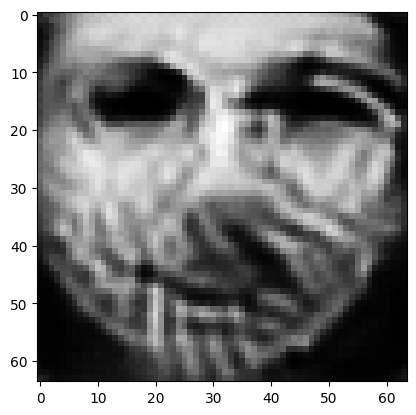

tensor([[2.2185e-05, 9.4171e-05, 4.2481e-04, 8.1704e-05, 4.7209e-06, 5.5201e-04,
         3.4918e-05, 6.5690e-04, 7.2715e-05, 9.9096e-01, 2.5622e-05, 1.1499e-04,
         8.0741e-06, 2.8875e-08, 2.4414e-08, 3.7898e-05, 1.1006e-06, 1.4854e-06,
         1.7046e-05, 8.0689e-04, 5.3279e-07, 3.0669e-05, 5.9777e-10, 8.1749e-08,
         4.4586e-07, 7.7503e-06, 4.3614e-04, 5.3623e-05, 3.4505e-03, 4.8684e-05,
         2.3092e-04, 1.3449e-05, 3.7268e-04, 8.5152e-05, 2.9978e-05, 6.8664e-07,
         7.3073e-07, 1.1114e-04, 1.3071e-04, 1.0822e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009084558114409447
tensor([[2.2155e-05, 9.4000e-05, 4.2398e-04, 8.1584e-05, 4.7129e-06, 5.5059e-04,
         3.4863e-05, 6.5584e-04, 7.2550e-05, 9.9097e-01, 2.5592e-05, 1.1476e-04,
         8.0607e-06, 2.8807e-08, 2.4361e-08, 3.7839e-05, 1.0987e-06, 1.4827e-06,
         1.7012e-05, 8.0584e-04, 5.3148e-07, 3.0618e-05, 5.9613e-10, 8.1629e-08,
         4.4522e-07, 7.7341e-06, 4.3531e-

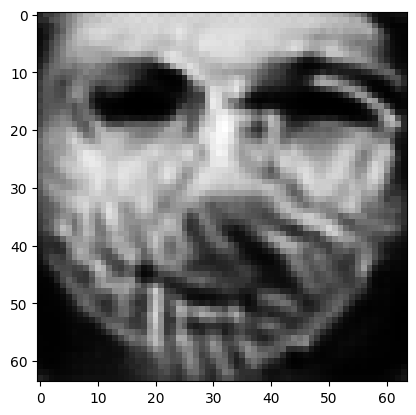

tensor([[2.2039e-05, 9.3341e-05, 4.2084e-04, 8.1124e-05, 4.6821e-06, 5.4519e-04,
         3.4652e-05, 6.5175e-04, 7.1912e-05, 9.9103e-01, 2.5477e-05, 1.1389e-04,
         8.0095e-06, 2.8547e-08, 2.4157e-08, 3.7609e-05, 1.0915e-06, 1.4725e-06,
         1.6878e-05, 8.0171e-04, 5.2643e-07, 3.0424e-05, 5.8982e-10, 8.1163e-08,
         4.4273e-07, 7.6715e-06, 4.3217e-04, 5.3181e-05, 3.4242e-03, 4.8255e-05,
         2.2937e-04, 1.3370e-05, 3.6953e-04, 8.4488e-05, 2.9661e-05, 6.8130e-07,
         7.2441e-07, 1.1033e-04, 1.2957e-04, 1.0690e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.009005879983305931
tensor([[2.2011e-05, 9.3183e-05, 4.2010e-04, 8.1016e-05, 4.6748e-06, 5.4390e-04,
         3.4602e-05, 6.5074e-04, 7.1763e-05, 9.9105e-01, 2.5449e-05, 1.1368e-04,
         7.9976e-06, 2.8486e-08, 2.4109e-08, 3.7554e-05, 1.0898e-06, 1.4701e-06,
         1.6846e-05, 8.0072e-04, 5.2525e-07, 3.0378e-05, 5.8836e-10, 8.1055e-08,
         4.4215e-07, 7.6568e-06, 4.3142e-

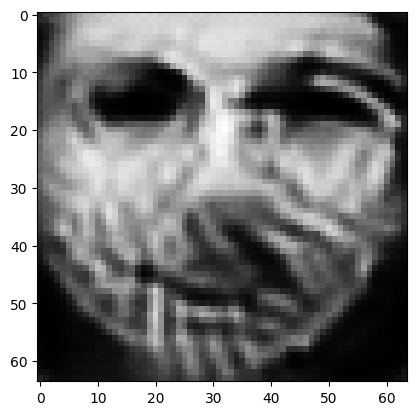

tensor([[2.1906e-05, 9.2595e-05, 4.1725e-04, 8.0624e-05, 4.6468e-06, 5.3908e-04,
         3.4404e-05, 6.4683e-04, 7.1228e-05, 9.9111e-01, 2.5340e-05, 1.1291e-04,
         7.9527e-06, 2.8256e-08, 2.3927e-08, 3.7338e-05, 1.0829e-06, 1.4608e-06,
         1.6722e-05, 7.9690e-04, 5.2077e-07, 3.0196e-05, 5.8265e-10, 8.0597e-08,
         4.3990e-07, 7.6002e-06, 4.2864e-04, 5.2779e-05, 3.3994e-03, 4.7867e-05,
         2.2800e-04, 1.3293e-05, 3.6659e-04, 8.3882e-05, 2.9385e-05, 6.7636e-07,
         7.1873e-07, 1.0959e-04, 1.2852e-04, 1.0574e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008933693170547485
tensor([[2.1881e-05, 9.2467e-05, 4.1656e-04, 8.0539e-05, 4.6402e-06, 5.3797e-04,
         3.4357e-05, 6.4584e-04, 7.1126e-05, 9.9112e-01, 2.5313e-05, 1.1274e-04,
         7.9426e-06, 2.8204e-08, 2.3886e-08, 3.7282e-05, 1.0811e-06, 1.4587e-06,
         1.6692e-05, 7.9605e-04, 5.1976e-07, 3.0150e-05, 5.8134e-10, 8.0469e-08,
         4.3936e-07, 7.5867e-06, 4.2805e-

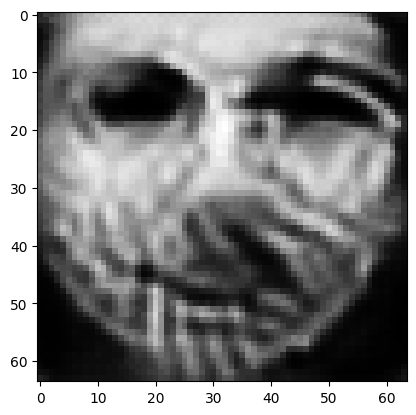

tensor([[2.1785e-05, 9.1970e-05, 4.1391e-04, 8.0219e-05, 4.6148e-06, 5.3363e-04,
         3.4176e-05, 6.4199e-04, 7.0721e-05, 9.9117e-01, 2.5211e-05, 1.1208e-04,
         7.9039e-06, 2.8009e-08, 2.3729e-08, 3.7068e-05, 1.0741e-06, 1.4506e-06,
         1.6576e-05, 7.9273e-04, 5.1589e-07, 2.9973e-05, 5.7633e-10, 7.9986e-08,
         4.3737e-07, 7.5353e-06, 4.2574e-04, 5.2416e-05, 3.3751e-03, 4.7523e-05,
         2.2681e-04, 1.3219e-05, 3.6399e-04, 8.3342e-05, 2.9162e-05, 6.7192e-07,
         7.1345e-07, 1.0895e-04, 1.2757e-04, 1.0479e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008868000470101833
tensor([[2.1761e-05, 9.1848e-05, 4.1329e-04, 8.0142e-05, 4.6086e-06, 5.3258e-04,
         3.4129e-05, 6.4107e-04, 7.0622e-05, 9.9118e-01, 2.5186e-05, 1.1192e-04,
         7.8944e-06, 2.7962e-08, 2.3690e-08, 3.7015e-05, 1.0725e-06, 1.4486e-06,
         1.6548e-05, 7.9187e-04, 5.1494e-07, 2.9930e-05, 5.7509e-10, 7.9867e-08,
         4.3687e-07, 7.5231e-06, 4.2516e-

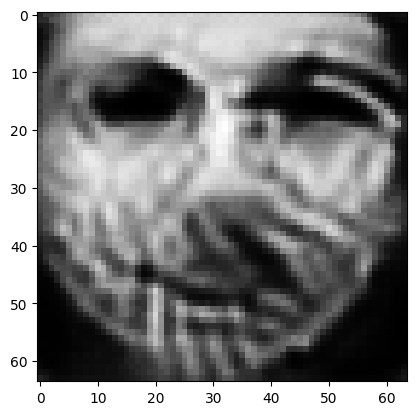

tensor([[2.1671e-05, 9.1404e-05, 4.1092e-04, 7.9864e-05, 4.5853e-06, 5.2859e-04,
         3.3958e-05, 6.3754e-04, 7.0252e-05, 9.9123e-01, 2.5094e-05, 1.1131e-04,
         7.8599e-06, 2.7789e-08, 2.3544e-08, 3.6808e-05, 1.0662e-06, 1.4413e-06,
         1.6439e-05, 7.8881e-04, 5.1135e-07, 2.9764e-05, 5.7053e-10, 7.9420e-08,
         4.3509e-07, 7.4763e-06, 4.2306e-04, 5.2095e-05, 3.3521e-03, 4.7203e-05,
         2.2574e-04, 1.3148e-05, 3.6148e-04, 8.2849e-05, 2.8956e-05, 6.6771e-07,
         7.0869e-07, 1.0837e-04, 1.2669e-04, 1.0389e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008806556463241577
tensor([[2.1649e-05, 9.1300e-05, 4.1035e-04, 7.9800e-05, 4.5798e-06, 5.2762e-04,
         3.3918e-05, 6.3668e-04, 7.0163e-05, 9.9124e-01, 2.5071e-05, 1.1116e-04,
         7.8520e-06, 2.7748e-08, 2.3510e-08, 3.6758e-05, 1.0648e-06, 1.4395e-06,
         1.6413e-05, 7.8811e-04, 5.1050e-07, 2.9723e-05, 5.6946e-10, 7.9314e-08,
         4.3468e-07, 7.4649e-06, 4.2257e-

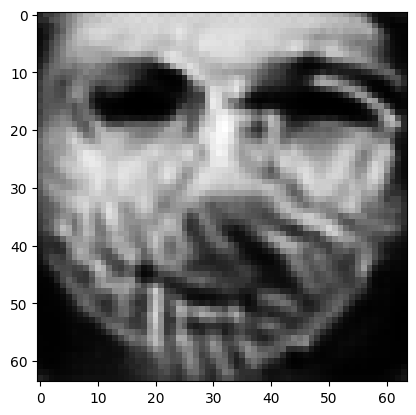

tensor([[2.1563e-05, 9.0872e-05, 4.0824e-04, 7.9522e-05, 4.5576e-06, 5.2412e-04,
         3.3755e-05, 6.3345e-04, 6.9835e-05, 9.9129e-01, 2.4981e-05, 1.1062e-04,
         7.8188e-06, 2.7581e-08, 2.3372e-08, 3.6569e-05, 1.0588e-06, 1.4324e-06,
         1.6308e-05, 7.8514e-04, 5.0720e-07, 2.9571e-05, 5.6506e-10, 7.8869e-08,
         4.3271e-07, 7.4215e-06, 4.2060e-04, 5.1784e-05, 3.3303e-03, 4.6903e-05,
         2.2473e-04, 1.3078e-05, 3.5911e-04, 8.2392e-05, 2.8766e-05, 6.6347e-07,
         7.0419e-07, 1.0780e-04, 1.2587e-04, 1.0312e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008750072680413723
tensor([[2.1544e-05, 9.0749e-05, 4.0778e-04, 7.9450e-05, 4.5519e-06, 5.2335e-04,
         3.3711e-05, 6.3281e-04, 6.9731e-05, 9.9130e-01, 2.4960e-05, 1.1047e-04,
         7.8088e-06, 2.7534e-08, 2.3332e-08, 3.6528e-05, 1.0575e-06, 1.4302e-06,
         1.6284e-05, 7.8421e-04, 5.0629e-07, 2.9535e-05, 5.6383e-10, 7.8770e-08,
         4.3219e-07, 7.4112e-06, 4.2003e-

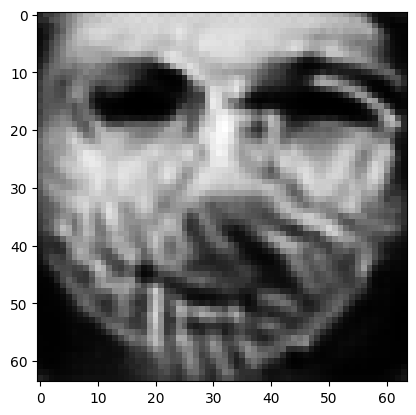

tensor([[2.1464e-05, 9.0276e-05, 4.0594e-04, 7.9159e-05, 4.5296e-06, 5.2027e-04,
         3.3545e-05, 6.3017e-04, 6.9336e-05, 9.9134e-01, 2.4878e-05, 1.0989e-04,
         7.7704e-06, 2.7350e-08, 2.3179e-08, 3.6365e-05, 1.0523e-06, 1.4224e-06,
         1.6187e-05, 7.8080e-04, 5.0279e-07, 2.9390e-05, 5.5916e-10, 7.8367e-08,
         4.3013e-07, 7.3698e-06, 4.1789e-04, 5.1477e-05, 3.3126e-03, 4.6594e-05,
         2.2363e-04, 1.3006e-05, 3.5654e-04, 8.1890e-05, 2.8571e-05, 6.5886e-07,
         6.9988e-07, 1.0725e-04, 1.2495e-04, 1.0232e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00869748555123806
tensor([[2.1445e-05, 9.0158e-05, 4.0551e-04, 7.9091e-05, 4.5242e-06, 5.1954e-04,
         3.3504e-05, 6.2956e-04, 6.9235e-05, 9.9135e-01, 2.4858e-05, 1.0974e-04,
         7.7610e-06, 2.7305e-08, 2.3140e-08, 3.6326e-05, 1.0512e-06, 1.4204e-06,
         1.6163e-05, 7.7992e-04, 5.0191e-07, 2.9355e-05, 5.5801e-10, 7.8273e-08,
         4.2963e-07, 7.3600e-06, 4.1735e-0

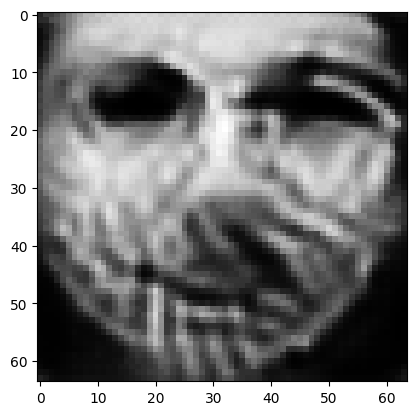

tensor([[2.1369e-05, 8.9718e-05, 4.0375e-04, 7.8821e-05, 4.5031e-06, 5.1660e-04,
         3.3349e-05, 6.2703e-04, 6.8869e-05, 9.9139e-01, 2.4780e-05, 1.0919e-04,
         7.7254e-06, 2.7135e-08, 2.2998e-08, 3.6172e-05, 1.0463e-06, 1.4130e-06,
         1.6074e-05, 7.7679e-04, 4.9866e-07, 2.9218e-05, 5.5369e-10, 7.7896e-08,
         4.2775e-07, 7.3211e-06, 4.1535e-04, 5.1187e-05, 3.2960e-03, 4.6306e-05,
         2.2260e-04, 1.2939e-05, 3.5416e-04, 8.1422e-05, 2.8389e-05, 6.5460e-07,
         6.9580e-07, 1.0674e-04, 1.2410e-04, 1.0157e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008648322895169258
tensor([[2.1349e-05, 8.9625e-05, 4.0328e-04, 7.8754e-05, 4.4981e-06, 5.1582e-04,
         3.3313e-05, 6.2631e-04, 6.8796e-05, 9.9140e-01, 2.4762e-05, 1.0908e-04,
         7.7176e-06, 2.7098e-08, 2.2969e-08, 3.6133e-05, 1.0450e-06, 1.4114e-06,
         1.6053e-05, 7.7619e-04, 4.9796e-07, 2.9187e-05, 5.5273e-10, 7.7797e-08,
         4.2729e-07, 7.3114e-06, 4.1491e-

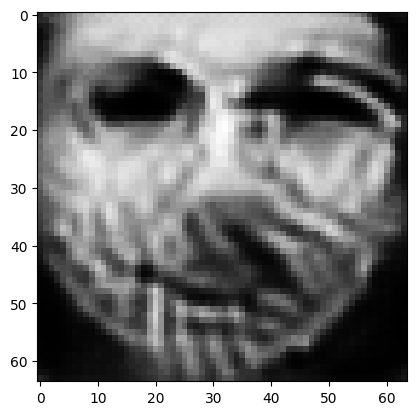

tensor([[2.1276e-05, 8.9208e-05, 4.0158e-04, 7.8484e-05, 4.4781e-06, 5.1298e-04,
         3.3168e-05, 6.2388e-04, 6.8440e-05, 9.9143e-01, 2.4689e-05, 1.0856e-04,
         7.6832e-06, 2.6935e-08, 2.2836e-08, 3.5989e-05, 1.0405e-06, 1.4044e-06,
         1.5969e-05, 7.7330e-04, 4.9488e-07, 2.9061e-05, 5.4862e-10, 7.7443e-08,
         4.2547e-07, 7.2741e-06, 4.1299e-04, 5.0908e-05, 3.2801e-03, 4.6045e-05,
         2.2163e-04, 1.2878e-05, 3.5206e-04, 8.1007e-05, 2.8215e-05, 6.5065e-07,
         6.9184e-07, 1.0624e-04, 1.2331e-04, 1.0088e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008601993322372437
tensor([[2.1259e-05, 8.9103e-05, 4.0117e-04, 7.8417e-05, 4.4731e-06, 5.1231e-04,
         3.3132e-05, 6.2332e-04, 6.8347e-05, 9.9144e-01, 2.4671e-05, 1.0843e-04,
         7.6743e-06, 2.6894e-08, 2.2802e-08, 3.5955e-05, 1.0394e-06, 1.4027e-06,
         1.5949e-05, 7.7256e-04, 4.9410e-07, 2.9030e-05, 5.4758e-10, 7.7359e-08,
         4.2502e-07, 7.2649e-06, 4.1250e-

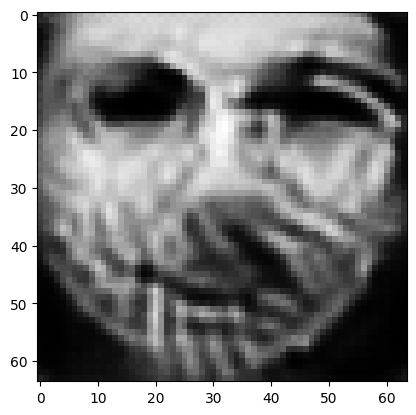

tensor([[2.1192e-05, 8.8709e-05, 3.9958e-04, 7.8176e-05, 4.4541e-06, 5.0965e-04,
         3.2991e-05, 6.2111e-04, 6.8019e-05, 9.9148e-01, 2.4602e-05, 1.0792e-04,
         7.6421e-06, 2.6742e-08, 2.2676e-08, 3.5820e-05, 1.0352e-06, 1.3960e-06,
         1.5871e-05, 7.6971e-04, 4.9118e-07, 2.8908e-05, 5.4374e-10, 7.7032e-08,
         4.2334e-07, 7.2307e-06, 4.1065e-04, 5.0647e-05, 3.2655e-03, 4.5793e-05,
         2.2072e-04, 1.2817e-05, 3.4994e-04, 8.0590e-05, 2.8048e-05, 6.4687e-07,
         6.8815e-07, 1.0577e-04, 1.2254e-04, 1.0020e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008557789959013462
tensor([[2.1175e-05, 8.8636e-05, 3.9916e-04, 7.8128e-05, 4.4499e-06, 5.0897e-04,
         3.2962e-05, 6.2046e-04, 6.7966e-05, 9.9149e-01, 2.4585e-05, 1.0783e-04,
         7.6363e-06, 2.6714e-08, 2.2653e-08, 3.5784e-05, 1.0340e-06, 1.3947e-06,
         1.5853e-05, 7.6921e-04, 4.9060e-07, 2.8880e-05, 5.4298e-10, 7.6947e-08,
         4.2299e-07, 7.2225e-06, 4.1030e-

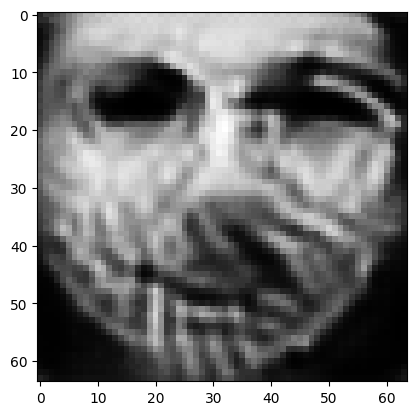

tensor([[2.1113e-05, 8.8284e-05, 3.9764e-04, 7.7918e-05, 4.4323e-06, 5.0645e-04,
         3.2832e-05, 6.1836e-04, 6.7678e-05, 9.9152e-01, 2.4521e-05, 1.0737e-04,
         7.6077e-06, 2.6579e-08, 2.2540e-08, 3.5656e-05, 1.0301e-06, 1.3886e-06,
         1.5781e-05, 7.6660e-04, 4.8793e-07, 2.8767e-05, 5.3955e-10, 7.6647e-08,
         4.2149e-07, 7.1912e-06, 4.0864e-04, 5.0407e-05, 3.2507e-03, 4.5576e-05,
         2.2000e-04, 1.2762e-05, 3.4811e-04, 8.0220e-05, 2.7901e-05, 6.4364e-07,
         6.8481e-07, 1.0536e-04, 1.2187e-04, 9.9587e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008516539819538593
tensor([[2.1098e-05, 8.8199e-05, 3.9727e-04, 7.7868e-05, 4.4281e-06, 5.0584e-04,
         3.2800e-05, 6.1784e-04, 6.7611e-05, 9.9153e-01, 2.4506e-05, 1.0726e-04,
         7.6009e-06, 2.6547e-08, 2.2513e-08, 3.5625e-05, 1.0291e-06, 1.3870e-06,
         1.5764e-05, 7.6596e-04, 4.8729e-07, 2.8740e-05, 5.3873e-10, 7.6572e-08,
         4.2113e-07, 7.1837e-06, 4.0824e-

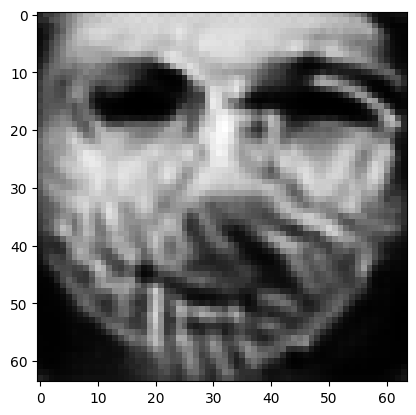

tensor([[2.1040e-05, 8.7883e-05, 3.9582e-04, 7.7676e-05, 4.4119e-06, 5.0346e-04,
         3.2681e-05, 6.1579e-04, 6.7355e-05, 9.9156e-01, 2.4445e-05, 1.0685e-04,
         7.5753e-06, 2.6426e-08, 2.2412e-08, 3.5503e-05, 1.0253e-06, 1.3815e-06,
         1.5696e-05, 7.6366e-04, 4.8486e-07, 2.8634e-05, 5.3562e-10, 7.6286e-08,
         4.1975e-07, 7.1544e-06, 4.0675e-04, 5.0181e-05, 3.2368e-03, 4.5371e-05,
         2.1932e-04, 1.2711e-05, 3.4637e-04, 7.9869e-05, 2.7762e-05, 6.4059e-07,
         6.8166e-07, 1.0497e-04, 1.2123e-04, 9.9011e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008477769792079926
tensor([[2.1026e-05, 8.7802e-05, 3.9547e-04, 7.7629e-05, 4.4078e-06, 5.0288e-04,
         3.2650e-05, 6.1530e-04, 6.7290e-05, 9.9157e-01, 2.4430e-05, 1.0675e-04,
         7.5687e-06, 2.6395e-08, 2.2386e-08, 3.5473e-05, 1.0244e-06, 1.3801e-06,
         1.5680e-05, 7.6306e-04, 4.8426e-07, 2.8608e-05, 5.3484e-10, 7.6216e-08,
         4.1942e-07, 7.1473e-06, 4.0636e-

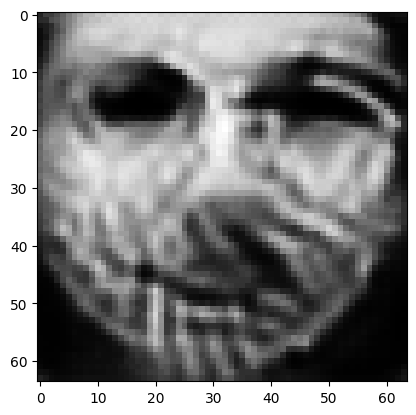

tensor([[2.0970e-05, 8.7491e-05, 3.9412e-04, 7.7448e-05, 4.3923e-06, 5.0063e-04,
         3.2531e-05, 6.1341e-04, 6.7038e-05, 9.9159e-01, 2.4373e-05, 1.0634e-04,
         7.5435e-06, 2.6278e-08, 2.2285e-08, 3.5356e-05, 1.0208e-06, 1.3746e-06,
         1.5615e-05, 7.6071e-04, 4.8191e-07, 2.8507e-05, 5.3184e-10, 7.5948e-08,
         4.1812e-07, 7.1203e-06, 4.0488e-04, 4.9965e-05, 3.2241e-03, 4.5176e-05,
         2.1866e-04, 1.2661e-05, 3.4467e-04, 7.9528e-05, 2.7631e-05, 6.3765e-07,
         6.7868e-07, 1.0461e-04, 1.2061e-04, 9.8451e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008440890349447727
tensor([[2.0957e-05, 8.7417e-05, 3.9380e-04, 7.7405e-05, 4.3886e-06, 5.0010e-04,
         3.2503e-05, 6.1295e-04, 6.6982e-05, 9.9160e-01, 2.4358e-05, 1.0624e-04,
         7.5376e-06, 2.6250e-08, 2.2261e-08, 3.5327e-05, 1.0199e-06, 1.3733e-06,
         1.5599e-05, 7.6015e-04, 4.8135e-07, 2.8483e-05, 5.3113e-10, 7.5882e-08,
         4.1782e-07, 7.1139e-06, 4.0453e-

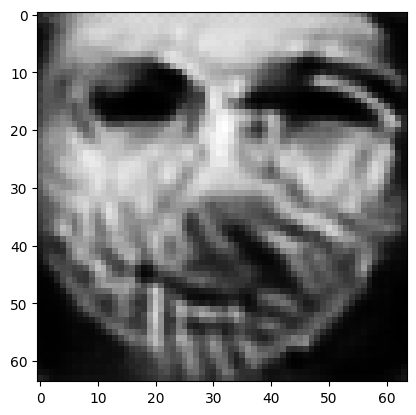

tensor([[2.0905e-05, 8.7142e-05, 3.9253e-04, 7.7242e-05, 4.3745e-06, 4.9802e-04,
         3.2394e-05, 6.1115e-04, 6.6767e-05, 9.9163e-01, 2.4303e-05, 1.0588e-04,
         7.5155e-06, 2.6144e-08, 2.2171e-08, 3.5214e-05, 1.0164e-06, 1.3683e-06,
         1.5538e-05, 7.5806e-04, 4.7923e-07, 2.8389e-05, 5.2841e-10, 7.5622e-08,
         4.1663e-07, 7.0890e-06, 4.0320e-04, 4.9764e-05, 3.2113e-03, 4.4996e-05,
         2.1807e-04, 1.2614e-05, 3.4313e-04, 7.9213e-05, 2.7511e-05, 6.3492e-07,
         6.7587e-07, 1.0427e-04, 1.2007e-04, 9.7951e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008406136184930801
tensor([[2.0892e-05, 8.7071e-05, 3.9224e-04, 7.7202e-05, 4.3711e-06, 4.9753e-04,
         3.2367e-05, 6.1073e-04, 6.6709e-05, 9.9164e-01, 2.4289e-05, 1.0579e-04,
         7.5100e-06, 2.6117e-08, 2.2148e-08, 3.5187e-05, 1.0156e-06, 1.3671e-06,
         1.5522e-05, 7.5752e-04, 4.7869e-07, 2.8366e-05, 5.2774e-10, 7.5563e-08,
         4.1634e-07, 7.0831e-06, 4.0287e-

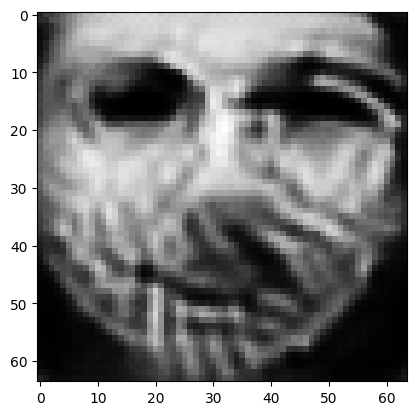

tensor([[2.0843e-05, 8.6796e-05, 3.9107e-04, 7.7042e-05, 4.3575e-06, 4.9558e-04,
         3.2261e-05, 6.0910e-04, 6.6488e-05, 9.9166e-01, 2.4237e-05, 1.0543e-04,
         7.4879e-06, 2.6013e-08, 2.2059e-08, 3.5083e-05, 1.0124e-06, 1.3622e-06,
         1.5464e-05, 7.5540e-04, 4.7662e-07, 2.8277e-05, 5.2510e-10, 7.5325e-08,
         4.1520e-07, 7.0598e-06, 4.0154e-04, 4.9574e-05, 3.1998e-03, 4.4821e-05,
         2.1750e-04, 1.2569e-05, 3.4163e-04, 7.8907e-05, 2.7394e-05, 6.3228e-07,
         6.7324e-07, 1.0395e-04, 1.1954e-04, 9.7461e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008373510092496872
tensor([[2.0831e-05, 8.6743e-05, 3.9076e-04, 7.7007e-05, 4.3544e-06, 4.9507e-04,
         3.2238e-05, 6.0862e-04, 6.6449e-05, 9.9167e-01, 2.4224e-05, 1.0536e-04,
         7.4835e-06, 2.5992e-08, 2.2042e-08, 3.5057e-05, 1.0116e-06, 1.3612e-06,
         1.5450e-05, 7.5502e-04, 4.7620e-07, 2.8256e-05, 5.2454e-10, 7.5261e-08,
         4.1494e-07, 7.0539e-06, 4.0128e-

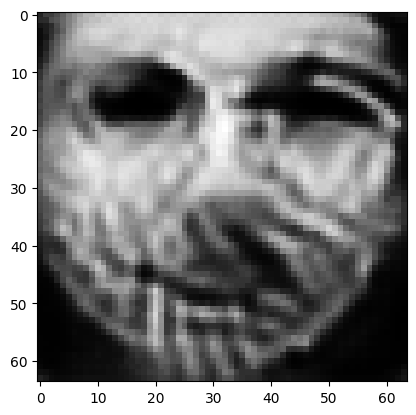

tensor([[2.0786e-05, 8.6487e-05, 3.8966e-04, 7.6860e-05, 4.3418e-06, 4.9325e-04,
         3.2140e-05, 6.0710e-04, 6.6235e-05, 9.9169e-01, 2.4176e-05, 1.0502e-04,
         7.4627e-06, 2.5895e-08, 2.1959e-08, 3.4961e-05, 1.0086e-06, 1.3567e-06,
         1.5396e-05, 7.5304e-04, 4.7425e-07, 2.8173e-05, 5.2209e-10, 7.5045e-08,
         4.1389e-07, 7.0319e-06, 4.0004e-04, 4.9395e-05, 3.1888e-03, 4.4663e-05,
         2.1696e-04, 1.2530e-05, 3.4027e-04, 7.8626e-05, 2.7286e-05, 6.2992e-07,
         6.7078e-07, 1.0366e-04, 1.1905e-04, 9.7008e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008342773653566837
tensor([[2.0775e-05, 8.6426e-05, 3.8939e-04, 7.6825e-05, 4.3387e-06, 4.9281e-04,
         3.2116e-05, 6.0673e-04, 6.6186e-05, 9.9170e-01, 2.4164e-05, 1.0494e-04,
         7.4577e-06, 2.5872e-08, 2.1939e-08, 3.4938e-05, 1.0079e-06, 1.3556e-06,
         1.5383e-05, 7.5257e-04, 4.7378e-07, 2.8153e-05, 5.2150e-10, 7.4993e-08,
         4.1364e-07, 7.0267e-06, 3.9975e-

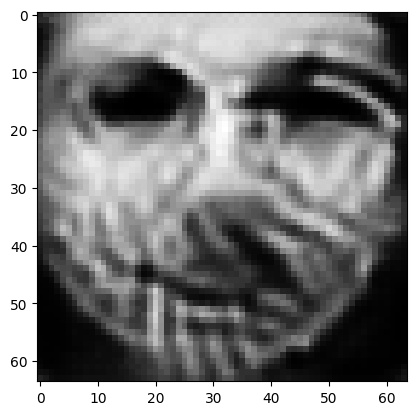

tensor([[2.0732e-05, 8.6196e-05, 3.8833e-04, 7.6692e-05, 4.3271e-06, 4.9107e-04,
         3.2028e-05, 6.0523e-04, 6.5996e-05, 9.9172e-01, 2.4119e-05, 1.0463e-04,
         7.4393e-06, 2.5785e-08, 2.1865e-08, 3.4846e-05, 1.0052e-06, 1.3516e-06,
         1.5333e-05, 7.5086e-04, 4.7201e-07, 2.8076e-05, 5.1928e-10, 7.4788e-08,
         4.1267e-07, 7.0058e-06, 3.9865e-04, 4.9228e-05, 3.1784e-03, 4.4513e-05,
         2.1647e-04, 1.2492e-05, 3.3901e-04, 7.8365e-05, 2.7184e-05, 6.2772e-07,
         6.6851e-07, 1.0338e-04, 1.1860e-04, 9.6581e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008314164355397224
tensor([[2.0722e-05, 8.6138e-05, 3.8808e-04, 7.6657e-05, 4.3242e-06, 4.9066e-04,
         3.2005e-05, 6.0488e-04, 6.5947e-05, 9.9173e-01, 2.4108e-05, 1.0455e-04,
         7.4345e-06, 2.5762e-08, 2.1846e-08, 3.4824e-05, 1.0045e-06, 1.3506e-06,
         1.5321e-05, 7.5041e-04, 4.7156e-07, 2.8057e-05, 5.1872e-10, 7.4738e-08,
         4.1243e-07, 7.0007e-06, 3.9837e-

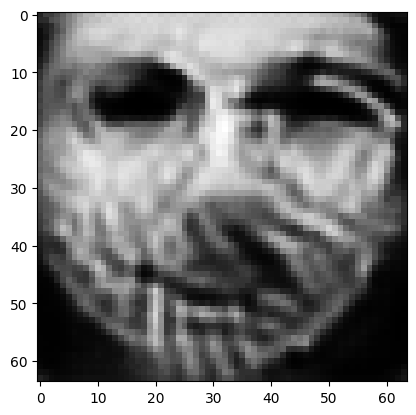

tensor([[2.0682e-05, 8.5909e-05, 3.8712e-04, 7.6525e-05, 4.3131e-06, 4.8904e-04,
         3.1919e-05, 6.0353e-04, 6.5754e-05, 9.9175e-01, 2.4065e-05, 1.0425e-04,
         7.4160e-06, 2.5676e-08, 2.1772e-08, 3.4739e-05, 1.0019e-06, 1.3466e-06,
         1.5273e-05, 7.4867e-04, 4.6983e-07, 2.7985e-05, 5.1655e-10, 7.4549e-08,
         4.1150e-07, 6.9811e-06, 3.9727e-04, 4.9070e-05, 3.1689e-03, 4.4367e-05,
         2.1598e-04, 1.2456e-05, 3.3777e-04, 7.8110e-05, 2.7086e-05, 6.2558e-07,
         6.6636e-07, 1.0312e-04, 1.1816e-04, 9.6168e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008287090808153152
tensor([[2.0671e-05, 8.5864e-05, 3.8686e-04, 7.6496e-05, 4.3106e-06, 4.8862e-04,
         3.1900e-05, 6.0314e-04, 6.5721e-05, 9.9175e-01, 2.4054e-05, 1.0419e-04,
         7.4124e-06, 2.5659e-08, 2.1758e-08, 3.4718e-05, 1.0012e-06, 1.3458e-06,
         1.5262e-05, 7.4836e-04, 4.6947e-07, 2.7968e-05, 5.1609e-10, 7.4499e-08,
         4.1128e-07, 6.9762e-06, 3.9705e-

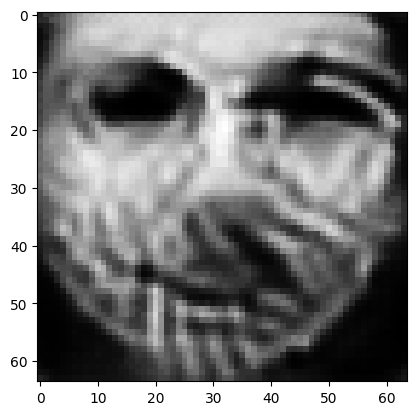

tensor([[2.0634e-05, 8.5646e-05, 3.8595e-04, 7.6369e-05, 4.3000e-06, 4.8710e-04,
         3.1818e-05, 6.0187e-04, 6.5535e-05, 9.9177e-01, 2.4014e-05, 1.0391e-04,
         7.3947e-06, 2.5577e-08, 2.1688e-08, 3.4638e-05, 9.9884e-07, 1.3421e-06,
         1.5217e-05, 7.4671e-04, 4.6783e-07, 2.7900e-05, 5.1401e-10, 7.4321e-08,
         4.1039e-07, 6.9576e-06, 3.9601e-04, 4.8920e-05, 3.1598e-03, 4.4233e-05,
         2.1553e-04, 1.2423e-05, 3.3665e-04, 7.7878e-05, 2.6994e-05, 6.2359e-07,
         6.6434e-07, 1.0287e-04, 1.1776e-04, 9.5788e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008261553943157196
tensor([[2.0626e-05, 8.5592e-05, 3.8573e-04, 7.6339e-05, 4.2975e-06, 4.8674e-04,
         3.1798e-05, 6.0157e-04, 6.5488e-05, 9.9178e-01, 2.4004e-05, 1.0384e-04,
         7.3904e-06, 2.5557e-08, 2.1671e-08, 3.4619e-05, 9.9826e-07, 1.3412e-06,
         1.5206e-05, 7.4632e-04, 4.6743e-07, 2.7884e-05, 5.1350e-10, 7.4279e-08,
         4.1017e-07, 6.9531e-06, 3.9575e-

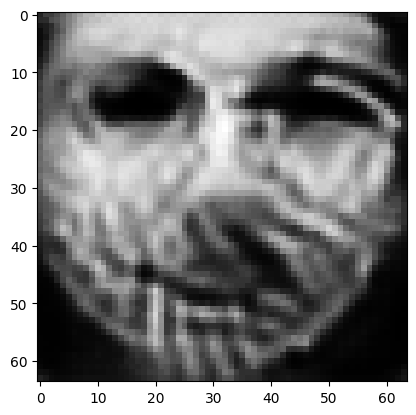

tensor([[2.0590e-05, 8.5396e-05, 3.8485e-04, 7.6224e-05, 4.2878e-06, 4.8529e-04,
         3.1723e-05, 6.0030e-04, 6.5327e-05, 9.9180e-01, 2.3964e-05, 1.0358e-04,
         7.3749e-06, 2.5483e-08, 2.1610e-08, 3.4544e-05, 9.9594e-07, 1.3378e-06,
         1.5164e-05, 7.4487e-04, 4.6596e-07, 2.7820e-05, 5.1164e-10, 7.4108e-08,
         4.0935e-07, 6.9356e-06, 3.9483e-04, 4.8779e-05, 3.1512e-03, 4.4106e-05,
         2.1511e-04, 1.2392e-05, 3.3559e-04, 7.7659e-05, 2.6907e-05, 6.2173e-07,
         6.6247e-07, 1.0264e-04, 1.1739e-04, 9.5433e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00823755282908678
tensor([[2.0582e-05, 8.5345e-05, 3.8464e-04, 7.6195e-05, 4.2854e-06, 4.8494e-04,
         3.1704e-05, 6.0000e-04, 6.5285e-05, 9.9180e-01, 2.3955e-05, 1.0352e-04,
         7.3709e-06, 2.5464e-08, 2.1594e-08, 3.4526e-05, 9.9538e-07, 1.3369e-06,
         1.5153e-05, 7.4450e-04, 4.6558e-07, 2.7804e-05, 5.1117e-10, 7.4067e-08,
         4.0915e-07, 6.9314e-06, 3.9459e-0

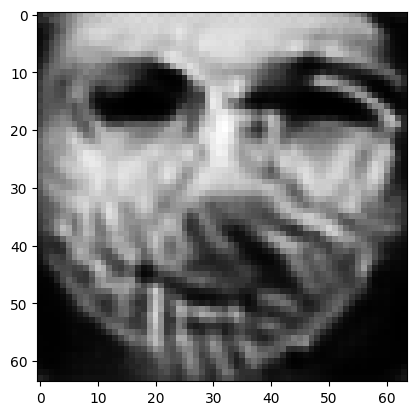

tensor([[2.0549e-05, 8.5149e-05, 3.8382e-04, 7.6085e-05, 4.2762e-06, 4.8359e-04,
         3.1631e-05, 5.9886e-04, 6.5123e-05, 9.9182e-01, 2.3917e-05, 1.0326e-04,
         7.3555e-06, 2.5391e-08, 2.1533e-08, 3.4456e-05, 9.9325e-07, 1.3336e-06,
         1.5113e-05, 7.4305e-04, 4.6414e-07, 2.7743e-05, 5.0937e-10, 7.3909e-08,
         4.0836e-07, 6.9152e-06, 3.9368e-04, 4.8646e-05, 3.1433e-03, 4.3982e-05,
         2.1470e-04, 1.2362e-05, 3.3457e-04, 7.7443e-05, 2.6823e-05, 6.1994e-07,
         6.6071e-07, 1.0242e-04, 1.1703e-04, 9.5093e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008214851841330528
tensor([[2.0541e-05, 8.5102e-05, 3.8362e-04, 7.6057e-05, 4.2740e-06, 4.8326e-04,
         3.1614e-05, 5.9858e-04, 6.5083e-05, 9.9182e-01, 2.3908e-05, 1.0320e-04,
         7.3516e-06, 2.5373e-08, 2.1518e-08, 3.4439e-05, 9.9271e-07, 1.3328e-06,
         1.5103e-05, 7.4269e-04, 4.6379e-07, 2.7728e-05, 5.0892e-10, 7.3869e-08,
         4.0816e-07, 6.9111e-06, 3.9346e-

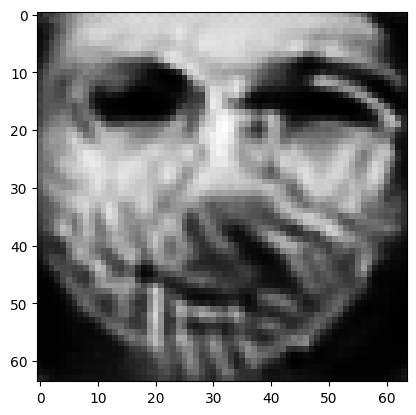

tensor([[2.0510e-05, 8.4926e-05, 3.8284e-04, 7.5957e-05, 4.2654e-06, 4.8196e-04,
         3.1546e-05, 5.9744e-04, 6.4940e-05, 9.9184e-01, 2.3873e-05, 1.0298e-04,
         7.3379e-06, 2.5308e-08, 2.1463e-08, 3.4371e-05, 9.9065e-07, 1.3298e-06,
         1.5066e-05, 7.4140e-04, 4.6247e-07, 2.7671e-05, 5.0728e-10, 7.3717e-08,
         4.0743e-07, 6.8956e-06, 3.9263e-04, 4.8520e-05, 3.1356e-03, 4.3867e-05,
         2.1432e-04, 1.2334e-05, 3.3363e-04, 7.7244e-05, 2.6746e-05, 6.1829e-07,
         6.5904e-07, 1.0221e-04, 1.1671e-04, 9.4781e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00819357018917799
tensor([[2.0503e-05, 8.4880e-05, 3.8265e-04, 7.5931e-05, 4.2633e-06, 4.8166e-04,
         3.1530e-05, 5.9719e-04, 6.4902e-05, 9.9184e-01, 2.3864e-05, 1.0292e-04,
         7.3343e-06, 2.5291e-08, 2.1449e-08, 3.4356e-05, 9.9017e-07, 1.3290e-06,
         1.5056e-05, 7.4106e-04, 4.6213e-07, 2.7657e-05, 5.0686e-10, 7.3681e-08,
         4.0725e-07, 6.8919e-06, 3.9242e-0

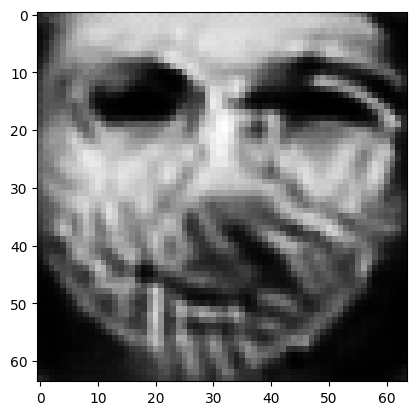

tensor([[2.0473e-05, 8.4713e-05, 3.8191e-04, 7.5834e-05, 4.2551e-06, 4.8043e-04,
         3.1466e-05, 5.9611e-04, 6.4767e-05, 9.9186e-01, 2.3830e-05, 1.0270e-04,
         7.3212e-06, 2.5229e-08, 2.1397e-08, 3.4292e-05, 9.8820e-07, 1.3262e-06,
         1.5021e-05, 7.3984e-04, 4.6089e-07, 2.7602e-05, 5.0530e-10, 7.3536e-08,
         4.0656e-07, 6.8772e-06, 3.9165e-04, 4.8400e-05, 3.1283e-03, 4.3759e-05,
         2.1397e-04, 1.2308e-05, 3.3274e-04, 7.7055e-05, 2.6672e-05, 6.1672e-07,
         6.5746e-07, 1.0202e-04, 1.1639e-04, 9.4484e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008173351176083088
tensor([[2.0466e-05, 8.4669e-05, 3.8173e-04, 7.5808e-05, 4.2531e-06, 4.8014e-04,
         3.1450e-05, 5.9586e-04, 6.4727e-05, 9.9186e-01, 2.3822e-05, 1.0264e-04,
         7.3176e-06, 2.5212e-08, 2.1383e-08, 3.4277e-05, 9.8774e-07, 1.3254e-06,
         1.5012e-05, 7.3951e-04, 4.6056e-07, 2.7589e-05, 5.0489e-10, 7.3502e-08,
         4.0638e-07, 6.8736e-06, 3.9144e-

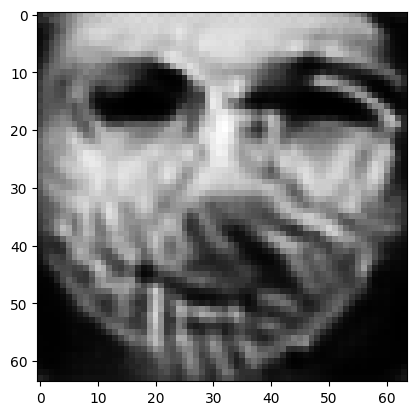

tensor([[2.0438e-05, 8.4499e-05, 3.8103e-04, 7.5710e-05, 4.2452e-06, 4.7899e-04,
         3.1387e-05, 5.9489e-04, 6.4585e-05, 9.9188e-01, 2.3790e-05, 1.0243e-04,
         7.3042e-06, 2.5148e-08, 2.1330e-08, 3.4218e-05, 9.8591e-07, 1.3226e-06,
         1.4978e-05, 7.3827e-04, 4.5932e-07, 2.7537e-05, 5.0334e-10, 7.3367e-08,
         4.0569e-07, 6.8595e-06, 3.9065e-04, 4.8286e-05, 3.1216e-03, 4.3651e-05,
         2.1360e-04, 1.2282e-05, 3.3186e-04, 7.6868e-05, 2.6600e-05, 6.1518e-07,
         6.5594e-07, 1.0183e-04, 1.1609e-04, 9.4191e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008154078386723995
tensor([[2.0431e-05, 8.4458e-05, 3.8087e-04, 7.5688e-05, 4.2433e-06, 4.7871e-04,
         3.1373e-05, 5.9465e-04, 6.4551e-05, 9.9188e-01, 2.3782e-05, 1.0238e-04,
         7.3011e-06, 2.5133e-08, 2.1317e-08, 3.4204e-05, 9.8549e-07, 1.3219e-06,
         1.4969e-05, 7.3797e-04, 4.5902e-07, 2.7525e-05, 5.0298e-10, 7.3335e-08,
         4.0553e-07, 6.8562e-06, 3.9047e-

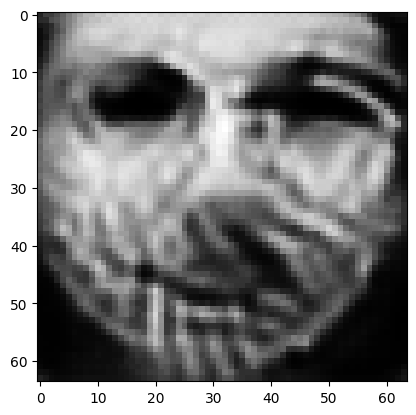

tensor([[2.0405e-05, 8.4307e-05, 3.8020e-04, 7.5600e-05, 4.2361e-06, 4.7761e-04,
         3.1316e-05, 5.9369e-04, 6.4426e-05, 9.9190e-01, 2.3752e-05, 1.0218e-04,
         7.2893e-06, 2.5077e-08, 2.1271e-08, 3.4147e-05, 9.8375e-07, 1.3194e-06,
         1.4938e-05, 7.3689e-04, 4.5790e-07, 2.7475e-05, 5.0159e-10, 7.3207e-08,
         4.0492e-07, 6.8428e-06, 3.8976e-04, 4.8180e-05, 3.1151e-03, 4.3553e-05,
         2.1328e-04, 1.2259e-05, 3.3107e-04, 7.6700e-05, 2.6534e-05, 6.1380e-07,
         6.5454e-07, 1.0165e-04, 1.1581e-04, 9.3923e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00813598744571209
tensor([[2.0398e-05, 8.4270e-05, 3.8004e-04, 7.5579e-05, 4.2343e-06, 4.7734e-04,
         3.1302e-05, 5.9347e-04, 6.4394e-05, 9.9190e-01, 2.3744e-05, 1.0213e-04,
         7.2863e-06, 2.5063e-08, 2.1259e-08, 3.4134e-05, 9.8334e-07, 1.3187e-06,
         1.4930e-05, 7.3662e-04, 4.5762e-07, 2.7463e-05, 5.0125e-10, 7.3177e-08,
         4.0478e-07, 6.8396e-06, 3.8959e-0

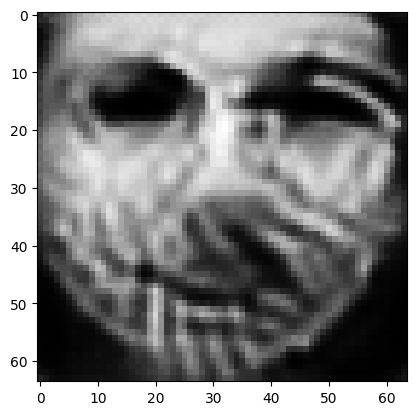

tensor([[2.0374e-05, 8.4125e-05, 3.7940e-04, 7.5496e-05, 4.2275e-06, 4.7630e-04,
         3.1250e-05, 5.9257e-04, 6.4274e-05, 9.9191e-01, 2.3716e-05, 1.0194e-04,
         7.2751e-06, 2.5009e-08, 2.1215e-08, 3.4081e-05, 9.8173e-07, 1.3164e-06,
         1.4900e-05, 7.3561e-04, 4.5655e-07, 2.7416e-05, 4.9994e-10, 7.3059e-08,
         4.0422e-07, 6.8268e-06, 3.8892e-04, 4.8080e-05, 3.1089e-03, 4.3459e-05,
         2.1298e-04, 1.2237e-05, 3.3033e-04, 7.6539e-05, 2.6471e-05, 6.1252e-07,
         6.5322e-07, 1.0148e-04, 1.1555e-04, 9.3664e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008118841797113419
tensor([[2.0368e-05, 8.4088e-05, 3.7925e-04, 7.5476e-05, 4.2257e-06, 4.7605e-04,
         3.1237e-05, 5.9235e-04, 6.4243e-05, 9.9192e-01, 2.3709e-05, 1.0189e-04,
         7.2722e-06, 2.4995e-08, 2.1204e-08, 3.4068e-05, 9.8134e-07, 1.3158e-06,
         1.4893e-05, 7.3535e-04, 4.5628e-07, 2.7405e-05, 4.9962e-10, 7.3030e-08,
         4.0408e-07, 6.8237e-06, 3.8875e-

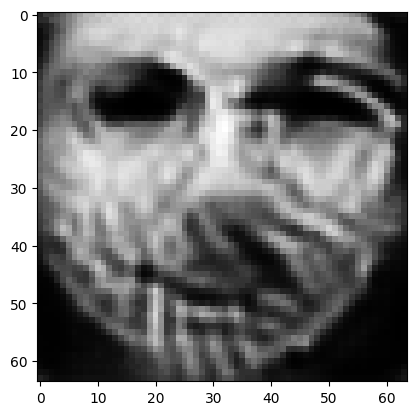

tensor([[2.0345e-05, 8.3952e-05, 3.7865e-04, 7.5397e-05, 4.2193e-06, 4.7507e-04,
         3.1188e-05, 5.9151e-04, 6.4129e-05, 9.9193e-01, 2.3682e-05, 1.0172e-04,
         7.2617e-06, 2.4945e-08, 2.1162e-08, 3.4018e-05, 9.7982e-07, 1.3136e-06,
         1.4865e-05, 7.3440e-04, 4.5527e-07, 2.7360e-05, 4.9839e-10, 7.2919e-08,
         4.0355e-07, 6.8115e-06, 3.8813e-04, 4.7986e-05, 3.1031e-03, 4.3370e-05,
         2.1269e-04, 1.2216e-05, 3.2962e-04, 7.6388e-05, 2.6412e-05, 6.1131e-07,
         6.5197e-07, 1.0132e-04, 1.1529e-04, 9.3419e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008102642372250557
tensor([[2.0339e-05, 8.3917e-05, 3.7851e-04, 7.5378e-05, 4.2178e-06, 4.7483e-04,
         3.1176e-05, 5.9131e-04, 6.4099e-05, 9.9193e-01, 2.3675e-05, 1.0167e-04,
         7.2590e-06, 2.4932e-08, 2.1152e-08, 3.4007e-05, 9.7947e-07, 1.3130e-06,
         1.4859e-05, 7.3416e-04, 4.5501e-07, 2.7349e-05, 4.9808e-10, 7.2893e-08,
         4.0342e-07, 6.8086e-06, 3.8797e-

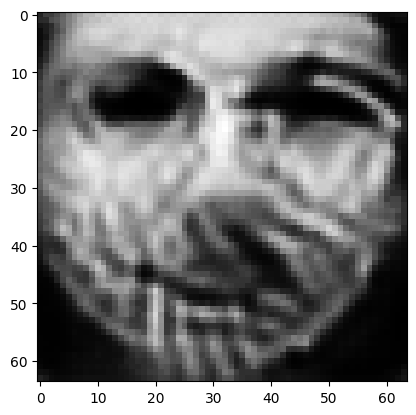

tensor([[2.0317e-05, 8.3788e-05, 3.7793e-04, 7.5303e-05, 4.2116e-06, 4.7390e-04,
         3.1130e-05, 5.9051e-04, 6.3990e-05, 9.9195e-01, 2.3650e-05, 1.0150e-04,
         7.2489e-06, 2.4884e-08, 2.1113e-08, 3.3960e-05, 9.7802e-07, 1.3109e-06,
         1.4833e-05, 7.3327e-04, 4.5405e-07, 2.7307e-05, 4.9692e-10, 7.2787e-08,
         4.0291e-07, 6.7970e-06, 3.8738e-04, 4.7898e-05, 3.0976e-03, 4.3285e-05,
         2.1241e-04, 1.2197e-05, 3.2895e-04, 7.6244e-05, 2.6355e-05, 6.1017e-07,
         6.5078e-07, 1.0117e-04, 1.1506e-04, 9.3187e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008087033405900002
tensor([[2.0311e-05, 8.3752e-05, 3.7779e-04, 7.5281e-05, 4.2101e-06, 4.7366e-04,
         3.1118e-05, 5.9032e-04, 6.3958e-05, 9.9195e-01, 2.3644e-05, 1.0145e-04,
         7.2461e-06, 2.4870e-08, 2.1102e-08, 3.3948e-05, 9.7767e-07, 1.3104e-06,
         1.4826e-05, 7.3303e-04, 4.5379e-07, 2.7297e-05, 4.9661e-10, 7.2760e-08,
         4.0279e-07, 6.7941e-06, 3.8722e-

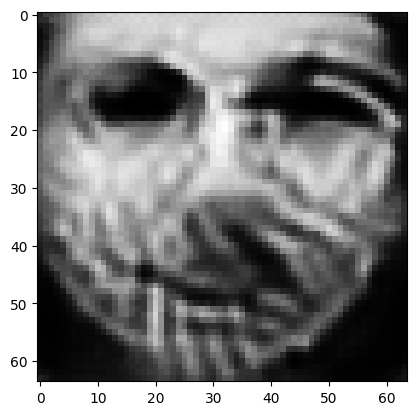

tensor([[2.0289e-05, 8.3621e-05, 3.7722e-04, 7.5202e-05, 4.2043e-06, 4.7273e-04,
         3.1073e-05, 5.8956e-04, 6.3848e-05, 9.9196e-01, 2.3619e-05, 1.0128e-04,
         7.2360e-06, 2.4821e-08, 2.1062e-08, 3.3902e-05, 9.7629e-07, 1.3083e-06,
         1.4800e-05, 7.3219e-04, 4.5283e-07, 2.7255e-05, 4.9547e-10, 7.2657e-08,
         4.0232e-07, 6.7826e-06, 3.8663e-04, 4.7811e-05, 3.0925e-03, 4.3199e-05,
         2.1213e-04, 1.2178e-05, 3.2831e-04, 7.6103e-05, 2.6299e-05, 6.0905e-07,
         6.4959e-07, 1.0103e-04, 1.1483e-04, 9.2951e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008072251453995705
tensor([[2.0284e-05, 8.3587e-05, 3.7708e-04, 7.5182e-05, 4.2028e-06, 4.7250e-04,
         3.1061e-05, 5.8937e-04, 6.3819e-05, 9.9196e-01, 2.3613e-05, 1.0124e-04,
         7.2334e-06, 2.4808e-08, 2.1052e-08, 3.3891e-05, 9.7594e-07, 1.3077e-06,
         1.4793e-05, 7.3196e-04, 4.5258e-07, 2.7245e-05, 4.9518e-10, 7.2631e-08,
         4.0221e-07, 6.7798e-06, 3.8647e-

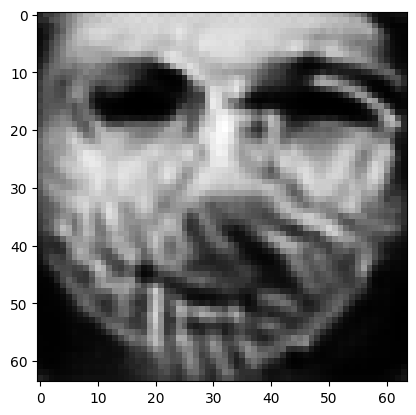

tensor([[2.0263e-05, 8.3460e-05, 3.7653e-04, 7.5105e-05, 4.1973e-06, 4.7162e-04,
         3.1018e-05, 5.8865e-04, 6.3711e-05, 9.9197e-01, 2.3590e-05, 1.0107e-04,
         7.2236e-06, 2.4761e-08, 2.1014e-08, 3.3848e-05, 9.7466e-07, 1.3057e-06,
         1.4769e-05, 7.3113e-04, 4.5166e-07, 2.7205e-05, 4.9409e-10, 7.2534e-08,
         4.0175e-07, 6.7688e-06, 3.8590e-04, 4.7729e-05, 3.0877e-03, 4.3116e-05,
         2.1185e-04, 1.2160e-05, 3.2768e-04, 7.5966e-05, 2.6245e-05, 6.0798e-07,
         6.4845e-07, 1.0089e-04, 1.1460e-04, 9.2725e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008058061823248863
tensor([[2.0258e-05, 8.3427e-05, 3.7641e-04, 7.5085e-05, 4.1960e-06, 4.7141e-04,
         3.1008e-05, 5.8849e-04, 6.3682e-05, 9.9198e-01, 2.3585e-05, 1.0103e-04,
         7.2210e-06, 2.4749e-08, 2.1005e-08, 3.3837e-05, 9.7433e-07, 1.3052e-06,
         1.4762e-05, 7.3091e-04, 4.5142e-07, 2.7196e-05, 4.9380e-10, 7.2510e-08,
         4.0164e-07, 6.7661e-06, 3.8575e-

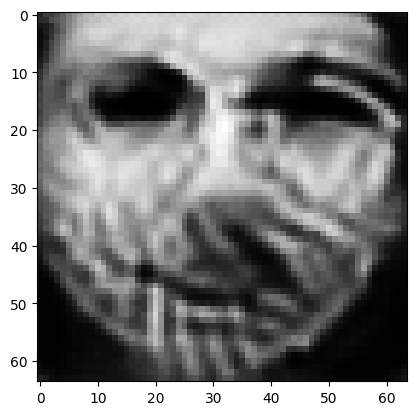

tensor([[2.0237e-05, 8.3308e-05, 3.7589e-04, 7.5012e-05, 4.1907e-06, 4.7056e-04,
         3.0967e-05, 5.8779e-04, 6.3581e-05, 9.9199e-01, 2.3563e-05, 1.0088e-04,
         7.2118e-06, 2.4704e-08, 2.0969e-08, 3.3796e-05, 9.7309e-07, 1.3033e-06,
         1.4739e-05, 7.3013e-04, 4.5055e-07, 2.7159e-05, 4.9277e-10, 7.2416e-08,
         4.0121e-07, 6.7558e-06, 3.8521e-04, 4.7651e-05, 3.0831e-03, 4.3037e-05,
         2.1159e-04, 1.2143e-05, 3.2710e-04, 7.5838e-05, 2.6194e-05, 6.0696e-07,
         6.4737e-07, 1.0075e-04, 1.1439e-04, 9.2511e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008044580928981304
tensor([[2.0233e-05, 8.3277e-05, 3.7576e-04, 7.4993e-05, 4.1894e-06, 4.7035e-04,
         3.0956e-05, 5.8763e-04, 6.3554e-05, 9.9199e-01, 2.3557e-05, 1.0084e-04,
         7.2093e-06, 2.4693e-08, 2.0960e-08, 3.3786e-05, 9.7279e-07, 1.3028e-06,
         1.4733e-05, 7.2992e-04, 4.5033e-07, 2.7150e-05, 4.9250e-10, 7.2394e-08,
         4.0111e-07, 6.7532e-06, 3.8507e-

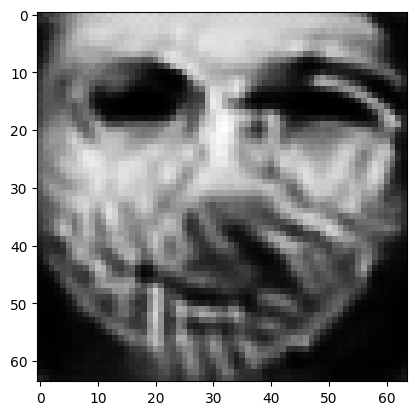

tensor([[2.0214e-05, 8.3164e-05, 3.7527e-04, 7.4924e-05, 4.1845e-06, 4.6956e-04,
         3.0918e-05, 5.8698e-04, 6.3458e-05, 9.9200e-01, 2.3537e-05, 1.0069e-04,
         7.2005e-06, 2.4650e-08, 2.0926e-08, 3.3747e-05, 9.7161e-07, 1.3010e-06,
         1.4711e-05, 7.2918e-04, 4.4950e-07, 2.7114e-05, 4.9152e-10, 7.2305e-08,
         4.0070e-07, 6.7433e-06, 3.8455e-04, 4.7577e-05, 3.0788e-03, 4.2962e-05,
         2.1134e-04, 1.2127e-05, 3.2653e-04, 7.5716e-05, 2.6146e-05, 6.0599e-07,
         6.4634e-07, 1.0062e-04, 1.1419e-04, 9.2308e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008031927980482578
tensor([[2.0209e-05, 8.3134e-05, 3.7516e-04, 7.4906e-05, 4.1833e-06, 4.6938e-04,
         3.0908e-05, 5.8683e-04, 6.3432e-05, 9.9200e-01, 2.3532e-05, 1.0065e-04,
         7.1983e-06, 2.4639e-08, 2.0917e-08, 3.3737e-05, 9.7134e-07, 1.3006e-06,
         1.4705e-05, 7.2899e-04, 4.4929e-07, 2.7106e-05, 4.9127e-10, 7.2284e-08,
         4.0060e-07, 6.7410e-06, 3.8442e-

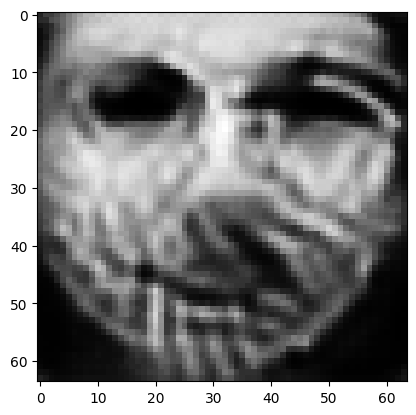

tensor([[2.0191e-05, 8.3027e-05, 3.7469e-04, 7.4841e-05, 4.1786e-06, 4.6862e-04,
         3.0871e-05, 5.8621e-04, 6.3340e-05, 9.9201e-01, 2.3512e-05, 1.0051e-04,
         7.1898e-06, 2.4599e-08, 2.0886e-08, 3.3700e-05, 9.7023e-07, 1.2989e-06,
         1.4684e-05, 7.2828e-04, 4.4851e-07, 2.7072e-05, 4.9033e-10, 7.2201e-08,
         4.0022e-07, 6.7316e-06, 3.8393e-04, 4.7508e-05, 3.0747e-03, 4.2891e-05,
         2.1110e-04, 1.2112e-05, 3.2600e-04, 7.5600e-05, 2.6100e-05, 6.0508e-07,
         6.4538e-07, 1.0050e-04, 1.1400e-04, 9.2114e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.008019747212529182
tensor([[2.0187e-05, 8.3004e-05, 3.7457e-04, 7.4826e-05, 4.1775e-06, 4.6843e-04,
         3.0863e-05, 5.8604e-04, 6.3323e-05, 9.9201e-01, 2.3507e-05, 1.0048e-04,
         7.1881e-06, 2.4591e-08, 2.0879e-08, 3.3691e-05, 9.6993e-07, 1.2985e-06,
         1.4679e-05, 7.2815e-04, 4.4834e-07, 2.7064e-05, 4.9013e-10, 7.2178e-08,
         4.0013e-07, 6.7293e-06, 3.8383e-

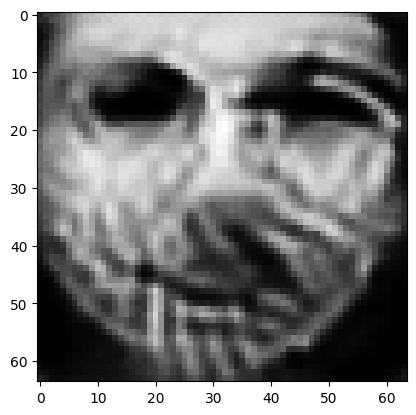

tensor([[2.0170e-05, 8.2903e-05, 3.7413e-04, 7.4764e-05, 4.1730e-06, 4.6771e-04,
         3.0828e-05, 5.8546e-04, 6.3235e-05, 9.9202e-01, 2.3489e-05, 1.0035e-04,
         7.1801e-06, 2.4552e-08, 2.0849e-08, 3.3656e-05, 9.6887e-07, 1.2969e-06,
         1.4659e-05, 7.2748e-04, 4.4759e-07, 2.7032e-05, 4.8924e-10, 7.2100e-08,
         3.9977e-07, 6.7204e-06, 3.8336e-04, 4.7442e-05, 3.0707e-03, 4.2825e-05,
         2.1089e-04, 1.2098e-05, 3.2552e-04, 7.5495e-05, 2.6057e-05, 6.0424e-07,
         6.4447e-07, 1.0039e-04, 1.1383e-04, 9.1936e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00800839439034462
tensor([[2.0166e-05, 8.2876e-05, 3.7402e-04, 7.4748e-05, 4.1719e-06, 4.6754e-04,
         3.0819e-05, 5.8532e-04, 6.3211e-05, 9.9203e-01, 2.3484e-05, 1.0031e-04,
         7.1780e-06, 2.4542e-08, 2.0841e-08, 3.3647e-05, 9.6862e-07, 1.2965e-06,
         1.4654e-05, 7.2730e-04, 4.4740e-07, 2.7024e-05, 4.8901e-10, 7.2080e-08,
         3.9967e-07, 6.7182e-06, 3.8324e-0

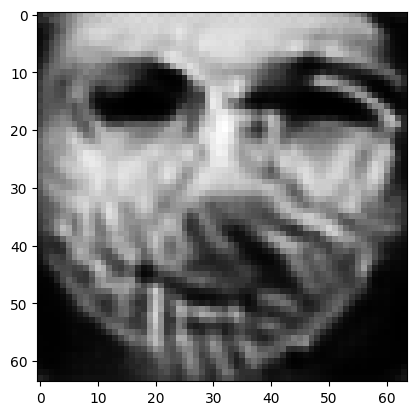

tensor([[2.0150e-05, 8.2781e-05, 3.7361e-04, 7.4690e-05, 4.1677e-06, 4.6687e-04,
         3.0786e-05, 5.8477e-04, 6.3128e-05, 9.9203e-01, 2.3467e-05, 1.0019e-04,
         7.1706e-06, 2.4507e-08, 2.0812e-08, 3.3614e-05, 9.6762e-07, 1.2950e-06,
         1.4635e-05, 7.2667e-04, 4.4670e-07, 2.6995e-05, 4.8818e-10, 7.2006e-08,
         3.9934e-07, 6.7099e-06, 3.8281e-04, 4.7380e-05, 3.0670e-03, 4.2761e-05,
         2.1068e-04, 1.2085e-05, 3.2504e-04, 7.5391e-05, 2.6016e-05, 6.0342e-07,
         6.4361e-07, 1.0028e-04, 1.1366e-04, 9.1761e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007997396402060986
tensor([[2.0146e-05, 8.2756e-05, 3.7350e-04, 7.4676e-05, 4.1667e-06, 4.6670e-04,
         3.0778e-05, 5.8464e-04, 6.3107e-05, 9.9204e-01, 2.3462e-05, 1.0016e-04,
         7.1687e-06, 2.4498e-08, 2.0805e-08, 3.3606e-05, 9.6738e-07, 1.2946e-06,
         1.4631e-05, 7.2650e-04, 4.4652e-07, 2.6987e-05, 4.8797e-10, 7.1988e-08,
         3.9925e-07, 6.7079e-06, 3.8270e-

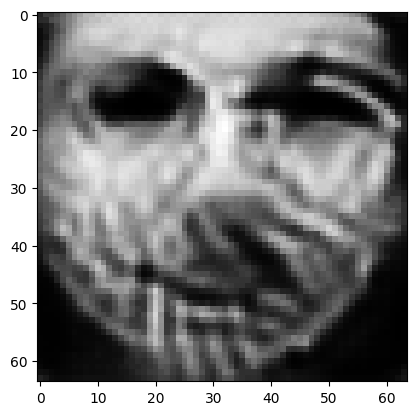

tensor([[2.0130e-05, 8.2667e-05, 3.7311e-04, 7.4622e-05, 4.1628e-06, 4.6607e-04,
         3.0747e-05, 5.8413e-04, 6.3029e-05, 9.9204e-01, 2.3445e-05, 1.0004e-04,
         7.1617e-06, 2.4464e-08, 2.0777e-08, 3.3574e-05, 9.6643e-07, 1.2931e-06,
         1.4613e-05, 7.2589e-04, 4.4586e-07, 2.6959e-05, 4.8719e-10, 7.1917e-08,
         3.9893e-07, 6.7001e-06, 3.8229e-04, 4.7321e-05, 3.0634e-03, 4.2700e-05,
         2.1048e-04, 1.2072e-05, 3.2459e-04, 7.5291e-05, 2.5977e-05, 6.0266e-07,
         6.4280e-07, 1.0018e-04, 1.1350e-04, 9.1597e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007987108081579208
tensor([[2.0127e-05, 8.2643e-05, 3.7301e-04, 7.4608e-05, 4.1618e-06, 4.6591e-04,
         3.0739e-05, 5.8401e-04, 6.3008e-05, 9.9205e-01, 2.3441e-05, 1.0001e-04,
         7.1599e-06, 2.4455e-08, 2.0770e-08, 3.3566e-05, 9.6620e-07, 1.2928e-06,
         1.4608e-05, 7.2573e-04, 4.4569e-07, 2.6952e-05, 4.8699e-10, 7.1900e-08,
         3.9885e-07, 6.6981e-06, 3.8219e-

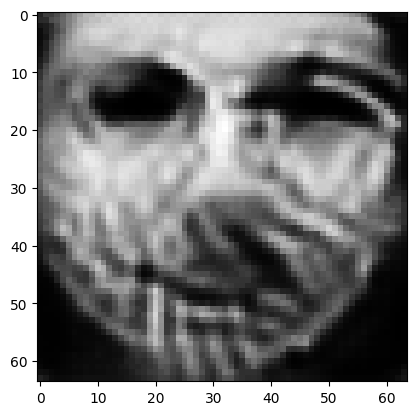

tensor([[2.0113e-05, 8.2557e-05, 3.7264e-04, 7.4557e-05, 4.1581e-06, 4.6532e-04,
         3.0709e-05, 5.8352e-04, 6.2935e-05, 9.9205e-01, 2.3426e-05, 9.9897e-05,
         7.1532e-06, 2.4423e-08, 2.0745e-08, 3.3536e-05, 9.6531e-07, 1.2914e-06,
         1.4591e-05, 7.2516e-04, 4.4506e-07, 2.6925e-05, 4.8625e-10, 7.1833e-08,
         3.9855e-07, 6.6907e-06, 3.8180e-04, 4.7265e-05, 3.0600e-03, 4.2642e-05,
         2.1029e-04, 1.2060e-05, 3.2416e-04, 7.5198e-05, 2.5941e-05, 6.0194e-07,
         6.4204e-07, 1.0009e-04, 1.1334e-04, 9.1442e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007977291941642761
tensor([[2.0109e-05, 8.2540e-05, 3.7254e-04, 7.4546e-05, 4.1572e-06, 4.6516e-04,
         3.0703e-05, 5.8338e-04, 6.2922e-05, 9.9206e-01, 2.3422e-05, 9.9874e-05,
         7.1519e-06, 2.4416e-08, 2.0739e-08, 3.3528e-05, 9.6507e-07, 1.2911e-06,
         1.4587e-05, 7.2506e-04, 4.4493e-07, 2.6918e-05, 4.8609e-10, 7.1816e-08,
         3.9848e-07, 6.6889e-06, 3.8173e-

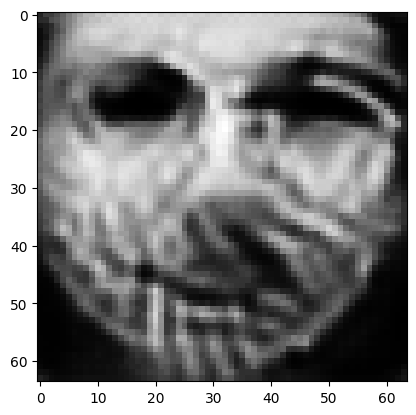

tensor([[2.0095e-05, 8.2459e-05, 3.7218e-04, 7.4497e-05, 4.1537e-06, 4.6460e-04,
         3.0675e-05, 5.8293e-04, 6.2850e-05, 9.9206e-01, 2.3407e-05, 9.9768e-05,
         7.1455e-06, 2.4386e-08, 2.0715e-08, 3.3500e-05, 9.6421e-07, 1.2898e-06,
         1.4571e-05, 7.2450e-04, 4.4432e-07, 2.6893e-05, 4.8538e-10, 7.1752e-08,
         3.9819e-07, 6.6818e-06, 3.8136e-04, 4.7213e-05, 3.0567e-03, 4.2588e-05,
         2.1012e-04, 1.2049e-05, 3.2377e-04, 7.5112e-05, 2.5907e-05, 6.0127e-07,
         6.4131e-07, 9.9996e-05, 1.1320e-04, 9.1298e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007967948913574219
tensor([[2.0092e-05, 8.2438e-05, 3.7210e-04, 7.4484e-05, 4.1528e-06, 4.6446e-04,
         3.0668e-05, 5.8281e-04, 6.2832e-05, 9.9207e-01, 2.3403e-05, 9.9741e-05,
         7.1439e-06, 2.4378e-08, 2.0708e-08, 3.3493e-05, 9.6400e-07, 1.2895e-06,
         1.4567e-05, 7.2436e-04, 4.4417e-07, 2.6886e-05, 4.8519e-10, 7.1736e-08,
         3.9812e-07, 6.6801e-06, 3.8127e-

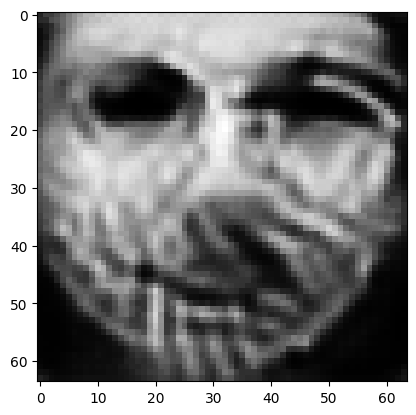

tensor([[2.0079e-05, 8.2361e-05, 3.7176e-04, 7.4438e-05, 4.1494e-06, 4.6393e-04,
         3.0641e-05, 5.8237e-04, 6.2765e-05, 9.9207e-01, 2.3389e-05, 9.9640e-05,
         7.1379e-06, 2.4349e-08, 2.0685e-08, 3.3466e-05, 9.6319e-07, 1.2883e-06,
         1.4551e-05, 7.2384e-04, 4.4360e-07, 2.6862e-05, 4.8452e-10, 7.1675e-08,
         3.9785e-07, 6.6734e-06, 3.8092e-04, 4.7163e-05, 3.0536e-03, 4.2536e-05,
         2.0995e-04, 1.2038e-05, 3.2338e-04, 7.5028e-05, 2.5874e-05, 6.0061e-07,
         6.4063e-07, 9.9909e-05, 1.1306e-04, 9.1159e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007959197275340557
tensor([[2.0076e-05, 8.2345e-05, 3.7167e-04, 7.4428e-05, 4.1486e-06, 4.6379e-04,
         3.0635e-05, 5.8224e-04, 6.2753e-05, 9.9207e-01, 2.3386e-05, 9.9619e-05,
         7.1366e-06, 2.4343e-08, 2.0680e-08, 3.3459e-05, 9.6296e-07, 1.2880e-06,
         1.4548e-05, 7.2374e-04, 4.4348e-07, 2.6856e-05, 4.8438e-10, 7.1658e-08,
         3.9778e-07, 6.6717e-06, 3.8085e-

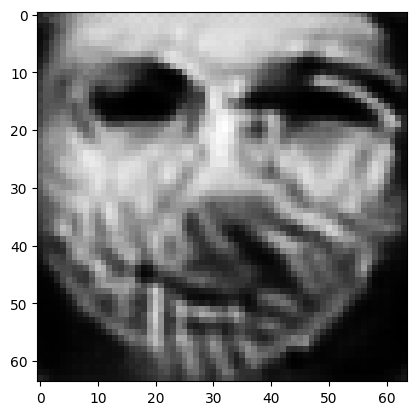

tensor([[2.0063e-05, 8.2273e-05, 3.7135e-04, 7.4384e-05, 4.1454e-06, 4.6327e-04,
         3.0610e-05, 5.8182e-04, 6.2691e-05, 9.9208e-01, 2.3372e-05, 9.9524e-05,
         7.1309e-06, 2.4316e-08, 2.0658e-08, 3.3433e-05, 9.6218e-07, 1.2868e-06,
         1.4533e-05, 7.2324e-04, 4.4295e-07, 2.6833e-05, 4.8375e-10, 7.1600e-08,
         3.9752e-07, 6.6654e-06, 3.8052e-04, 4.7116e-05, 3.0506e-03, 4.2488e-05,
         2.0980e-04, 1.2028e-05, 3.2303e-04, 7.4950e-05, 2.5844e-05, 6.0001e-07,
         6.3997e-07, 9.9827e-05, 1.1293e-04, 9.1031e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007950682193040848
tensor([[2.0061e-05, 8.2254e-05, 3.7127e-04, 7.4374e-05, 4.1446e-06, 4.6315e-04,
         3.0604e-05, 5.8172e-04, 6.2675e-05, 9.9208e-01, 2.3369e-05, 9.9501e-05,
         7.1295e-06, 2.4309e-08, 2.0653e-08, 3.3427e-05, 9.6201e-07, 1.2865e-06,
         1.4530e-05, 7.2312e-04, 4.4281e-07, 2.6828e-05, 4.8359e-10, 7.1587e-08,
         3.9746e-07, 6.6639e-06, 3.8044e-

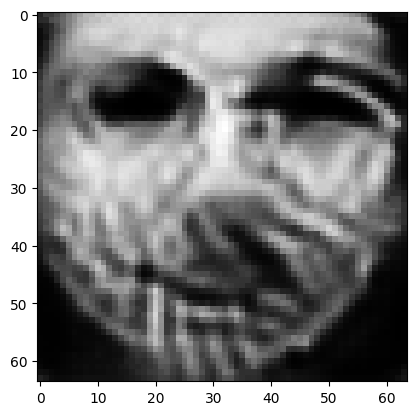

tensor([[2.0049e-05, 8.2186e-05, 3.7097e-04, 7.4332e-05, 4.1416e-06, 4.6267e-04,
         3.0580e-05, 5.8132e-04, 6.2616e-05, 9.9209e-01, 2.3356e-05, 9.9410e-05,
         7.1241e-06, 2.4283e-08, 2.0632e-08, 3.3403e-05, 9.6127e-07, 1.2854e-06,
         1.4516e-05, 7.2265e-04, 4.4231e-07, 2.6806e-05, 4.8299e-10, 7.1531e-08,
         3.9721e-07, 6.6579e-06, 3.8013e-04, 4.7071e-05, 3.0479e-03, 4.2441e-05,
         2.0965e-04, 1.2018e-05, 3.2269e-04, 7.4875e-05, 2.5814e-05, 5.9942e-07,
         6.3936e-07, 9.9751e-05, 1.1280e-04, 9.0906e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00794275850057602
tensor([[2.0046e-05, 8.2168e-05, 3.7090e-04, 7.4322e-05, 4.1408e-06, 4.6255e-04,
         3.0573e-05, 5.8123e-04, 6.2600e-05, 9.9209e-01, 2.3353e-05, 9.9387e-05,
         7.1227e-06, 2.4277e-08, 2.0626e-08, 3.3397e-05, 9.6109e-07, 1.2852e-06,
         1.4512e-05, 7.2253e-04, 4.4218e-07, 2.6800e-05, 4.8283e-10, 7.1518e-08,
         3.9715e-07, 6.6564e-06, 3.8005e-0

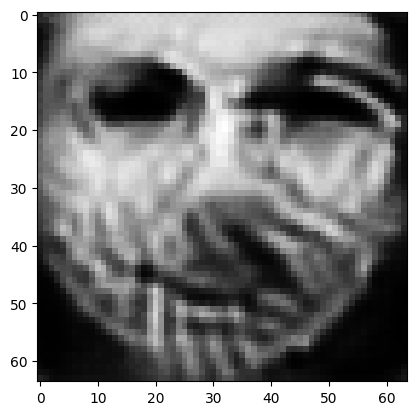

tensor([[2.0035e-05, 8.2102e-05, 3.7061e-04, 7.4283e-05, 4.1379e-06, 4.6209e-04,
         3.0551e-05, 5.8085e-04, 6.2544e-05, 9.9210e-01, 2.3341e-05, 9.9302e-05,
         7.1176e-06, 2.4252e-08, 2.0606e-08, 3.3374e-05, 9.6040e-07, 1.2841e-06,
         1.4499e-05, 7.2209e-04, 4.4169e-07, 2.6779e-05, 4.8227e-10, 7.1466e-08,
         3.9692e-07, 6.6507e-06, 3.7976e-04, 4.7029e-05, 3.0453e-03, 4.2396e-05,
         2.0951e-04, 1.2009e-05, 3.2236e-04, 7.4803e-05, 2.5786e-05, 5.9887e-07,
         6.3878e-07, 9.9678e-05, 1.1268e-04, 9.0786e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007935307919979095
tensor([[2.0032e-05, 8.2088e-05, 3.7053e-04, 7.4274e-05, 4.1373e-06, 4.6197e-04,
         3.0546e-05, 5.8074e-04, 6.2533e-05, 9.9210e-01, 2.3338e-05, 9.9284e-05,
         7.1166e-06, 2.4247e-08, 2.0602e-08, 3.3367e-05, 9.6021e-07, 1.2839e-06,
         1.4496e-05, 7.2200e-04, 4.4159e-07, 2.6774e-05, 4.8214e-10, 7.1452e-08,
         3.9687e-07, 6.6493e-06, 3.7969e-

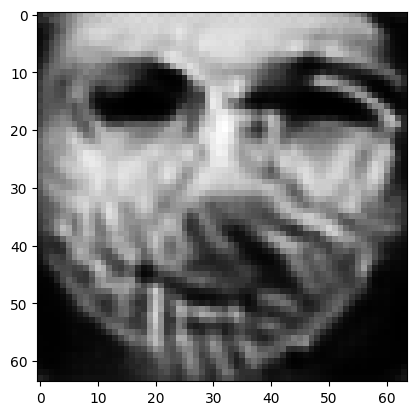

tensor([[2.0021e-05, 8.2025e-05, 3.7026e-04, 7.4236e-05, 4.1345e-06, 4.6153e-04,
         3.0524e-05, 5.8038e-04, 6.2479e-05, 9.9210e-01, 2.3327e-05, 9.9202e-05,
         7.1116e-06, 2.4224e-08, 2.0583e-08, 3.3345e-05, 9.5955e-07, 1.2829e-06,
         1.4483e-05, 7.2158e-04, 4.4113e-07, 2.6755e-05, 4.8160e-10, 7.1402e-08,
         3.9664e-07, 6.6439e-06, 3.7941e-04, 4.6988e-05, 3.0427e-03, 4.2355e-05,
         2.0938e-04, 1.2000e-05, 3.2206e-04, 7.4737e-05, 2.5760e-05, 5.9835e-07,
         6.3823e-07, 9.9609e-05, 1.1257e-04, 9.0675e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007927975617349148
tensor([[2.0019e-05, 8.2008e-05, 3.7020e-04, 7.4226e-05, 4.1338e-06, 4.6142e-04,
         3.0518e-05, 5.8029e-04, 6.2465e-05, 9.9210e-01, 2.3324e-05, 9.9181e-05,
         7.1104e-06, 2.4218e-08, 2.0578e-08, 3.3340e-05, 9.5940e-07, 1.2826e-06,
         1.4480e-05, 7.2147e-04, 4.4101e-07, 2.6750e-05, 4.8146e-10, 7.1391e-08,
         3.9659e-07, 6.6426e-06, 3.7934e-

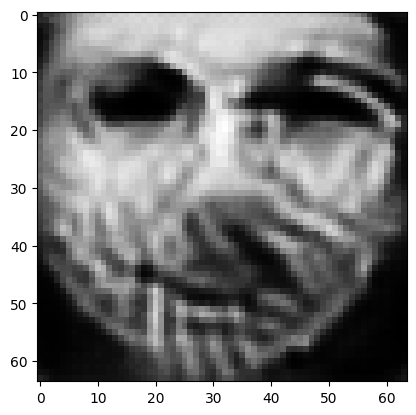

tensor([[2.0009e-05, 8.1948e-05, 3.6994e-04, 7.4191e-05, 4.1312e-06, 4.6101e-04,
         3.0498e-05, 5.7996e-04, 6.2413e-05, 9.9211e-01, 2.3314e-05, 9.9104e-05,
         7.1057e-06, 2.4196e-08, 2.0560e-08, 3.3319e-05, 9.5879e-07, 1.2817e-06,
         1.4468e-05, 7.2107e-04, 4.4057e-07, 2.6731e-05, 4.8095e-10, 7.1344e-08,
         3.9638e-07, 6.6375e-06, 3.7907e-04, 4.6950e-05, 3.0404e-03, 4.2314e-05,
         2.0925e-04, 1.1992e-05, 3.2176e-04, 7.4671e-05, 2.5735e-05, 5.9785e-07,
         6.3771e-07, 9.9543e-05, 1.1247e-04, 9.0566e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007921352051198483
tensor([[2.0006e-05, 8.1933e-05, 3.6988e-04, 7.4181e-05, 4.1306e-06, 4.6091e-04,
         3.0493e-05, 5.7987e-04, 6.2400e-05, 9.9211e-01, 2.3311e-05, 9.9084e-05,
         7.1045e-06, 2.4190e-08, 2.0555e-08, 3.3313e-05, 9.5862e-07, 1.2815e-06,
         1.4465e-05, 7.2096e-04, 4.4046e-07, 2.6726e-05, 4.8082e-10, 7.1332e-08,
         3.9632e-07, 6.6362e-06, 3.7900e-

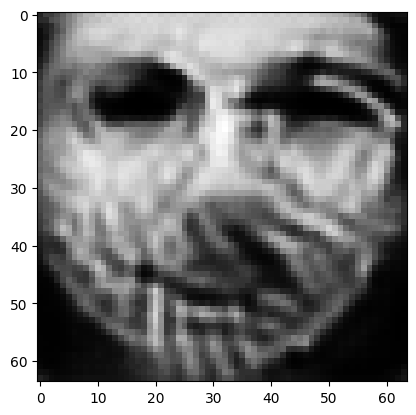

tensor([[1.9996e-05, 8.1876e-05, 3.6963e-04, 7.4147e-05, 4.1281e-06, 4.6051e-04,
         3.0473e-05, 5.7954e-04, 6.2351e-05, 9.9212e-01, 2.3301e-05, 9.9010e-05,
         7.1001e-06, 2.4170e-08, 2.0538e-08, 3.3293e-05, 9.5804e-07, 1.2806e-06,
         1.4454e-05, 7.2058e-04, 4.4005e-07, 2.6708e-05, 4.8033e-10, 7.1287e-08,
         3.9613e-07, 6.6314e-06, 3.7874e-04, 4.6914e-05, 3.0381e-03, 4.2276e-05,
         2.0912e-04, 1.1984e-05, 3.2148e-04, 7.4609e-05, 2.5711e-05, 5.9736e-07,
         6.3721e-07, 9.9480e-05, 1.1236e-04, 9.0464e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007914847694337368
tensor([[1.9994e-05, 8.1864e-05, 3.6957e-04, 7.4140e-05, 4.1275e-06, 4.6041e-04,
         3.0469e-05, 5.7945e-04, 6.2342e-05, 9.9212e-01, 2.3298e-05, 9.8996e-05,
         7.0992e-06, 2.4166e-08, 2.0535e-08, 3.3288e-05, 9.5789e-07, 1.2804e-06,
         1.4451e-05, 7.2051e-04, 4.3996e-07, 2.6704e-05, 4.8022e-10, 7.1276e-08,
         3.9608e-07, 6.6302e-06, 3.7869e-

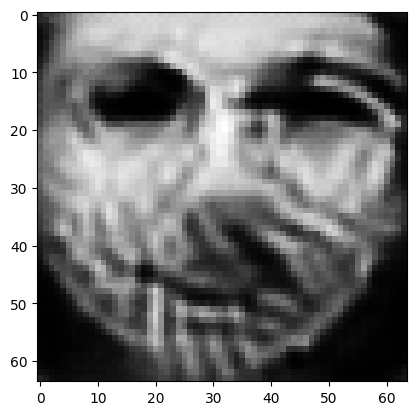

tensor([[1.9985e-05, 8.1809e-05, 3.6934e-04, 7.4107e-05, 4.1252e-06, 4.6004e-04,
         3.0450e-05, 5.7914e-04, 6.2296e-05, 9.9212e-01, 2.3288e-05, 9.8925e-05,
         7.0950e-06, 2.4146e-08, 2.0518e-08, 3.3269e-05, 9.5733e-07, 1.2795e-06,
         1.4441e-05, 7.2015e-04, 4.3957e-07, 2.6687e-05, 4.7976e-10, 7.1233e-08,
         3.9589e-07, 6.6256e-06, 3.7845e-04, 4.6879e-05, 3.0359e-03, 4.2240e-05,
         2.0901e-04, 1.1977e-05, 3.2122e-04, 7.4553e-05, 2.5688e-05, 5.9692e-07,
         6.3675e-07, 9.9421e-05, 1.1227e-04, 9.0369e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007908697240054607
tensor([[1.9983e-05, 8.1796e-05, 3.6928e-04, 7.4099e-05, 4.1246e-06, 4.5995e-04,
         3.0445e-05, 5.7907e-04, 6.2283e-05, 9.9212e-01, 2.3286e-05, 9.8908e-05,
         7.0939e-06, 2.4140e-08, 2.0514e-08, 3.3265e-05, 9.5719e-07, 1.2793e-06,
         1.4438e-05, 7.2005e-04, 4.3947e-07, 2.6683e-05, 4.7964e-10, 7.1223e-08,
         3.9584e-07, 6.6244e-06, 3.7839e-

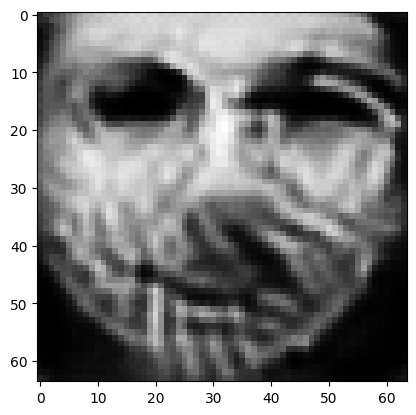

tensor([[1.9974e-05, 8.1744e-05, 3.6906e-04, 7.4068e-05, 4.1224e-06, 4.5960e-04,
         3.0428e-05, 5.7877e-04, 6.2240e-05, 9.9213e-01, 2.3277e-05, 9.8842e-05,
         7.0900e-06, 2.4122e-08, 2.0499e-08, 3.3246e-05, 9.5666e-07, 1.2785e-06,
         1.4428e-05, 7.1971e-04, 4.3910e-07, 2.6667e-05, 4.7920e-10, 7.1183e-08,
         3.9566e-07, 6.6201e-06, 3.7816e-04, 4.6847e-05, 3.0339e-03, 4.2205e-05,
         2.0890e-04, 1.1970e-05, 3.2097e-04, 7.4497e-05, 2.5667e-05, 5.9648e-07,
         6.3630e-07, 9.9364e-05, 1.1218e-04, 9.0278e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007903020828962326
tensor([[1.9972e-05, 8.1731e-05, 3.6901e-04, 7.4061e-05, 4.1218e-06, 4.5951e-04,
         3.0424e-05, 5.7871e-04, 6.2229e-05, 9.9213e-01, 2.3274e-05, 9.8826e-05,
         7.0890e-06, 2.4117e-08, 2.0495e-08, 3.3242e-05, 9.5654e-07, 1.2783e-06,
         1.4425e-05, 7.1962e-04, 4.3901e-07, 2.6663e-05, 4.7909e-10, 7.1173e-08,
         3.9562e-07, 6.6190e-06, 3.7810e-

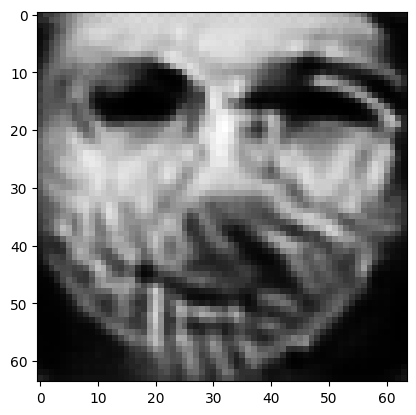

tensor([[1.9964e-05, 8.1683e-05, 3.6880e-04, 7.4032e-05, 4.1197e-06, 4.5917e-04,
         3.0407e-05, 5.7843e-04, 6.2188e-05, 9.9213e-01, 2.3266e-05, 9.8763e-05,
         7.0853e-06, 2.4100e-08, 2.0480e-08, 3.3225e-05, 9.5603e-07, 1.2776e-06,
         1.4416e-05, 7.1930e-04, 4.3866e-07, 2.6648e-05, 4.7868e-10, 7.1135e-08,
         3.9545e-07, 6.6149e-06, 3.7788e-04, 4.6816e-05, 3.0320e-03, 4.2173e-05,
         2.0880e-04, 1.1963e-05, 3.2073e-04, 7.4445e-05, 2.5646e-05, 5.9607e-07,
         6.3588e-07, 9.9310e-05, 1.1209e-04, 9.0190e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007897461764514446
tensor([[1.9962e-05, 8.1673e-05, 3.6875e-04, 7.4025e-05, 4.1192e-06, 4.5909e-04,
         3.0403e-05, 5.7835e-04, 6.2180e-05, 9.9213e-01, 2.3263e-05, 9.8750e-05,
         7.0845e-06, 2.4096e-08, 2.0477e-08, 3.3220e-05, 9.5590e-07, 1.2774e-06,
         1.4413e-05, 7.1924e-04, 4.3858e-07, 2.6644e-05, 4.7859e-10, 7.1125e-08,
         3.9541e-07, 6.6139e-06, 3.7783e-

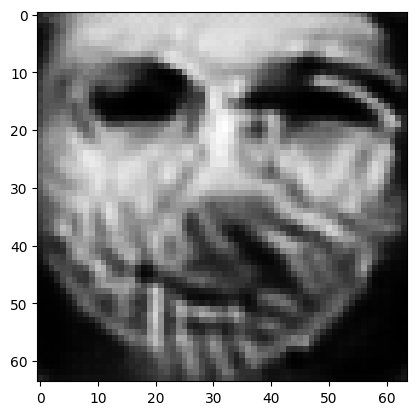

tensor([[1.9954e-05, 8.1626e-05, 3.6855e-04, 7.3997e-05, 4.1172e-06, 4.5876e-04,
         3.0387e-05, 5.7808e-04, 6.2141e-05, 9.9214e-01, 2.3255e-05, 9.8691e-05,
         7.0809e-06, 2.4079e-08, 2.0463e-08, 3.3204e-05, 9.5542e-07, 1.2767e-06,
         1.4404e-05, 7.1892e-04, 4.3824e-07, 2.6630e-05, 4.7819e-10, 7.1088e-08,
         3.9525e-07, 6.6099e-06, 3.7762e-04, 4.6786e-05, 3.0301e-03, 4.2142e-05,
         2.0871e-04, 1.1956e-05, 3.2051e-04, 7.4396e-05, 2.5627e-05, 5.9569e-07,
         6.3548e-07, 9.9259e-05, 1.1201e-04, 9.0109e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007892139256000519
tensor([[1.9952e-05, 8.1615e-05, 3.6850e-04, 7.3991e-05, 4.1167e-06, 4.5869e-04,
         3.0383e-05, 5.7802e-04, 6.2131e-05, 9.9214e-01, 2.3253e-05, 9.8676e-05,
         7.0800e-06, 2.4075e-08, 2.0460e-08, 3.3200e-05, 9.5531e-07, 1.2765e-06,
         1.4402e-05, 7.1885e-04, 4.3816e-07, 2.6627e-05, 4.7810e-10, 7.1080e-08,
         3.9521e-07, 6.6090e-06, 3.7757e-

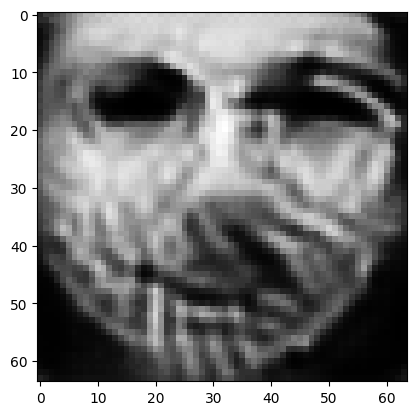

tensor([[1.9944e-05, 8.1570e-05, 3.6831e-04, 7.3964e-05, 4.1148e-06, 4.5838e-04,
         3.0368e-05, 5.7776e-04, 6.2093e-05, 9.9214e-01, 2.3245e-05, 9.8619e-05,
         7.0766e-06, 2.4058e-08, 2.0447e-08, 3.3184e-05, 9.5485e-07, 1.2758e-06,
         1.4393e-05, 7.1855e-04, 4.3784e-07, 2.6613e-05, 4.7771e-10, 7.1045e-08,
         3.9505e-07, 6.6052e-06, 3.7737e-04, 4.6758e-05, 3.0284e-03, 4.2113e-05,
         2.0861e-04, 1.1950e-05, 3.2029e-04, 7.4349e-05, 2.5608e-05, 5.9532e-07,
         6.3510e-07, 9.9210e-05, 1.1193e-04, 9.0030e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007887172512710094
tensor([[1.9943e-05, 8.1559e-05, 3.6827e-04, 7.3958e-05, 4.1143e-06, 4.5830e-04,
         3.0364e-05, 5.7770e-04, 6.2084e-05, 9.9214e-01, 2.3243e-05, 9.8605e-05,
         7.0758e-06, 2.4055e-08, 2.0443e-08, 3.3181e-05, 9.5474e-07, 1.2756e-06,
         1.4391e-05, 7.1847e-04, 4.3776e-07, 2.6610e-05, 4.7762e-10, 7.1037e-08,
         3.9501e-07, 6.6043e-06, 3.7732e-

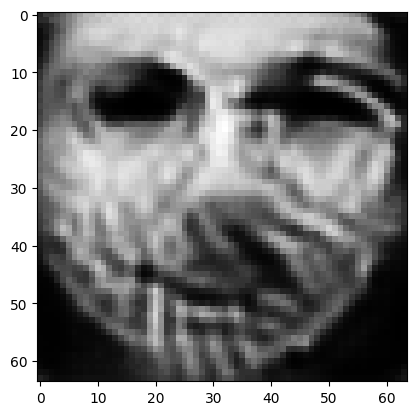

tensor([[1.9935e-05, 8.1519e-05, 3.6808e-04, 7.3933e-05, 4.1125e-06, 4.5801e-04,
         3.0350e-05, 5.7744e-04, 6.2051e-05, 9.9215e-01, 2.3236e-05, 9.8555e-05,
         7.0727e-06, 2.4040e-08, 2.0432e-08, 3.3166e-05, 9.5430e-07, 1.2750e-06,
         1.4383e-05, 7.1821e-04, 4.3748e-07, 2.6597e-05, 4.7728e-10, 7.1003e-08,
         3.9487e-07, 6.6008e-06, 3.7714e-04, 4.6731e-05, 3.0267e-03, 4.2085e-05,
         2.0853e-04, 1.1945e-05, 3.2010e-04, 7.4306e-05, 2.5591e-05, 5.9497e-07,
         6.3474e-07, 9.9164e-05, 1.1186e-04, 8.9958e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007882323116064072
tensor([[1.9934e-05, 8.1508e-05, 3.6804e-04, 7.3926e-05, 4.1121e-06, 4.5794e-04,
         3.0346e-05, 5.7739e-04, 6.2042e-05, 9.9215e-01, 2.3234e-05, 9.8541e-05,
         7.0719e-06, 2.4036e-08, 2.0428e-08, 3.3162e-05, 9.5419e-07, 1.2748e-06,
         1.4381e-05, 7.1814e-04, 4.3740e-07, 2.6594e-05, 4.7719e-10, 7.0995e-08,
         3.9483e-07, 6.5999e-06, 3.7709e-

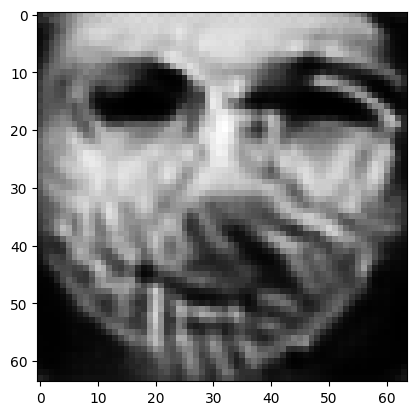

tensor([[1.9927e-05, 8.1468e-05, 3.6787e-04, 7.3902e-05, 4.1103e-06, 4.5766e-04,
         3.0332e-05, 5.7716e-04, 6.2009e-05, 9.9215e-01, 2.3226e-05, 9.8490e-05,
         7.0688e-06, 2.4022e-08, 2.0416e-08, 3.3148e-05, 9.5378e-07, 1.2742e-06,
         1.4373e-05, 7.1787e-04, 4.3711e-07, 2.6581e-05, 4.7685e-10, 7.0964e-08,
         3.9469e-07, 6.5965e-06, 3.7692e-04, 4.6706e-05, 3.0252e-03, 4.2059e-05,
         2.0844e-04, 1.1939e-05, 3.1990e-04, 7.4263e-05, 2.5574e-05, 5.9463e-07,
         6.3439e-07, 9.9120e-05, 1.1179e-04, 8.9887e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007877828553318977
tensor([[1.9925e-05, 8.1458e-05, 3.6783e-04, 7.3896e-05, 4.1099e-06, 4.5760e-04,
         3.0329e-05, 5.7710e-04, 6.2001e-05, 9.9215e-01, 2.3225e-05, 9.8477e-05,
         7.0680e-06, 2.4018e-08, 2.0413e-08, 3.3145e-05, 9.5368e-07, 1.2740e-06,
         1.4371e-05, 7.1780e-04, 4.3704e-07, 2.6578e-05, 4.7676e-10, 7.0956e-08,
         3.9465e-07, 6.5957e-06, 3.7687e-

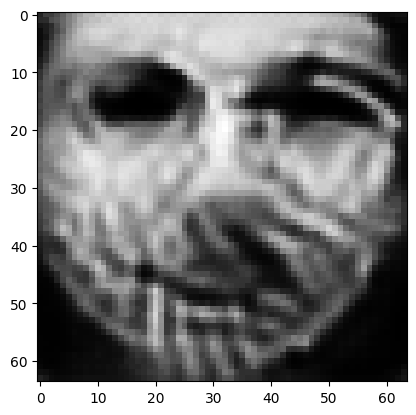

tensor([[1.9919e-05, 8.1421e-05, 3.6767e-04, 7.3874e-05, 4.1082e-06, 4.5733e-04,
         3.0316e-05, 5.7688e-04, 6.1969e-05, 9.9216e-01, 2.3218e-05, 9.8429e-05,
         7.0651e-06, 2.4004e-08, 2.0402e-08, 3.3132e-05, 9.5329e-07, 1.2734e-06,
         1.4364e-05, 7.1755e-04, 4.3677e-07, 2.6567e-05, 4.7645e-10, 7.0926e-08,
         3.9452e-07, 6.5925e-06, 3.7670e-04, 4.6681e-05, 3.0237e-03, 4.2034e-05,
         2.0837e-04, 1.1934e-05, 3.1971e-04, 7.4222e-05, 2.5559e-05, 5.9432e-07,
         6.3406e-07, 9.9078e-05, 1.1172e-04, 8.9820e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007873807102441788
tensor([[1.9917e-05, 8.1414e-05, 3.6763e-04, 7.3870e-05, 4.1078e-06, 4.5727e-04,
         3.0312e-05, 5.7681e-04, 6.1964e-05, 9.9216e-01, 2.3216e-05, 9.8420e-05,
         7.0646e-06, 2.4002e-08, 2.0400e-08, 3.3128e-05, 9.5319e-07, 1.2733e-06,
         1.4362e-05, 7.1750e-04, 4.3672e-07, 2.6564e-05, 4.7638e-10, 7.0918e-08,
         3.9449e-07, 6.5917e-06, 3.7667e-

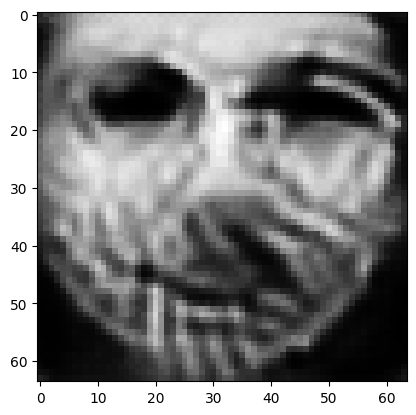

tensor([[1.9911e-05, 8.1379e-05, 3.6747e-04, 7.3849e-05, 4.1063e-06, 4.5702e-04,
         3.0300e-05, 5.7660e-04, 6.1935e-05, 9.9216e-01, 2.3210e-05, 9.8375e-05,
         7.0619e-06, 2.3989e-08, 2.0390e-08, 3.3116e-05, 9.5282e-07, 1.2728e-06,
         1.4355e-05, 7.1726e-04, 4.3647e-07, 2.6553e-05, 4.7608e-10, 7.0890e-08,
         3.9437e-07, 6.5887e-06, 3.7651e-04, 4.6659e-05, 3.0222e-03, 4.2011e-05,
         2.0830e-04, 1.1929e-05, 3.1954e-04, 7.4185e-05, 2.5544e-05, 5.9403e-07,
         6.3376e-07, 9.9039e-05, 1.1166e-04, 8.9759e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007869667373597622
tensor([[1.9910e-05, 8.1370e-05, 3.6744e-04, 7.3844e-05, 4.1059e-06, 4.5696e-04,
         3.0297e-05, 5.7655e-04, 6.1928e-05, 9.9216e-01, 2.3208e-05, 9.8364e-05,
         7.0612e-06, 2.3986e-08, 2.0387e-08, 3.3113e-05, 9.5273e-07, 1.2726e-06,
         1.4353e-05, 7.1719e-04, 4.3640e-07, 2.6550e-05, 4.7601e-10, 7.0883e-08,
         3.9434e-07, 6.5879e-06, 3.7647e-

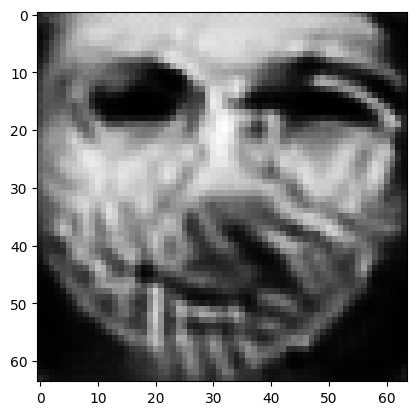

tensor([[1.9904e-05, 8.1337e-05, 3.6729e-04, 7.3824e-05, 4.1044e-06, 4.5672e-04,
         3.0285e-05, 5.7635e-04, 6.1900e-05, 9.9217e-01, 2.3202e-05, 9.8321e-05,
         7.0586e-06, 2.3974e-08, 2.0377e-08, 3.3101e-05, 9.5238e-07, 1.2721e-06,
         1.4347e-05, 7.1696e-04, 4.3616e-07, 2.6539e-05, 4.7572e-10, 7.0856e-08,
         3.9421e-07, 6.5850e-06, 3.7632e-04, 4.6637e-05, 3.0209e-03, 4.1989e-05,
         2.0822e-04, 1.1924e-05, 3.1937e-04, 7.4148e-05, 2.5530e-05, 5.9375e-07,
         6.3347e-07, 9.9002e-05, 1.1160e-04, 8.9698e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007865764200687408
tensor([[1.9903e-05, 8.1328e-05, 3.6725e-04, 7.3820e-05, 4.1040e-06, 4.5666e-04,
         3.0282e-05, 5.7630e-04, 6.1893e-05, 9.9217e-01, 2.3201e-05, 9.8310e-05,
         7.0580e-06, 2.3971e-08, 2.0374e-08, 3.3098e-05, 9.5230e-07, 1.2720e-06,
         1.4345e-05, 7.1690e-04, 4.3610e-07, 2.6537e-05, 4.7565e-10, 7.0850e-08,
         3.9418e-07, 6.5843e-06, 3.7628e-

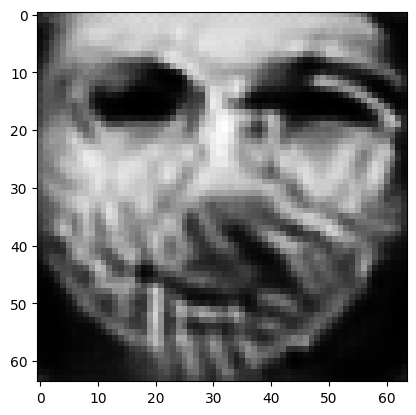

tensor([[1.9897e-05, 8.1297e-05, 3.6712e-04, 7.3801e-05, 4.1026e-06, 4.5644e-04,
         3.0271e-05, 5.7611e-04, 6.1867e-05, 9.9217e-01, 2.3195e-05, 9.8270e-05,
         7.0555e-06, 2.3959e-08, 2.0365e-08, 3.3087e-05, 9.5197e-07, 1.2715e-06,
         1.4339e-05, 7.1669e-04, 4.3588e-07, 2.6527e-05, 4.7538e-10, 7.0824e-08,
         3.9407e-07, 6.5816e-06, 3.7614e-04, 4.6616e-05, 3.0196e-03, 4.1968e-05,
         2.0816e-04, 1.1919e-05, 3.1921e-04, 7.4114e-05, 2.5517e-05, 5.9348e-07,
         6.3319e-07, 9.8966e-05, 1.1154e-04, 8.9641e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007862097583711147
tensor([[1.9896e-05, 8.1290e-05, 3.6708e-04, 7.3797e-05, 4.1023e-06, 4.5639e-04,
         3.0268e-05, 5.7607e-04, 6.1860e-05, 9.9217e-01, 2.3193e-05, 9.8260e-05,
         7.0550e-06, 2.3957e-08, 2.0363e-08, 3.3084e-05, 9.5189e-07, 1.2713e-06,
         1.4337e-05, 7.1663e-04, 4.3582e-07, 2.6524e-05, 4.7532e-10, 7.0819e-08,
         3.9404e-07, 6.5809e-06, 3.7610e-

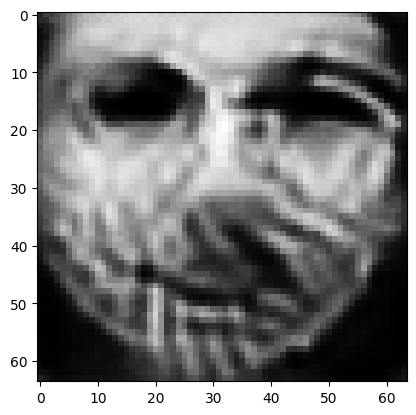

tensor([[1.9891e-05, 8.1260e-05, 3.6695e-04, 7.3779e-05, 4.1009e-06, 4.5618e-04,
         3.0257e-05, 5.7588e-04, 6.1835e-05, 9.9217e-01, 2.3188e-05, 9.8221e-05,
         7.0526e-06, 2.3946e-08, 2.0354e-08, 3.3073e-05, 9.5157e-07, 1.2709e-06,
         1.4331e-05, 7.1643e-04, 4.3560e-07, 2.6515e-05, 4.7506e-10, 7.0794e-08,
         3.9393e-07, 6.5783e-06, 3.7597e-04, 4.6597e-05, 3.0184e-03, 4.1947e-05,
         2.0810e-04, 1.1915e-05, 3.1906e-04, 7.4081e-05, 2.5504e-05, 5.9323e-07,
         6.3293e-07, 9.8933e-05, 1.1148e-04, 8.9587e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007858668453991413
tensor([[1.9890e-05, 8.1254e-05, 3.6692e-04, 7.3775e-05, 4.1006e-06, 4.5612e-04,
         3.0255e-05, 5.7583e-04, 6.1830e-05, 9.9217e-01, 2.3187e-05, 9.8213e-05,
         7.0522e-06, 2.3944e-08, 2.0352e-08, 3.3071e-05, 9.5149e-07, 1.2708e-06,
         1.4330e-05, 7.1639e-04, 4.3556e-07, 2.6512e-05, 4.7500e-10, 7.0788e-08,
         3.9391e-07, 6.5777e-06, 3.7594e-

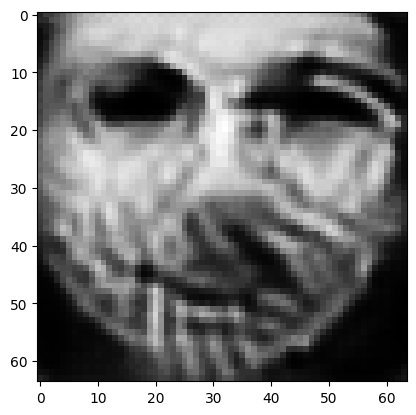

tensor([[1.9885e-05, 8.1225e-05, 3.6679e-04, 7.3758e-05, 4.0993e-06, 4.5592e-04,
         3.0245e-05, 5.7566e-04, 6.1807e-05, 9.9218e-01, 2.3181e-05, 9.8177e-05,
         7.0500e-06, 2.3933e-08, 2.0344e-08, 3.3060e-05, 9.5119e-07, 1.2703e-06,
         1.4324e-05, 7.1619e-04, 4.3535e-07, 2.6504e-05, 4.7476e-10, 7.0765e-08,
         3.9381e-07, 6.5752e-06, 3.7581e-04, 4.6578e-05, 3.0173e-03, 4.1929e-05,
         2.0804e-04, 1.1911e-05, 3.1892e-04, 7.4051e-05, 2.5493e-05, 5.9299e-07,
         6.3268e-07, 9.8901e-05, 1.1143e-04, 8.9538e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007855474948883057
tensor([[1.9884e-05, 8.1218e-05, 3.6676e-04, 7.3754e-05, 4.0990e-06, 4.5587e-04,
         3.0242e-05, 5.7562e-04, 6.1801e-05, 9.9218e-01, 2.3180e-05, 9.8168e-05,
         7.0494e-06, 2.3931e-08, 2.0341e-08, 3.3058e-05, 9.5112e-07, 1.2702e-06,
         1.4323e-05, 7.1614e-04, 4.3530e-07, 2.6501e-05, 4.7470e-10, 7.0759e-08,
         3.9378e-07, 6.5746e-06, 3.7578e-

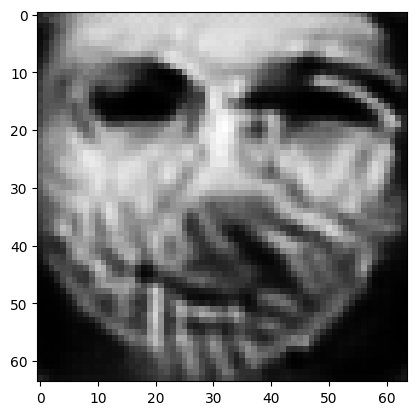

tensor([[1.9879e-05, 8.1192e-05, 3.6664e-04, 7.3739e-05, 4.0978e-06, 4.5568e-04,
         3.0233e-05, 5.7545e-04, 6.1780e-05, 9.9218e-01, 2.3175e-05, 9.8134e-05,
         7.0474e-06, 2.3921e-08, 2.0333e-08, 3.3048e-05, 9.5084e-07, 1.2698e-06,
         1.4318e-05, 7.1596e-04, 4.3511e-07, 2.6493e-05, 4.7448e-10, 7.0737e-08,
         3.9369e-07, 6.5723e-06, 3.7566e-04, 4.6561e-05, 3.0162e-03, 4.1911e-05,
         2.0798e-04, 1.1907e-05, 3.1878e-04, 7.4021e-05, 2.5482e-05, 5.9277e-07,
         6.3244e-07, 9.8871e-05, 1.1138e-04, 8.9489e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.0078522814437747
tensor([[1.9878e-05, 8.1185e-05, 3.6661e-04, 7.3735e-05, 4.0975e-06, 4.5564e-04,
         3.0230e-05, 5.7541e-04, 6.1773e-05, 9.9218e-01, 2.3174e-05, 9.8125e-05,
         7.0469e-06, 2.3919e-08, 2.0331e-08, 3.3046e-05, 9.5077e-07, 1.2697e-06,
         1.4316e-05, 7.1591e-04, 4.3506e-07, 2.6491e-05, 4.7442e-10, 7.0732e-08,
         3.9366e-07, 6.5717e-06, 3.7563e-04

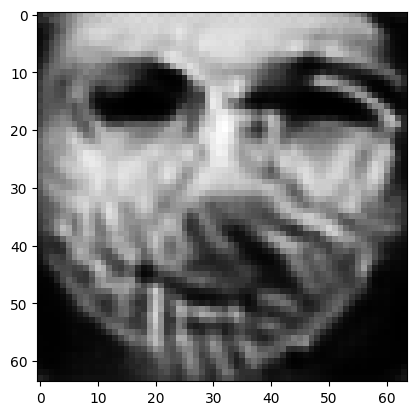

tensor([[1.9874e-05, 8.1161e-05, 3.6650e-04, 7.3721e-05, 4.0963e-06, 4.5546e-04,
         3.0221e-05, 5.7526e-04, 6.1754e-05, 9.9218e-01, 2.3169e-05, 9.8094e-05,
         7.0450e-06, 2.3910e-08, 2.0324e-08, 3.3037e-05, 9.5050e-07, 1.2693e-06,
         1.4311e-05, 7.1574e-04, 4.3488e-07, 2.6482e-05, 4.7421e-10, 7.0712e-08,
         3.9358e-07, 6.5695e-06, 3.7552e-04, 4.6544e-05, 3.0151e-03, 4.1894e-05,
         2.0793e-04, 1.1904e-05, 3.1866e-04, 7.3993e-05, 2.5471e-05, 5.9256e-07,
         6.3222e-07, 9.8843e-05, 1.1133e-04, 8.9444e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007849442772567272
tensor([[1.9873e-05, 8.1156e-05, 3.6647e-04, 7.3718e-05, 4.0961e-06, 4.5541e-04,
         3.0219e-05, 5.7521e-04, 6.1750e-05, 9.9218e-01, 2.3168e-05, 9.8087e-05,
         7.0446e-06, 2.3908e-08, 2.0322e-08, 3.3034e-05, 9.5042e-07, 1.2692e-06,
         1.4310e-05, 7.1570e-04, 4.3484e-07, 2.6481e-05, 4.7416e-10, 7.0706e-08,
         3.9355e-07, 6.5690e-06, 3.7549e-

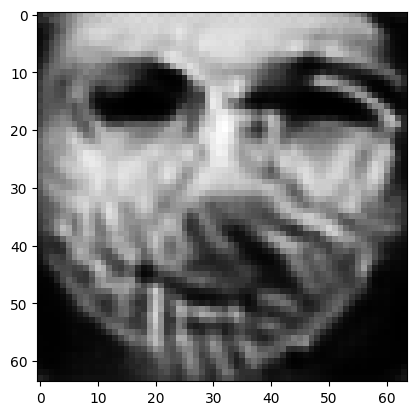

tensor([[1.9869e-05, 8.1132e-05, 3.6636e-04, 7.3704e-05, 4.0950e-06, 4.5524e-04,
         3.0210e-05, 5.7506e-04, 6.1731e-05, 9.9218e-01, 2.3164e-05, 9.8056e-05,
         7.0428e-06, 2.3899e-08, 2.0315e-08, 3.3026e-05, 9.5017e-07, 1.2688e-06,
         1.4305e-05, 7.1554e-04, 4.3467e-07, 2.6473e-05, 4.7396e-10, 7.0687e-08,
         3.9347e-07, 6.5669e-06, 3.7539e-04, 4.6528e-05, 3.0141e-03, 4.1879e-05,
         2.0788e-04, 1.1900e-05, 3.1854e-04, 7.3967e-05, 2.5461e-05, 5.9236e-07,
         6.3201e-07, 9.8816e-05, 1.1129e-04, 8.9402e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007846367545425892
tensor([[1.9868e-05, 8.1127e-05, 3.6634e-04, 7.3701e-05, 4.0947e-06, 4.5520e-04,
         3.0208e-05, 5.7503e-04, 6.1726e-05, 9.9218e-01, 2.3162e-05, 9.8049e-05,
         7.0424e-06, 2.3897e-08, 2.0314e-08, 3.3023e-05, 9.5010e-07, 1.2687e-06,
         1.4304e-05, 7.1549e-04, 4.3463e-07, 2.6471e-05, 4.7391e-10, 7.0682e-08,
         3.9345e-07, 6.5664e-06, 3.7536e-

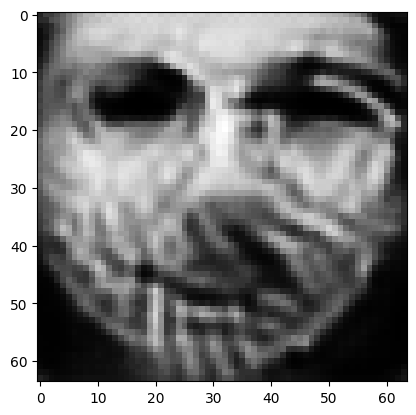

tensor([[1.9864e-05, 8.1104e-05, 3.6624e-04, 7.3688e-05, 4.0937e-06, 4.5503e-04,
         3.0200e-05, 5.7489e-04, 6.1707e-05, 9.9219e-01, 2.3158e-05, 9.8019e-05,
         7.0406e-06, 2.3889e-08, 2.0307e-08, 3.3015e-05, 9.4985e-07, 1.2683e-06,
         1.4300e-05, 7.1533e-04, 4.3446e-07, 2.6463e-05, 4.7371e-10, 7.0663e-08,
         3.9337e-07, 6.5644e-06, 3.7526e-04, 4.6513e-05, 3.0131e-03, 4.1863e-05,
         2.0784e-04, 1.1897e-05, 3.1842e-04, 7.3941e-05, 2.5452e-05, 5.9217e-07,
         6.3181e-07, 9.8791e-05, 1.1125e-04, 8.9360e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007843765430152416
tensor([[1.9863e-05, 8.1099e-05, 3.6621e-04, 7.3685e-05, 4.0934e-06, 4.5499e-04,
         3.0198e-05, 5.7485e-04, 6.1702e-05, 9.9219e-01, 2.3157e-05, 9.8012e-05,
         7.0402e-06, 2.3887e-08, 2.0305e-08, 3.3013e-05, 9.4980e-07, 1.2683e-06,
         1.4299e-05, 7.1529e-04, 4.3442e-07, 2.6462e-05, 4.7367e-10, 7.0659e-08,
         3.9335e-07, 6.5640e-06, 3.7523e-

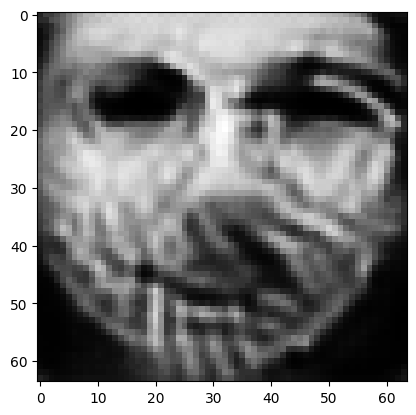

tensor([[1.9859e-05, 8.1077e-05, 3.6611e-04, 7.3673e-05, 4.0925e-06, 4.5484e-04,
         3.0190e-05, 5.7472e-04, 6.1685e-05, 9.9219e-01, 2.3153e-05, 9.7984e-05,
         7.0386e-06, 2.3879e-08, 2.0299e-08, 3.3005e-05, 9.4957e-07, 1.2679e-06,
         1.4294e-05, 7.1515e-04, 4.3427e-07, 2.6455e-05, 4.7349e-10, 7.0641e-08,
         3.9328e-07, 6.5621e-06, 3.7514e-04, 4.6499e-05, 3.0122e-03, 4.1849e-05,
         2.0780e-04, 1.1894e-05, 3.1831e-04, 7.3917e-05, 2.5443e-05, 5.9199e-07,
         6.3162e-07, 9.8767e-05, 1.1121e-04, 8.9321e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.00784116331487894
tensor([[1.9858e-05, 8.1072e-05, 3.6609e-04, 7.3669e-05, 4.0922e-06, 4.5480e-04,
         3.0188e-05, 5.7469e-04, 6.1680e-05, 9.9219e-01, 2.3152e-05, 9.7977e-05,
         7.0382e-06, 2.3877e-08, 2.0297e-08, 3.3003e-05, 9.4951e-07, 1.2678e-06,
         1.4293e-05, 7.1511e-04, 4.3423e-07, 2.6453e-05, 4.7344e-10, 7.0637e-08,
         3.9325e-07, 6.5616e-06, 3.7511e-0

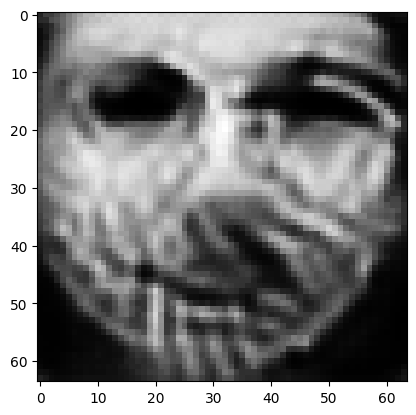

tensor([[1.9855e-05, 8.1052e-05, 3.6600e-04, 7.3658e-05, 4.0913e-06, 4.5465e-04,
         3.0181e-05, 5.7455e-04, 6.1665e-05, 9.9219e-01, 2.3148e-05, 9.7952e-05,
         7.0366e-06, 2.3870e-08, 2.0291e-08, 3.2996e-05, 9.4928e-07, 1.2675e-06,
         1.4289e-05, 7.1497e-04, 4.3408e-07, 2.6446e-05, 4.7327e-10, 7.0619e-08,
         3.9318e-07, 6.5598e-06, 3.7502e-04, 4.6485e-05, 3.0114e-03, 4.1836e-05,
         2.0775e-04, 1.1891e-05, 3.1821e-04, 7.3894e-05, 2.5434e-05, 5.9182e-07,
         6.3144e-07, 9.8743e-05, 1.1117e-04, 8.9285e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007838679477572441
tensor([[1.9854e-05, 8.1047e-05, 3.6597e-04, 7.3655e-05, 4.0911e-06, 4.5462e-04,
         3.0179e-05, 5.7452e-04, 6.1660e-05, 9.9219e-01, 2.3147e-05, 9.7945e-05,
         7.0362e-06, 2.3868e-08, 2.0290e-08, 3.2994e-05, 9.4923e-07, 1.2674e-06,
         1.4288e-05, 7.1494e-04, 4.3405e-07, 2.6445e-05, 4.7322e-10, 7.0615e-08,
         3.9316e-07, 6.5593e-06, 3.7500e-

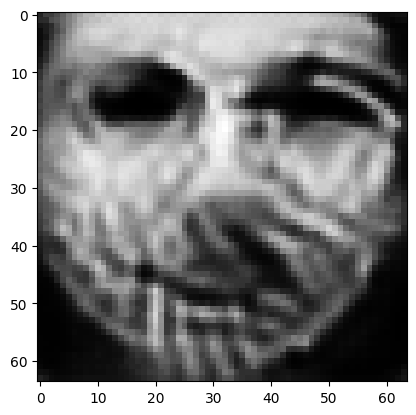

tensor([[1.9850e-05, 8.1028e-05, 3.6589e-04, 7.3644e-05, 4.0902e-06, 4.5448e-04,
         3.0172e-05, 5.7440e-04, 6.1644e-05, 9.9219e-01, 2.3144e-05, 9.7920e-05,
         7.0348e-06, 2.3861e-08, 2.0284e-08, 3.2987e-05, 9.4902e-07, 1.2671e-06,
         1.4284e-05, 7.1480e-04, 4.3391e-07, 2.6438e-05, 4.7306e-10, 7.0599e-08,
         3.9309e-07, 6.5576e-06, 3.7491e-04, 4.6472e-05, 3.0106e-03, 4.1822e-05,
         2.0771e-04, 1.1888e-05, 3.1811e-04, 7.3872e-05, 2.5426e-05, 5.9165e-07,
         6.3127e-07, 9.8721e-05, 1.1113e-04, 8.9249e-04]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.007836432196199894
tensor([[1.9850e-05, 8.1023e-05, 3.6587e-04, 7.3641e-05, 4.0899e-06, 4.5444e-04,
         3.0170e-05, 5.7437e-04, 6.1640e-05, 9.9219e-01, 2.3143e-05, 9.7914e-05,
         7.0344e-06, 2.3859e-08, 2.0282e-08, 3.2985e-05, 9.4897e-07, 1.2670e-06,
         1.4283e-05, 7.1476e-04, 4.3387e-07, 2.6437e-05, 4.7301e-10, 7.0595e-08,
         3.9307e-07, 6.5572e-06, 3.7489e-

In [20]:
z = init_avg_z().detach()
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 10, 0.00, 0.99, target=9)

tensor([[0.0460, 0.0346, 0.0336, 0.0202, 0.0476, 0.0391, 0.0249, 0.0468, 0.0109,
         0.0245, 0.0191, 0.0238, 0.0160, 0.0172, 0.0311, 0.0372, 0.0239, 0.0387,
         0.0183, 0.0210, 0.0370, 0.0234, 0.0107, 0.0307, 0.0282, 0.0132, 0.0199,
         0.0271, 0.0325, 0.0215, 0.0104, 0.0184, 0.0193, 0.0232, 0.0311, 0.0170,
         0.0165, 0.0131, 0.0159, 0.0161]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.7097878456115723


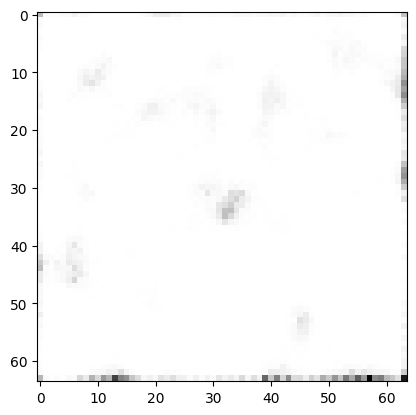

tensor([[0.0461, 0.0346, 0.0336, 0.0201, 0.0477, 0.0392, 0.0249, 0.0470, 0.0109,
         0.0246, 0.0191, 0.0237, 0.0161, 0.0172, 0.0311, 0.0371, 0.0240, 0.0387,
         0.0182, 0.0210, 0.0369, 0.0234, 0.0107, 0.0307, 0.0283, 0.0132, 0.0199,
         0.0272, 0.0324, 0.0215, 0.0104, 0.0184, 0.0193, 0.0232, 0.0312, 0.0170,
         0.0164, 0.0131, 0.0158, 0.0161]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.706319570541382
tensor([[0.0466, 0.0345, 0.0335, 0.0199, 0.0485, 0.0397, 0.0246, 0.0479, 0.0109,
         0.0250, 0.0191, 0.0236, 0.0161, 0.0173, 0.0310, 0.0365, 0.0242, 0.0389,
         0.0180, 0.0210, 0.0362, 0.0231, 0.0106, 0.0309, 0.0291, 0.0130, 0.0197,
         0.0277, 0.0322, 0.0212, 0.0101, 0.0184, 0.0192, 0.0231, 0.0315, 0.0168,
         0.0162, 0.0129, 0.0157, 0.0158]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.6904678344726562
tensor([[0.0341, 0.0317, 0.0369, 0.0175, 0.0871, 0.0398, 0.0166, 0.0513, 0.0090,
         0

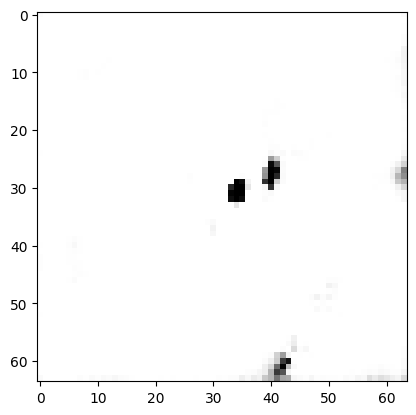

tensor([[0.0798, 0.0340, 0.0242, 0.0102, 0.1698, 0.0264, 0.0103, 0.0664, 0.0026,
         0.0138, 0.0030, 0.0124, 0.0148, 0.0059, 0.0143, 0.0291, 0.0686, 0.0256,
         0.0045, 0.0110, 0.0299, 0.0053, 0.0067, 0.1057, 0.0545, 0.0139, 0.0031,
         0.0276, 0.0055, 0.0029, 0.0066, 0.0163, 0.0076, 0.0097, 0.0238, 0.0052,
         0.0341, 0.0043, 0.0083, 0.0024]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.284197807312012
tensor([[0.0464, 0.0303, 0.0337, 0.0106, 0.1298, 0.0302, 0.0108, 0.0716, 0.0035,
         0.0167, 0.0037, 0.0143, 0.0226, 0.0079, 0.0132, 0.0228, 0.1011, 0.0198,
         0.0044, 0.0123, 0.0335, 0.0062, 0.0090, 0.0853, 0.0440, 0.0251, 0.0033,
         0.0352, 0.0077, 0.0032, 0.0146, 0.0175, 0.0102, 0.0126, 0.0211, 0.0043,
         0.0430, 0.0051, 0.0108, 0.0027]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  4.090477466583252
tensor([[0.0686, 0.0218, 0.0200, 0.0106, 0.2617, 0.0236, 0.0086, 0.0657, 0.0012,
         0.

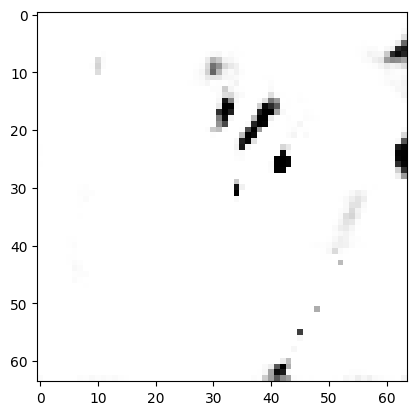

tensor([[0.0626, 0.0386, 0.0325, 0.0062, 0.1044, 0.0708, 0.0150, 0.1985, 0.0011,
         0.0264, 0.0074, 0.0124, 0.0077, 0.0022, 0.0069, 0.0478, 0.0733, 0.0149,
         0.0024, 0.0081, 0.0120, 0.0034, 0.0016, 0.0925, 0.0288, 0.0103, 0.0024,
         0.0385, 0.0041, 0.0024, 0.0039, 0.0116, 0.0046, 0.0056, 0.0149, 0.0014,
         0.0135, 0.0032, 0.0042, 0.0018]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.634897232055664
tensor([[0.0282, 0.0265, 0.0259, 0.0111, 0.1799, 0.0257, 0.0089, 0.0596, 0.0026,
         0.0190, 0.0032, 0.0088, 0.0295, 0.0085, 0.0094, 0.0110, 0.1295, 0.0140,
         0.0040, 0.0132, 0.0228, 0.0038, 0.0090, 0.0448, 0.0433, 0.0442, 0.0040,
         0.0443, 0.0074, 0.0023, 0.0188, 0.0226, 0.0136, 0.0124, 0.0226, 0.0041,
         0.0430, 0.0047, 0.0114, 0.0026]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.960726737976074
tensor([[0.0504, 0.0380, 0.0278, 0.0103, 0.1612, 0.0510, 0.0148, 0.0953, 0.0014,
         0.

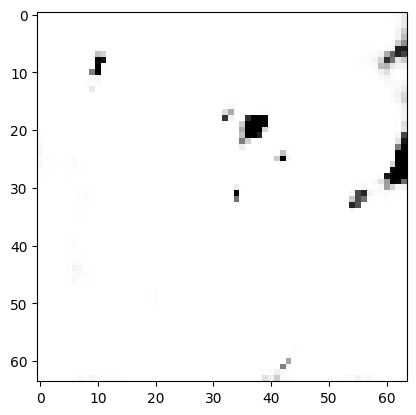

tensor([[0.0353, 0.0356, 0.0253, 0.0127, 0.1155, 0.0332, 0.0093, 0.1285, 0.0020,
         0.0396, 0.0058, 0.0106, 0.0131, 0.0044, 0.0116, 0.0322, 0.1172, 0.0099,
         0.0041, 0.0102, 0.0186, 0.0040, 0.0055, 0.0900, 0.0314, 0.0316, 0.0033,
         0.0449, 0.0100, 0.0029, 0.0086, 0.0163, 0.0076, 0.0091, 0.0224, 0.0023,
         0.0223, 0.0046, 0.0067, 0.0019]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.228957176208496
tensor([[0.0324, 0.0337, 0.0235, 0.0135, 0.1125, 0.0307, 0.0074, 0.1350, 0.0020,
         0.0436, 0.0053, 0.0090, 0.0115, 0.0039, 0.0120, 0.0385, 0.1207, 0.0082,
         0.0043, 0.0091, 0.0168, 0.0036, 0.0051, 0.0978, 0.0336, 0.0330, 0.0028,
         0.0420, 0.0109, 0.0031, 0.0085, 0.0130, 0.0062, 0.0090, 0.0224, 0.0021,
         0.0207, 0.0044, 0.0060, 0.0019]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  3.131688117980957
tensor([[0.0359, 0.0333, 0.0210, 0.0133, 0.1135, 0.0332, 0.0074, 0.1518, 0.0016,
         0.

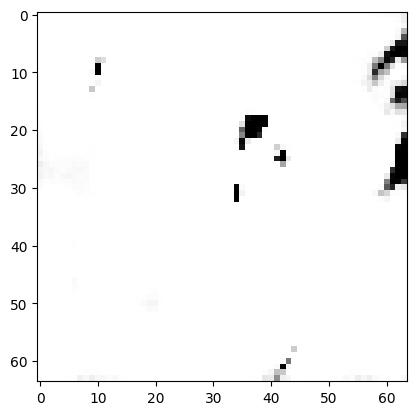

tensor([[0.0311, 0.0314, 0.0230, 0.0121, 0.1079, 0.0450, 0.0059, 0.2072, 0.0012,
         0.0772, 0.0053, 0.0068, 0.0067, 0.0015, 0.0067, 0.0692, 0.0789, 0.0055,
         0.0041, 0.0097, 0.0084, 0.0019, 0.0018, 0.0715, 0.0232, 0.0255, 0.0035,
         0.0392, 0.0127, 0.0030, 0.0039, 0.0115, 0.0037, 0.0053, 0.0234, 0.0013,
         0.0117, 0.0048, 0.0041, 0.0031]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.5618643760681152
tensor([[0.0311, 0.0313, 0.0221, 0.0103, 0.1036, 0.0459, 0.0064, 0.1695, 0.0010,
         0.0949, 0.0063, 0.0084, 0.0071, 0.0016, 0.0066, 0.0887, 0.0807, 0.0057,
         0.0038, 0.0103, 0.0097, 0.0020, 0.0018, 0.0698, 0.0198, 0.0254, 0.0038,
         0.0370, 0.0127, 0.0027, 0.0040, 0.0163, 0.0049, 0.0054, 0.0222, 0.0014,
         0.0134, 0.0054, 0.0038, 0.0030]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.3552870750427246
tensor([[0.0311, 0.0286, 0.0258, 0.0099, 0.1043, 0.0581, 0.0093, 0.1752, 0.0008,
         

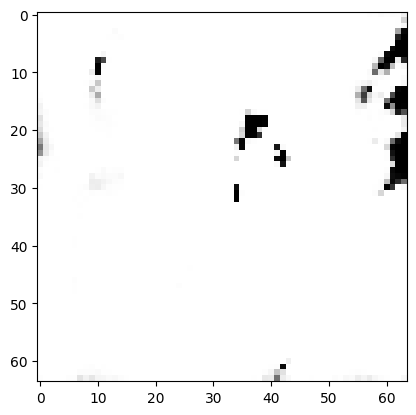

tensor([[0.0357, 0.0352, 0.0185, 0.0082, 0.1038, 0.0453, 0.0074, 0.1715, 0.0007,
         0.0763, 0.0067, 0.0092, 0.0065, 0.0014, 0.0067, 0.1059, 0.0715, 0.0063,
         0.0030, 0.0094, 0.0109, 0.0023, 0.0018, 0.0852, 0.0205, 0.0179, 0.0040,
         0.0370, 0.0095, 0.0024, 0.0037, 0.0176, 0.0046, 0.0049, 0.0224, 0.0014,
         0.0138, 0.0046, 0.0035, 0.0028]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.5730667114257812
tensor([[0.0256, 0.0320, 0.0200, 0.0095, 0.0927, 0.0458, 0.0070, 0.1776, 0.0009,
         0.1060, 0.0068, 0.0088, 0.0069, 0.0015, 0.0068, 0.0967, 0.0786, 0.0052,
         0.0039, 0.0101, 0.0094, 0.0019, 0.0019, 0.0677, 0.0163, 0.0231, 0.0042,
         0.0382, 0.0132, 0.0025, 0.0038, 0.0187, 0.0047, 0.0049, 0.0209, 0.0013,
         0.0125, 0.0054, 0.0037, 0.0031]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.244511365890503
tensor([[0.0240, 0.0356, 0.0200, 0.0113, 0.0986, 0.0481, 0.0066, 0.1467, 0.0010,
         0

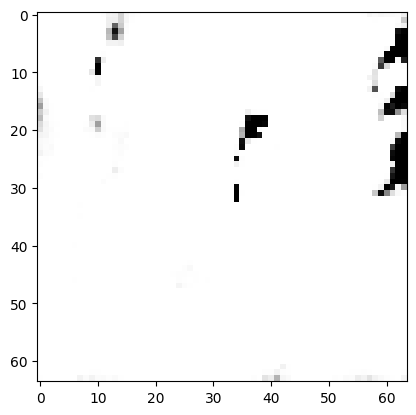

tensor([[0.0221, 0.0407, 0.0248, 0.0131, 0.0798, 0.0532, 0.0066, 0.1372, 0.0012,
         0.1373, 0.0065, 0.0144, 0.0100, 0.0016, 0.0059, 0.0767, 0.0659, 0.0057,
         0.0043, 0.0133, 0.0120, 0.0023, 0.0026, 0.0421, 0.0148, 0.0312, 0.0064,
         0.0384, 0.0154, 0.0035, 0.0055, 0.0344, 0.0064, 0.0045, 0.0238, 0.0019,
         0.0134, 0.0096, 0.0053, 0.0064]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.9856168031692505
tensor([[0.0298, 0.0460, 0.0207, 0.0106, 0.0750, 0.0760, 0.0076, 0.1485, 0.0007,
         0.1205, 0.0052, 0.0143, 0.0074, 0.0010, 0.0043, 0.1019, 0.0596, 0.0060,
         0.0047, 0.0112, 0.0098, 0.0015, 0.0017, 0.0468, 0.0117, 0.0182, 0.0078,
         0.0333, 0.0121, 0.0026, 0.0030, 0.0353, 0.0045, 0.0029, 0.0293, 0.0014,
         0.0104, 0.0074, 0.0034, 0.0060]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  2.115938186645508
tensor([[0.0200, 0.0365, 0.0266, 0.0124, 0.0636, 0.0778, 0.0076, 0.1265, 0.0009,
         0

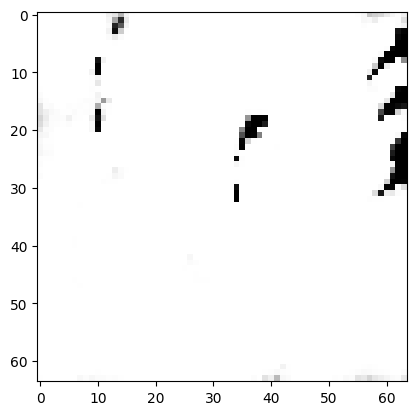

tensor([[0.0179, 0.0371, 0.0243, 0.0114, 0.0571, 0.0614, 0.0048, 0.1583, 0.0009,
         0.1956, 0.0065, 0.0138, 0.0062, 0.0009, 0.0036, 0.0980, 0.0405, 0.0038,
         0.0044, 0.0137, 0.0072, 0.0017, 0.0013, 0.0297, 0.0088, 0.0226, 0.0078,
         0.0323, 0.0171, 0.0030, 0.0034, 0.0413, 0.0049, 0.0033, 0.0213, 0.0012,
         0.0083, 0.0121, 0.0047, 0.0080]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.6318422555923462
tensor([[0.0167, 0.0367, 0.0262, 0.0113, 0.0523, 0.0645, 0.0047, 0.1449, 0.0008,
         0.2076, 0.0069, 0.0144, 0.0057, 0.0009, 0.0032, 0.1055, 0.0415, 0.0039,
         0.0045, 0.0125, 0.0072, 0.0017, 0.0013, 0.0260, 0.0075, 0.0218, 0.0084,
         0.0328, 0.0178, 0.0032, 0.0032, 0.0402, 0.0048, 0.0033, 0.0205, 0.0012,
         0.0082, 0.0130, 0.0046, 0.0086]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.5721176862716675
tensor([[0.0160, 0.0374, 0.0233, 0.0131, 0.0536, 0.0631, 0.0067, 0.1211, 0.0009,
         

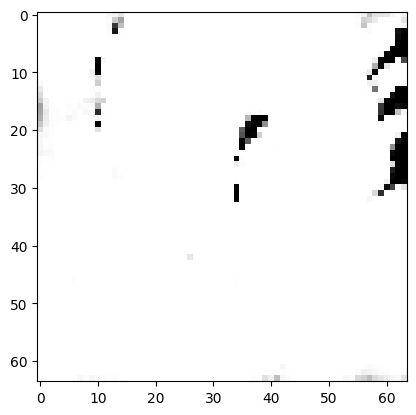

tensor([[0.0139, 0.0336, 0.0239, 0.0101, 0.0544, 0.0559, 0.0047, 0.1445, 0.0009,
         0.2342, 0.0074, 0.0134, 0.0063, 0.0009, 0.0035, 0.1013, 0.0367, 0.0035,
         0.0044, 0.0137, 0.0072, 0.0018, 0.0013, 0.0246, 0.0079, 0.0224, 0.0079,
         0.0342, 0.0195, 0.0034, 0.0033, 0.0346, 0.0052, 0.0040, 0.0199, 0.0012,
         0.0087, 0.0113, 0.0050, 0.0092]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.4515639543533325
tensor([[0.0150, 0.0354, 0.0236, 0.0111, 0.0512, 0.0575, 0.0045, 0.1278, 0.0008,
         0.2574, 0.0063, 0.0136, 0.0060, 0.0008, 0.0032, 0.1003, 0.0354, 0.0034,
         0.0047, 0.0122, 0.0066, 0.0016, 0.0012, 0.0218, 0.0068, 0.0211, 0.0096,
         0.0323, 0.0190, 0.0033, 0.0033, 0.0399, 0.0047, 0.0033, 0.0211, 0.0012,
         0.0080, 0.0117, 0.0044, 0.0091]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.3569891452789307
tensor([[0.0111, 0.0335, 0.0222, 0.0109, 0.0525, 0.0524, 0.0048, 0.1144, 0.0010,
         

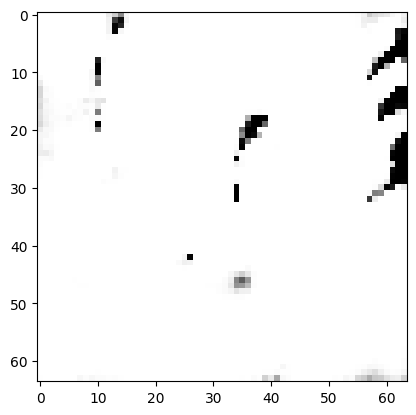

tensor([[0.0117, 0.0390, 0.0246, 0.0139, 0.0537, 0.0510, 0.0061, 0.1068, 0.0012,
         0.2123, 0.0063, 0.0210, 0.0114, 0.0013, 0.0037, 0.0655, 0.0528, 0.0036,
         0.0044, 0.0131, 0.0089, 0.0018, 0.0022, 0.0217, 0.0091, 0.0402, 0.0106,
         0.0419, 0.0204, 0.0030, 0.0085, 0.0518, 0.0075, 0.0039, 0.0225, 0.0015,
         0.0112, 0.0149, 0.0050, 0.0099]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.5497148036956787
tensor([[0.0141, 0.0366, 0.0238, 0.0102, 0.0488, 0.0684, 0.0055, 0.1178, 0.0008,
         0.2552, 0.0062, 0.0162, 0.0067, 0.0008, 0.0027, 0.1019, 0.0338, 0.0034,
         0.0042, 0.0125, 0.0062, 0.0015, 0.0011, 0.0198, 0.0063, 0.0200, 0.0115,
         0.0331, 0.0188, 0.0029, 0.0037, 0.0430, 0.0049, 0.0033, 0.0204, 0.0010,
         0.0078, 0.0104, 0.0042, 0.0106]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.3658390045166016
tensor([[0.0140, 0.0294, 0.0204, 0.0074, 0.0477, 0.0626, 0.0047, 0.1165, 0.0006,
         

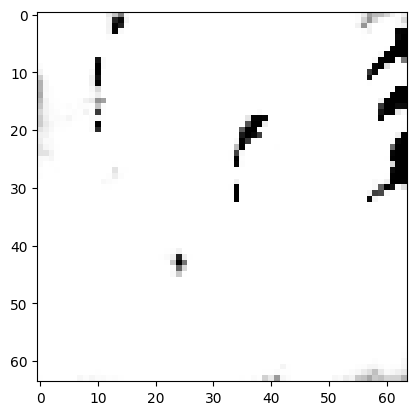

tensor([[0.0172, 0.0292, 0.0239, 0.0091, 0.0583, 0.0706, 0.0061, 0.1135, 0.0006,
         0.2416, 0.0053, 0.0160, 0.0060, 0.0006, 0.0026, 0.0981, 0.0346, 0.0035,
         0.0031, 0.0121, 0.0065, 0.0013, 0.0009, 0.0277, 0.0079, 0.0235, 0.0082,
         0.0320, 0.0167, 0.0024, 0.0036, 0.0531, 0.0057, 0.0029, 0.0221, 0.0009,
         0.0083, 0.0117, 0.0044, 0.0082]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.420638918876648
tensor([[2.2074e-02, 2.5333e-02, 1.7197e-02, 5.2095e-03, 4.9185e-02, 5.3712e-02,
         3.8898e-03, 1.6726e-01, 3.8080e-04, 2.9703e-01, 6.0126e-03, 9.9570e-03,
         2.6149e-03, 2.9325e-04, 1.9792e-03, 1.3626e-01, 1.4538e-02, 3.7966e-03,
         2.8733e-03, 1.1972e-02, 4.0818e-03, 1.4415e-03, 3.3470e-04, 1.9187e-02,
         3.9969e-03, 8.0162e-03, 6.2940e-03, 2.1414e-02, 1.1049e-02, 2.3678e-03,
         1.0096e-03, 4.5176e-02, 3.5888e-03, 2.2244e-03, 1.3873e-02, 7.8057e-04,
         3.9065e-03, 9.8555e-03, 3.3702e-03, 6.4605e-03]], d

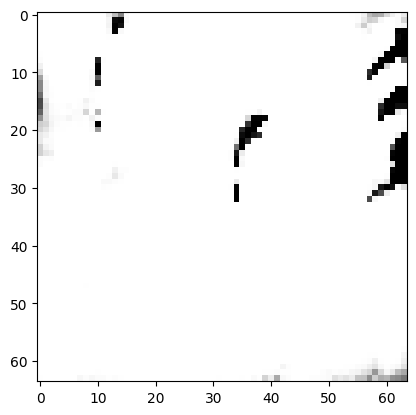

tensor([[0.0150, 0.0260, 0.0166, 0.0064, 0.0491, 0.0473, 0.0035, 0.1370, 0.0006,
         0.3476, 0.0059, 0.0100, 0.0037, 0.0004, 0.0021, 0.1088, 0.0156, 0.0029,
         0.0031, 0.0130, 0.0041, 0.0013, 0.0005, 0.0171, 0.0050, 0.0130, 0.0071,
         0.0231, 0.0149, 0.0028, 0.0016, 0.0435, 0.0042, 0.0025, 0.0169, 0.0009,
         0.0044, 0.0107, 0.0037, 0.0083]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0566595792770386
tensor([[1.4126e-02, 2.3475e-02, 1.7751e-02, 5.7389e-03, 4.8106e-02, 5.2329e-02,
         3.5206e-03, 1.4441e-01, 5.3449e-04, 3.5308e-01, 5.8621e-03, 9.4199e-03,
         3.2589e-03, 3.4691e-04, 1.8010e-03, 1.1391e-01, 1.4038e-02, 2.7393e-03,
         2.9316e-03, 1.2128e-02, 3.9576e-03, 1.2533e-03, 3.9097e-04, 1.4991e-02,
         4.2068e-03, 1.2050e-02, 6.5663e-03, 2.3189e-02, 1.4390e-02, 2.7274e-03,
         1.3184e-03, 3.5631e-02, 3.8514e-03, 2.5389e-03, 1.6363e-02, 7.8324e-04,
         4.0528e-03, 9.3536e-03, 3.6783e-03, 9.1952e-03]], 

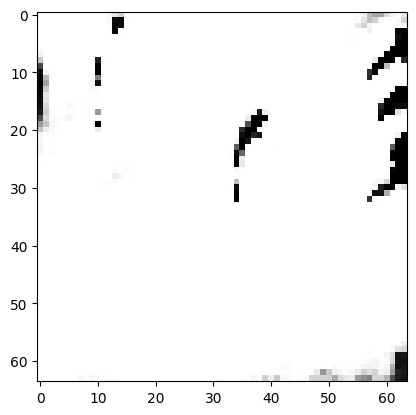

tensor([[1.6614e-02, 2.1999e-02, 1.7327e-02, 4.5578e-03, 4.9594e-02, 5.3885e-02,
         3.9143e-03, 1.3409e-01, 4.6920e-04, 3.4767e-01, 5.7299e-03, 8.2698e-03,
         2.9547e-03, 3.0310e-04, 1.6459e-03, 1.3359e-01, 1.4322e-02, 2.9662e-03,
         2.8044e-03, 1.3036e-02, 3.6990e-03, 1.1158e-03, 3.4555e-04, 1.7091e-02,
         3.9445e-03, 9.2094e-03, 6.4070e-03, 1.9836e-02, 1.3947e-02, 2.5249e-03,
         9.9673e-04, 3.6519e-02, 3.9958e-03, 2.3468e-03, 1.5925e-02, 7.7547e-04,
         3.8778e-03, 8.7585e-03, 3.7645e-03, 9.1785e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  1.0564976930618286
tensor([[1.4245e-02, 2.1023e-02, 1.6008e-02, 4.6776e-03, 4.2415e-02, 4.4311e-02,
         3.0953e-03, 1.3094e-01, 4.3410e-04, 3.8594e-01, 5.6900e-03, 7.6542e-03,
         2.7265e-03, 2.6958e-04, 1.5369e-03, 1.3239e-01, 1.2822e-02, 2.4592e-03,
         2.8674e-03, 1.1100e-02, 3.4861e-03, 1.0882e-03, 3.3065e-04, 1.5910e-02,
         3.5729e-03, 9.8601e-03, 5.8591e-03

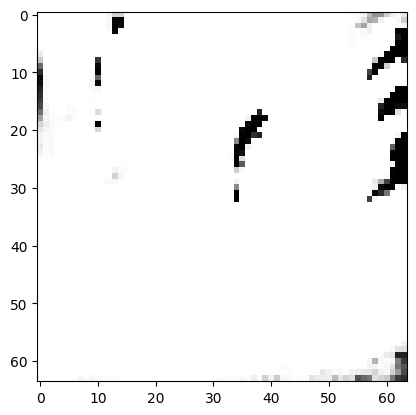

tensor([[1.0702e-02, 1.9225e-02, 1.3354e-02, 4.1921e-03, 3.4931e-02, 3.7255e-02,
         2.6445e-03, 1.0540e-01, 4.5598e-04, 4.6144e-01, 5.3647e-03, 8.0056e-03,
         2.6715e-03, 2.4990e-04, 1.2962e-03, 1.1468e-01, 9.6047e-03, 1.9791e-03,
         2.6365e-03, 1.0204e-02, 2.9395e-03, 1.0163e-03, 3.0243e-04, 1.1311e-02,
         2.9705e-03, 1.0017e-02, 7.1174e-03, 1.6578e-02, 1.5334e-02, 2.3474e-03,
         1.0512e-03, 3.8043e-02, 3.6663e-03, 2.1041e-03, 1.3918e-02, 6.9881e-04,
         3.0942e-03, 9.3691e-03, 3.0998e-03, 8.7249e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.7733994126319885
tensor([[1.1714e-02, 2.1667e-02, 1.1659e-02, 4.5992e-03, 3.5080e-02, 3.5675e-02,
         2.5219e-03, 1.0109e-01, 4.4194e-04, 4.7583e-01, 4.7298e-03, 7.4925e-03,
         2.4038e-03, 2.1570e-04, 1.3173e-03, 1.0865e-01, 8.3615e-03, 1.9433e-03,
         2.6802e-03, 1.0937e-02, 2.5079e-03, 9.1196e-04, 2.4101e-04, 9.7604e-03,
         2.9948e-03, 8.2753e-03, 7.4561e-03

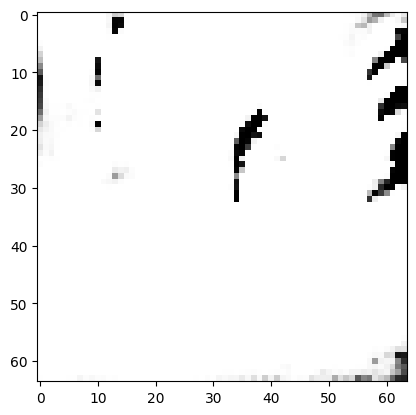

tensor([[8.6506e-03, 1.8818e-02, 9.8557e-03, 3.6541e-03, 2.8655e-02, 2.8104e-02,
         2.0138e-03, 8.8561e-02, 3.9740e-04, 5.3683e-01, 4.7528e-03, 6.2823e-03,
         1.9736e-03, 1.7196e-04, 1.1392e-03, 1.0300e-01, 6.2001e-03, 1.5422e-03,
         2.3499e-03, 9.7059e-03, 2.2171e-03, 8.4084e-04, 2.0398e-04, 8.1479e-03,
         2.3589e-03, 8.0620e-03, 6.4211e-03, 1.3072e-02, 1.4694e-02, 2.4646e-03,
         8.1779e-04, 3.8180e-02, 3.1015e-03, 1.7763e-03, 1.2744e-02, 5.9665e-04,
         1.9997e-03, 8.2545e-03, 2.7187e-03, 8.6706e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.6220807433128357
tensor([[9.6213e-03, 2.1145e-02, 1.1130e-02, 4.7098e-03, 3.0384e-02, 3.0842e-02,
         2.1003e-03, 9.3835e-02, 4.6073e-04, 5.1796e-01, 4.5804e-03, 5.8620e-03,
         2.2087e-03, 1.9405e-04, 1.2692e-03, 9.8431e-02, 7.2895e-03, 1.6657e-03,
         2.6457e-03, 1.0169e-02, 2.1585e-03, 8.4874e-04, 2.3061e-04, 8.6573e-03,
         3.1693e-03, 8.9643e-03, 7.1923e-03

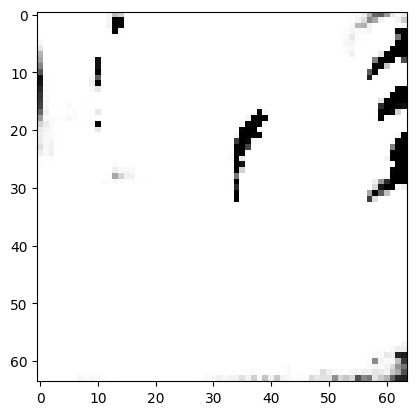

tensor([[8.5633e-03, 1.8033e-02, 9.3734e-03, 3.7399e-03, 2.6028e-02, 2.4731e-02,
         1.7511e-03, 8.6227e-02, 3.7993e-04, 5.6057e-01, 4.4738e-03, 5.6078e-03,
         1.7968e-03, 1.5345e-04, 1.0354e-03, 9.4723e-02, 5.6569e-03, 1.4149e-03,
         2.3128e-03, 9.4279e-03, 1.9679e-03, 8.1110e-04, 1.8374e-04, 7.6645e-03,
         2.3733e-03, 7.7911e-03, 6.2263e-03, 1.2019e-02, 1.5115e-02, 2.4414e-03,
         7.6974e-04, 3.7079e-02, 2.9760e-03, 1.6722e-03, 1.2807e-02, 5.8556e-04,
         1.8317e-03, 8.7894e-03, 2.6898e-03, 8.2046e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5787980556488037
tensor([[7.5334e-03, 1.6663e-02, 9.8658e-03, 3.6738e-03, 2.4621e-02, 2.3451e-02,
         1.6335e-03, 8.6158e-02, 4.0114e-04, 5.6298e-01, 4.7836e-03, 5.8444e-03,
         1.8990e-03, 1.7200e-04, 1.0150e-03, 9.4915e-02, 6.1149e-03, 1.3276e-03,
         2.4605e-03, 8.5784e-03, 2.1355e-03, 8.7713e-04, 2.1962e-04, 7.8128e-03,
         2.2282e-03, 8.7512e-03, 6.3634e-03

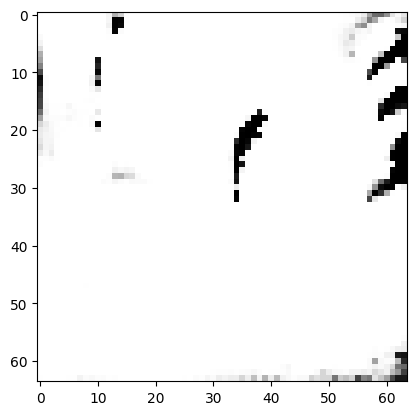

tensor([[6.9779e-03, 1.5767e-02, 9.0316e-03, 3.3705e-03, 2.3194e-02, 1.9777e-02,
         1.4037e-03, 8.6146e-02, 3.3732e-04, 5.7332e-01, 4.9797e-03, 5.6797e-03,
         1.7944e-03, 1.6363e-04, 9.7163e-04, 9.4227e-02, 5.7981e-03, 1.3508e-03,
         2.3144e-03, 8.1556e-03, 2.0679e-03, 8.6938e-04, 2.1376e-04, 8.2722e-03,
         2.0356e-03, 8.5235e-03, 5.8219e-03, 1.2408e-02, 1.5447e-02, 2.2596e-03,
         8.0345e-04, 3.8457e-02, 3.2357e-03, 1.6446e-03, 1.0276e-02, 5.7518e-04,
         2.0403e-03, 1.1018e-02, 2.6868e-03, 6.5871e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5563156604766846
tensor([[7.1677e-03, 1.6296e-02, 8.7828e-03, 3.5911e-03, 2.2730e-02, 1.9226e-02,
         1.3602e-03, 8.2528e-02, 3.4609e-04, 5.8758e-01, 4.4145e-03, 5.1288e-03,
         1.7446e-03, 1.5196e-04, 9.3755e-04, 8.8273e-02, 5.6091e-03, 1.2554e-03,
         2.4059e-03, 7.9873e-03, 1.8760e-03, 8.3028e-04, 2.0077e-04, 7.6923e-03,
         2.1691e-03, 8.2201e-03, 6.1043e-03

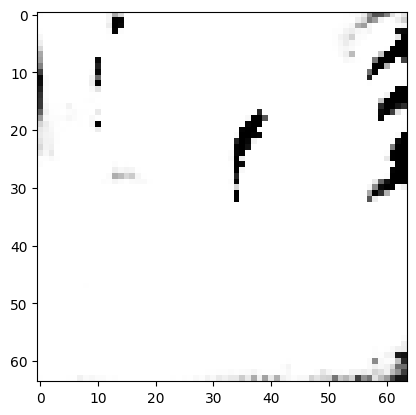

tensor([[6.1809e-03, 1.5225e-02, 8.5386e-03, 3.2530e-03, 2.1529e-02, 1.7666e-02,
         1.3036e-03, 7.9403e-02, 3.3062e-04, 6.0297e-01, 4.6172e-03, 5.2346e-03,
         1.6825e-03, 1.5683e-04, 8.8997e-04, 8.6061e-02, 5.2829e-03, 1.2271e-03,
         2.3406e-03, 7.6512e-03, 1.8812e-03, 8.0718e-04, 2.0071e-04, 7.0541e-03,
         1.8373e-03, 8.1248e-03, 5.8579e-03, 1.1740e-02, 1.5542e-02, 2.2508e-03,
         7.5720e-04, 3.6023e-02, 3.0270e-03, 1.6047e-03, 9.9040e-03, 5.4853e-04,
         1.8286e-03, 1.0325e-02, 2.5529e-03, 6.5929e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.5058916211128235
tensor([[6.7887e-03, 1.4929e-02, 8.3749e-03, 3.4343e-03, 2.0778e-02, 1.7841e-02,
         1.3027e-03, 7.7733e-02, 3.1942e-04, 6.1544e-01, 4.1620e-03, 4.4926e-03,
         1.5430e-03, 1.3441e-04, 8.1352e-04, 8.2005e-02, 5.0610e-03, 1.1419e-03,
         2.3436e-03, 7.6180e-03, 1.6219e-03, 7.5142e-04, 1.6795e-04, 6.7788e-03,
         1.9883e-03, 7.6600e-03, 5.8138e-03

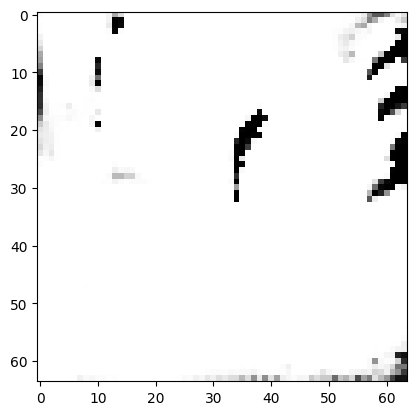

tensor([[6.7056e-03, 1.4592e-02, 8.7430e-03, 3.5878e-03, 2.1137e-02, 1.7997e-02,
         1.2932e-03, 7.7405e-02, 3.3976e-04, 6.1688e-01, 4.1332e-03, 4.4530e-03,
         1.6532e-03, 1.3718e-04, 8.1758e-04, 7.8579e-02, 5.1581e-03, 1.1151e-03,
         2.2955e-03, 7.6121e-03, 1.6511e-03, 7.7088e-04, 1.7395e-04, 6.8980e-03,
         2.1734e-03, 8.4875e-03, 5.6621e-03, 1.1423e-02, 1.7125e-02, 2.3105e-03,
         7.5038e-04, 3.0469e-02, 2.7927e-03, 1.5200e-03, 1.1152e-02, 5.2162e-04,
         1.8304e-03, 1.0146e-02, 2.6083e-03, 6.8979e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.48307982087135315
tensor([[6.3053e-03, 1.4756e-02, 8.3211e-03, 3.3893e-03, 2.0146e-02, 1.7219e-02,
         1.2183e-03, 7.0740e-02, 3.3038e-04, 6.2310e-01, 4.1976e-03, 4.8089e-03,
         1.5890e-03, 1.4084e-04, 7.9371e-04, 8.0621e-02, 4.8771e-03, 1.1047e-03,
         2.2468e-03, 7.4388e-03, 1.6694e-03, 7.5253e-04, 1.7462e-04, 6.5942e-03,
         1.9130e-03, 8.0585e-03, 6.0394e-0

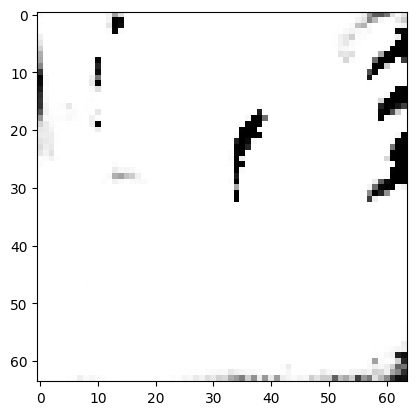

tensor([[5.6800e-03, 1.4076e-02, 8.0404e-03, 3.1483e-03, 2.0231e-02, 1.6432e-02,
         1.2787e-03, 7.2168e-02, 3.1856e-04, 6.3217e-01, 4.1690e-03, 4.7284e-03,
         1.5825e-03, 1.3879e-04, 7.6932e-04, 7.7063e-02, 4.6265e-03, 1.0979e-03,
         2.2545e-03, 7.5311e-03, 1.6399e-03, 7.2465e-04, 1.6939e-04, 6.1888e-03,
         1.7050e-03, 7.8493e-03, 5.6715e-03, 1.1117e-02, 1.5833e-02, 2.1696e-03,
         7.2631e-04, 3.3798e-02, 2.8330e-03, 1.4908e-03, 9.6531e-03, 5.1451e-04,
         1.6943e-03, 9.7257e-03, 2.4922e-03, 6.4979e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.45859426259994507
tensor([[6.6452e-03, 1.4488e-02, 8.1827e-03, 3.4321e-03, 2.0753e-02, 1.8621e-02,
         1.4311e-03, 7.2288e-02, 2.9466e-04, 6.3134e-01, 3.8609e-03, 4.2390e-03,
         1.5584e-03, 1.2311e-04, 7.1226e-04, 7.5928e-02, 4.7037e-03, 1.1227e-03,
         2.2670e-03, 8.1810e-03, 1.4471e-03, 6.3648e-04, 1.4283e-04, 6.4351e-03,
         1.9566e-03, 7.4086e-03, 5.7929e-0

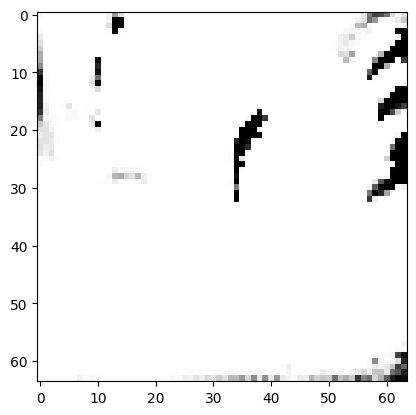

tensor([[6.0856e-03, 1.2466e-02, 8.0029e-03, 3.0552e-03, 1.9114e-02, 1.6885e-02,
         1.2276e-03, 7.2073e-02, 2.8841e-04, 6.5337e-01, 3.7945e-03, 3.8804e-03,
         1.3090e-03, 1.0716e-04, 6.1995e-04, 7.1701e-02, 4.0565e-03, 1.0284e-03,
         2.0664e-03, 7.1739e-03, 1.3472e-03, 6.2616e-04, 1.2219e-04, 5.3567e-03,
         1.6321e-03, 6.9216e-03, 5.2467e-03, 1.0214e-02, 1.5571e-02, 1.9972e-03,
         5.6538e-04, 2.8773e-02, 2.5001e-03, 1.2814e-03, 9.7916e-03, 4.4064e-04,
         1.5021e-03, 9.0942e-03, 2.2794e-03, 6.4304e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.425607830286026
tensor([[5.7072e-03, 1.2266e-02, 8.6223e-03, 3.0614e-03, 2.0191e-02, 1.7682e-02,
         1.2831e-03, 7.2768e-02, 3.2098e-04, 6.4892e-01, 3.8191e-03, 4.0421e-03,
         1.4373e-03, 1.1600e-04, 6.2955e-04, 6.9657e-02, 4.2474e-03, 1.0476e-03,
         2.0950e-03, 7.5107e-03, 1.4409e-03, 6.4249e-04, 1.3490e-04, 5.3357e-03,
         1.6769e-03, 7.6196e-03, 5.0795e-03,

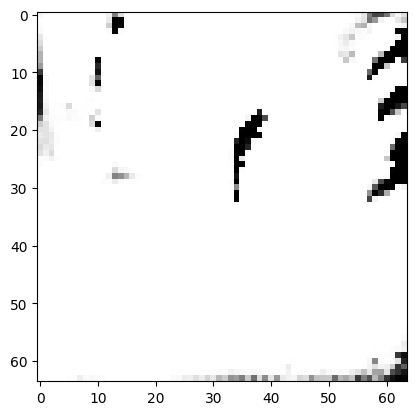

tensor([[5.1559e-03, 1.1576e-02, 8.2189e-03, 2.9390e-03, 1.8332e-02, 1.6712e-02,
         1.1782e-03, 6.3922e-02, 3.0886e-04, 6.6913e-01, 3.7204e-03, 3.9617e-03,
         1.3946e-03, 1.0801e-04, 5.6732e-04, 6.6284e-02, 3.8370e-03, 9.5109e-04,
         1.9878e-03, 7.0917e-03, 1.3440e-03, 5.9524e-04, 1.2470e-04, 4.8523e-03,
         1.4985e-03, 7.4962e-03, 5.1860e-03, 1.0401e-02, 1.6274e-02, 1.9779e-03,
         6.1238e-04, 2.8453e-02, 2.5455e-03, 1.2260e-03, 9.5857e-03, 4.2779e-04,
         1.5191e-03, 9.2607e-03, 2.4016e-03, 6.8389e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.40177321434020996
tensor([[5.1596e-03, 1.1735e-02, 8.0087e-03, 2.8793e-03, 1.7941e-02, 1.5903e-02,
         1.1273e-03, 6.5911e-02, 2.9832e-04, 6.7037e-01, 3.6566e-03, 3.9448e-03,
         1.3330e-03, 1.0594e-04, 5.5608e-04, 6.6951e-02, 3.7630e-03, 9.4654e-04,
         2.0225e-03, 6.7730e-03, 1.3186e-03, 6.0171e-04, 1.2246e-04, 4.6531e-03,
         1.4127e-03, 7.0617e-03, 5.2712e-0

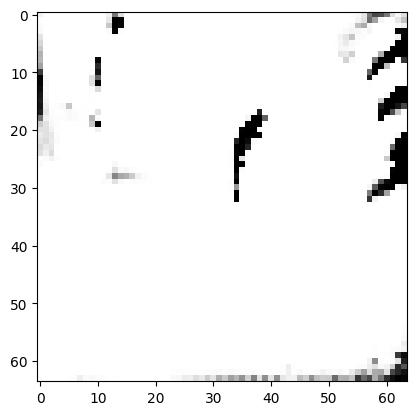

tensor([[4.8754e-03, 1.1537e-02, 7.6277e-03, 2.7366e-03, 1.7249e-02, 1.5561e-02,
         1.0888e-03, 6.1858e-02, 2.8625e-04, 6.8505e-01, 3.3789e-03, 3.6935e-03,
         1.2793e-03, 9.5969e-05, 5.0877e-04, 6.4775e-02, 3.3996e-03, 8.7834e-04,
         1.9578e-03, 6.6114e-03, 1.2094e-03, 5.5545e-04, 1.0864e-04, 4.2082e-03,
         1.2885e-03, 6.6891e-03, 5.2116e-03, 9.7334e-03, 1.5430e-02, 1.8108e-03,
         5.4158e-04, 2.7359e-02, 2.2825e-03, 1.1339e-03, 9.0570e-03, 3.8845e-04,
         1.3532e-03, 8.5127e-03, 2.1498e-03, 6.5294e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.37826448678970337
tensor([[5.0713e-03, 1.1406e-02, 7.8298e-03, 2.8175e-03, 1.7398e-02, 1.6402e-02,
         1.1545e-03, 5.9076e-02, 2.7644e-04, 6.8521e-01, 3.3924e-03, 3.5692e-03,
         1.3369e-03, 9.5989e-05, 5.0814e-04, 6.5086e-02, 3.5640e-03, 9.0919e-04,
         1.9433e-03, 6.9216e-03, 1.1694e-03, 5.3276e-04, 1.0562e-04, 4.4443e-03,
         1.3790e-03, 6.6752e-03, 5.3267e-0

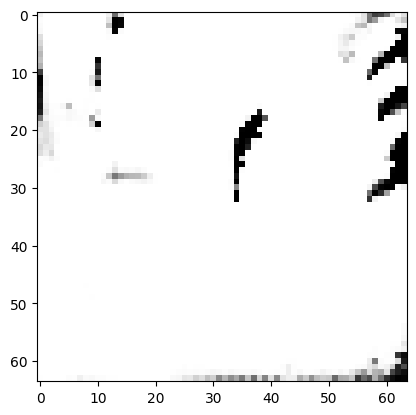

tensor([[4.4612e-03, 1.0473e-02, 7.1882e-03, 2.6057e-03, 1.6203e-02, 1.4503e-02,
         1.0596e-03, 5.5437e-02, 2.5391e-04, 7.0904e-01, 3.1812e-03, 3.3338e-03,
         1.2436e-03, 8.6852e-05, 4.3483e-04, 5.9223e-02, 3.0987e-03, 8.1492e-04,
         1.8283e-03, 6.2390e-03, 1.0523e-03, 4.8638e-04, 9.2792e-05, 3.8098e-03,
         1.1806e-03, 6.3578e-03, 5.0888e-03, 9.3820e-03, 1.5254e-02, 1.6794e-03,
         5.1375e-04, 2.4882e-02, 2.0834e-03, 1.0271e-03, 8.5360e-03, 3.5356e-04,
         1.3343e-03, 8.1695e-03, 1.9978e-03, 6.0126e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3438487946987152
tensor([[4.4985e-03, 1.1081e-02, 7.3679e-03, 2.7417e-03, 1.6877e-02, 1.4879e-02,
         1.0543e-03, 5.2852e-02, 2.8121e-04, 7.0516e-01, 3.1708e-03, 3.4905e-03,
         1.3139e-03, 9.2245e-05, 4.5505e-04, 5.9215e-02, 3.1298e-03, 8.3414e-04,
         1.8472e-03, 6.4018e-03, 1.1080e-03, 4.9517e-04, 9.9484e-05, 3.8361e-03,
         1.2737e-03, 6.7742e-03, 5.2725e-03

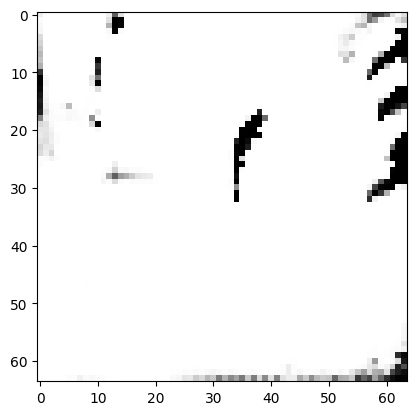

tensor([[4.4094e-03, 1.1544e-02, 7.4296e-03, 2.7327e-03, 1.7328e-02, 1.4863e-02,
         1.0701e-03, 5.2512e-02, 2.9016e-04, 6.9899e-01, 3.3039e-03, 3.7746e-03,
         1.3578e-03, 9.9452e-05, 4.7326e-04, 6.0478e-02, 3.2424e-03, 8.7271e-04,
         1.8646e-03, 6.4887e-03, 1.1868e-03, 5.0837e-04, 1.0940e-04, 3.9666e-03,
         1.2761e-03, 7.0176e-03, 5.4354e-03, 9.7493e-03, 1.5333e-02, 1.8406e-03,
         5.9678e-04, 2.7966e-02, 2.2782e-03, 1.0820e-03, 9.1892e-03, 3.9253e-04,
         1.3967e-03, 8.7930e-03, 2.1380e-03, 6.6153e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.35811203718185425
tensor([[4.8409e-03, 1.0452e-02, 7.2319e-03, 2.6136e-03, 1.6383e-02, 1.5506e-02,
         1.1213e-03, 5.7457e-02, 2.4476e-04, 7.0580e-01, 3.0885e-03, 3.2104e-03,
         1.2202e-03, 8.0911e-05, 4.2159e-04, 6.0426e-02, 3.0636e-03, 8.2947e-04,
         1.8326e-03, 6.3522e-03, 1.0045e-03, 4.7042e-04, 8.5627e-05, 3.7934e-03,
         1.2031e-03, 5.9890e-03, 5.1734e-0

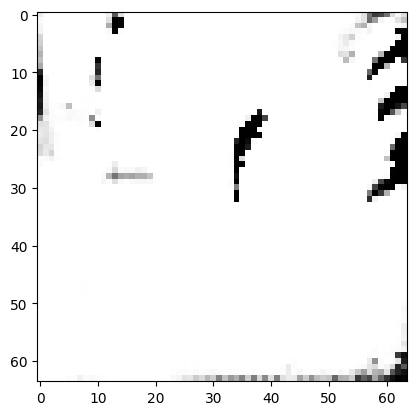

tensor([[4.7554e-03, 9.9022e-03, 6.8404e-03, 2.4938e-03, 1.5852e-02, 1.4572e-02,
         1.0674e-03, 5.7290e-02, 2.2167e-04, 7.1395e-01, 3.0845e-03, 3.0653e-03,
         1.1474e-03, 7.4512e-05, 3.9442e-04, 5.9673e-02, 2.9276e-03, 8.0134e-04,
         1.7694e-03, 5.9715e-03, 9.6744e-04, 4.5949e-04, 7.8847e-05, 3.7595e-03,
         1.1203e-03, 5.7430e-03, 4.8826e-03, 9.0280e-03, 1.4849e-02, 1.5442e-03,
         4.5149e-04, 2.3379e-02, 1.9753e-03, 9.3896e-04, 8.2383e-03, 3.2368e-04,
         1.2816e-03, 7.7630e-03, 1.8066e-03, 5.5592e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3369472324848175
tensor([[4.4160e-03, 1.0433e-02, 6.7737e-03, 2.5680e-03, 1.5847e-02, 1.3997e-02,
         1.0383e-03, 5.1676e-02, 2.3973e-04, 7.1757e-01, 3.0927e-03, 3.2559e-03,
         1.2302e-03, 8.3038e-05, 4.1545e-04, 5.8667e-02, 2.9356e-03, 8.0343e-04,
         1.7931e-03, 6.1273e-03, 1.0120e-03, 4.5225e-04, 8.7147e-05, 3.7084e-03,
         1.1124e-03, 6.0302e-03, 5.1068e-03

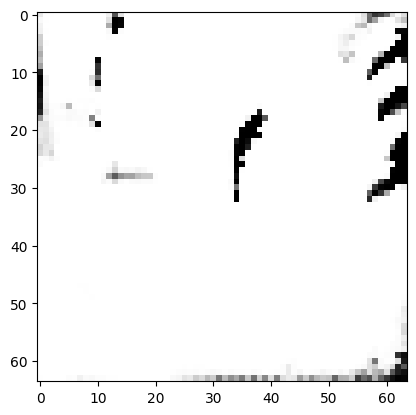

tensor([[4.4203e-03, 1.0195e-02, 6.5533e-03, 2.5004e-03, 1.5420e-02, 1.3600e-02,
         1.0224e-03, 5.1083e-02, 2.2475e-04, 7.2311e-01, 3.0221e-03, 3.1264e-03,
         1.1902e-03, 7.8395e-05, 3.9644e-04, 5.8549e-02, 2.8461e-03, 7.8466e-04,
         1.7793e-03, 5.9534e-03, 9.7084e-04, 4.3737e-04, 8.1479e-05, 3.6506e-03,
         1.0574e-03, 5.7271e-03, 5.0166e-03, 8.8319e-03, 1.4574e-02, 1.5834e-03,
         4.7681e-04, 2.3926e-02, 1.9156e-03, 9.1916e-04, 8.3014e-03, 3.2534e-04,
         1.2720e-03, 7.7983e-03, 1.7883e-03, 5.4880e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.32418912649154663
tensor([[4.6572e-03, 9.9299e-03, 6.6461e-03, 2.5370e-03, 1.5350e-02, 1.3885e-02,
         1.0294e-03, 5.2561e-02, 2.2315e-04, 7.2340e-01, 2.9721e-03, 2.9972e-03,
         1.1542e-03, 7.4013e-05, 3.7948e-04, 5.7551e-02, 2.8011e-03, 7.8124e-04,
         1.7630e-03, 5.8544e-03, 9.3080e-04, 4.3628e-04, 7.6894e-05, 3.5938e-03,
         1.0919e-03, 5.6614e-03, 5.0239e-0

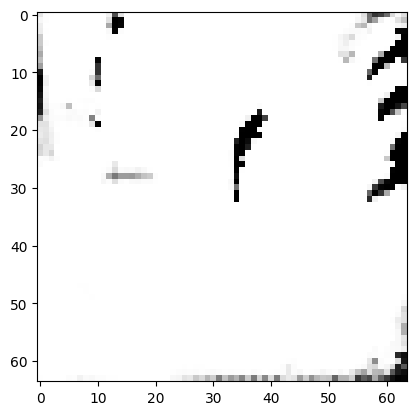

tensor([[4.4627e-03, 9.9179e-03, 6.4761e-03, 2.4685e-03, 1.4908e-02, 1.3479e-02,
         9.8765e-04, 5.0777e-02, 2.2341e-04, 7.2842e-01, 2.9083e-03, 2.9957e-03,
         1.1222e-03, 7.2651e-05, 3.7007e-04, 5.7400e-02, 2.6965e-03, 7.5267e-04,
         1.7472e-03, 5.7337e-03, 9.2045e-04, 4.2622e-04, 7.4853e-05, 3.4156e-03,
         1.0301e-03, 5.5150e-03, 5.0127e-03, 8.5363e-03, 1.4599e-02, 1.5317e-03,
         4.4610e-04, 2.3129e-02, 1.8449e-03, 8.8806e-04, 8.2781e-03, 3.1189e-04,
         1.2112e-03, 7.6669e-03, 1.7083e-03, 5.5367e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3168794512748718
tensor([[4.1380e-03, 9.9141e-03, 6.4639e-03, 2.4954e-03, 1.4870e-02, 1.2908e-02,
         9.4963e-04, 4.8656e-02, 2.2641e-04, 7.3260e-01, 2.9069e-03, 3.0595e-03,
         1.1471e-03, 7.5318e-05, 3.7457e-04, 5.6122e-02, 2.7037e-03, 7.4010e-04,
         1.7431e-03, 5.6166e-03, 9.4877e-04, 4.2623e-04, 7.8414e-05, 3.3366e-03,
         1.0000e-03, 5.7296e-03, 4.9045e-03

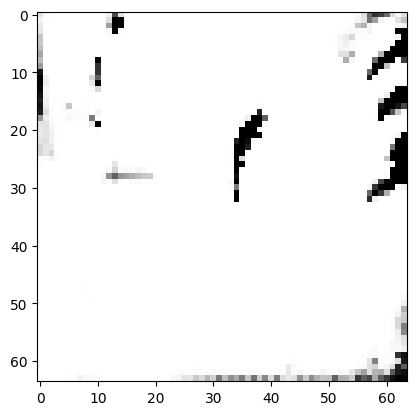

tensor([[4.0446e-03, 1.0042e-02, 6.4812e-03, 2.5215e-03, 1.4750e-02, 1.2802e-02,
         9.1708e-04, 4.6675e-02, 2.3654e-04, 7.3643e-01, 2.8441e-03, 3.0708e-03,
         1.1464e-03, 7.4617e-05, 3.6281e-04, 5.4908e-02, 2.6119e-03, 7.2737e-04,
         1.7201e-03, 5.4742e-03, 9.4579e-04, 4.1856e-04, 7.7550e-05, 3.1649e-03,
         9.8074e-04, 5.8317e-03, 4.9361e-03, 8.6759e-03, 1.4548e-02, 1.5945e-03,
         4.7931e-04, 2.2820e-02, 1.8299e-03, 8.6164e-04, 8.2483e-03, 3.0830e-04,
         1.2021e-03, 7.8011e-03, 1.7226e-03, 5.7147e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.3059433400630951
tensor([[4.3242e-03, 9.5662e-03, 6.4494e-03, 2.4595e-03, 1.4232e-02, 1.3205e-02,
         9.4401e-04, 4.8683e-02, 2.1922e-04, 7.3735e-01, 2.7873e-03, 2.8667e-03,
         1.0869e-03, 6.7702e-05, 3.4101e-04, 5.5581e-02, 2.5534e-03, 7.1411e-04,
         1.7150e-03, 5.4564e-03, 8.7447e-04, 4.0744e-04, 6.9340e-05, 3.1649e-03,
         9.6172e-04, 5.3724e-03, 4.9298e-03

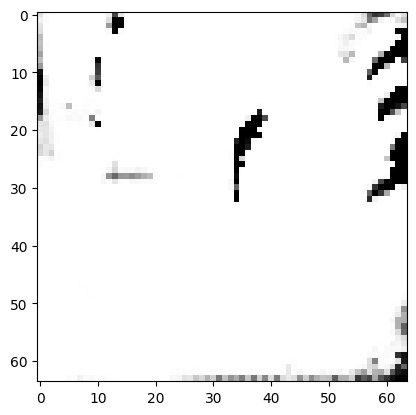

tensor([[4.3259e-03, 9.2334e-03, 6.2749e-03, 2.3392e-03, 1.3854e-02, 1.3321e-02,
         9.5409e-04, 4.7882e-02, 1.9954e-04, 7.4315e-01, 2.6800e-03, 2.7502e-03,
         1.0367e-03, 6.1168e-05, 3.1139e-04, 5.5802e-02, 2.4294e-03, 6.9986e-04,
         1.6957e-03, 5.3210e-03, 8.3105e-04, 3.8625e-04, 6.1882e-05, 3.0473e-03,
         8.7128e-04, 4.9593e-03, 4.8368e-03, 8.1741e-03, 1.4748e-02, 1.4118e-03,
         4.0137e-04, 2.0303e-02, 1.6550e-03, 7.7872e-04, 7.8075e-03, 2.6482e-04,
         1.1464e-03, 7.0943e-03, 1.5585e-03, 5.3451e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2968635857105255
tensor([[3.8734e-03, 9.6524e-03, 6.1750e-03, 2.4065e-03, 1.4124e-02, 1.2331e-02,
         8.9351e-04, 4.3513e-02, 2.1649e-04, 7.4681e-01, 2.6847e-03, 2.9358e-03,
         1.1015e-03, 6.8084e-05, 3.2992e-04, 5.3853e-02, 2.4564e-03, 6.8986e-04,
         1.7042e-03, 5.3207e-03, 8.9551e-04, 3.9232e-04, 7.0768e-05, 3.0283e-03,
         8.9871e-04, 5.5164e-03, 4.9018e-03

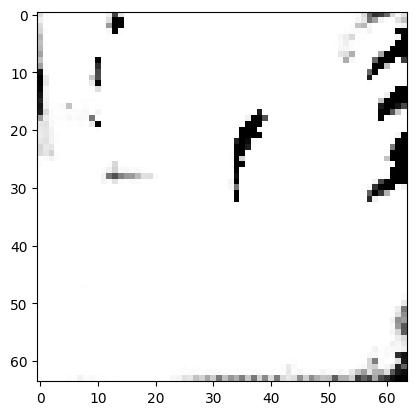

tensor([[3.6794e-03, 1.0806e-02, 6.5645e-03, 2.6605e-03, 1.4771e-02, 1.2781e-02,
         8.5511e-04, 4.0021e-02, 2.6537e-04, 7.4239e-01, 2.6614e-03, 3.1840e-03,
         1.2082e-03, 7.7385e-05, 3.6276e-04, 5.2810e-02, 2.5309e-03, 6.9745e-04,
         1.7364e-03, 5.5467e-03, 9.6947e-04, 3.9734e-04, 8.0157e-05, 2.9440e-03,
         9.7531e-04, 6.2224e-03, 5.1882e-03, 8.6375e-03, 1.5037e-02, 1.7319e-03,
         5.4081e-04, 2.2806e-02, 1.7641e-03, 8.5145e-04, 8.9362e-03, 2.9801e-04,
         1.1756e-03, 7.7375e-03, 1.7778e-03, 6.3163e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2978748381137848
tensor([[3.8836e-03, 9.7145e-03, 6.2386e-03, 2.3694e-03, 1.3724e-02, 1.2665e-02,
         8.6637e-04, 4.4692e-02, 2.2640e-04, 7.4829e-01, 2.6427e-03, 2.8674e-03,
         1.0423e-03, 6.4889e-05, 3.2644e-04, 5.3915e-02, 2.3210e-03, 6.6733e-04,
         1.6840e-03, 5.2379e-03, 8.7151e-04, 3.8549e-04, 6.5169e-05, 2.8148e-03,
         8.3831e-04, 5.2756e-03, 4.7046e-03

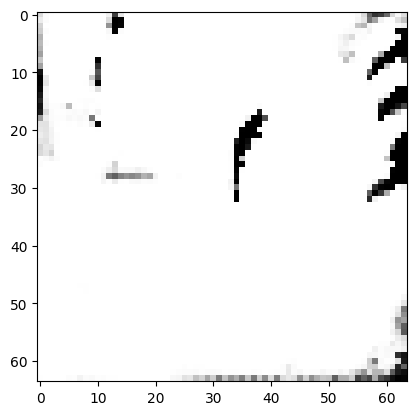

tensor([[3.9673e-03, 8.8252e-03, 5.7956e-03, 2.1321e-03, 1.3112e-02, 1.2231e-02,
         8.5739e-04, 4.4952e-02, 1.8244e-04, 7.5500e-01, 2.5732e-03, 2.6877e-03,
         9.4330e-04, 5.6147e-05, 2.8738e-04, 5.5330e-02, 2.2044e-03, 6.5198e-04,
         1.6483e-03, 4.8923e-03, 8.0636e-04, 3.7070e-04, 5.6865e-05, 2.8346e-03,
         7.4578e-04, 4.6372e-03, 4.6511e-03, 7.6485e-03, 1.4158e-02, 1.3255e-03,
         3.6982e-04, 2.0034e-02, 1.5892e-03, 7.1991e-04, 7.2228e-03, 2.4393e-04,
         1.0704e-03, 6.7630e-03, 1.4466e-03, 4.9778e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.28103959560394287
tensor([[3.5845e-03, 9.8827e-03, 6.1298e-03, 2.4089e-03, 1.3888e-02, 1.1865e-02,
         8.0346e-04, 4.0134e-02, 2.3466e-04, 7.5472e-01, 2.5730e-03, 2.9477e-03,
         1.0839e-03, 6.8370e-05, 3.2501e-04, 5.1412e-02, 2.2952e-03, 6.6080e-04,
         1.6482e-03, 5.1401e-03, 8.9248e-04, 3.8181e-04, 6.9979e-05, 2.7619e-03,
         8.6074e-04, 5.6759e-03, 4.8393e-0

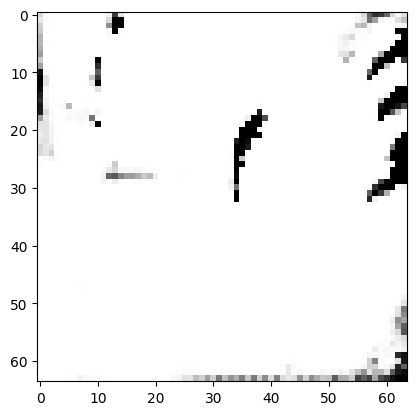

tensor([[3.5106e-03, 9.6439e-03, 5.9779e-03, 2.3480e-03, 1.3481e-02, 1.1549e-02,
         7.8068e-04, 3.9916e-02, 2.2777e-04, 7.5902e-01, 2.5541e-03, 2.8885e-03,
         1.0465e-03, 6.6019e-05, 3.1653e-04, 5.0823e-02, 2.2248e-03, 6.4002e-04,
         1.6322e-03, 4.9930e-03, 8.7419e-04, 3.7732e-04, 6.7291e-05, 2.6845e-03,
         8.1579e-04, 5.5268e-03, 4.7272e-03, 7.9230e-03, 1.4218e-02, 1.5353e-03,
         4.5278e-04, 2.1166e-02, 1.6511e-03, 7.6916e-04, 7.8347e-03, 2.6775e-04,
         1.0690e-03, 7.2937e-03, 1.5867e-03, 5.5248e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.27573320269584656
tensor([[3.8974e-03, 8.6695e-03, 5.7674e-03, 2.1519e-03, 1.2820e-02, 1.1901e-02,
         8.1958e-04, 4.4840e-02, 1.8531e-04, 7.5979e-01, 2.5392e-03, 2.6067e-03,
         9.1789e-04, 5.4503e-05, 2.8105e-04, 5.3414e-02, 2.1322e-03, 6.3186e-04,
         1.6202e-03, 4.7684e-03, 7.8518e-04, 3.6779e-04, 5.4682e-05, 2.7117e-03,
         7.2875e-04, 4.6366e-03, 4.4576e-0

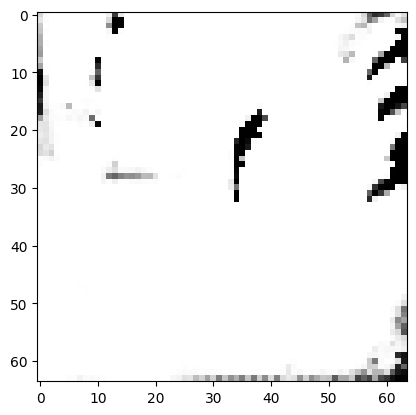

tensor([[3.7043e-03, 8.8240e-03, 5.7221e-03, 2.1817e-03, 1.2769e-02, 1.1575e-02,
         7.8079e-04, 4.2329e-02, 1.9600e-04, 7.6482e-01, 2.4845e-03, 2.6165e-03,
         9.3977e-04, 5.5722e-05, 2.8074e-04, 5.1303e-02, 2.0674e-03, 6.1821e-04,
         1.5870e-03, 4.7390e-03, 7.8283e-04, 3.6105e-04, 5.5671e-05, 2.5974e-03,
         7.2983e-04, 4.8145e-03, 4.4861e-03, 7.5299e-03, 1.3889e-02, 1.3694e-03,
         3.8068e-04, 1.9387e-02, 1.5387e-03, 7.0360e-04, 7.2097e-03, 2.3886e-04,
         1.0041e-03, 6.8032e-03, 1.4517e-03, 5.0781e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.268120676279068
tensor([[3.3920e-03, 9.4898e-03, 5.8876e-03, 2.3305e-03, 1.3240e-02, 1.1149e-02,
         7.5054e-04, 3.8887e-02, 2.2821e-04, 7.6417e-01, 2.4994e-03, 2.8461e-03,
         1.0376e-03, 6.5038e-05, 3.0617e-04, 4.9164e-02, 2.1544e-03, 6.2188e-04,
         1.6075e-03, 4.8797e-03, 8.5568e-04, 3.7193e-04, 6.6459e-05, 2.5935e-03,
         7.9318e-04, 5.5644e-03, 4.6667e-03,

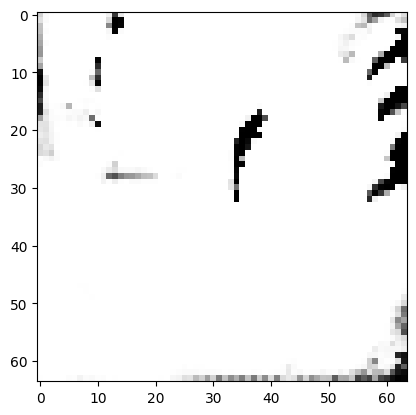

tensor([[3.4061e-03, 9.2756e-03, 5.7055e-03, 2.2640e-03, 1.2891e-02, 1.0939e-02,
         7.3959e-04, 3.8413e-02, 2.1868e-04, 7.6876e-01, 2.4253e-03, 2.7545e-03,
         1.0014e-03, 6.1545e-05, 2.9220e-04, 4.8800e-02, 2.0705e-03, 6.0645e-04,
         1.5986e-03, 4.7788e-03, 8.2344e-04, 3.6109e-04, 6.2618e-05, 2.5363e-03,
         7.5492e-04, 5.2942e-03, 4.5979e-03, 7.5214e-03, 1.4007e-02, 1.4653e-03,
         4.2975e-04, 2.0060e-02, 1.5828e-03, 7.2199e-04, 7.5926e-03, 2.5081e-04,
         1.0089e-03, 7.1217e-03, 1.4962e-03, 5.3119e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2629809081554413
tensor([[3.7635e-03, 8.5370e-03, 5.7691e-03, 2.1786e-03, 1.2437e-02, 1.1556e-02,
         7.5326e-04, 4.3415e-02, 1.9427e-04, 7.6726e-01, 2.4612e-03, 2.5292e-03,
         8.9456e-04, 5.2573e-05, 2.6882e-04, 5.0480e-02, 2.0061e-03, 5.9934e-04,
         1.5495e-03, 4.5673e-03, 7.5797e-04, 3.6139e-04, 5.1901e-05, 2.5154e-03,
         7.0992e-04, 4.7460e-03, 4.2809e-03

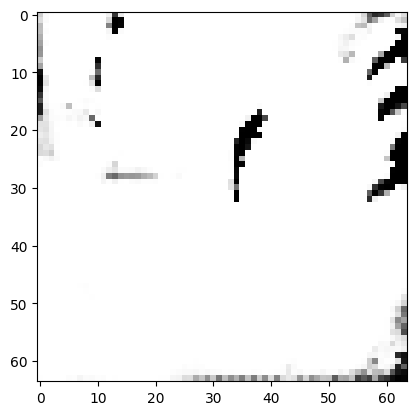

tensor([[3.6156e-03, 8.3899e-03, 5.5675e-03, 2.1206e-03, 1.2193e-02, 1.0977e-02,
         7.2802e-04, 4.1951e-02, 1.9181e-04, 7.7369e-01, 2.3854e-03, 2.4955e-03,
         8.7766e-04, 5.1249e-05, 2.5750e-04, 4.8680e-02, 1.9019e-03, 5.8151e-04,
         1.5269e-03, 4.4521e-03, 7.4020e-04, 3.5633e-04, 5.0532e-05, 2.4014e-03,
         6.8026e-04, 4.6787e-03, 4.2462e-03, 7.2074e-03, 1.3574e-02, 1.3197e-03,
         3.5989e-04, 1.8576e-02, 1.4862e-03, 6.6854e-04, 6.8133e-03, 2.2840e-04,
         9.2949e-04, 6.7331e-03, 1.3971e-03, 4.9167e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.25658121705055237
tensor([[3.3524e-03, 8.8658e-03, 5.4947e-03, 2.1981e-03, 1.2228e-02, 1.0458e-02,
         7.0234e-04, 3.7934e-02, 2.0978e-04, 7.7787e-01, 2.3410e-03, 2.6097e-03,
         9.4172e-04, 5.6335e-05, 2.7018e-04, 4.6374e-02, 1.8958e-03, 5.7422e-04,
         1.5356e-03, 4.5597e-03, 7.6636e-04, 3.5024e-04, 5.5684e-05, 2.3433e-03,
         6.9528e-04, 5.0066e-03, 4.4039e-0

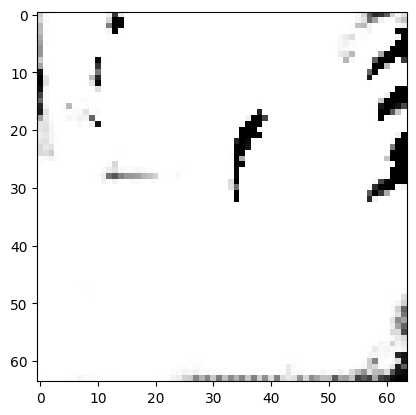

tensor([[3.2750e-03, 8.7601e-03, 5.3970e-03, 2.1723e-03, 1.2020e-02, 1.0226e-02,
         6.8581e-04, 3.6633e-02, 2.0988e-04, 7.8270e-01, 2.2447e-03, 2.5563e-03,
         9.3051e-04, 5.4470e-05, 2.6036e-04, 4.5087e-02, 1.8174e-03, 5.5626e-04,
         1.5228e-03, 4.4767e-03, 7.4516e-04, 3.4164e-04, 5.3719e-05, 2.2433e-03,
         6.7580e-04, 4.9185e-03, 4.3923e-03, 6.9637e-03, 1.3517e-02, 1.3846e-03,
         3.9395e-04, 1.9019e-02, 1.4661e-03, 6.6414e-04, 7.1506e-03, 2.3526e-04,
         9.0379e-04, 6.8228e-03, 1.4134e-03, 5.1066e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.24499958753585815
tensor([[3.2891e-03, 8.7579e-03, 5.3875e-03, 2.1723e-03, 1.1992e-02, 1.0246e-02,
         6.8331e-04, 3.6999e-02, 2.0953e-04, 7.8322e-01, 2.2231e-03, 2.5252e-03,
         9.1588e-04, 5.3313e-05, 2.5881e-04, 4.5056e-02, 1.7905e-03, 5.5216e-04,
         1.5139e-03, 4.4301e-03, 7.3774e-04, 3.4025e-04, 5.2119e-05, 2.2056e-03,
         6.6633e-04, 4.8380e-03, 4.3260e-0

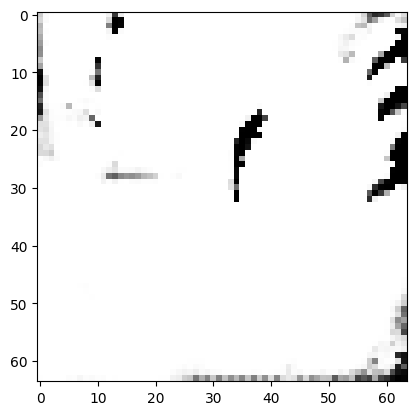

tensor([[3.2651e-03, 8.4588e-03, 5.3541e-03, 2.1092e-03, 1.1830e-02, 1.0097e-02,
         6.7811e-04, 3.7276e-02, 2.0340e-04, 7.8584e-01, 2.2016e-03, 2.4718e-03,
         8.9739e-04, 5.1605e-05, 2.4811e-04, 4.4478e-02, 1.7526e-03, 5.4474e-04,
         1.4956e-03, 4.3531e-03, 7.1989e-04, 3.3971e-04, 5.0440e-05, 2.1739e-03,
         6.4778e-04, 4.7469e-03, 4.2617e-03, 6.8623e-03, 1.3328e-02, 1.3330e-03,
         3.7356e-04, 1.8442e-02, 1.4322e-03, 6.4752e-04, 6.8905e-03, 2.2805e-04,
         8.7675e-04, 6.6634e-03, 1.3859e-03, 4.9869e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.24099858105182648
tensor([[3.2269e-03, 8.6685e-03, 5.3144e-03, 2.1036e-03, 1.2119e-02, 1.0071e-02,
         6.8828e-04, 3.5613e-02, 2.0407e-04, 7.8589e-01, 2.1644e-03, 2.5129e-03,
         9.3373e-04, 5.3370e-05, 2.5010e-04, 4.4331e-02, 1.7878e-03, 5.5456e-04,
         1.5139e-03, 4.4057e-03, 7.3045e-04, 3.3573e-04, 5.3595e-05, 2.2273e-03,
         6.7495e-04, 4.8699e-03, 4.4626e-0

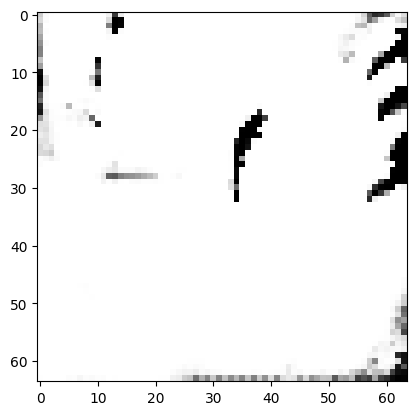

tensor([[3.1892e-03, 8.3492e-03, 5.2541e-03, 2.0596e-03, 1.1781e-02, 9.7838e-03,
         6.7241e-04, 3.5676e-02, 1.9973e-04, 7.8989e-01, 2.1483e-03, 2.4401e-03,
         9.0884e-04, 5.1241e-05, 2.3901e-04, 4.3287e-02, 1.7181e-03, 5.3738e-04,
         1.4884e-03, 4.2706e-03, 7.0657e-04, 3.3485e-04, 5.1109e-05, 2.1593e-03,
         6.4697e-04, 4.7798e-03, 4.3418e-03, 6.7380e-03, 1.3432e-02, 1.3045e-03,
         3.7651e-04, 1.8057e-02, 1.4463e-03, 6.3552e-04, 6.9128e-03, 2.2562e-04,
         8.8279e-04, 6.7212e-03, 1.3762e-03, 4.9319e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2358669638633728
tensor([[3.1581e-03, 8.4241e-03, 5.2565e-03, 2.0709e-03, 1.1774e-02, 9.6927e-03,
         6.5660e-04, 3.5718e-02, 2.0435e-04, 7.9040e-01, 2.1390e-03, 2.4443e-03,
         9.0617e-04, 5.1346e-05, 2.4119e-04, 4.3064e-02, 1.6922e-03, 5.3506e-04,
         1.4678e-03, 4.2593e-03, 7.0877e-04, 3.3568e-04, 5.0732e-05, 2.1247e-03,
         6.4290e-04, 4.7873e-03, 4.2651e-03

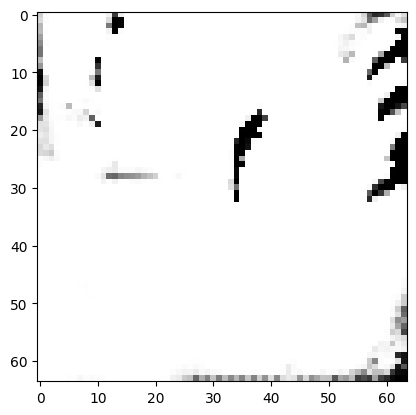

tensor([[3.1177e-03, 8.2328e-03, 5.2567e-03, 2.0418e-03, 1.1619e-02, 9.5413e-03,
         6.4745e-04, 3.5593e-02, 2.0380e-04, 7.9289e-01, 2.1324e-03, 2.4097e-03,
         8.9871e-04, 5.0529e-05, 2.3405e-04, 4.2253e-02, 1.6567e-03, 5.2542e-04,
         1.4502e-03, 4.1736e-03, 6.9716e-04, 3.3611e-04, 4.9770e-05, 2.0853e-03,
         6.2927e-04, 4.7901e-03, 4.1958e-03, 6.6886e-03, 1.3219e-02, 1.3043e-03,
         3.7271e-04, 1.7785e-02, 1.4280e-03, 6.2967e-04, 6.7386e-03, 2.2355e-04,
         8.5817e-04, 6.7415e-03, 1.3841e-03, 4.9184e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.23207448422908783
tensor([[3.0319e-03, 8.4887e-03, 5.2109e-03, 2.0530e-03, 1.1758e-02, 9.4807e-03,
         6.5197e-04, 3.3553e-02, 2.0960e-04, 7.9329e-01, 2.1042e-03, 2.4774e-03,
         9.3611e-04, 5.3020e-05, 2.3826e-04, 4.1908e-02, 1.6832e-03, 5.2771e-04,
         1.4722e-03, 4.2167e-03, 7.1399e-04, 3.3250e-04, 5.3251e-05, 2.0879e-03,
         6.4816e-04, 4.9531e-03, 4.4120e-0

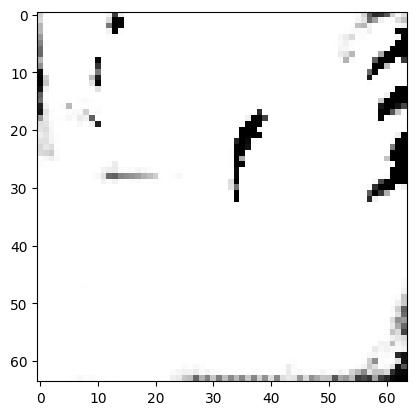

tensor([[3.0440e-03, 8.0710e-03, 5.1706e-03, 1.9858e-03, 1.1454e-02, 9.3152e-03,
         6.3375e-04, 3.4551e-02, 2.0073e-04, 7.9671e-01, 2.0904e-03, 2.3627e-03,
         8.8492e-04, 4.9332e-05, 2.2514e-04, 4.1601e-02, 1.6113e-03, 5.1277e-04,
         1.4279e-03, 4.0590e-03, 6.8268e-04, 3.2971e-04, 4.8799e-05, 2.0222e-03,
         6.1388e-04, 4.7417e-03, 4.1789e-03, 6.5728e-03, 1.3164e-02, 1.2761e-03,
         3.6573e-04, 1.7369e-02, 1.4119e-03, 6.1535e-04, 6.6579e-03, 2.1859e-04,
         8.4439e-04, 6.6877e-03, 1.3516e-03, 4.8864e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22726388275623322
tensor([[3.0128e-03, 8.1629e-03, 5.1459e-03, 1.9959e-03, 1.1413e-02, 9.2808e-03,
         6.3365e-04, 3.3780e-02, 2.0371e-04, 7.9727e-01, 2.0768e-03, 2.3780e-03,
         8.9610e-04, 5.0030e-05, 2.2645e-04, 4.1387e-02, 1.6098e-03, 5.0954e-04,
         1.4379e-03, 4.0763e-03, 6.8531e-04, 3.2735e-04, 4.9551e-05, 2.0081e-03,
         6.1497e-04, 4.7785e-03, 4.2438e-0

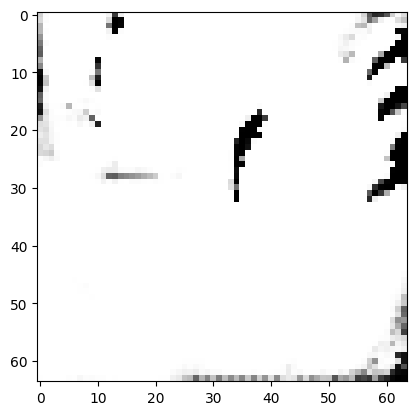

tensor([[3.0177e-03, 8.0106e-03, 5.1057e-03, 1.9447e-03, 1.1400e-02, 9.2414e-03,
         6.3563e-04, 3.3704e-02, 1.9774e-04, 7.9866e-01, 2.0572e-03, 2.3451e-03,
         8.8671e-04, 4.8685e-05, 2.1938e-04, 4.1287e-02, 1.5857e-03, 5.0750e-04,
         1.4215e-03, 4.0293e-03, 6.7296e-04, 3.2484e-04, 4.8518e-05, 2.0042e-03,
         6.0779e-04, 4.7066e-03, 4.2316e-03, 6.4809e-03, 1.3185e-02, 1.2520e-03,
         3.6367e-04, 1.7219e-02, 1.4092e-03, 6.0620e-04, 6.6544e-03, 2.1595e-04,
         8.4243e-04, 6.6548e-03, 1.3355e-03, 4.8793e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22482137382030487
tensor([[3.0030e-03, 7.9677e-03, 5.1520e-03, 1.9668e-03, 1.1306e-02, 9.1325e-03,
         6.2224e-04, 3.4249e-02, 2.0049e-04, 7.9927e-01, 2.0785e-03, 2.3269e-03,
         8.7833e-04, 4.8607e-05, 2.1990e-04, 4.0880e-02, 1.5742e-03, 5.0322e-04,
         1.4073e-03, 3.9896e-03, 6.7101e-04, 3.2738e-04, 4.7916e-05, 1.9846e-03,
         6.0160e-04, 4.7430e-03, 4.0980e-0

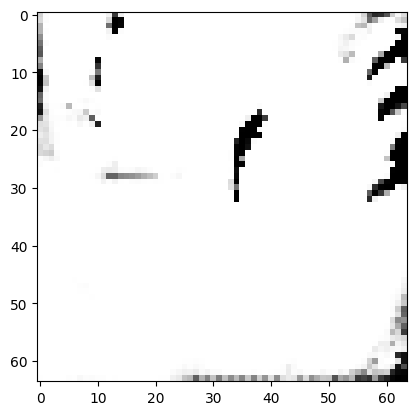

tensor([[2.9662e-03, 7.8872e-03, 5.1240e-03, 1.9492e-03, 1.1201e-02, 9.0160e-03,
         6.1279e-04, 3.3595e-02, 2.0065e-04, 8.0116e-01, 2.0665e-03, 2.3151e-03,
         8.7489e-04, 4.8118e-05, 2.1449e-04, 4.0447e-02, 1.5494e-03, 4.9559e-04,
         1.3957e-03, 3.9384e-03, 6.6622e-04, 3.2447e-04, 4.7591e-05, 1.9572e-03,
         5.9611e-04, 4.7636e-03, 4.0891e-03, 6.4602e-03, 1.3136e-02, 1.2607e-03,
         3.6365e-04, 1.6783e-02, 1.3994e-03, 5.9966e-04, 6.5080e-03, 2.1350e-04,
         8.2416e-04, 6.7497e-03, 1.3357e-03, 4.8681e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.22169950604438782
tensor([[2.9499e-03, 7.9385e-03, 5.0719e-03, 1.9345e-03, 1.1152e-02, 8.9953e-03,
         6.1445e-04, 3.3047e-02, 2.0045e-04, 8.0157e-01, 2.0512e-03, 2.3251e-03,
         8.7897e-04, 4.8261e-05, 2.1434e-04, 4.0544e-02, 1.5416e-03, 4.9431e-04,
         1.4021e-03, 3.9495e-03, 6.6552e-04, 3.2249e-04, 4.7806e-05, 1.9457e-03,
         5.9145e-04, 4.7244e-03, 4.1569e-0

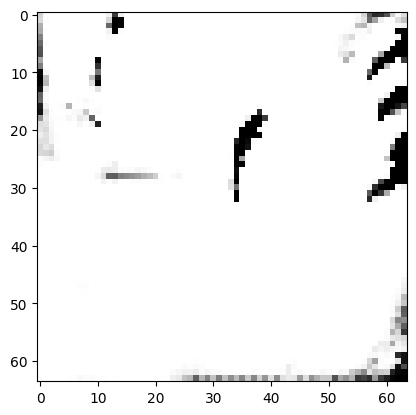

tensor([[2.8966e-03, 7.9170e-03, 5.0604e-03, 1.9171e-03, 1.1168e-02, 8.9493e-03,
         6.0979e-04, 3.2300e-02, 2.0121e-04, 8.0318e-01, 2.0158e-03, 2.3159e-03,
         8.8110e-04, 4.8045e-05, 2.1051e-04, 4.0178e-02, 1.5239e-03, 4.8954e-04,
         1.3909e-03, 3.9166e-03, 6.6324e-04, 3.1799e-04, 4.7793e-05, 1.9135e-03,
         5.8935e-04, 4.7418e-03, 4.1641e-03, 6.3852e-03, 1.3132e-02, 1.2488e-03,
         3.6388e-04, 1.6747e-02, 1.3896e-03, 5.9067e-04, 6.5878e-03, 2.1130e-04,
         8.1927e-04, 6.6656e-03, 1.3144e-03, 4.9404e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2191789150238037
tensor([[2.9217e-03, 7.7871e-03, 5.1020e-03, 1.9179e-03, 1.1069e-02, 8.9173e-03,
         5.9962e-04, 3.3404e-02, 2.0036e-04, 8.0342e-01, 2.0336e-03, 2.2715e-03,
         8.5725e-04, 4.6813e-05, 2.0895e-04, 4.0210e-02, 1.5063e-03, 4.8428e-04,
         1.3742e-03, 3.8645e-03, 6.5390e-04, 3.1929e-04, 4.5920e-05, 1.8964e-03,
         5.7619e-04, 4.6798e-03, 3.9864e-03

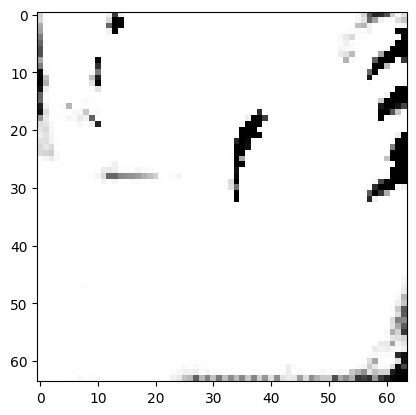

tensor([[2.9075e-03, 7.7356e-03, 5.1083e-03, 1.9157e-03, 1.0973e-02, 8.8882e-03,
         5.9308e-04, 3.2968e-02, 2.0085e-04, 8.0484e-01, 2.0074e-03, 2.2532e-03,
         8.5127e-04, 4.6074e-05, 2.0418e-04, 3.9901e-02, 1.4840e-03, 4.7868e-04,
         1.3660e-03, 3.8287e-03, 6.4686e-04, 3.1581e-04, 4.5134e-05, 1.8561e-03,
         5.7058e-04, 4.6582e-03, 3.9853e-03, 6.3494e-03, 1.3041e-02, 1.2405e-03,
         3.5118e-04, 1.6228e-02, 1.3487e-03, 5.7985e-04, 6.4118e-03, 2.0540e-04,
         7.9207e-04, 6.6118e-03, 1.3010e-03, 4.9083e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21710768342018127
tensor([[2.8320e-03, 7.8377e-03, 5.0631e-03, 1.9063e-03, 1.1039e-02, 8.8369e-03,
         5.9698e-04, 3.1831e-02, 2.0345e-04, 8.0547e-01, 1.9906e-03, 2.2912e-03,
         8.7113e-04, 4.7396e-05, 2.0578e-04, 3.9636e-02, 1.4941e-03, 4.8062e-04,
         1.3710e-03, 3.8639e-03, 6.5685e-04, 3.1362e-04, 4.6879e-05, 1.8490e-03,
         5.7682e-04, 4.7313e-03, 4.0917e-0

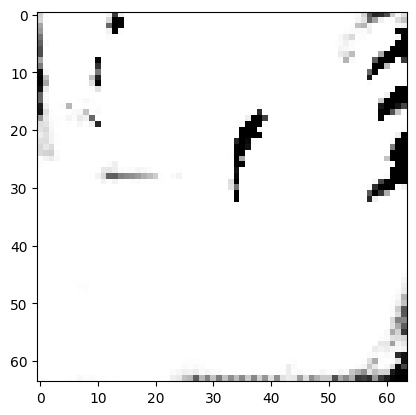

tensor([[2.8028e-03, 7.7314e-03, 5.0486e-03, 1.8743e-03, 1.1000e-02, 8.8023e-03,
         5.9546e-04, 3.1579e-02, 2.0155e-04, 8.0650e-01, 1.9792e-03, 2.2838e-03,
         8.6660e-04, 4.6995e-05, 2.0212e-04, 3.9552e-02, 1.4816e-03, 4.7762e-04,
         1.3597e-03, 3.8436e-03, 6.5271e-04, 3.1242e-04, 4.6506e-05, 1.8311e-03,
         5.7054e-04, 4.7062e-03, 4.0883e-03, 6.3166e-03, 1.3064e-02, 1.2330e-03,
         3.5883e-04, 1.6348e-02, 1.3699e-03, 5.7848e-04, 6.4542e-03, 2.0634e-04,
         7.9930e-04, 6.5724e-03, 1.2897e-03, 4.9697e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21504727005958557
tensor([[2.8404e-03, 7.5933e-03, 5.0544e-03, 1.8729e-03, 1.0875e-02, 8.7768e-03,
         5.8448e-04, 3.2320e-02, 1.9934e-04, 8.0731e-01, 1.9885e-03, 2.2328e-03,
         8.4332e-04, 4.5459e-05, 1.9987e-04, 3.9486e-02, 1.4572e-03, 4.7181e-04,
         1.3398e-03, 3.7866e-03, 6.3947e-04, 3.1189e-04, 4.4381e-05, 1.8176e-03,
         5.5979e-04, 4.6277e-03, 3.9429e-0

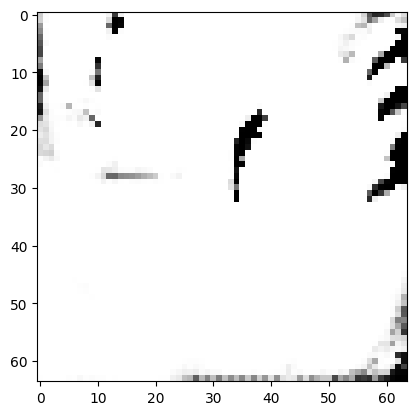

tensor([[2.8260e-03, 7.3420e-03, 5.0482e-03, 1.8364e-03, 1.0719e-02, 8.6958e-03,
         5.7960e-04, 3.2432e-02, 1.9442e-04, 8.0896e-01, 2.0001e-03, 2.1914e-03,
         8.2990e-04, 4.4221e-05, 1.9454e-04, 3.9200e-02, 1.4385e-03, 4.6523e-04,
         1.3165e-03, 3.7125e-03, 6.2753e-04, 3.1213e-04, 4.3152e-05, 1.8004e-03,
         5.4783e-04, 4.6001e-03, 3.8722e-03, 6.2340e-03, 1.2936e-02, 1.2035e-03,
         3.4277e-04, 1.5843e-02, 1.3400e-03, 5.6588e-04, 6.1130e-03, 2.0051e-04,
         7.7810e-04, 6.5411e-03, 1.2809e-03, 4.7871e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.21199999749660492
tensor([[2.7699e-03, 7.4818e-03, 5.0006e-03, 1.8361e-03, 1.0759e-02, 8.6485e-03,
         5.8385e-04, 3.1204e-02, 1.9708e-04, 8.0946e-01, 1.9808e-03, 2.2350e-03,
         8.5068e-04, 4.5547e-05, 1.9655e-04, 3.9024e-02, 1.4425e-03, 4.6791e-04,
         1.3234e-03, 3.7536e-03, 6.3637e-04, 3.1005e-04, 4.4684e-05, 1.7925e-03,
         5.5169e-04, 4.6591e-03, 4.0002e-0

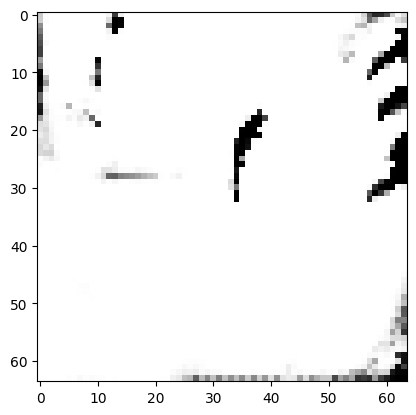

tensor([[2.7089e-03, 7.4089e-03, 4.9767e-03, 1.8216e-03, 1.0597e-02, 8.5478e-03,
         5.7183e-04, 3.0870e-02, 1.9821e-04, 8.1113e-01, 1.9704e-03, 2.2286e-03,
         8.3961e-04, 4.5290e-05, 1.9413e-04, 3.8751e-02, 1.4263e-03, 4.5849e-04,
         1.3126e-03, 3.7063e-03, 6.3235e-04, 3.0762e-04, 4.4183e-05, 1.7472e-03,
         5.3978e-04, 4.6484e-03, 3.9623e-03, 6.1768e-03, 1.2855e-02, 1.2065e-03,
         3.5201e-04, 1.6105e-02, 1.3375e-03, 5.6513e-04, 6.1595e-03, 2.0126e-04,
         7.6967e-04, 6.5129e-03, 1.2640e-03, 4.8507e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20932862162590027
tensor([[2.7541e-03, 7.1512e-03, 5.0071e-03, 1.7905e-03, 1.0517e-02, 8.5434e-03,
         5.6503e-04, 3.2338e-02, 1.9227e-04, 8.1089e-01, 2.0100e-03, 2.1820e-03,
         8.1103e-04, 4.3611e-05, 1.9069e-04, 3.9053e-02, 1.4177e-03, 4.5516e-04,
         1.2874e-03, 3.6338e-03, 6.2090e-04, 3.1122e-04, 4.2189e-05, 1.7575e-03,
         5.2745e-04, 4.5620e-03, 3.7850e-0

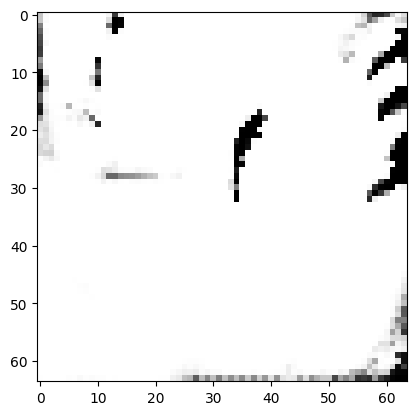

tensor([[2.6641e-03, 7.1279e-03, 4.9540e-03, 1.7743e-03, 1.0403e-02, 8.3761e-03,
         5.5563e-04, 3.1536e-02, 1.9391e-04, 8.1294e-01, 1.9901e-03, 2.1905e-03,
         8.1077e-04, 4.3942e-05, 1.8946e-04, 3.8603e-02, 1.4031e-03, 4.4709e-04,
         1.2777e-03, 3.6084e-03, 6.2159e-04, 3.0862e-04, 4.2499e-05, 1.7192e-03,
         5.1965e-04, 4.5855e-03, 3.7736e-03, 6.1189e-03, 1.2635e-02, 1.1841e-03,
         3.4275e-04, 1.5966e-02, 1.3228e-03, 5.5874e-04, 5.8445e-03, 1.9809e-04,
         7.4962e-04, 6.4704e-03, 1.2511e-03, 4.7000e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2070997655391693
tensor([[2.6146e-03, 7.3332e-03, 4.9325e-03, 1.7956e-03, 1.0499e-02, 8.3942e-03,
         5.6183e-04, 3.0077e-02, 1.9912e-04, 8.1331e-01, 1.9550e-03, 2.2393e-03,
         8.3890e-04, 4.5463e-05, 1.9179e-04, 3.8258e-02, 1.4120e-03, 4.5031e-04,
         1.2924e-03, 3.6523e-03, 6.3208e-04, 3.0520e-04, 4.4405e-05, 1.7042e-03,
         5.3075e-04, 4.6822e-03, 3.9491e-03

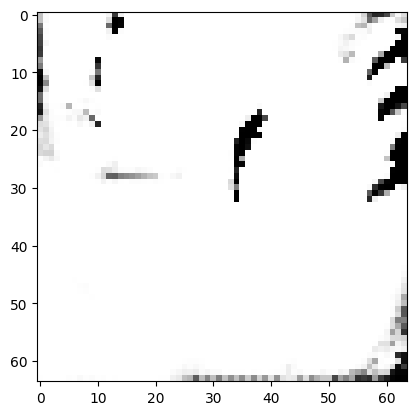

tensor([[2.5570e-03, 7.3390e-03, 4.8868e-03, 1.7833e-03, 1.0424e-02, 8.2872e-03,
         5.5797e-04, 2.9571e-02, 2.0029e-04, 8.1424e-01, 1.9570e-03, 2.2634e-03,
         8.4430e-04, 4.5904e-05, 1.9191e-04, 3.8057e-02, 1.4039e-03, 4.4539e-04,
         1.2888e-03, 3.6193e-03, 6.3622e-04, 3.0558e-04, 4.5013e-05, 1.6868e-03,
         5.2540e-04, 4.7313e-03, 3.9660e-03, 6.1062e-03, 1.2668e-02, 1.1988e-03,
         3.6185e-04, 1.6342e-02, 1.3342e-03, 5.6282e-04, 6.0366e-03, 2.0214e-04,
         7.5704e-04, 6.4883e-03, 1.2479e-03, 4.8310e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20549626648426056
tensor([[2.5843e-03, 7.0875e-03, 4.8715e-03, 1.7546e-03, 1.0238e-02, 8.1807e-03,
         5.4485e-04, 3.0686e-02, 1.9393e-04, 8.1522e-01, 1.9809e-03, 2.2012e-03,
         8.0895e-04, 4.3926e-05, 1.8712e-04, 3.8131e-02, 1.3808e-03, 4.3717e-04,
         1.2646e-03, 3.5368e-03, 6.2052e-04, 3.0663e-04, 4.2580e-05, 1.6820e-03,
         5.0948e-04, 4.6182e-03, 3.7704e-0

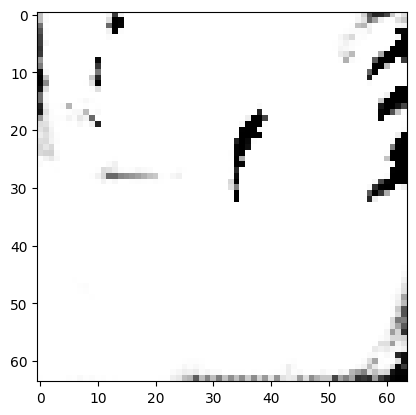

tensor([[2.5717e-03, 7.0506e-03, 4.8250e-03, 1.7373e-03, 1.0169e-02, 8.1242e-03,
         5.4074e-04, 3.0555e-02, 1.9215e-04, 8.1606e-01, 1.9774e-03, 2.1921e-03,
         8.0287e-04, 4.3395e-05, 1.8572e-04, 3.8110e-02, 1.3655e-03, 4.3299e-04,
         1.2529e-03, 3.4951e-03, 6.1619e-04, 3.0528e-04, 4.2036e-05, 1.6705e-03,
         5.0308e-04, 4.5979e-03, 3.7458e-03, 5.9992e-03, 1.2416e-02, 1.1670e-03,
         3.4425e-04, 1.6112e-02, 1.3054e-03, 5.5072e-04, 5.7241e-03, 1.9676e-04,
         7.3332e-04, 6.4499e-03, 1.2274e-03, 4.6096e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20326875150203705
tensor([[2.5500e-03, 7.1629e-03, 4.7995e-03, 1.7385e-03, 1.0238e-02, 8.1532e-03,
         5.4826e-04, 2.9688e-02, 1.9315e-04, 8.1630e-01, 1.9508e-03, 2.2187e-03,
         8.1844e-04, 4.4037e-05, 1.8617e-04, 3.8014e-02, 1.3682e-03, 4.3578e-04,
         1.2638e-03, 3.5163e-03, 6.2070e-04, 3.0260e-04, 4.3012e-05, 1.6629e-03,
         5.0696e-04, 4.6225e-03, 3.8678e-0

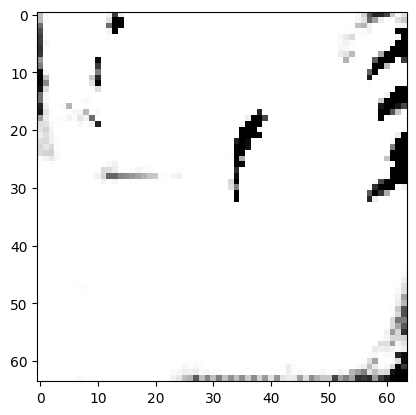

tensor([[2.5182e-03, 7.1033e-03, 4.7709e-03, 1.7308e-03, 1.0119e-02, 8.0350e-03,
         5.3785e-04, 2.9629e-02, 1.9354e-04, 8.1746e-01, 1.9575e-03, 2.2092e-03,
         8.1067e-04, 4.3753e-05, 1.8548e-04, 3.7704e-02, 1.3528e-03, 4.2932e-04,
         1.2493e-03, 3.4730e-03, 6.1789e-04, 3.0260e-04, 4.2602e-05, 1.6446e-03,
         4.9943e-04, 4.6348e-03, 3.8085e-03, 5.9543e-03, 1.2368e-02, 1.1672e-03,
         3.4971e-04, 1.6265e-02, 1.3038e-03, 5.4835e-04, 5.7565e-03, 1.9738e-04,
         7.2953e-04, 6.4467e-03, 1.2206e-03, 4.6326e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.20155708491802216
tensor([[2.5556e-03, 7.0048e-03, 4.7636e-03, 1.7138e-03, 1.0071e-02, 8.0449e-03,
         5.3862e-04, 3.0167e-02, 1.8885e-04, 8.1770e-01, 1.9561e-03, 2.1735e-03,
         7.9503e-04, 4.2615e-05, 1.8235e-04, 3.7861e-02, 1.3428e-03, 4.2823e-04,
         1.2441e-03, 3.4447e-03, 6.0751e-04, 3.0204e-04, 4.1365e-05, 1.6456e-03,
         4.9368e-04, 4.5452e-03, 3.7571e-0

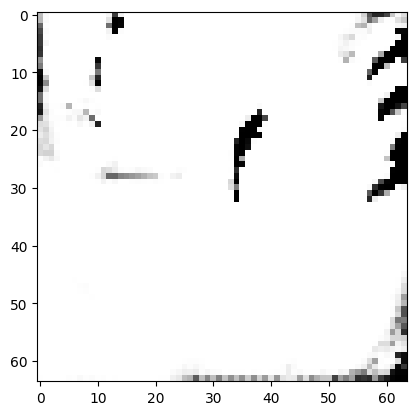

tensor([[2.5224e-03, 7.0425e-03, 4.7226e-03, 1.7100e-03, 1.0032e-02, 7.9645e-03,
         5.3517e-04, 2.9673e-02, 1.9016e-04, 8.1856e-01, 1.9555e-03, 2.1803e-03,
         8.0038e-04, 4.2955e-05, 1.8347e-04, 3.7561e-02, 1.3334e-03, 4.2654e-04,
         1.2362e-03, 3.4365e-03, 6.0866e-04, 3.0108e-04, 4.1728e-05, 1.6349e-03,
         4.9194e-04, 4.5821e-03, 3.7738e-03, 5.8997e-03, 1.2275e-02, 1.1529e-03,
         3.4434e-04, 1.6186e-02, 1.2951e-03, 5.4364e-04, 5.6660e-03, 1.9533e-04,
         7.2228e-04, 6.4125e-03, 1.2108e-03, 4.5569e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.2002122700214386
tensor([[2.5236e-03, 6.9554e-03, 4.7071e-03, 1.6882e-03, 9.9890e-03, 7.9461e-03,
         5.3368e-04, 2.9934e-02, 1.8713e-04, 8.1888e-01, 1.9538e-03, 2.1621e-03,
         7.8977e-04, 4.2313e-05, 1.8150e-04, 3.7716e-02, 1.3278e-03, 4.2414e-04,
         1.2327e-03, 3.4163e-03, 6.0376e-04, 3.0093e-04, 4.1113e-05, 1.6336e-03,
         4.8616e-04, 4.5252e-03, 3.7341e-03

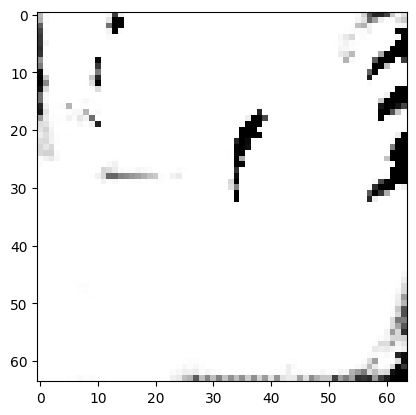

tensor([[2.4866e-03, 6.9253e-03, 4.6679e-03, 1.6725e-03, 9.9353e-03, 7.8564e-03,
         5.2693e-04, 2.9614e-02, 1.8642e-04, 8.1980e-01, 1.9474e-03, 2.1658e-03,
         7.8572e-04, 4.2256e-05, 1.8095e-04, 3.7607e-02, 1.3202e-03, 4.2034e-04,
         1.2259e-03, 3.3915e-03, 6.0415e-04, 3.0065e-04, 4.1193e-05, 1.6244e-03,
         4.8144e-04, 4.5285e-03, 3.7251e-03, 5.8257e-03, 1.2192e-02, 1.1342e-03,
         3.3823e-04, 1.6119e-02, 1.2905e-03, 5.3896e-04, 5.5631e-03, 1.9271e-04,
         7.1478e-04, 6.3518e-03, 1.1955e-03, 4.4782e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19869394600391388
tensor([[2.4955e-03, 6.9477e-03, 4.6713e-03, 1.6805e-03, 9.9138e-03, 7.8618e-03,
         5.2706e-04, 2.9463e-02, 1.8681e-04, 8.2001e-01, 1.9400e-03, 2.1590e-03,
         7.8692e-04, 4.2161e-05, 1.8081e-04, 3.7558e-02, 1.3169e-03, 4.1981e-04,
         1.2289e-03, 3.3920e-03, 6.0254e-04, 2.9944e-04, 4.1082e-05, 1.6219e-03,
         4.8179e-04, 4.5236e-03, 3.7336e-0

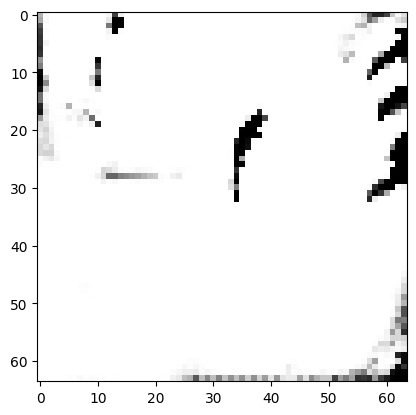

tensor([[2.4712e-03, 6.9272e-03, 4.6433e-03, 1.6694e-03, 9.8599e-03, 7.8047e-03,
         5.2235e-04, 2.9172e-02, 1.8674e-04, 8.2082e-01, 1.9322e-03, 2.1558e-03,
         7.8385e-04, 4.2048e-05, 1.8045e-04, 3.7485e-02, 1.3093e-03, 4.1655e-04,
         1.2238e-03, 3.3766e-03, 6.0178e-04, 2.9851e-04, 4.1030e-05, 1.6125e-03,
         4.7797e-04, 4.5159e-03, 3.7237e-03, 5.7703e-03, 1.2179e-02, 1.1353e-03,
         3.3761e-04, 1.6031e-02, 1.2796e-03, 5.3679e-04, 5.5867e-03, 1.9142e-04,
         7.0907e-04, 6.3240e-03, 1.1905e-03, 4.4780e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19745536148548126
tensor([[2.4768e-03, 6.8433e-03, 4.6314e-03, 1.6513e-03, 9.8375e-03, 7.7831e-03,
         5.2234e-04, 2.9437e-02, 1.8350e-04, 8.2112e-01, 1.9342e-03, 2.1405e-03,
         7.7530e-04, 4.1454e-05, 1.7840e-04, 3.7530e-02, 1.3036e-03, 4.1567e-04,
         1.2163e-03, 3.3524e-03, 5.9661e-04, 2.9866e-04, 4.0441e-05, 1.6122e-03,
         4.7324e-04, 4.4703e-03, 3.6909e-0

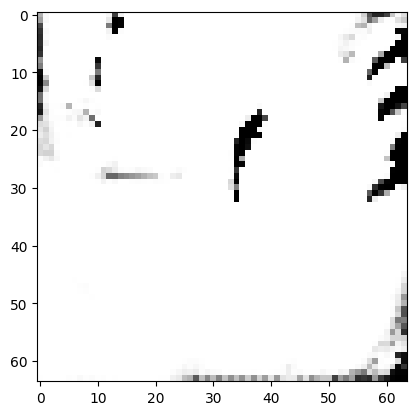

tensor([[2.4597e-03, 6.8102e-03, 4.6004e-03, 1.6413e-03, 9.7552e-03, 7.6943e-03,
         5.1583e-04, 2.9165e-02, 1.8250e-04, 8.2214e-01, 1.9258e-03, 2.1306e-03,
         7.6760e-04, 4.1145e-05, 1.7751e-04, 3.7512e-02, 1.2935e-03, 4.1159e-04,
         1.2120e-03, 3.3220e-03, 5.9485e-04, 2.9758e-04, 4.0165e-05, 1.6033e-03,
         4.6782e-04, 4.4452e-03, 3.6577e-03, 5.7031e-03, 1.2091e-02, 1.1180e-03,
         3.3059e-04, 1.5884e-02, 1.2686e-03, 5.3063e-04, 5.4760e-03, 1.8874e-04,
         7.0163e-04, 6.2797e-03, 1.1765e-03, 4.3897e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19584816694259644
tensor([[2.4564e-03, 6.7864e-03, 4.5914e-03, 1.6383e-03, 9.7060e-03, 7.6594e-03,
         5.1451e-04, 2.9150e-02, 1.8182e-04, 8.2244e-01, 1.9279e-03, 2.1265e-03,
         7.6417e-04, 4.1038e-05, 1.7712e-04, 3.7491e-02, 1.2901e-03, 4.1019e-04,
         1.2123e-03, 3.3136e-03, 5.9378e-04, 2.9771e-04, 4.0056e-05, 1.6015e-03,
         4.6512e-04, 4.4356e-03, 3.6464e-0

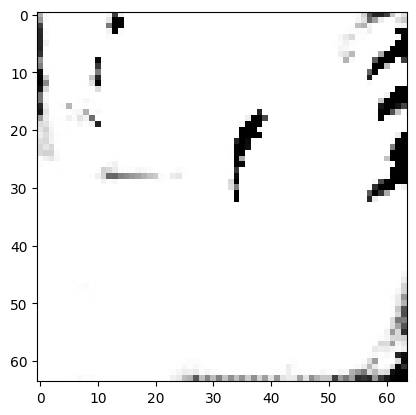

tensor([[2.4282e-03, 6.7573e-03, 4.5638e-03, 1.6319e-03, 9.6371e-03, 7.5644e-03,
         5.1063e-04, 2.8650e-02, 1.8134e-04, 8.2359e-01, 1.9207e-03, 2.1296e-03,
         7.6216e-04, 4.1015e-05, 1.7624e-04, 3.7289e-02, 1.2810e-03, 4.0739e-04,
         1.2061e-03, 3.2886e-03, 5.9415e-04, 2.9683e-04, 4.0135e-05, 1.5932e-03,
         4.6096e-04, 4.4441e-03, 3.6371e-03, 5.6427e-03, 1.2075e-02, 1.1162e-03,
         3.3153e-04, 1.5835e-02, 1.2664e-03, 5.2746e-04, 5.4281e-03, 1.8810e-04,
         6.9663e-04, 6.2925e-03, 1.1702e-03, 4.3516e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1940876990556717
tensor([[2.4301e-03, 6.7280e-03, 4.5550e-03, 1.6262e-03, 9.6027e-03, 7.5427e-03,
         5.0905e-04, 2.8663e-02, 1.8014e-04, 8.2390e-01, 1.9208e-03, 2.1229e-03,
         7.5768e-04, 4.0759e-05, 1.7541e-04, 3.7308e-02, 1.2773e-03, 4.0626e-04,
         1.2043e-03, 3.2749e-03, 5.9212e-04, 2.9653e-04, 3.9871e-05, 1.5917e-03,
         4.5804e-04, 4.4235e-03, 3.6219e-03

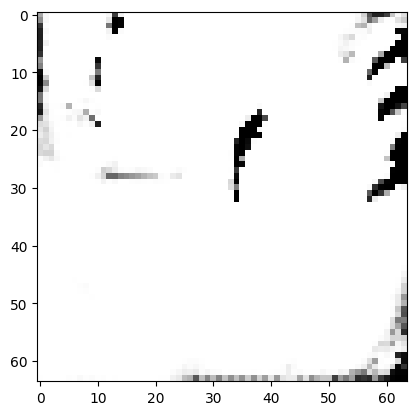

tensor([[2.4079e-03, 6.7177e-03, 4.5441e-03, 1.6262e-03, 9.5297e-03, 7.4757e-03,
         5.0469e-04, 2.8249e-02, 1.8053e-04, 8.2483e-01, 1.9141e-03, 2.1237e-03,
         7.5605e-04, 4.0743e-05, 1.7493e-04, 3.7131e-02, 1.2704e-03, 4.0347e-04,
         1.2010e-03, 3.2582e-03, 5.9237e-04, 2.9569e-04, 3.9904e-05, 1.5822e-03,
         4.5472e-04, 4.4335e-03, 3.6142e-03, 5.5886e-03, 1.2058e-02, 1.1147e-03,
         3.3111e-04, 1.5716e-02, 1.2584e-03, 5.2427e-04, 5.3957e-03, 1.8666e-04,
         6.9059e-04, 6.2921e-03, 1.1649e-03, 4.3253e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19257627427577972
tensor([[2.4332e-03, 6.6210e-03, 4.5396e-03, 1.6100e-03, 9.4658e-03, 7.4704e-03,
         5.0346e-04, 2.8698e-02, 1.7689e-04, 8.2501e-01, 1.9163e-03, 2.0961e-03,
         7.4299e-04, 3.9861e-05, 1.7229e-04, 3.7346e-02, 1.2626e-03, 4.0161e-04,
         1.1987e-03, 3.2323e-03, 5.8421e-04, 2.9566e-04, 3.8939e-05, 1.5837e-03,
         4.4864e-04, 4.3546e-03, 3.5671e-0

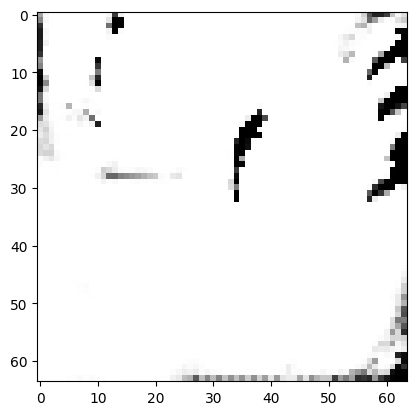

tensor([[2.4182e-03, 6.5960e-03, 4.5146e-03, 1.6012e-03, 9.3934e-03, 7.4200e-03,
         5.0173e-04, 2.8413e-02, 1.7586e-04, 8.2579e-01, 1.9119e-03, 2.0956e-03,
         7.3911e-04, 3.9692e-05, 1.7120e-04, 3.7272e-02, 1.2553e-03, 3.9945e-04,
         1.1975e-03, 3.2171e-03, 5.8325e-04, 2.9485e-04, 3.8843e-05, 1.5745e-03,
         4.4421e-04, 4.3380e-03, 3.5711e-03, 5.5178e-03, 1.2042e-02, 1.0946e-03,
         3.2243e-04, 1.5481e-02, 1.2484e-03, 5.1773e-04, 5.2943e-03, 1.8324e-04,
         6.8346e-04, 6.2457e-03, 1.1476e-03, 4.2521e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19141286611557007
tensor([[2.4056e-03, 6.5992e-03, 4.5115e-03, 1.6027e-03, 9.3842e-03, 7.3858e-03,
         4.9891e-04, 2.8335e-02, 1.7642e-04, 8.2590e-01, 1.9194e-03, 2.1027e-03,
         7.4038e-04, 3.9882e-05, 1.7172e-04, 3.7206e-02, 1.2567e-03, 3.9877e-04,
         1.1948e-03, 3.2127e-03, 5.8579e-04, 2.9547e-04, 3.9047e-05, 1.5762e-03,
         4.4382e-04, 4.3643e-03, 3.5605e-0

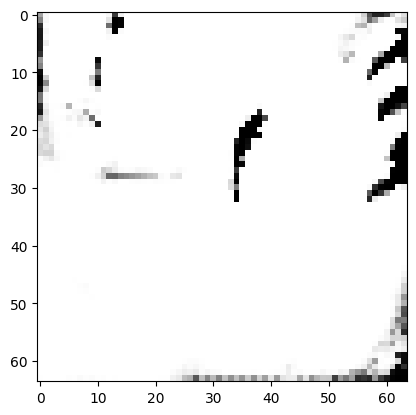

tensor([[2.4050e-03, 6.5845e-03, 4.4982e-03, 1.5946e-03, 9.3328e-03, 7.3754e-03,
         4.9816e-04, 2.8203e-02, 1.7535e-04, 8.2648e-01, 1.9092e-03, 2.0945e-03,
         7.3582e-04, 3.9506e-05, 1.7035e-04, 3.7198e-02, 1.2470e-03, 3.9745e-04,
         1.1928e-03, 3.2007e-03, 5.8202e-04, 2.9424e-04, 3.8655e-05, 1.5666e-03,
         4.3972e-04, 4.3271e-03, 3.5612e-03, 5.4863e-03, 1.2012e-02, 1.0940e-03,
         3.2220e-04, 1.5427e-02, 1.2448e-03, 5.1571e-04, 5.2723e-03, 1.8224e-04,
         6.7868e-04, 6.2430e-03, 1.1441e-03, 4.2409e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.19058531522750854
tensor([[2.3966e-03, 6.5764e-03, 4.4935e-03, 1.5914e-03, 9.3009e-03, 7.3542e-03,
         4.9608e-04, 2.8211e-02, 1.7542e-04, 8.2663e-01, 1.9068e-03, 2.0947e-03,
         7.3353e-04, 3.9459e-05, 1.7016e-04, 3.7229e-02, 1.2449e-03, 3.9591e-04,
         1.1927e-03, 3.1913e-03, 5.8158e-04, 2.9412e-04, 3.8590e-05, 1.5609e-03,
         4.3695e-04, 4.3165e-03, 3.5540e-0

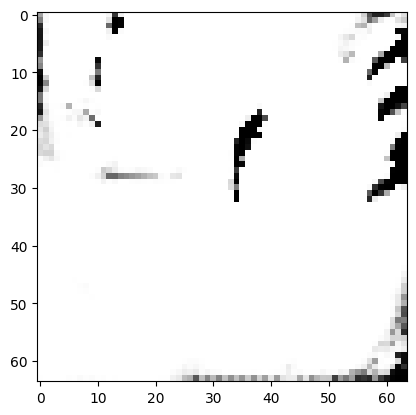

tensor([[2.3970e-03, 6.5487e-03, 4.4803e-03, 1.5837e-03, 9.2546e-03, 7.3343e-03,
         4.9473e-04, 2.8147e-02, 1.7414e-04, 8.2711e-01, 1.9055e-03, 2.0858e-03,
         7.2892e-04, 3.9145e-05, 1.6891e-04, 3.7212e-02, 1.2378e-03, 3.9469e-04,
         1.1890e-03, 3.1794e-03, 5.7854e-04, 2.9349e-04, 3.8242e-05, 1.5561e-03,
         4.3390e-04, 4.2923e-03, 3.5455e-03, 5.4500e-03, 1.1984e-02, 1.0885e-03,
         3.1954e-04, 1.5347e-02, 1.2384e-03, 5.1321e-04, 5.2309e-03, 1.8073e-04,
         6.7271e-04, 6.2193e-03, 1.1364e-03, 4.2200e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.189822256565094
tensor([[2.3795e-03, 6.5723e-03, 4.4802e-03, 1.5867e-03, 9.2550e-03, 7.3168e-03,
         4.9324e-04, 2.8009e-02, 1.7537e-04, 8.2721e-01, 1.9011e-03, 2.0938e-03,
         7.3132e-04, 3.9361e-05, 1.6941e-04, 3.7146e-02, 1.2389e-03, 3.9401e-04,
         1.1890e-03, 3.1762e-03, 5.8078e-04, 2.9325e-04, 3.8503e-05, 1.5498e-03,
         4.3374e-04, 4.3122e-03, 3.5507e-03,

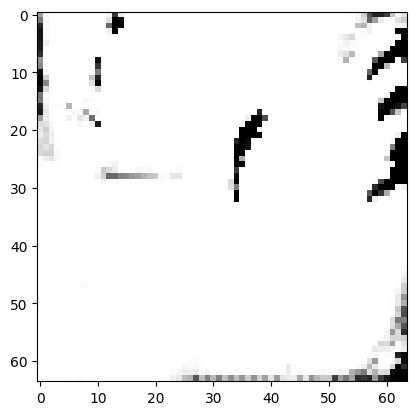

tensor([[2.3926e-03, 6.5207e-03, 4.4713e-03, 1.5747e-03, 9.1922e-03, 7.3095e-03,
         4.9201e-04, 2.8154e-02, 1.7298e-04, 8.2763e-01, 1.8989e-03, 2.0763e-03,
         7.2227e-04, 3.8742e-05, 1.6750e-04, 3.7243e-02, 1.2294e-03, 3.9243e-04,
         1.1857e-03, 3.1576e-03, 5.7457e-04, 2.9263e-04, 3.7758e-05, 1.5450e-03,
         4.2814e-04, 4.2518e-03, 3.5260e-03, 5.4211e-03, 1.1943e-02, 1.0826e-03,
         3.1632e-04, 1.5261e-02, 1.2287e-03, 5.1042e-04, 5.1948e-03, 1.7904e-04,
         6.6699e-04, 6.1856e-03, 1.1296e-03, 4.2031e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18918955326080322
tensor([[2.3771e-03, 6.5324e-03, 4.4668e-03, 1.5765e-03, 9.1949e-03, 7.2837e-03,
         4.9130e-04, 2.7989e-02, 1.7366e-04, 8.2777e-01, 1.9018e-03, 2.0844e-03,
         7.2552e-04, 3.8997e-05, 1.6803e-04, 3.7133e-02, 1.2310e-03, 3.9232e-04,
         1.1844e-03, 3.1598e-03, 5.7720e-04, 2.9289e-04, 3.8062e-05, 1.5449e-03,
         4.2875e-04, 4.2795e-03, 3.5313e-0

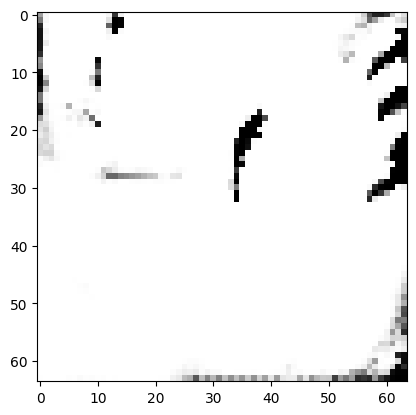

tensor([[2.3947e-03, 6.4797e-03, 4.4582e-03, 1.5641e-03, 9.1434e-03, 7.2841e-03,
         4.9117e-04, 2.8225e-02, 1.7100e-04, 8.2808e-01, 1.8968e-03, 2.0631e-03,
         7.1631e-04, 3.8320e-05, 1.6596e-04, 3.7272e-02, 1.2219e-03, 3.9106e-04,
         1.1821e-03, 3.1426e-03, 5.7004e-04, 2.9205e-04, 3.7261e-05, 1.5408e-03,
         4.2348e-04, 4.2105e-03, 3.5048e-03, 5.3951e-03, 1.1913e-02, 1.0746e-03,
         3.1319e-04, 1.5175e-02, 1.2231e-03, 5.0723e-04, 5.1472e-03, 1.7770e-04,
         6.6318e-04, 6.1591e-03, 1.1228e-03, 4.1697e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18864844739437103
tensor([[2.3735e-03, 6.5096e-03, 4.4511e-03, 1.5668e-03, 9.1522e-03, 7.2668e-03,
         4.9039e-04, 2.7958e-02, 1.7241e-04, 8.2827e-01, 1.8945e-03, 2.0762e-03,
         7.2052e-04, 3.8679e-05, 1.6680e-04, 3.7122e-02, 1.2230e-03, 3.9090e-04,
         1.1813e-03, 3.1487e-03, 5.7343e-04, 2.9187e-04, 3.7677e-05, 1.5359e-03,
         4.2459e-04, 4.2438e-03, 3.5261e-0

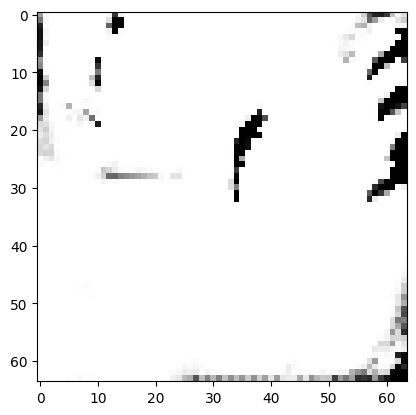

tensor([[2.3657e-03, 6.5037e-03, 4.4417e-03, 1.5638e-03, 9.1256e-03, 7.2418e-03,
         4.8903e-04, 2.7846e-02, 1.7206e-04, 8.2859e-01, 1.8933e-03, 2.0765e-03,
         7.1951e-04, 3.8618e-05, 1.6636e-04, 3.7086e-02, 1.2197e-03, 3.8986e-04,
         1.1790e-03, 3.1384e-03, 5.7293e-04, 2.9151e-04, 3.7605e-05, 1.5310e-03,
         4.2225e-04, 4.2392e-03, 3.5260e-03, 5.3878e-03, 1.1890e-02, 1.0789e-03,
         3.1669e-04, 1.5251e-02, 1.2250e-03, 5.0741e-04, 5.1560e-03, 1.7837e-04,
         6.6214e-04, 6.1724e-03, 1.1223e-03, 4.1841e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1880301982164383
tensor([[2.3827e-03, 6.4764e-03, 4.4387e-03, 1.5579e-03, 9.0994e-03, 7.2500e-03,
         4.8954e-04, 2.8018e-02, 1.7053e-04, 8.2864e-01, 1.8920e-03, 2.0627e-03,
         7.1441e-04, 3.8228e-05, 1.6532e-04, 3.7224e-02, 1.2151e-03, 3.8959e-04,
         1.1791e-03, 3.1312e-03, 5.6880e-04, 2.9115e-04, 3.7126e-05, 1.5315e-03,
         4.1986e-04, 4.1953e-03, 3.5093e-03

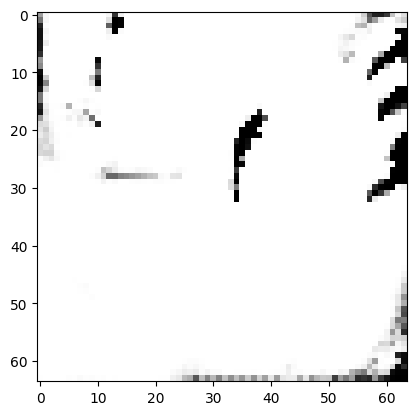

tensor([[2.3786e-03, 6.4632e-03, 4.4254e-03, 1.5519e-03, 9.0791e-03, 7.2317e-03,
         4.8919e-04, 2.7897e-02, 1.6975e-04, 8.2898e-01, 1.8888e-03, 2.0614e-03,
         7.1335e-04, 3.8098e-05, 1.6464e-04, 3.7199e-02, 1.2107e-03, 3.8900e-04,
         1.1760e-03, 3.1222e-03, 5.6753e-04, 2.9052e-04, 3.7003e-05, 1.5273e-03,
         4.1765e-04, 4.1809e-03, 3.5139e-03, 5.3571e-03, 1.1863e-02, 1.0685e-03,
         3.1220e-04, 1.5159e-02, 1.2172e-03, 5.0394e-04, 5.1190e-03, 1.7671e-04,
         6.5907e-04, 6.1346e-03, 1.1144e-03, 4.1525e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18755923211574554
tensor([[2.3619e-03, 6.4885e-03, 4.4328e-03, 1.5602e-03, 9.0958e-03, 7.2169e-03,
         4.8848e-04, 2.7710e-02, 1.7121e-04, 8.2907e-01, 1.8887e-03, 2.0724e-03,
         7.1805e-04, 3.8455e-05, 1.6533e-04, 3.7011e-02, 1.2144e-03, 3.8904e-04,
         1.1760e-03, 3.1257e-03, 5.7073e-04, 2.9074e-04, 3.7419e-05, 1.5249e-03,
         4.1969e-04, 4.2248e-03, 3.5279e-0

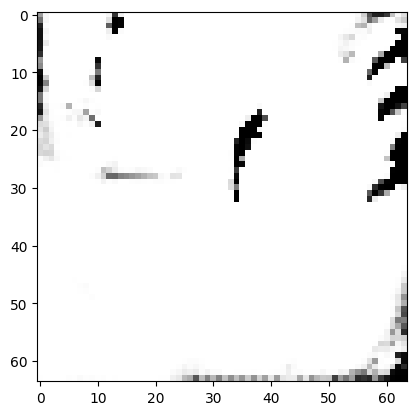

tensor([[2.3640e-03, 6.4676e-03, 4.4141e-03, 1.5505e-03, 9.0634e-03, 7.2017e-03,
         4.8846e-04, 2.7651e-02, 1.6974e-04, 8.2942e-01, 1.8841e-03, 2.0653e-03,
         7.1481e-04, 3.8161e-05, 1.6433e-04, 3.7081e-02, 1.2080e-03, 3.8822e-04,
         1.1743e-03, 3.1137e-03, 5.6800e-04, 2.8988e-04, 3.7120e-05, 1.5214e-03,
         4.1632e-04, 4.1889e-03, 3.5263e-03, 5.3481e-03, 1.1856e-02, 1.0682e-03,
         3.1352e-04, 1.5162e-02, 1.2168e-03, 5.0273e-04, 5.1216e-03, 1.7671e-04,
         6.5898e-04, 6.1404e-03, 1.1125e-03, 4.1557e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18703365325927734
tensor([[2.3770e-03, 6.4456e-03, 4.4172e-03, 1.5502e-03, 9.0407e-03, 7.2050e-03,
         4.8894e-04, 2.7767e-02, 1.6884e-04, 8.2946e-01, 1.8862e-03, 2.0574e-03,
         7.1195e-04, 3.7914e-05, 1.6354e-04, 3.7094e-02, 1.2055e-03, 3.8799e-04,
         1.1746e-03, 3.1083e-03, 5.6540e-04, 2.8993e-04, 3.6827e-05, 1.5219e-03,
         4.1489e-04, 4.1688e-03, 3.5174e-0

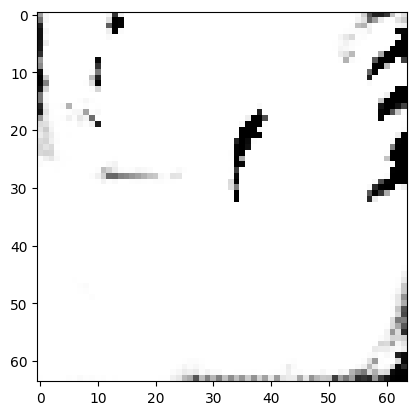

tensor([[2.3673e-03, 6.4491e-03, 4.4085e-03, 1.5478e-03, 9.0355e-03, 7.1873e-03,
         4.8834e-04, 2.7587e-02, 1.6884e-04, 8.2981e-01, 1.8796e-03, 2.0592e-03,
         7.1261e-04, 3.7916e-05, 1.6312e-04, 3.6998e-02, 1.2019e-03, 3.8772e-04,
         1.1712e-03, 3.1030e-03, 5.6474e-04, 2.8921e-04, 3.6819e-05, 1.5150e-03,
         4.1380e-04, 4.1666e-03, 3.5280e-03, 5.3319e-03, 1.1845e-02, 1.0635e-03,
         3.1224e-04, 1.5126e-02, 1.2125e-03, 5.0031e-04, 5.1031e-03, 1.7613e-04,
         6.5707e-04, 6.1384e-03, 1.1092e-03, 4.1440e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1865568608045578
tensor([[2.3608e-03, 6.4476e-03, 4.4014e-03, 1.5472e-03, 9.0232e-03, 7.1686e-03,
         4.8751e-04, 2.7541e-02, 1.6886e-04, 8.2985e-01, 1.8846e-03, 2.0638e-03,
         7.1304e-04, 3.8024e-05, 1.6343e-04, 3.6989e-02, 1.2030e-03, 3.8712e-04,
         1.1713e-03, 3.1016e-03, 5.6632e-04, 2.8970e-04, 3.6957e-05, 1.5169e-03,
         4.1355e-04, 4.1785e-03, 3.5277e-03

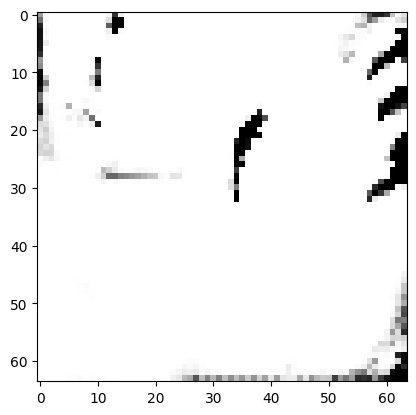

tensor([[2.3504e-03, 6.4515e-03, 4.3961e-03, 1.5470e-03, 9.0140e-03, 7.1490e-03,
         4.8664e-04, 2.7389e-02, 1.6894e-04, 8.3021e-01, 1.8801e-03, 2.0651e-03,
         7.1383e-04, 3.8052e-05, 1.6305e-04, 3.6862e-02, 1.2001e-03, 3.8647e-04,
         1.1686e-03, 3.0933e-03, 5.6569e-04, 2.8917e-04, 3.6979e-05, 1.5108e-03,
         4.1264e-04, 4.1848e-03, 3.5344e-03, 5.3266e-03, 1.1829e-02, 1.0644e-03,
         3.1429e-04, 1.5158e-02, 1.2140e-03, 4.9997e-04, 5.0915e-03, 1.7649e-04,
         6.5673e-04, 6.1532e-03, 1.1088e-03, 4.1390e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18607589602470398
tensor([[2.3613e-03, 6.4329e-03, 4.3925e-03, 1.5431e-03, 8.9938e-03, 7.1525e-03,
         4.8706e-04, 2.7464e-02, 1.6787e-04, 8.3031e-01, 1.8776e-03, 2.0569e-03,
         7.1061e-04, 3.7760e-05, 1.6218e-04, 3.6926e-02, 1.1958e-03, 3.8621e-04,
         1.1682e-03, 3.0870e-03, 5.6289e-04, 2.8878e-04, 3.6646e-05, 1.5092e-03,
         4.1068e-04, 4.1537e-03, 3.5270e-0

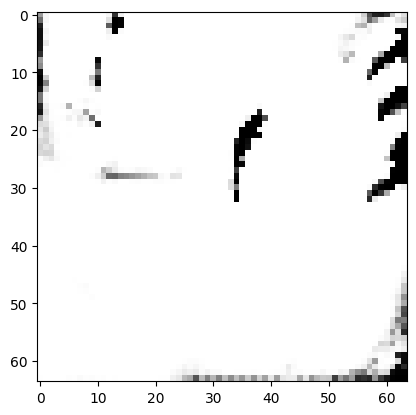

tensor([[2.3496e-03, 6.4452e-03, 4.3843e-03, 1.5425e-03, 8.9730e-03, 7.1263e-03,
         4.8639e-04, 2.7240e-02, 1.6793e-04, 8.3066e-01, 1.8737e-03, 2.0620e-03,
         7.1207e-04, 3.7849e-05, 1.6199e-04, 3.6849e-02, 1.1946e-03, 3.8556e-04,
         1.1680e-03, 3.0782e-03, 5.6349e-04, 2.8836e-04, 3.6806e-05, 1.5049e-03,
         4.0946e-04, 4.1594e-03, 3.5414e-03, 5.3074e-03, 1.1819e-02, 1.0591e-03,
         3.1294e-04, 1.5104e-02, 1.2089e-03, 4.9741e-04, 5.0815e-03, 1.7564e-04,
         6.5555e-04, 6.1438e-03, 1.1039e-03, 4.1318e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18553854525089264
tensor([[2.3533e-03, 6.4363e-03, 4.3837e-03, 1.5398e-03, 8.9611e-03, 7.1313e-03,
         4.8626e-04, 2.7273e-02, 1.6749e-04, 8.3075e-01, 1.8704e-03, 2.0570e-03,
         7.0981e-04, 3.7680e-05, 1.6153e-04, 3.6889e-02, 1.1916e-03, 3.8515e-04,
         1.1676e-03, 3.0753e-03, 5.6178e-04, 2.8793e-04, 3.6585e-05, 1.5018e-03,
         4.0791e-04, 4.1389e-03, 3.5355e-0

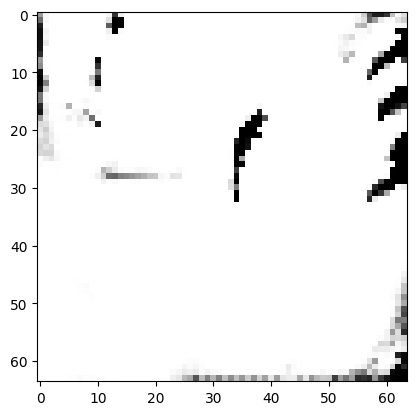

tensor([[2.3522e-03, 6.4207e-03, 4.3795e-03, 1.5370e-03, 8.9424e-03, 7.1153e-03,
         4.8587e-04, 2.7219e-02, 1.6683e-04, 8.3100e-01, 1.8675e-03, 2.0535e-03,
         7.0849e-04, 3.7555e-05, 1.6081e-04, 3.6876e-02, 1.1886e-03, 3.8435e-04,
         1.1663e-03, 3.0663e-03, 5.6033e-04, 2.8764e-04, 3.6461e-05, 1.4991e-03,
         4.0649e-04, 4.1284e-03, 3.5332e-03, 5.2885e-03, 1.1806e-02, 1.0532e-03,
         3.1055e-04, 1.5037e-02, 1.2022e-03, 4.9508e-04, 5.0624e-03, 1.7457e-04,
         6.5318e-04, 6.1198e-03, 1.0989e-03, 4.1191e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18512514233589172
tensor([[2.3494e-03, 6.4297e-03, 4.3792e-03, 1.5389e-03, 8.9408e-03, 7.1137e-03,
         4.8589e-04, 2.7115e-02, 1.6708e-04, 8.3108e-01, 1.8657e-03, 2.0570e-03,
         7.0956e-04, 3.7620e-05, 1.6085e-04, 3.6827e-02, 1.1894e-03, 3.8432e-04,
         1.1671e-03, 3.0667e-03, 5.6100e-04, 2.8747e-04, 3.6567e-05, 1.4980e-03,
         4.0685e-04, 4.1351e-03, 3.5442e-0

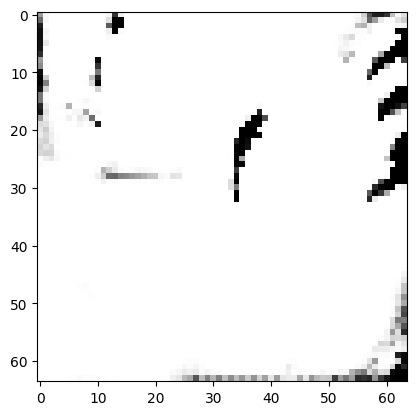

tensor([[2.3495e-03, 6.4111e-03, 4.3716e-03, 1.5348e-03, 8.9224e-03, 7.1002e-03,
         4.8564e-04, 2.7095e-02, 1.6631e-04, 8.3131e-01, 1.8634e-03, 2.0535e-03,
         7.0760e-04, 3.7471e-05, 1.6010e-04, 3.6819e-02, 1.1861e-03, 3.8354e-04,
         1.1656e-03, 3.0601e-03, 5.5930e-04, 2.8718e-04, 3.6401e-05, 1.4955e-03,
         4.0527e-04, 4.1202e-03, 3.5413e-03, 5.2766e-03, 1.1805e-02, 1.0497e-03,
         3.1018e-04, 1.5018e-02, 1.2006e-03, 4.9380e-04, 5.0593e-03, 1.7430e-04,
         6.5310e-04, 6.1210e-03, 1.0963e-03, 4.1147e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.184753879904747
tensor([[2.3494e-03, 6.4017e-03, 4.3691e-03, 1.5331e-03, 8.9142e-03, 7.0956e-03,
         4.8516e-04, 2.7128e-02, 1.6593e-04, 8.3136e-01, 1.8637e-03, 2.0518e-03,
         7.0607e-04, 3.7392e-05, 1.5983e-04, 3.6839e-02, 1.1854e-03, 3.8313e-04,
         1.1652e-03, 3.0544e-03, 5.5879e-04, 2.8714e-04, 3.6317e-05, 1.4945e-03,
         4.0441e-04, 4.1137e-03, 3.5355e-03,

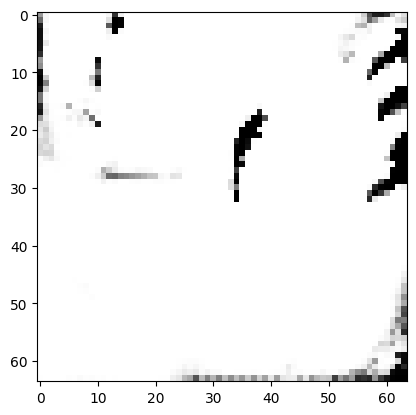

tensor([[2.3436e-03, 6.4025e-03, 4.3631e-03, 1.5329e-03, 8.9065e-03, 7.0759e-03,
         4.8473e-04, 2.7028e-02, 1.6588e-04, 8.3155e-01, 1.8635e-03, 2.0550e-03,
         7.0680e-04, 3.7451e-05, 1.5968e-04, 3.6766e-02, 1.1847e-03, 3.8284e-04,
         1.1640e-03, 3.0502e-03, 5.5907e-04, 2.8706e-04, 3.6398e-05, 1.4927e-03,
         4.0399e-04, 4.1201e-03, 3.5425e-03, 5.2724e-03, 1.1790e-02, 1.0470e-03,
         3.1029e-04, 1.5024e-02, 1.2002e-03, 4.9273e-04, 5.0439e-03, 1.7428e-04,
         6.5288e-04, 6.1285e-03, 1.0938e-03, 4.1046e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18446297943592072
tensor([[2.3424e-03, 6.4053e-03, 4.3637e-03, 1.5334e-03, 8.9064e-03, 7.0793e-03,
         4.8496e-04, 2.6981e-02, 1.6604e-04, 8.3161e-01, 1.8611e-03, 2.0548e-03,
         7.0727e-04, 3.7461e-05, 1.5963e-04, 3.6740e-02, 1.1844e-03, 3.8272e-04,
         1.1647e-03, 3.0526e-03, 5.5892e-04, 2.8687e-04, 3.6416e-05, 1.4916e-03,
         4.0431e-04, 4.1209e-03, 3.5472e-0

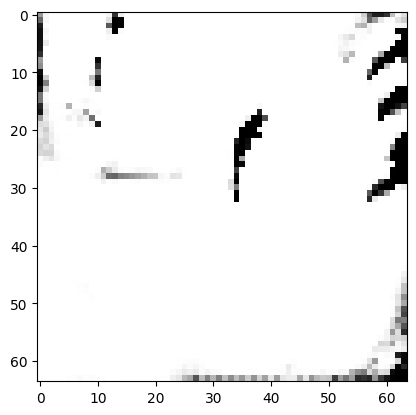

tensor([[2.3419e-03, 6.3931e-03, 4.3569e-03, 1.5299e-03, 8.8882e-03, 7.0669e-03,
         4.8448e-04, 2.6976e-02, 1.6550e-04, 8.3178e-01, 1.8596e-03, 2.0522e-03,
         7.0537e-04, 3.7343e-05, 1.5913e-04, 3.6749e-02, 1.1816e-03, 3.8201e-04,
         1.1637e-03, 3.0461e-03, 5.5766e-04, 2.8662e-04, 3.6279e-05, 1.4891e-03,
         4.0256e-04, 4.1066e-03, 3.5436e-03, 5.2592e-03, 1.1783e-02, 1.0442e-03,
         3.0938e-04, 1.5002e-02, 1.1974e-03, 4.9174e-04, 5.0384e-03, 1.7389e-04,
         6.5169e-04, 6.1170e-03, 1.0912e-03, 4.1010e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18418994545936584
tensor([[2.3436e-03, 6.3918e-03, 4.3570e-03, 1.5297e-03, 8.8888e-03, 7.0693e-03,
         4.8457e-04, 2.6987e-02, 1.6538e-04, 8.3182e-01, 1.8589e-03, 2.0503e-03,
         7.0489e-04, 3.7297e-05, 1.5900e-04, 3.6743e-02, 1.1807e-03, 3.8203e-04,
         1.1632e-03, 3.0458e-03, 5.5710e-04, 2.8649e-04, 3.6213e-05, 1.4883e-03,
         4.0243e-04, 4.1028e-03, 3.5414e-0

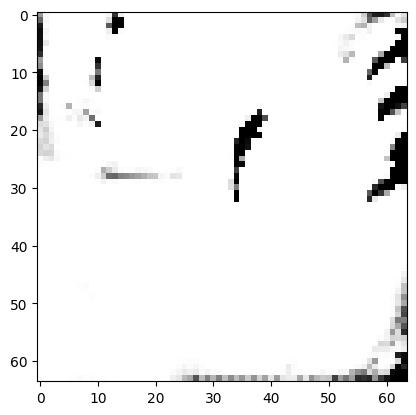

tensor([[2.3401e-03, 6.3866e-03, 4.3533e-03, 1.5277e-03, 8.8782e-03, 7.0619e-03,
         4.8428e-04, 2.6926e-02, 1.6515e-04, 8.3198e-01, 1.8563e-03, 2.0500e-03,
         7.0433e-04, 3.7257e-05, 1.5866e-04, 3.6727e-02, 1.1795e-03, 3.8153e-04,
         1.1630e-03, 3.0425e-03, 5.5667e-04, 2.8626e-04, 3.6190e-05, 1.4861e-03,
         4.0162e-04, 4.0982e-03, 3.5446e-03, 5.2514e-03, 1.1778e-02, 1.0422e-03,
         3.0879e-04, 1.4971e-02, 1.1953e-03, 4.9091e-04, 5.0352e-03, 1.7349e-04,
         6.5099e-04, 6.1071e-03, 1.0892e-03, 4.0987e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18395283818244934
tensor([[2.3387e-03, 6.3891e-03, 4.3485e-03, 1.5261e-03, 8.8773e-03, 7.0573e-03,
         4.8435e-04, 2.6891e-02, 1.6507e-04, 8.3201e-01, 1.8557e-03, 2.0507e-03,
         7.0469e-04, 3.7262e-05, 1.5868e-04, 3.6735e-02, 1.1786e-03, 3.8161e-04,
         1.1625e-03, 3.0429e-03, 5.5666e-04, 2.8615e-04, 3.6203e-05, 1.4862e-03,
         4.0142e-04, 4.0956e-03, 3.5471e-0

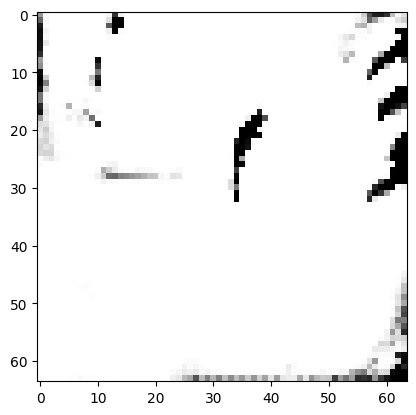

tensor([[2.3378e-03, 6.3848e-03, 4.3449e-03, 1.5252e-03, 8.8671e-03, 7.0481e-03,
         4.8401e-04, 2.6870e-02, 1.6487e-04, 8.3215e-01, 1.8540e-03, 2.0493e-03,
         7.0380e-04, 3.7215e-05, 1.5839e-04, 3.6708e-02, 1.1770e-03, 3.8118e-04,
         1.1621e-03, 3.0404e-03, 5.5590e-04, 2.8596e-04, 3.6140e-05, 1.4842e-03,
         4.0069e-04, 4.0901e-03, 3.5466e-03, 5.2421e-03, 1.1766e-02, 1.0405e-03,
         3.0851e-04, 1.4973e-02, 1.1943e-03, 4.9021e-04, 5.0292e-03, 1.7333e-04,
         6.5020e-04, 6.1024e-03, 1.0873e-03, 4.0932e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18374037742614746
tensor([[2.3340e-03, 6.3850e-03, 4.3437e-03, 1.5252e-03, 8.8670e-03, 7.0412e-03,
         4.8363e-04, 2.6840e-02, 1.6494e-04, 8.3219e-01, 1.8544e-03, 2.0508e-03,
         7.0422e-04, 3.7259e-05, 1.5844e-04, 3.6693e-02, 1.1777e-03, 3.8103e-04,
         1.1620e-03, 3.0393e-03, 5.5643e-04, 2.8602e-04, 3.6205e-05, 1.4844e-03,
         4.0072e-04, 4.0955e-03, 3.5469e-0

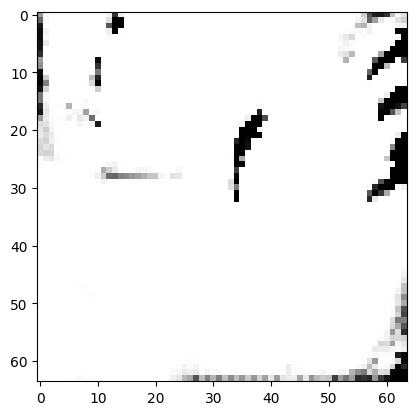

tensor([[2.3317e-03, 6.3806e-03, 4.3385e-03, 1.5234e-03, 8.8606e-03, 7.0334e-03,
         4.8352e-04, 2.6779e-02, 1.6472e-04, 8.3233e-01, 1.8531e-03, 2.0501e-03,
         7.0424e-04, 3.7237e-05, 1.5822e-04, 3.6681e-02, 1.1766e-03, 3.8071e-04,
         1.1616e-03, 3.0375e-03, 5.5609e-04, 2.8580e-04, 3.6197e-05, 1.4837e-03,
         4.0033e-04, 4.0933e-03, 3.5487e-03, 5.2378e-03, 1.1765e-02, 1.0397e-03,
         3.0892e-04, 1.4962e-02, 1.1949e-03, 4.8969e-04, 5.0275e-03, 1.7329e-04,
         6.5065e-04, 6.1045e-03, 1.0864e-03, 4.0912e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1835271716117859
tensor([[2.3306e-03, 6.3783e-03, 4.3375e-03, 1.5229e-03, 8.8552e-03, 7.0312e-03,
         4.8351e-04, 2.6765e-02, 1.6470e-04, 8.3237e-01, 1.8520e-03, 2.0498e-03,
         7.0412e-04, 3.7221e-05, 1.5813e-04, 3.6681e-02, 1.1759e-03, 3.8048e-04,
         1.1617e-03, 3.0361e-03, 5.5587e-04, 2.8572e-04, 3.6189e-05, 1.4827e-03,
         4.0004e-04, 4.0916e-03, 3.5500e-03

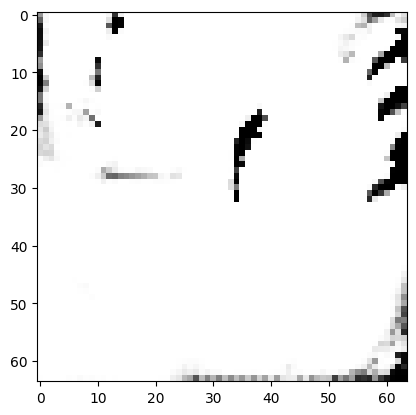

tensor([[2.3287e-03, 6.3725e-03, 4.3334e-03, 1.5215e-03, 8.8477e-03, 7.0219e-03,
         4.8331e-04, 2.6719e-02, 1.6446e-04, 8.3254e-01, 1.8501e-03, 2.0484e-03,
         7.0344e-04, 3.7175e-05, 1.5784e-04, 3.6649e-02, 1.1745e-03, 3.8014e-04,
         1.1610e-03, 3.0350e-03, 5.5524e-04, 2.8543e-04, 3.6139e-05, 1.4813e-03,
         3.9938e-04, 4.0867e-03, 3.5480e-03, 5.2292e-03, 1.1760e-02, 1.0380e-03,
         3.0862e-04, 1.4940e-02, 1.1934e-03, 4.8877e-04, 5.0238e-03, 1.7300e-04,
         6.4993e-04, 6.0994e-03, 1.0844e-03, 4.0888e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1832735240459442
tensor([[2.3272e-03, 6.3649e-03, 4.3321e-03, 1.5206e-03, 8.8428e-03, 7.0158e-03,
         4.8293e-04, 2.6720e-02, 1.6429e-04, 8.3259e-01, 1.8506e-03, 2.0480e-03,
         7.0291e-04, 3.7152e-05, 1.5769e-04, 3.6649e-02, 1.1745e-03, 3.7981e-04,
         1.1608e-03, 3.0326e-03, 5.5523e-04, 2.8549e-04, 3.6135e-05, 1.4815e-03,
         3.9902e-04, 4.0871e-03, 3.5449e-03

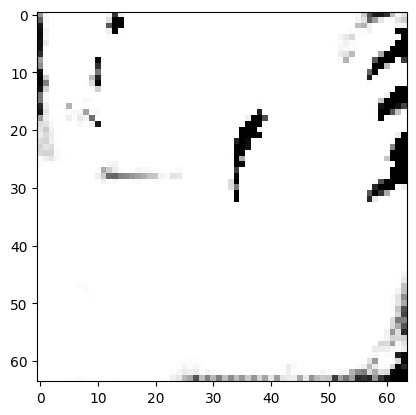

tensor([[2.3282e-03, 6.3520e-03, 4.3262e-03, 1.5186e-03, 8.8257e-03, 7.0067e-03,
         4.8282e-04, 2.6691e-02, 1.6376e-04, 8.3278e-01, 1.8489e-03, 2.0451e-03,
         7.0147e-04, 3.7033e-05, 1.5716e-04, 3.6625e-02, 1.1723e-03, 3.7919e-04,
         1.1603e-03, 3.0276e-03, 5.5397e-04, 2.8518e-04, 3.6027e-05, 1.4795e-03,
         3.9790e-04, 4.0773e-03, 3.5448e-03, 5.2181e-03, 1.1760e-02, 1.0342e-03,
         3.0779e-04, 1.4907e-02, 1.1921e-03, 4.8739e-04, 5.0106e-03, 1.7260e-04,
         6.4927e-04, 6.0993e-03, 1.0814e-03, 4.0779e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1829872578382492
tensor([[2.3319e-03, 6.3432e-03, 4.3241e-03, 1.5168e-03, 8.8191e-03, 7.0094e-03,
         4.8316e-04, 2.6706e-02, 1.6333e-04, 8.3282e-01, 1.8480e-03, 2.0423e-03,
         7.0045e-04, 3.6925e-05, 1.5683e-04, 3.6647e-02, 1.1710e-03, 3.7905e-04,
         1.1602e-03, 3.0257e-03, 5.5302e-04, 2.8501e-04, 3.5926e-05, 1.4794e-03,
         3.9738e-04, 4.0676e-03, 3.5436e-03

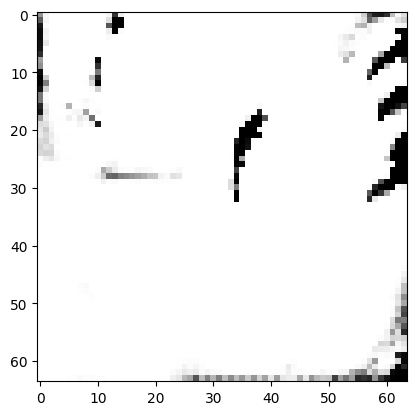

tensor([[2.3351e-03, 6.3305e-03, 4.3188e-03, 1.5149e-03, 8.8061e-03, 7.0033e-03,
         4.8325e-04, 2.6684e-02, 1.6271e-04, 8.3299e-01, 1.8456e-03, 2.0393e-03,
         6.9894e-04, 3.6769e-05, 1.5620e-04, 3.6633e-02, 1.1685e-03, 3.7867e-04,
         1.1593e-03, 3.0199e-03, 5.5167e-04, 2.8460e-04, 3.5790e-05, 1.4779e-03,
         3.9639e-04, 4.0566e-03, 3.5430e-03, 5.2035e-03, 1.1760e-02, 1.0291e-03,
         3.0614e-04, 1.4860e-02, 1.1894e-03, 4.8540e-04, 5.0009e-03, 1.7194e-04,
         6.4842e-04, 6.0926e-03, 1.0778e-03, 4.0670e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18273726105690002
tensor([[2.3348e-03, 6.3318e-03, 4.3182e-03, 1.5147e-03, 8.8036e-03, 7.0041e-03,
         4.8314e-04, 2.6672e-02, 1.6272e-04, 8.3303e-01, 1.8442e-03, 2.0389e-03,
         6.9863e-04, 3.6745e-05, 1.5612e-04, 3.6628e-02, 1.1678e-03, 3.7853e-04,
         1.1591e-03, 3.0198e-03, 5.5137e-04, 2.8440e-04, 3.5757e-05, 1.4767e-03,
         3.9610e-04, 4.0537e-03, 3.5432e-0

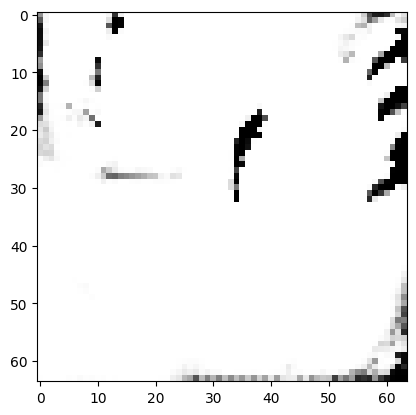

tensor([[2.3366e-03, 6.3116e-03, 4.3138e-03, 1.5116e-03, 8.7882e-03, 6.9979e-03,
         4.8285e-04, 2.6701e-02, 1.6204e-04, 8.3317e-01, 1.8445e-03, 2.0349e-03,
         6.9664e-04, 3.6588e-05, 1.5555e-04, 3.6628e-02, 1.1661e-03, 3.7784e-04,
         1.1579e-03, 3.0124e-03, 5.5003e-04, 2.8421e-04, 3.5610e-05, 1.4760e-03,
         3.9477e-04, 4.0439e-03, 3.5353e-03, 5.1931e-03, 1.1747e-02, 1.0256e-03,
         3.0494e-04, 1.4832e-02, 1.1867e-03, 4.8399e-04, 4.9869e-03, 1.7144e-04,
         6.4691e-04, 6.0855e-03, 1.0751e-03, 4.0564e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.182518869638443
tensor([[2.3336e-03, 6.3205e-03, 4.3135e-03, 1.5136e-03, 8.7882e-03, 6.9928e-03,
         4.8285e-04, 2.6631e-02, 1.6242e-04, 8.3321e-01, 1.8438e-03, 2.0377e-03,
         6.9789e-04, 3.6674e-05, 1.5570e-04, 3.6584e-02, 1.1663e-03, 3.7788e-04,
         1.1581e-03, 3.0138e-03, 5.5058e-04, 2.8416e-04, 3.5703e-05, 1.4749e-03,
         3.9520e-04, 4.0516e-03, 3.5426e-03,

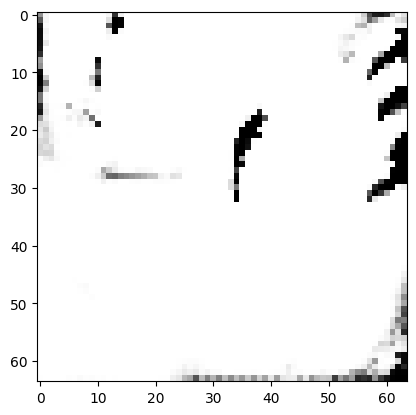

tensor([[2.3334e-03, 6.3123e-03, 4.3082e-03, 1.5119e-03, 8.7818e-03, 6.9837e-03,
         4.8287e-04, 2.6605e-02, 1.6205e-04, 8.3334e-01, 1.8431e-03, 2.0363e-03,
         6.9746e-04, 3.6616e-05, 1.5538e-04, 3.6557e-02, 1.1651e-03, 3.7763e-04,
         1.1574e-03, 3.0106e-03, 5.5000e-04, 2.8399e-04, 3.5672e-05, 1.4747e-03,
         3.9475e-04, 4.0487e-03, 3.5423e-03, 5.1896e-03, 1.1747e-02, 1.0249e-03,
         3.0569e-04, 1.4837e-02, 1.1876e-03, 4.8343e-04, 4.9881e-03, 1.7160e-04,
         6.4730e-04, 6.0959e-03, 1.0745e-03, 4.0569e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18230967223644257
tensor([[2.3345e-03, 6.3080e-03, 4.3086e-03, 1.5117e-03, 8.7789e-03, 6.9863e-03,
         4.8283e-04, 2.6603e-02, 1.6200e-04, 8.3338e-01, 1.8417e-03, 2.0346e-03,
         6.9697e-04, 3.6567e-05, 1.5521e-04, 3.6551e-02, 1.1642e-03, 3.7741e-04,
         1.1570e-03, 3.0099e-03, 5.4943e-04, 2.8383e-04, 3.5616e-05, 1.4736e-03,
         3.9465e-04, 4.0458e-03, 3.5415e-0

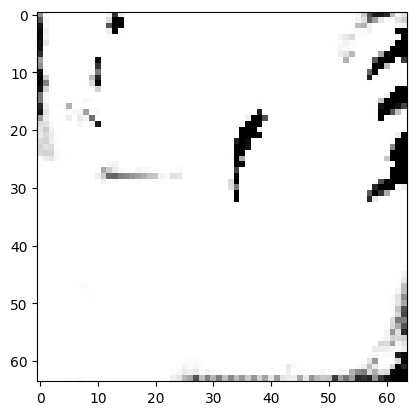

tensor([[2.3342e-03, 6.2982e-03, 4.3063e-03, 1.5104e-03, 8.7729e-03, 6.9782e-03,
         4.8264e-04, 2.6600e-02, 1.6168e-04, 8.3351e-01, 1.8414e-03, 2.0323e-03,
         6.9634e-04, 3.6507e-05, 1.5491e-04, 3.6518e-02, 1.1631e-03, 3.7713e-04,
         1.1559e-03, 3.0065e-03, 5.4869e-04, 2.8371e-04, 3.5559e-05, 1.4733e-03,
         3.9402e-04, 4.0435e-03, 3.5371e-03, 5.1823e-03, 1.1742e-02, 1.0229e-03,
         3.0518e-04, 1.4814e-02, 1.1864e-03, 4.8244e-04, 4.9792e-03, 1.7132e-04,
         6.4642e-04, 6.0946e-03, 1.0735e-03, 4.0508e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18211326003074646
tensor([[2.3314e-03, 6.3020e-03, 4.3039e-03, 1.5105e-03, 8.7719e-03, 6.9734e-03,
         4.8254e-04, 2.6550e-02, 1.6181e-04, 8.3355e-01, 1.8410e-03, 2.0343e-03,
         6.9693e-04, 3.6557e-05, 1.5497e-04, 3.6503e-02, 1.1630e-03, 3.7709e-04,
         1.1559e-03, 3.0070e-03, 5.4908e-04, 2.8367e-04, 3.5618e-05, 1.4728e-03,
         3.9409e-04, 4.0466e-03, 3.5417e-0

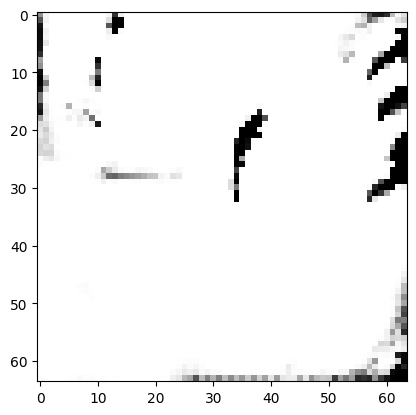

tensor([[2.3348e-03, 6.2924e-03, 4.3014e-03, 1.5092e-03, 8.7613e-03, 6.9714e-03,
         4.8234e-04, 2.6562e-02, 1.6140e-04, 8.3366e-01, 1.8391e-03, 2.0304e-03,
         6.9527e-04, 3.6425e-05, 1.5455e-04, 3.6502e-02, 1.1609e-03, 3.7670e-04,
         1.1552e-03, 3.0028e-03, 5.4774e-04, 2.8334e-04, 3.5470e-05, 1.4711e-03,
         3.9320e-04, 4.0352e-03, 3.5373e-03, 5.1739e-03, 1.1732e-02, 1.0211e-03,
         3.0466e-04, 1.4806e-02, 1.1848e-03, 4.8147e-04, 4.9761e-03, 1.7109e-04,
         6.4559e-04, 6.0928e-03, 1.0716e-03, 4.0476e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1819310188293457
tensor([[2.3323e-03, 6.2935e-03, 4.2997e-03, 1.5095e-03, 8.7589e-03, 6.9667e-03,
         4.8205e-04, 2.6535e-02, 1.6145e-04, 8.3369e-01, 1.8395e-03, 2.0318e-03,
         6.9550e-04, 3.6450e-05, 1.5457e-04, 3.6492e-02, 1.1613e-03, 3.7652e-04,
         1.1554e-03, 3.0013e-03, 5.4822e-04, 2.8338e-04, 3.5522e-05, 1.4710e-03,
         3.9320e-04, 4.0394e-03, 3.5387e-03

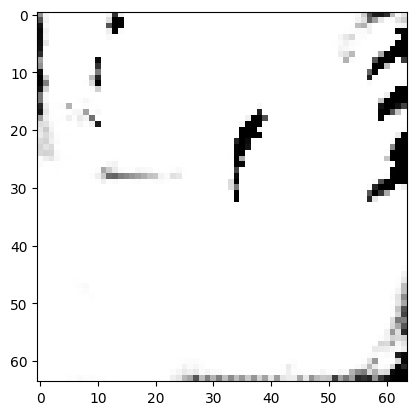

tensor([[2.3318e-03, 6.2845e-03, 4.2982e-03, 1.5090e-03, 8.7511e-03, 6.9585e-03,
         4.8176e-04, 2.6526e-02, 1.6124e-04, 8.3380e-01, 1.8395e-03, 2.0296e-03,
         6.9488e-04, 3.6412e-05, 1.5434e-04, 3.6461e-02, 1.1604e-03, 3.7617e-04,
         1.1546e-03, 2.9987e-03, 5.4759e-04, 2.8330e-04, 3.5477e-05, 1.4704e-03,
         3.9271e-04, 4.0383e-03, 3.5350e-03, 5.1709e-03, 1.1733e-02, 1.0205e-03,
         3.0490e-04, 1.4792e-02, 1.1850e-03, 4.8093e-04, 4.9698e-03, 1.7103e-04,
         6.4551e-04, 6.0992e-03, 1.0708e-03, 4.0431e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1817578822374344
tensor([[2.3318e-03, 6.2857e-03, 4.2971e-03, 1.5091e-03, 8.7493e-03, 6.9560e-03,
         4.8162e-04, 2.6519e-02, 1.6122e-04, 8.3383e-01, 1.8391e-03, 2.0297e-03,
         6.9470e-04, 3.6407e-05, 1.5431e-04, 3.6456e-02, 1.1600e-03, 3.7612e-04,
         1.1546e-03, 2.9983e-03, 5.4752e-04, 2.8326e-04, 3.5464e-05, 1.4699e-03,
         3.9254e-04, 4.0372e-03, 3.5350e-03

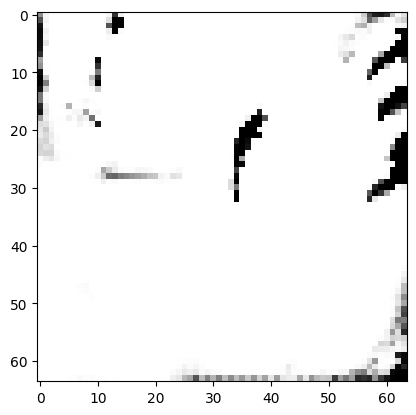

tensor([[2.3314e-03, 6.2803e-03, 4.2955e-03, 1.5092e-03, 8.7404e-03, 6.9503e-03,
         4.8131e-04, 2.6495e-02, 1.6108e-04, 8.3393e-01, 1.8388e-03, 2.0281e-03,
         6.9416e-04, 3.6370e-05, 1.5412e-04, 3.6435e-02, 1.1594e-03, 3.7572e-04,
         1.1545e-03, 2.9953e-03, 5.4715e-04, 2.8314e-04, 3.5438e-05, 1.4692e-03,
         3.9222e-04, 4.0367e-03, 3.5336e-03, 5.1668e-03, 1.1732e-02, 1.0200e-03,
         3.0481e-04, 1.4773e-02, 1.1841e-03, 4.8035e-04, 4.9675e-03, 1.7088e-04,
         6.4508e-04, 6.1019e-03, 1.0698e-03, 4.0402e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18160668015480042
tensor([[2.3317e-03, 6.2780e-03, 4.2953e-03, 1.5090e-03, 8.7388e-03, 6.9494e-03,
         4.8120e-04, 2.6494e-02, 1.6103e-04, 8.3395e-01, 1.8383e-03, 2.0275e-03,
         6.9385e-04, 3.6348e-05, 1.5405e-04, 3.6437e-02, 1.1590e-03, 3.7559e-04,
         1.1544e-03, 2.9946e-03, 5.4697e-04, 2.8307e-04, 3.5414e-05, 1.4689e-03,
         3.9210e-04, 4.0351e-03, 3.5320e-0

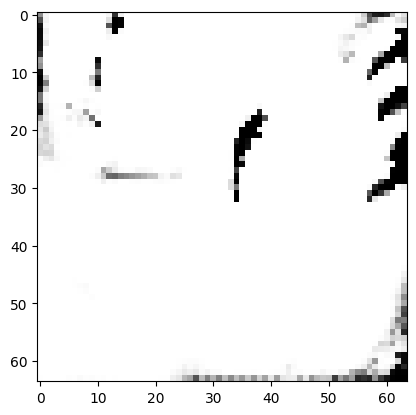

tensor([[2.3313e-03, 6.2718e-03, 4.2941e-03, 1.5088e-03, 8.7311e-03, 6.9422e-03,
         4.8094e-04, 2.6488e-02, 1.6086e-04, 8.3404e-01, 1.8385e-03, 2.0259e-03,
         6.9328e-04, 3.6313e-05, 1.5387e-04, 3.6410e-02, 1.1584e-03, 3.7532e-04,
         1.1540e-03, 2.9916e-03, 5.4651e-04, 2.8302e-04, 3.5381e-05, 1.4683e-03,
         3.9159e-04, 4.0343e-03, 3.5294e-03, 5.1633e-03, 1.1731e-02, 1.0189e-03,
         3.0456e-04, 1.4758e-02, 1.1833e-03, 4.7972e-04, 4.9607e-03, 1.7073e-04,
         6.4463e-04, 6.1050e-03, 1.0690e-03, 4.0352e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18147306144237518
tensor([[2.3325e-03, 6.2699e-03, 4.2942e-03, 1.5085e-03, 8.7280e-03, 6.9450e-03,
         4.8092e-04, 2.6486e-02, 1.6078e-04, 8.3406e-01, 1.8373e-03, 2.0249e-03,
         6.9274e-04, 3.6271e-05, 1.5372e-04, 3.6420e-02, 1.1578e-03, 3.7520e-04,
         1.1539e-03, 2.9906e-03, 5.4608e-04, 2.8286e-04, 3.5328e-05, 1.4673e-03,
         3.9135e-04, 4.0296e-03, 3.5295e-0

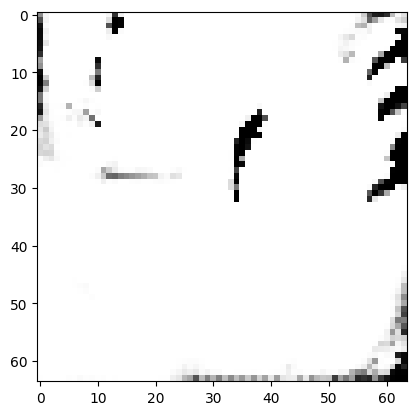

tensor([[2.3324e-03, 6.2629e-03, 4.2918e-03, 1.5077e-03, 8.7184e-03, 6.9371e-03,
         4.8044e-04, 2.6488e-02, 1.6052e-04, 8.3415e-01, 1.8373e-03, 2.0229e-03,
         6.9169e-04, 3.6217e-05, 1.5352e-04, 3.6422e-02, 1.1571e-03, 3.7478e-04,
         1.1537e-03, 2.9865e-03, 5.4561e-04, 2.8276e-04, 3.5270e-05, 1.4666e-03,
         3.9062e-04, 4.0254e-03, 3.5244e-03, 5.1567e-03, 1.1725e-02, 1.0175e-03,
         3.0384e-04, 1.4736e-02, 1.1811e-03, 4.7885e-04, 4.9543e-03, 1.7041e-04,
         6.4368e-04, 6.1005e-03, 1.0670e-03, 4.0301e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18134230375289917
tensor([[2.3325e-03, 6.2636e-03, 4.2902e-03, 1.5076e-03, 8.7164e-03, 6.9345e-03,
         4.8046e-04, 2.6476e-02, 1.6049e-04, 8.3417e-01, 1.8374e-03, 2.0232e-03,
         6.9172e-04, 3.6219e-05, 1.5351e-04, 3.6416e-02, 1.1566e-03, 3.7480e-04,
         1.1536e-03, 2.9867e-03, 5.4555e-04, 2.8275e-04, 3.5269e-05, 1.4665e-03,
         3.9052e-04, 4.0245e-03, 3.5258e-0

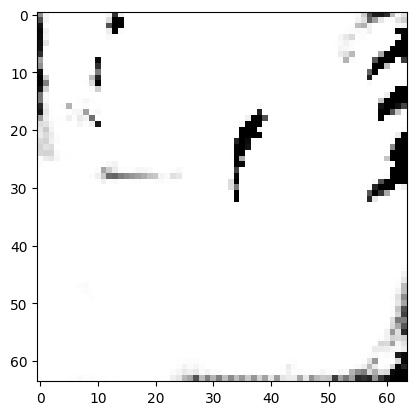

tensor([[2.3331e-03, 6.2590e-03, 4.2880e-03, 1.5069e-03, 8.7077e-03, 6.9306e-03,
         4.8019e-04, 2.6469e-02, 1.6028e-04, 8.3425e-01, 1.8367e-03, 2.0213e-03,
         6.9082e-04, 3.6162e-05, 1.5331e-04, 3.6418e-02, 1.1558e-03, 3.7446e-04,
         1.1535e-03, 2.9836e-03, 5.4499e-04, 2.8257e-04, 3.5208e-05, 1.4656e-03,
         3.8992e-04, 4.0193e-03, 3.5233e-03, 5.1514e-03, 1.1720e-02, 1.0163e-03,
         3.0345e-04, 1.4726e-02, 1.1799e-03, 4.7831e-04, 4.9504e-03, 1.7024e-04,
         6.4316e-04, 6.0998e-03, 1.0657e-03, 4.0257e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18122248351573944
tensor([[2.3333e-03, 6.2546e-03, 4.2880e-03, 1.5065e-03, 8.7058e-03, 6.9282e-03,
         4.8017e-04, 2.6476e-02, 1.6016e-04, 8.3427e-01, 1.8372e-03, 2.0202e-03,
         6.9064e-04, 3.6147e-05, 1.5324e-04, 3.6416e-02, 1.1557e-03, 3.7439e-04,
         1.1533e-03, 2.9824e-03, 5.4479e-04, 2.8260e-04, 3.5190e-05, 1.4659e-03,
         3.8972e-04, 4.0186e-03, 3.5210e-0

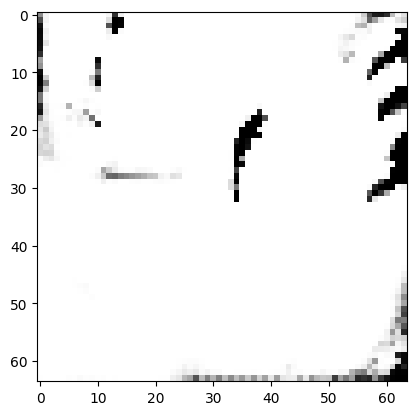

tensor([[2.3335e-03, 6.2500e-03, 4.2854e-03, 1.5056e-03, 8.6975e-03, 6.9237e-03,
         4.7989e-04, 2.6456e-02, 1.6000e-04, 8.3434e-01, 1.8364e-03, 2.0191e-03,
         6.8996e-04, 3.6105e-05, 1.5307e-04, 3.6424e-02, 1.1548e-03, 3.7408e-04,
         1.1531e-03, 2.9805e-03, 5.4434e-04, 2.8245e-04, 3.5143e-05, 1.4651e-03,
         3.8923e-04, 4.0137e-03, 3.5202e-03, 5.1455e-03, 1.1720e-02, 1.0152e-03,
         3.0306e-04, 1.4717e-02, 1.1792e-03, 4.7775e-04, 4.9443e-03, 1.7009e-04,
         6.4280e-04, 6.1000e-03, 1.0649e-03, 4.0204e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1811167597770691
tensor([[2.3335e-03, 6.2454e-03, 4.2862e-03, 1.5054e-03, 8.6950e-03, 6.9219e-03,
         4.7968e-04, 2.6478e-02, 1.5991e-04, 8.3436e-01, 1.8369e-03, 2.0176e-03,
         6.8946e-04, 3.6078e-05, 1.5299e-04, 3.6419e-02, 1.1548e-03, 3.7391e-04,
         1.1530e-03, 2.9789e-03, 5.4411e-04, 2.8247e-04, 3.5117e-05, 1.4651e-03,
         3.8901e-04, 4.0133e-03, 3.5156e-03

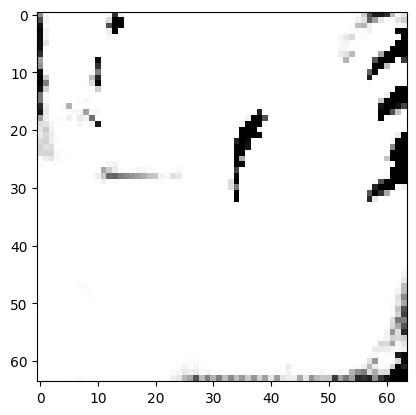

tensor([[2.3316e-03, 6.2462e-03, 4.2841e-03, 1.5057e-03, 8.6892e-03, 6.9154e-03,
         4.7934e-04, 2.6437e-02, 1.5997e-04, 8.3443e-01, 1.8365e-03, 2.0184e-03,
         6.8954e-04, 3.6092e-05, 1.5296e-04, 3.6402e-02, 1.1544e-03, 3.7369e-04,
         1.1528e-03, 2.9771e-03, 5.4419e-04, 2.8237e-04, 3.5132e-05, 1.4640e-03,
         3.8876e-04, 4.0147e-03, 3.5172e-03, 5.1440e-03, 1.1717e-02, 1.0150e-03,
         3.0311e-04, 1.4707e-02, 1.1785e-03, 4.7738e-04, 4.9405e-03, 1.7001e-04,
         6.4244e-04, 6.1033e-03, 1.0643e-03, 4.0182e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18100546300411224
tensor([[2.3323e-03, 6.2436e-03, 4.2838e-03, 1.5054e-03, 8.6872e-03, 6.9163e-03,
         4.7931e-04, 2.6441e-02, 1.5988e-04, 8.3445e-01, 1.8359e-03, 2.0174e-03,
         6.8909e-04, 3.6057e-05, 1.5287e-04, 3.6406e-02, 1.1540e-03, 3.7356e-04,
         1.1528e-03, 2.9764e-03, 5.4391e-04, 2.8228e-04, 3.5097e-05, 1.4637e-03,
         3.8863e-04, 4.0119e-03, 3.5160e-0

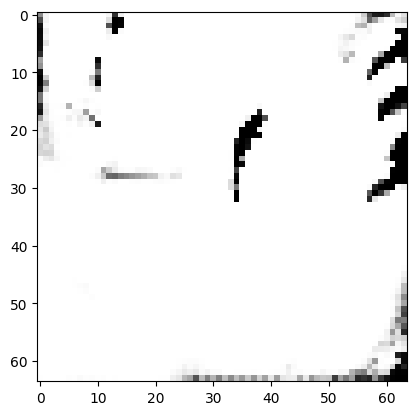

tensor([[2.3335e-03, 6.2378e-03, 4.2812e-03, 1.5042e-03, 8.6808e-03, 6.9128e-03,
         4.7934e-04, 2.6440e-02, 1.5959e-04, 8.3451e-01, 1.8355e-03, 2.0154e-03,
         6.8833e-04, 3.6004e-05, 1.5268e-04, 3.6414e-02, 1.1532e-03, 3.7338e-04,
         1.1526e-03, 2.9745e-03, 5.4331e-04, 2.8214e-04, 3.5037e-05, 1.4633e-03,
         3.8808e-04, 4.0058e-03, 3.5143e-03, 5.1381e-03, 1.1715e-02, 1.0134e-03,
         3.0240e-04, 1.4689e-02, 1.1770e-03, 4.7676e-04, 4.9356e-03, 1.6976e-04,
         6.4194e-04, 6.0980e-03, 1.0627e-03, 4.0129e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18090856075286865
tensor([[2.3340e-03, 6.2357e-03, 4.2818e-03, 1.5041e-03, 8.6800e-03, 6.9128e-03,
         4.7921e-04, 2.6450e-02, 1.5952e-04, 8.3453e-01, 1.8355e-03, 2.0145e-03,
         6.8802e-04, 3.5979e-05, 1.5259e-04, 3.6412e-02, 1.1531e-03, 3.7332e-04,
         1.1523e-03, 2.9733e-03, 5.4312e-04, 2.8213e-04, 3.5010e-05, 1.4632e-03,
         3.8794e-04, 4.0051e-03, 3.5120e-0

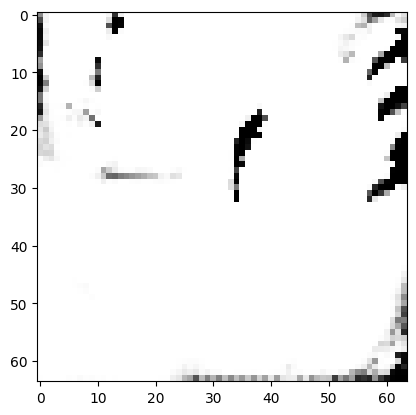

tensor([[2.3333e-03, 6.2331e-03, 4.2806e-03, 1.5043e-03, 8.6735e-03, 6.9084e-03,
         4.7897e-04, 2.6425e-02, 1.5948e-04, 8.3459e-01, 1.8349e-03, 2.0143e-03,
         6.8772e-04, 3.5964e-05, 1.5247e-04, 3.6396e-02, 1.1525e-03, 3.7306e-04,
         1.1522e-03, 2.9713e-03, 5.4293e-04, 2.8204e-04, 3.4999e-05, 1.4622e-03,
         3.8770e-04, 4.0047e-03, 3.5128e-03, 5.1357e-03, 1.1715e-02, 1.0128e-03,
         3.0226e-04, 1.4677e-02, 1.1763e-03, 4.7630e-04, 4.9330e-03, 1.6963e-04,
         6.4164e-04, 6.1009e-03, 1.0621e-03, 4.0113e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1808132529258728
tensor([[2.3344e-03, 6.2276e-03, 4.2807e-03, 1.5038e-03, 8.6715e-03, 6.9077e-03,
         4.7895e-04, 2.6444e-02, 1.5932e-04, 8.3461e-01, 1.8354e-03, 2.0128e-03,
         6.8728e-04, 3.5927e-05, 1.5236e-04, 3.6396e-02, 1.1522e-03, 3.7296e-04,
         1.1520e-03, 2.9700e-03, 5.4258e-04, 2.8205e-04, 3.4960e-05, 1.4624e-03,
         3.8748e-04, 4.0026e-03, 3.5093e-03

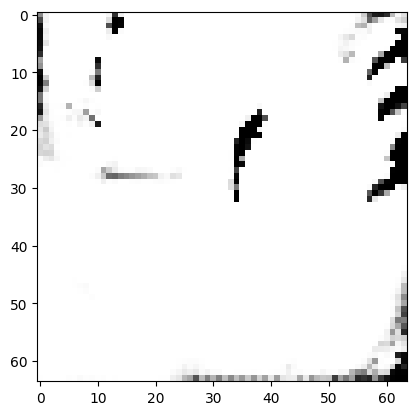

tensor([[2.3331e-03, 6.2263e-03, 4.2785e-03, 1.5034e-03, 8.6660e-03, 6.9026e-03,
         4.7865e-04, 2.6415e-02, 1.5929e-04, 8.3468e-01, 1.8345e-03, 2.0125e-03,
         6.8697e-04, 3.5918e-05, 1.5229e-04, 3.6386e-02, 1.1516e-03, 3.7273e-04,
         1.1519e-03, 2.9690e-03, 5.4248e-04, 2.8192e-04, 3.4956e-05, 1.4616e-03,
         3.8727e-04, 4.0014e-03, 3.5093e-03, 5.1317e-03, 1.1714e-02, 1.0120e-03,
         3.0194e-04, 1.4661e-02, 1.1758e-03, 4.7588e-04, 4.9290e-03, 1.6946e-04,
         6.4130e-04, 6.1007e-03, 1.0613e-03, 4.0081e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1807045042514801
tensor([[2.3343e-03, 6.2221e-03, 4.2786e-03, 1.5031e-03, 8.6629e-03, 6.9018e-03,
         4.7863e-04, 2.6424e-02, 1.5915e-04, 8.3470e-01, 1.8350e-03, 2.0115e-03,
         6.8661e-04, 3.5890e-05, 1.5219e-04, 3.6388e-02, 1.1514e-03, 3.7265e-04,
         1.1518e-03, 2.9684e-03, 5.4219e-04, 2.8193e-04, 3.4924e-05, 1.4620e-03,
         3.8707e-04, 3.9992e-03, 3.5074e-03

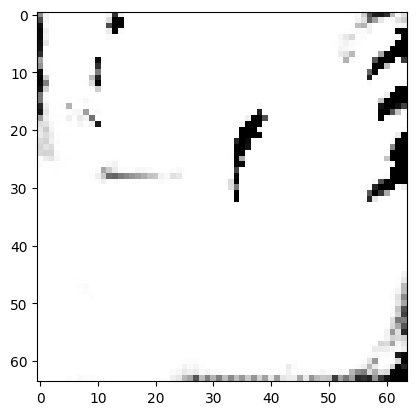

tensor([[2.3330e-03, 6.2191e-03, 4.2758e-03, 1.5025e-03, 8.6576e-03, 6.8955e-03,
         4.7831e-04, 2.6398e-02, 1.5906e-04, 8.3477e-01, 1.8349e-03, 2.0109e-03,
         6.8642e-04, 3.5882e-05, 1.5214e-04, 3.6377e-02, 1.1509e-03, 3.7243e-04,
         1.1515e-03, 2.9666e-03, 5.4209e-04, 2.8186e-04, 3.4923e-05, 1.4617e-03,
         3.8687e-04, 3.9991e-03, 3.5067e-03, 5.1277e-03, 1.1716e-02, 1.0113e-03,
         3.0174e-04, 1.4652e-02, 1.1757e-03, 4.7551e-04, 4.9243e-03, 1.6936e-04,
         6.4119e-04, 6.1034e-03, 1.0609e-03, 4.0035e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18060320615768433
tensor([[2.3332e-03, 6.2181e-03, 4.2757e-03, 1.5024e-03, 8.6554e-03, 6.8957e-03,
         4.7822e-04, 2.6400e-02, 1.5904e-04, 8.3478e-01, 1.8344e-03, 2.0107e-03,
         6.8606e-04, 3.5866e-05, 1.5209e-04, 3.6381e-02, 1.1507e-03, 3.7232e-04,
         1.1517e-03, 2.9666e-03, 5.4199e-04, 2.8182e-04, 3.4907e-05, 1.4613e-03,
         3.8673e-04, 3.9971e-03, 3.5063e-0

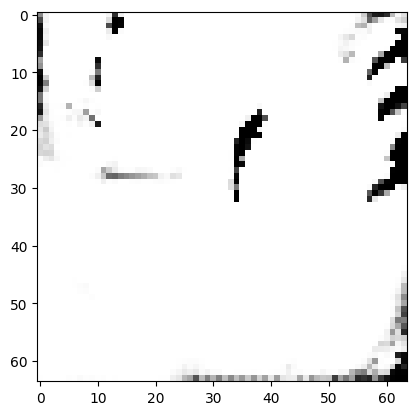

tensor([[2.3325e-03, 6.2145e-03, 4.2738e-03, 1.5023e-03, 8.6499e-03, 6.8886e-03,
         4.7791e-04, 2.6386e-02, 1.5897e-04, 8.3484e-01, 1.8350e-03, 2.0099e-03,
         6.8589e-04, 3.5859e-05, 1.5203e-04, 3.6361e-02, 1.1501e-03, 3.7210e-04,
         1.1513e-03, 2.9646e-03, 5.4181e-04, 2.8182e-04, 3.4899e-05, 1.4611e-03,
         3.8654e-04, 3.9978e-03, 3.5042e-03, 5.1249e-03, 1.1715e-02, 1.0110e-03,
         3.0161e-04, 1.4645e-02, 1.1753e-03, 4.7526e-04, 4.9208e-03, 1.6929e-04,
         6.4089e-04, 6.1061e-03, 1.0606e-03, 4.0006e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18051205575466156
tensor([[2.3319e-03, 6.2140e-03, 4.2741e-03, 1.5022e-03, 8.6486e-03, 6.8888e-03,
         4.7774e-04, 2.6384e-02, 1.5898e-04, 8.3486e-01, 1.8344e-03, 2.0096e-03,
         6.8565e-04, 3.5850e-05, 1.5200e-04, 3.6363e-02, 1.1501e-03, 3.7199e-04,
         1.1513e-03, 2.9641e-03, 5.4178e-04, 2.8176e-04, 3.4892e-05, 1.4606e-03,
         3.8645e-04, 3.9972e-03, 3.5035e-0

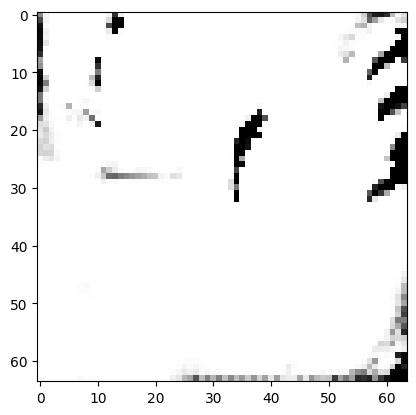

tensor([[2.3319e-03, 6.2090e-03, 4.2733e-03, 1.5019e-03, 8.6429e-03, 6.8842e-03,
         4.7742e-04, 2.6380e-02, 1.5886e-04, 8.3491e-01, 1.8346e-03, 2.0087e-03,
         6.8515e-04, 3.5821e-05, 1.5187e-04, 3.6353e-02, 1.1495e-03, 3.7177e-04,
         1.1509e-03, 2.9619e-03, 5.4149e-04, 2.8173e-04, 3.4858e-05, 1.4602e-03,
         3.8611e-04, 3.9957e-03, 3.5009e-03, 5.1224e-03, 1.1714e-02, 1.0105e-03,
         3.0134e-04, 1.4634e-02, 1.1746e-03, 4.7489e-04, 4.9176e-03, 1.6914e-04,
         6.4052e-04, 6.1068e-03, 1.0600e-03, 3.9986e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18042835593223572
tensor([[2.3319e-03, 6.2085e-03, 4.2727e-03, 1.5017e-03, 8.6423e-03, 6.8834e-03,
         4.7745e-04, 2.6375e-02, 1.5885e-04, 8.3493e-01, 1.8345e-03, 2.0084e-03,
         6.8518e-04, 3.5821e-05, 1.5186e-04, 3.6350e-02, 1.1494e-03, 3.7174e-04,
         1.1508e-03, 2.9619e-03, 5.4143e-04, 2.8170e-04, 3.4860e-05, 1.4602e-03,
         3.8611e-04, 3.9957e-03, 3.5012e-0

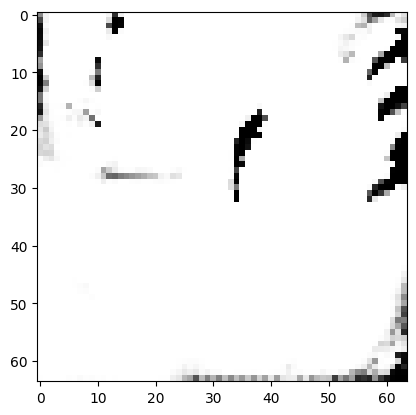

tensor([[2.3309e-03, 6.2050e-03, 4.2710e-03, 1.5015e-03, 8.6364e-03, 6.8775e-03,
         4.7704e-04, 2.6363e-02, 1.5877e-04, 8.3498e-01, 1.8345e-03, 2.0080e-03,
         6.8472e-04, 3.5804e-05, 1.5178e-04, 3.6346e-02, 1.1489e-03, 3.7145e-04,
         1.1507e-03, 2.9600e-03, 5.4135e-04, 2.8167e-04, 3.4845e-05, 1.4598e-03,
         3.8582e-04, 3.9949e-03, 3.4989e-03, 5.1196e-03, 1.1714e-02, 1.0102e-03,
         3.0127e-04, 1.4626e-02, 1.1744e-03, 4.7465e-04, 4.9150e-03, 1.6906e-04,
         6.4032e-04, 6.1083e-03, 1.0595e-03, 3.9963e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18034514784812927
tensor([[2.3312e-03, 6.2021e-03, 4.2711e-03, 1.5013e-03, 8.6354e-03, 6.8759e-03,
         4.7697e-04, 2.6373e-02, 1.5868e-04, 8.3499e-01, 1.8350e-03, 2.0073e-03,
         6.8450e-04, 3.5791e-05, 1.5174e-04, 3.6345e-02, 1.1489e-03, 3.7139e-04,
         1.1506e-03, 2.9592e-03, 5.4127e-04, 2.8172e-04, 3.4832e-05, 1.4602e-03,
         3.8571e-04, 3.9945e-03, 3.4966e-0

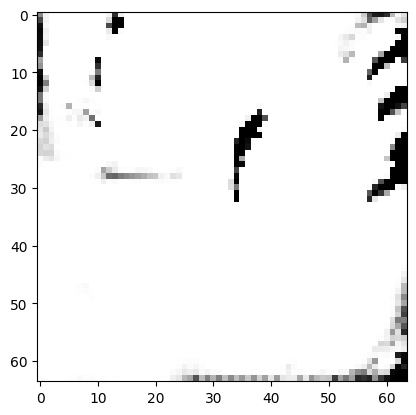

tensor([[2.3306e-03, 6.1999e-03, 4.2700e-03, 1.5011e-03, 8.6301e-03, 6.8727e-03,
         4.7669e-04, 2.6349e-02, 1.5865e-04, 8.3505e-01, 1.8342e-03, 2.0069e-03,
         6.8421e-04, 3.5776e-05, 1.5165e-04, 3.6339e-02, 1.1483e-03, 3.7115e-04,
         1.1505e-03, 2.9581e-03, 5.4109e-04, 2.8160e-04, 3.4817e-05, 1.4595e-03,
         3.8554e-04, 3.9932e-03, 3.4966e-03, 5.1168e-03, 1.1715e-02, 1.0098e-03,
         3.0110e-04, 1.4616e-02, 1.1739e-03, 4.7435e-04, 4.9127e-03, 1.6896e-04,
         6.4016e-04, 6.1099e-03, 1.0590e-03, 3.9942e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.1802666038274765
tensor([[2.3307e-03, 6.1970e-03, 4.2704e-03, 1.5011e-03, 8.6289e-03, 6.8712e-03,
         4.7659e-04, 2.6360e-02, 1.5858e-04, 8.3506e-01, 1.8346e-03, 2.0061e-03,
         6.8398e-04, 3.5763e-05, 1.5160e-04, 3.6338e-02, 1.1484e-03, 3.7109e-04,
         1.1504e-03, 2.9573e-03, 5.4099e-04, 2.8164e-04, 3.4804e-05, 1.4597e-03,
         3.8544e-04, 3.9930e-03, 3.4942e-03

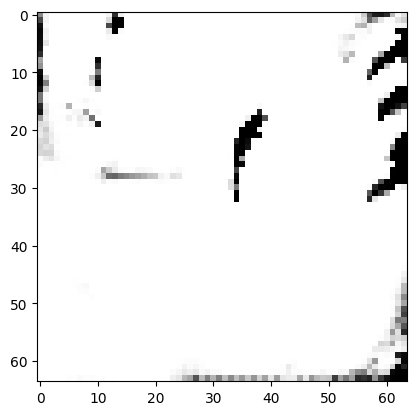

tensor([[2.3290e-03, 6.1959e-03, 4.2697e-03, 1.5013e-03, 8.6239e-03, 6.8664e-03,
         4.7615e-04, 2.6340e-02, 1.5863e-04, 8.3511e-01, 1.8341e-03, 2.0062e-03,
         6.8374e-04, 3.5764e-05, 1.5156e-04, 3.6323e-02, 1.1481e-03, 3.7080e-04,
         1.1503e-03, 2.9558e-03, 5.4102e-04, 2.8159e-04, 3.4806e-05, 1.4588e-03,
         3.8527e-04, 3.9939e-03, 3.4936e-03, 5.1156e-03, 1.1716e-02, 1.0097e-03,
         3.0106e-04, 1.4606e-02, 1.1735e-03, 4.7416e-04, 4.9099e-03, 1.6888e-04,
         6.3994e-04, 6.1125e-03, 1.0588e-03, 3.9925e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18018975853919983
tensor([[2.3291e-03, 6.1951e-03, 4.2692e-03, 1.5011e-03, 8.6231e-03, 6.8660e-03,
         4.7614e-04, 2.6334e-02, 1.5860e-04, 8.3513e-01, 1.8338e-03, 2.0060e-03,
         6.8369e-04, 3.5756e-05, 1.5154e-04, 3.6323e-02, 1.1478e-03, 3.7076e-04,
         1.1502e-03, 2.9558e-03, 5.4092e-04, 2.8154e-04, 3.4799e-05, 1.4587e-03,
         3.8524e-04, 3.9931e-03, 3.4936e-0

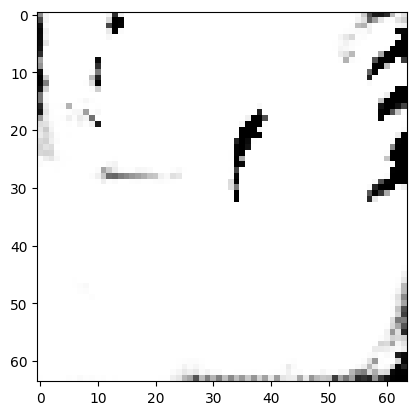

tensor([[2.3292e-03, 6.1893e-03, 4.2680e-03, 1.5006e-03, 8.6182e-03, 6.8611e-03,
         4.7587e-04, 2.6340e-02, 1.5842e-04, 8.3518e-01, 1.8340e-03, 2.0044e-03,
         6.8309e-04, 3.5722e-05, 1.5142e-04, 3.6318e-02, 1.1473e-03, 3.7052e-04,
         1.1500e-03, 2.9539e-03, 5.4061e-04, 2.8153e-04, 3.4764e-05, 1.4587e-03,
         3.8494e-04, 3.9911e-03, 3.4897e-03, 5.1127e-03, 1.1716e-02, 1.0091e-03,
         3.0078e-04, 1.4593e-02, 1.1731e-03, 4.7383e-04, 4.9053e-03, 1.6875e-04,
         6.3973e-04, 6.1127e-03, 1.0584e-03, 3.9883e-03]], device='cuda:0',
       grad_fn=<SoftmaxBackward>)
loss(generator):  0.18010960519313812
tensor([[2.3291e-03, 6.1898e-03, 4.2668e-03, 1.5005e-03, 8.6170e-03, 6.8596e-03,
         4.7584e-04, 2.6328e-02, 1.5842e-04, 8.3519e-01, 1.8339e-03, 2.0046e-03,
         6.8315e-04, 3.5724e-05, 1.5141e-04, 3.6315e-02, 1.1470e-03, 3.7050e-04,
         1.1499e-03, 2.9537e-03, 5.4060e-04, 2.8150e-04, 3.4768e-05, 1.4586e-03,
         3.8494e-04, 3.9910e-03, 3.4908e-0

In [21]:
z = torch.randn(1, 16, 32, 32).to(device)
z = z.requires_grad_(True)
optimize_z_eps(z, 500, 1000, 0.00, 0.99, target=9)